In [1]:
import numpy as np
import pyvista as pv
from scipy.interpolate import LinearNDInterpolator
from scipy.ndimage import gaussian_filter
import sys
import os
import imageio
import glob
sys.path.append('../')

import pydem.SyntheticTerrain as st
import pydem.Geometry as gm
import pydem.Graphic as pyvis
import pydem.HazardDetection as hd
import pydem.util as util

%load_ext autoreload
%autoreload 2
%matplotlib inline

Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.


In [2]:
def make_terrain(nh, nw, res, seed=0):
    rng = np.random.RandomState(seed=seed)
    dem = st.rocky_terrain(shape=(nh, nw), res=res, k=0.3, dmax=1.5, dmin=0.1, rng=rng)
    terrain = st.dsa(dem, hmax=0.7)

    # smooth the terrain
    dem += gaussian_filter(terrain, sigma=2)

    # Create mesh from DEM
    h, w = dem.shape
    x = np.linspace(0, nh * res, h)
    y = np.linspace(0, nw * res, w)
    xc, yc = np.mean(x), np.mean(y)
    x -= xc
    y -= yc
    yy, xx = np.meshgrid(y, x)
    terrain = pv.StructuredGrid(xx, yy, dem)

    return terrain, dem, xx, yy


def prep_cameras(altitudes, thetas):
    camera_positions = []
    R_C2W_list = []
    fov_mesh_list = []
    for alt in altitudes:
        for theta in thetas:
            camera_position = np.array([0.0, alt * np.sin(theta), alt * np.cos(theta)])
            e1_c = np.array([-1.0, 0.0, 0.0])
            e3_c = np.array([0.0, -np.sin(theta), -np.cos(theta)])
            e2_c = np.cross(e3_c, e1_c)
            R_C2W = np.vstack((e1_c, e2_c, e3_c)).T

            # Camera FOV pyramid in camera coordinates
            fov = np.arctan(50/500) * 2
            lidar_range = np.linalg.norm(camera_position)
            depth = lidar_range * (1 + np.sin(fov / 2) * np.tan(abs(theta))) * 1.01
            base_r = depth * np.tan(fov / 2)
            points_c = np.array([
                [0.0, 0.0, 0.0],
                [base_r, base_r, depth],
                [-base_r, base_r, depth],
                [-base_r, -base_r, depth],
                [base_r, -base_r, depth]
            ])
            points_w = R_C2W @ points_c.T + camera_position.reshape(-1, 1)
            points_w = points_w.T

            faces = np.hstack([
                [3, 0, 1, 2],  # face 0: triangle between points 0, 1, 2
                [3, 0, 2, 3],  # face 1: triangle between points 0, 2, 3
                [3, 0, 3, 4],  # face 2: triangle between points 0, 3, 4
                [3, 0, 4, 1],  # face 3: triangle between points 0, 4, 1
                [4, 1, 2, 3, 4]  # face 4: square between points 1, 2, 3, 4
            ])

            fov_mesh = pv.PolyData(points_w, faces)

            camera_positions.append(camera_position)
            R_C2W_list.append(R_C2W)
            fov_mesh_list.append(fov_mesh)

    return camera_positions, R_C2W_list, fov_mesh_list


def visualize_views(terrain, camera_positions, fov_mesh_list, out_dir):

    for i in range(len(camera_positions)):
        p = pv.Plotter()
        p.add_mesh(terrain, color="gray", smooth_shading=True)
        fov_mesh = fov_mesh_list[i]
        p.add_mesh(fov_mesh, color="orange", opacity=0.3, smooth_shading=True)

        for point in fov_mesh.points:
            beam = pv.Line(camera_positions[i], point)
            p.add_mesh(beam, color='orange', opacity=1.0)

        #p.show_grid()
        p.show(auto_close=False)
        print(i)
        p.screenshot(f"{out_dir}/view_{i}.png", transparent_background=True, return_img=False)
        p.close()


def make_gif(file_list, out_name, duration=0.5):
    
    # Read each image file and append it to a list
    images = [imageio.imread(file) for file in file_list]

    # Repeat first and last frames to make the GIF slower and easier to see
    images = [images[0]] + images + [images[-1]]*2

    # Save the images as a GIF
    imageio.mimsave(out_name, images, duration=duration)



In [3]:
res = 0.1
terrain, dem, xx, yy = make_terrain(nh=512, nw=512, res=res, seed=0)

dl = 3.0
dp = 0.3

fpmap, site_slope, site_rghns, pix_rghns, site_safe, indef = hd.dhd(
        dem, 
        rmpp=res, 
        negative_rghns_unsafe=False,
        lander_type='square', 
        dl=dl, 
        dp=dp,
        scrit=10*np.pi/180,
        rcrit=0.3)

In [4]:
def rays_in_c(dsize: int=1024, fov_width: float=100.0, alt: float=500.0):
    """
    Generate rays in camera frame

    Args:
        fov_width (float, optional): Field of view width. Defaults to 100.0.
        alt (float, optional): Altitude. Defaults to 500.0.
        dsize (int, optional): Resolution parameter. Number of data points within 100 m at altitude of 500 m. Defaults to 1024.
    """
    # rays in camera frame
    n = dsize ** 2
    rays = np.zeros((n, 3))
    x = np.linspace(-fov_width/2, fov_width/2, dsize)
    y = np.linspace(-fov_width/2, fov_width/2, dsize)
    yy, xx = np.meshgrid(y, x)
    rays[:, 0] = xx.flatten()
    rays[:, 1] = yy.flatten()
    rays[:, 2] = alt

    return rays

def sim_scan(camera_position, theta, R_C2W, dem, xx, yy, res):
    dtm = gm.dem2boxmesh_tri(xx, yy, dem)

    # target region
    x_min, x_max = -10, 10
    y_min, y_max = -10, 10
    mask = (xx > x_min) & (xx < x_max) & (yy > y_min) & (yy < y_max)
    xx_masked = xx[mask]
    yy_masked = yy[mask]
    shape = (int((x_max - x_min) / res), int((y_max - y_min) / res))
    xx_masked = xx_masked.reshape(shape)
    yy_masked = yy_masked.reshape(shape)

    # sim lidar scan
    rays_c = rays_in_c(64, 100.0, 500.0)

    rays_w = R_C2W @ rays_c.T
    rays_w = rays_w.T

    n = rays_w.shape[0]
    src = np.array(list(camera_position) * n).reshape(n, 3)

    pcd, idr, _ = dtm.ray.intersects_location(src, rays_w, multiple_hits=False)

    interp = LinearNDInterpolator(pcd[:, :2], pcd[:, 2], fill_value=0.0)
    dem_coarse = interp(xx, yy)

    return pcd, dem_coarse

def sim_scans(camera_positions, R_C2W_list, dem, xx, yy, res, out_dir):

    coarse_dems = []
    xx_masked_list = []
    yy_masked_list = []
    mask_list = []

    for i in range(len(camera_positions)):
        pcd, dem_coarse = sim_scan(camera_positions[i], 0.0, R_C2W_list[i], dem, xx, yy, res)

        x_min, x_max = -5, 5
        y_min, y_max = -5, 5
        mask = (xx > x_min) & (xx < x_max) & (yy > y_min) & (yy < y_max)
        xx_masked = xx[mask]
        yy_masked = yy[mask]
        shape = (int((x_max - x_min) / res), int((y_max - y_min) / res))
        xx_masked = xx_masked.reshape(shape)
        yy_masked = yy_masked.reshape(shape)

        dem_coarse_masked = dem_coarse[mask]
        dem_coarse_masked = dem_coarse_masked.reshape(shape)

        pcd_masked = pcd[(pcd[:, 0] > x_min) & (pcd[:, 0] < x_max) & (pcd[:, 1] > y_min) & (pcd[:, 1] < y_max)]
        print(pcd_masked.shape)

        terrain_reconstructed_target = pv.StructuredGrid(xx_masked, yy_masked, dem_coarse_masked)

        p = pv.Plotter()
        p.add_mesh(terrain_reconstructed_target, color="gray", smooth_shading=True)

        # visualize pcd
        cloud = pv.PolyData(pcd_masked)
        p.add_mesh(cloud, color="red", point_size=5, opacity=1.0)

        p.show(auto_close=False)
        p.screenshot(f"{out_dir}/dem_{i}.png", transparent_background=True, return_img=False)
        p.close

        coarse_dems.append(dem_coarse)
        xx_masked_list.append(xx_masked)
        yy_masked_list.append(yy_masked)
        mask_list.append(mask)

    return coarse_dems, xx_masked_list, yy_masked_list, mask_list


GREEN = np.array([73, 235, 52])
BLUE = np.array([52, 79, 235])
RED = np.array([235, 64, 52])
PINK = np.array([255, 0, 127])
YELLOW = np.array([235, 217, 52])
NAVY = np.array([0, 0, 102])

def pred2img(label, pred):
    h, w = label.shape
    img = np.zeros((h, w, 3), dtype=np.uint8)
    img[label == -1] = NAVY  # invalid
    img[(label == 1) * (pred == 1)] = GREEN  # true safe
    img[(label == 0) * (pred != 1)] = YELLOW  # true unsafe
    img[(label == 1) * (pred != 1)] = BLUE  # false unsafe
    img[(label == 0) * (pred == 1)] = RED  # false safe
    return img


def sim_hds(coarse_dems, xx_masked_list, yy_masked_list, mask_list, dem, sfmap, out_dir, dl=3.0, dp=0.3, rmpp=0.1):

    for i in range(len(coarse_dems)):
        dem_coarse = coarse_dems[i]
        xx_masked = xx_masked_list[i]
        yy_masked = yy_masked_list[i]
        mask = mask_list[i]
        shape = xx_masked.shape
        #dem_coarse_target = dem_coarse[mask].reshape(shape)
        dem_target = dem[mask].reshape(shape)

        _, _, _, _, site_safe, _ = hd.dhd(
            dem_coarse, 
            rmpp=rmpp, 
            negative_rghns_unsafe=False,
            lander_type='square', 
            dl=dl, 
            dp=dp,
            scrit=10*np.pi/180,
            rcrit=0.3)
        is_safe_coarse = site_safe

        safety_target = sfmap[mask]
        safety_coarse_target = is_safe_coarse[mask]

        safety_target = safety_target.reshape(shape)
        safety_coarse_target = safety_coarse_target.reshape(shape)

        pred_img = pred2img(safety_target, safety_coarse_target)

        # reverse the second axis
        pred_img_flipped = pred_img[::-1, :, :]
        texture = pv.numpy_to_texture(pred_img_flipped)
        terrain_target = pv.StructuredGrid(xx_masked, yy_masked, dem_target)

        # Create texture coordinates
        coords = np.zeros((terrain_target.points.shape[0], 2))
        coords[:, 0] = terrain_target.points[:, 0] / terrain_target.points[:, 0].max()
        coords[:, 1] = terrain_target.points[:, 1] / terrain_target.points[:, 1].max()

        # Add texture coordinates to the grid
        terrain_target.point_data['Texture Coordinates'] = coords

        # Map the texture to the grid
        terrain_target.texture_map_to_plane(inplace=True)

        # Plot the grid with the texture
        plotter = pv.Plotter()
        plotter.add_mesh(terrain_target, texture=texture)

        plotter.show(auto_close=False)
        plotter.screenshot(f"{out_dir}/hd_{i}.png", transparent_background=True, return_img=False)
        plotter.close()


In [5]:
def make_gifs(out_dir, duration=0.5):
    file_list = sorted(glob.glob(f"{out_dir}/view_*.png"))
    file_list = sorted(file_list, key=lambda x: int(x.split("_")[-1].split(".")[0]))
    make_gif(file_list, f"{out_dir}/views.gif", duration=duration)

    file_list = sorted(glob.glob(f"{out_dir}/dem_*.png"))
    file_list = sorted(file_list, key=lambda x: int(x.split("_")[-1].split(".")[0]))
    make_gif(file_list, f"{out_dir}/dems.gif", duration=duration)

    file_list = sorted(glob.glob(f"{out_dir}/hd_*.png"))
    file_list = sorted(file_list, key=lambda x: int(x.split("_")[-1].split(".")[0]))
    make_gif(file_list, f"{out_dir}/hds.gif", duration=duration)

def main(seed=0, n_steps=10, duration=0.5):
    res = 0.1
    terrain, dem, xx, yy = make_terrain(nh=512, nw=512, res=res, seed=seed)

    dl = 3.0
    dp = 0.3

    fpmap, site_slope, site_rghns, pix_rghns, site_safe, indef = hd.dhd(
            dem, 
            rmpp=res, 
            negative_rghns_unsafe=False,
            lander_type='square', 
            dl=dl, 
            dp=dp,
            scrit=10*np.pi/180,
            rcrit=0.3)
    
    altitudes = np.linspace(200, 50, n_steps)
    thetas = [0.0]
    camera_positions, R_C2W_list, fov_mesh_list = prep_cameras(altitudes, thetas)

    out_dir = f"altitudes_{seed}"
    os.makedirs(out_dir, exist_ok=True)

    visualize_views(terrain, camera_positions, fov_mesh_list, out_dir)
    coarse_dems, xx_masked_list, yy_masked_list, mask_list = sim_scans(camera_positions, R_C2W_list, dem, xx, yy, res, out_dir)
    sim_hds(coarse_dems, xx_masked_list, yy_masked_list, mask_list, dem, site_safe, out_dir, dl=dl, dp=dp, rmpp=res)
    
    make_gifs(out_dir, duration=duration)

    altitudes = [100.0]
    thetas = np.linspace(-np.pi/4, np.pi/4, n_steps)

    camera_positions, R_C2W_list, fov_mesh_list = prep_cameras(altitudes, thetas)

    out_dir = f"thetas_{seed}"
    os.makedirs(out_dir, exist_ok=True)

    visualize_views(terrain, camera_positions, fov_mesh_list, out_dir)
    coarse_dems, xx_masked_list, yy_masked_list, mask_list = sim_scans(camera_positions, R_C2W_list, dem, xx, yy, res, out_dir)
    sim_hds(coarse_dems, xx_masked_list, yy_masked_list, mask_list, dem, site_safe, out_dir, dl=dl, dp=dp, rmpp=res)

    make_gifs(out_dir, duration=duration)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


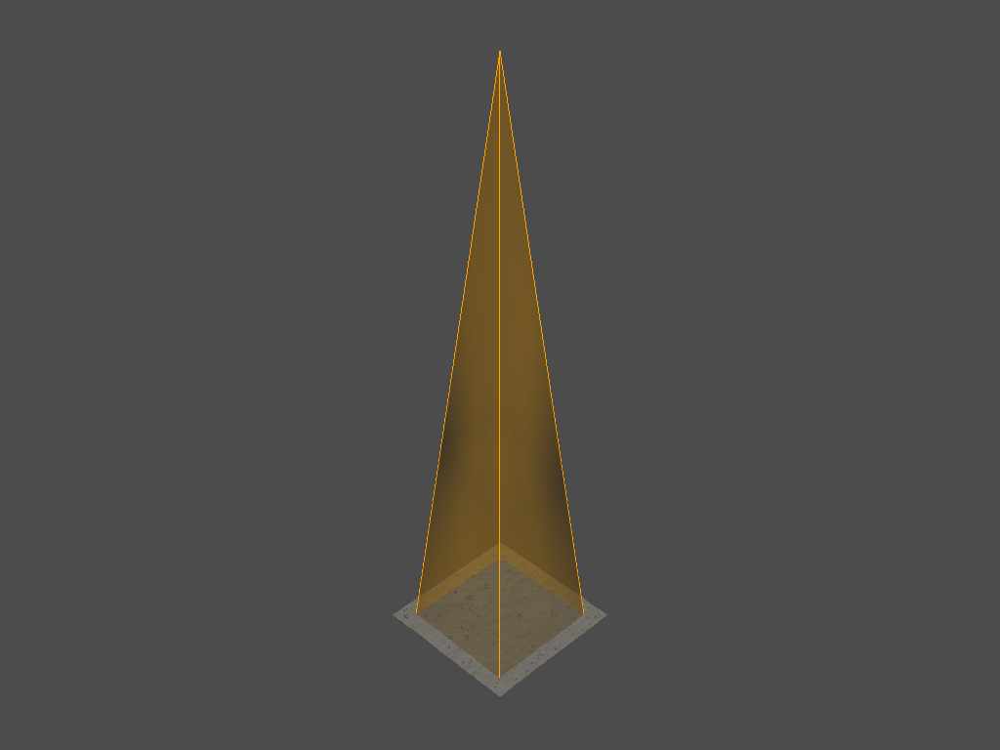

0


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


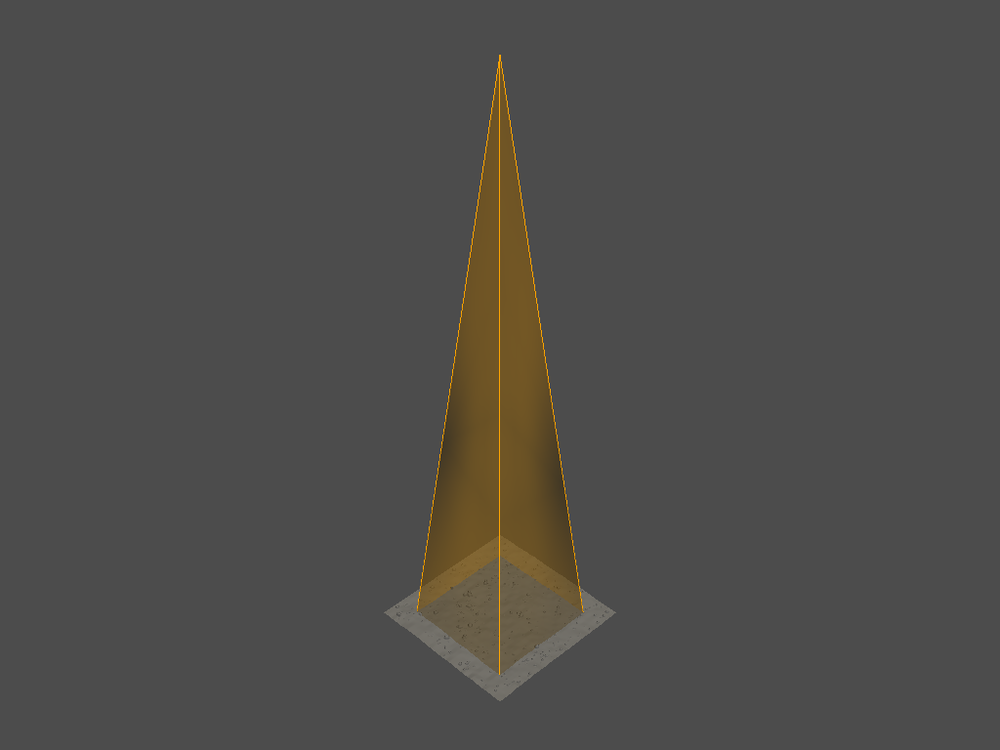

1


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


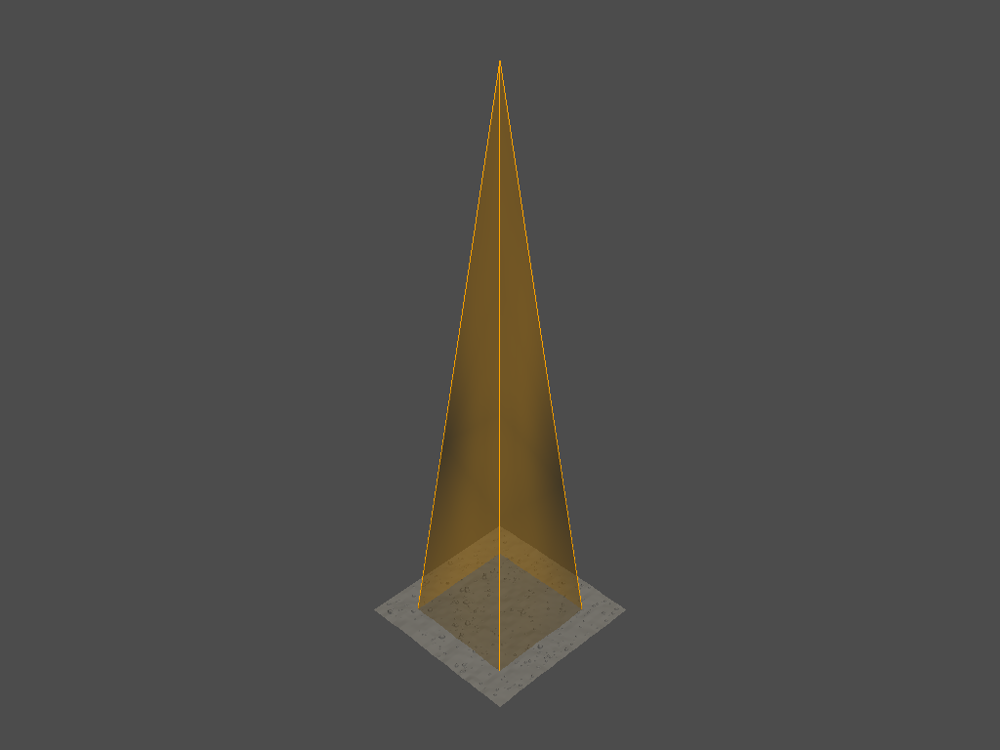

2


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


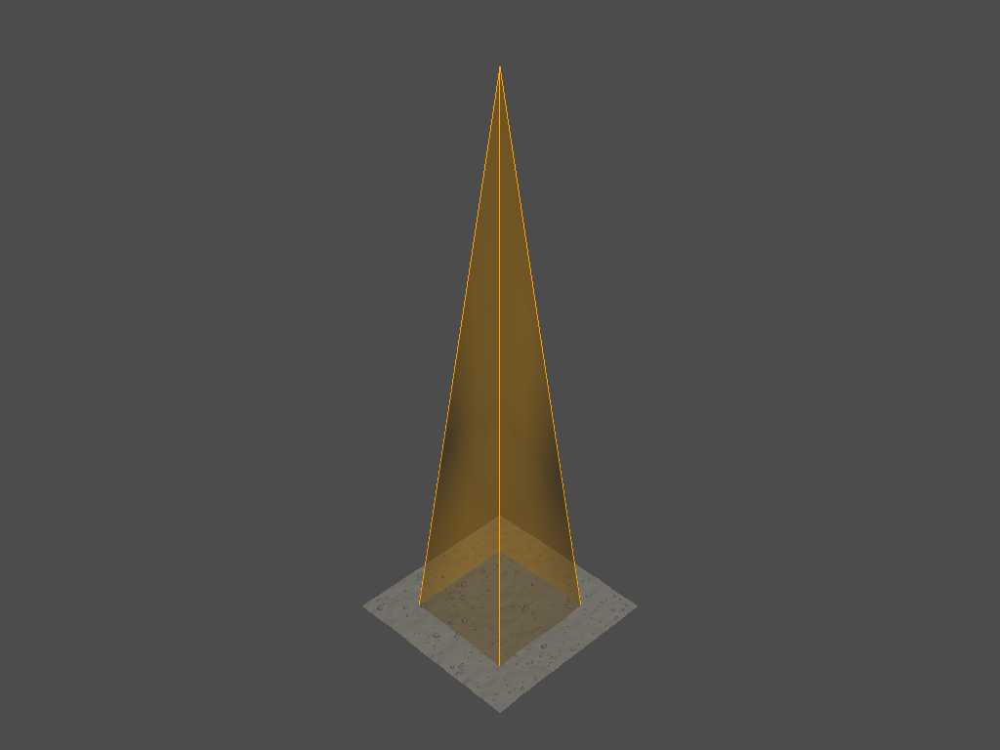

3


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


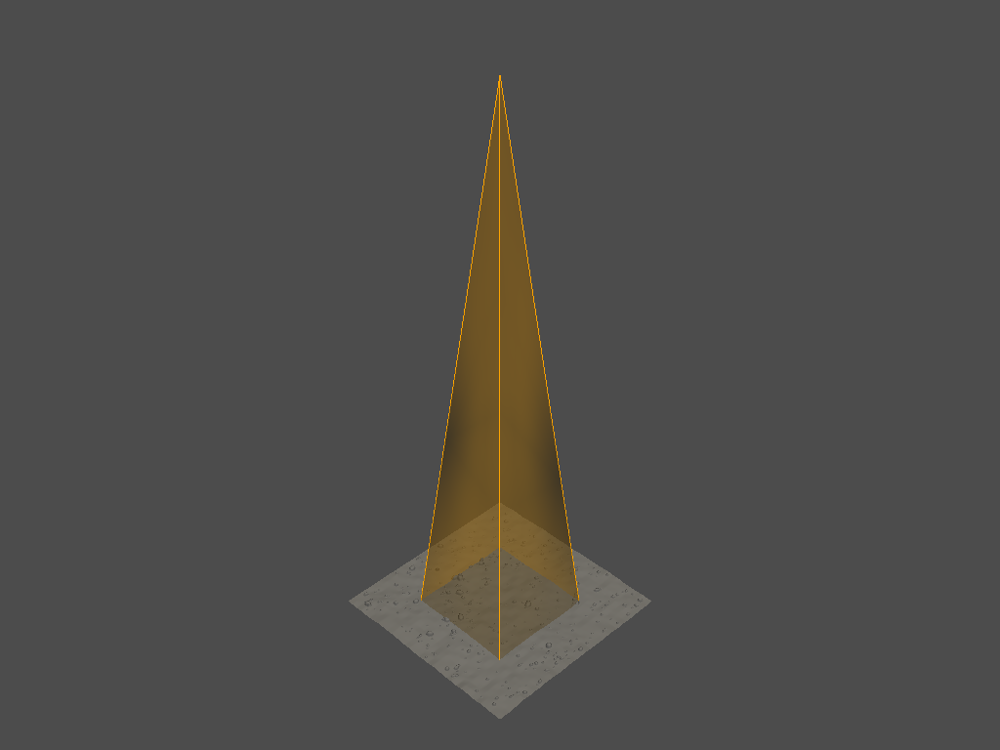

4


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


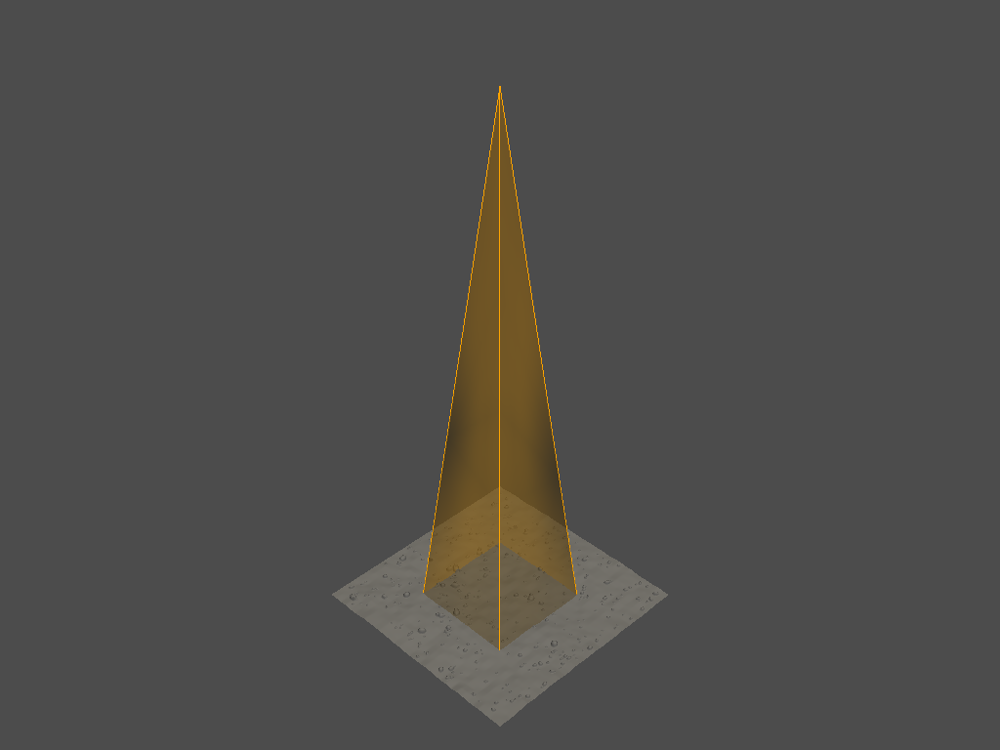

5


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


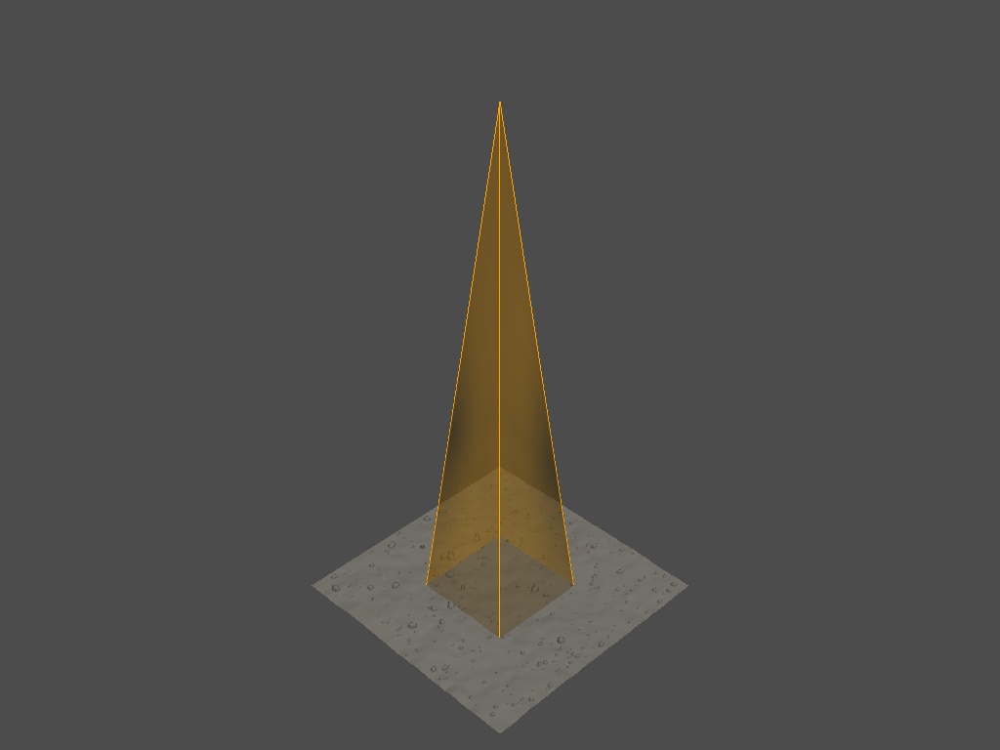

6


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


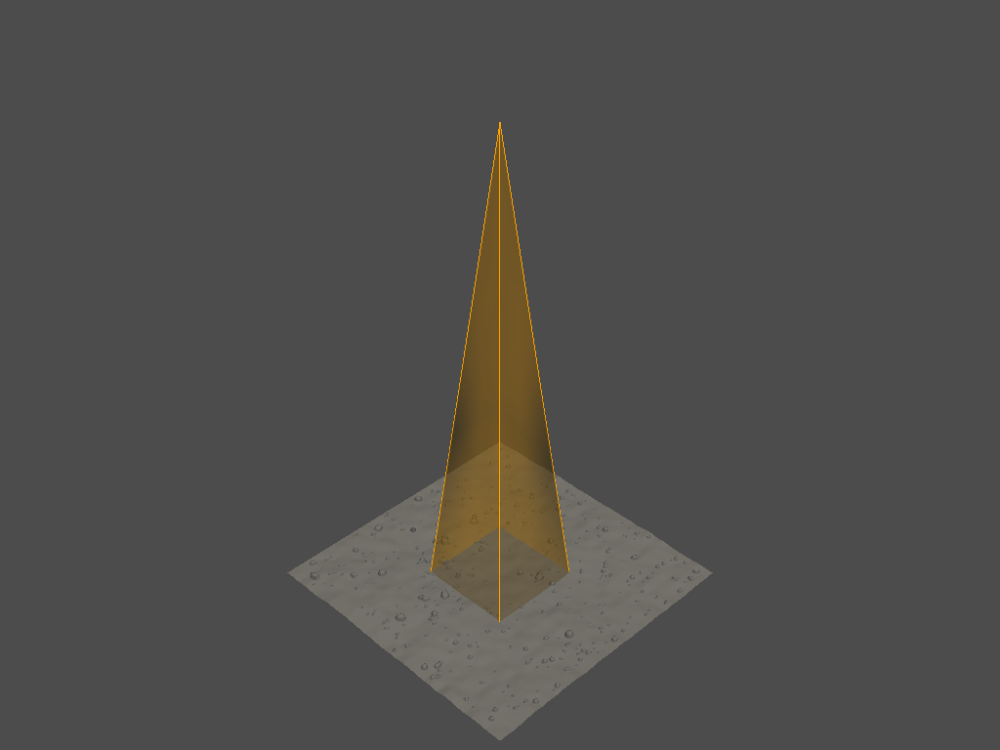

7


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


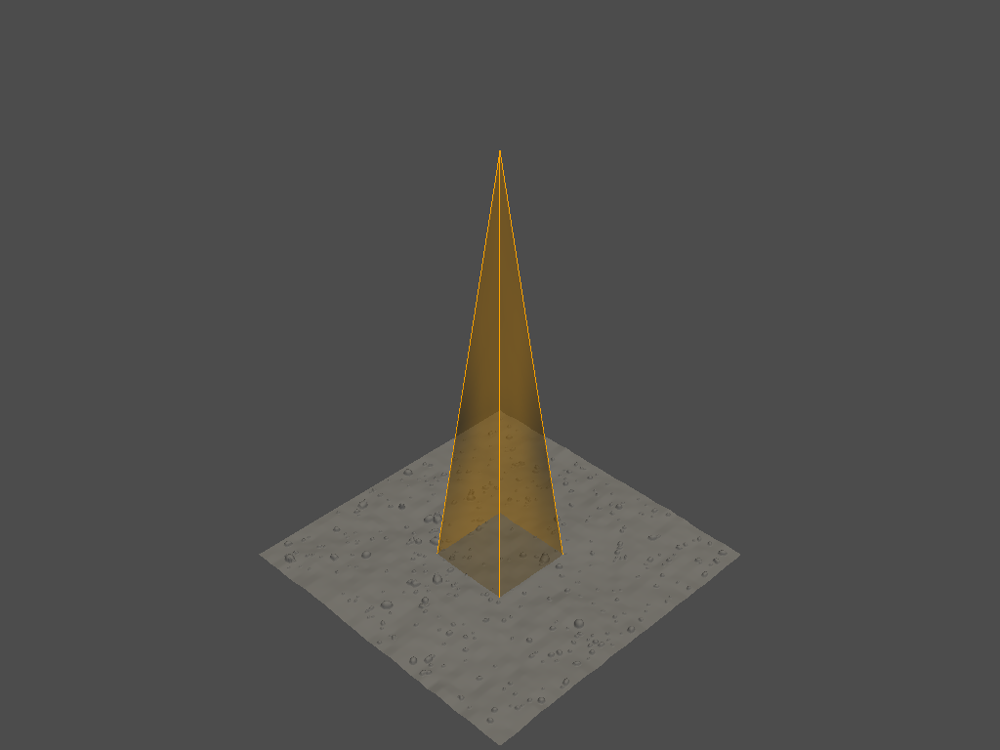

8


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


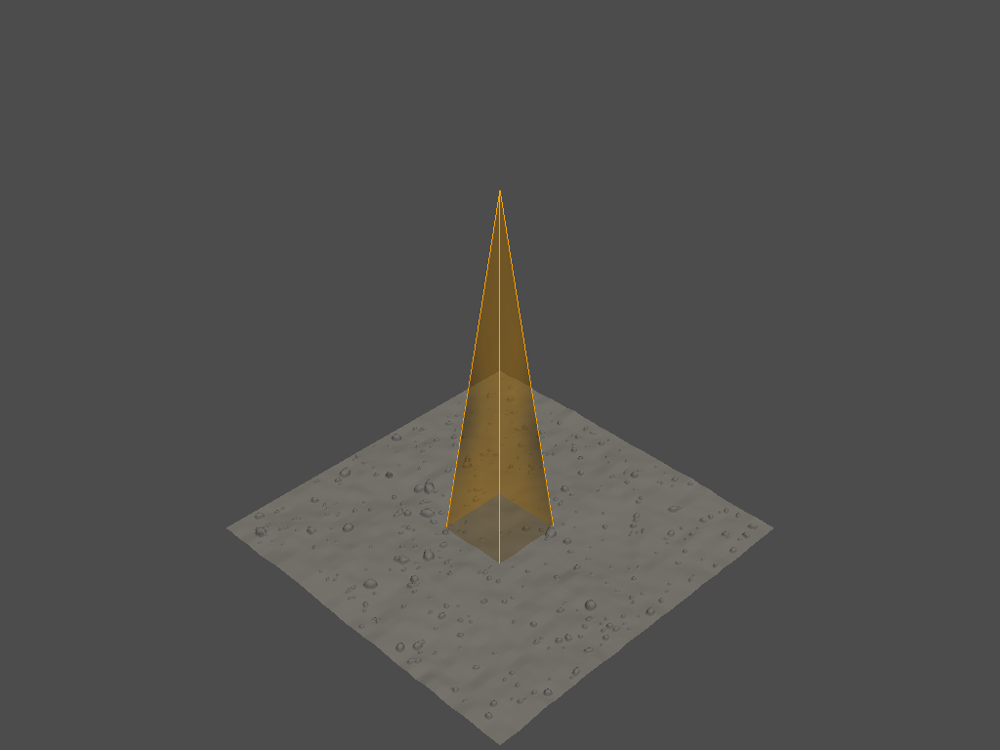

9
(4096, 3)
(256, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


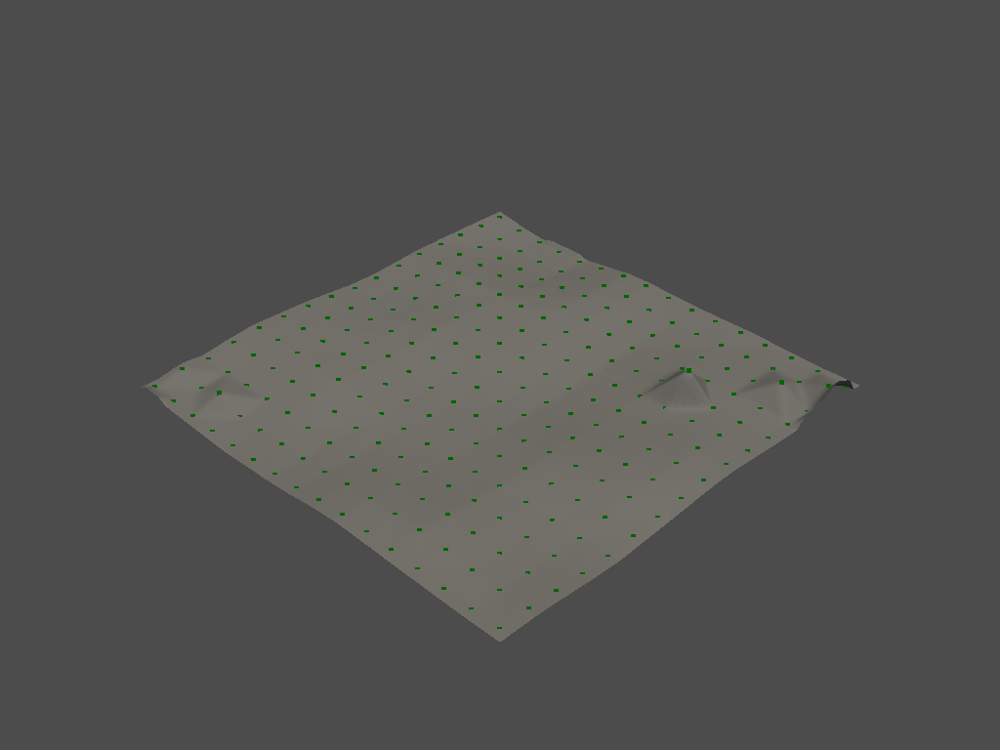

(4096, 3)
(324, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


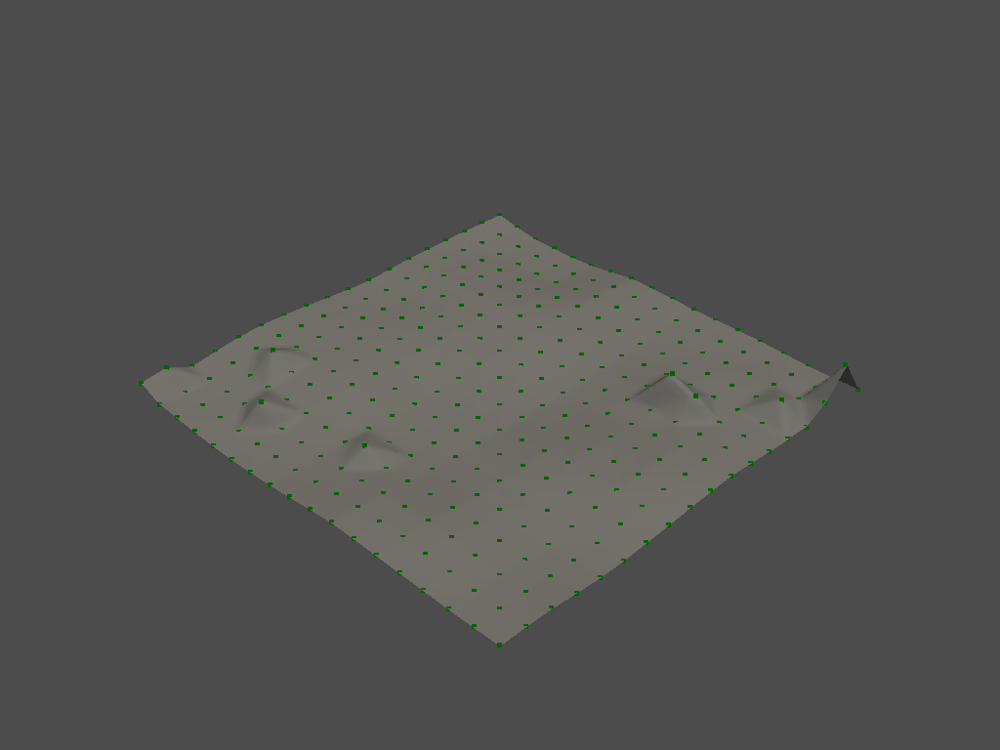

(4096, 3)
(324, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


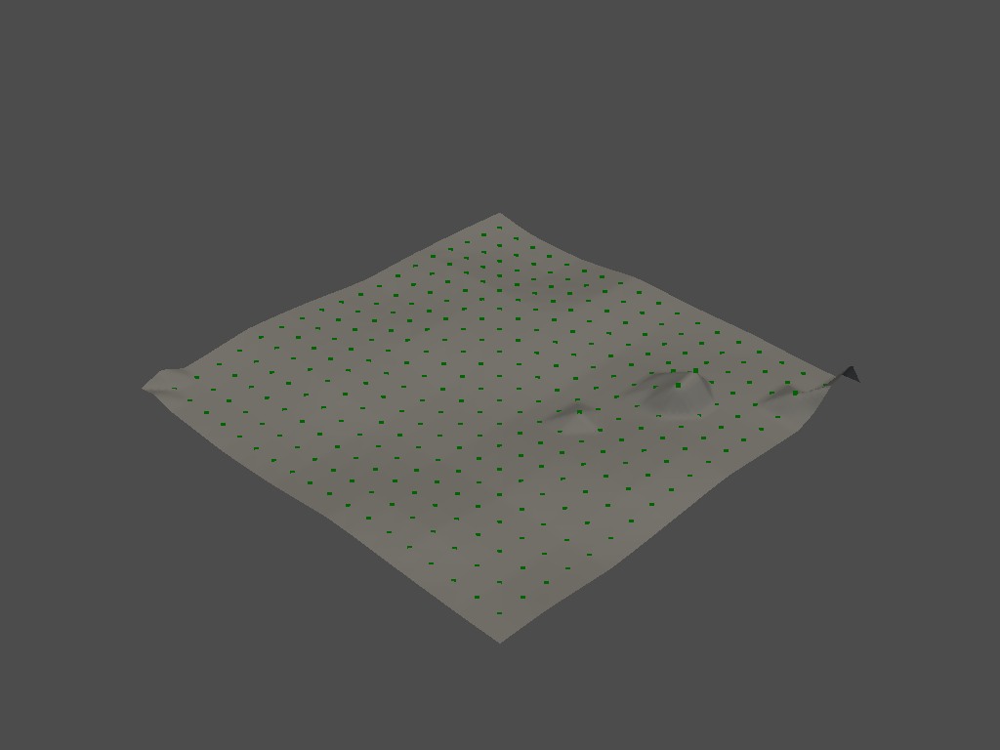

(4096, 3)
(463, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


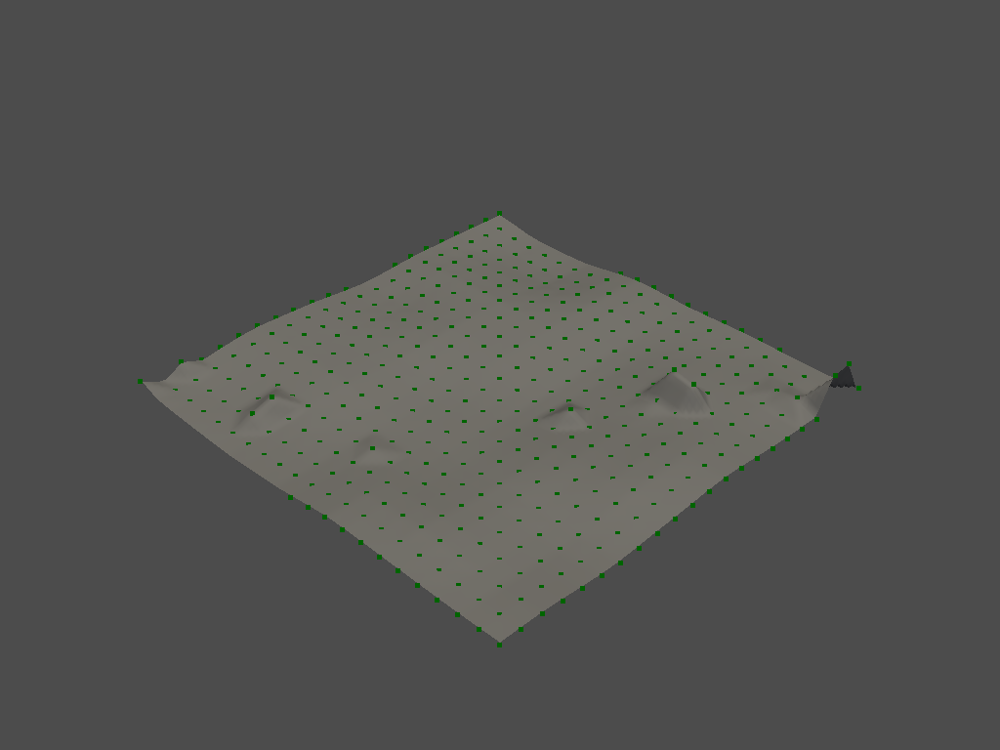

(4095, 3)
(576, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


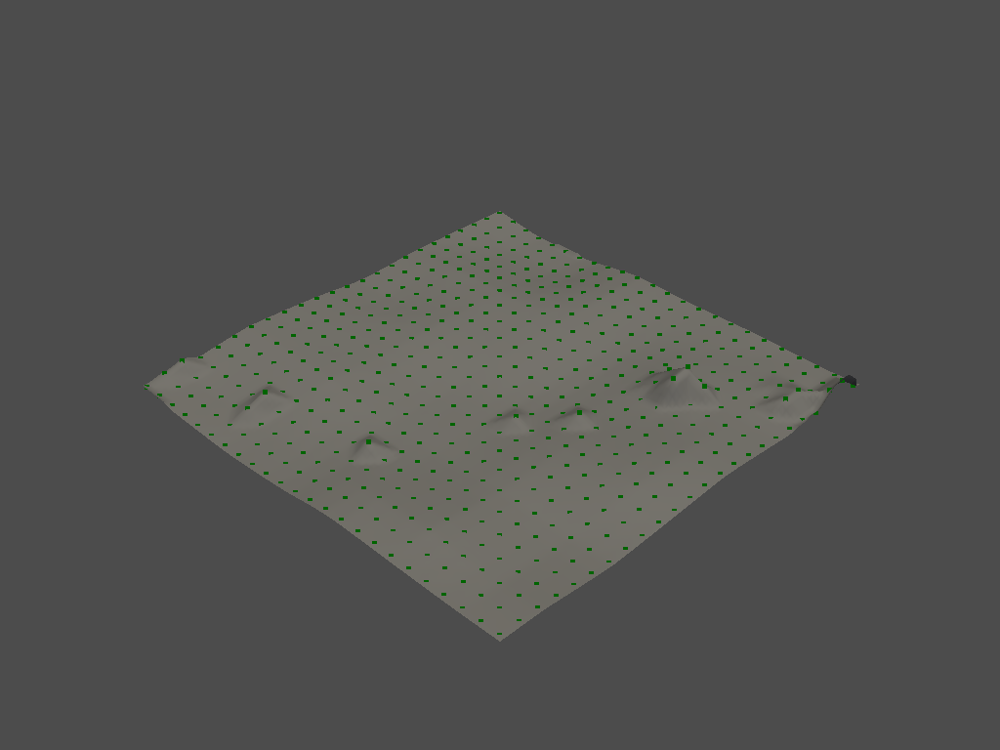

(4096, 3)
(756, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


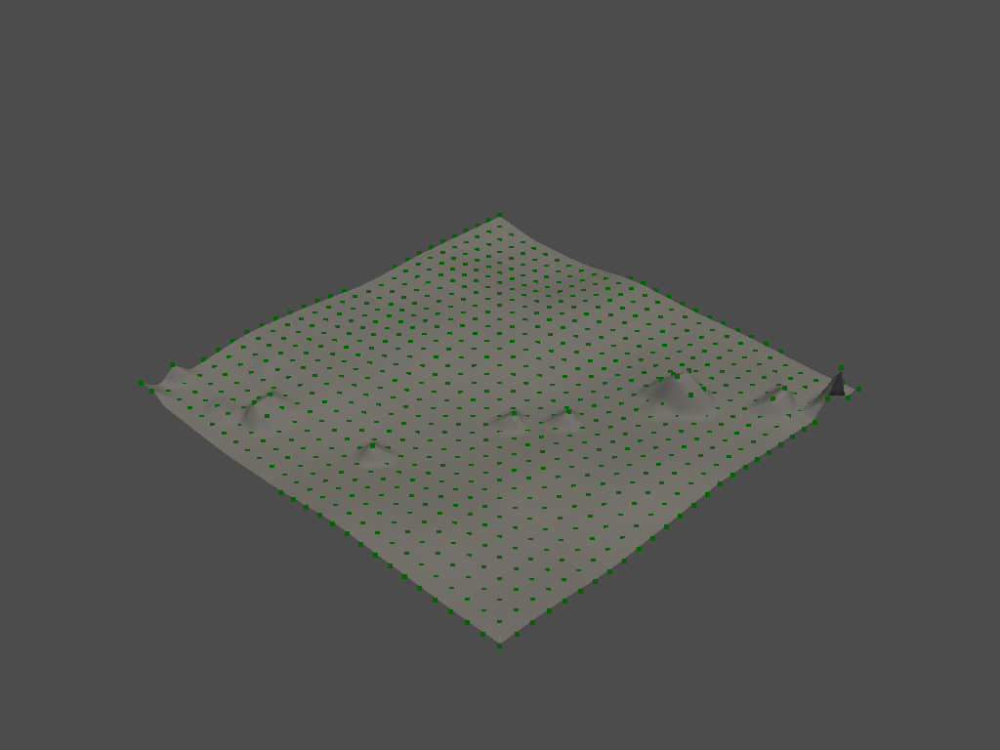

(4096, 3)
(1024, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


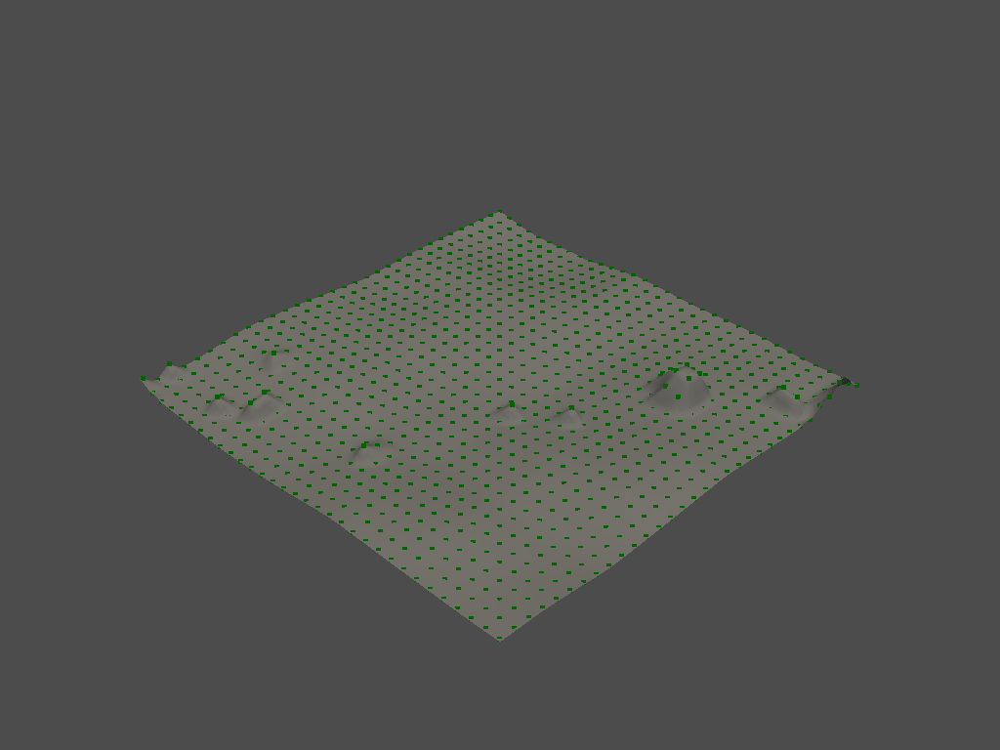

(4096, 3)
(1444, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


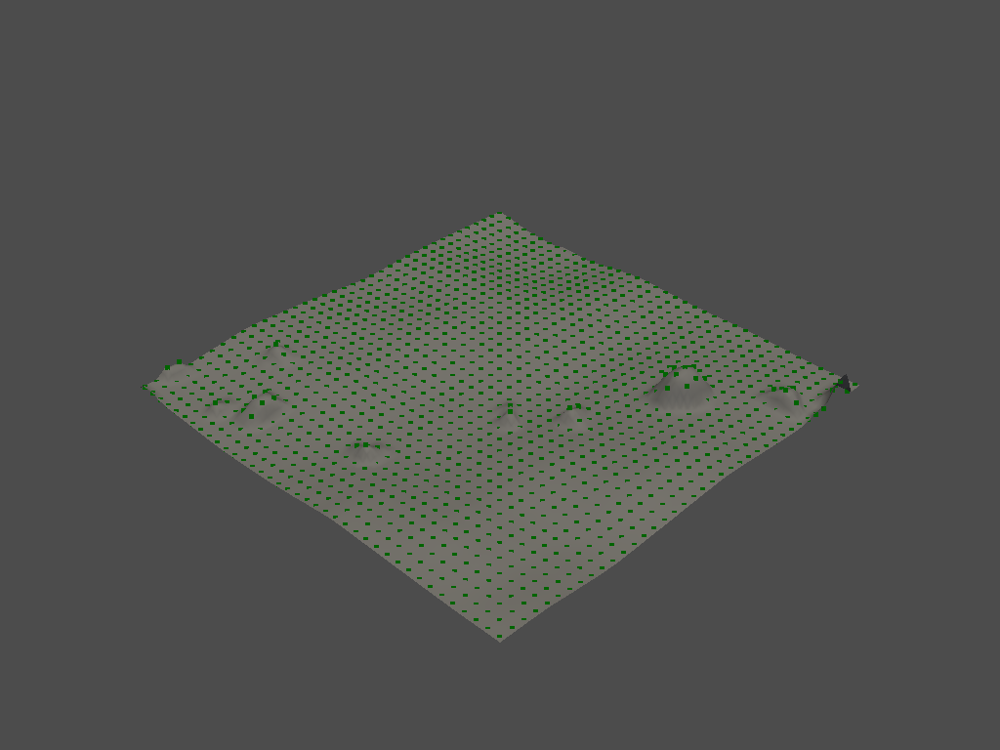

(4096, 3)
(2304, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


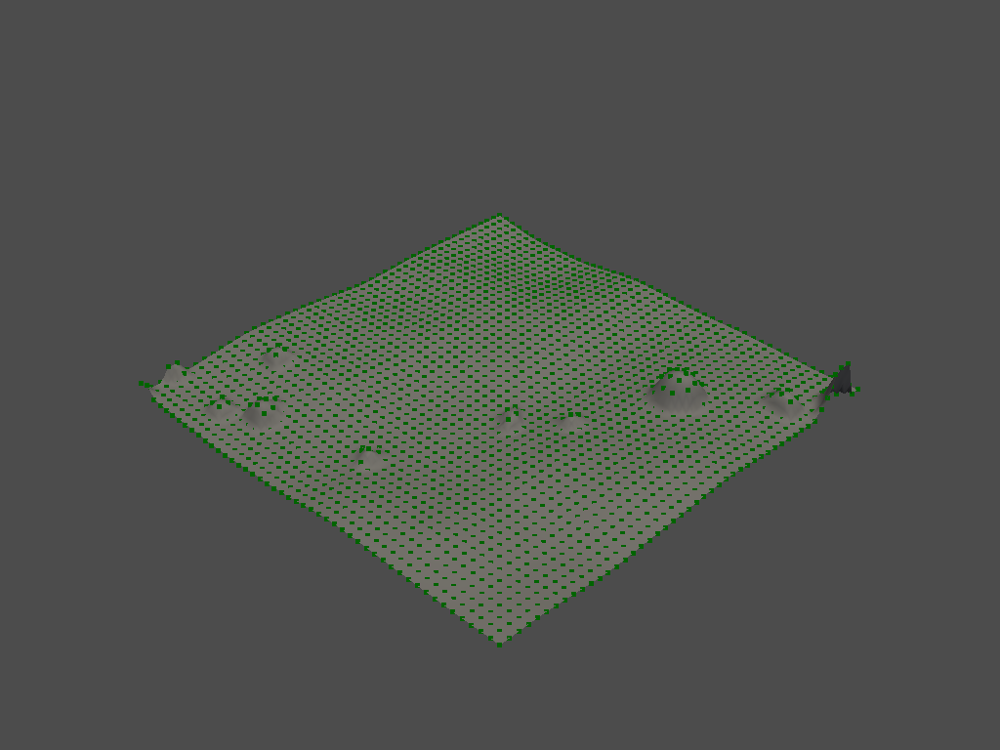

(4096, 3)
(4034, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


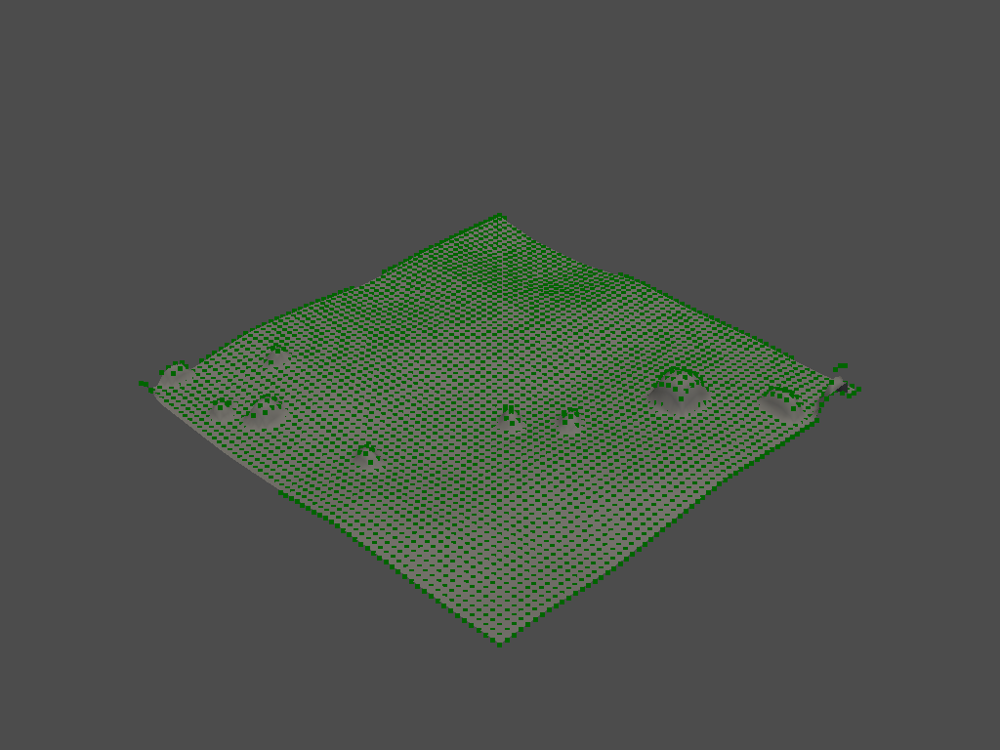

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


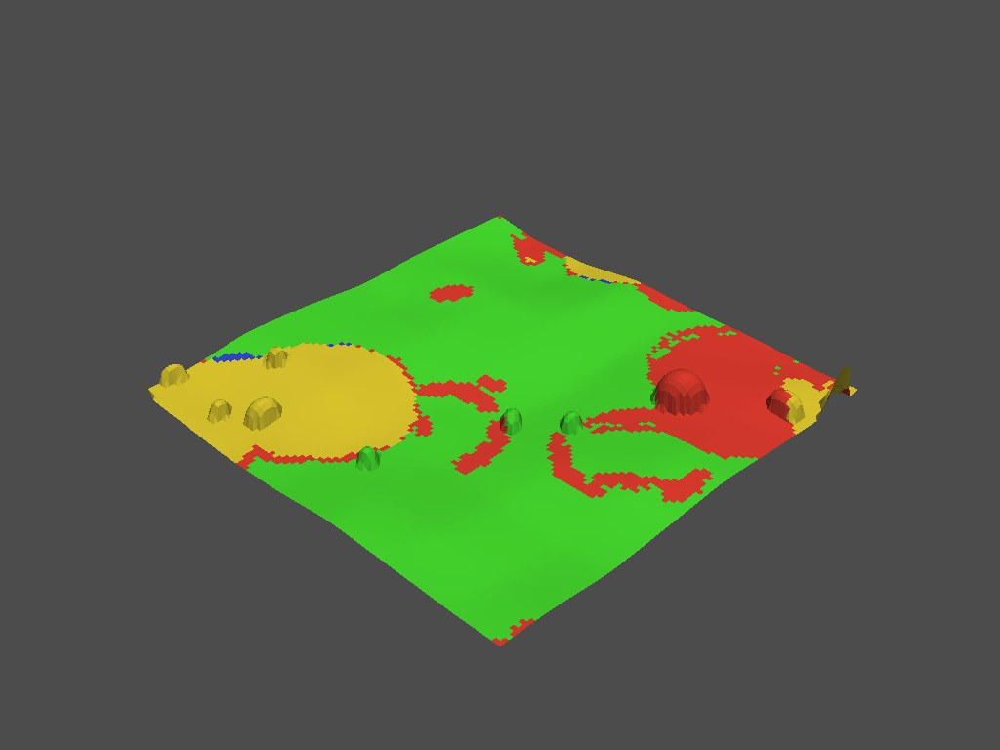

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


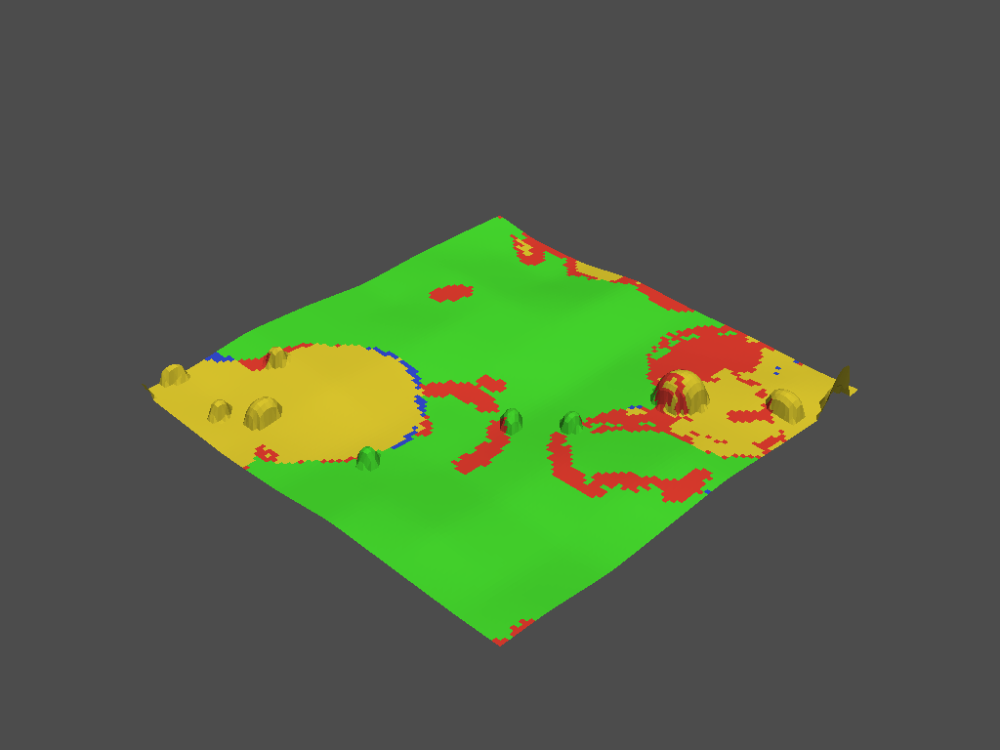

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


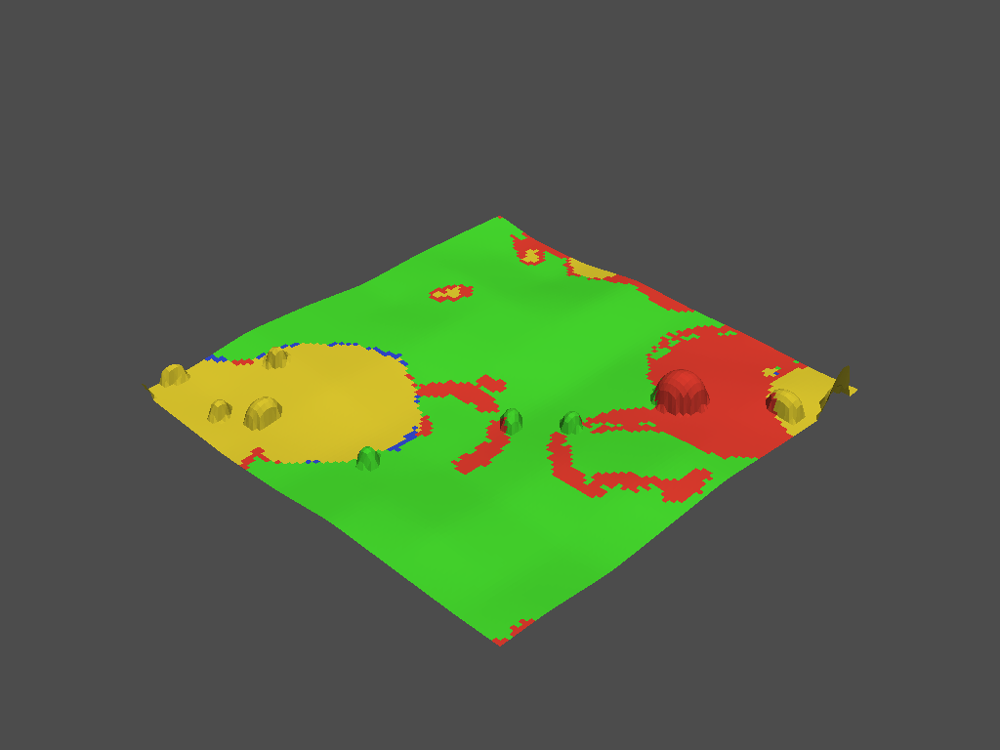

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


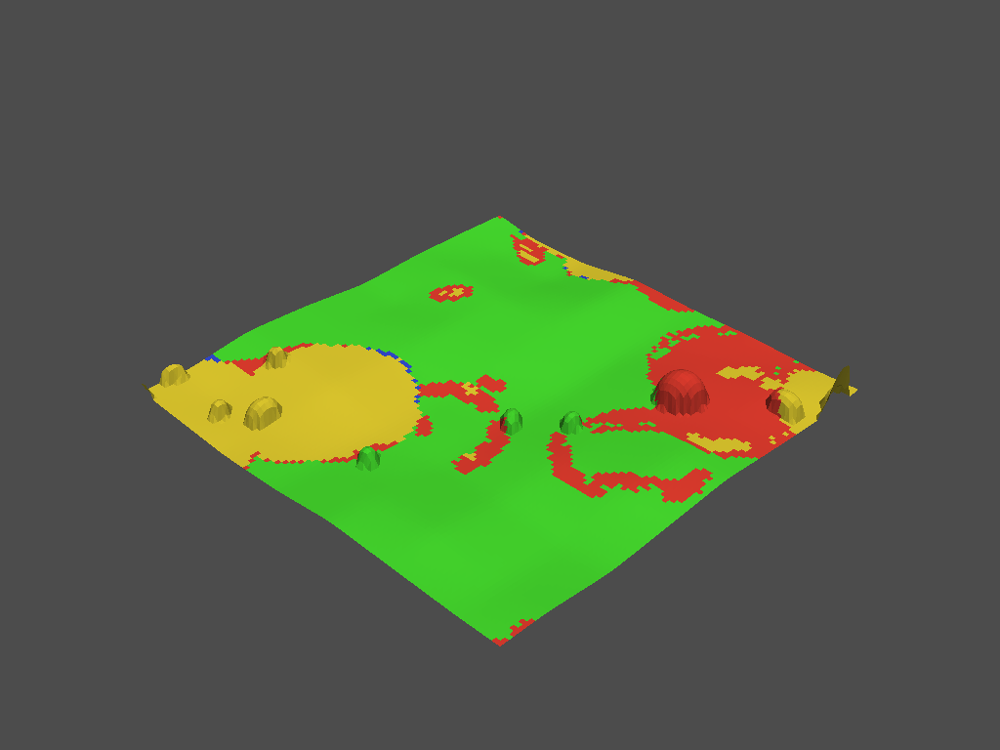

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


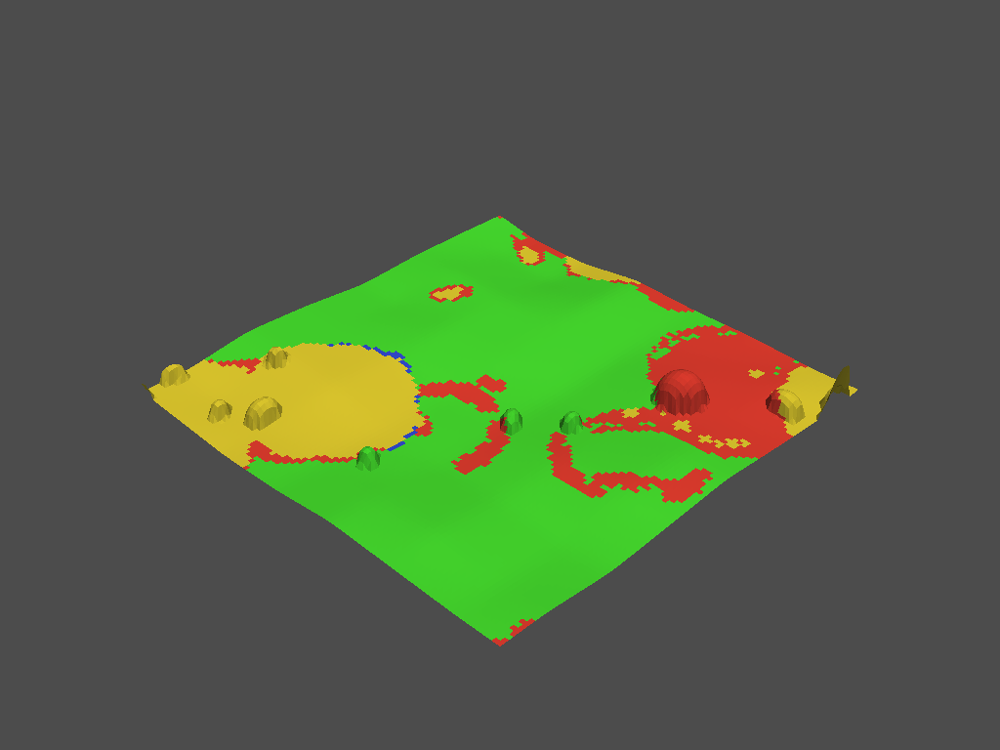

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


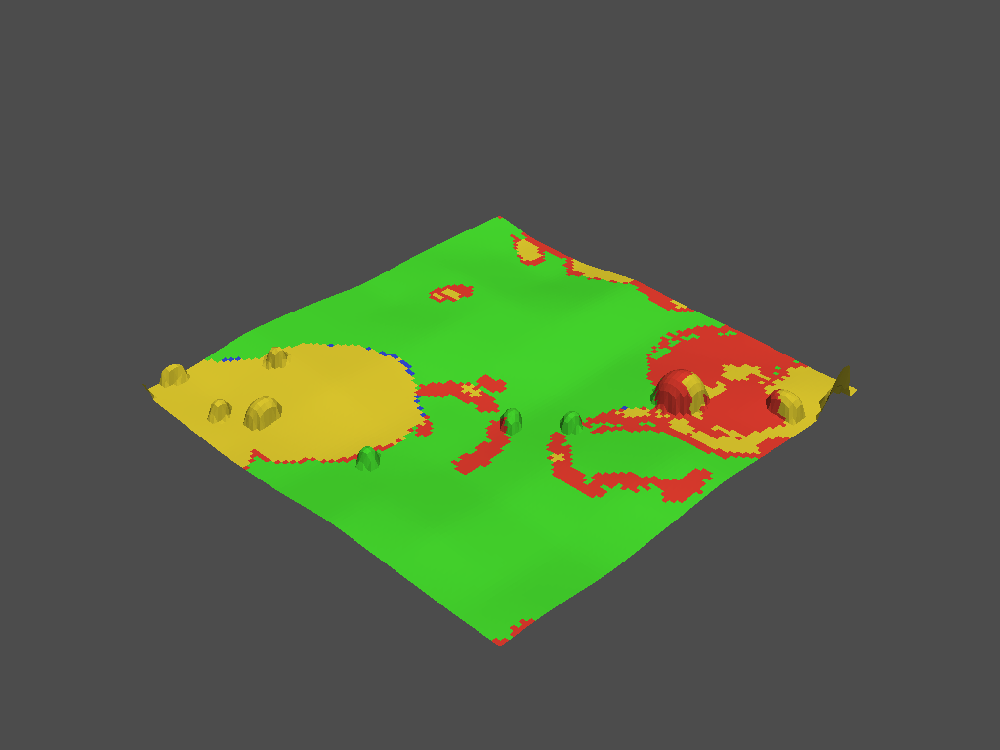

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


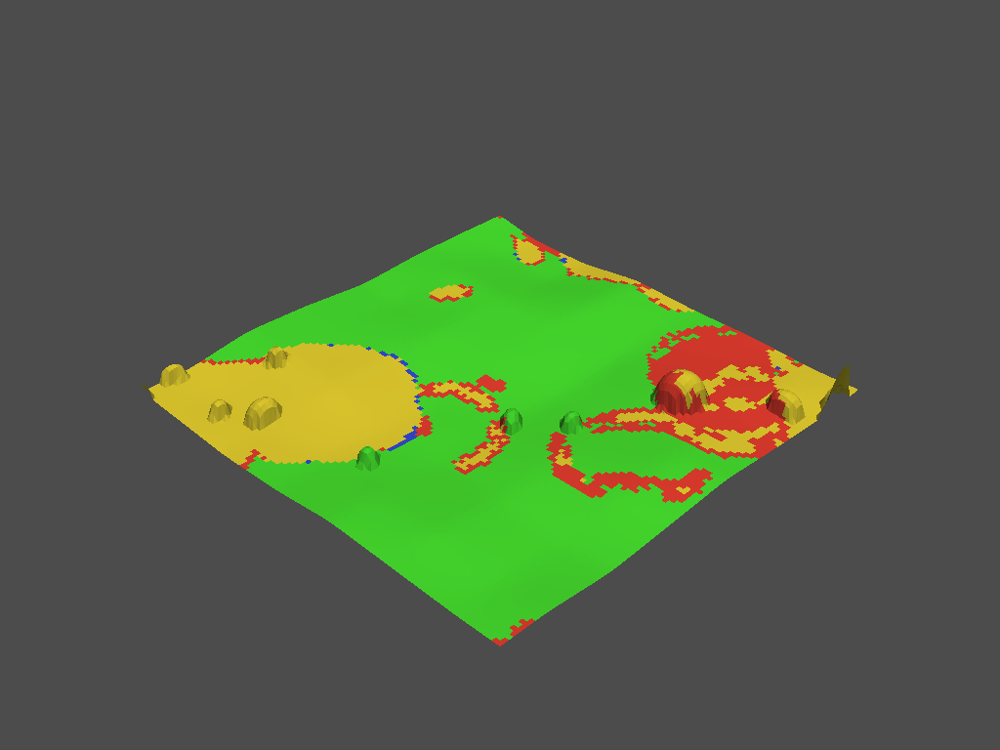

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


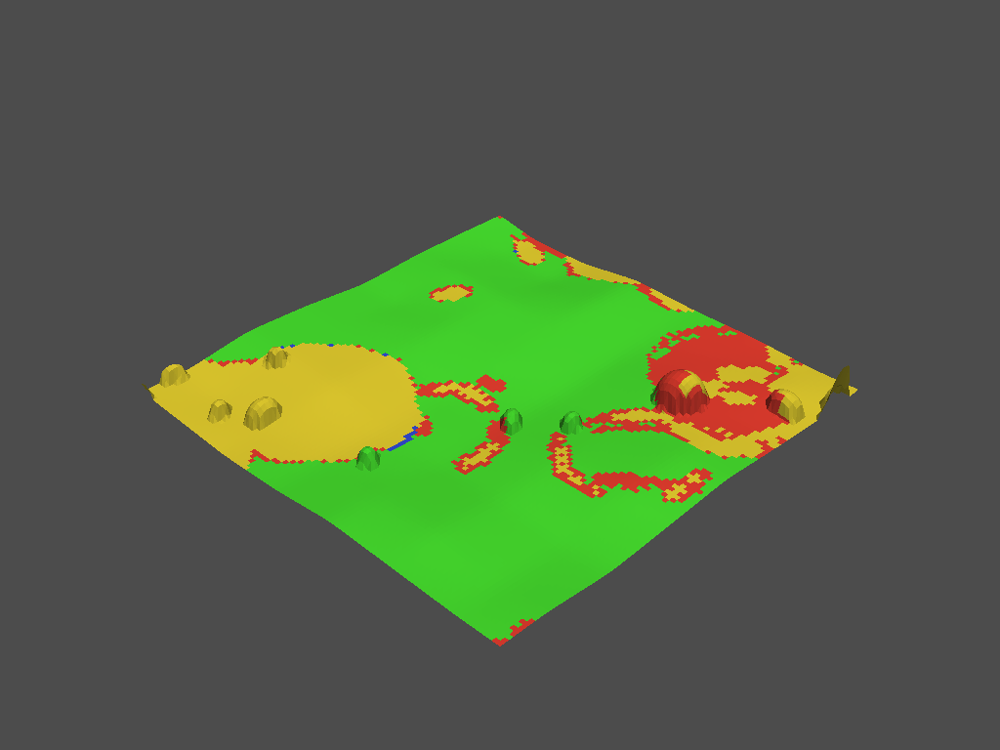

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


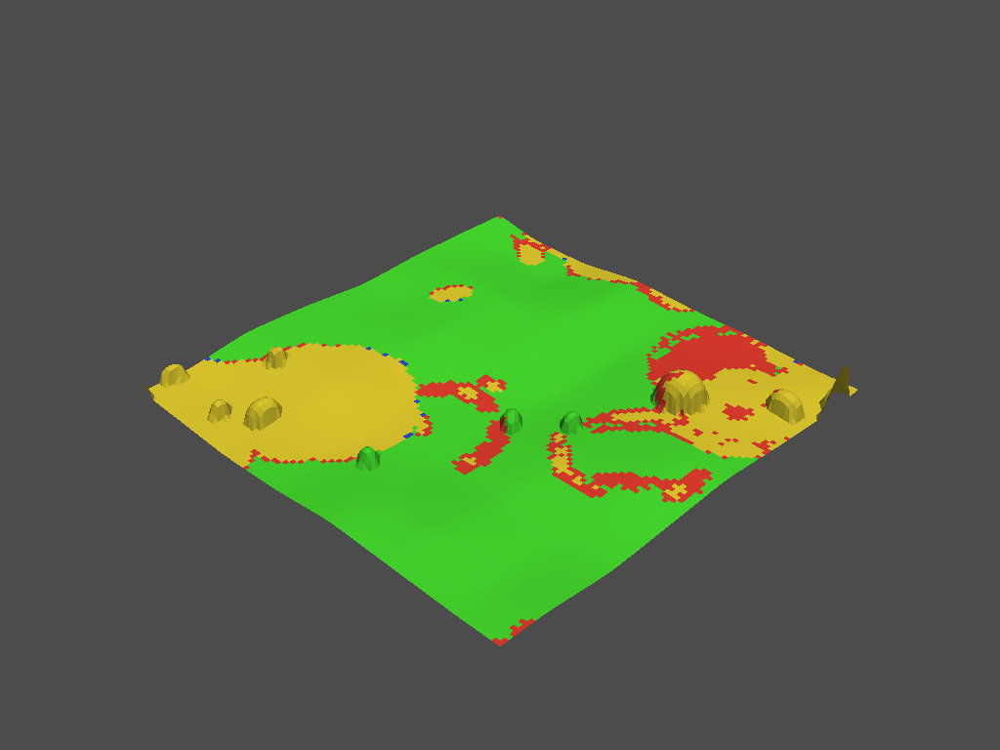

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


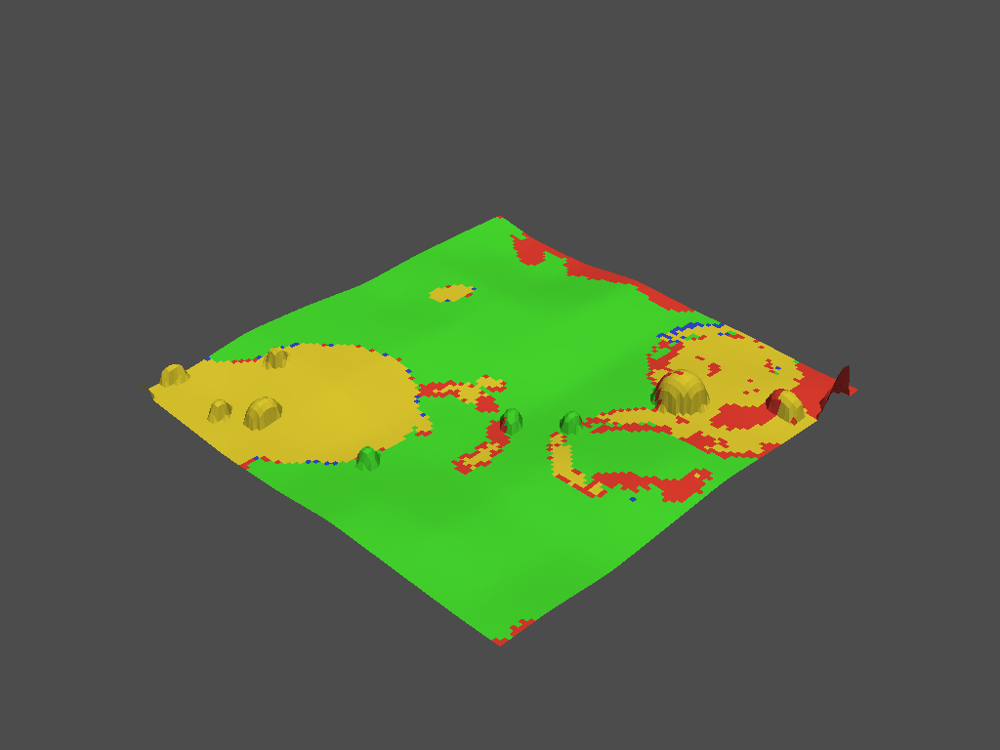

C:\Users\ktomita3\AppData\Local\Temp\ipykernel_26212\2991450551.py:88: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  images = [imageio.imread(file) for file in file_list]
c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


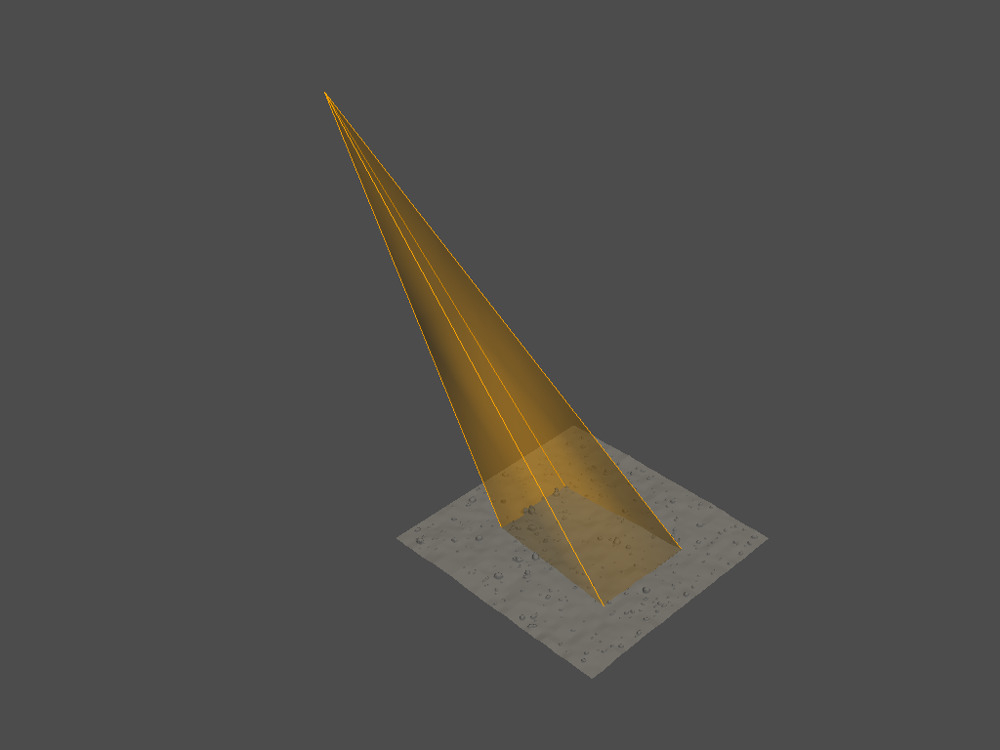

0


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


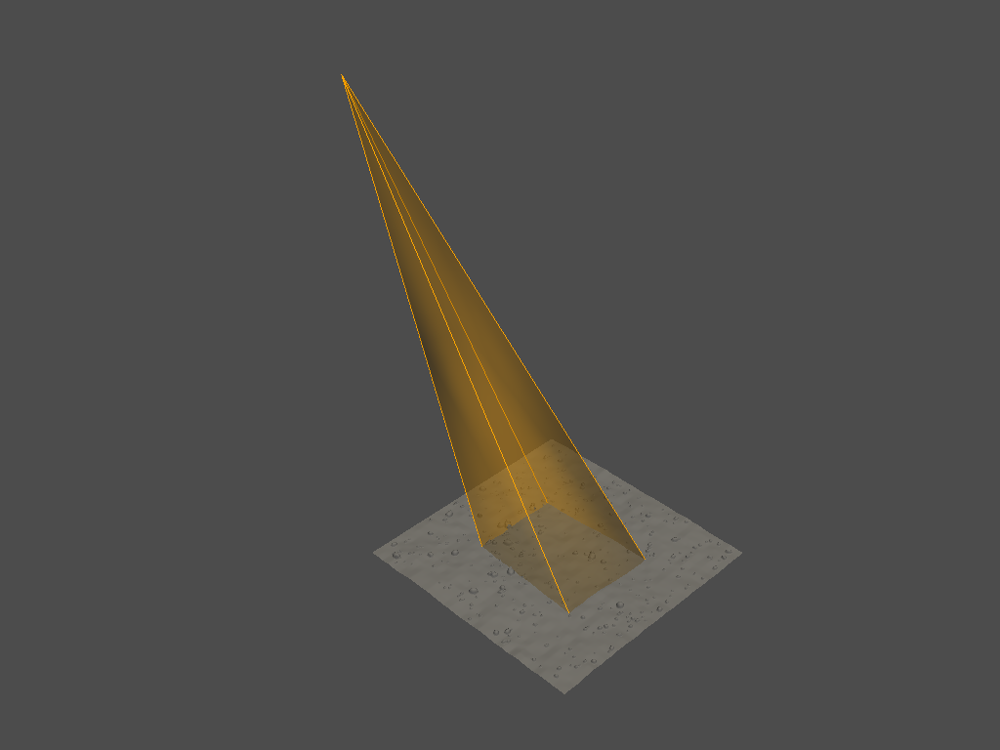

1


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


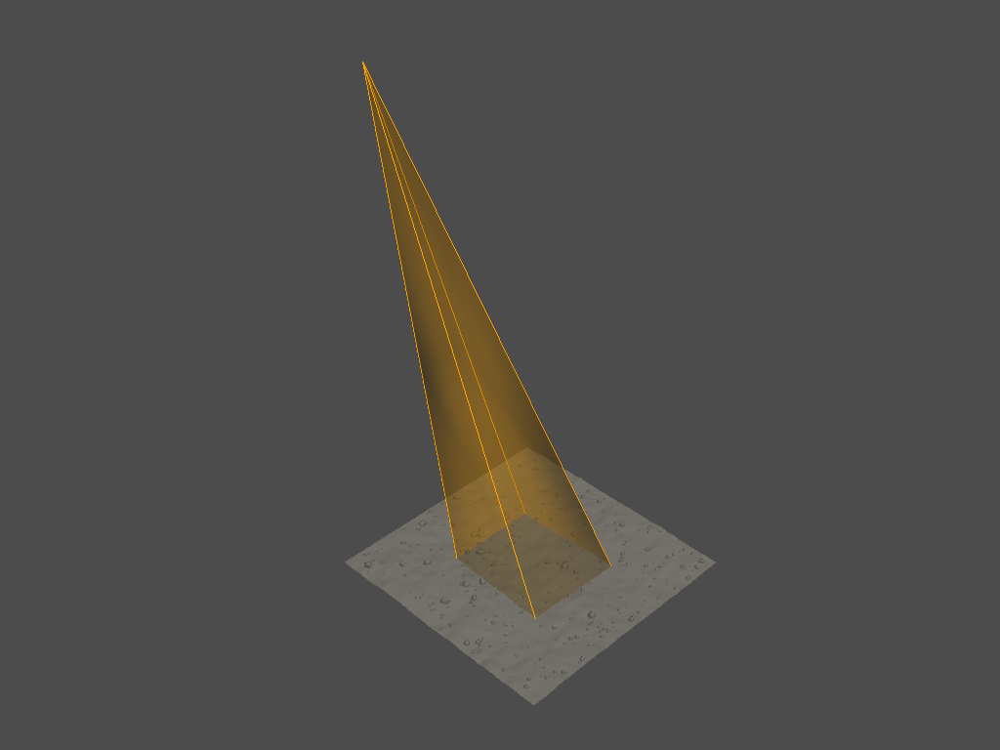

2


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


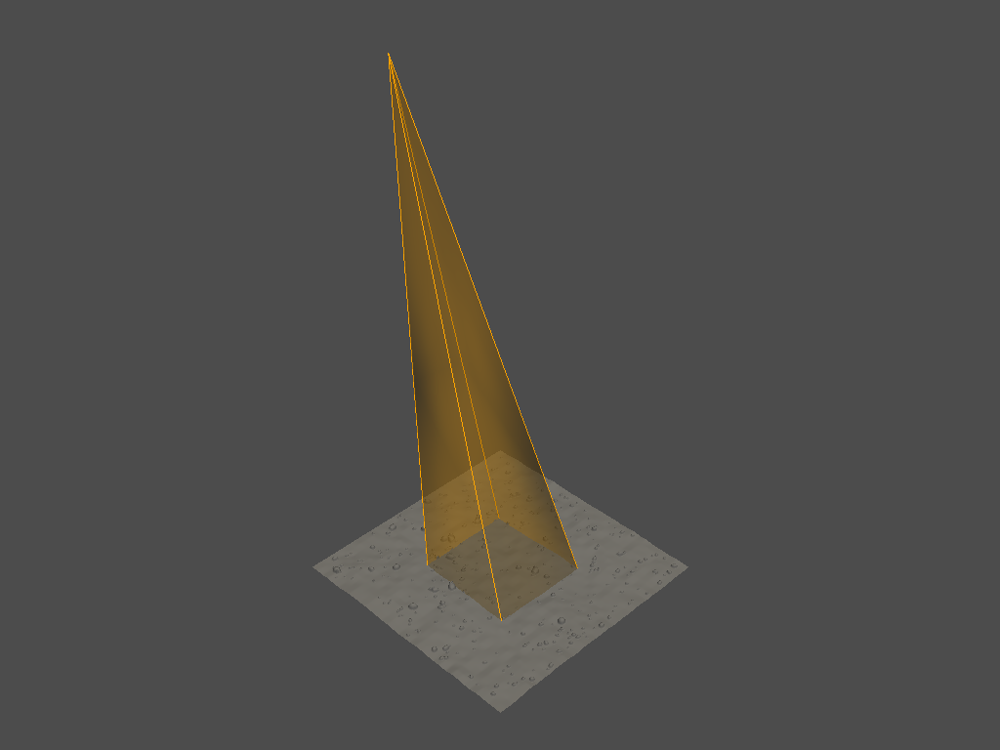

3


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


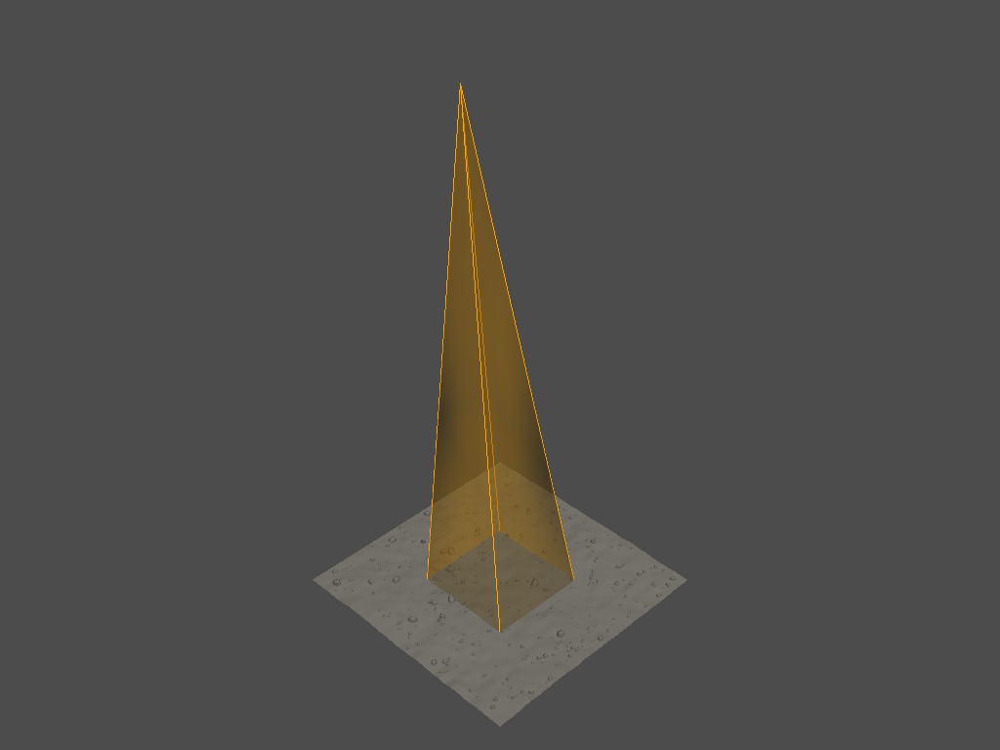

4


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


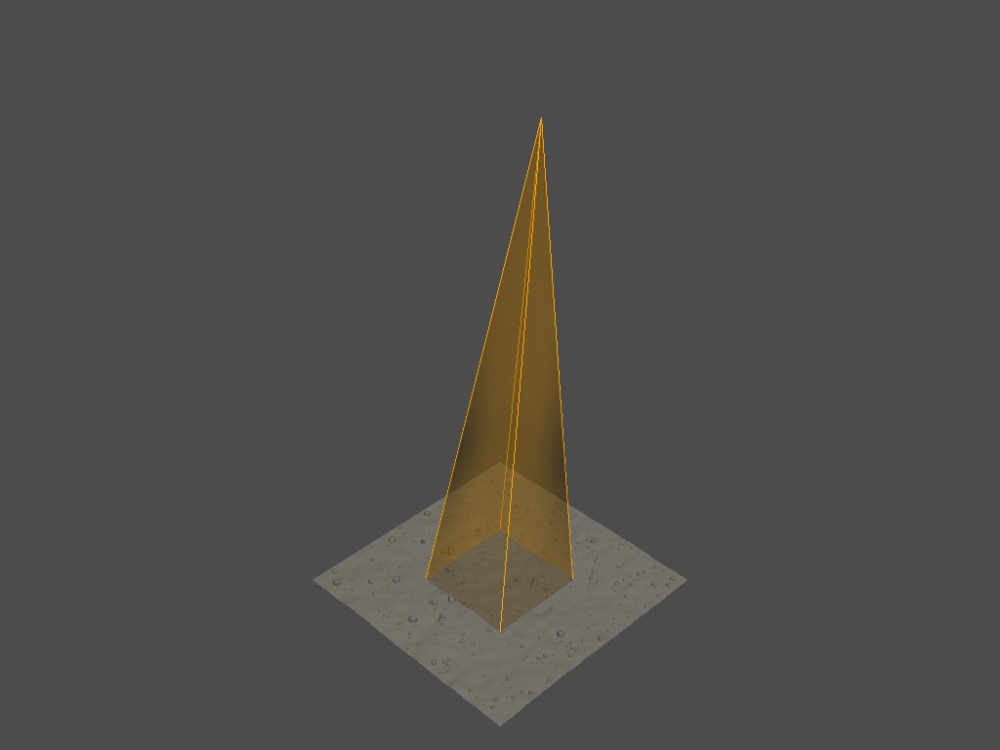

5


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


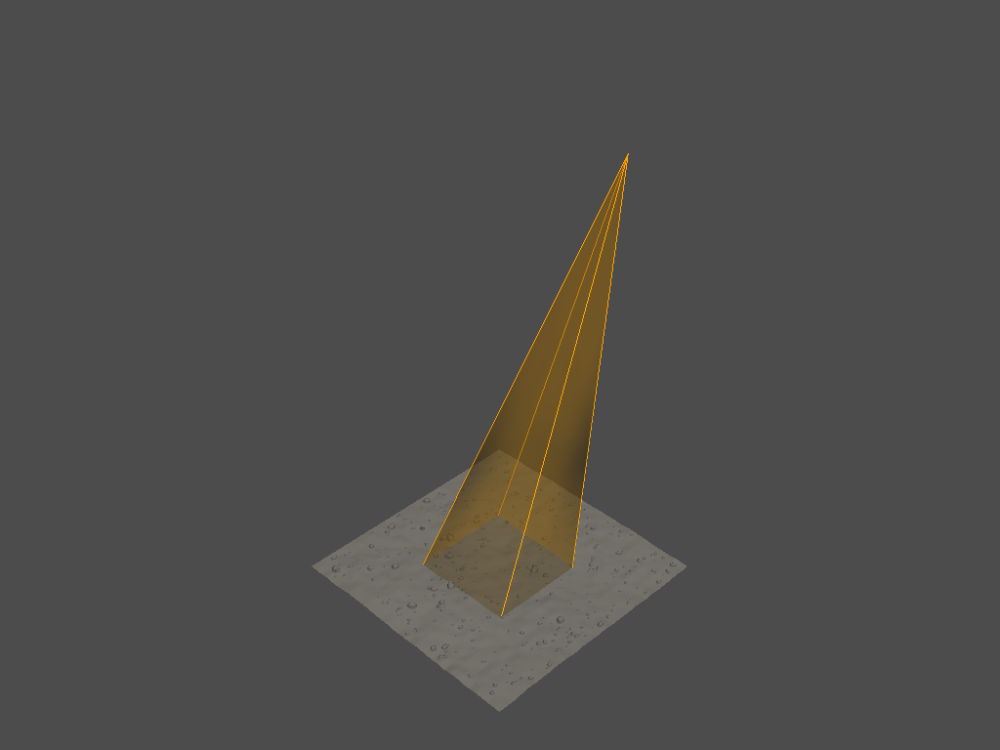

6


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


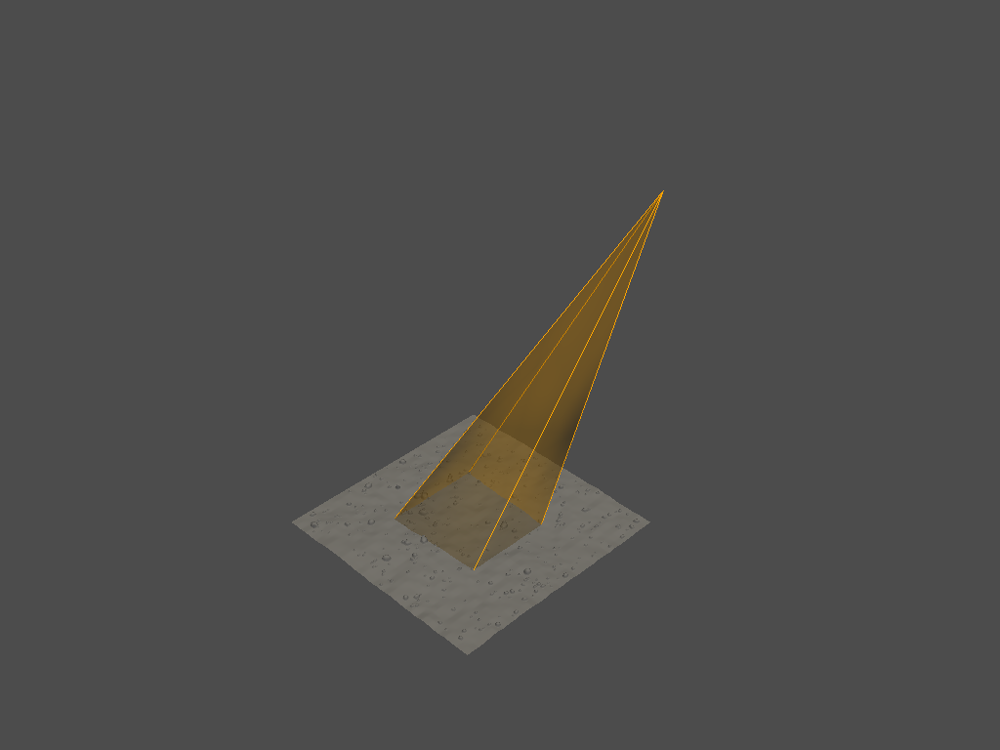

7


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


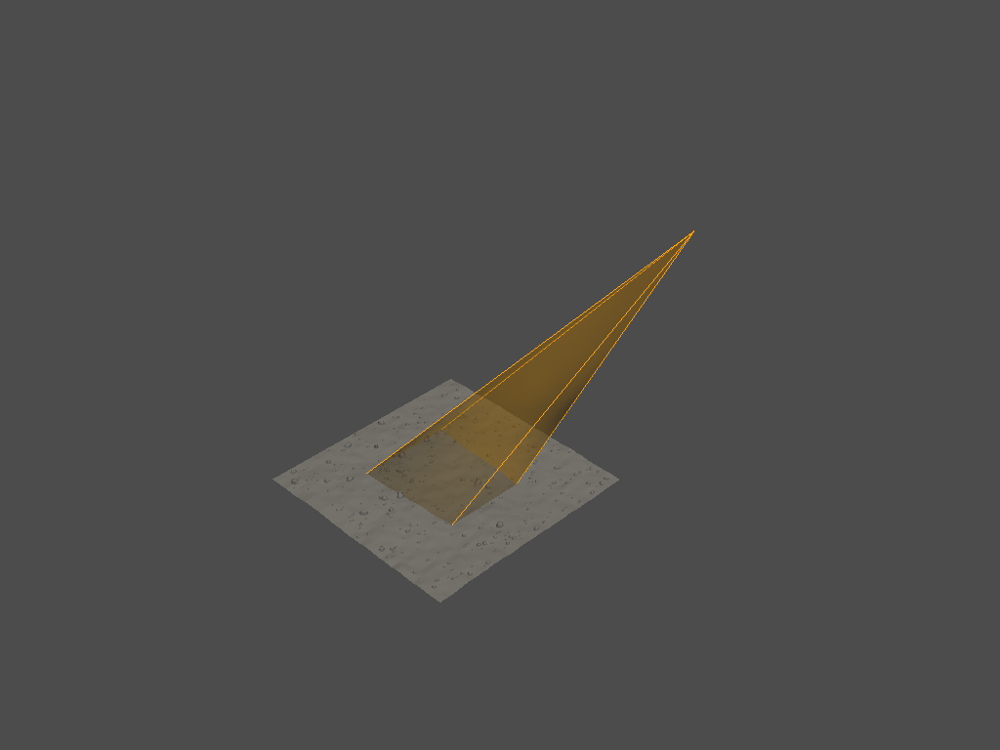

8


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


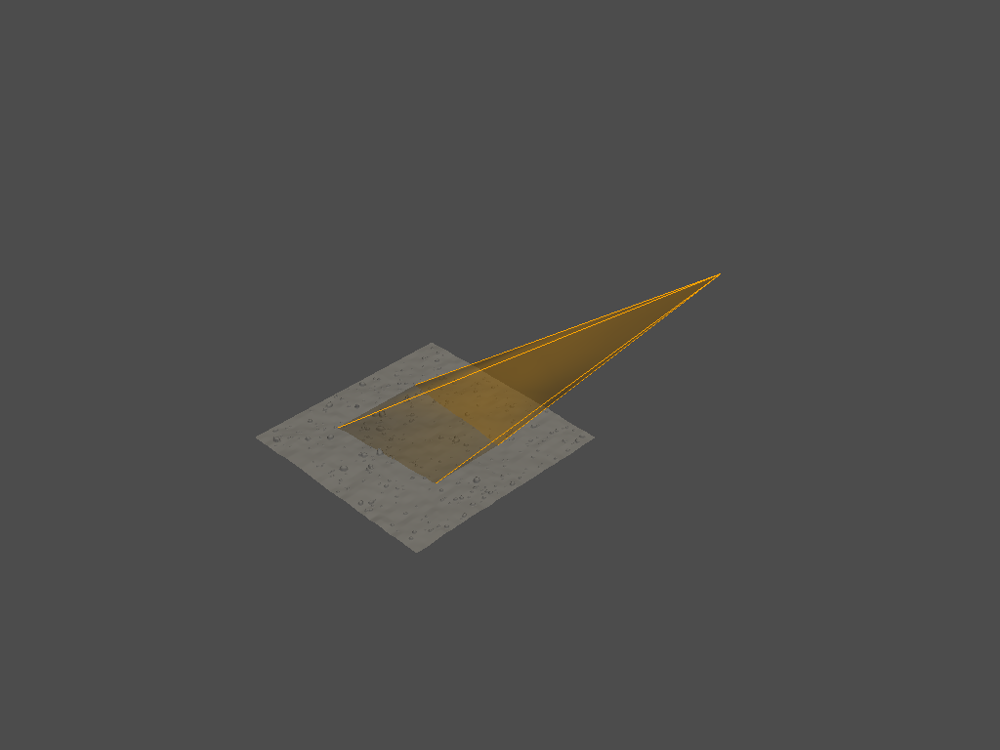

9
(4096, 3)
(705, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


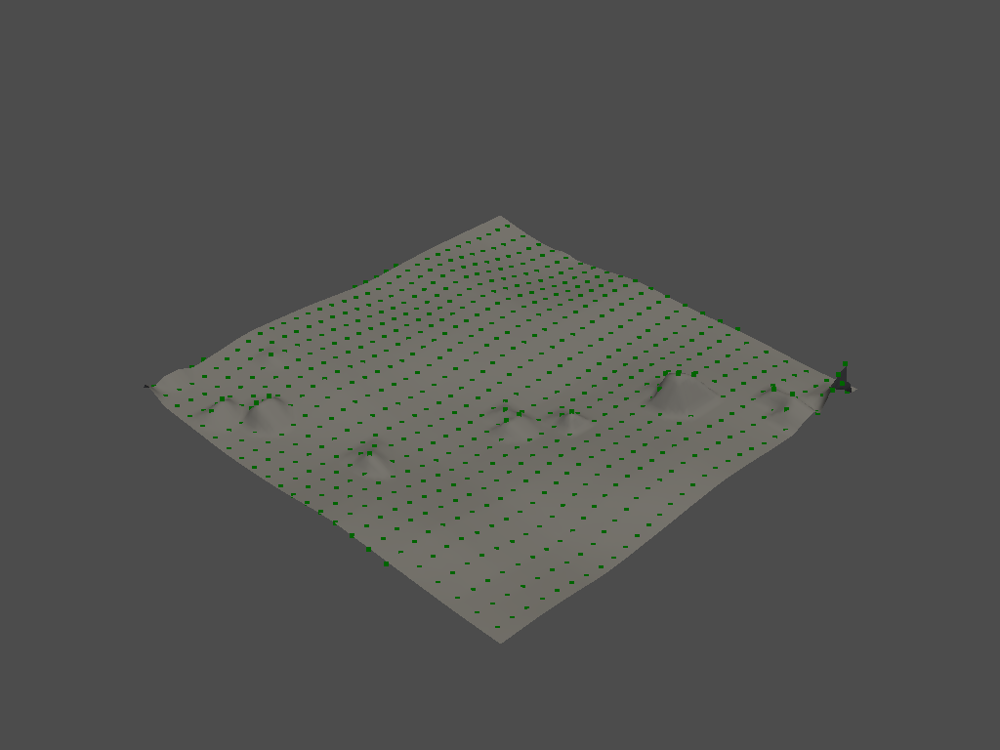

(4096, 3)
(823, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


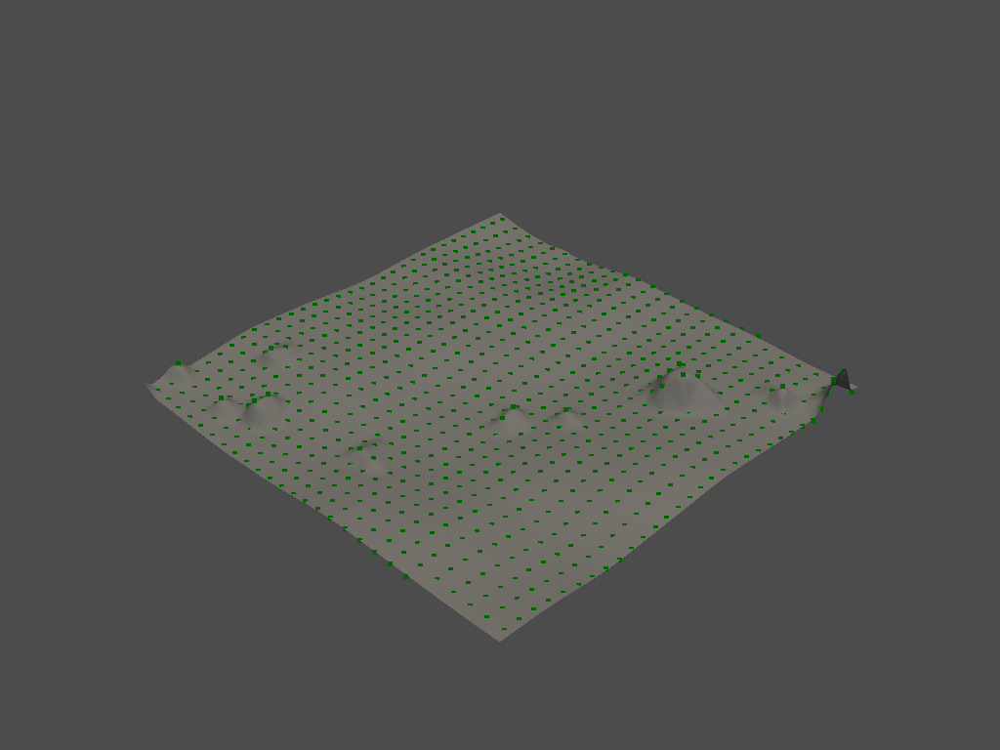

(4096, 3)
(914, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


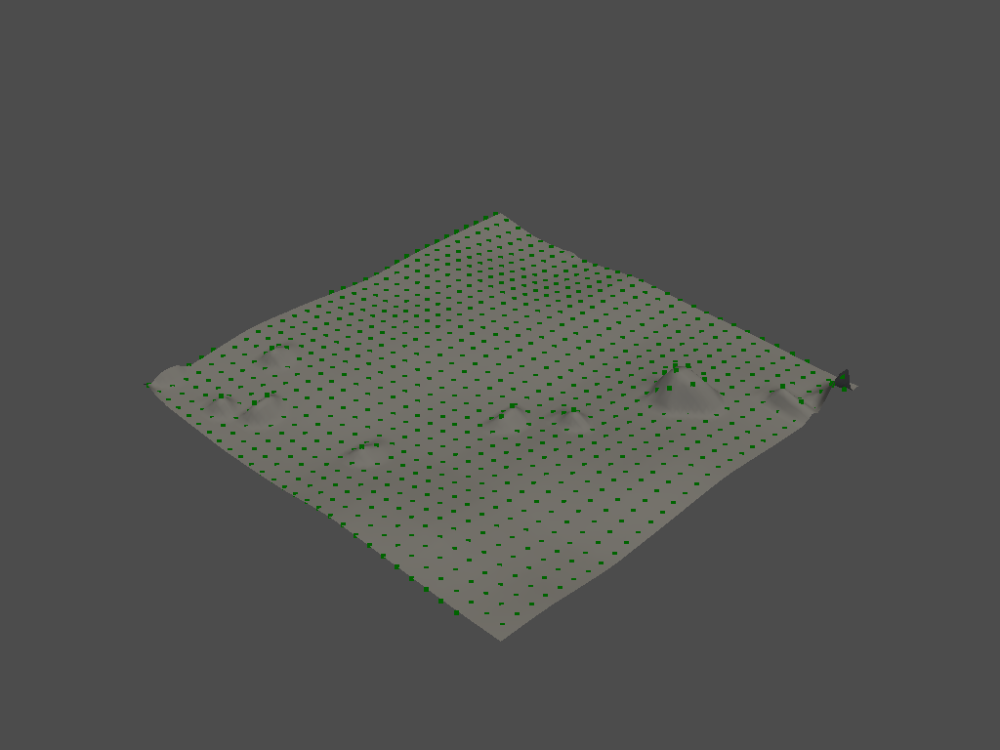

(4096, 3)
(962, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


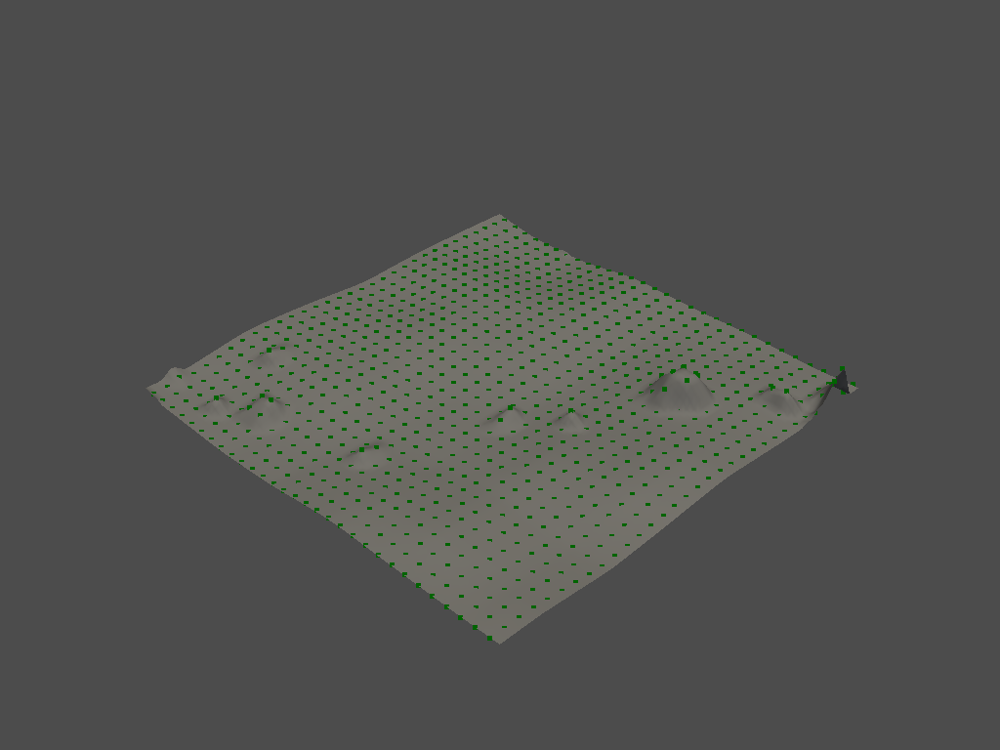

(4096, 3)
(1024, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


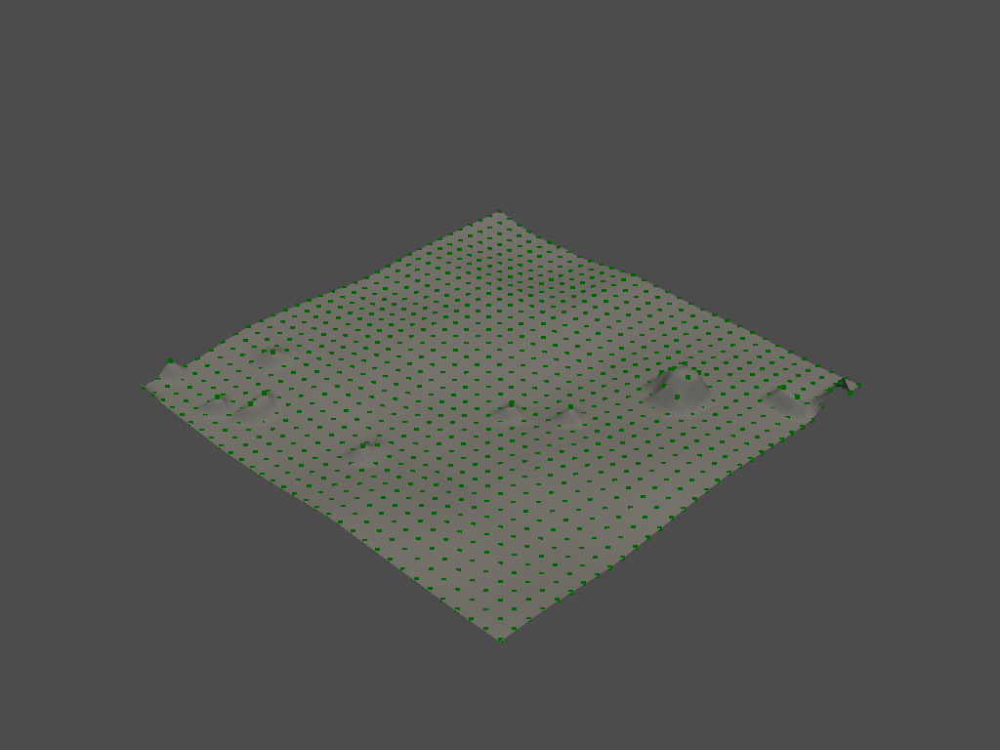

(4096, 3)
(1024, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


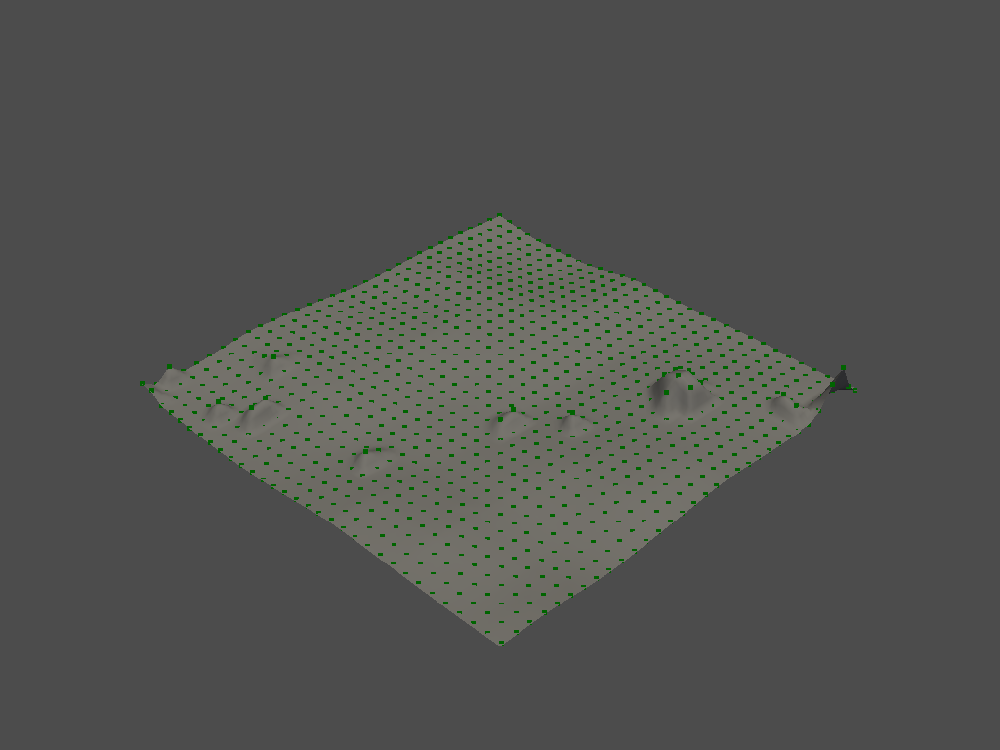

(4096, 3)
(960, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


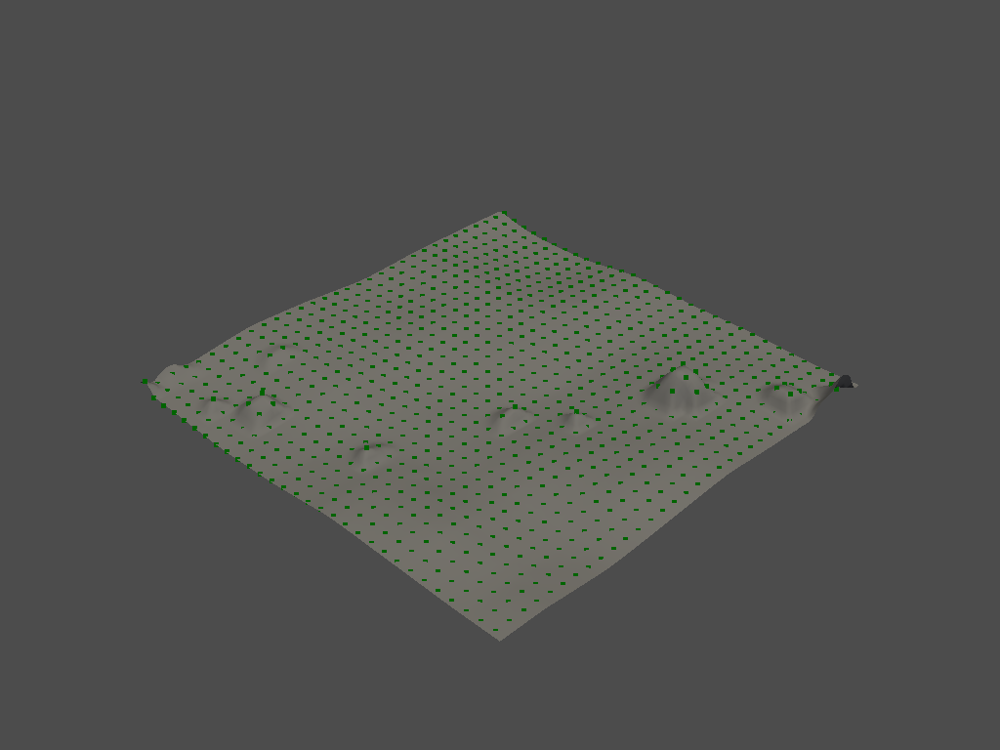

(4096, 3)
(892, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


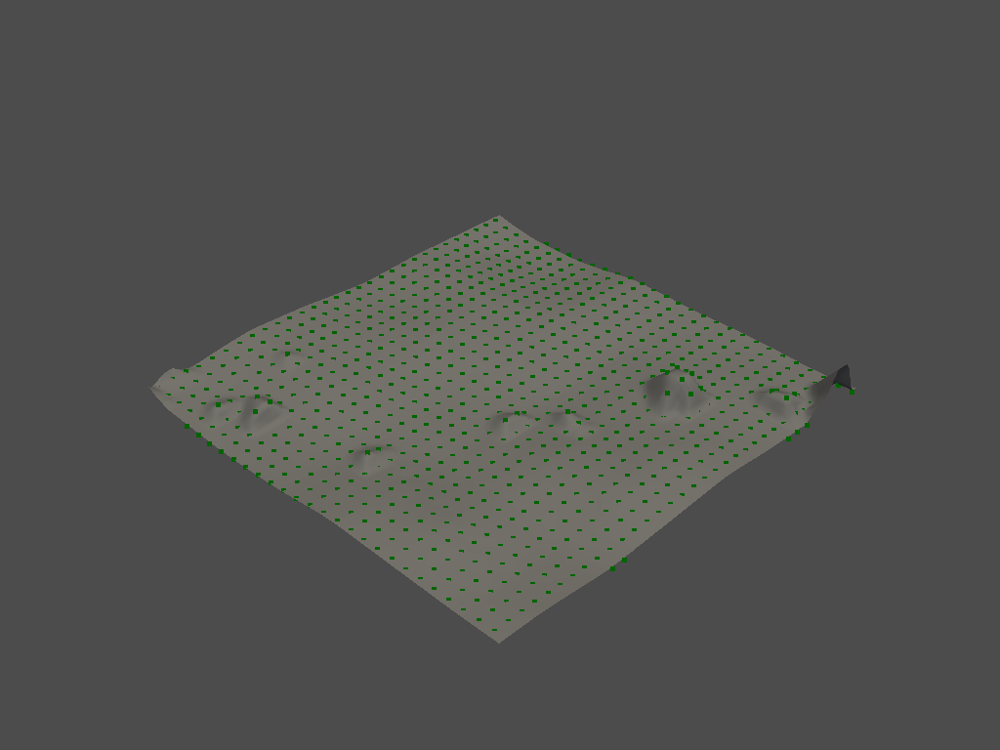

(4096, 3)
(815, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


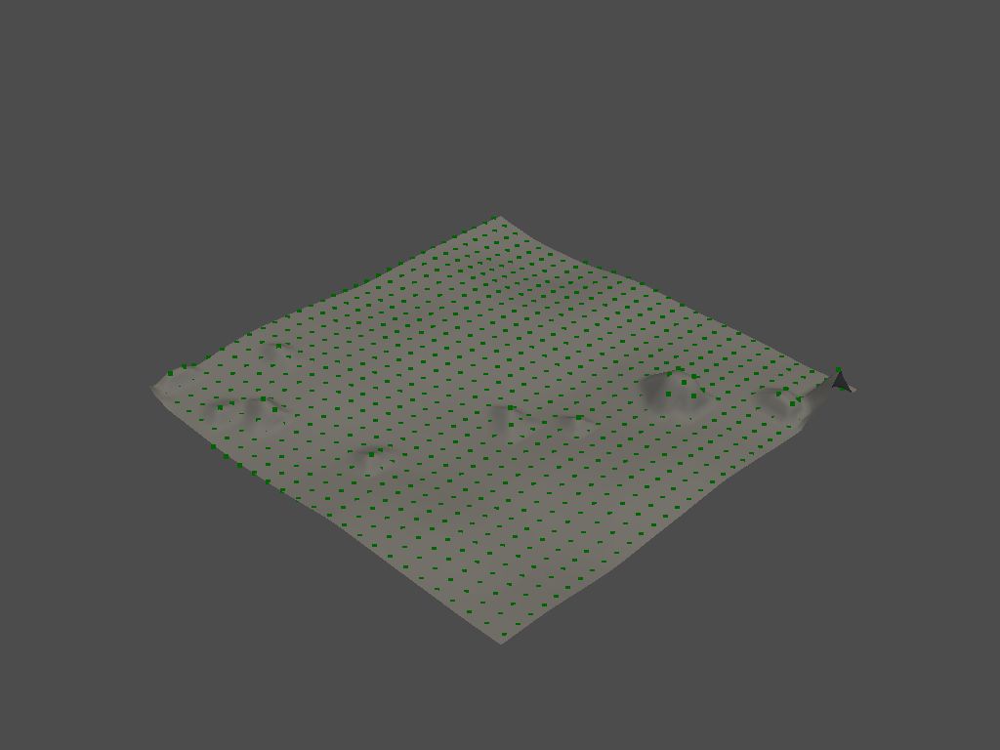

(4096, 3)
(687, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


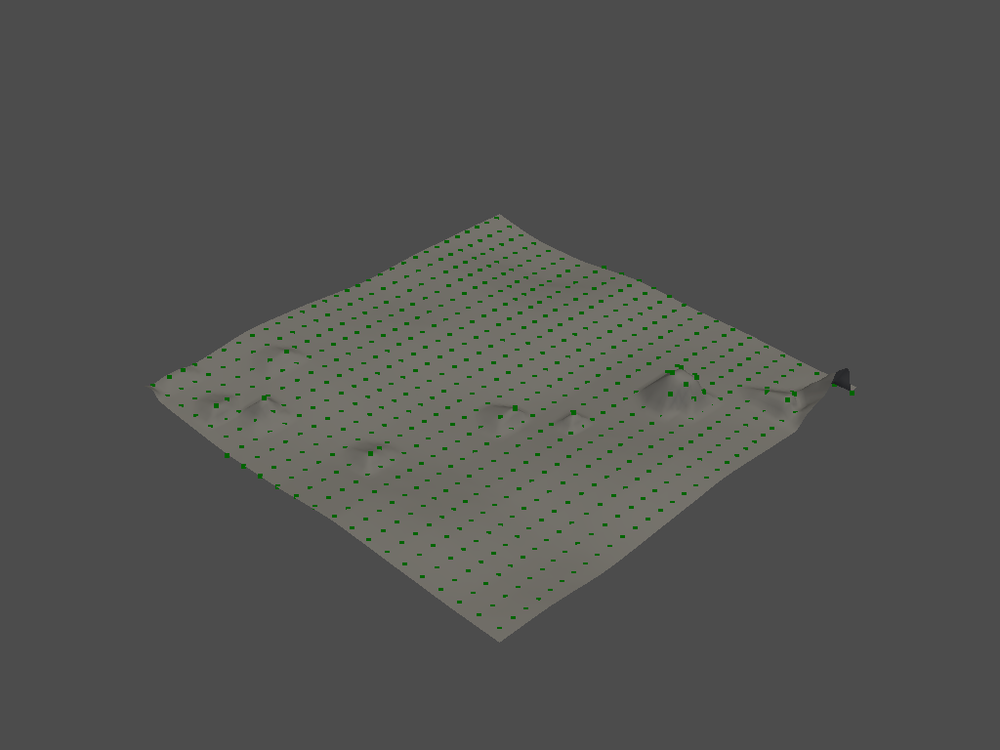

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


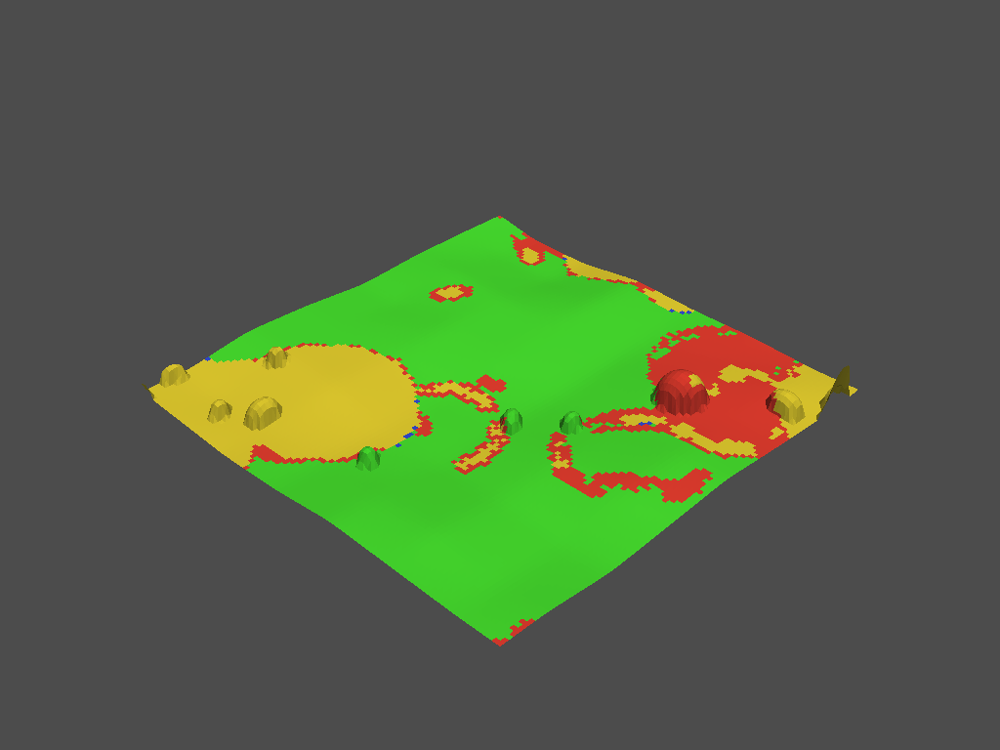

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


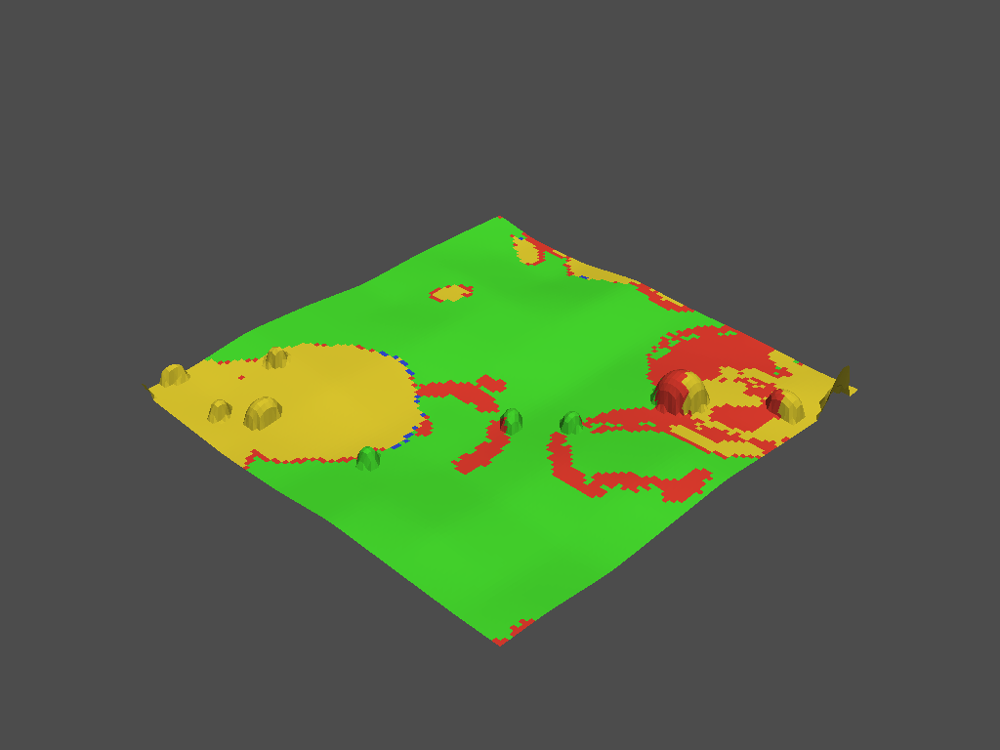

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


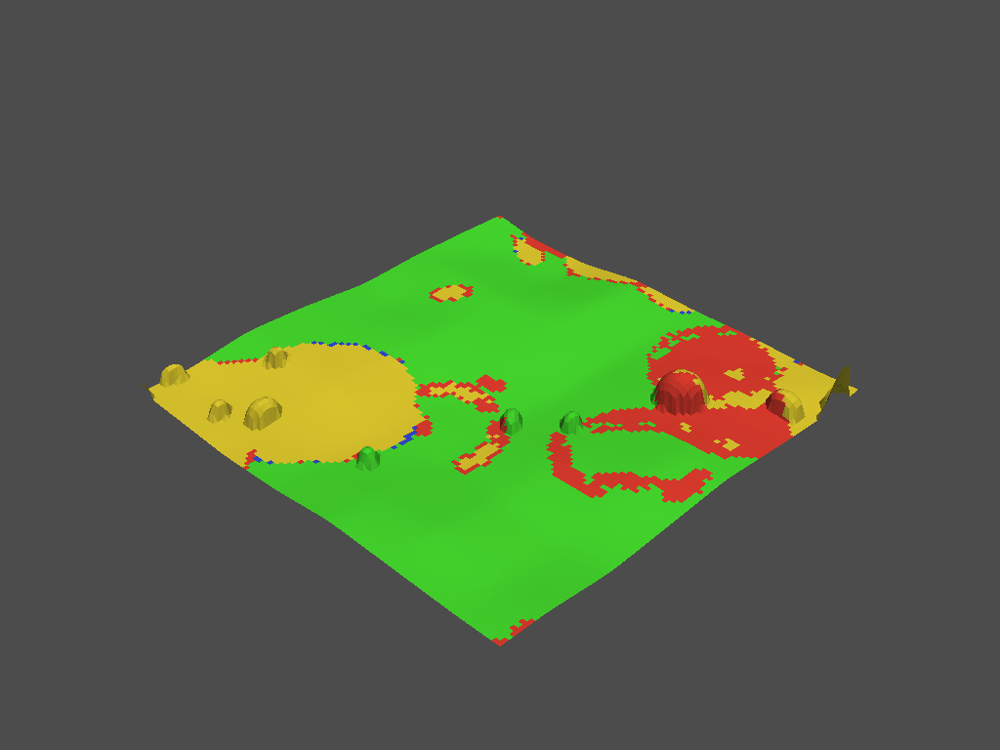

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


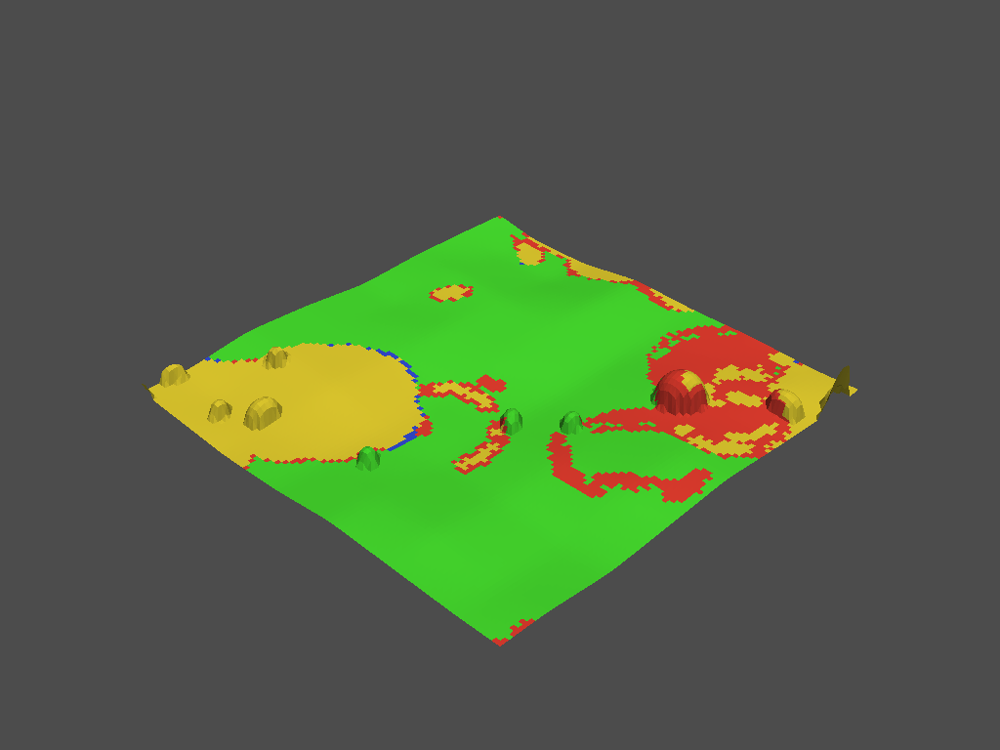

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


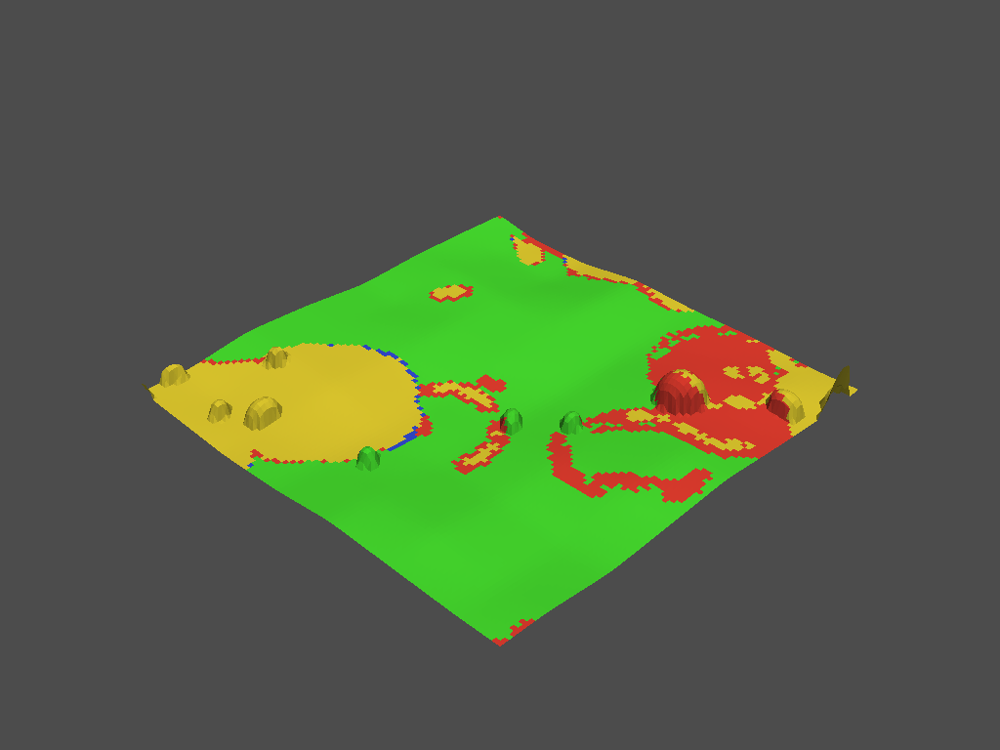

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


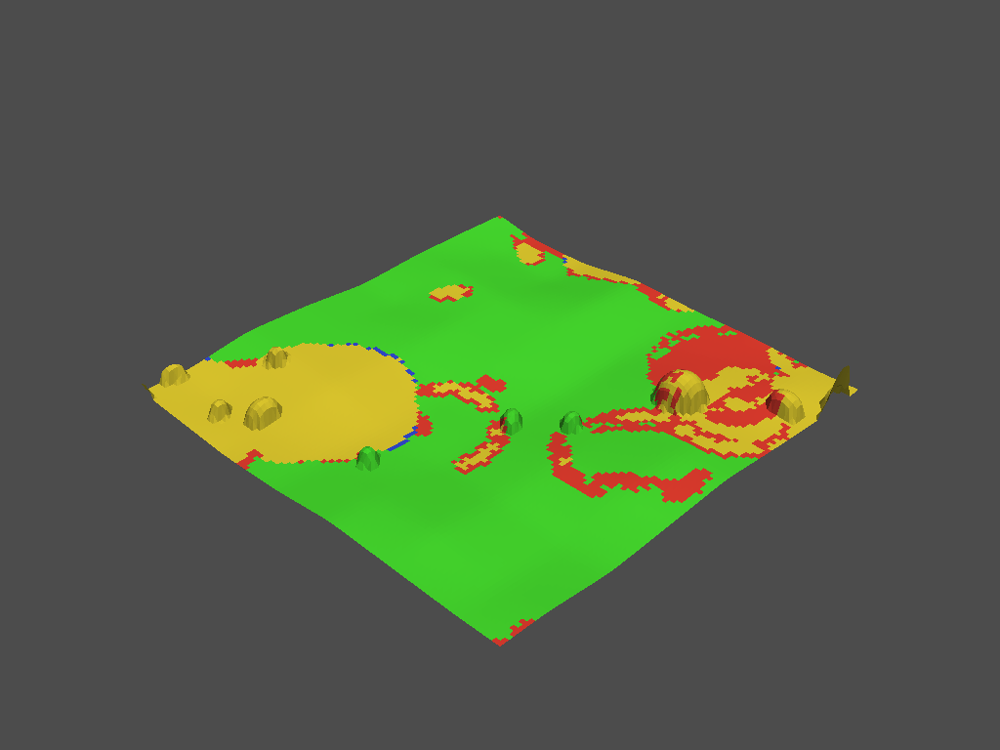

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


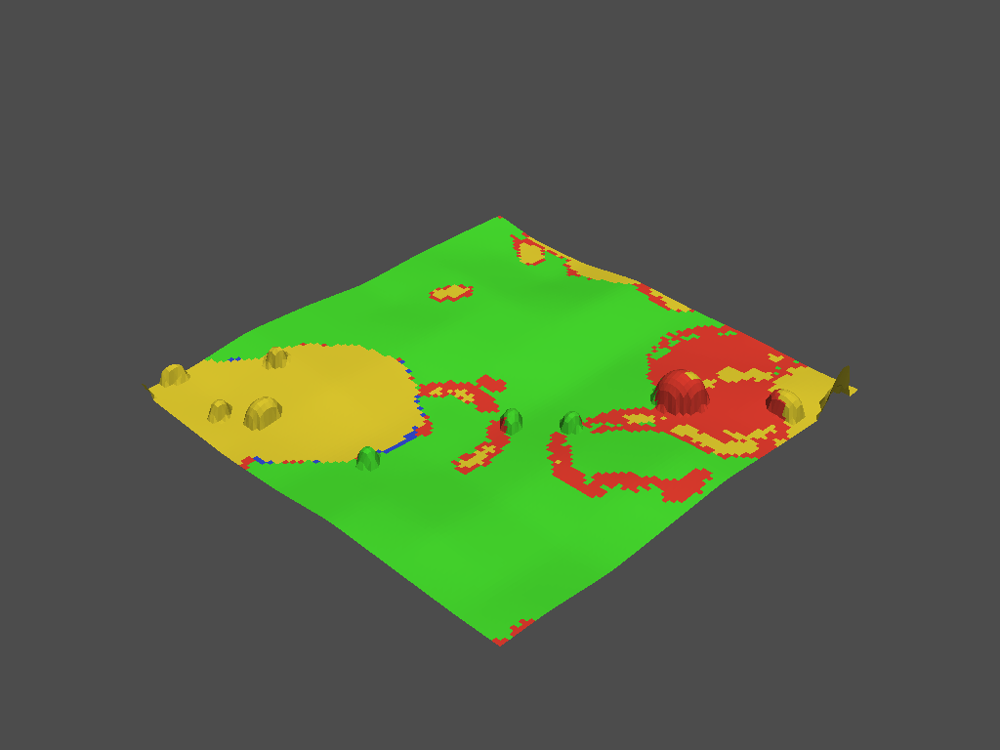

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


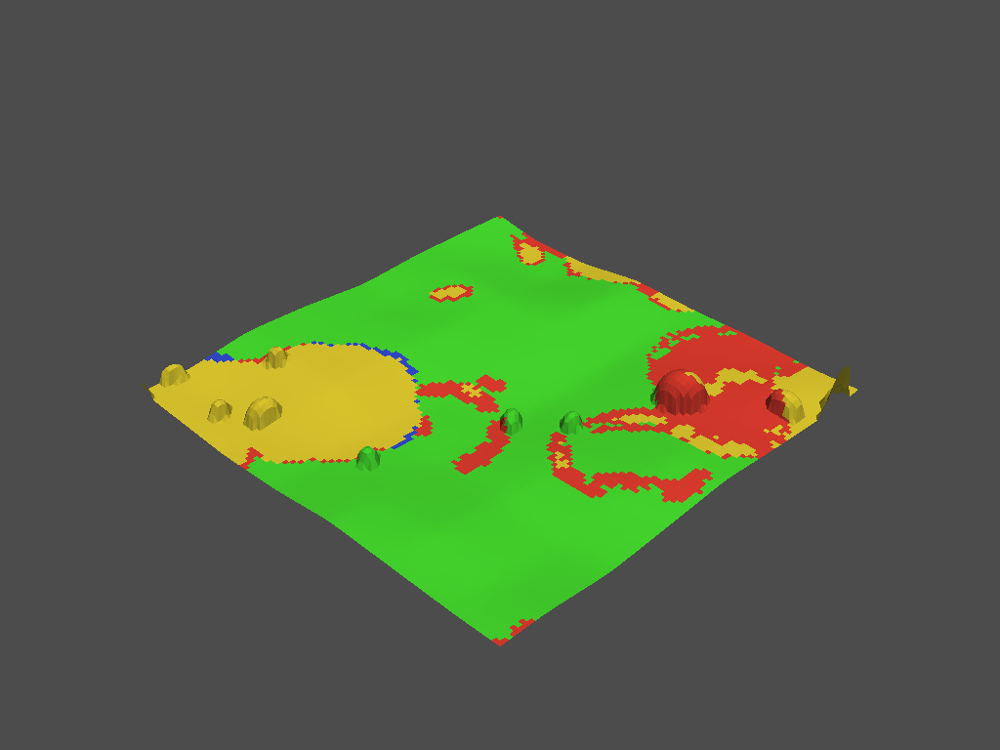

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


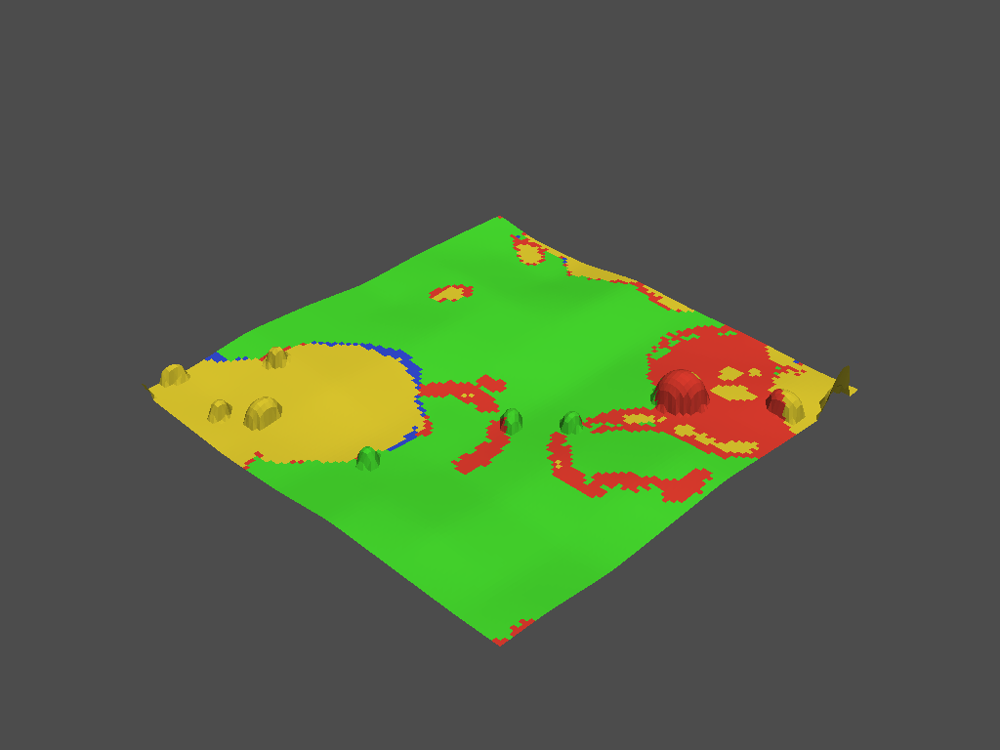

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


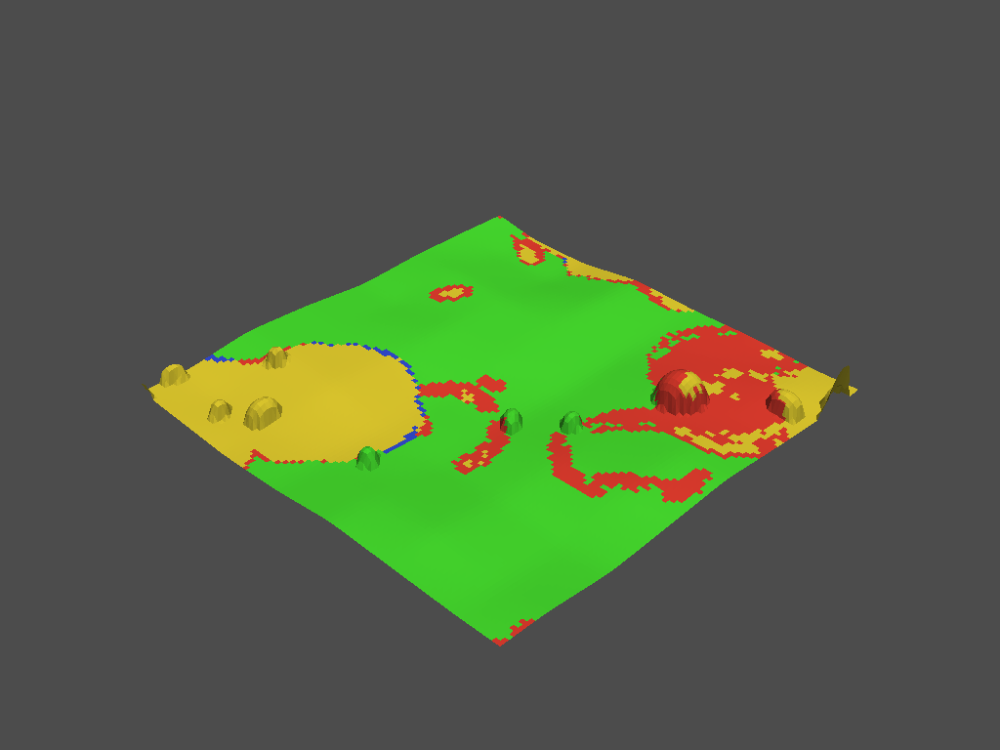

C:\Users\ktomita3\AppData\Local\Temp\ipykernel_26212\2991450551.py:88: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  images = [imageio.imread(file) for file in file_list]
c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


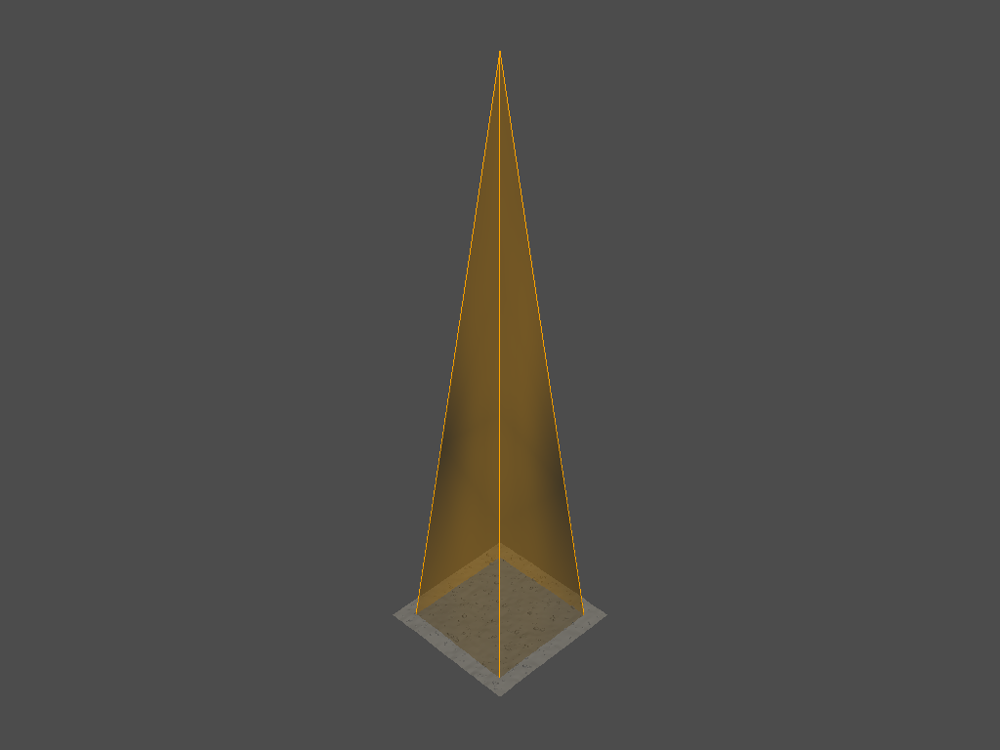

0


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


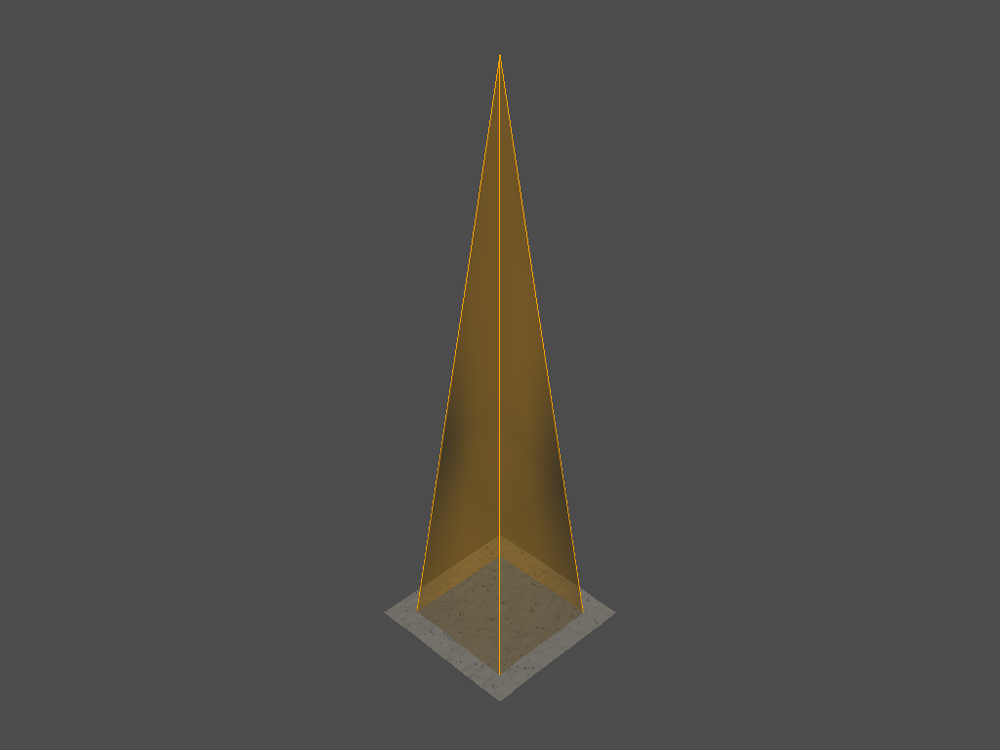

1


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


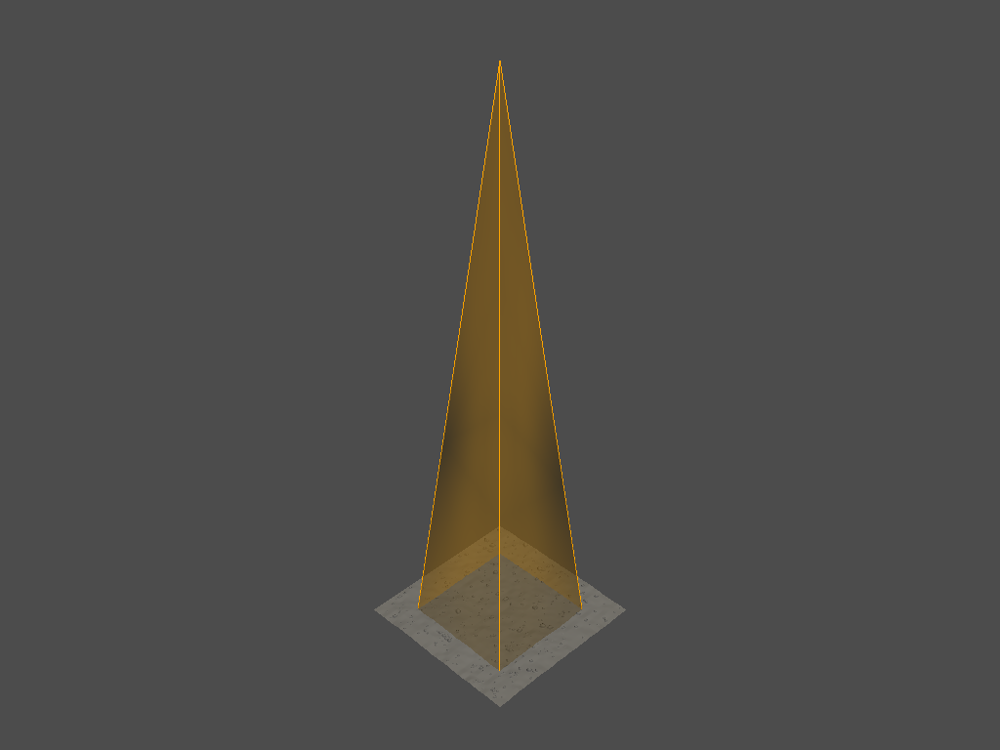

2


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


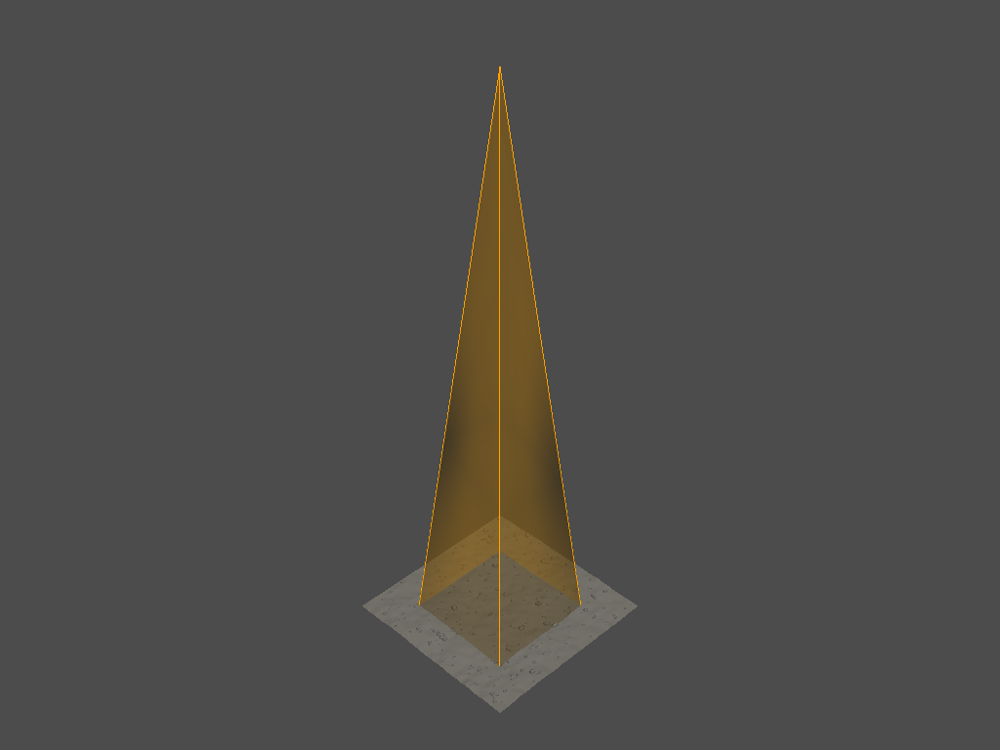

3


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


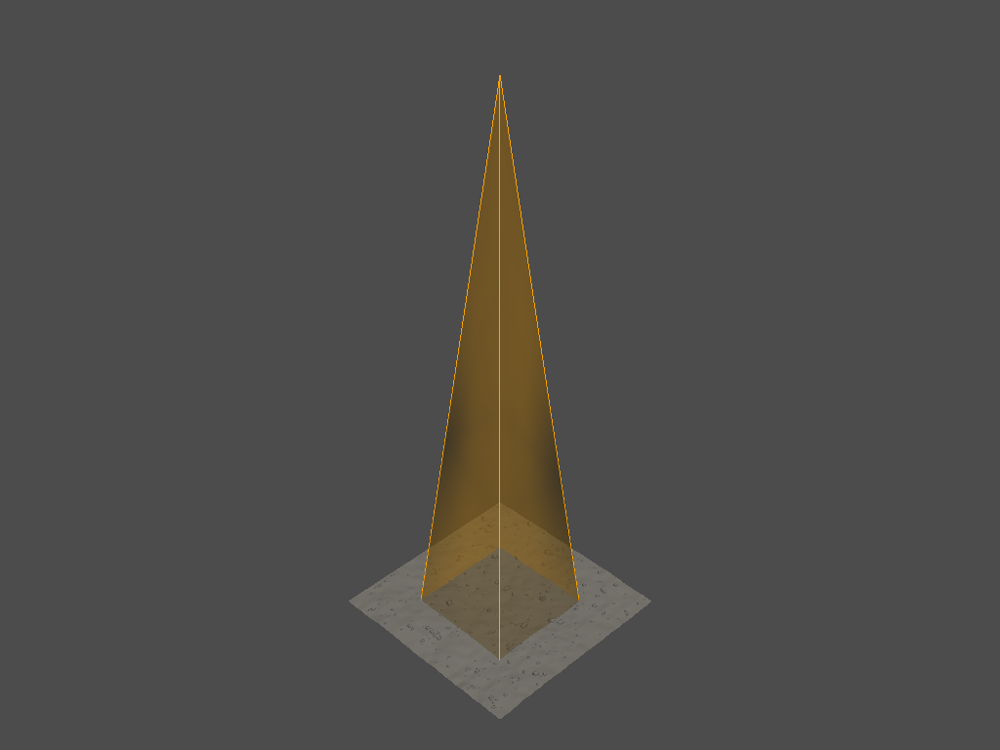

4


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


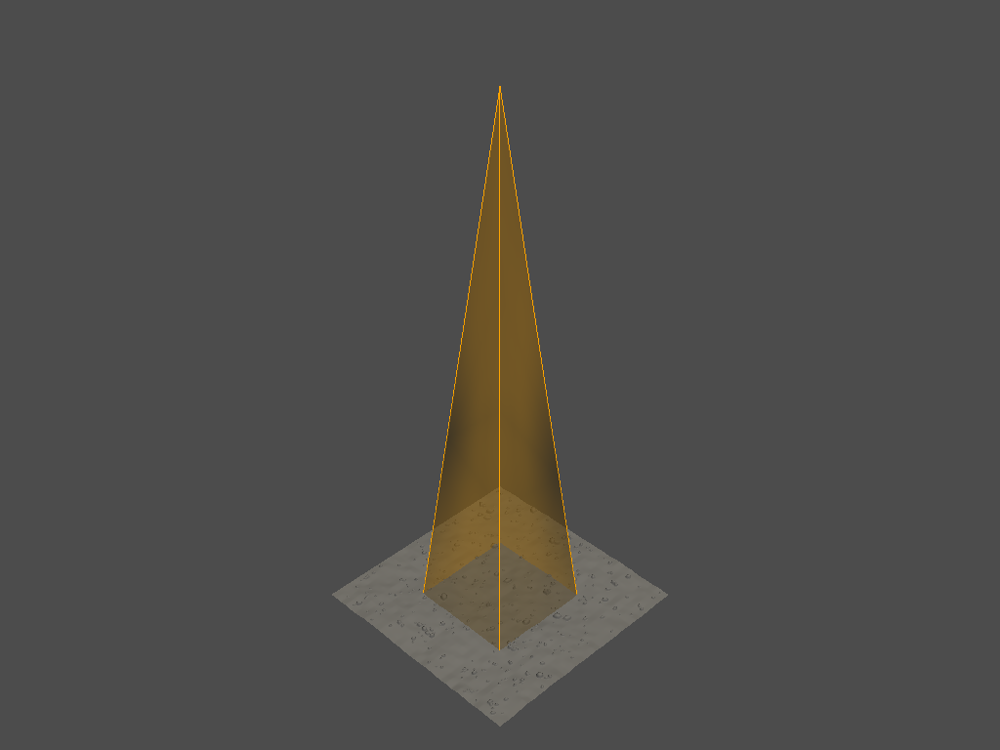

5


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


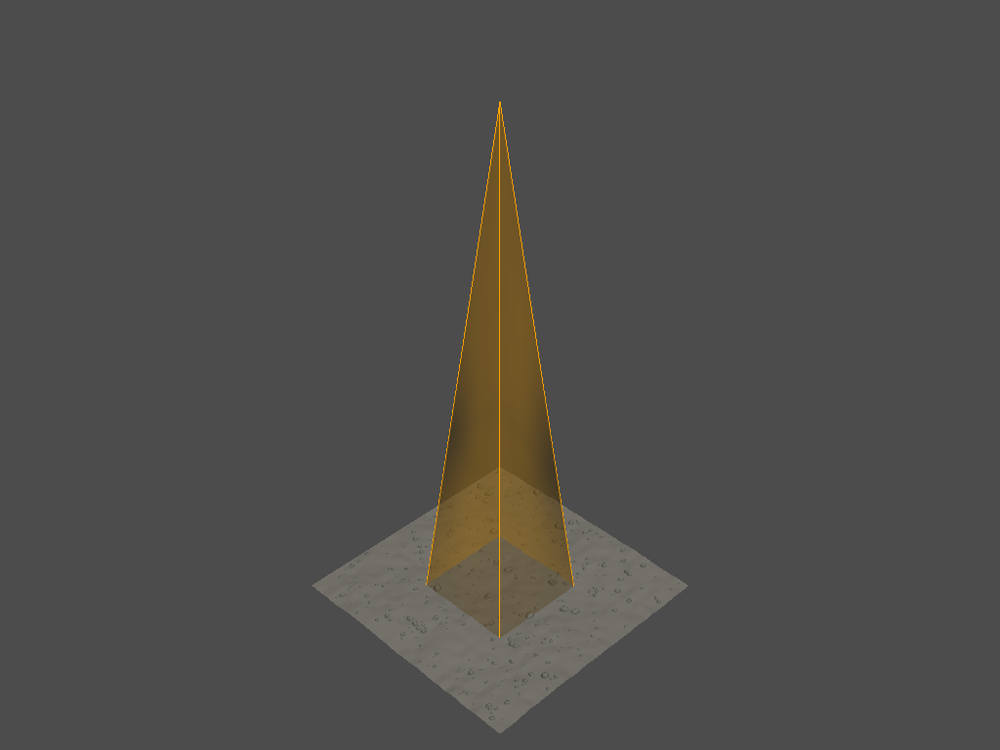

6


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


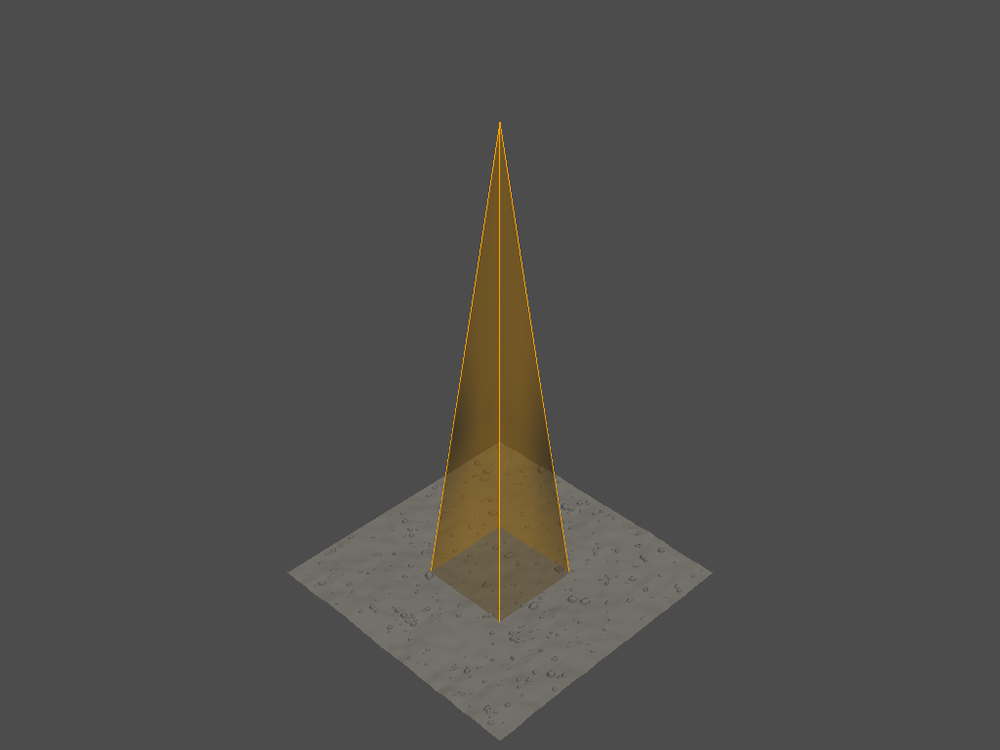

7


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


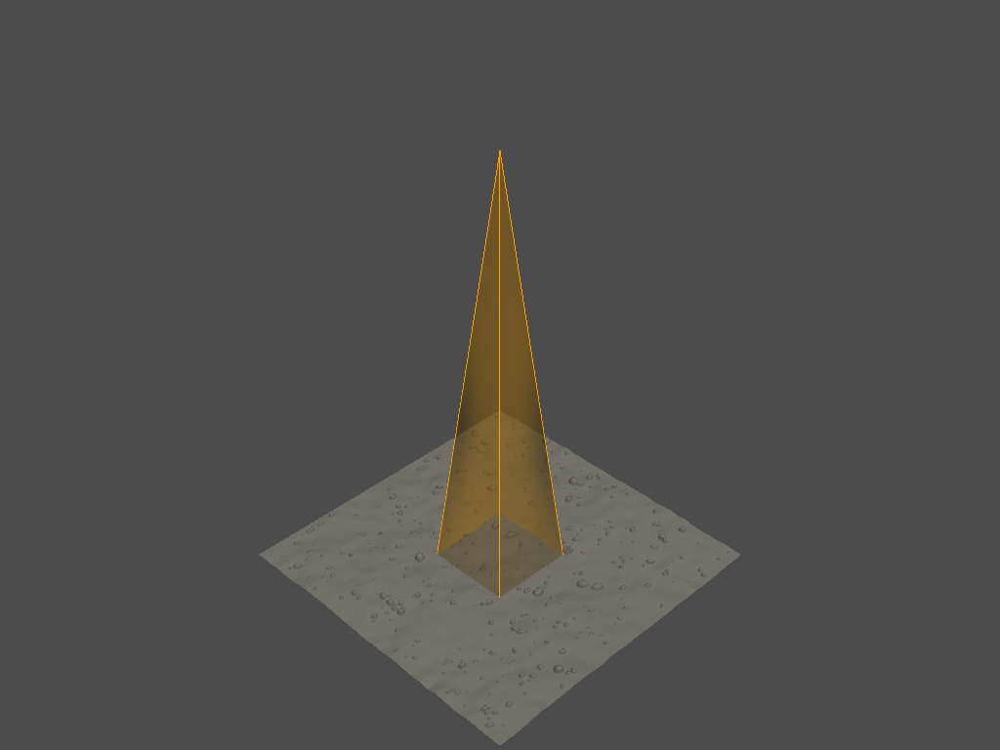

8


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


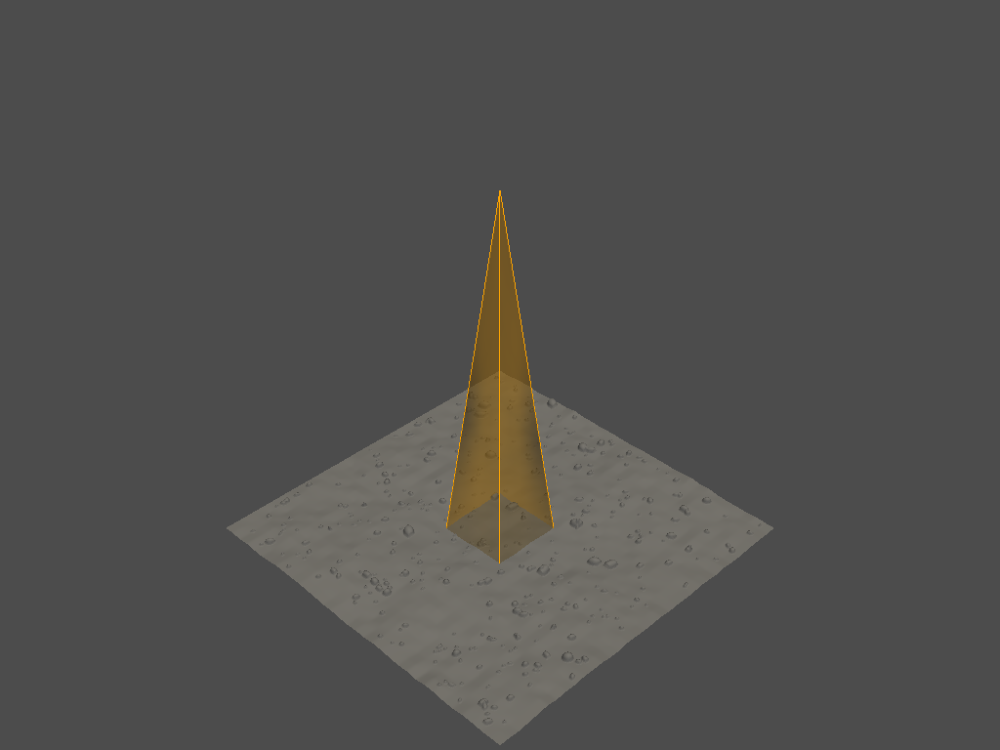

9
(4096, 3)
(256, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


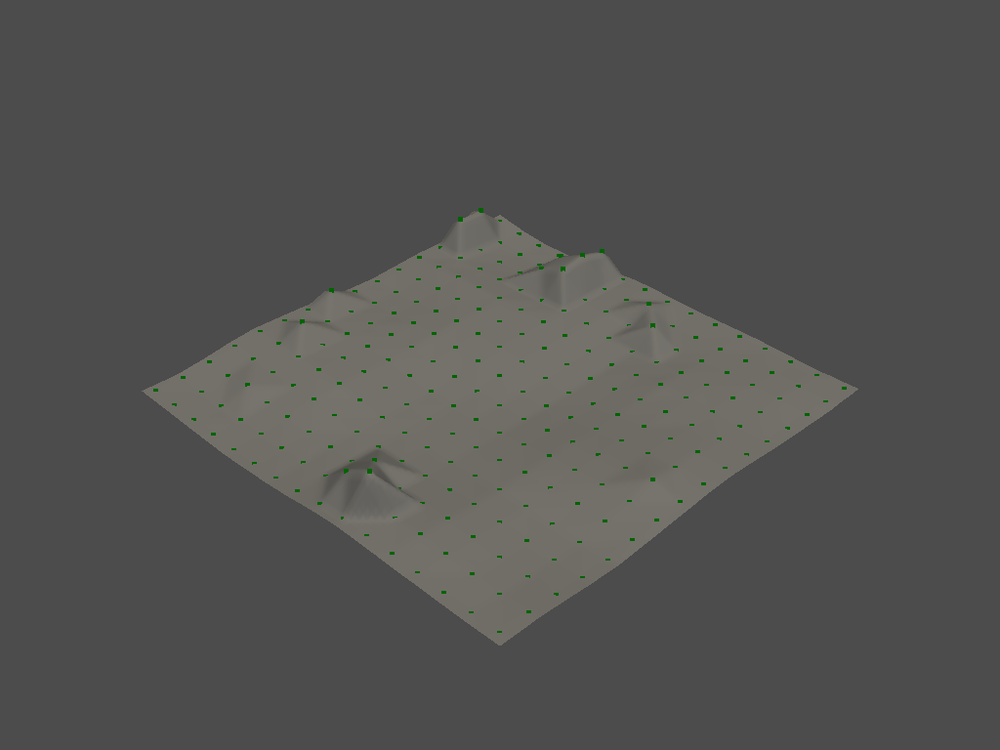

(4096, 3)
(324, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


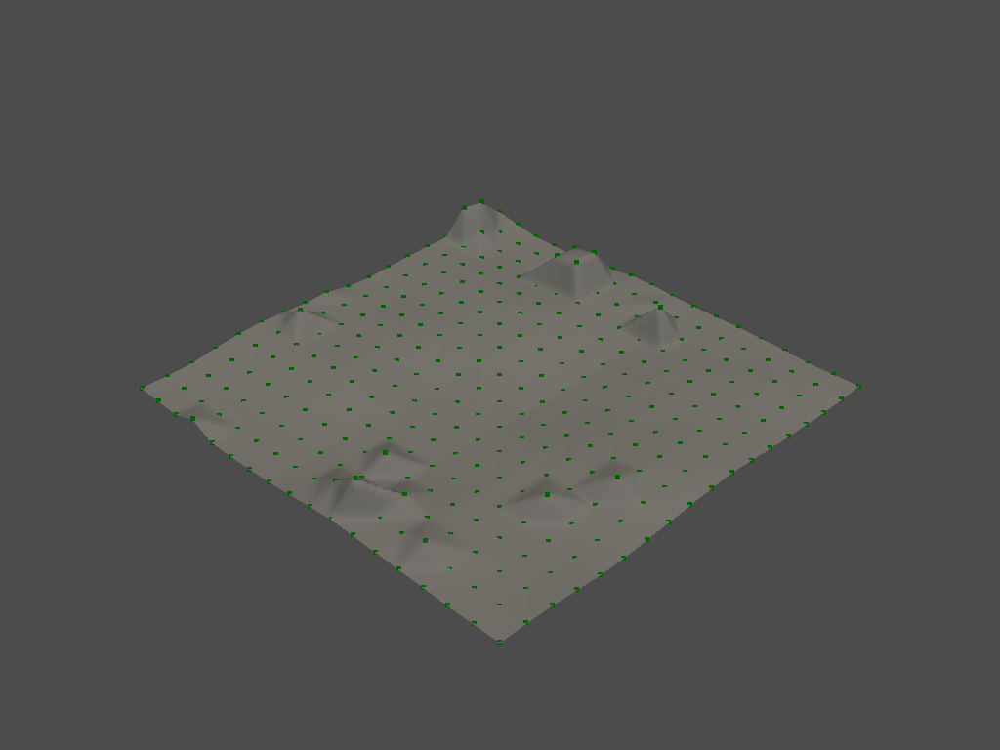

(4096, 3)
(324, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


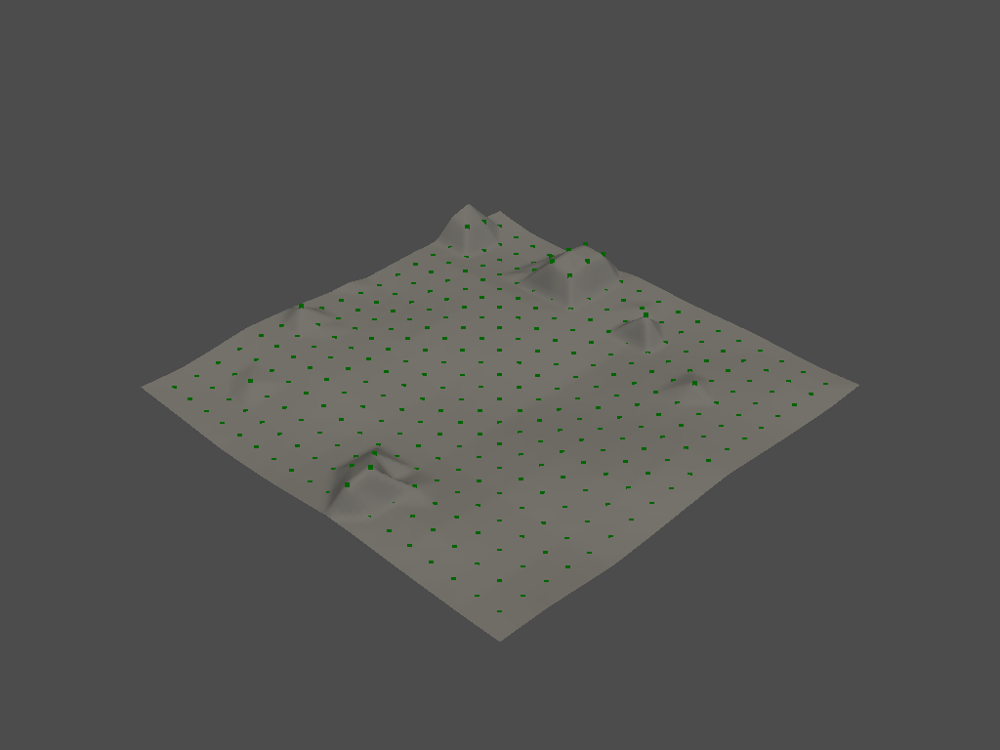

(4096, 3)
(462, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


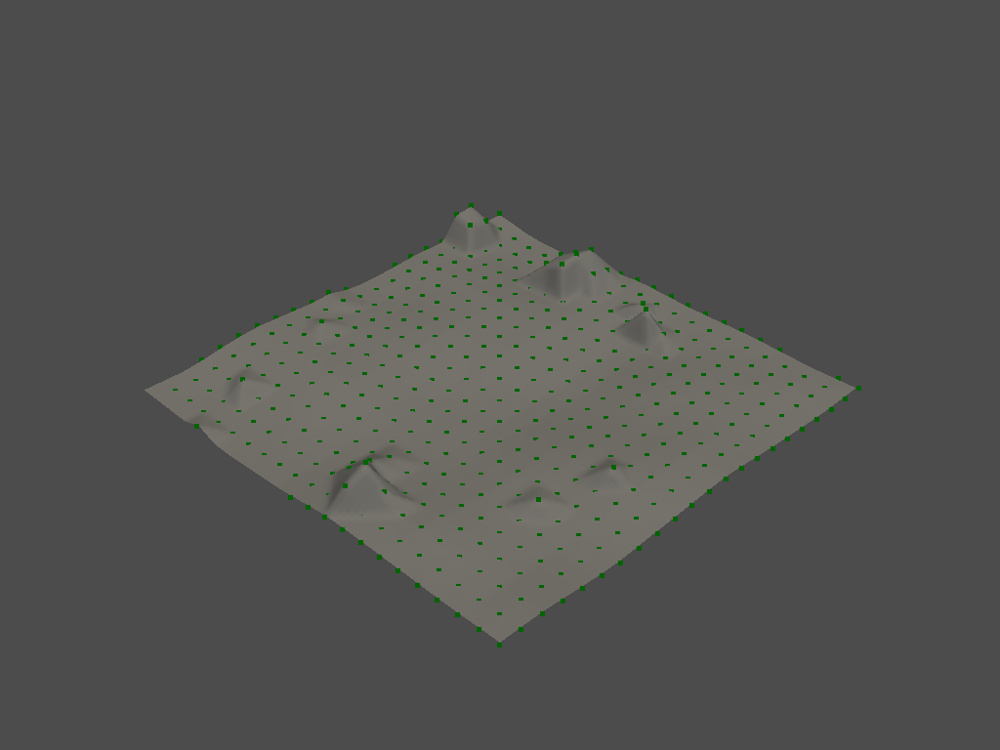

(4096, 3)
(576, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


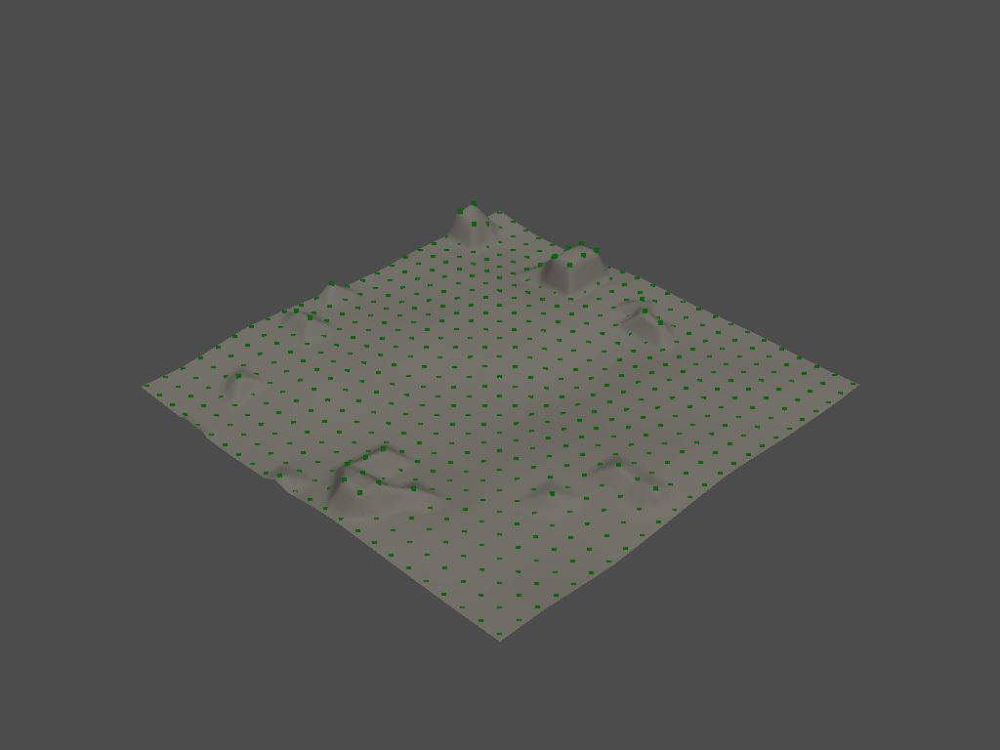

(4095, 3)
(754, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


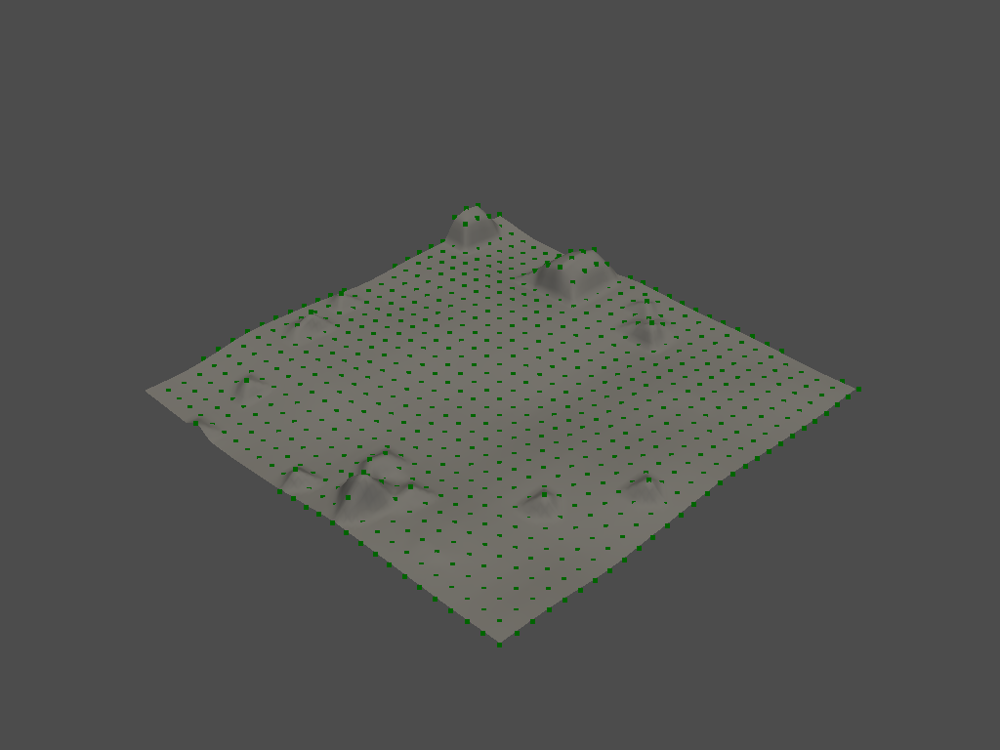

(4095, 3)
(1024, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


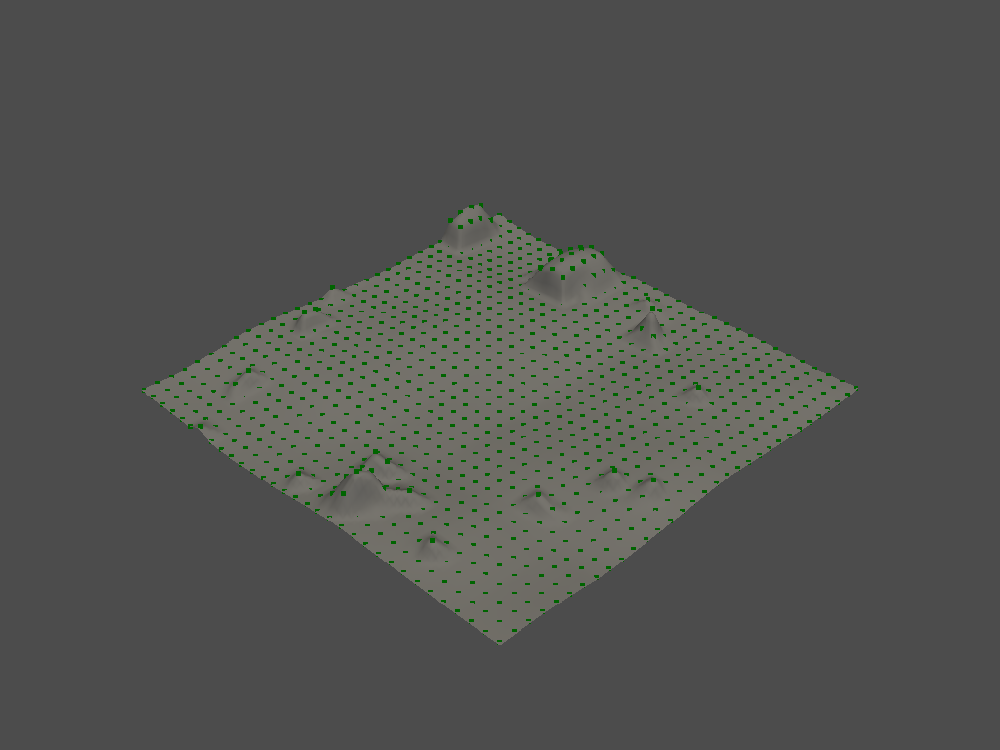

(4096, 3)
(1444, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


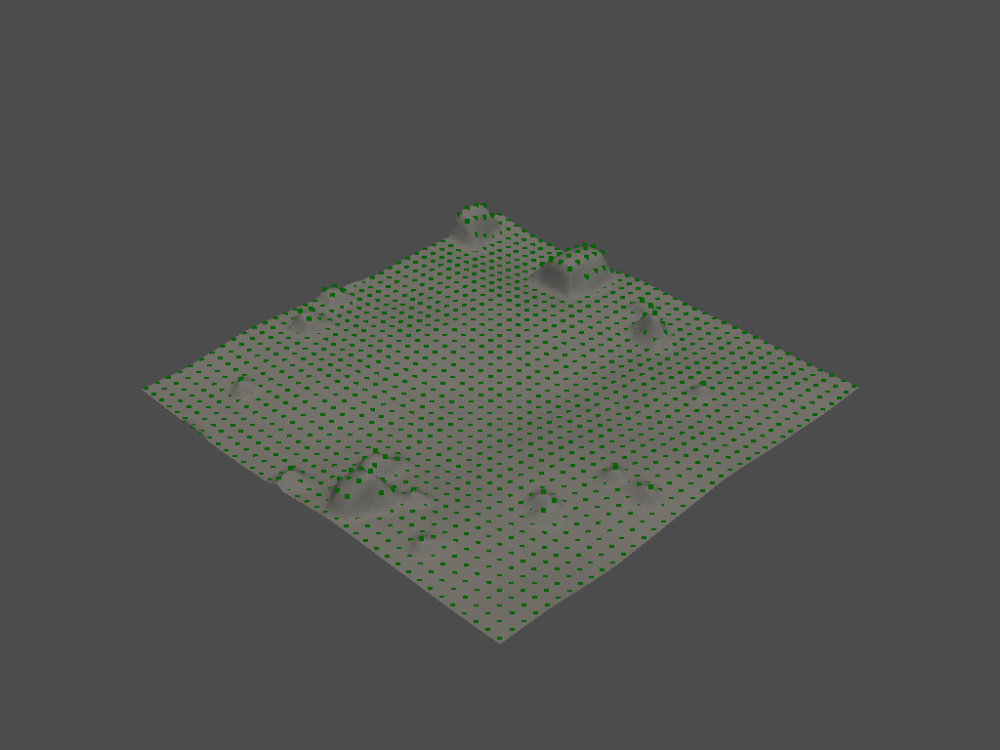

(4096, 3)
(2304, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


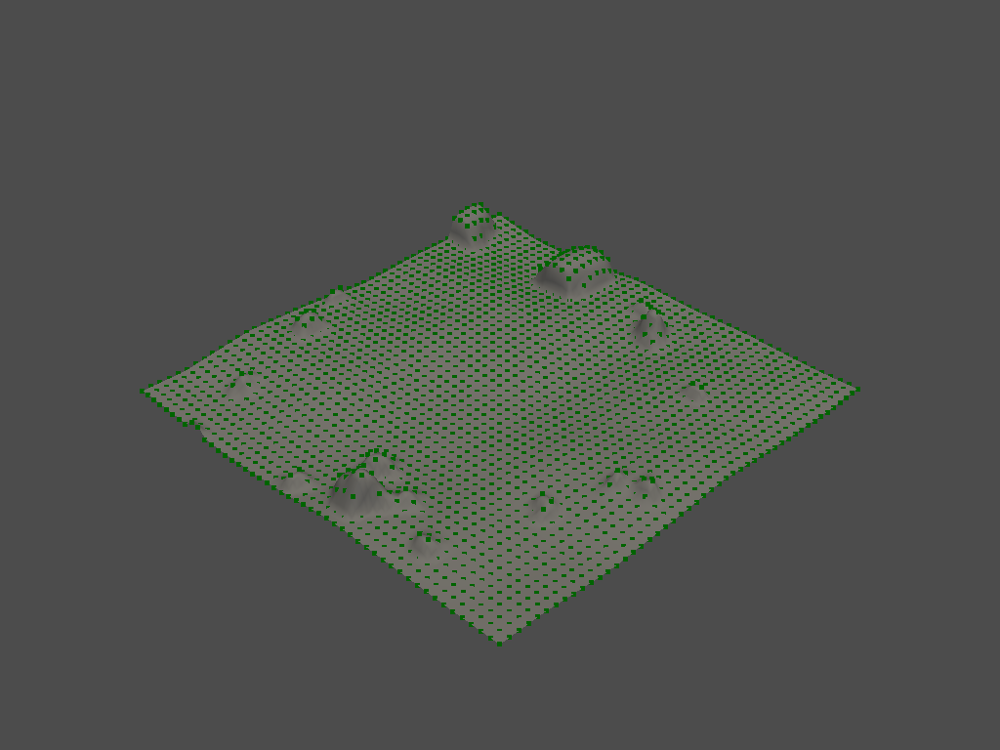

(4096, 3)
(4029, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


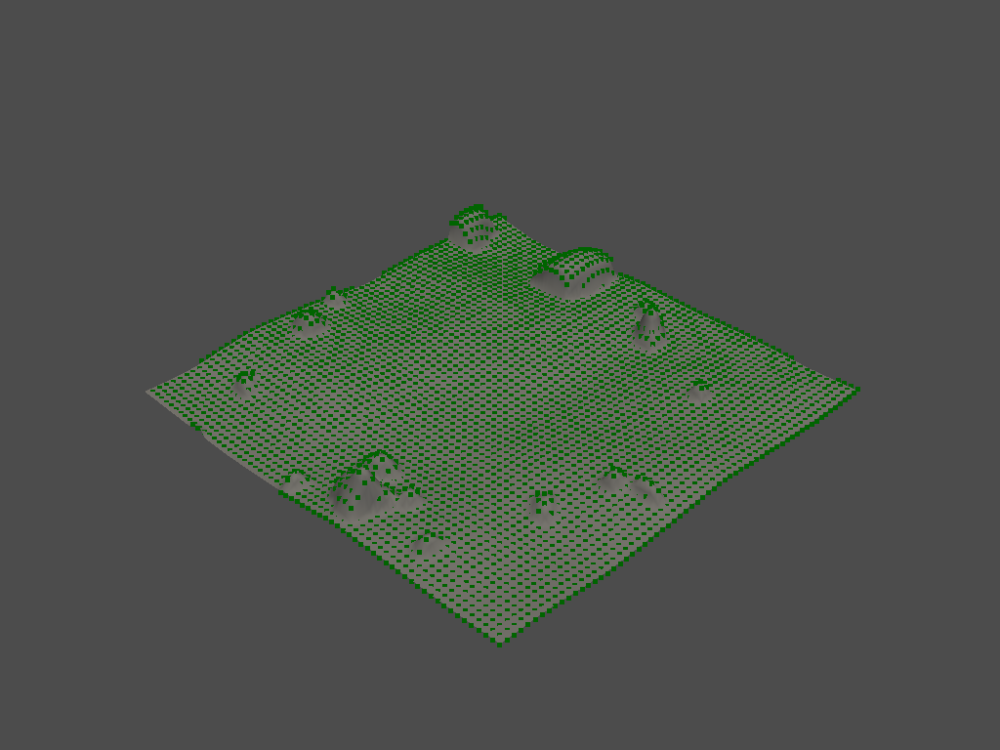

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


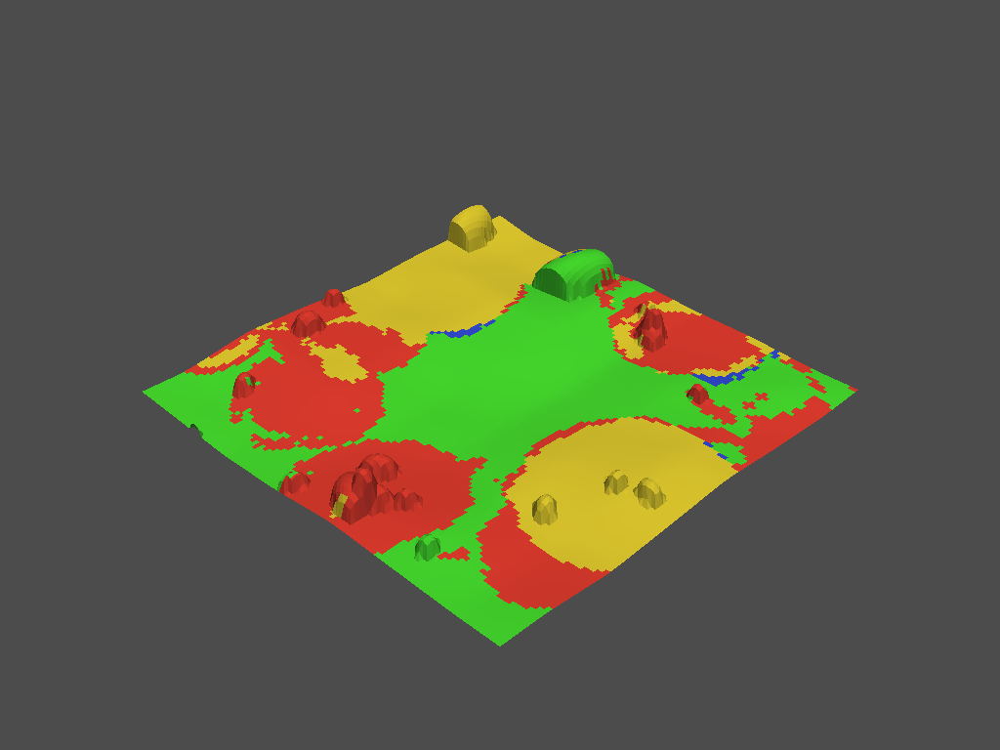

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


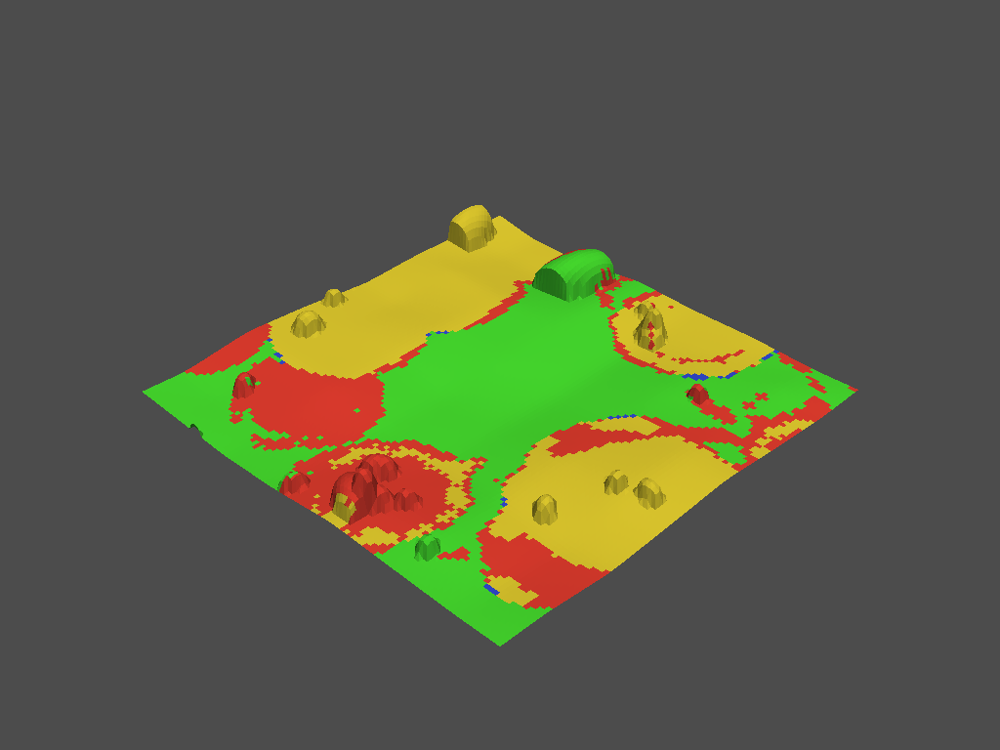

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


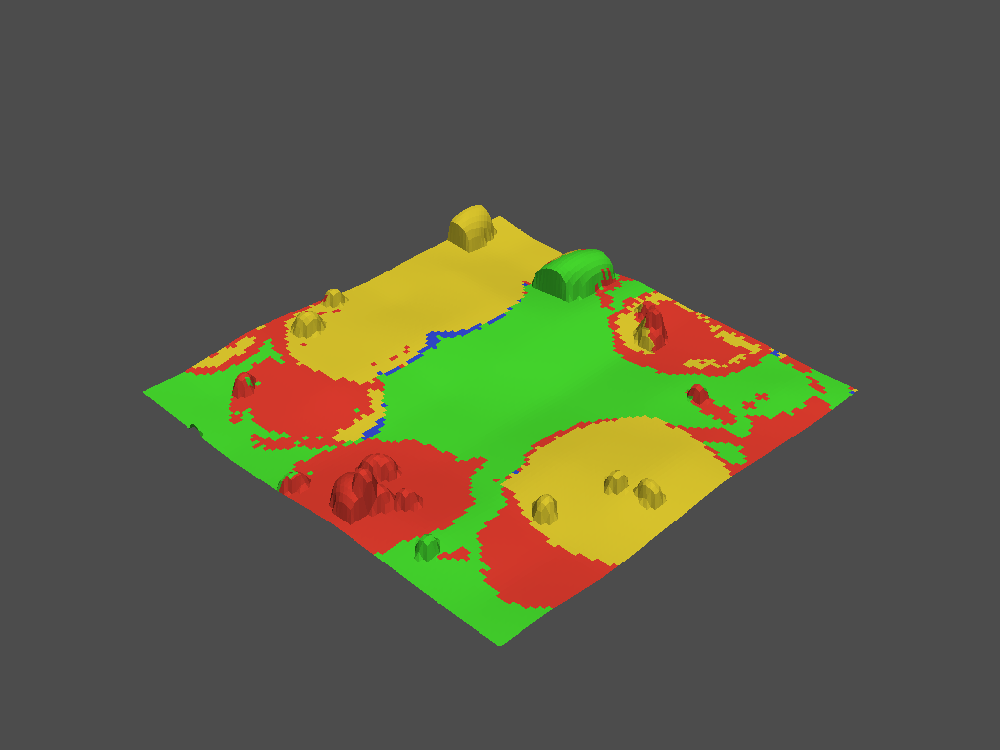

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


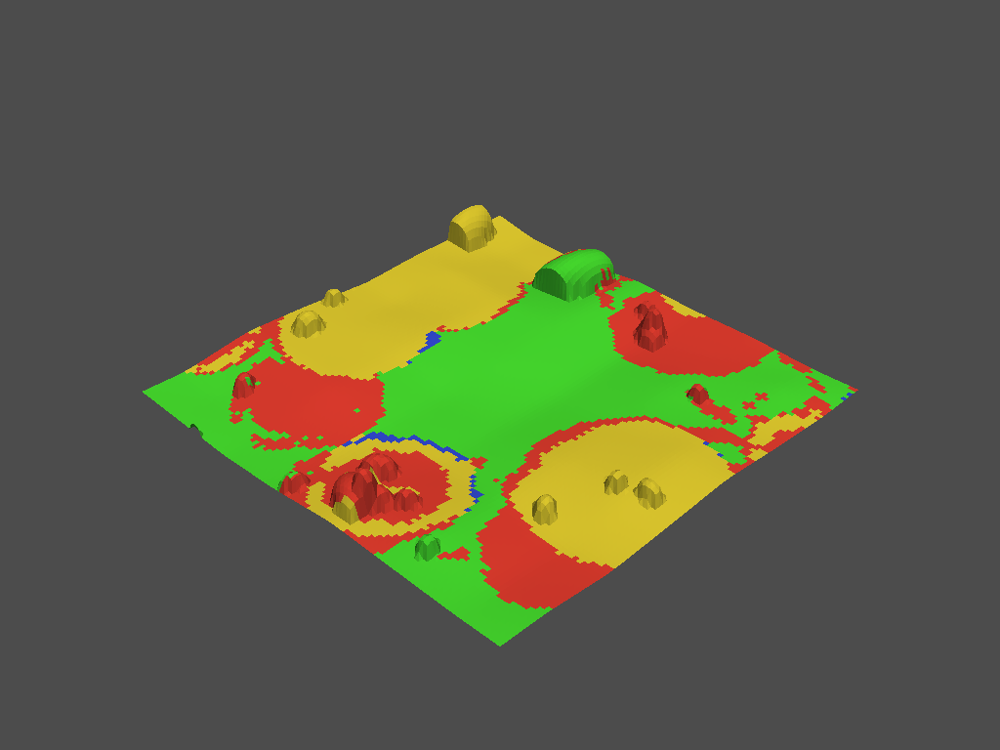

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


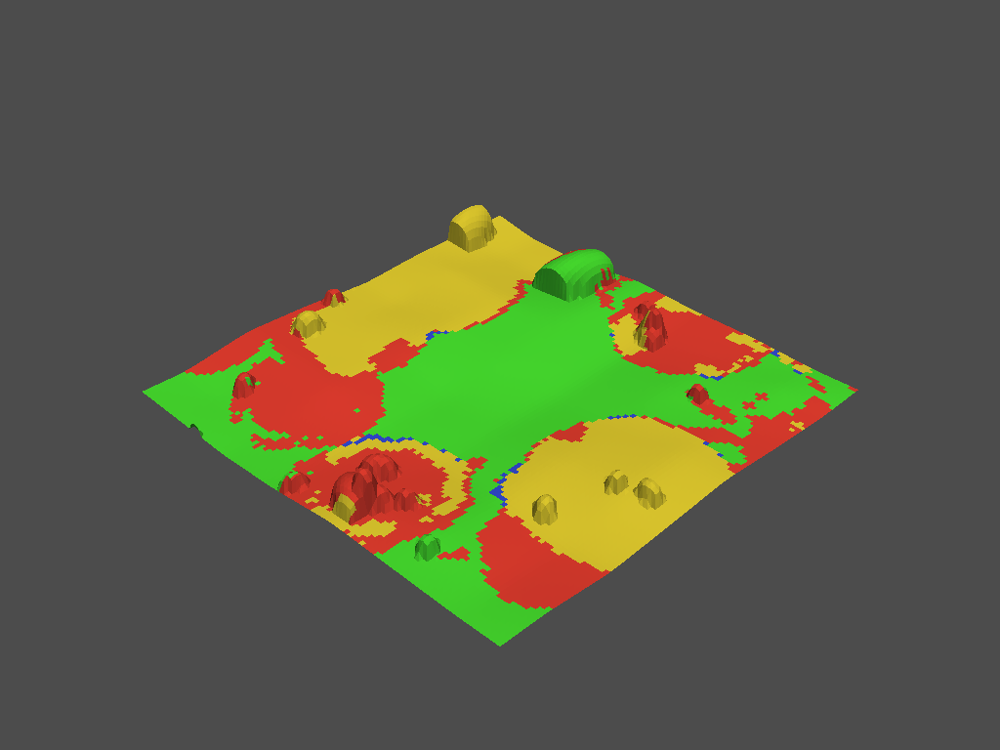

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


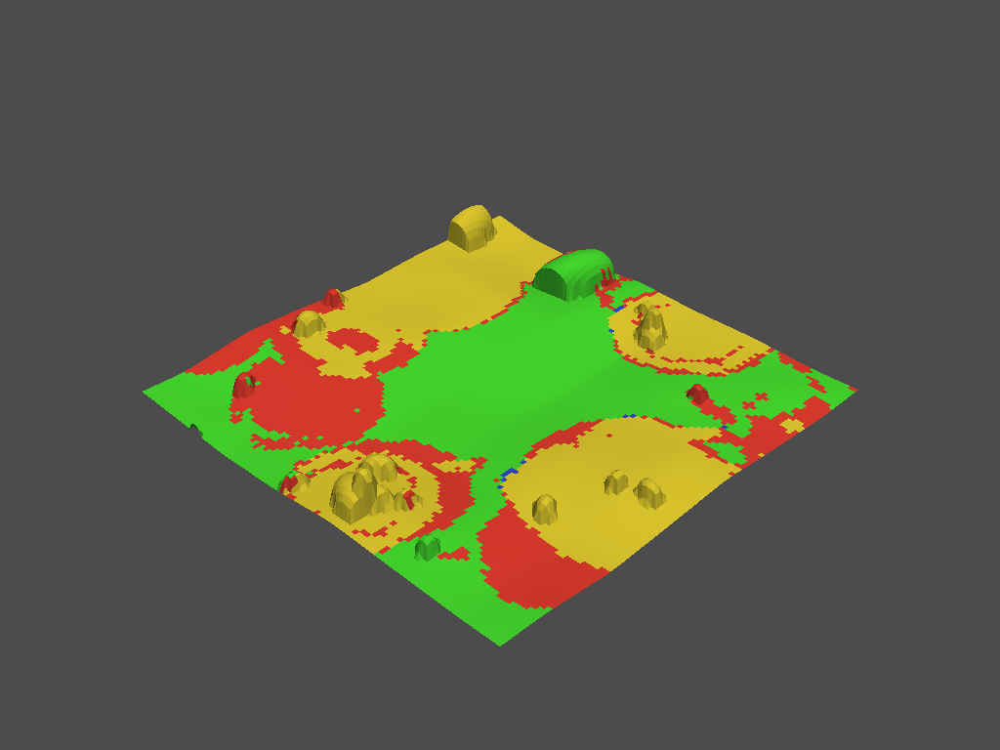

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


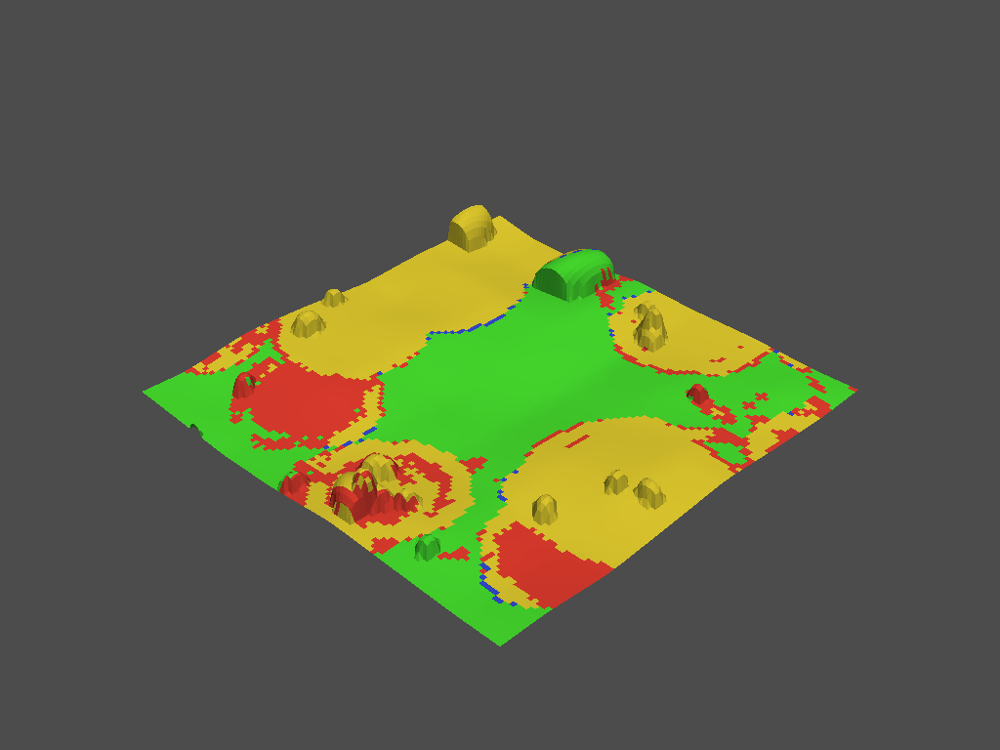

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


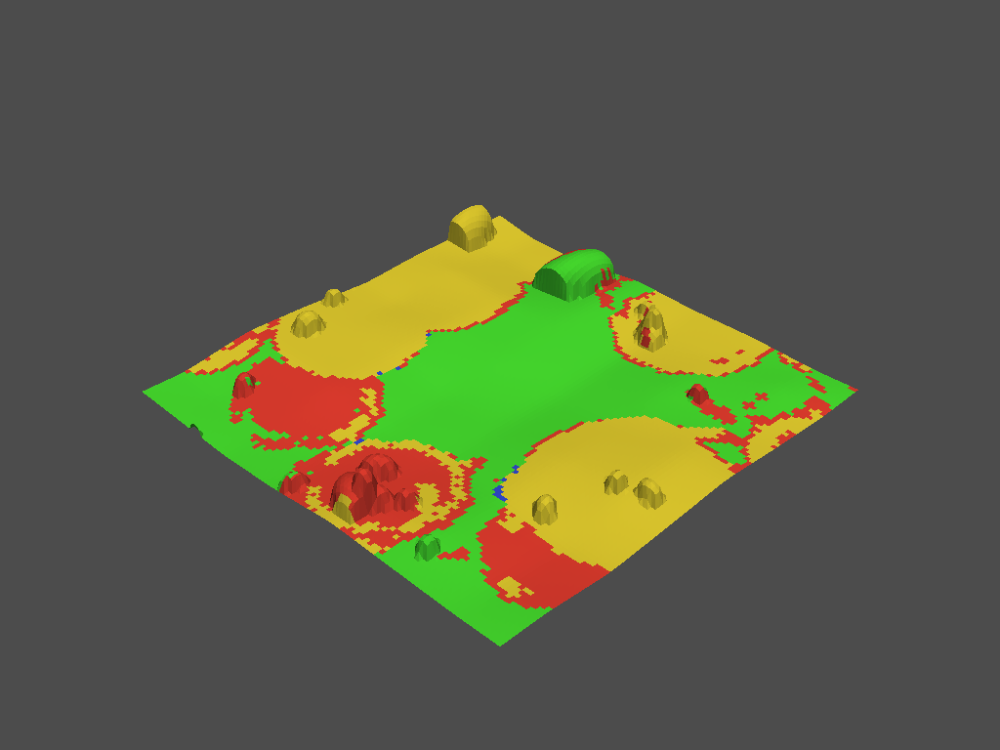

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


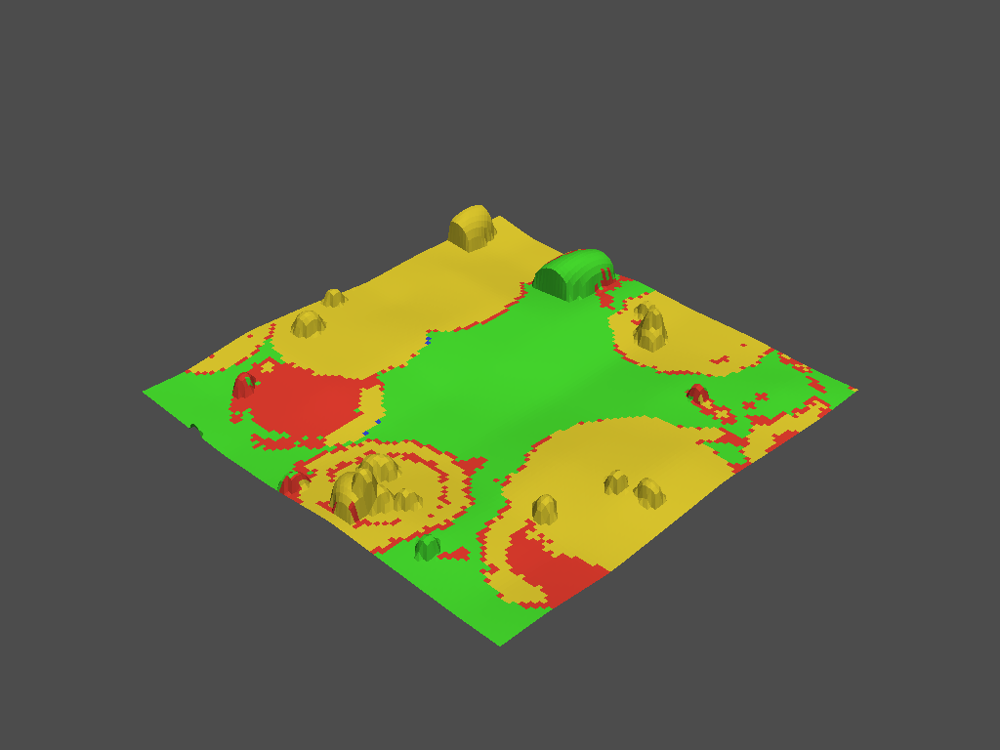

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


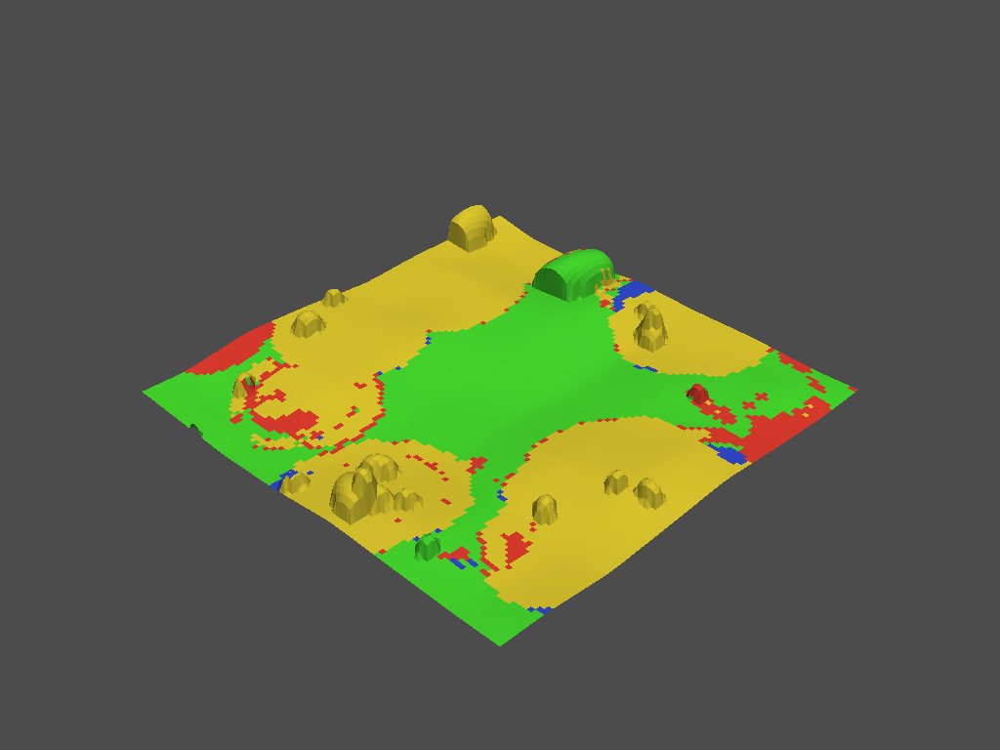

C:\Users\ktomita3\AppData\Local\Temp\ipykernel_26212\2991450551.py:88: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  images = [imageio.imread(file) for file in file_list]
c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


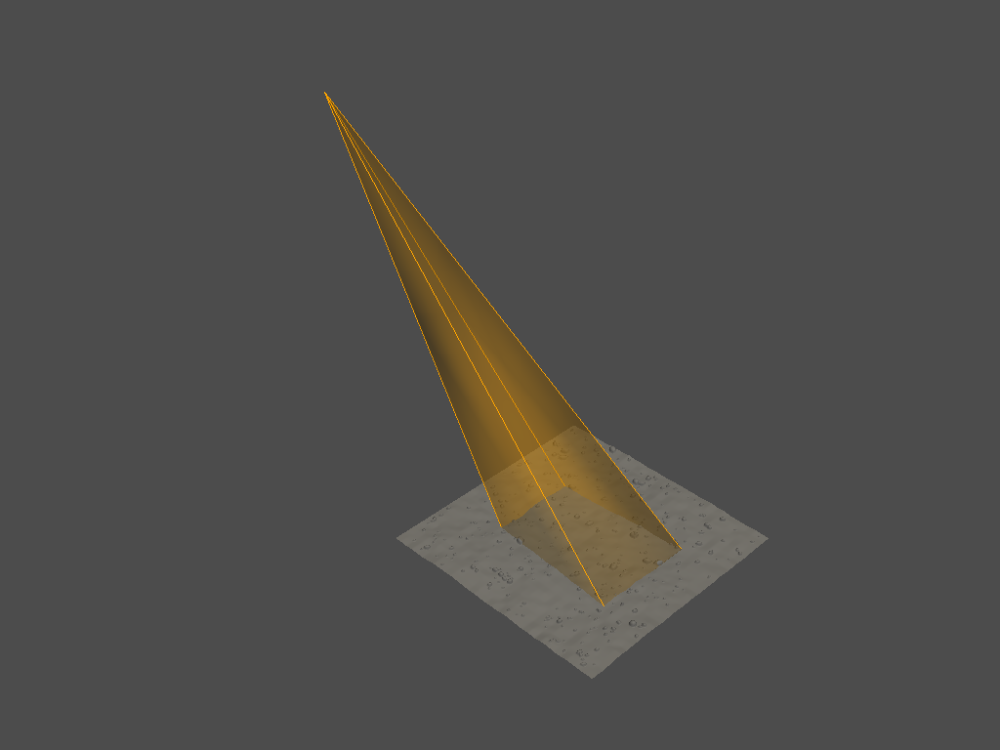

0


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


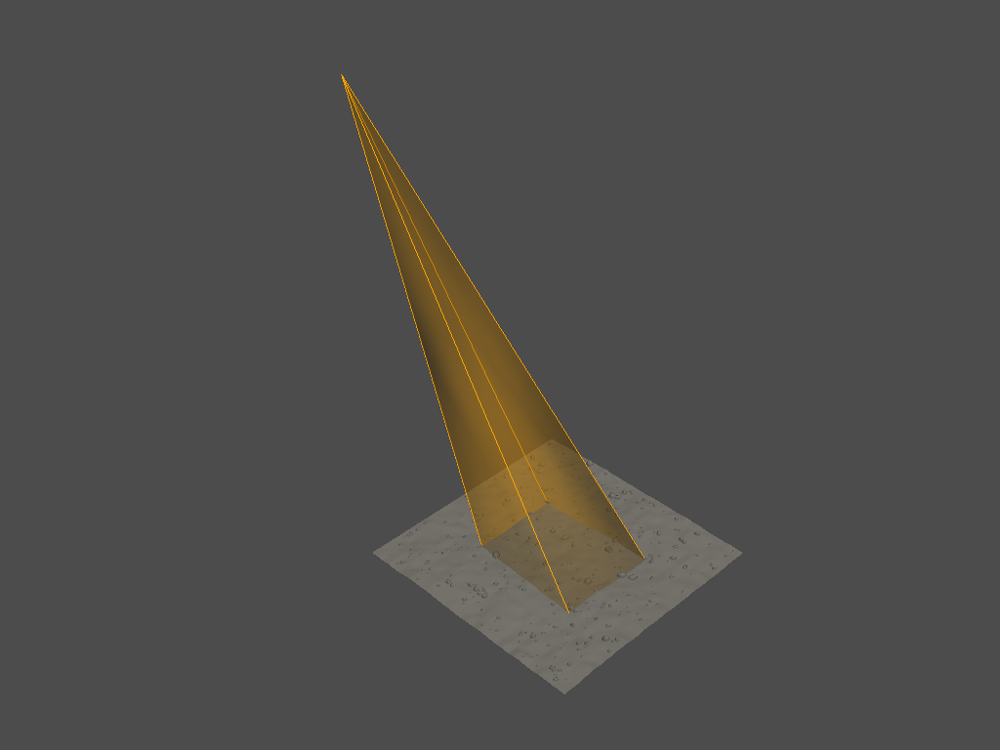

1


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


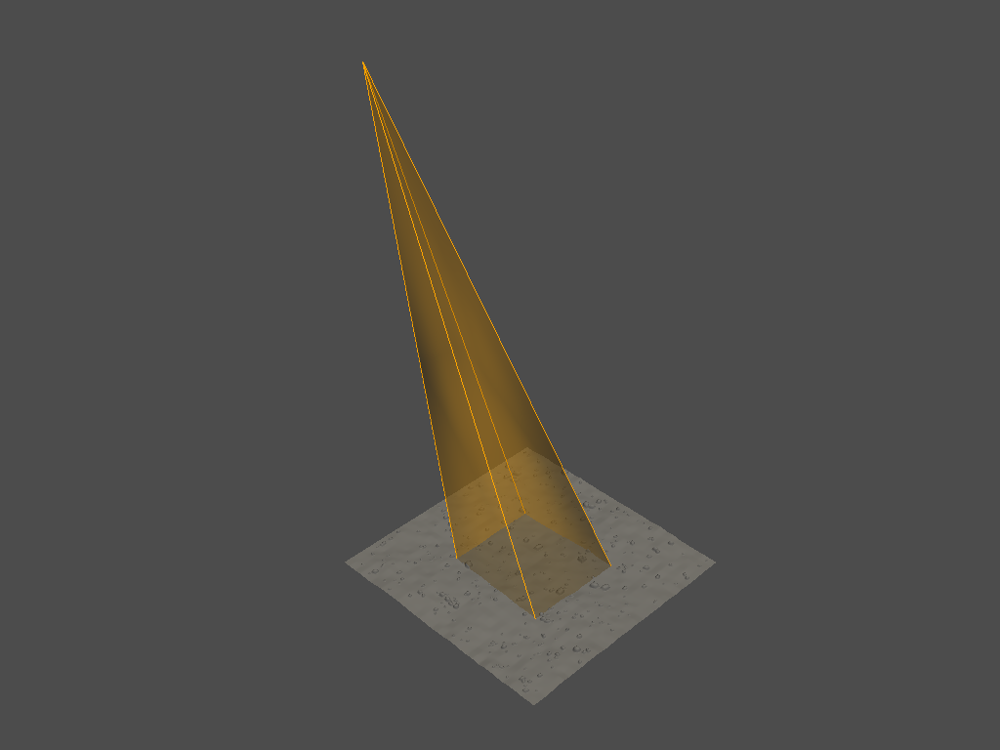

2


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


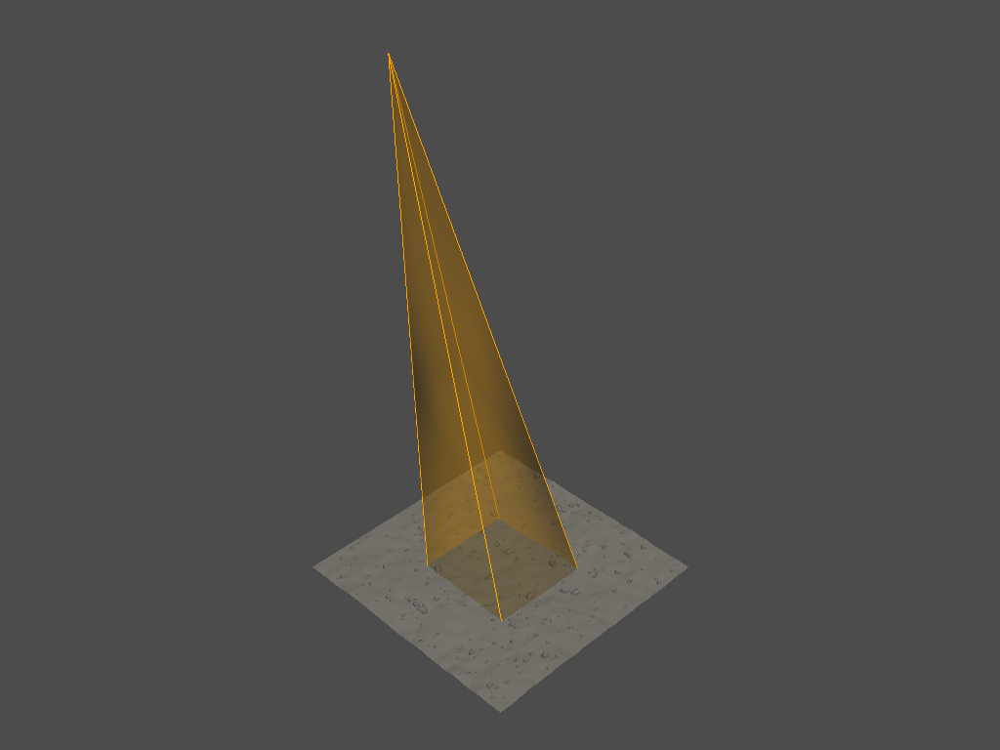

3


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


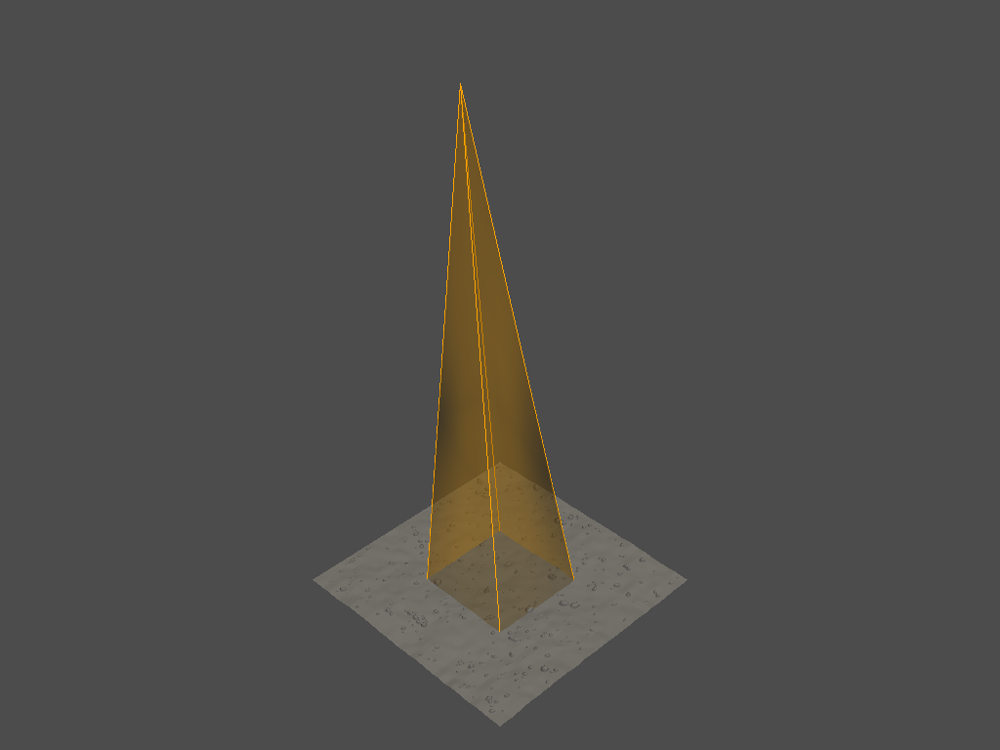

4


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


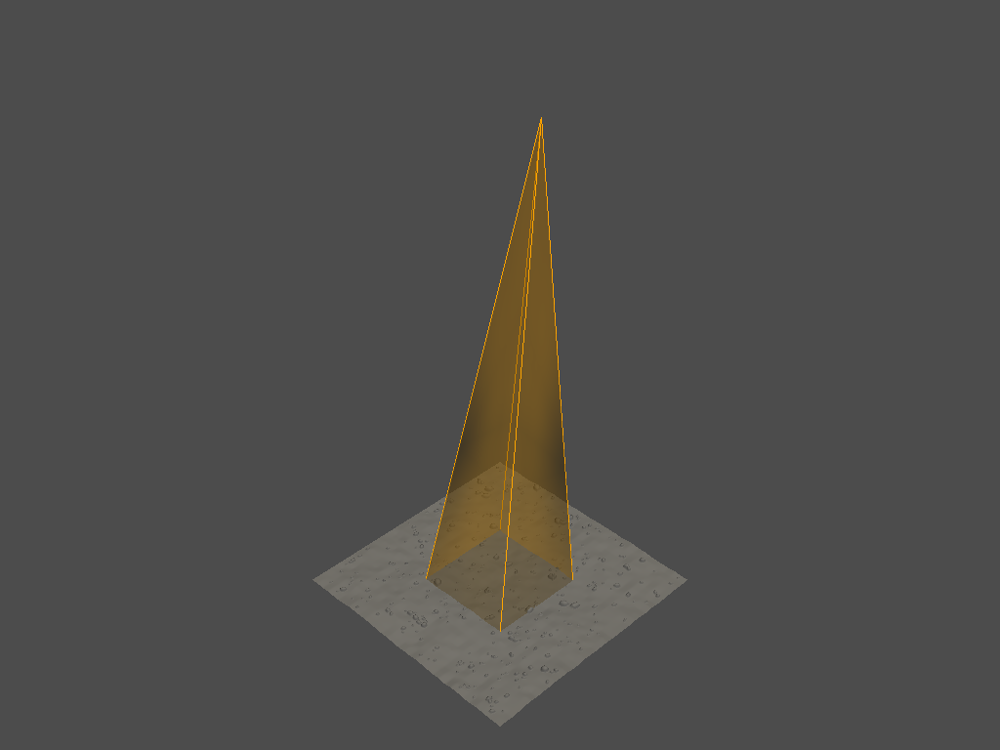

5


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


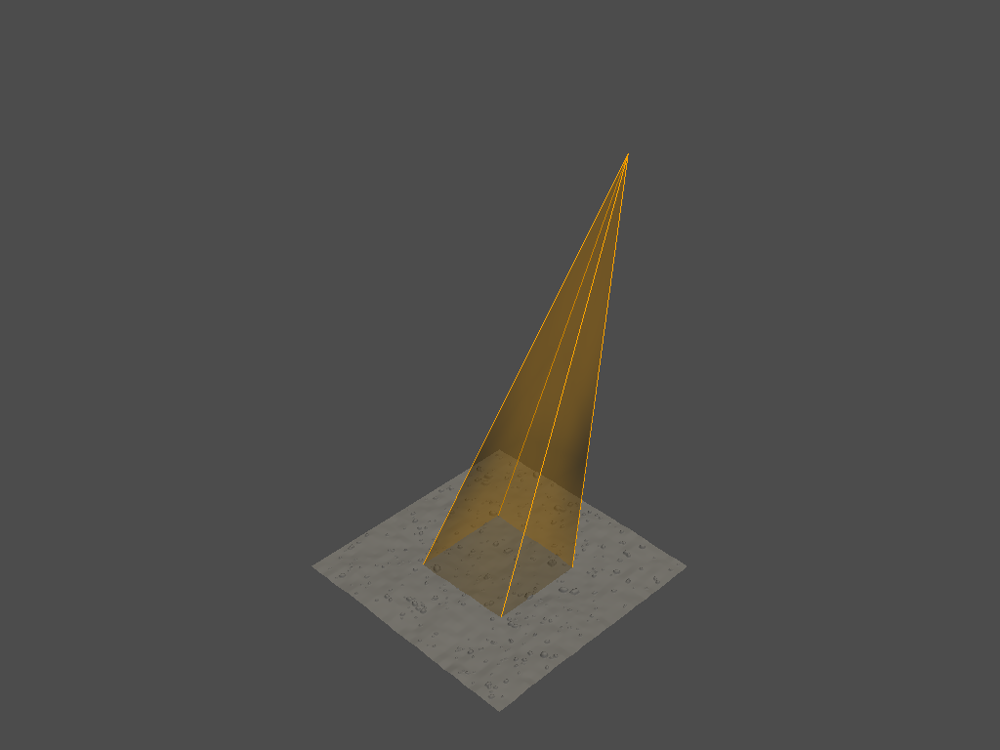

6


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


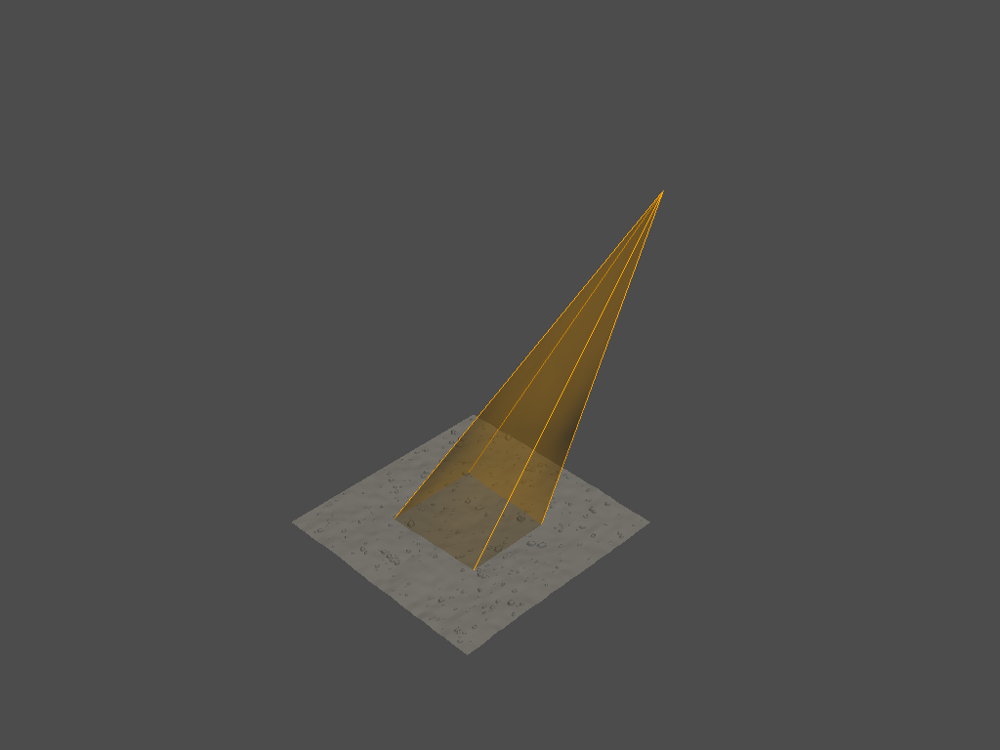

7


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


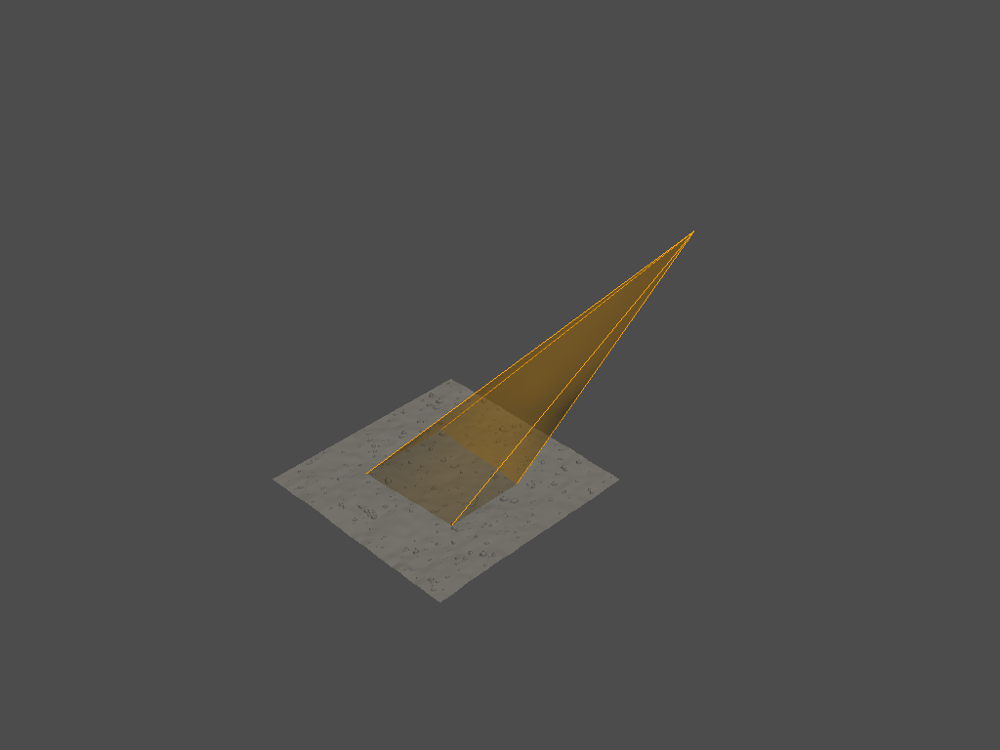

8


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


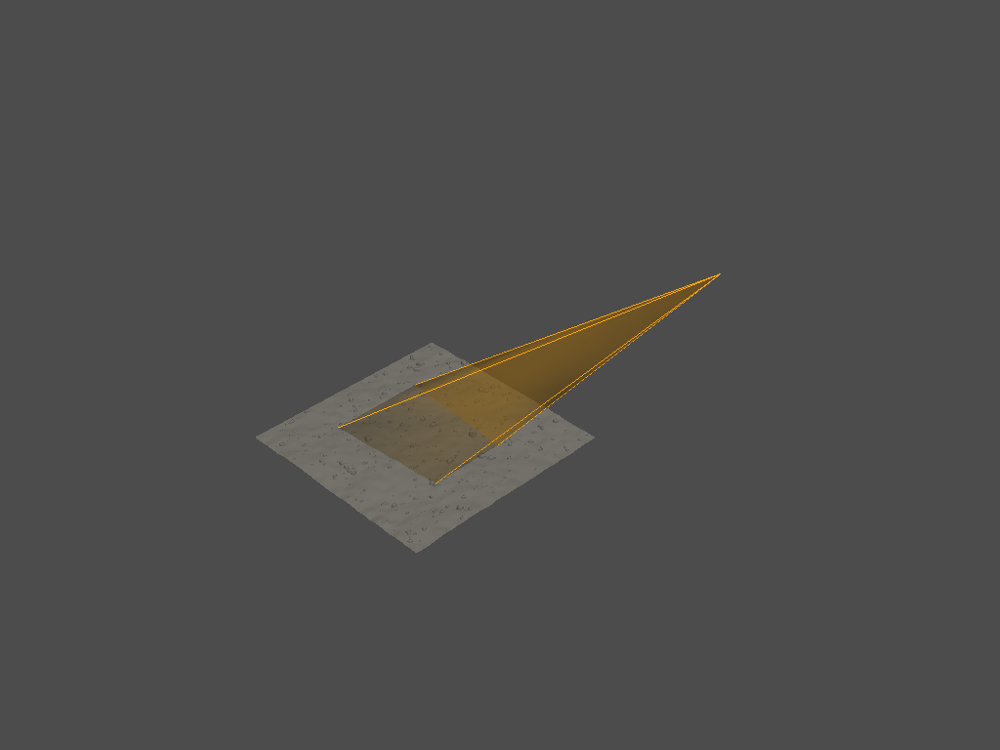

9
(4096, 3)
(699, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


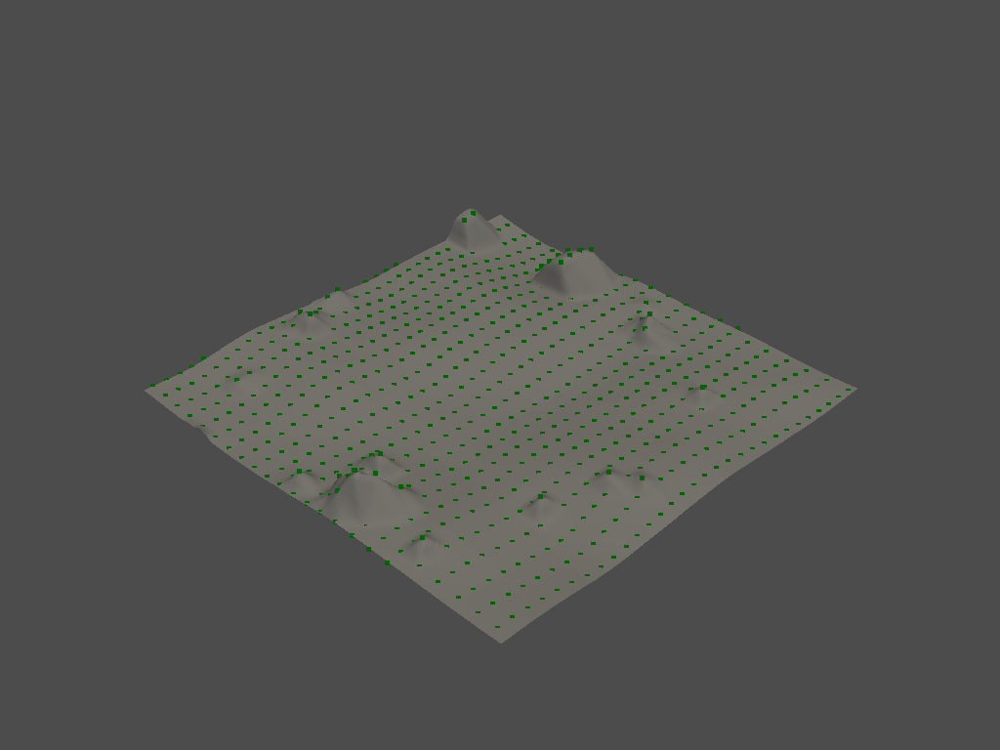

(4096, 3)
(818, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


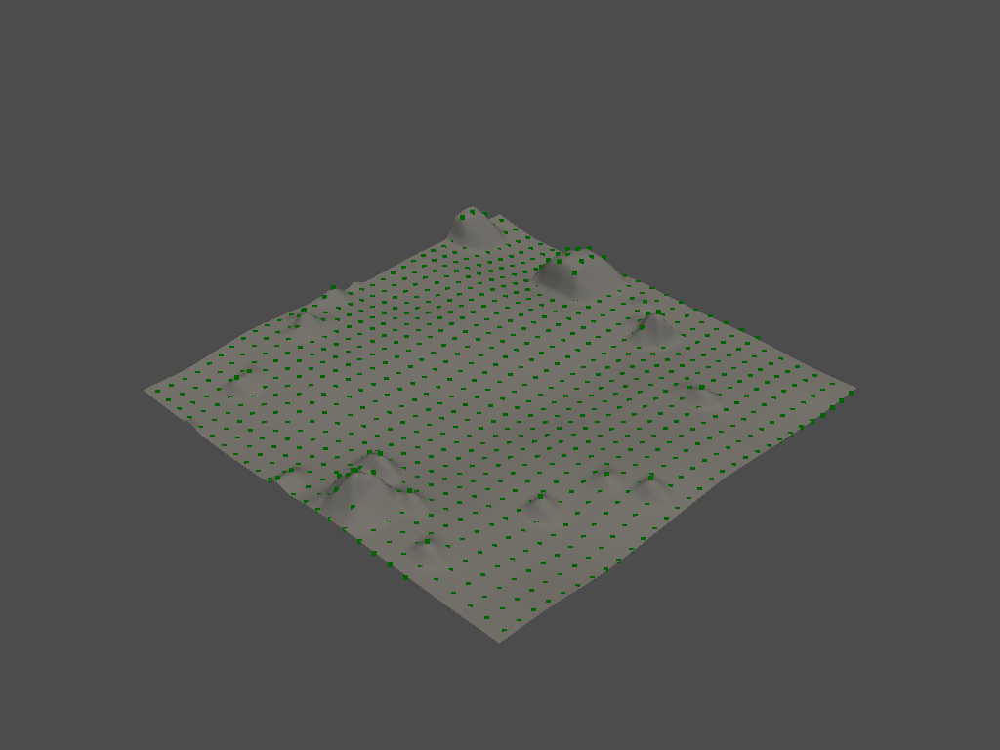

(4096, 3)
(910, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


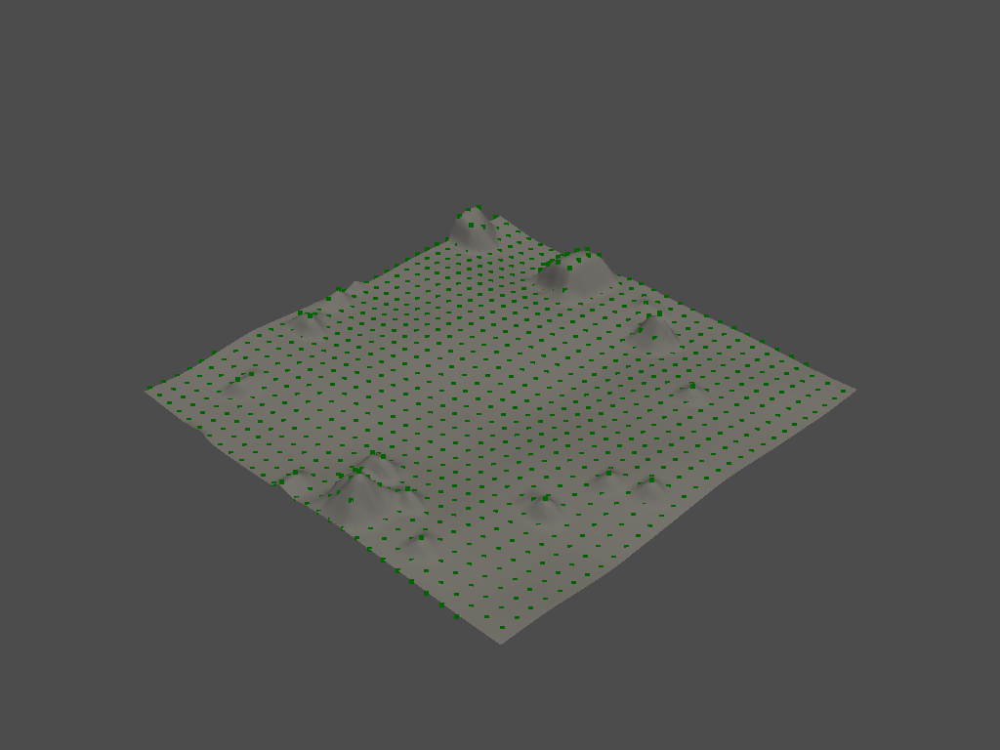

(4096, 3)
(960, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


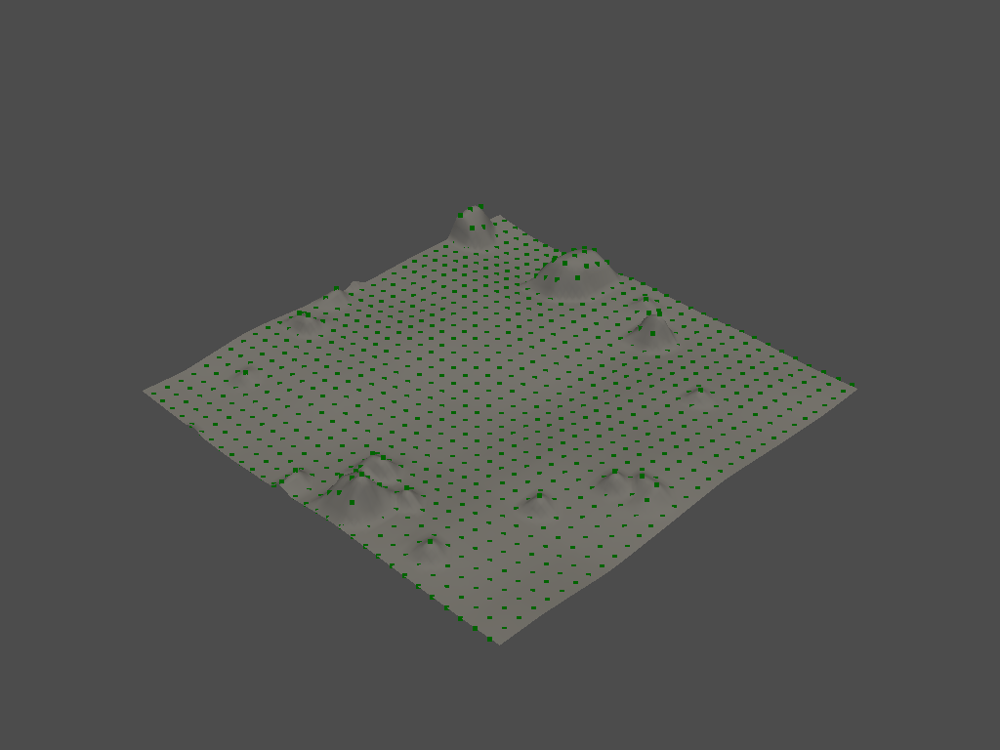

(4096, 3)
(1024, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


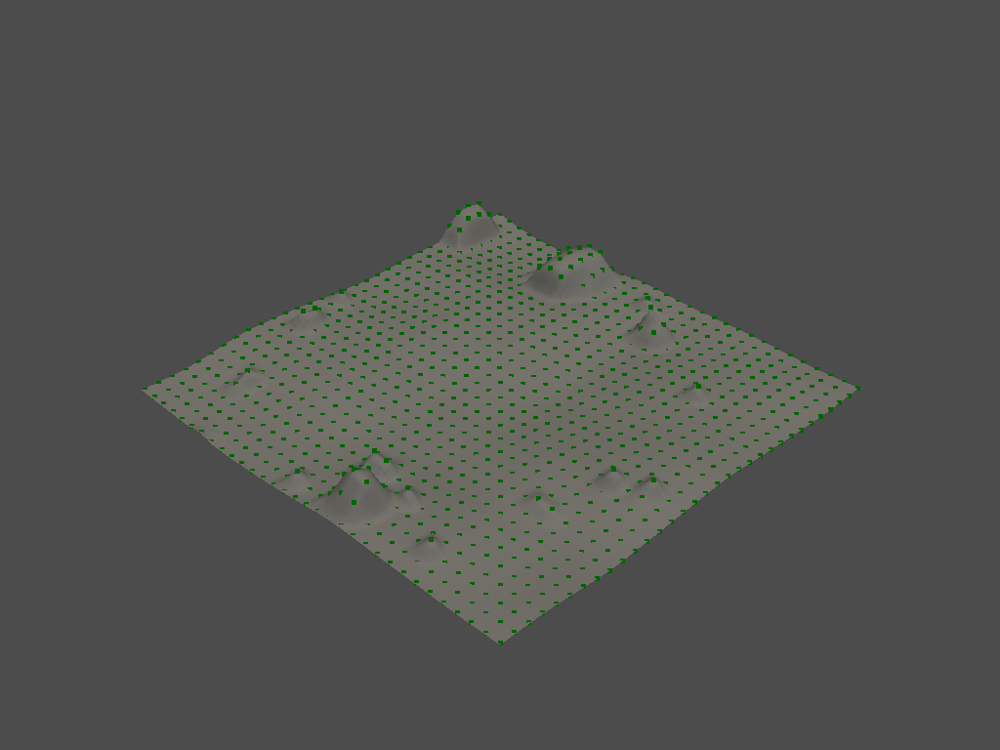

(4096, 3)
(1024, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


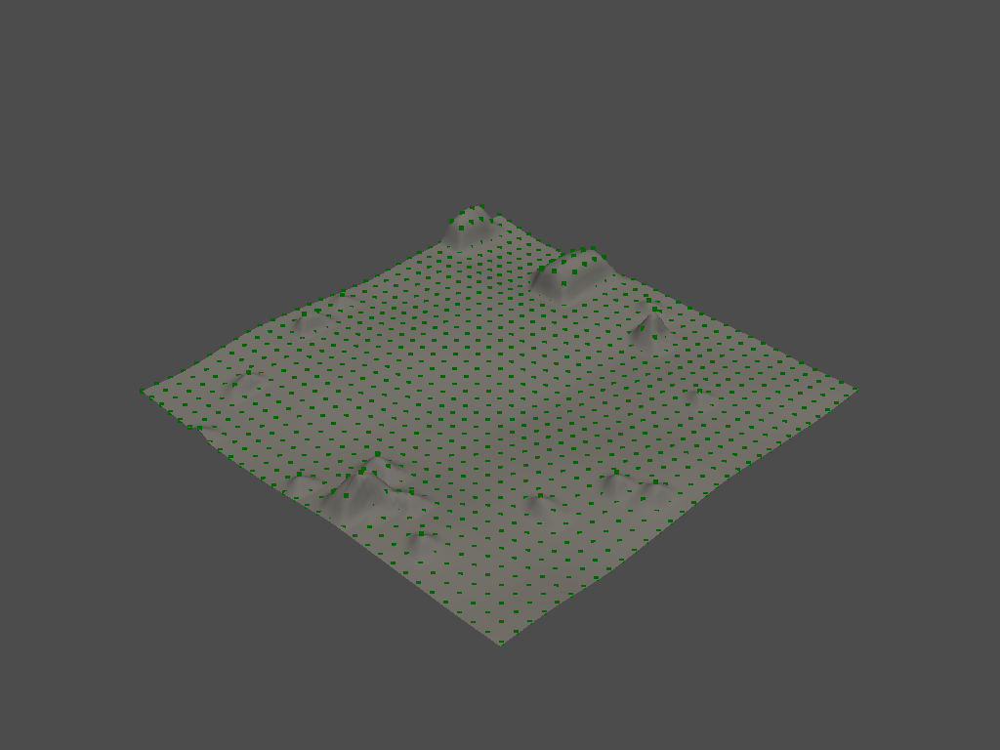

(4096, 3)
(963, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


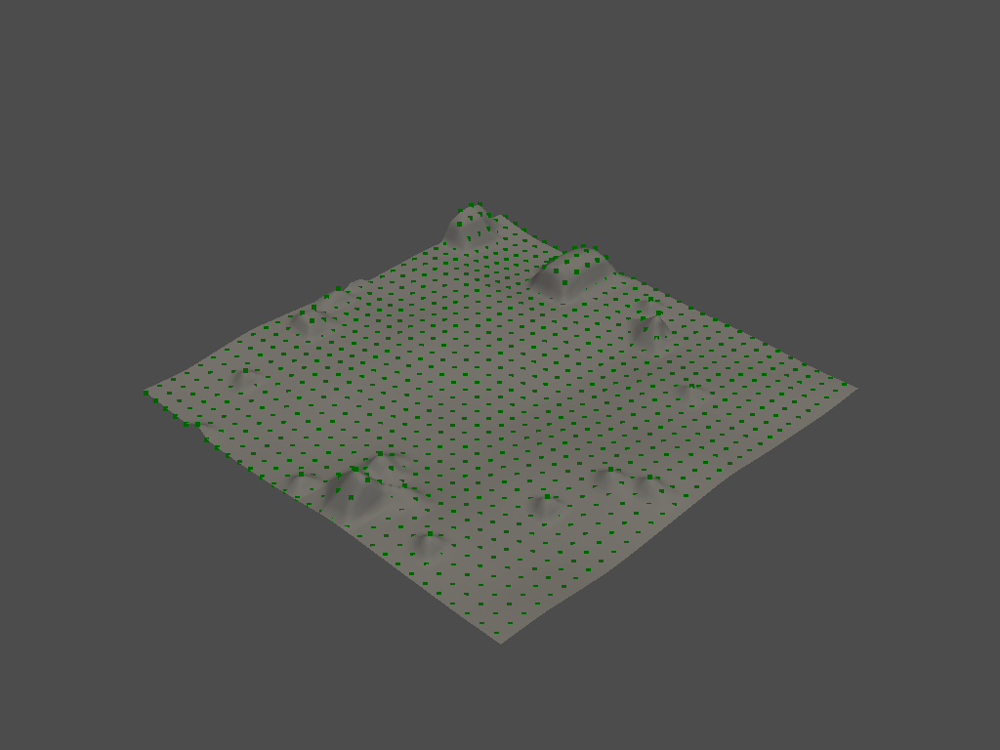

(4096, 3)
(902, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


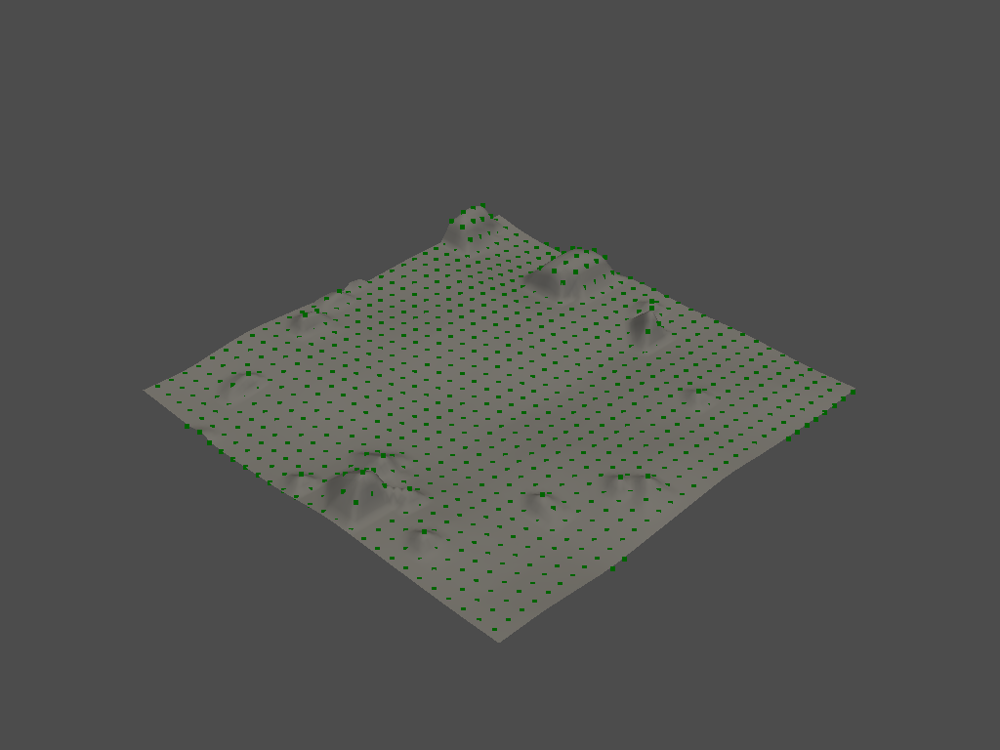

(4096, 3)
(820, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


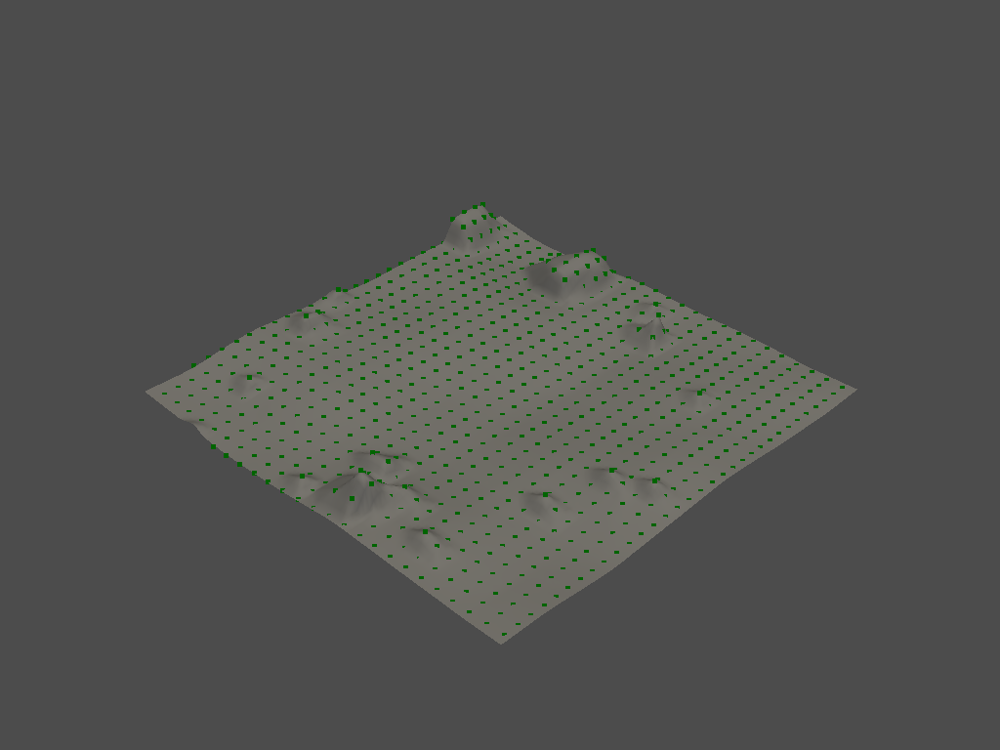

(4096, 3)
(699, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


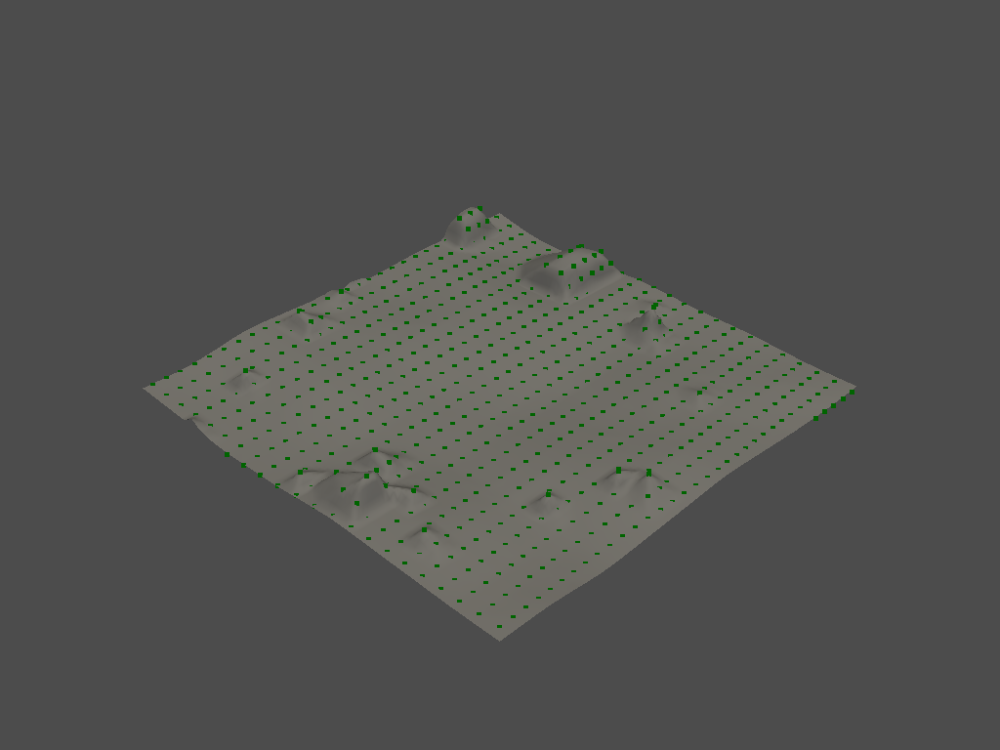

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


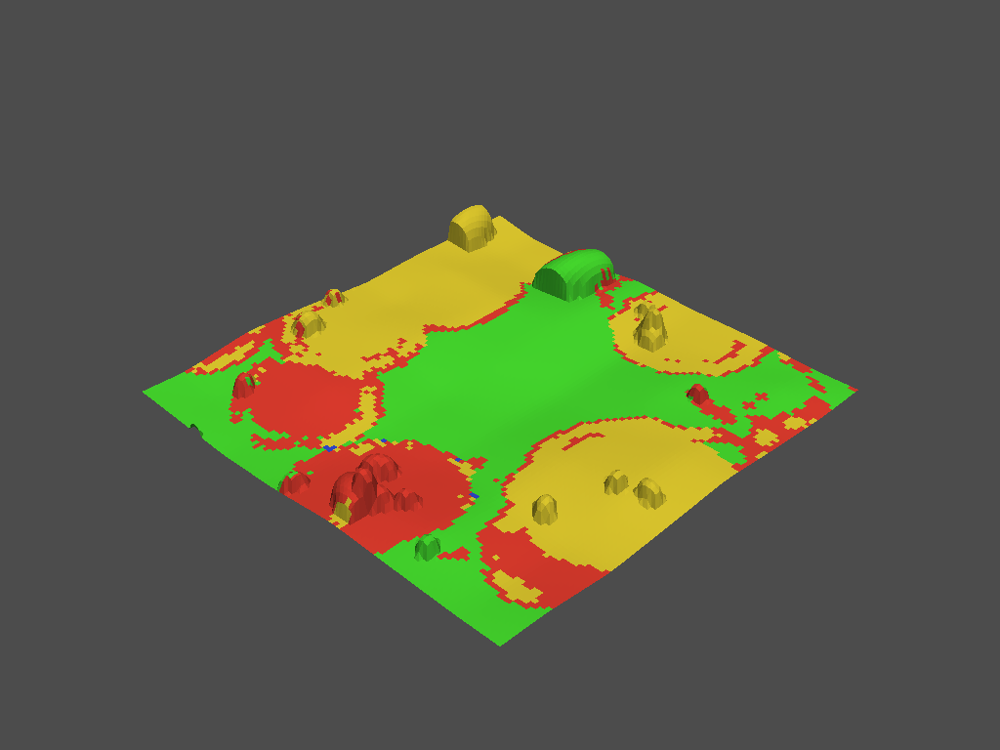

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


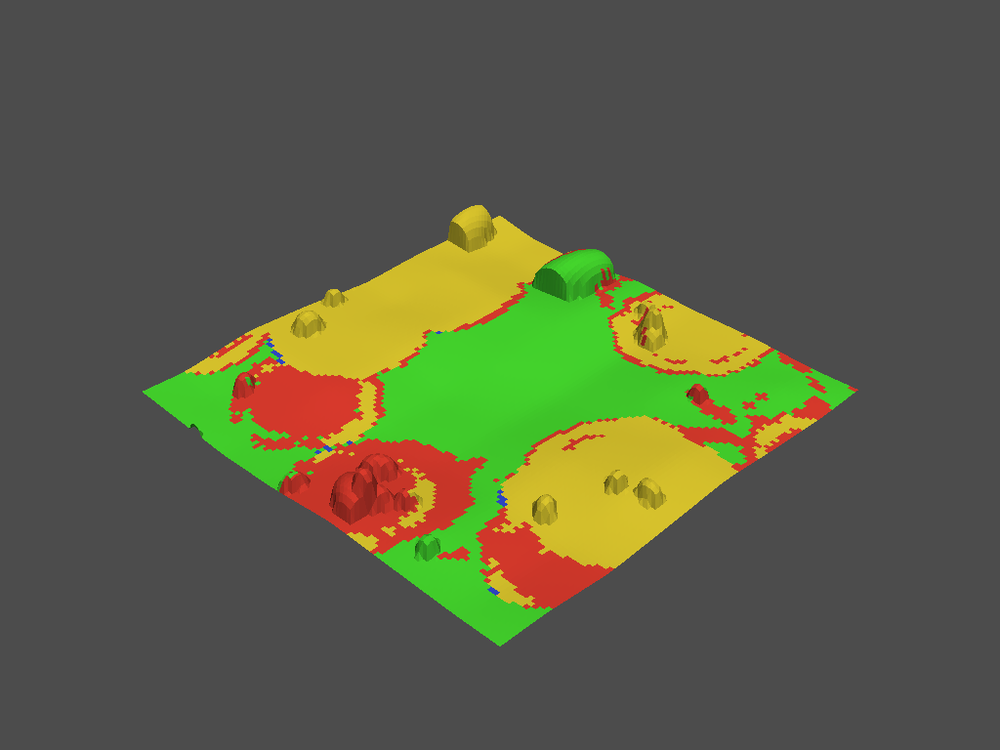

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


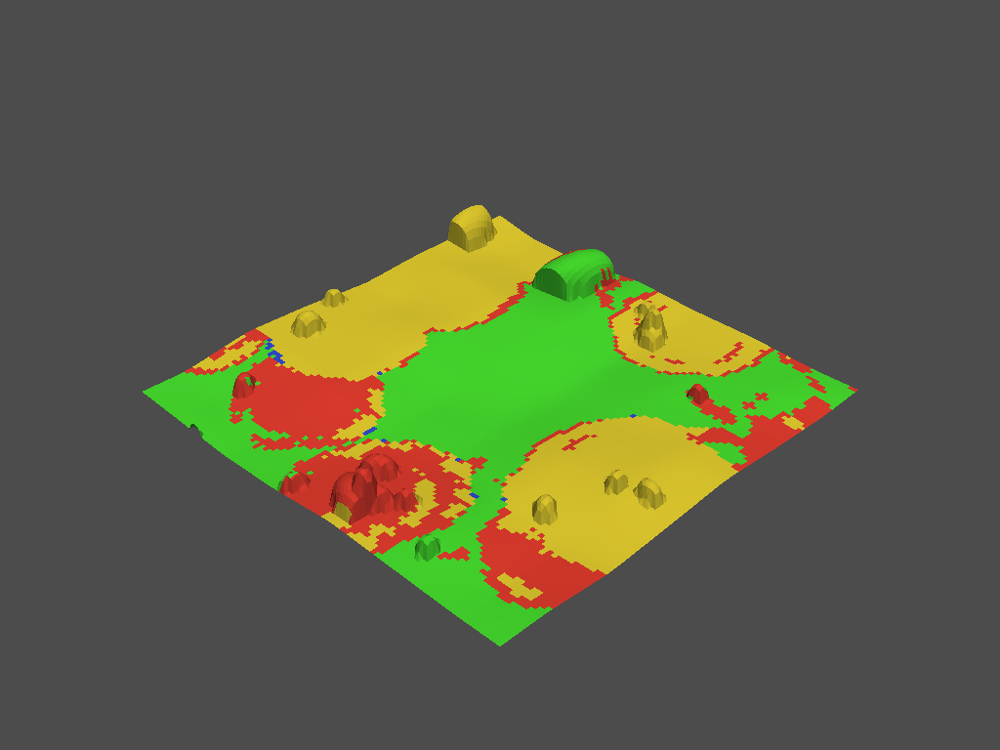

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


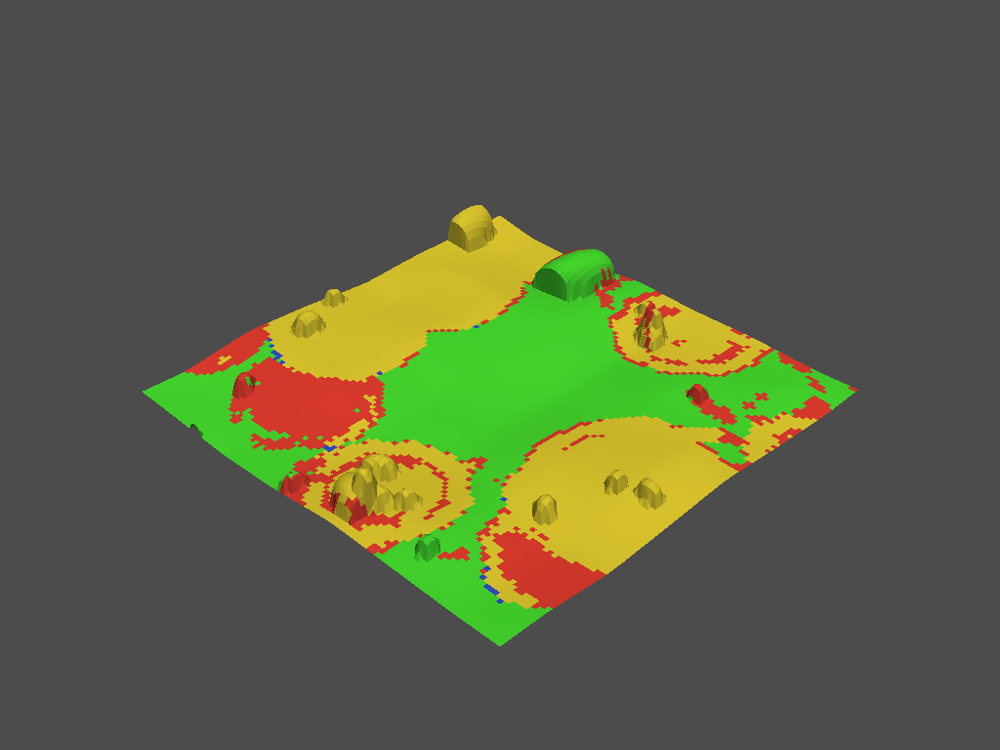

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


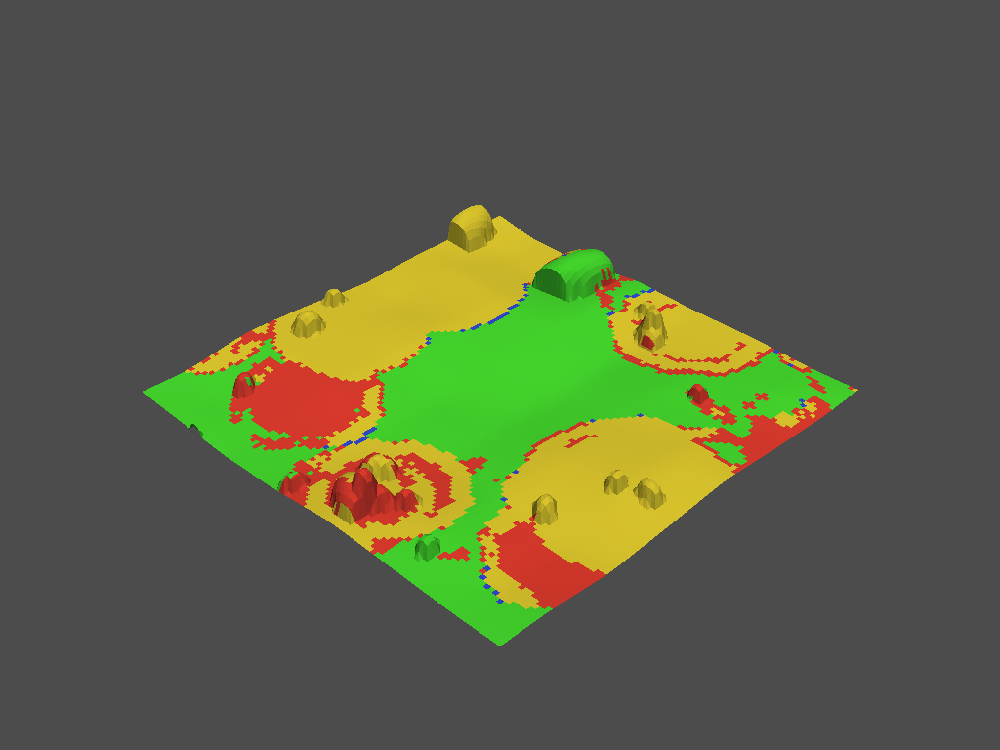

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


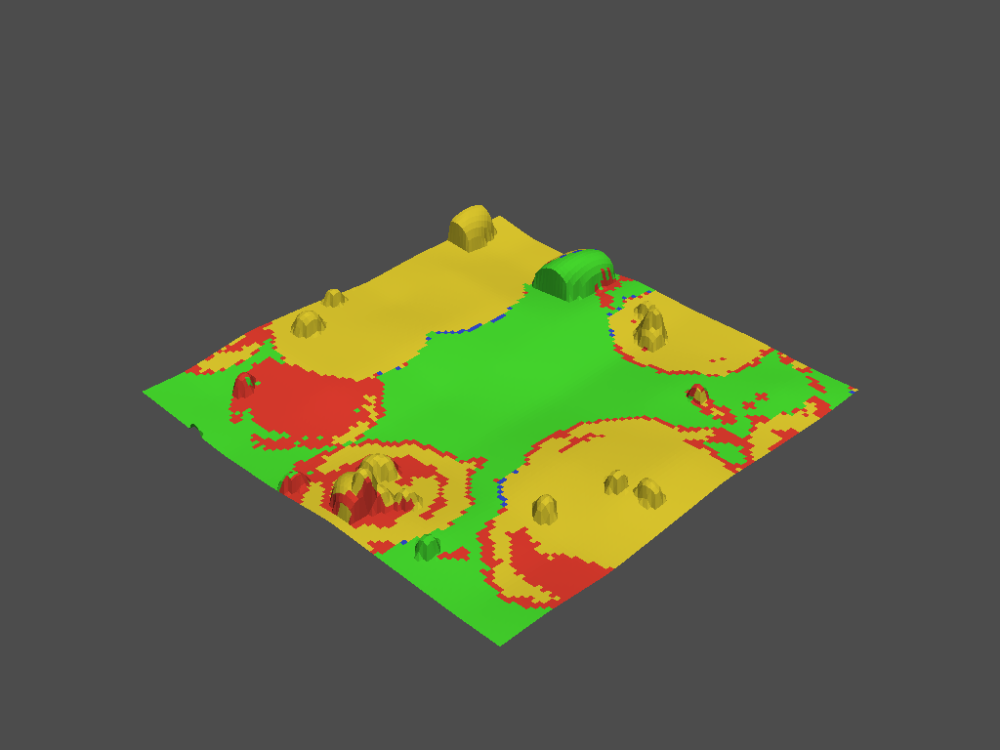

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


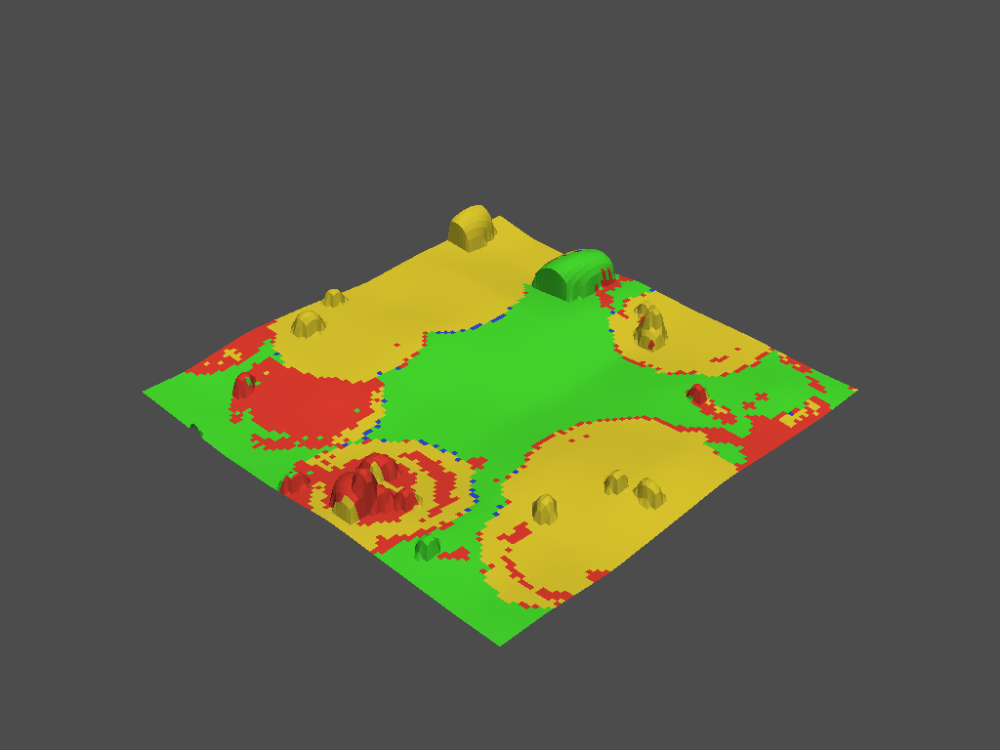

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


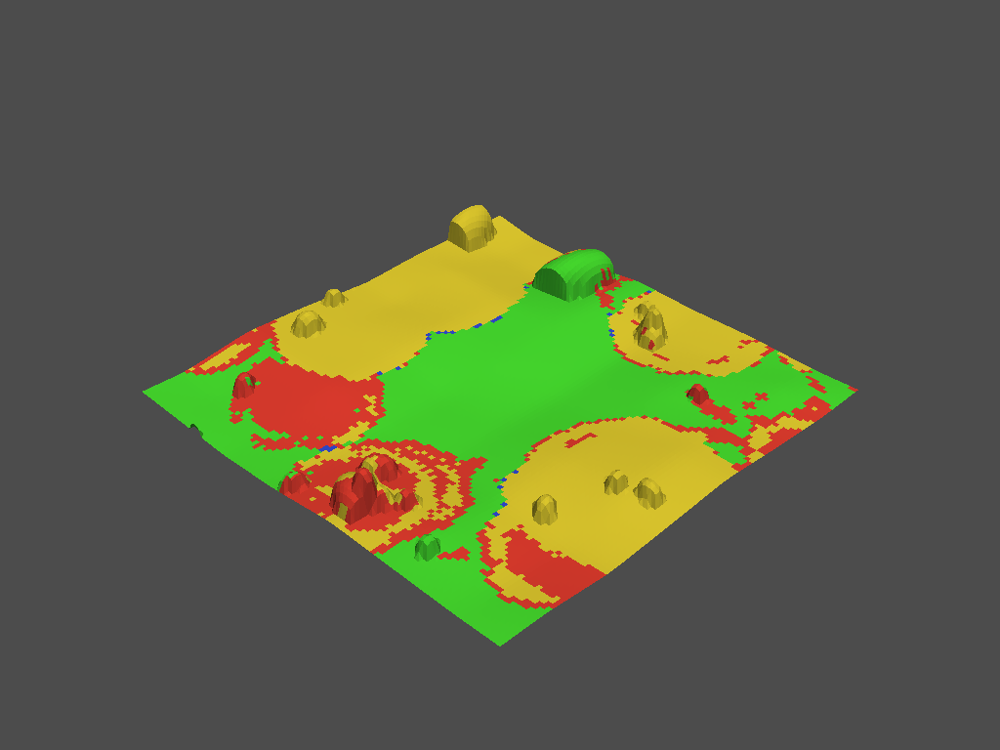

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


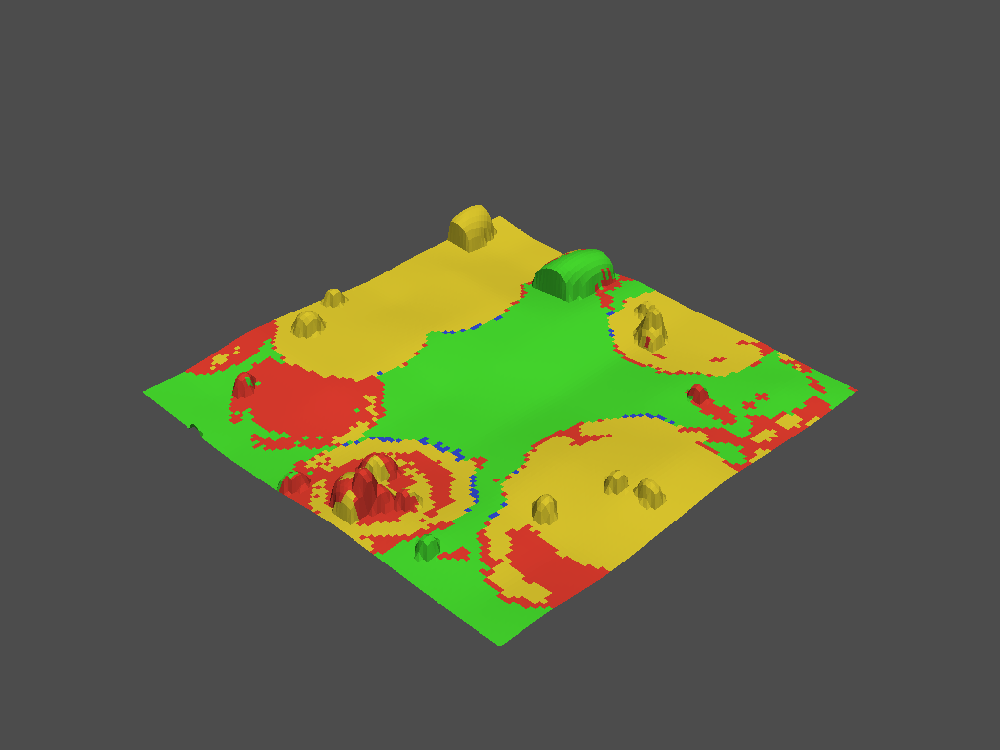

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


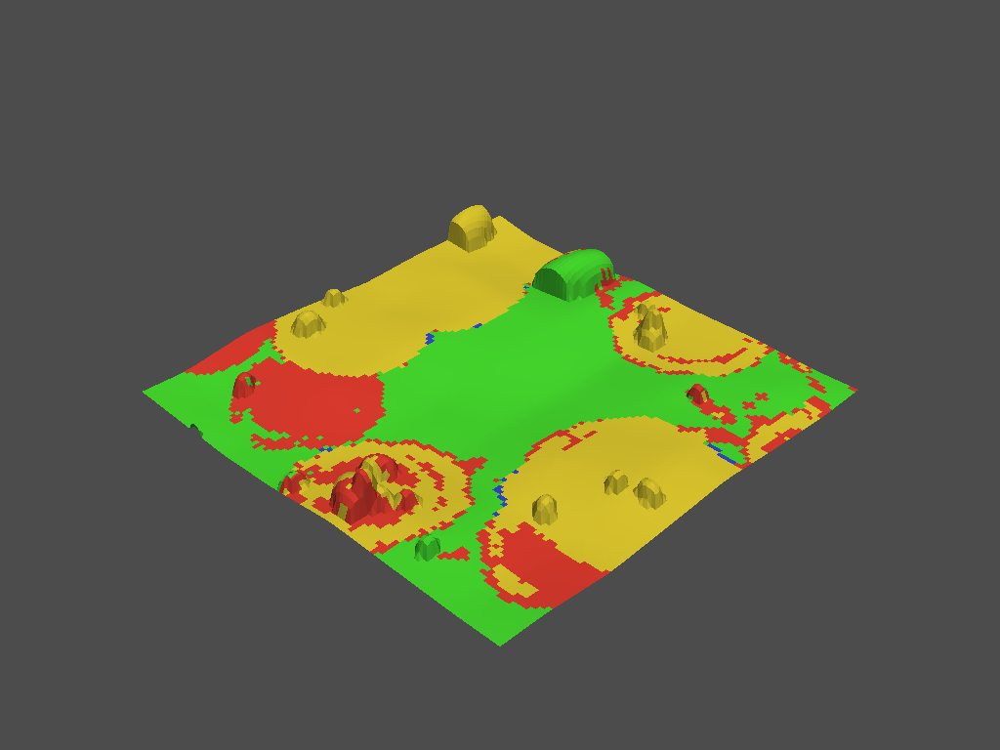

C:\Users\ktomita3\AppData\Local\Temp\ipykernel_26212\2991450551.py:88: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  images = [imageio.imread(file) for file in file_list]
c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


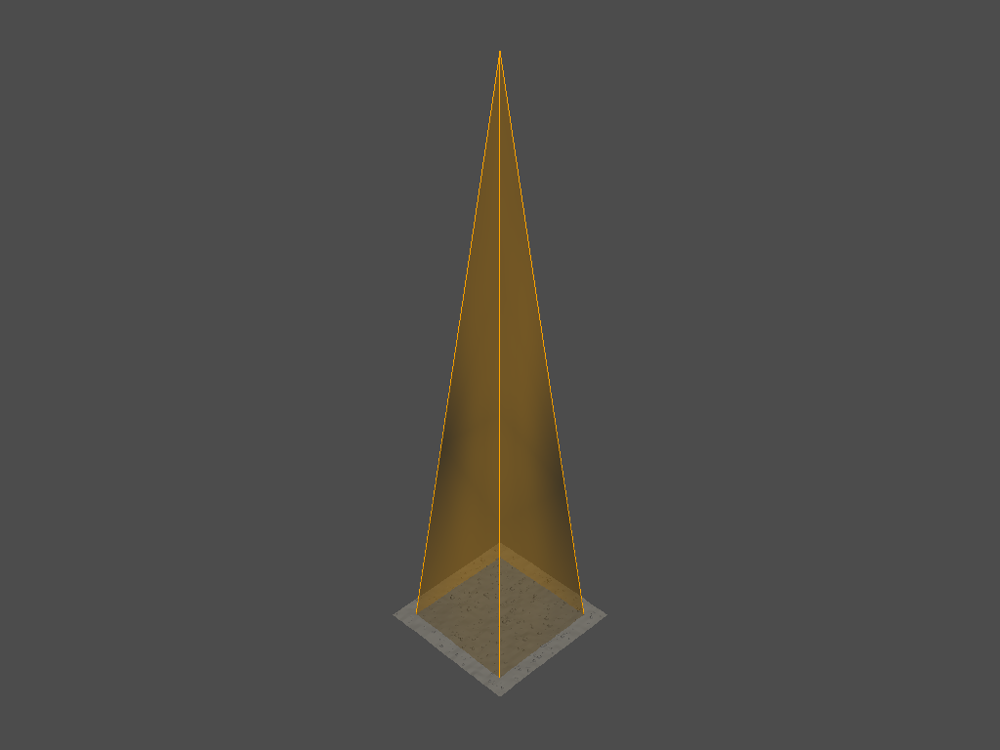

0


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


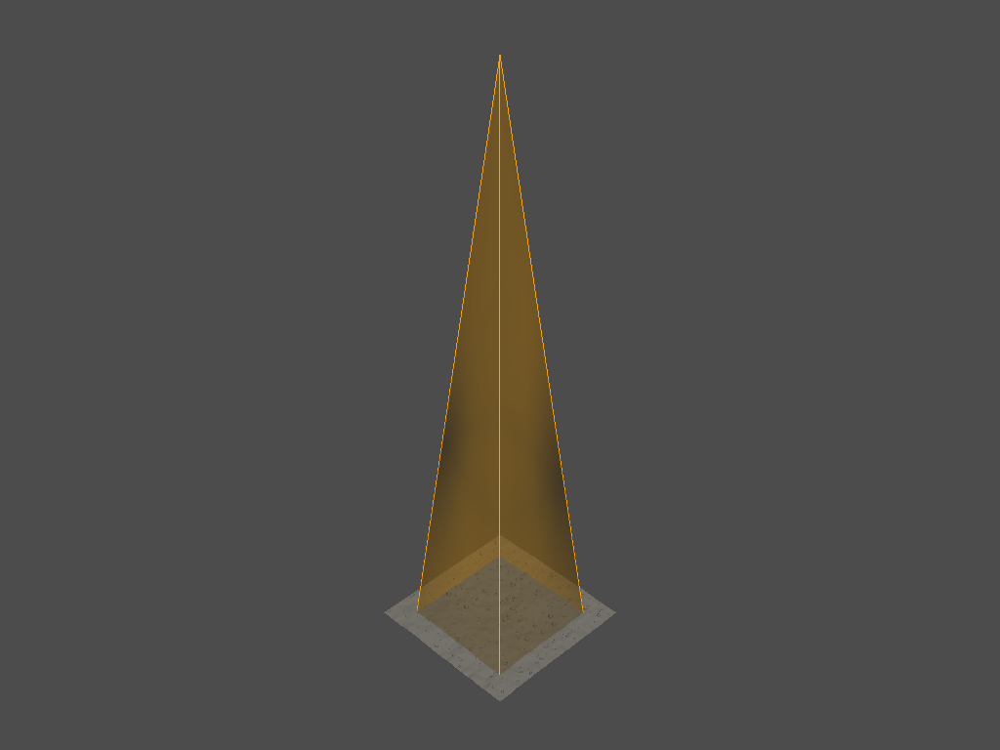

1


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


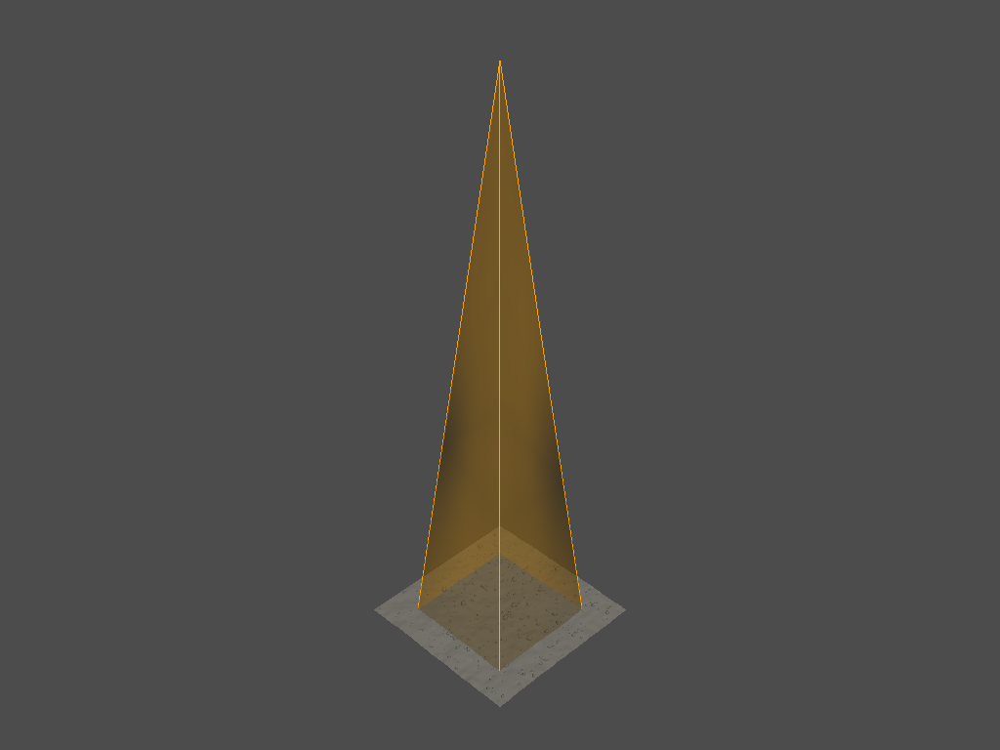

2


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


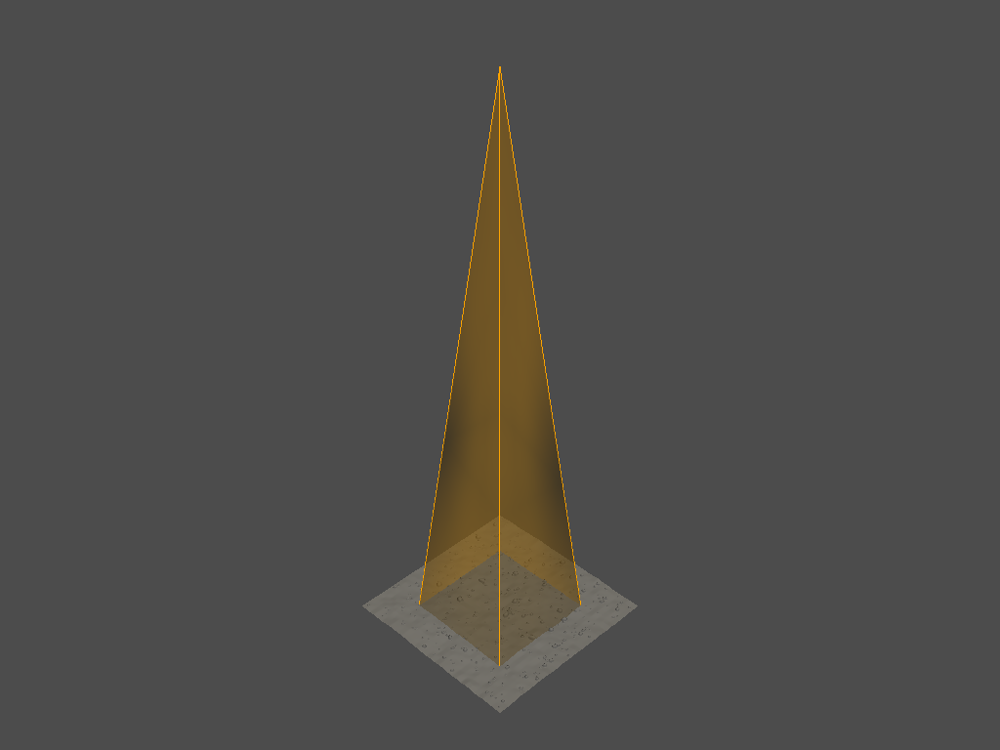

3


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


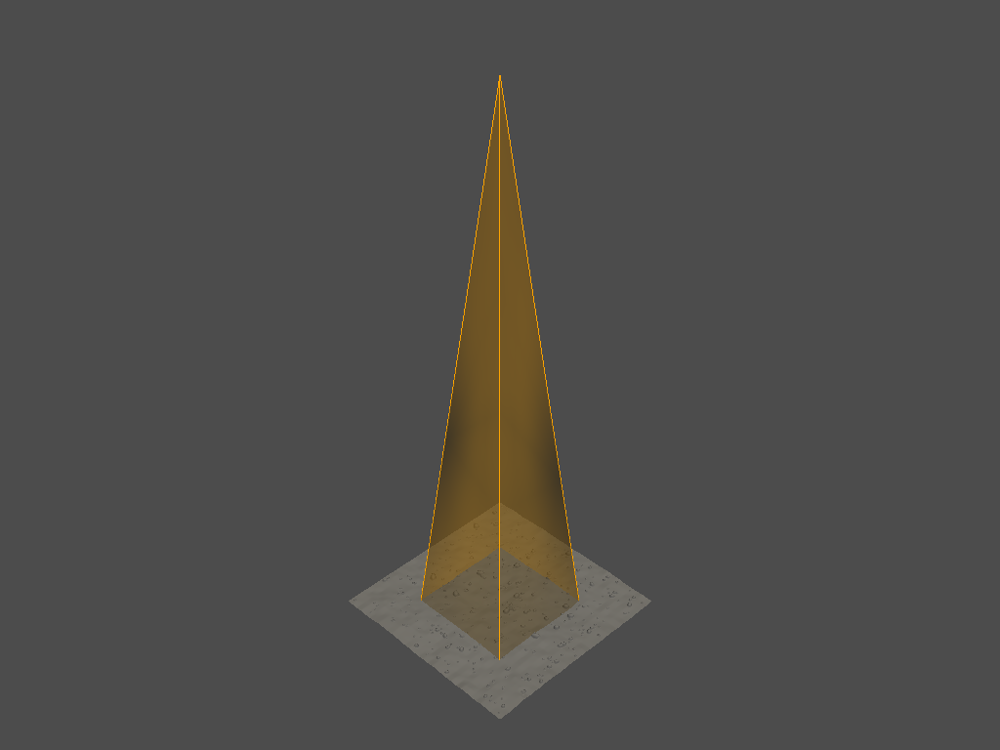

4


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


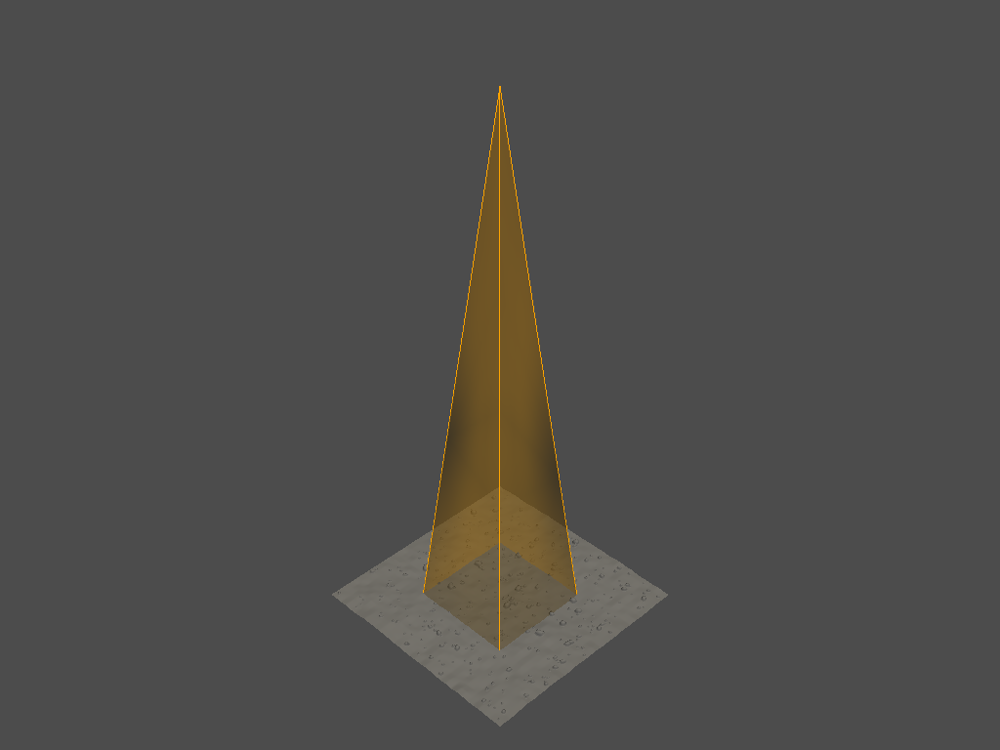

5


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


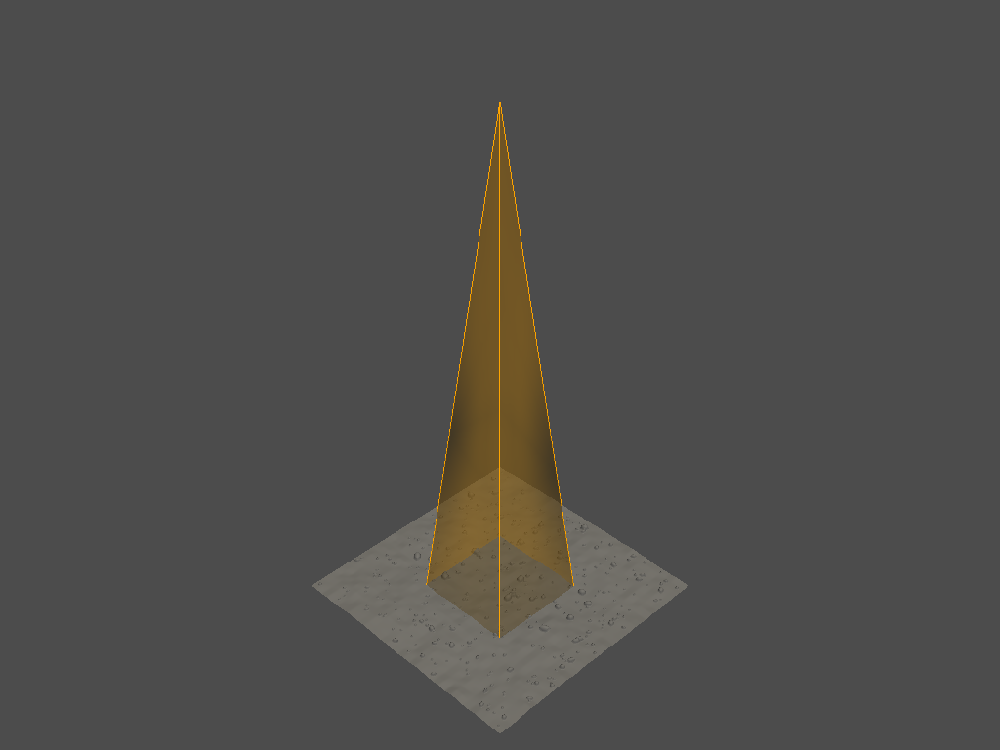

6


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


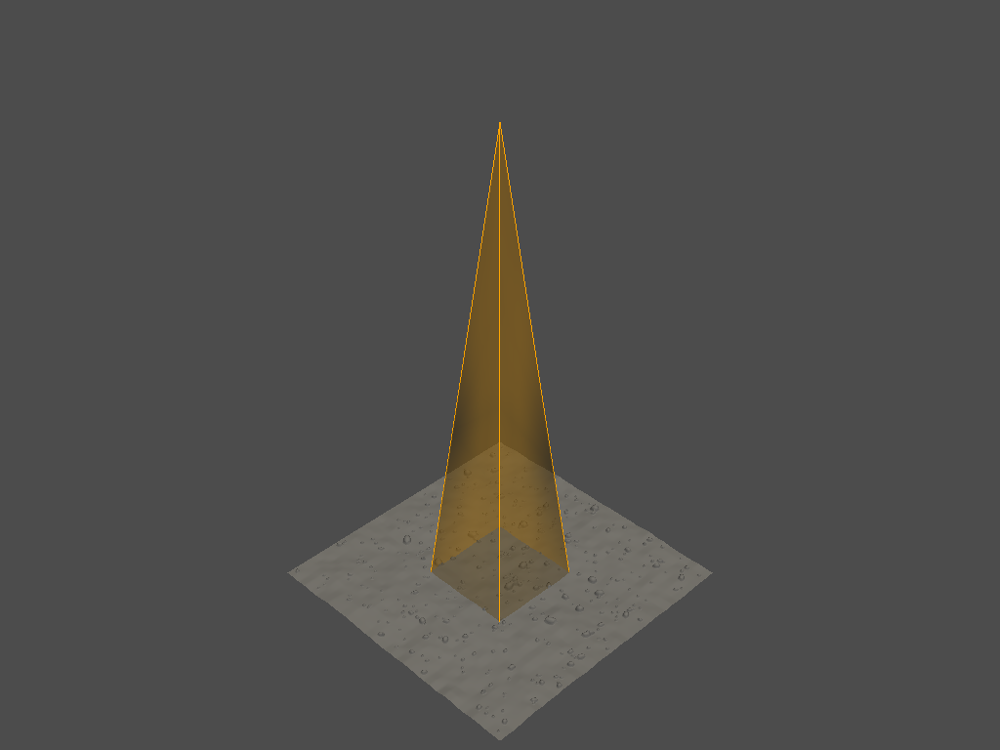

7


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


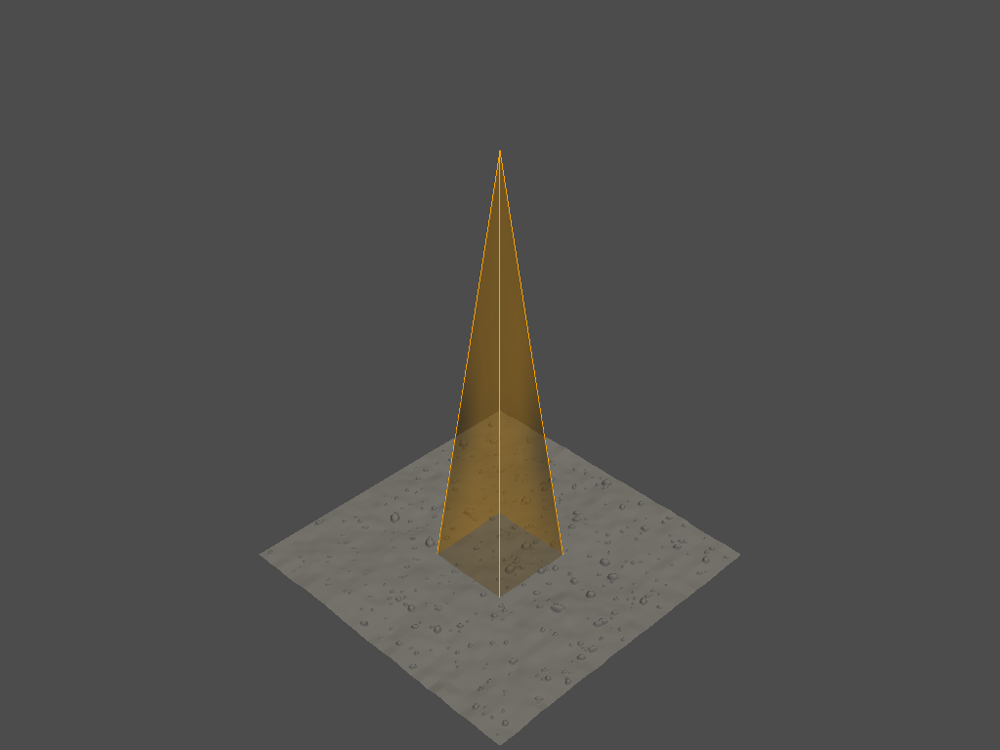

8


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


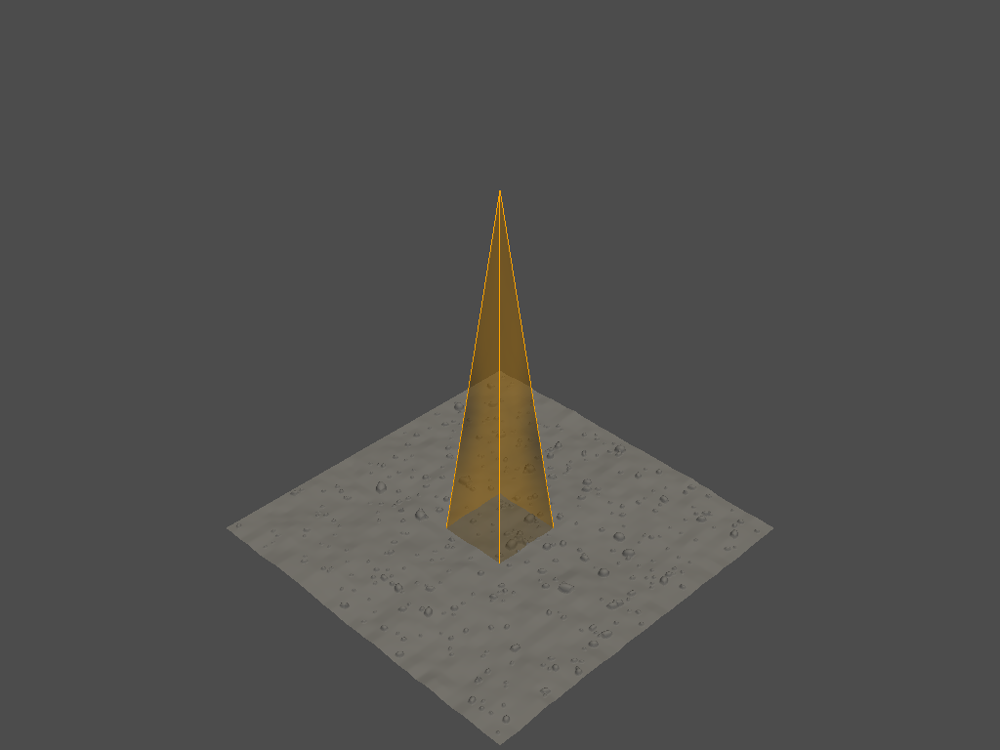

9
(4095, 3)
(256, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


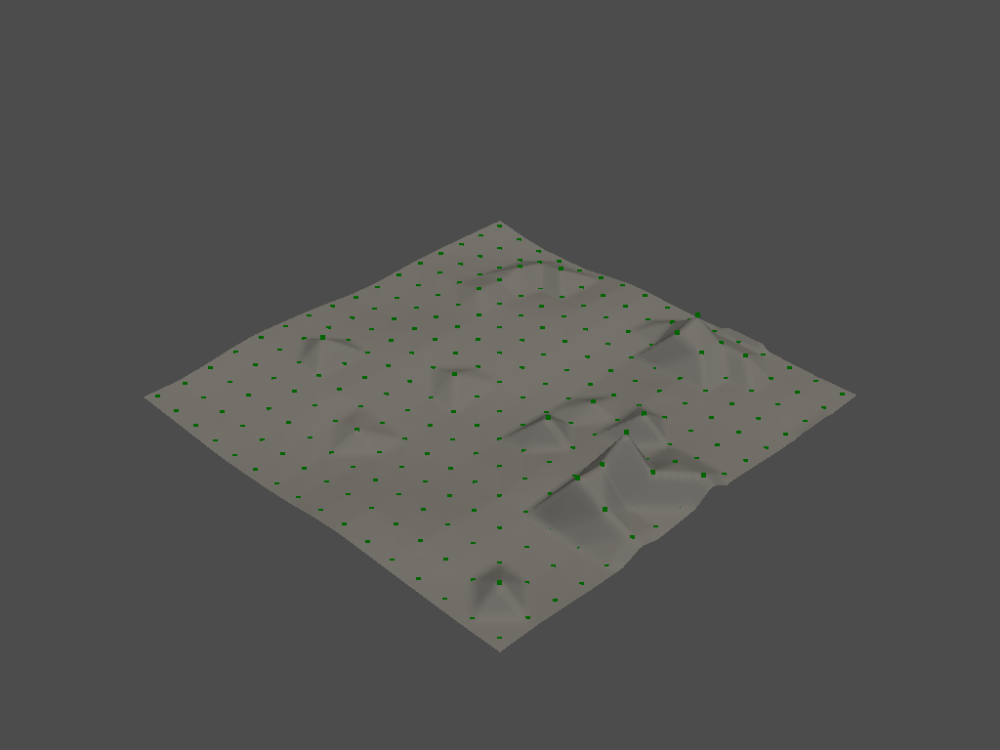

(4096, 3)
(324, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


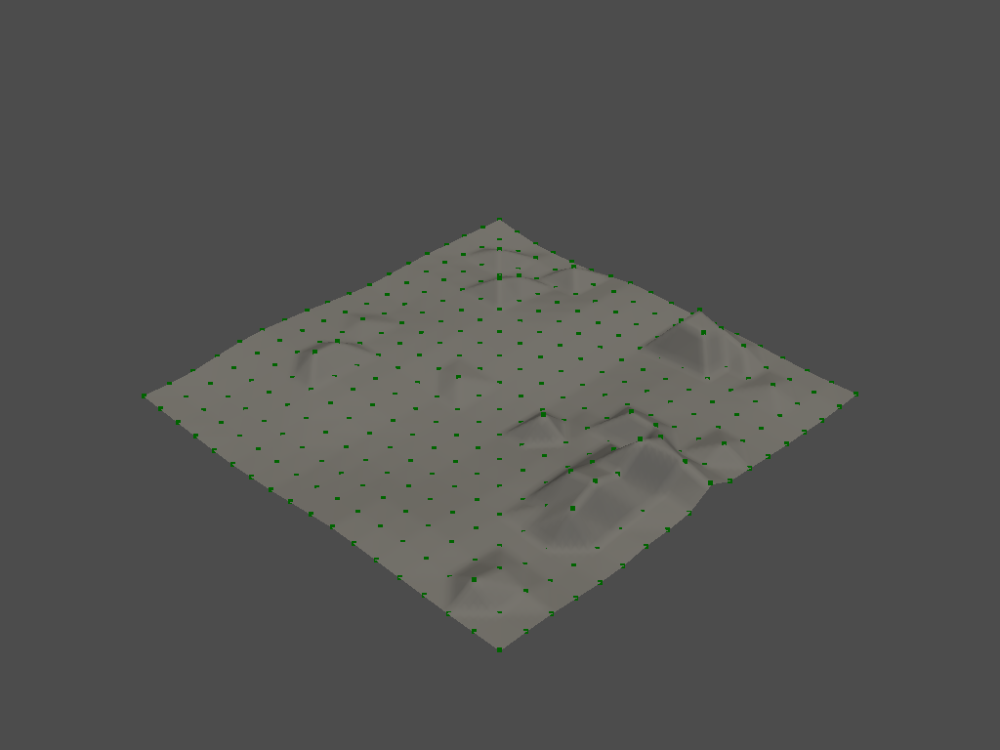

(4096, 3)
(324, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


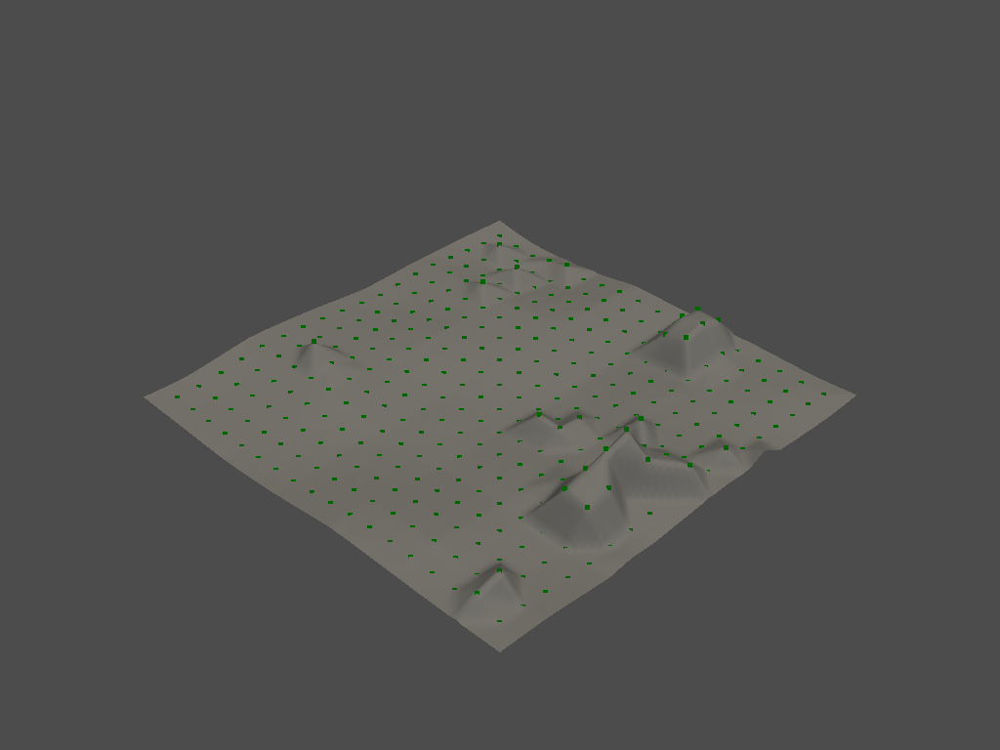

(4096, 3)
(461, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


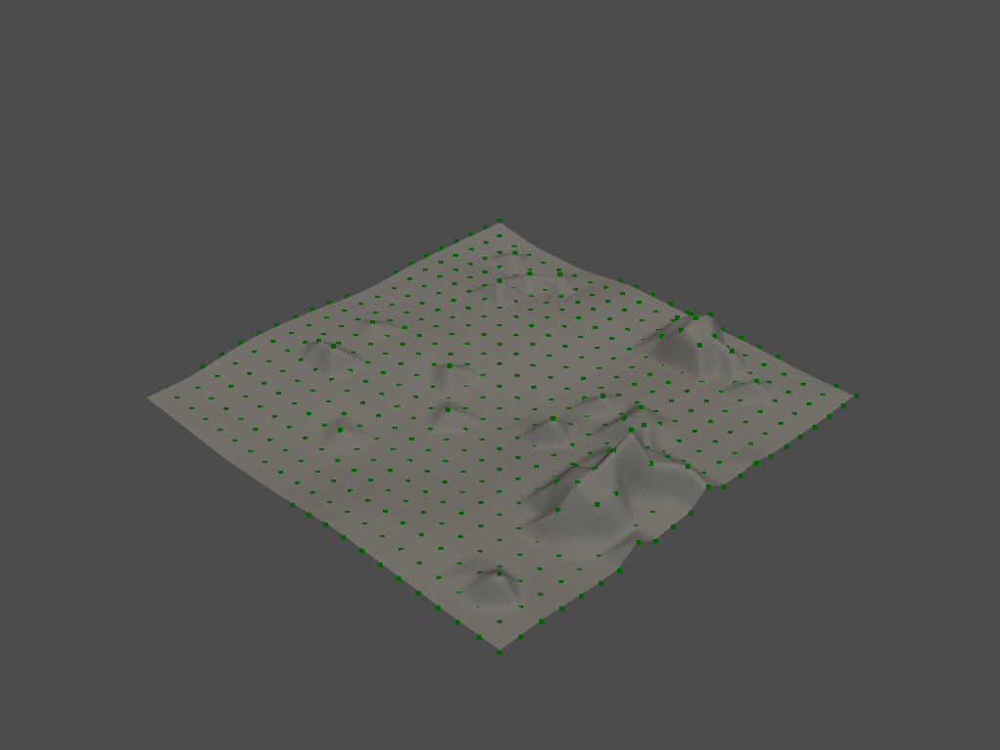

(4096, 3)
(576, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


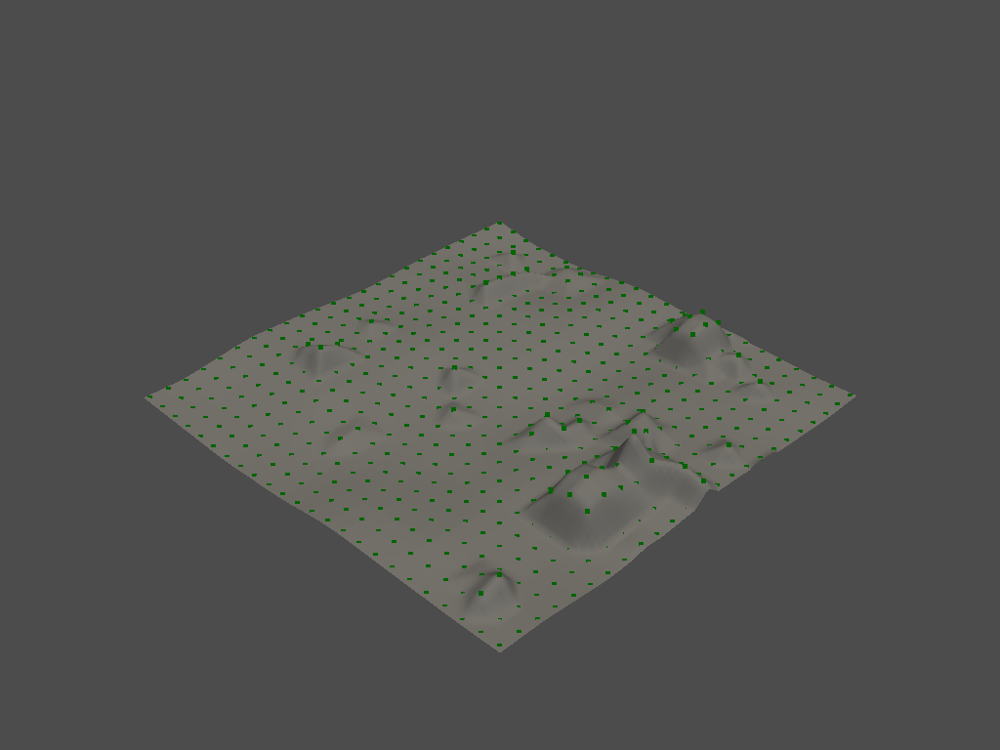

(4096, 3)
(753, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


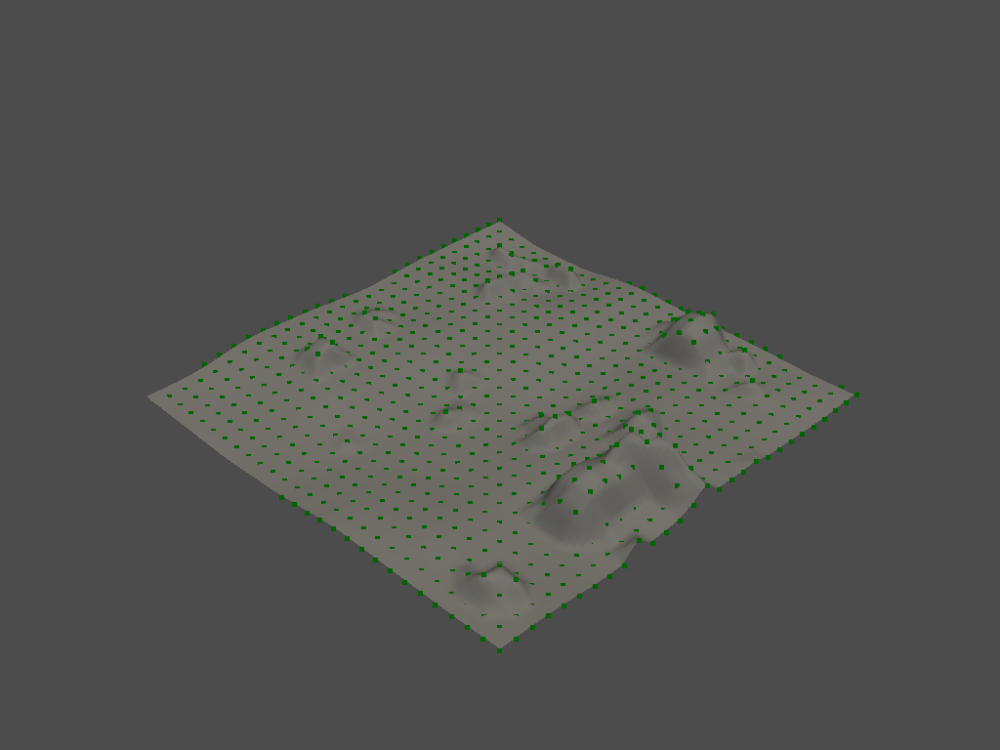

(4096, 3)
(1024, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


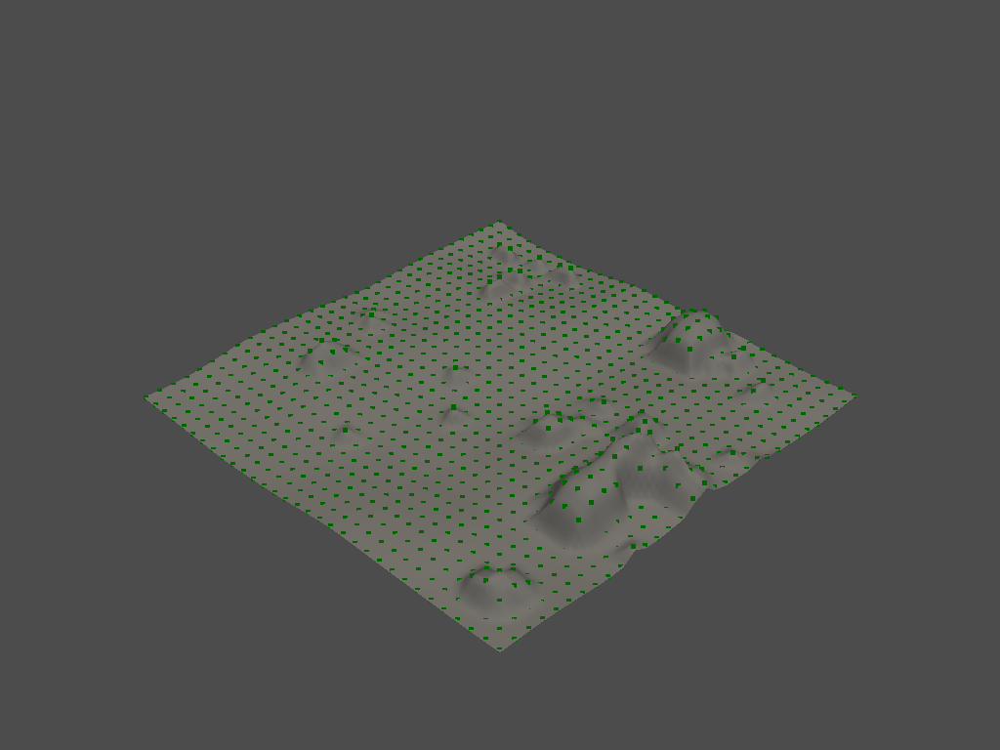

(4096, 3)
(1444, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


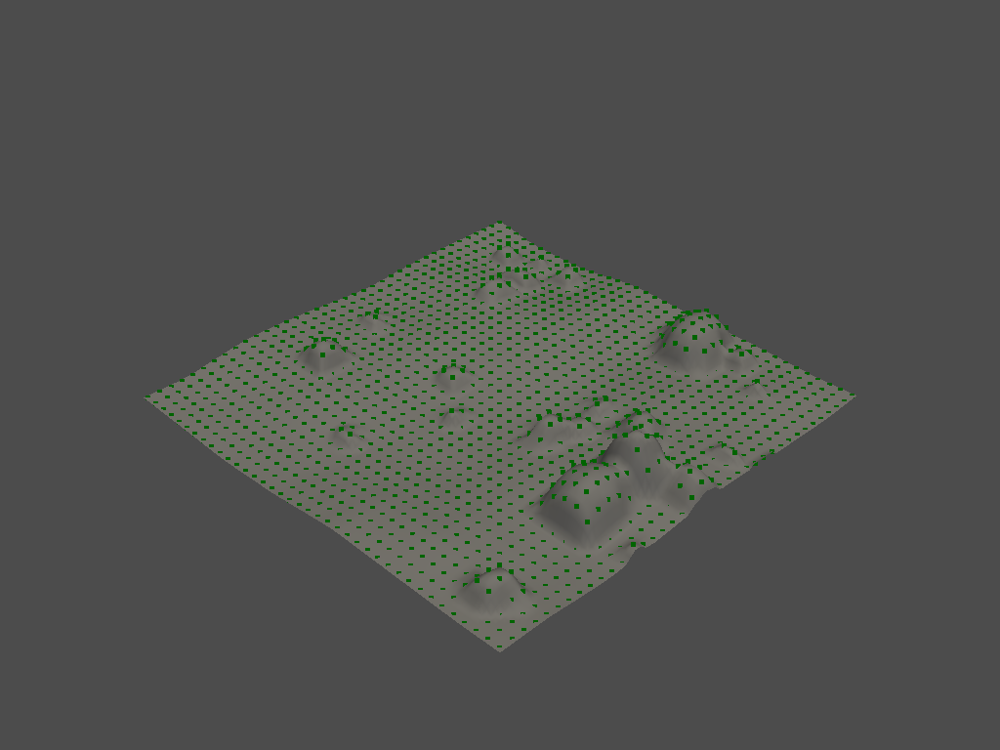

(4096, 3)
(2304, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


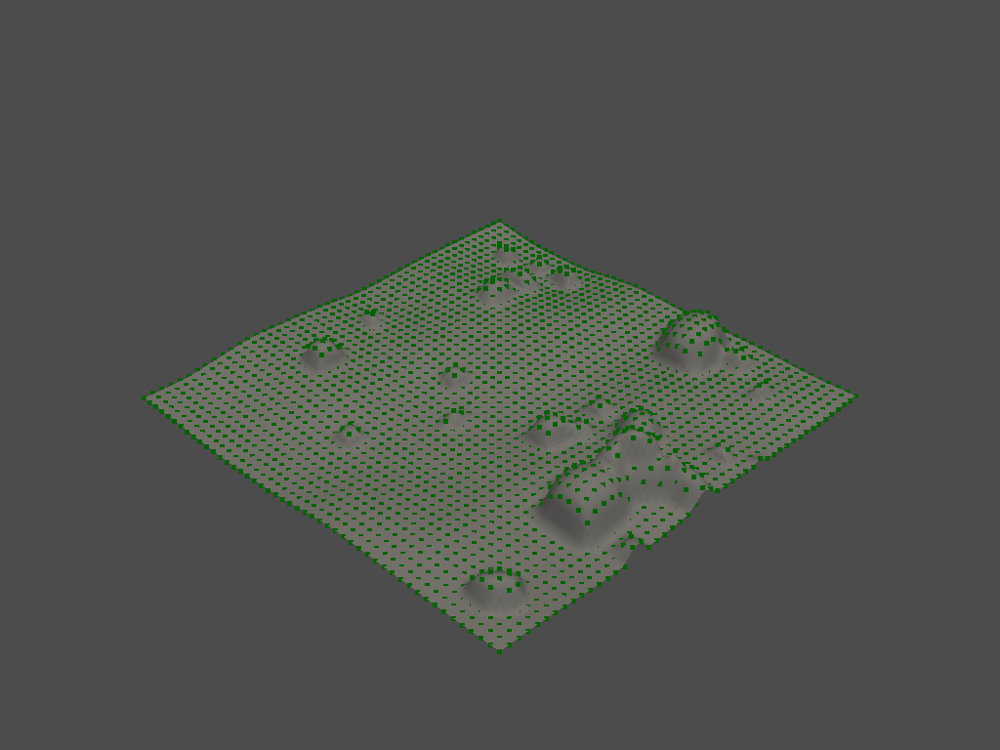

(4096, 3)
(4027, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


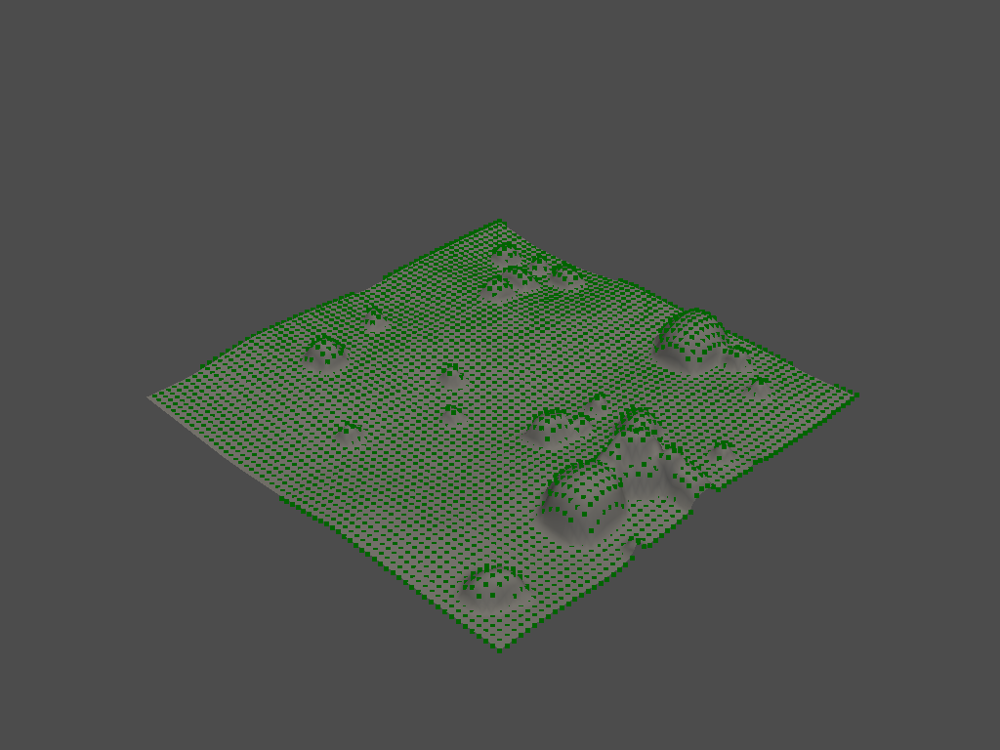

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


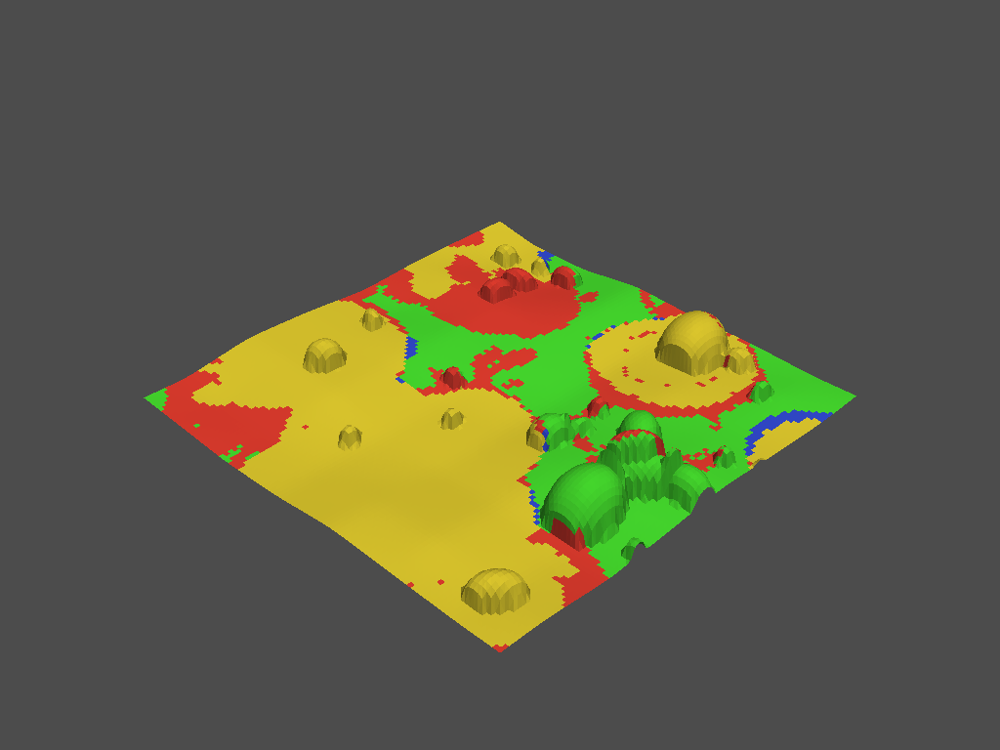

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


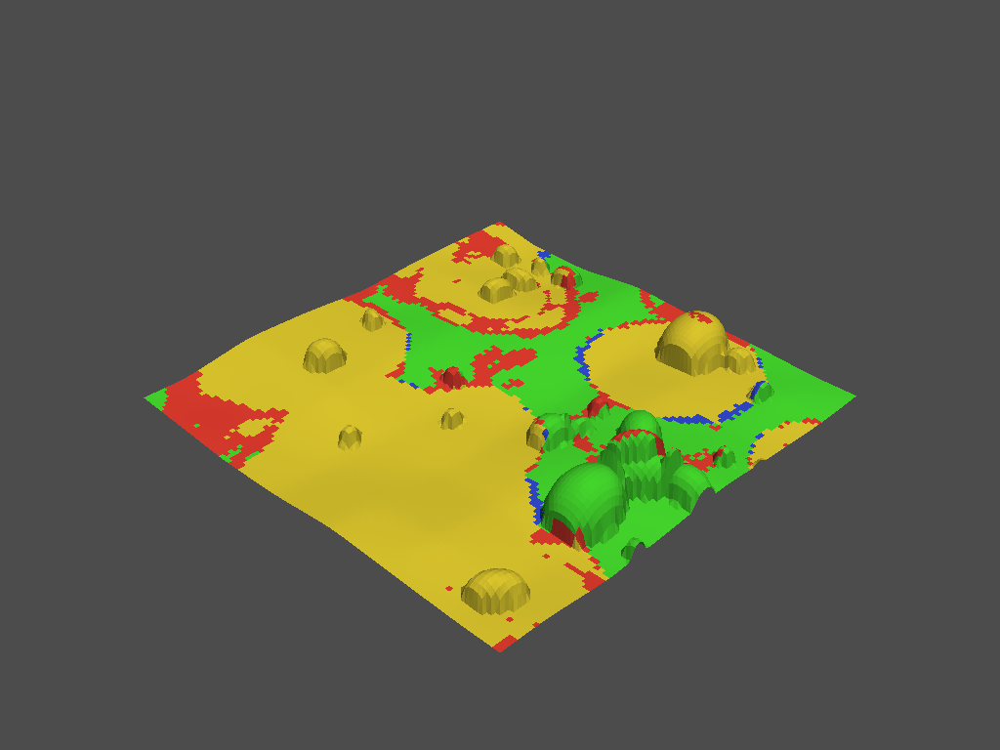

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


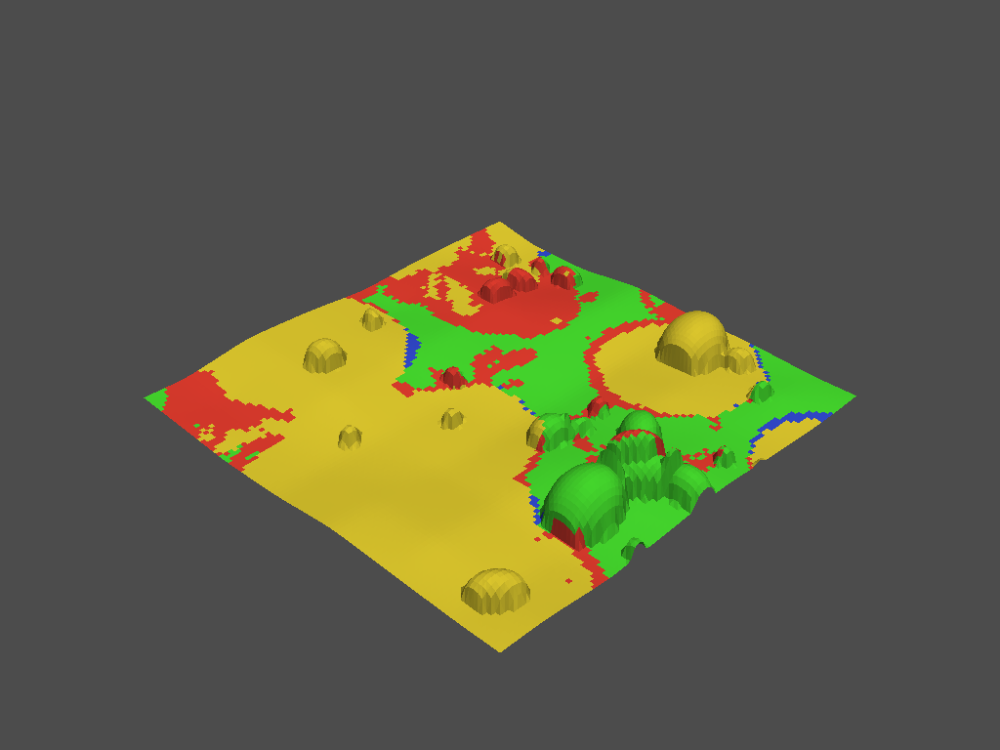

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


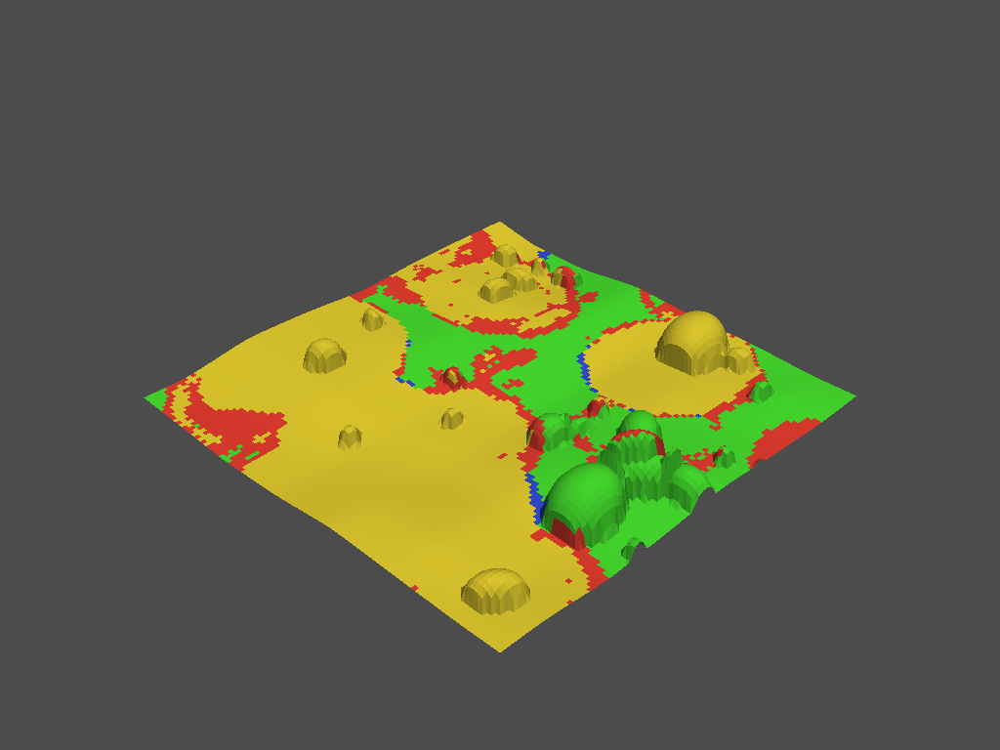

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


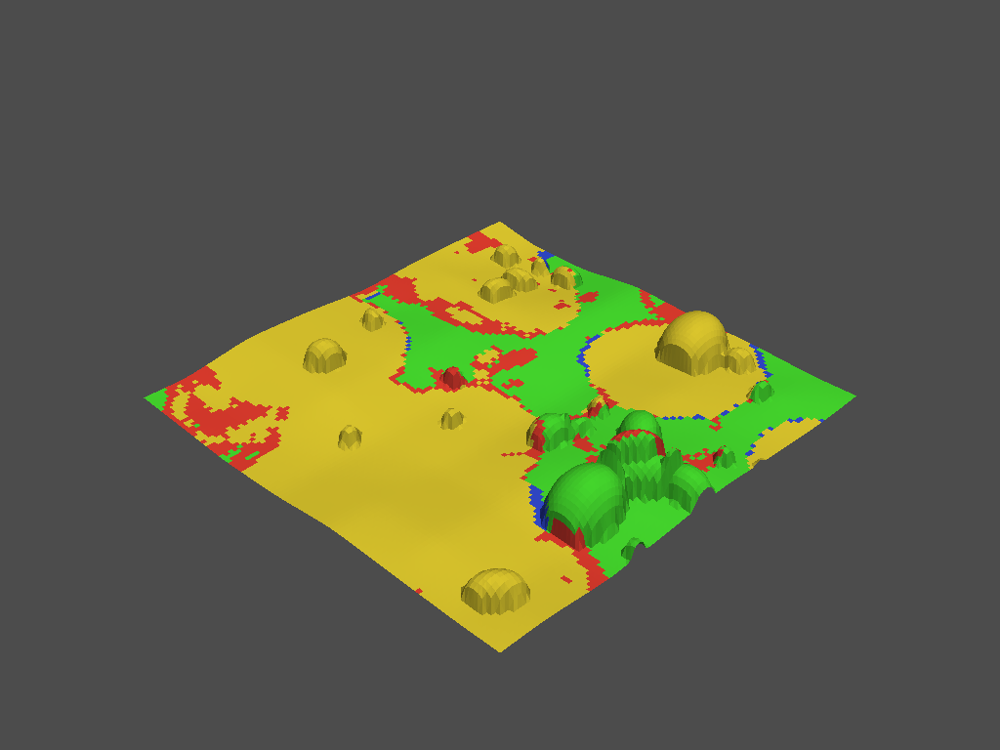

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


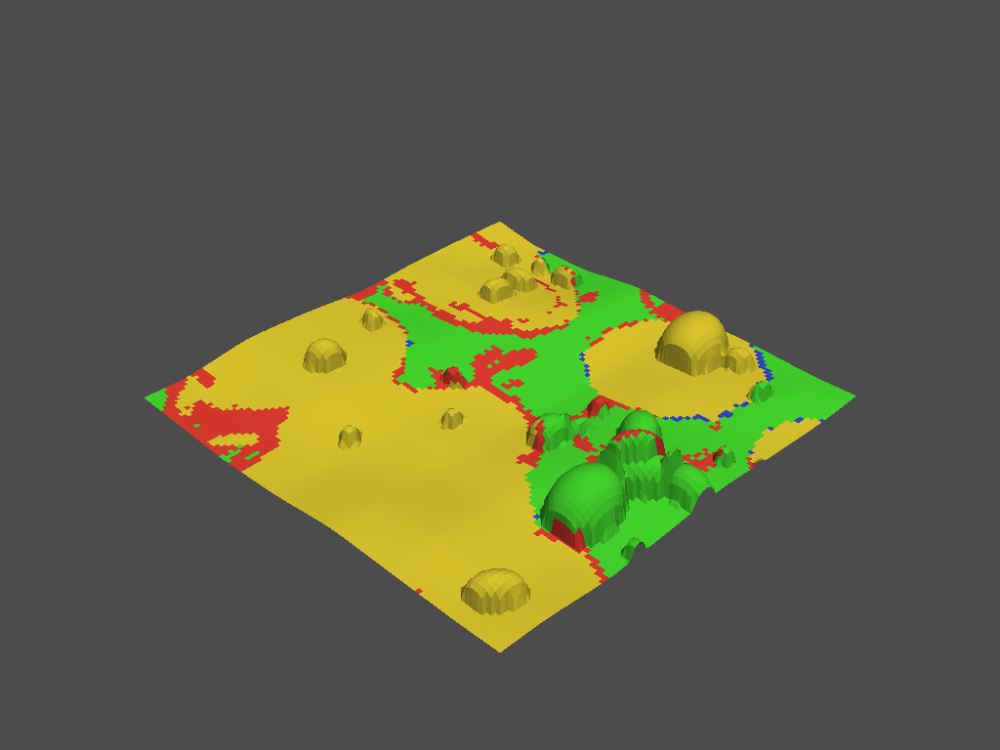

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


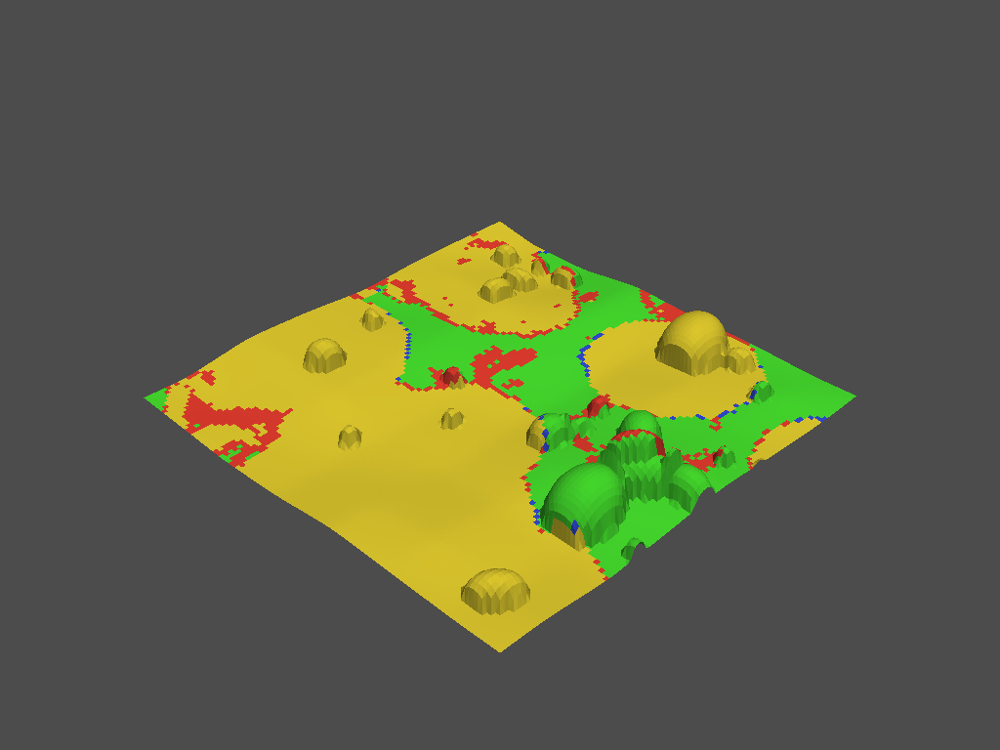

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


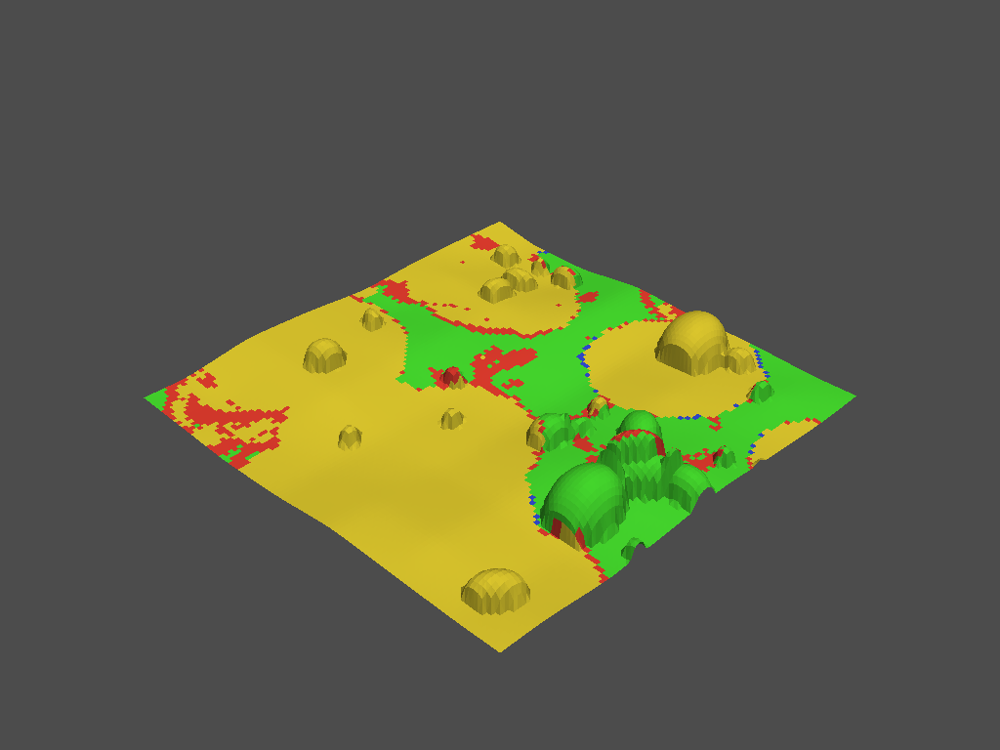

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


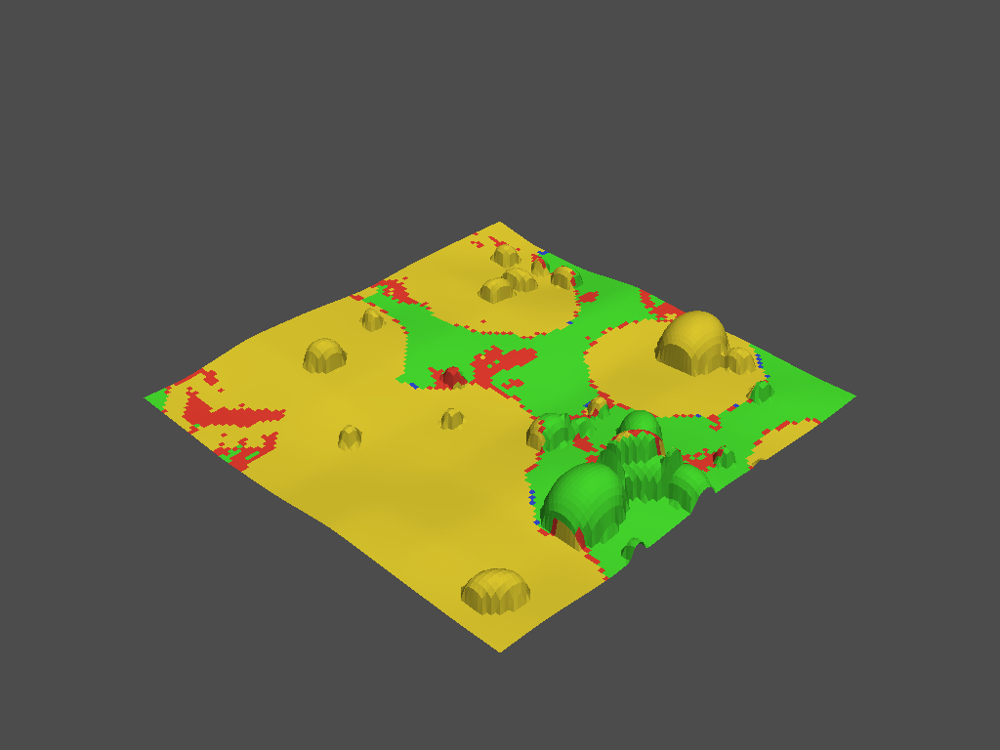

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


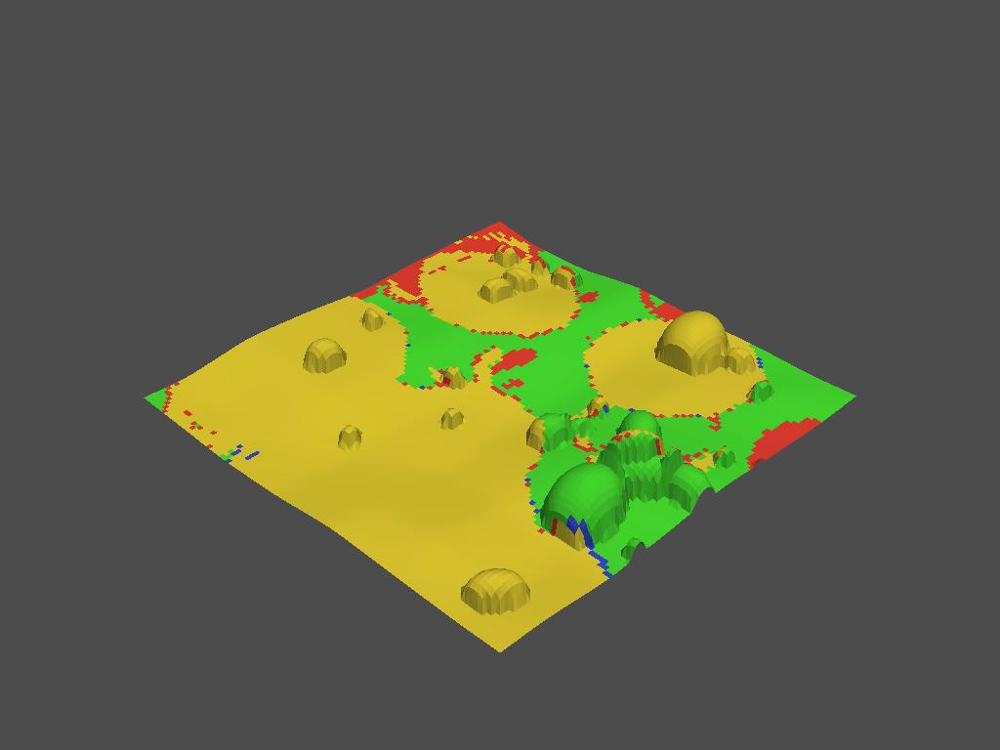

C:\Users\ktomita3\AppData\Local\Temp\ipykernel_26212\2991450551.py:88: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  images = [imageio.imread(file) for file in file_list]
c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


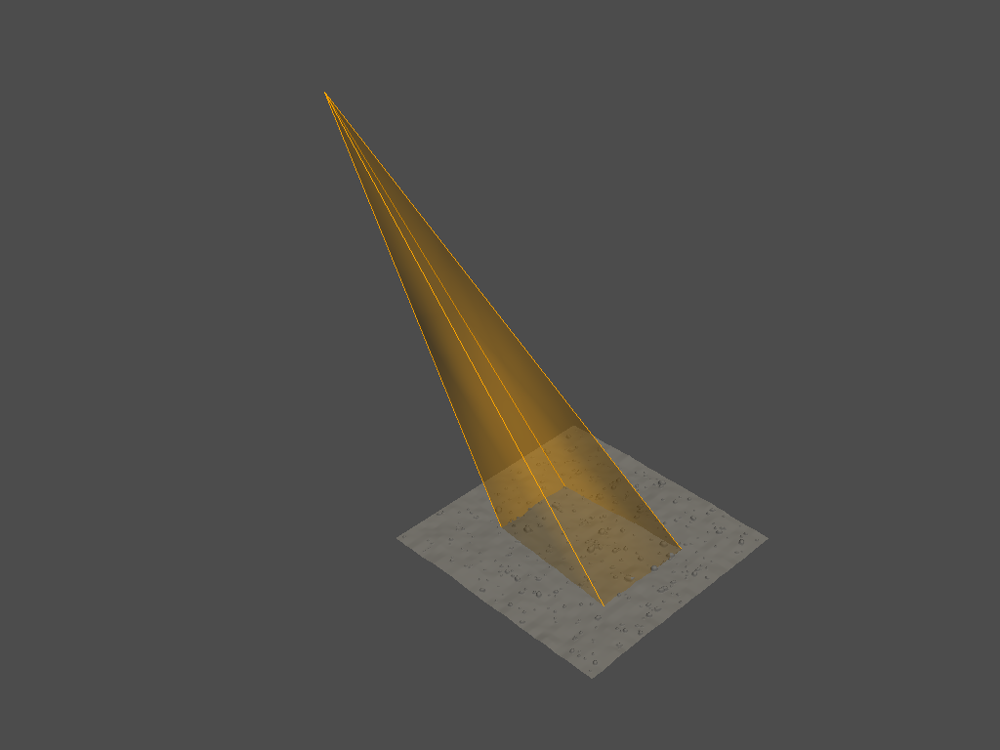

0


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


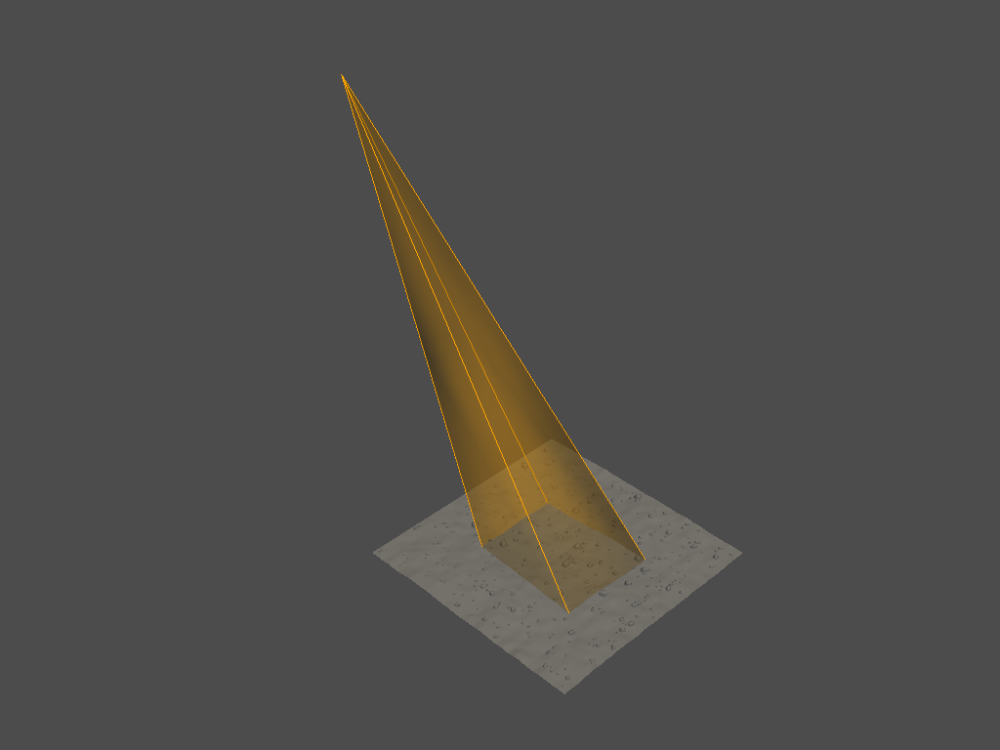

1


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


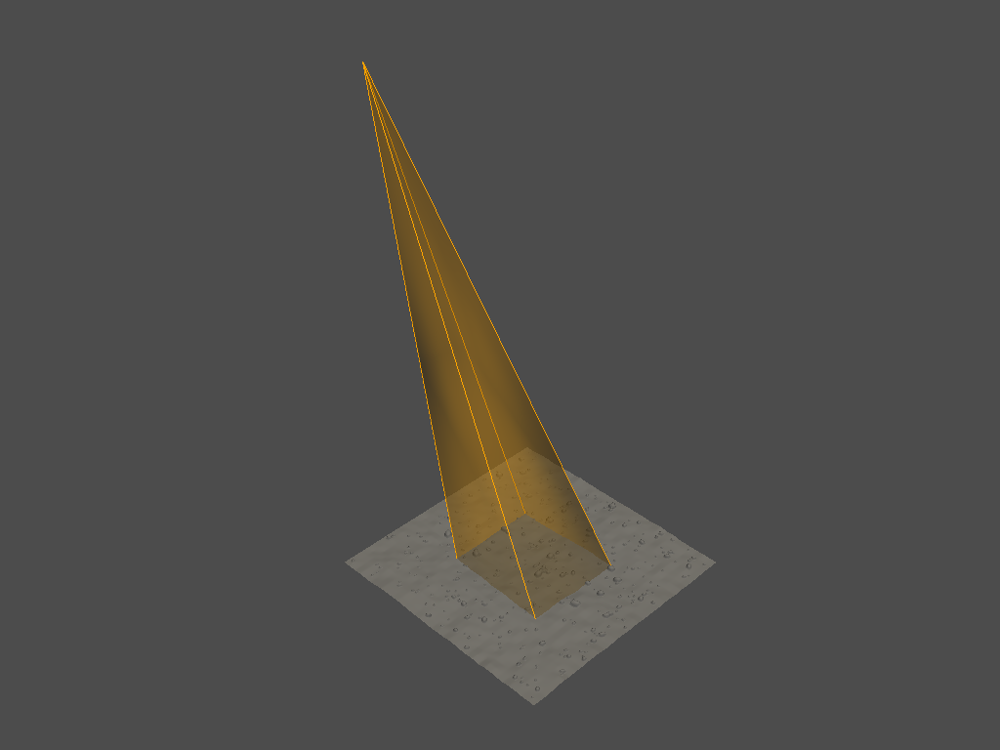

2


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


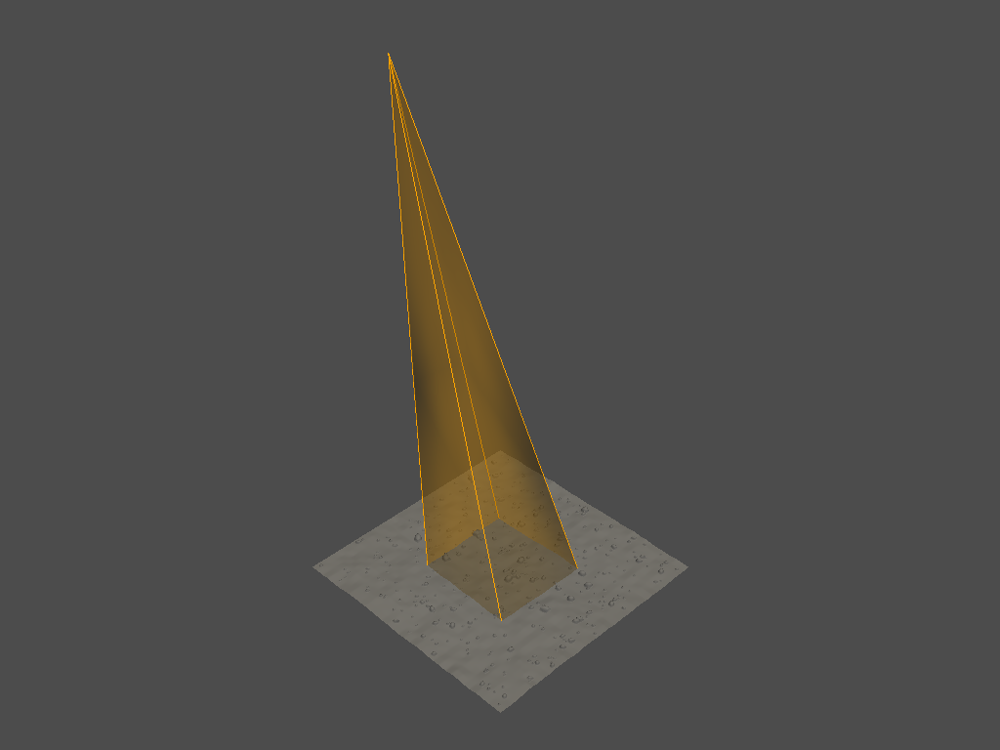

3


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


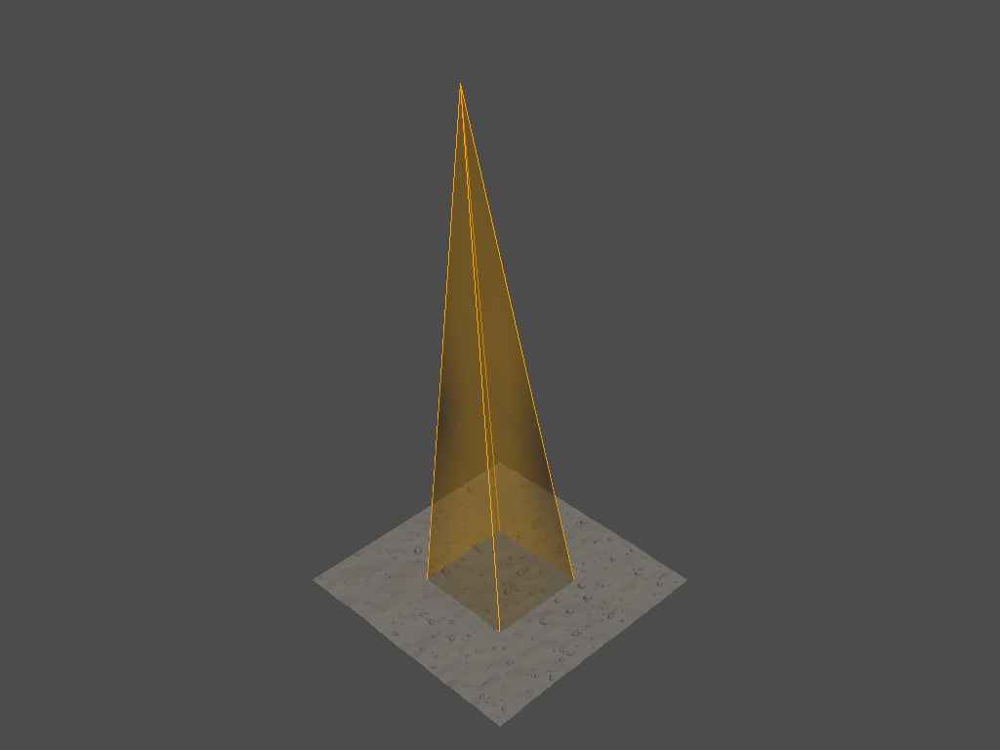

4


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


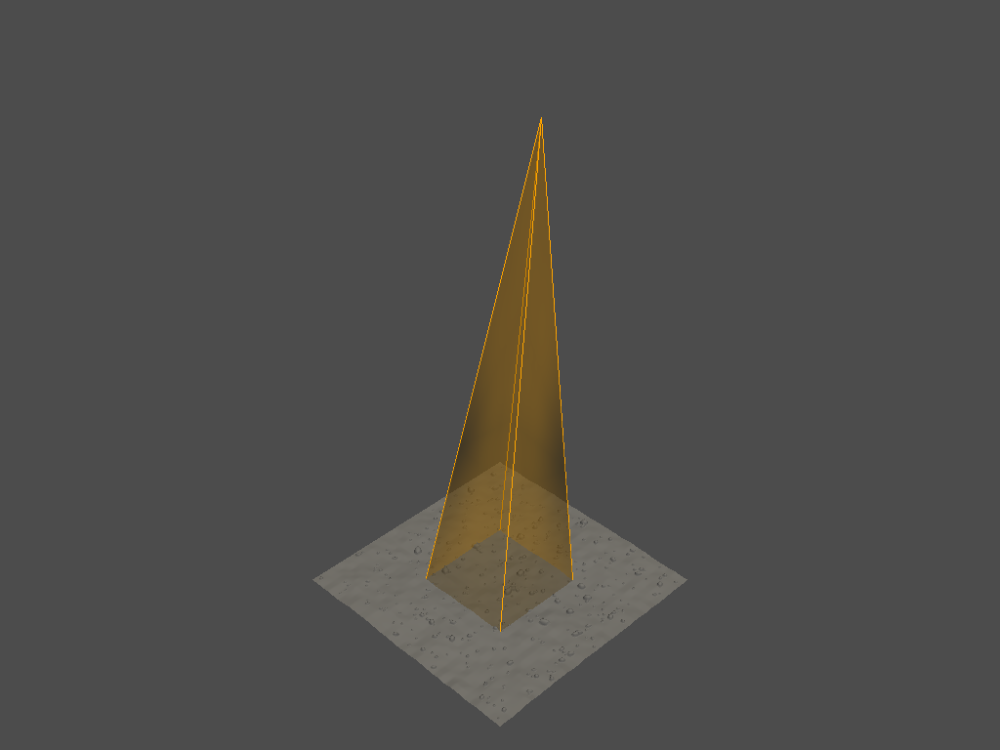

5


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


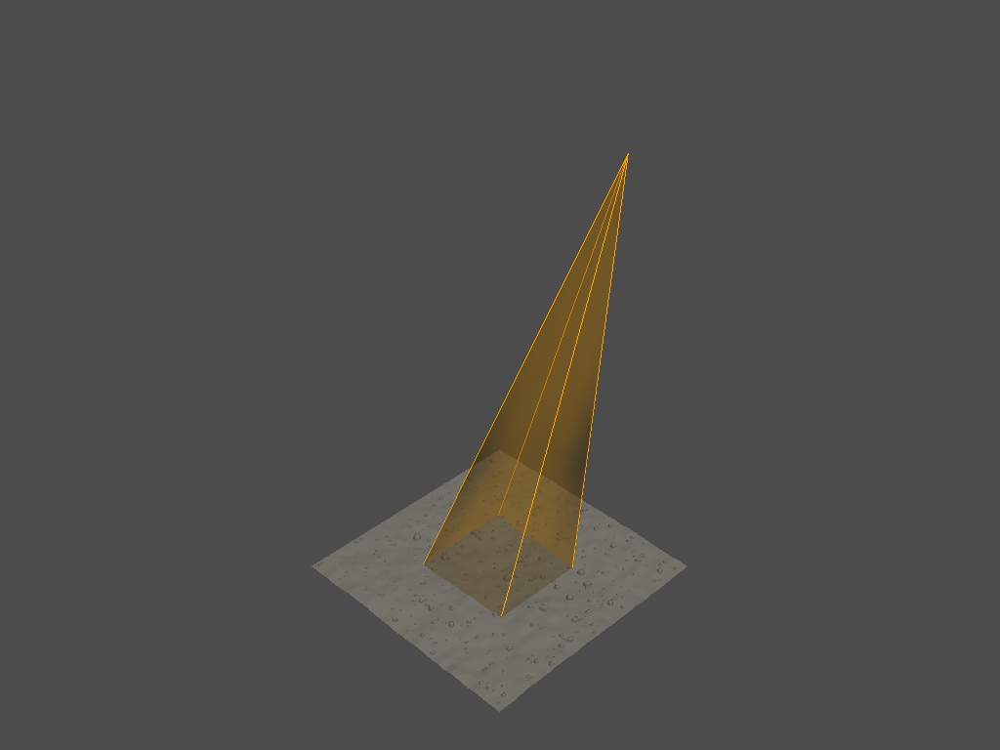

6


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


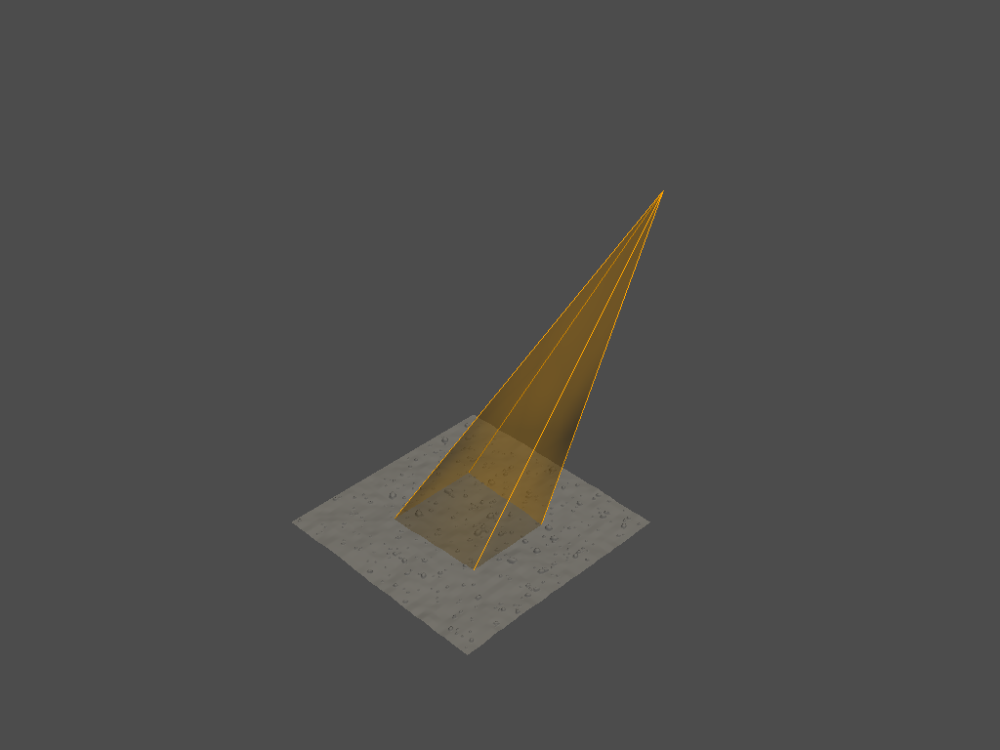

7


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


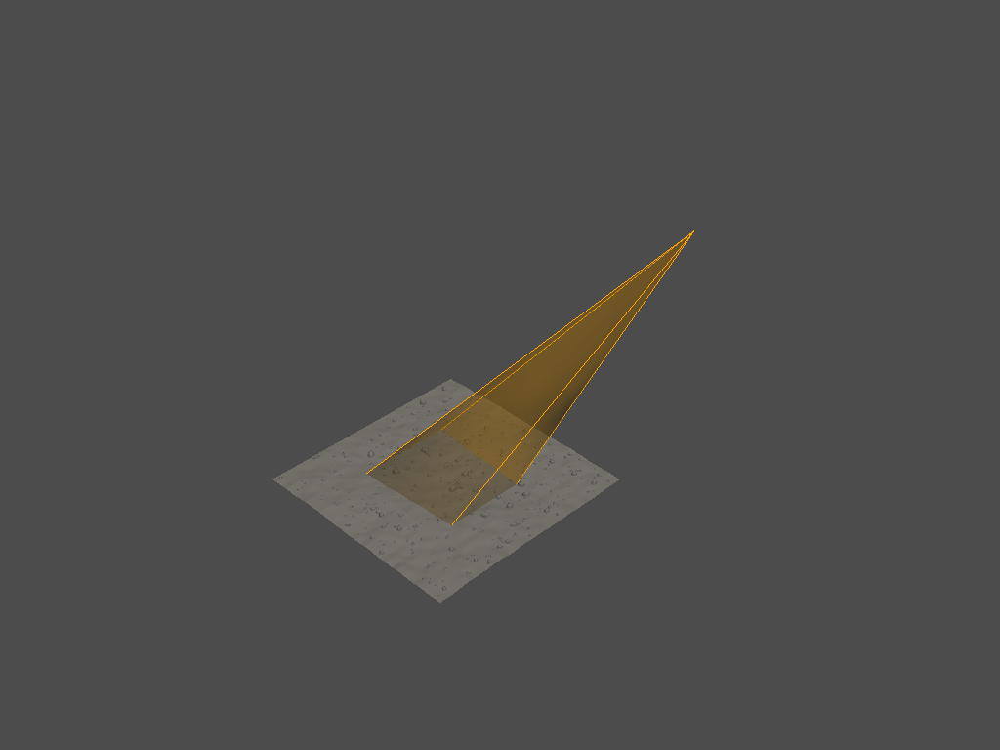

8


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


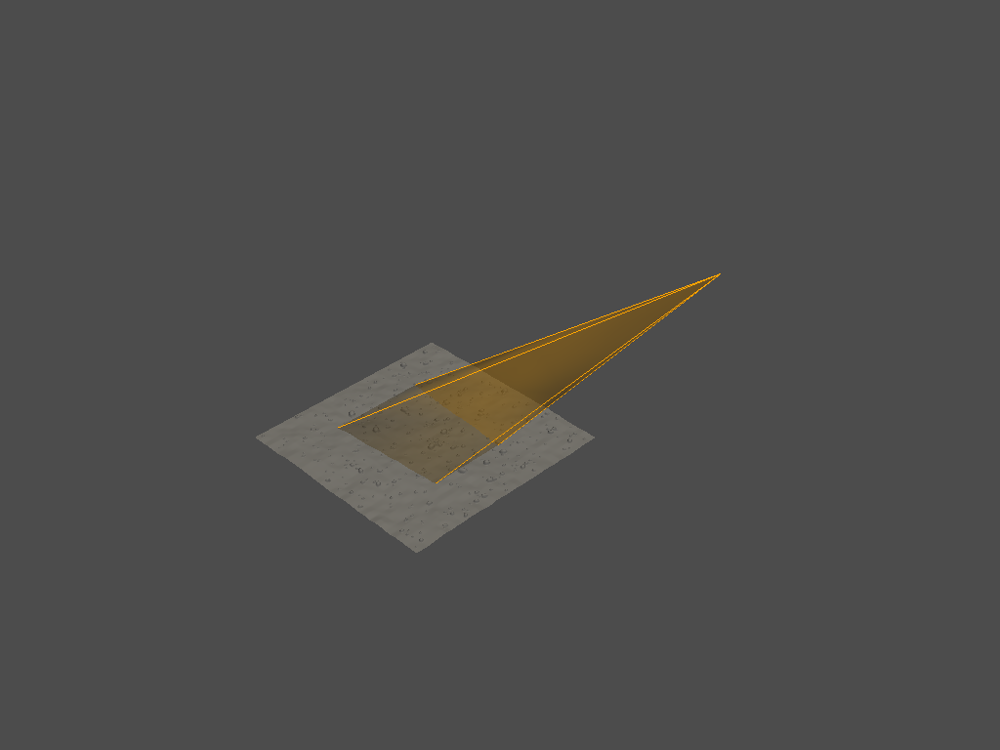

9
(4096, 3)
(704, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


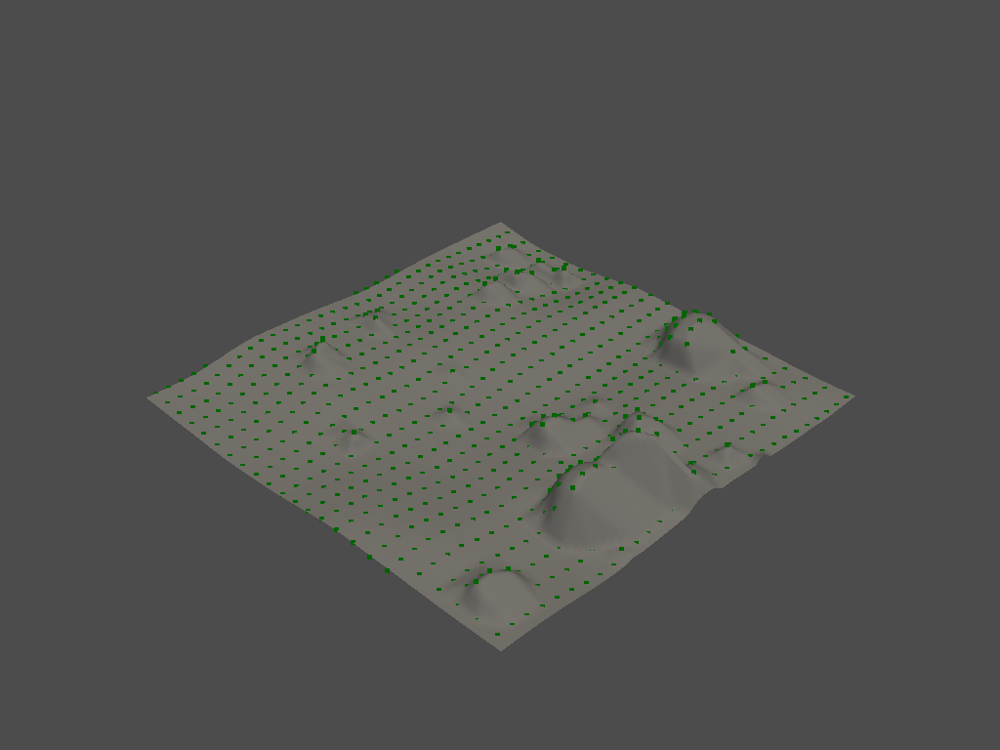

(4096, 3)
(821, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


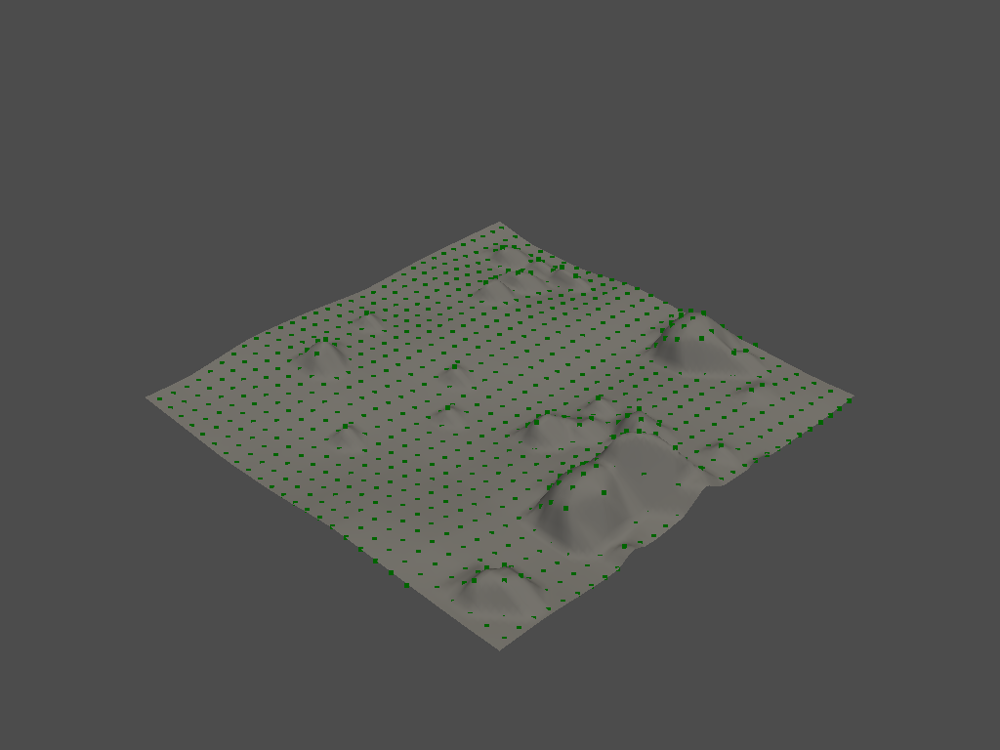

(4096, 3)
(915, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


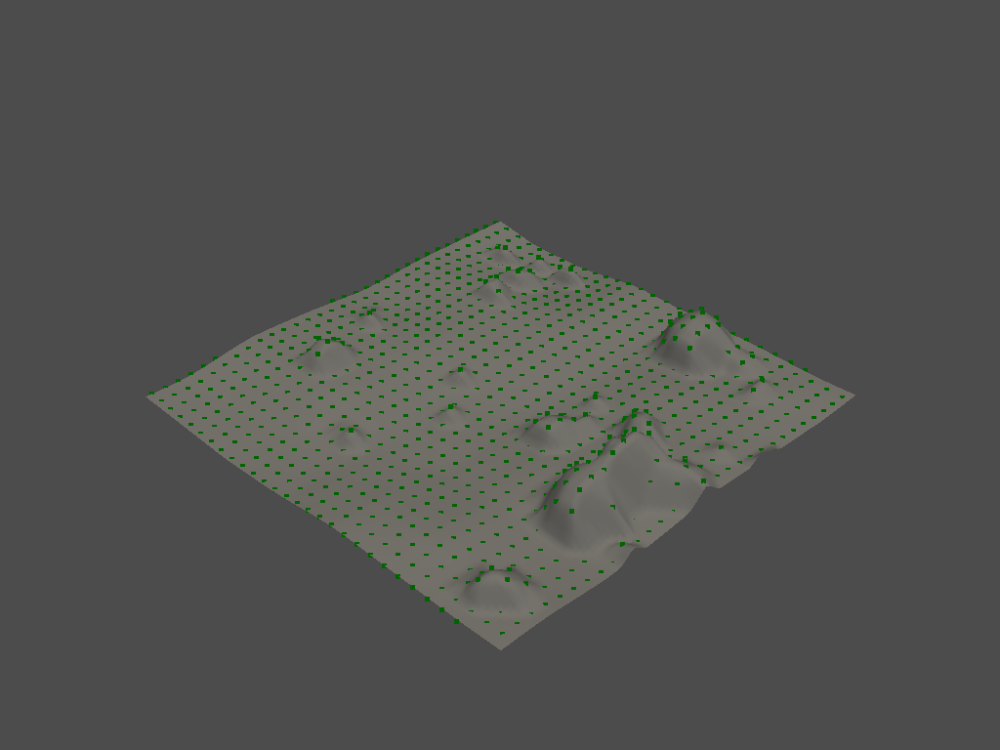

(4096, 3)
(961, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


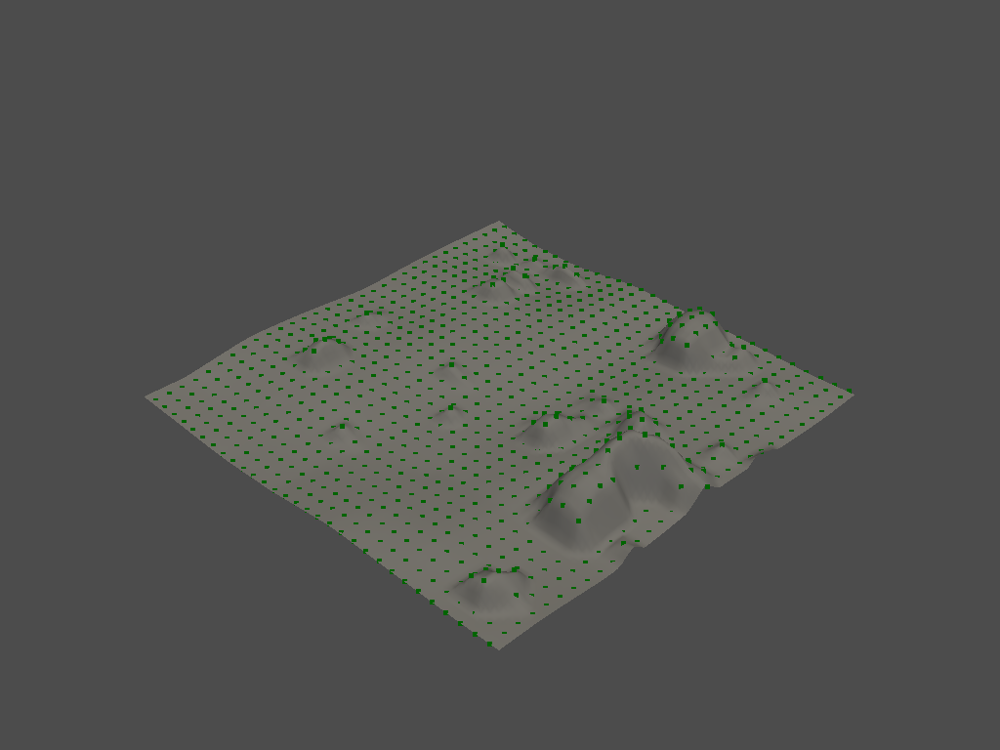

(4096, 3)
(1024, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


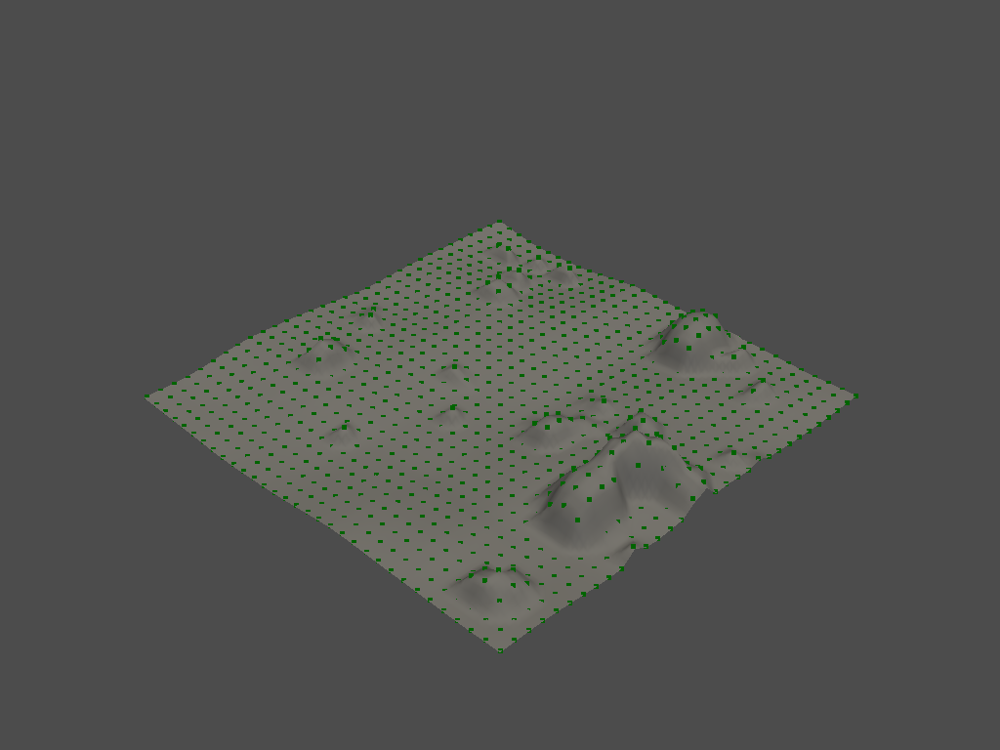

(4096, 3)
(1024, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


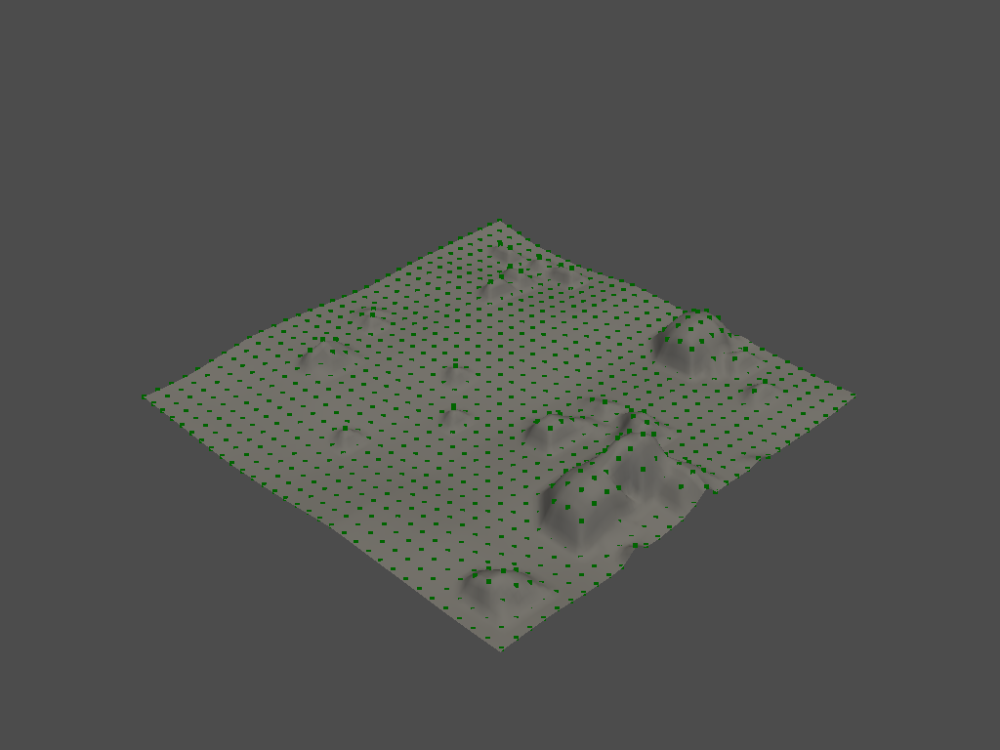

(4096, 3)
(960, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


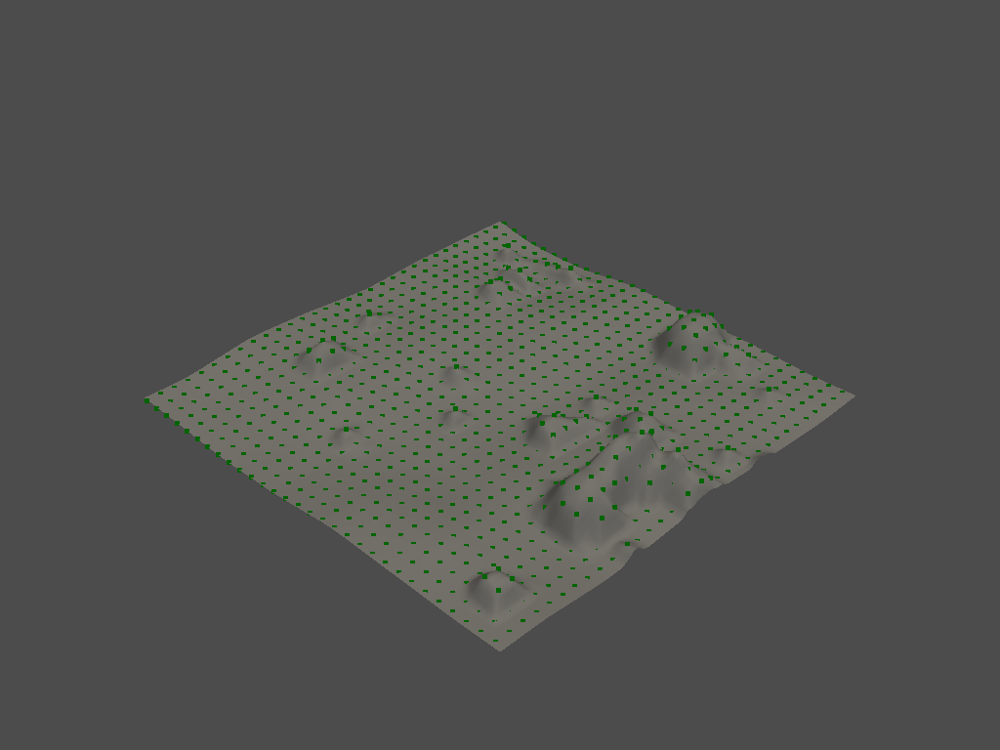

(4096, 3)
(898, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


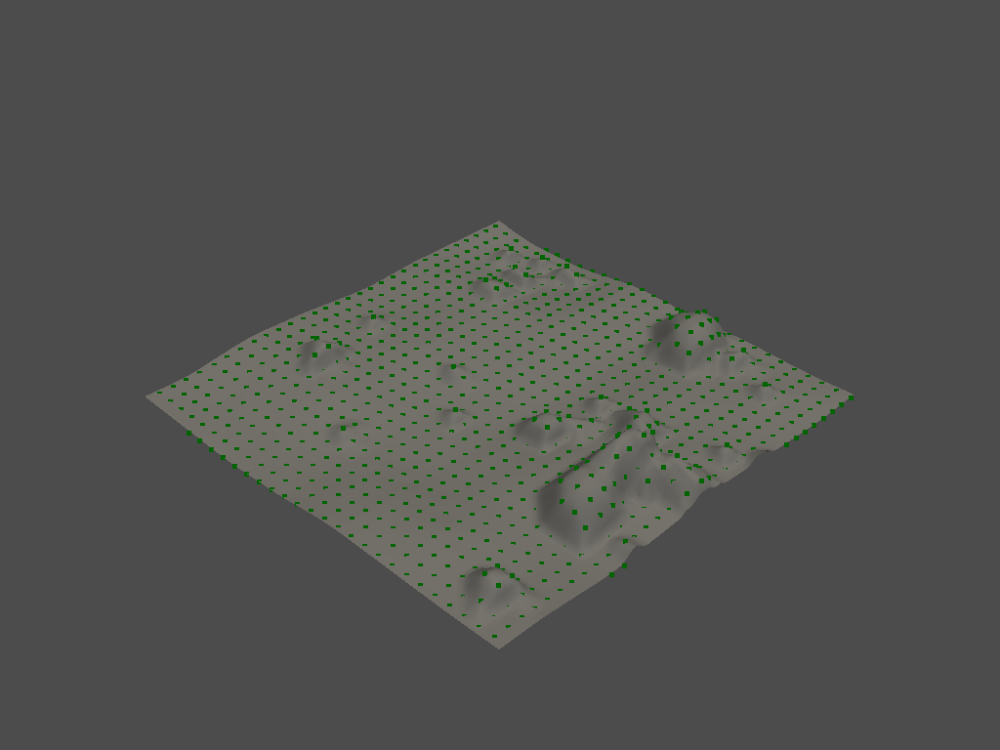

(4096, 3)
(815, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


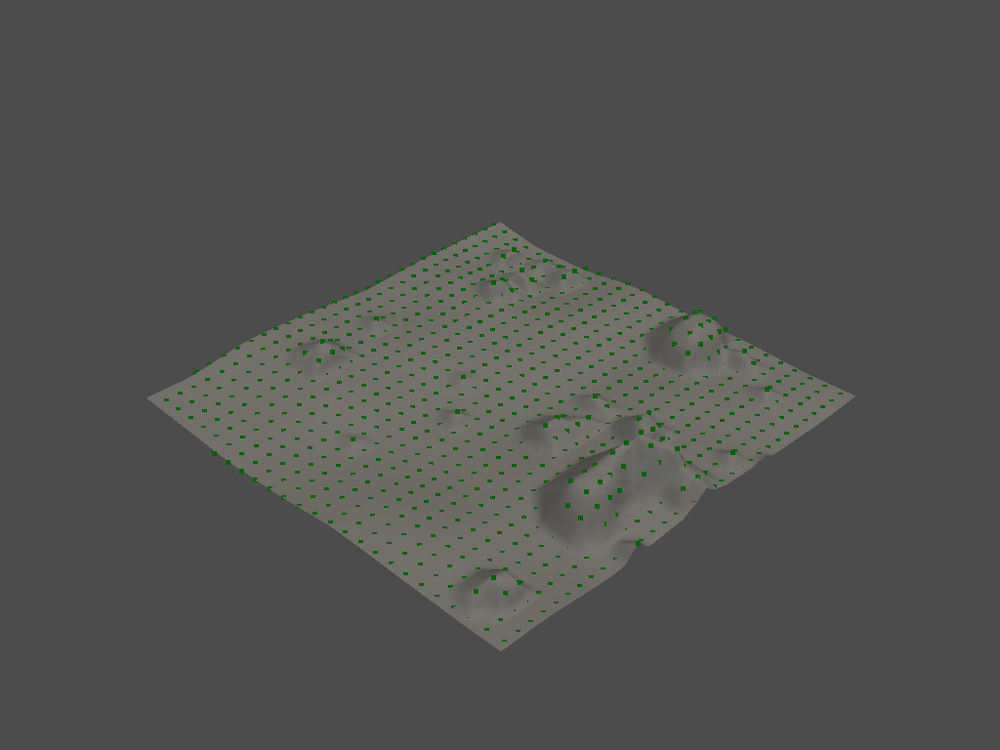

(4095, 3)
(695, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


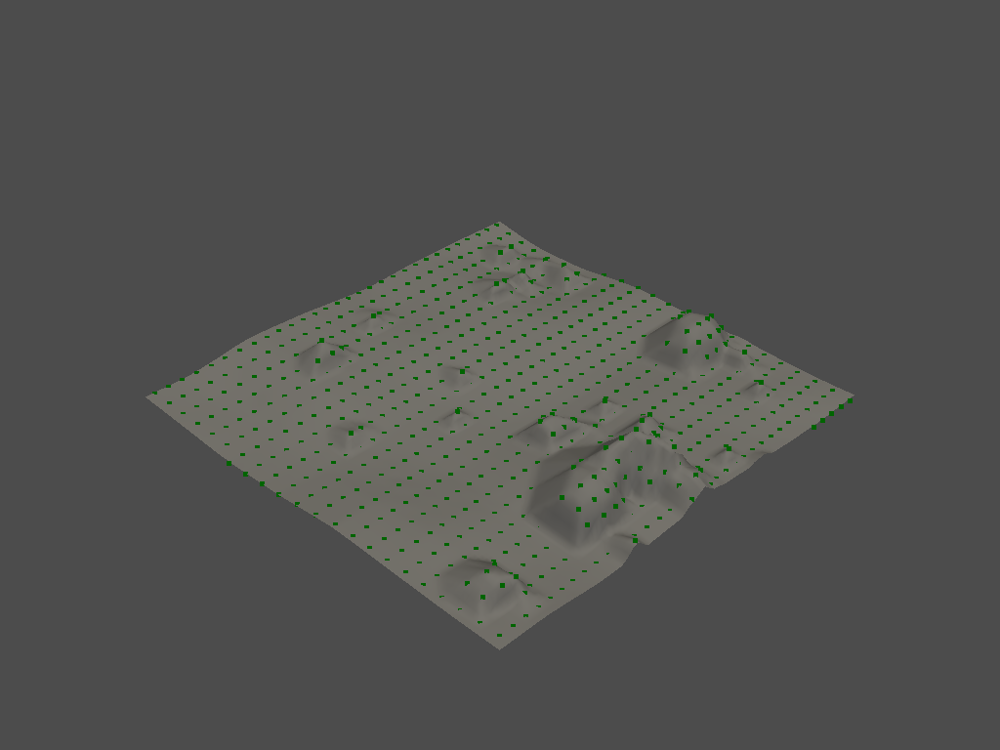

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


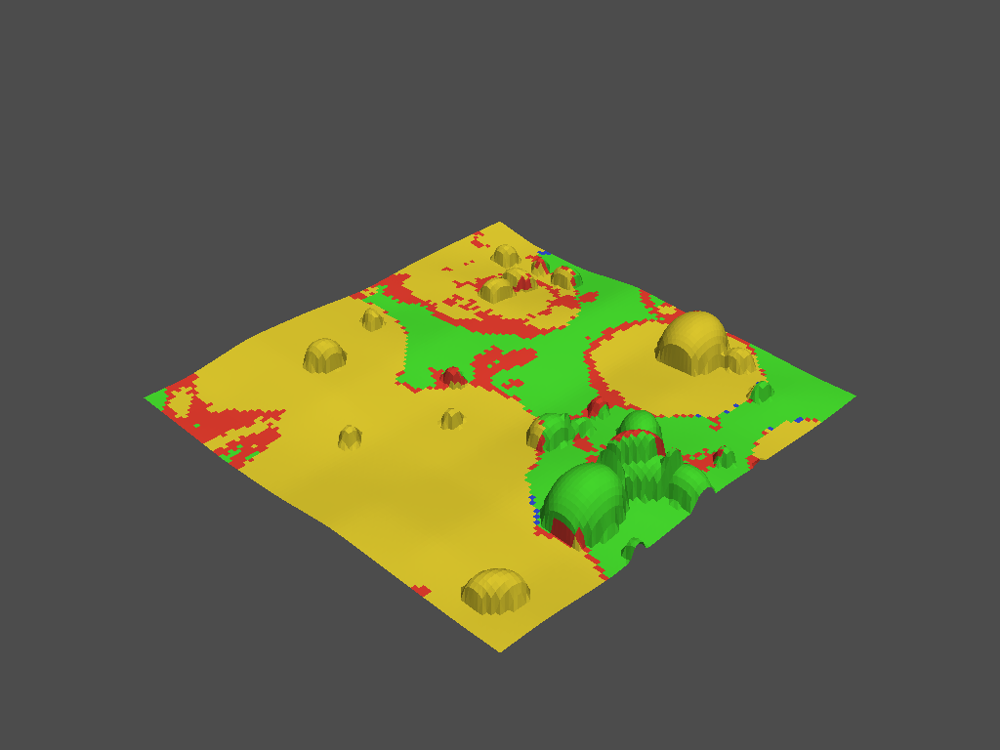

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


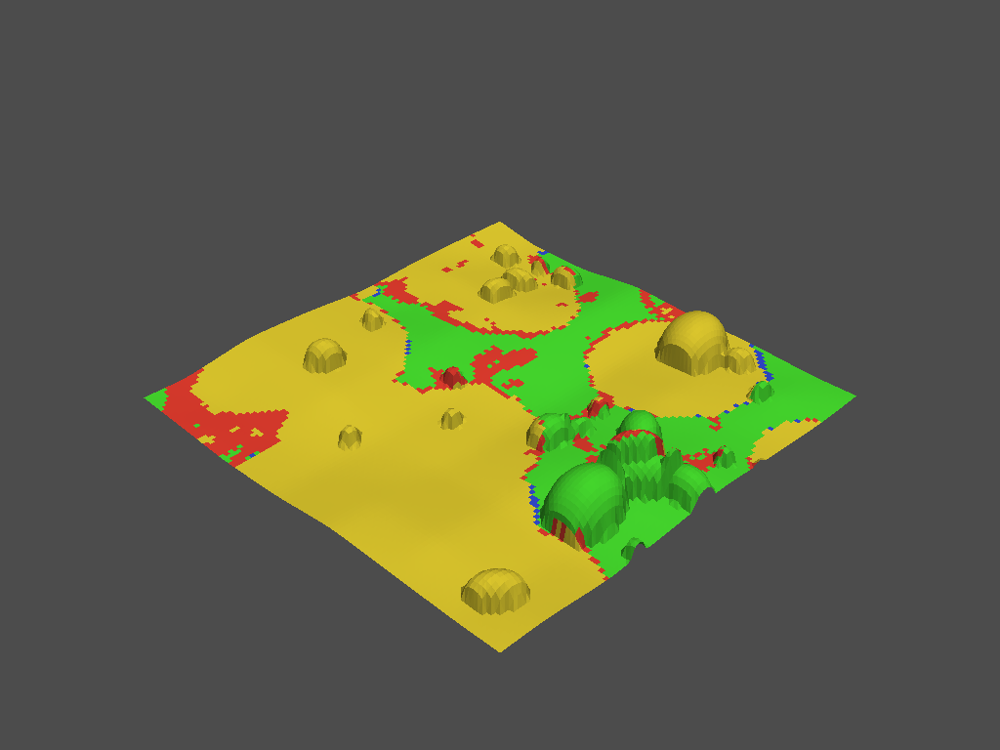

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


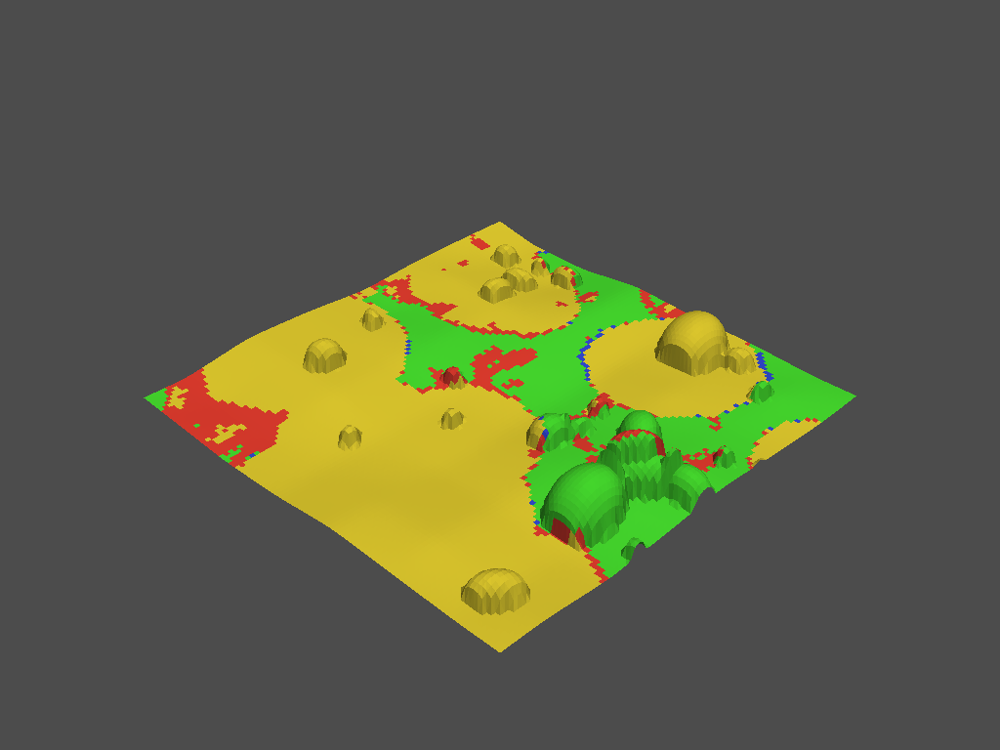

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


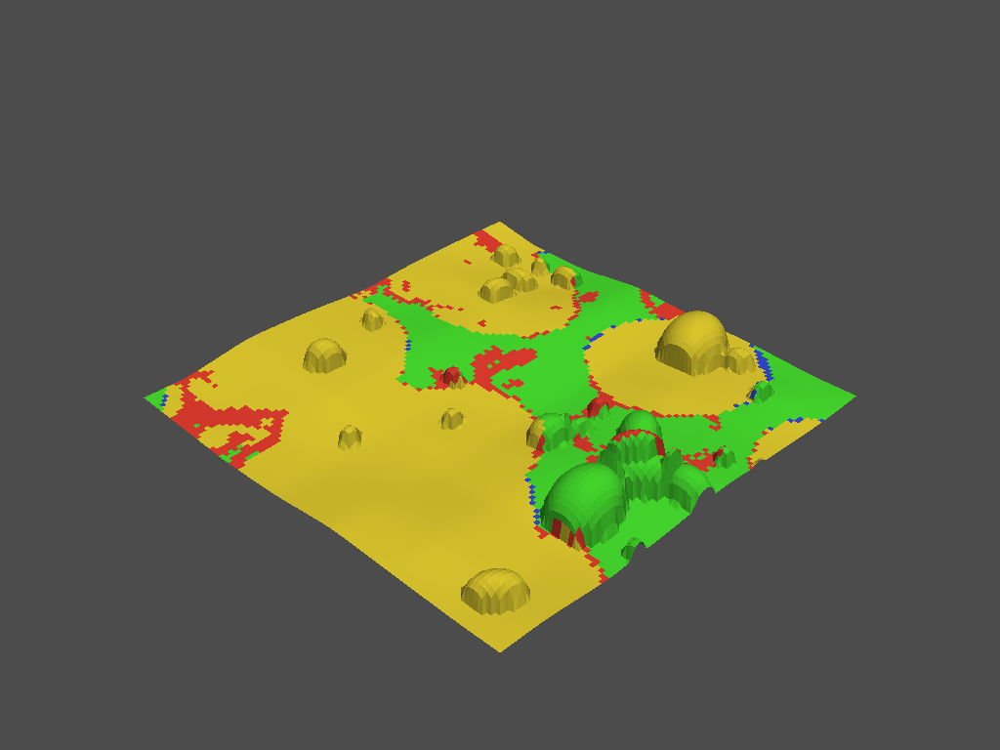

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


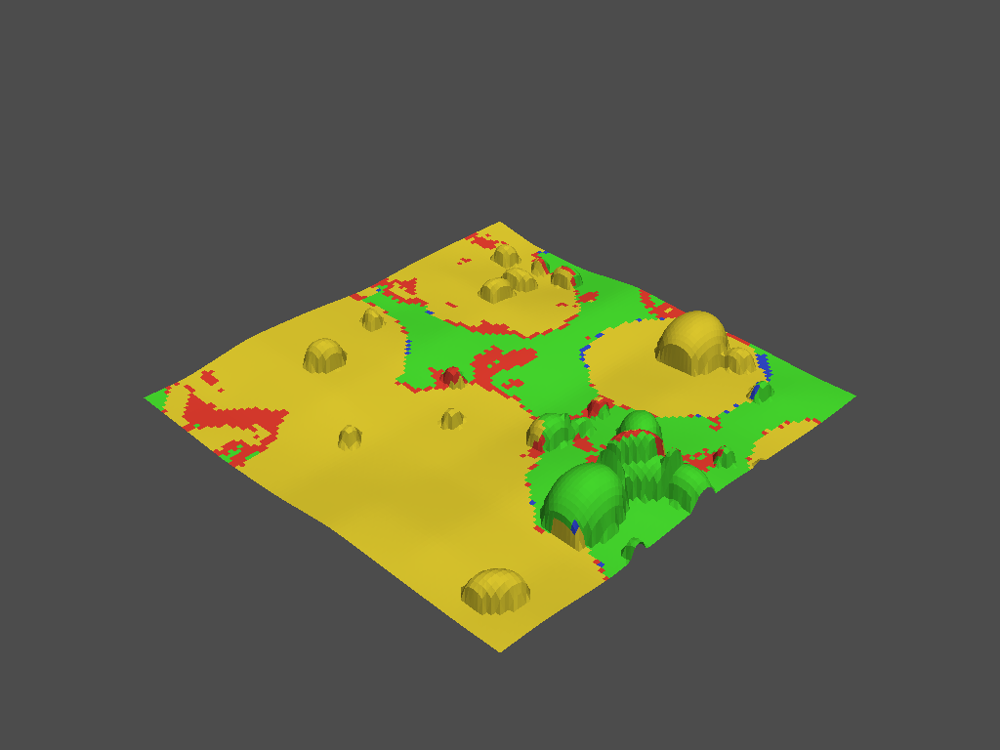

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


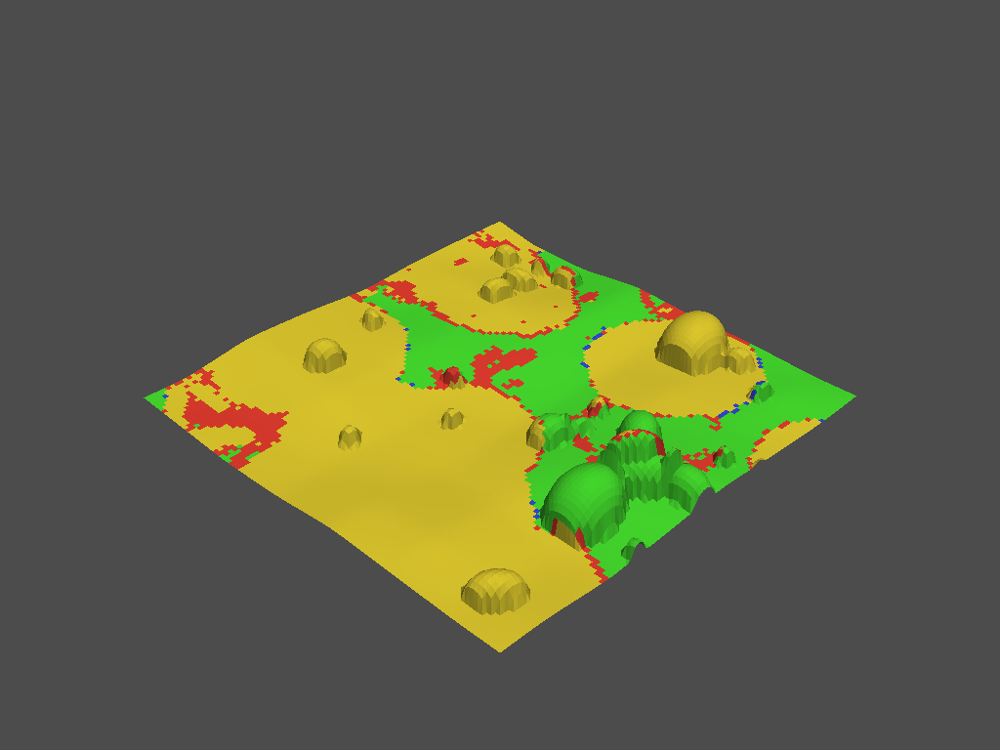

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


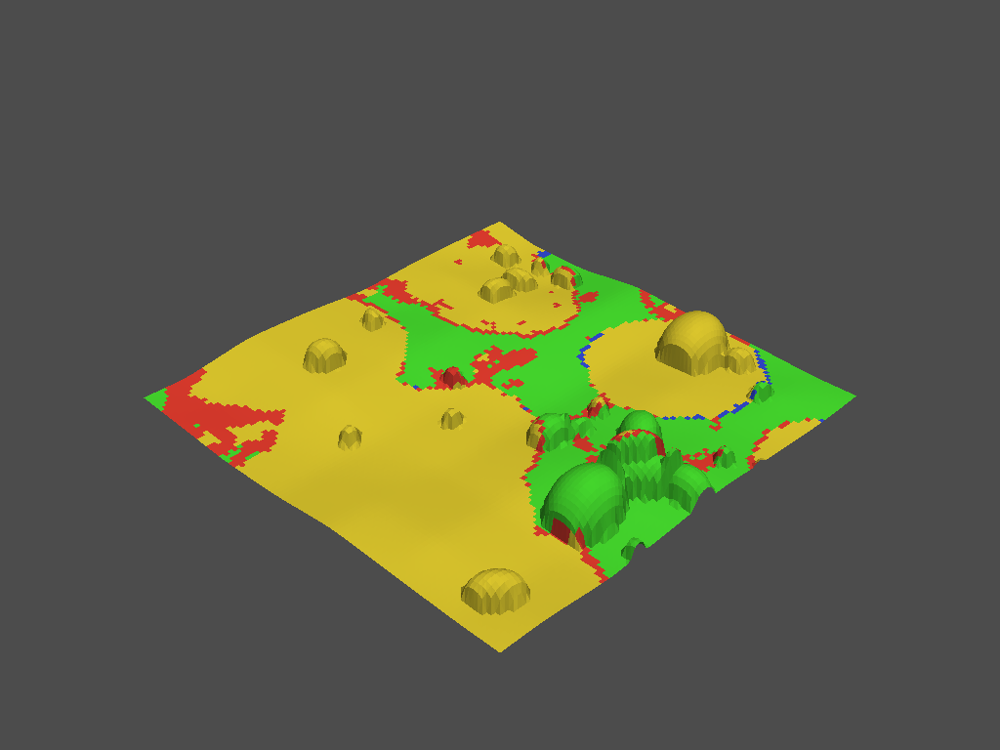

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


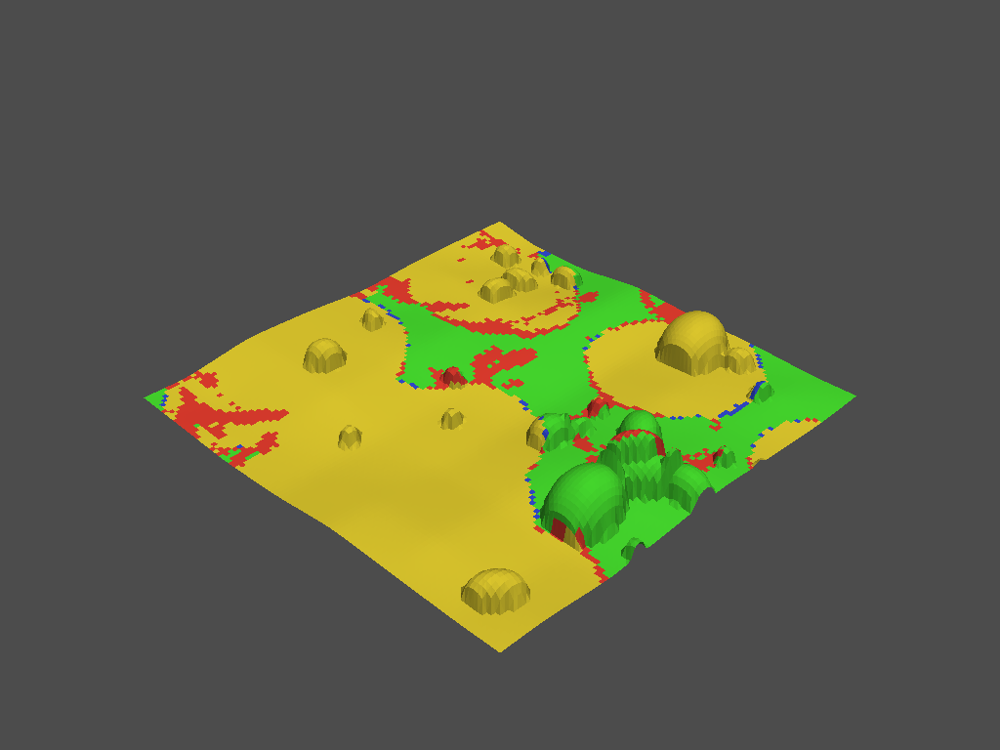

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


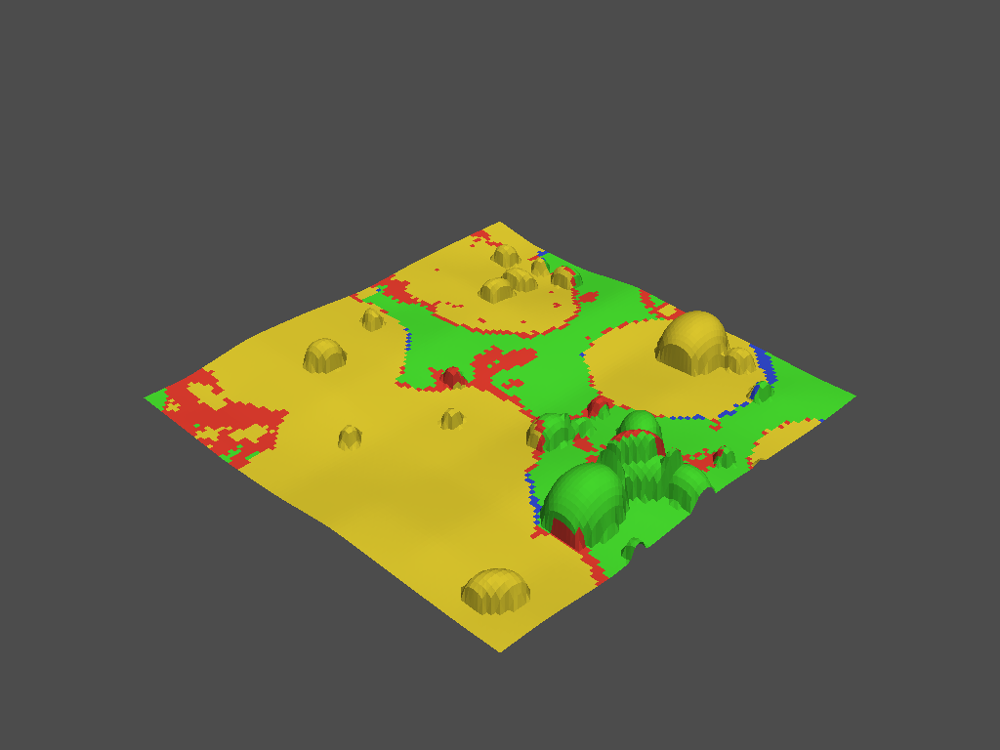

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


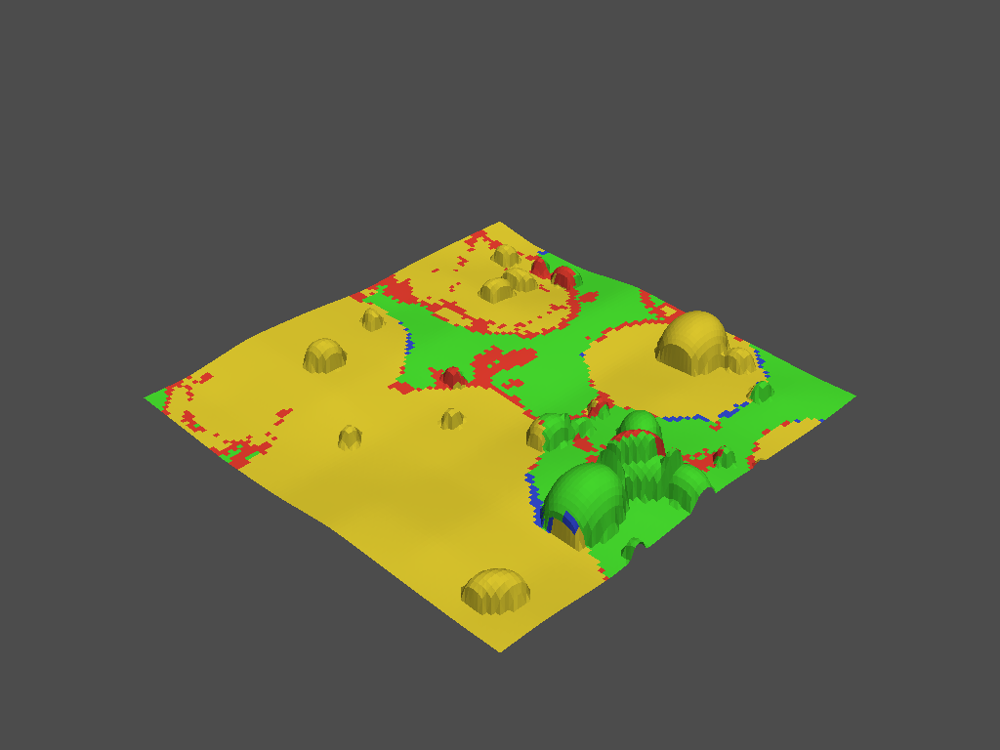

C:\Users\ktomita3\AppData\Local\Temp\ipykernel_26212\2991450551.py:88: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  images = [imageio.imread(file) for file in file_list]
c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


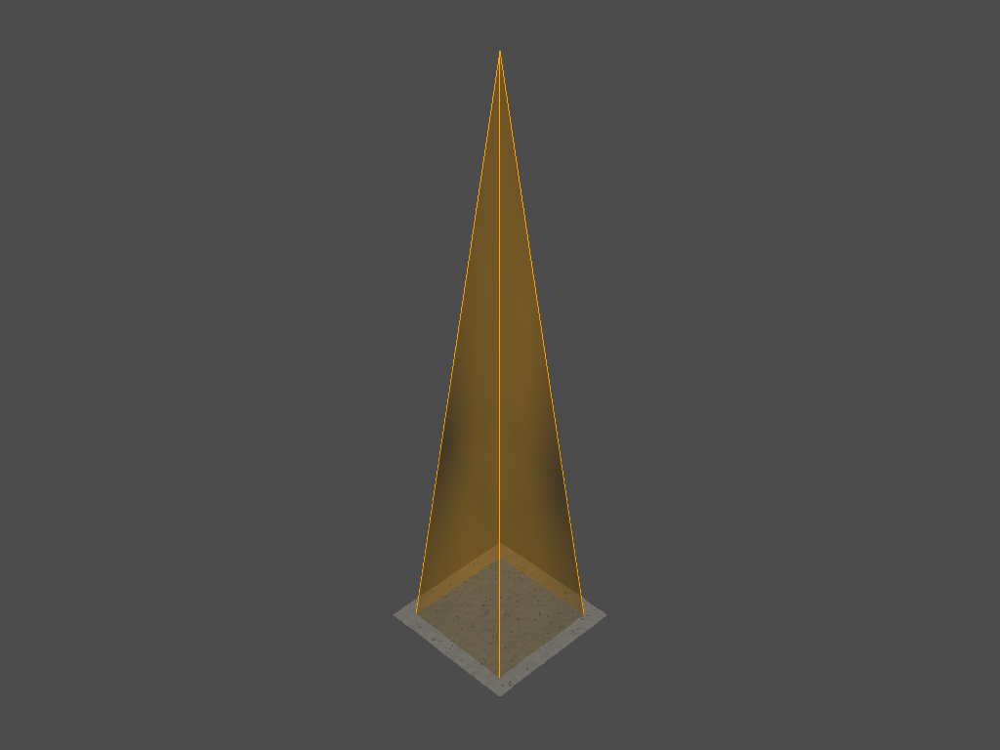

0


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


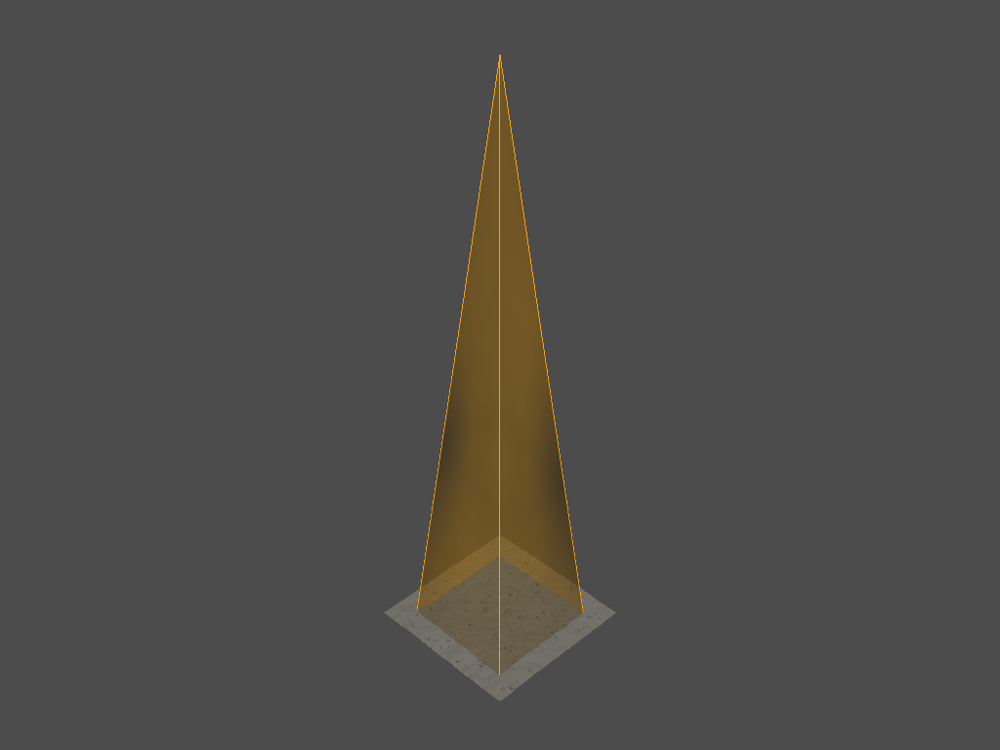

1


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


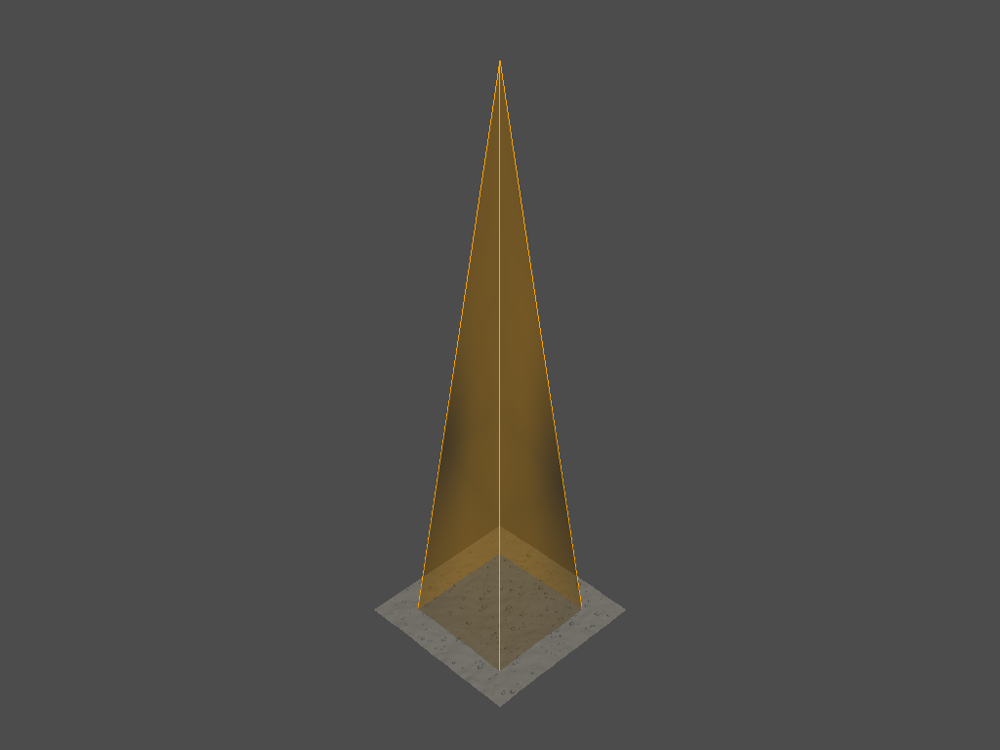

2


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


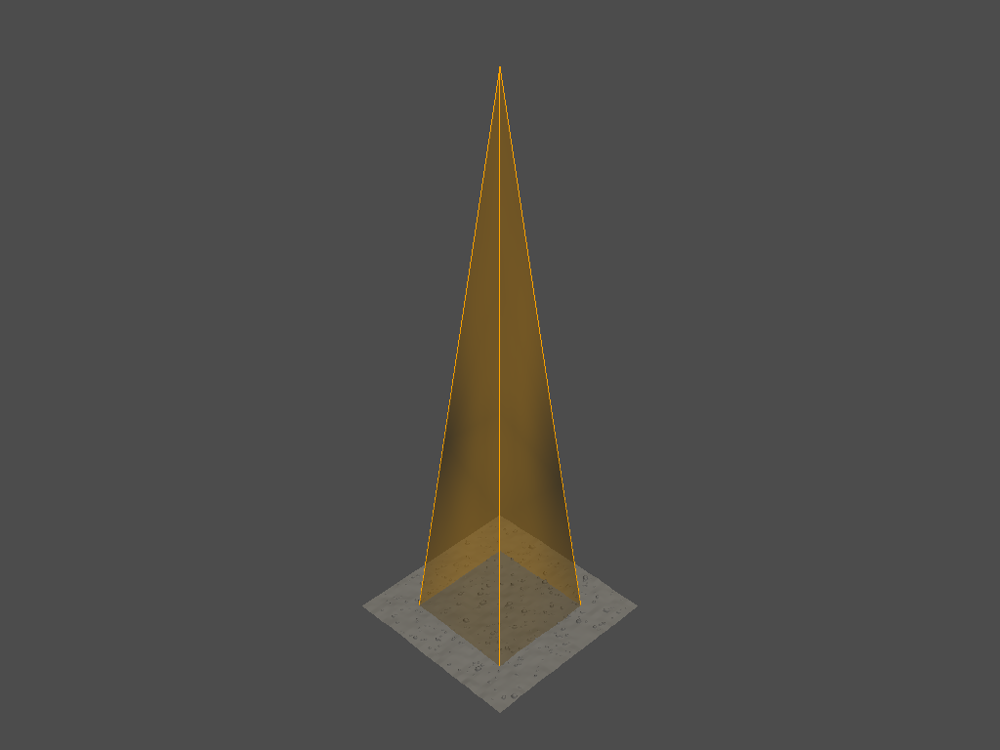

3


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


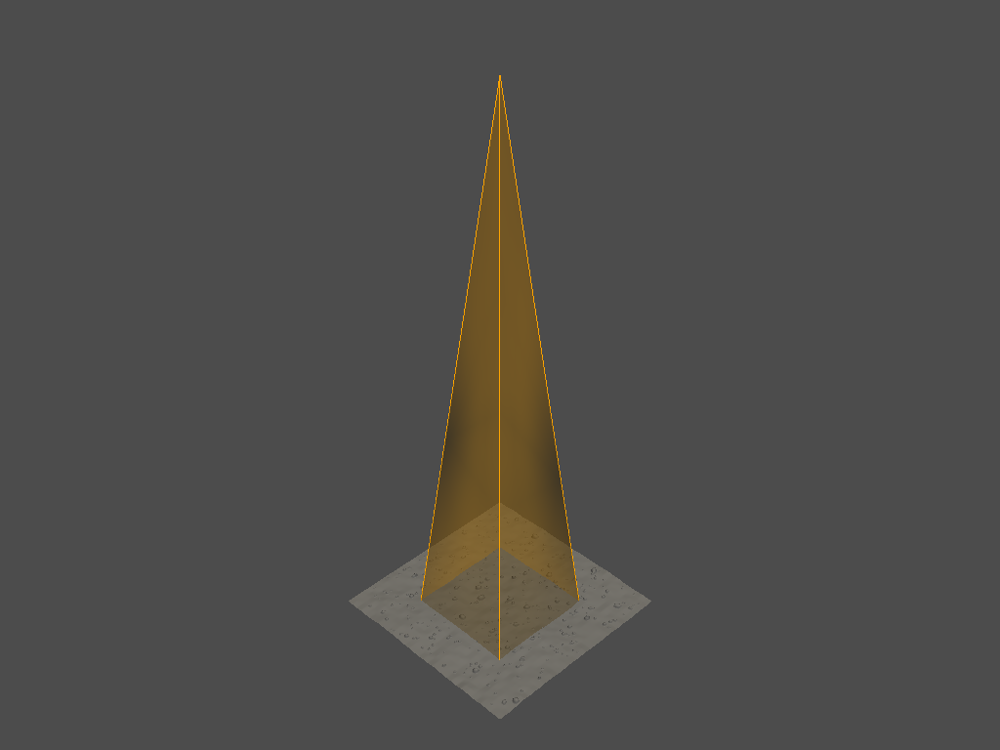

4


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


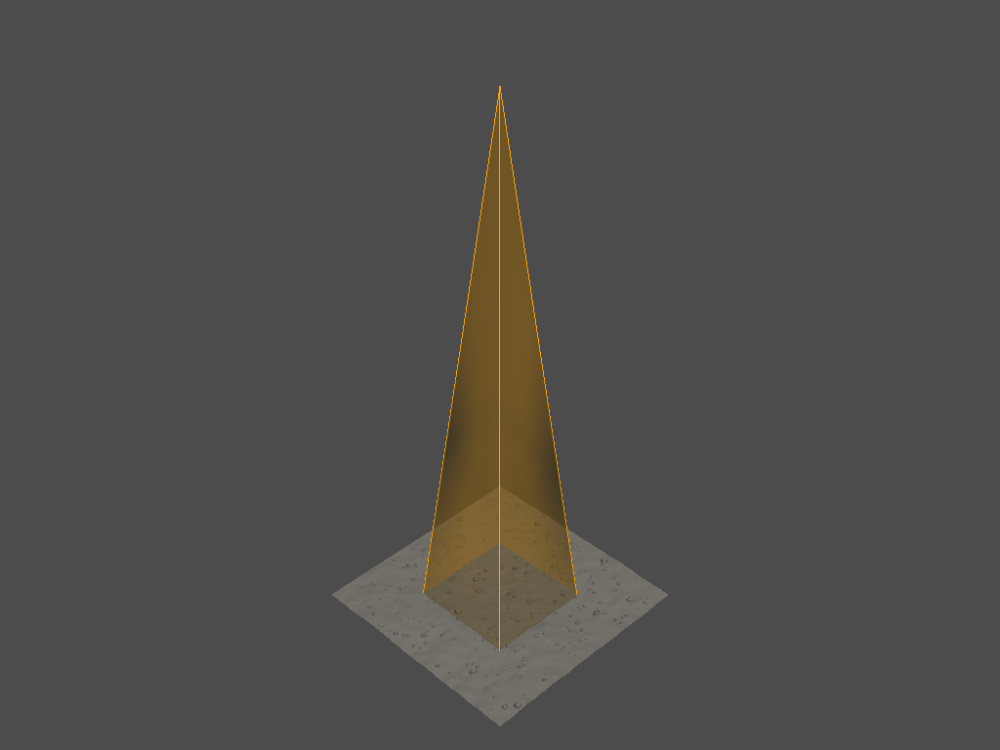

5


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


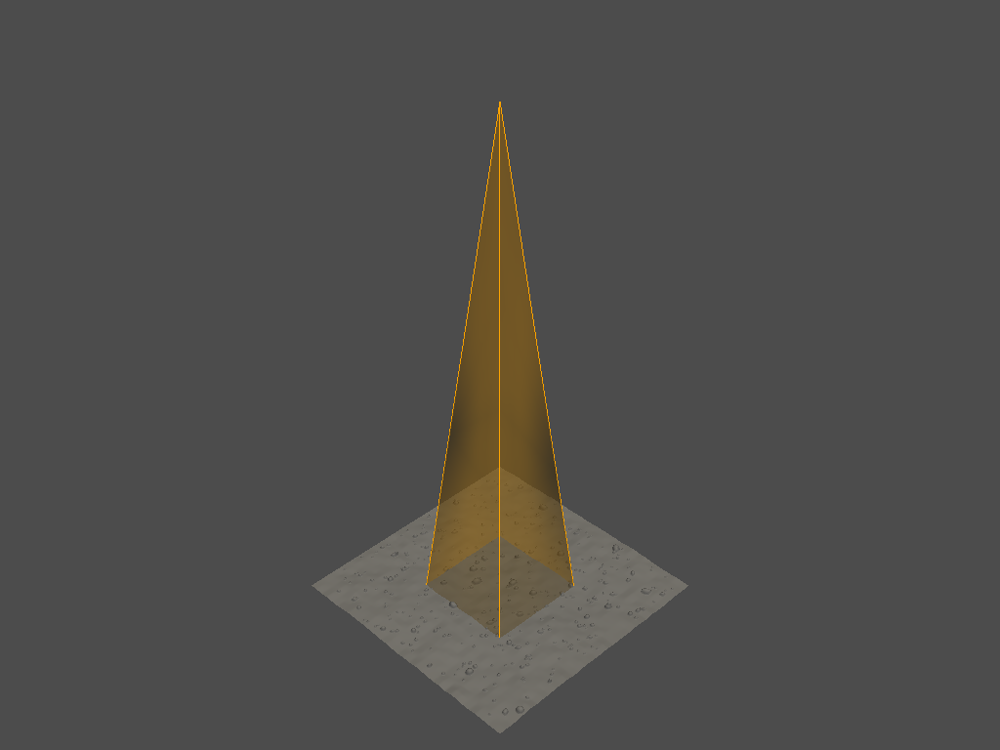

6


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


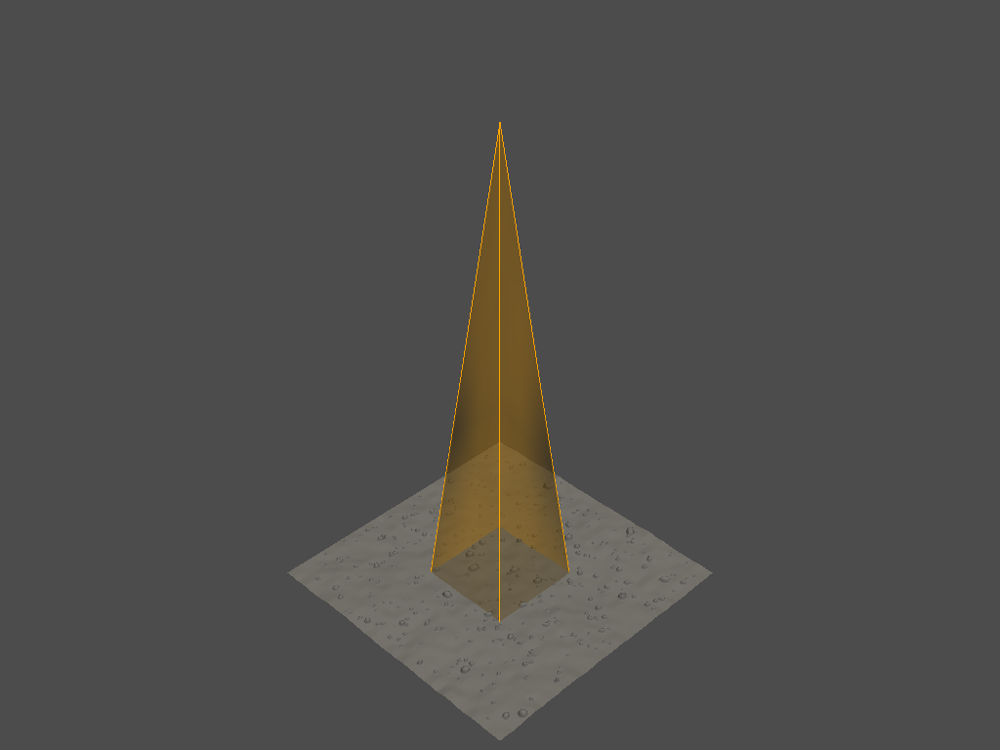

7


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


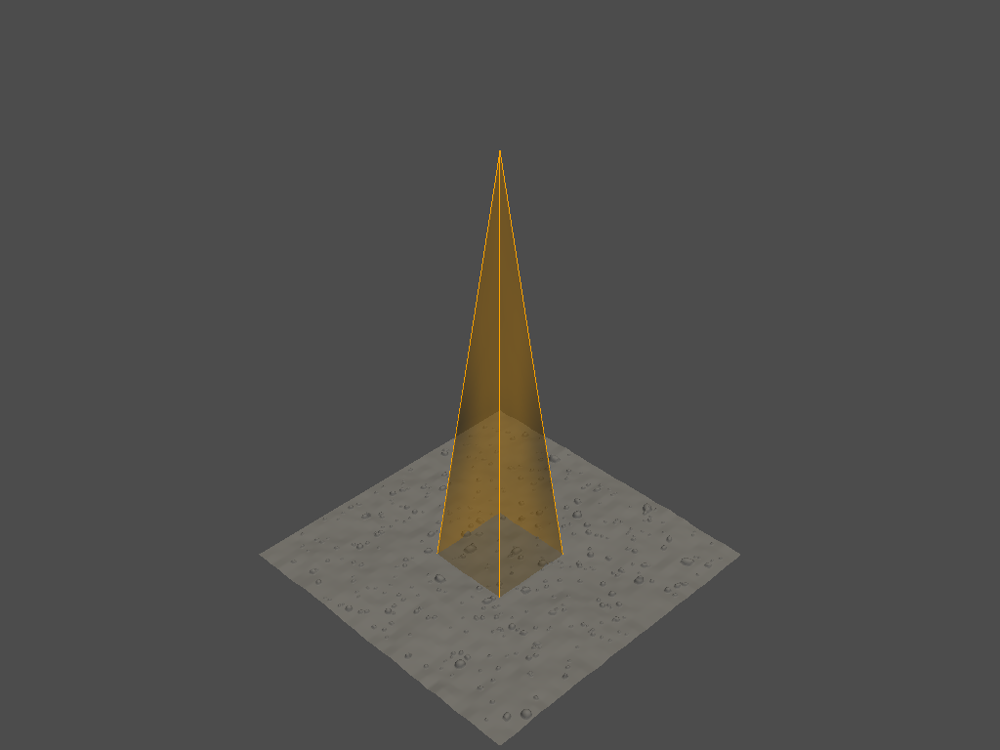

8


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


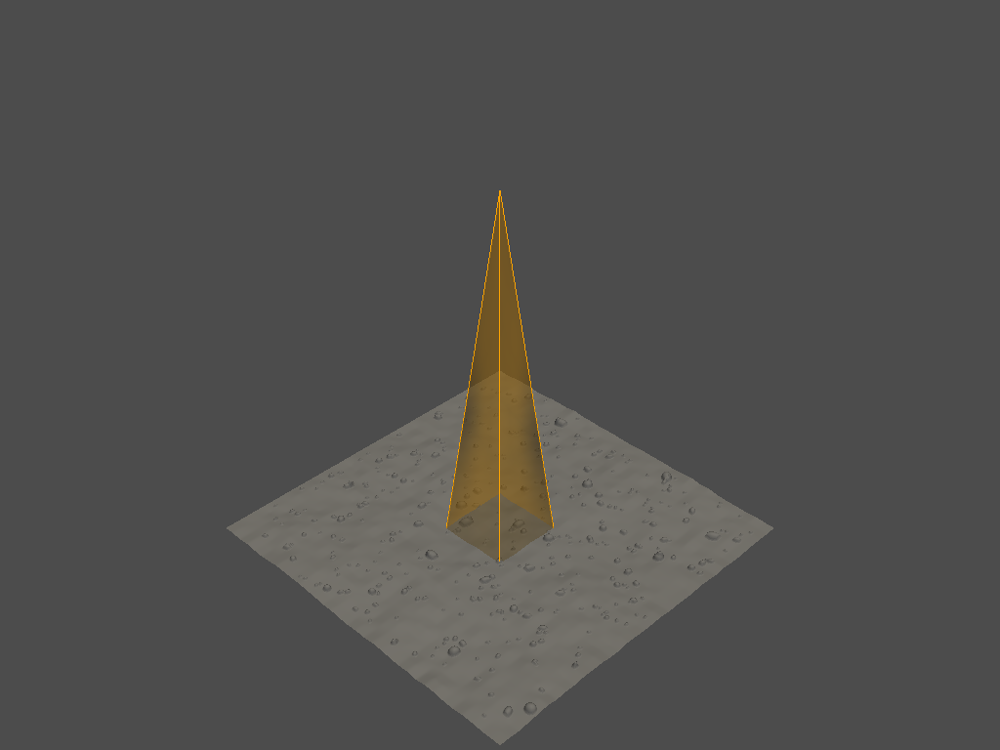

9
(4096, 3)
(256, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


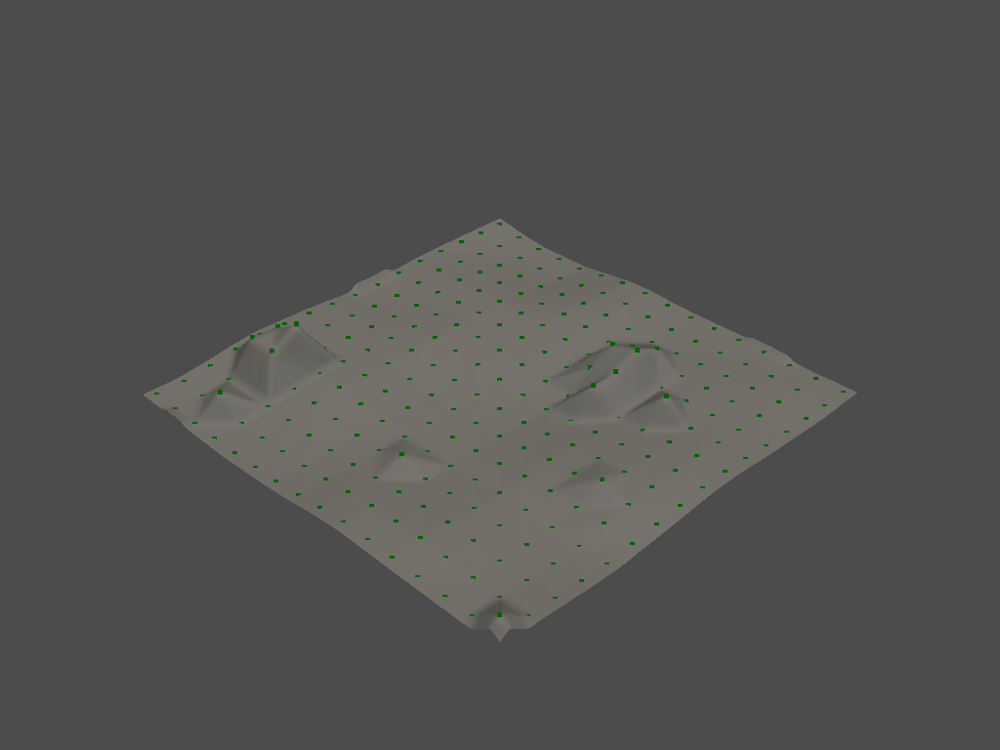

(4096, 3)
(324, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


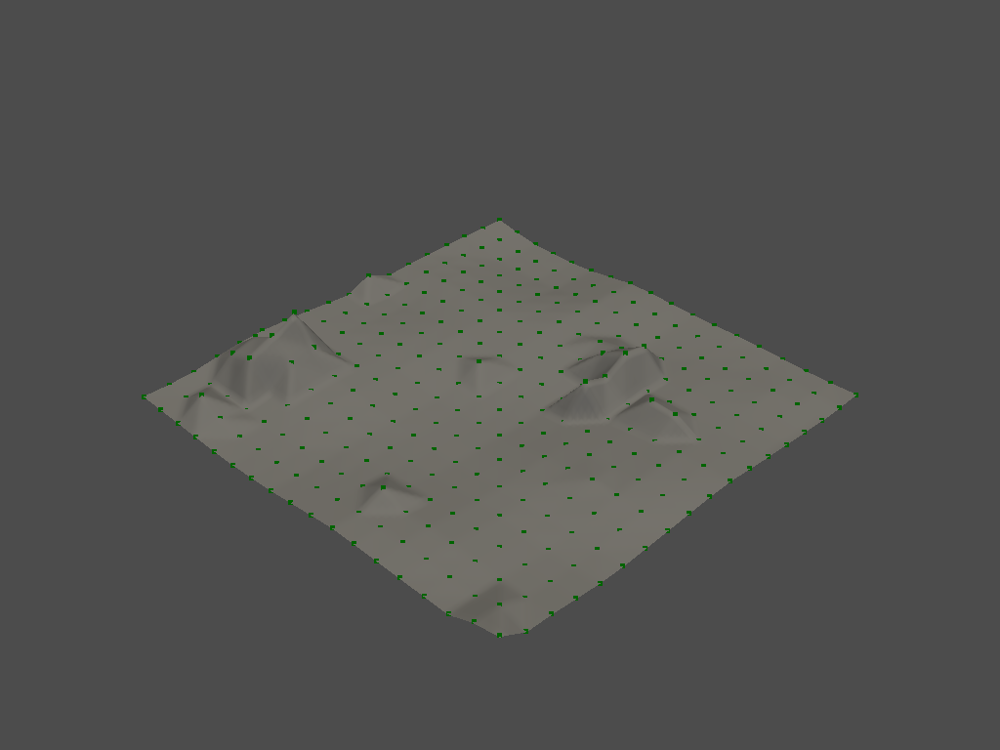

(4096, 3)
(324, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


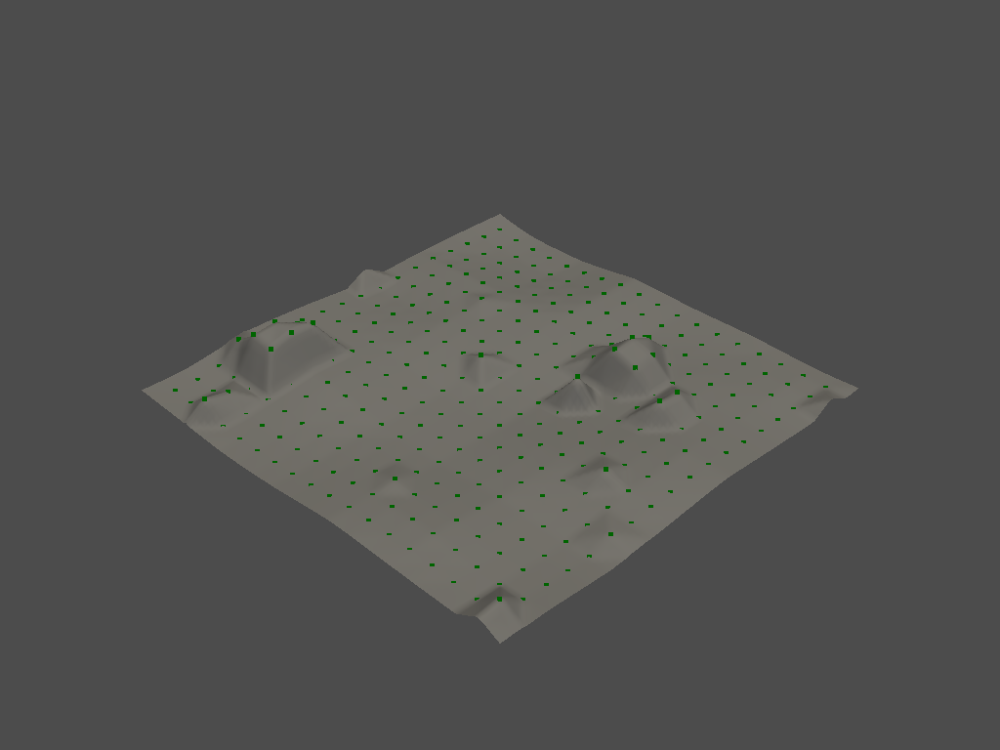

(4096, 3)
(463, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


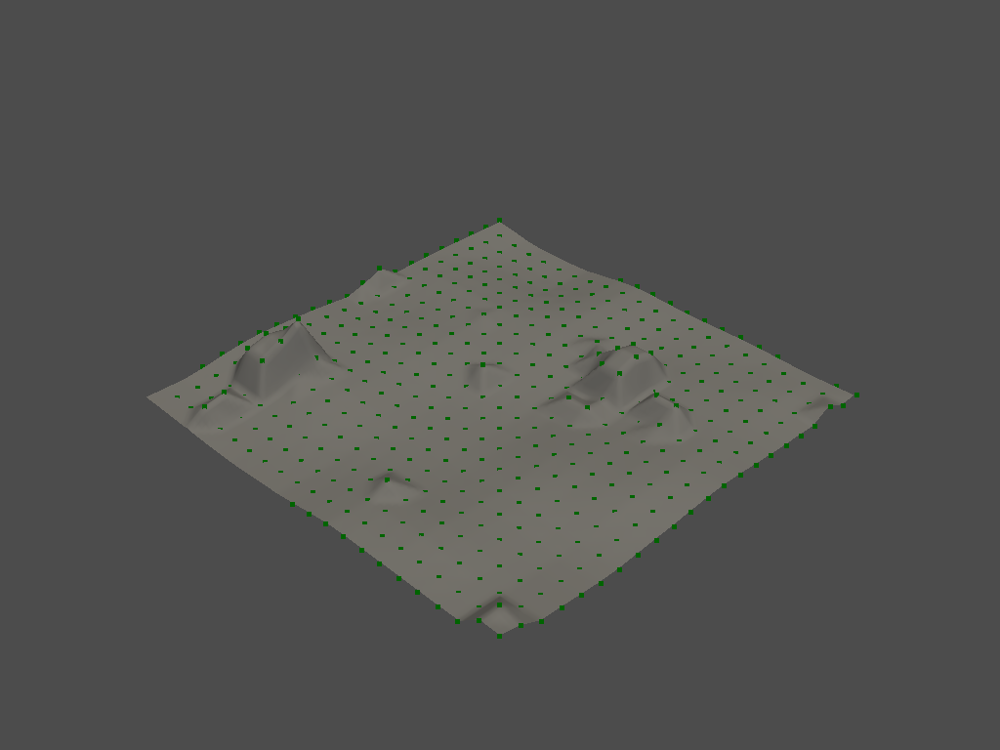

(4096, 3)
(576, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


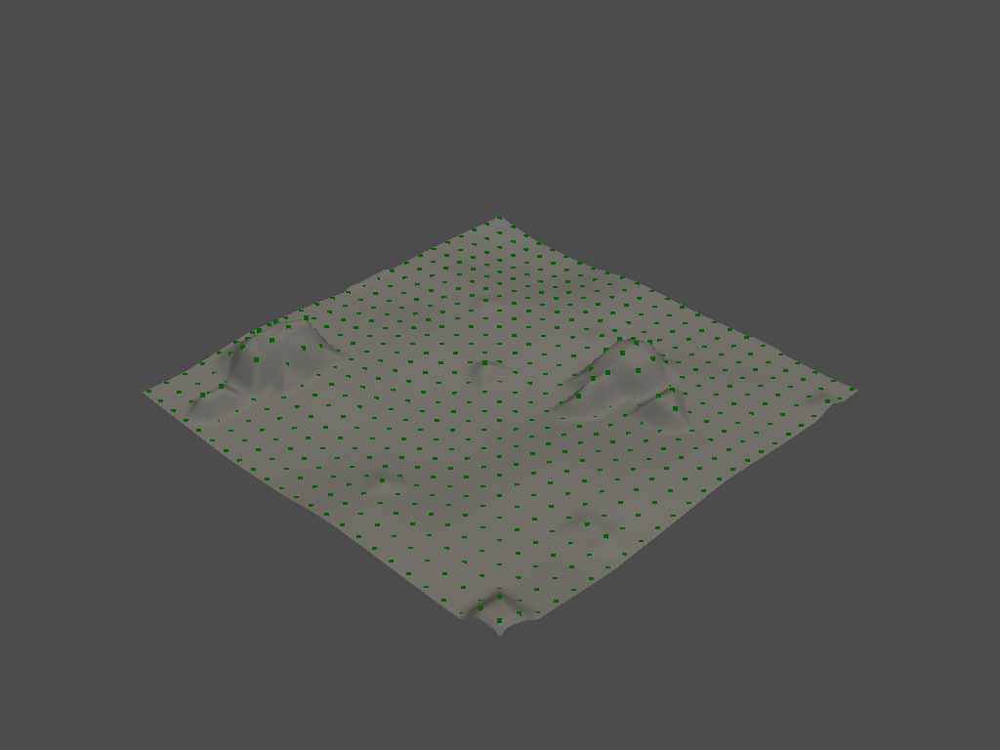

(4096, 3)
(755, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


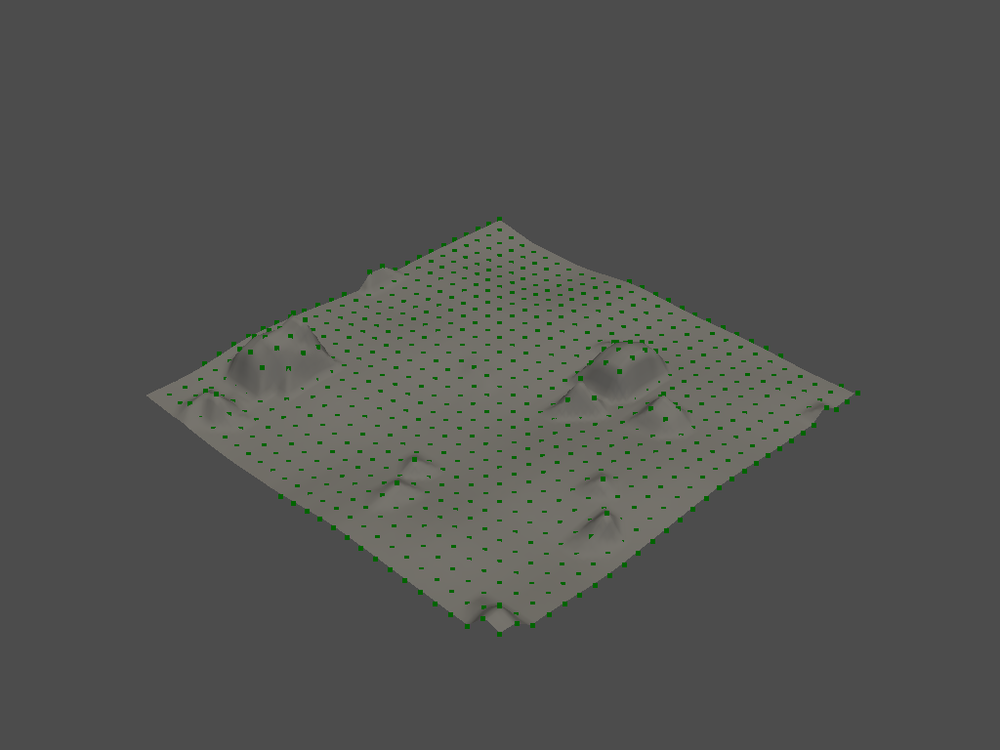

(4096, 3)
(1024, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


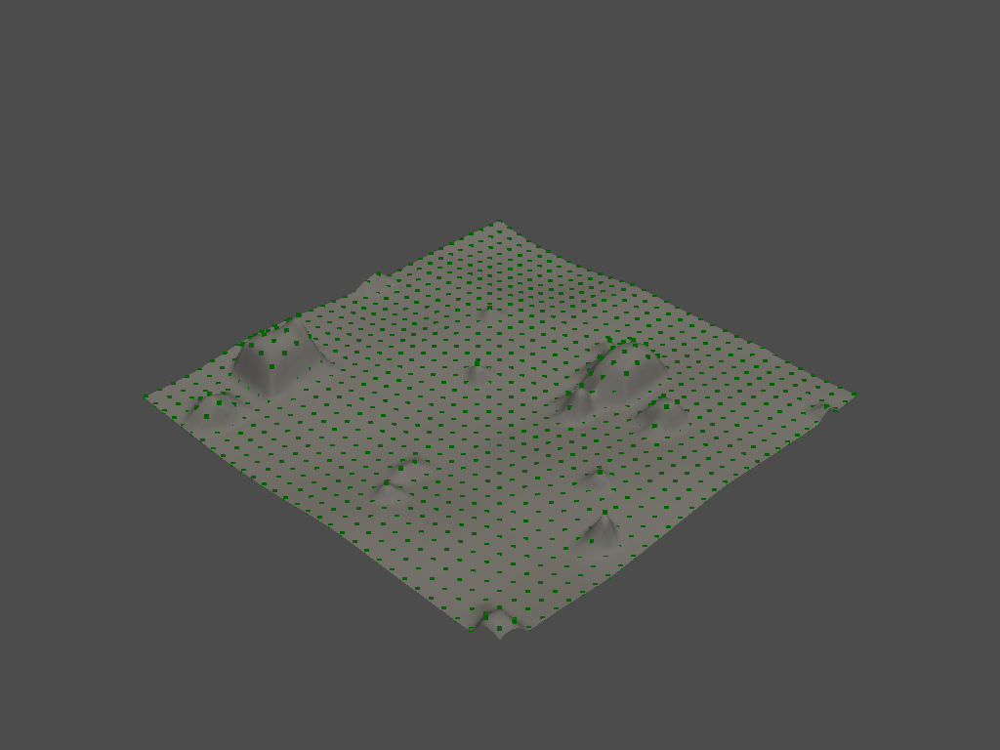

(4096, 3)
(1444, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


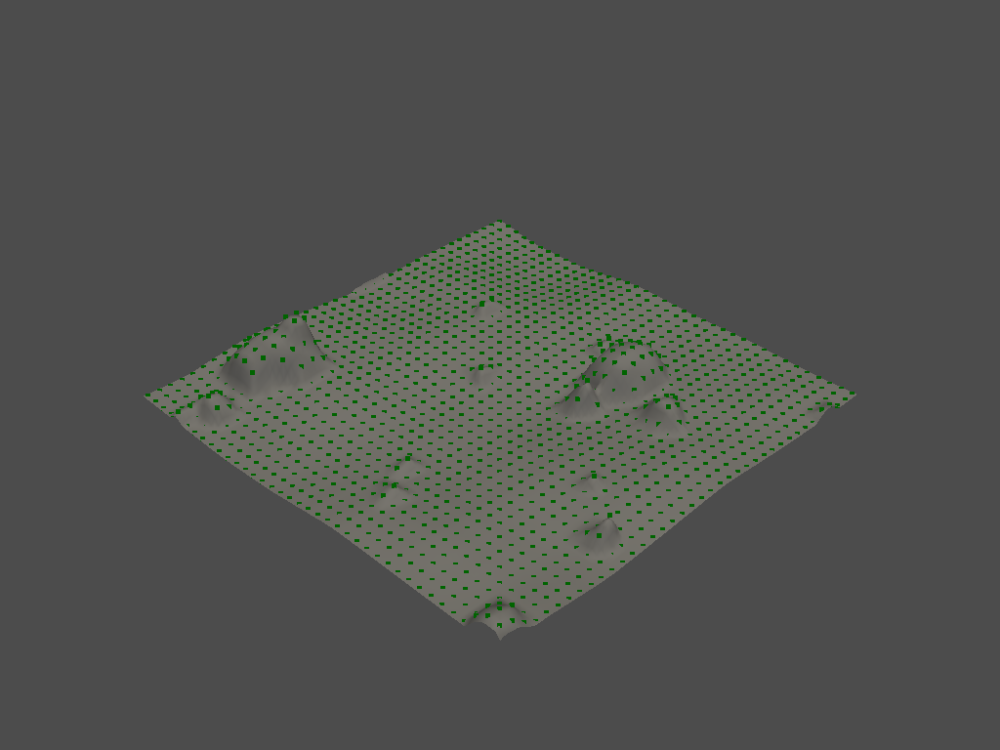

(4096, 3)
(2304, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


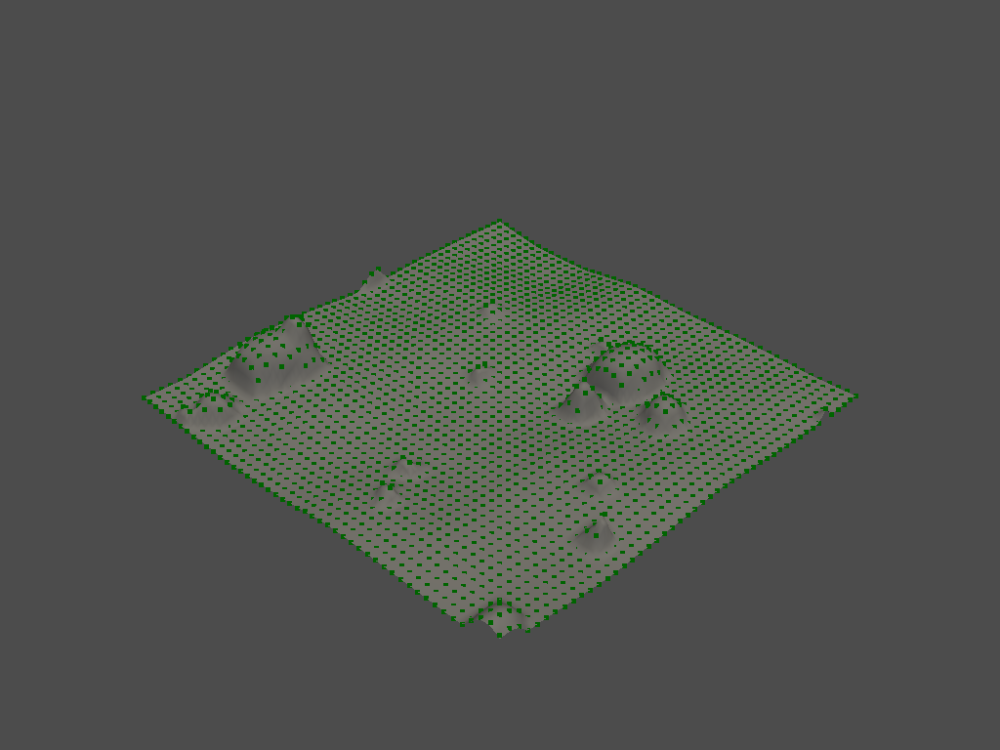

(4096, 3)
(4031, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


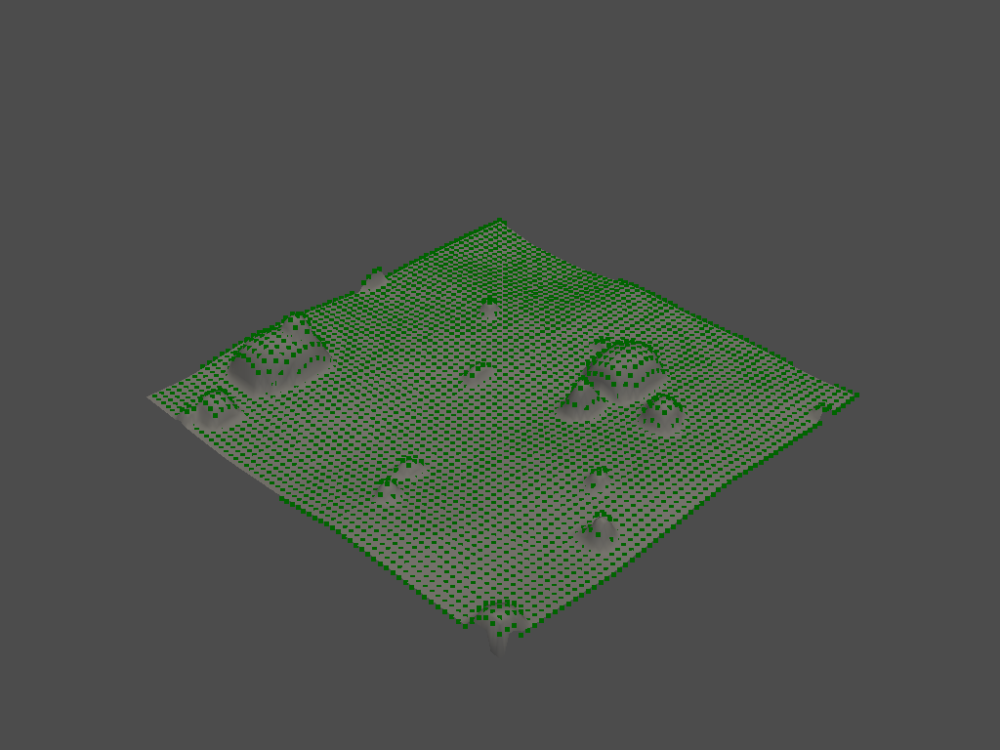

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


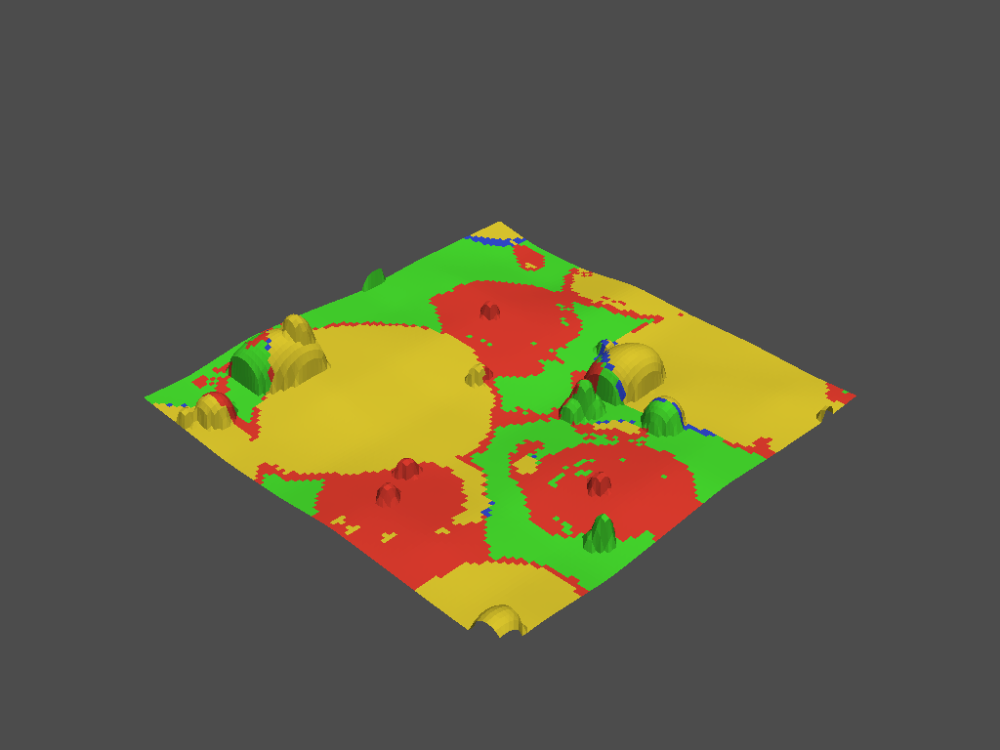

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


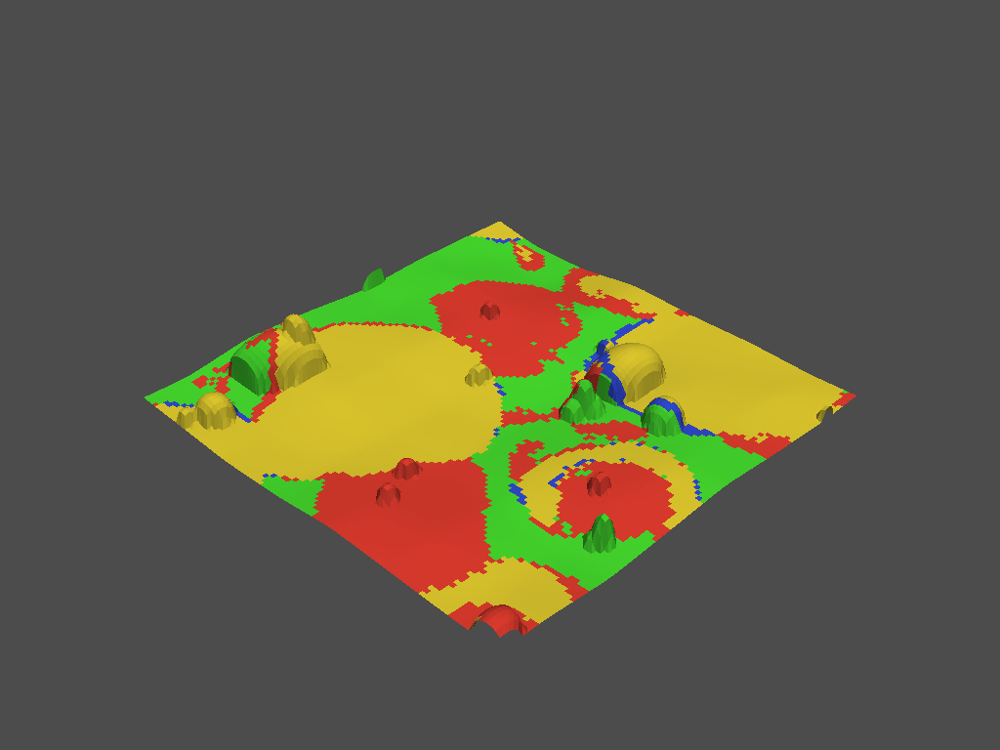

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


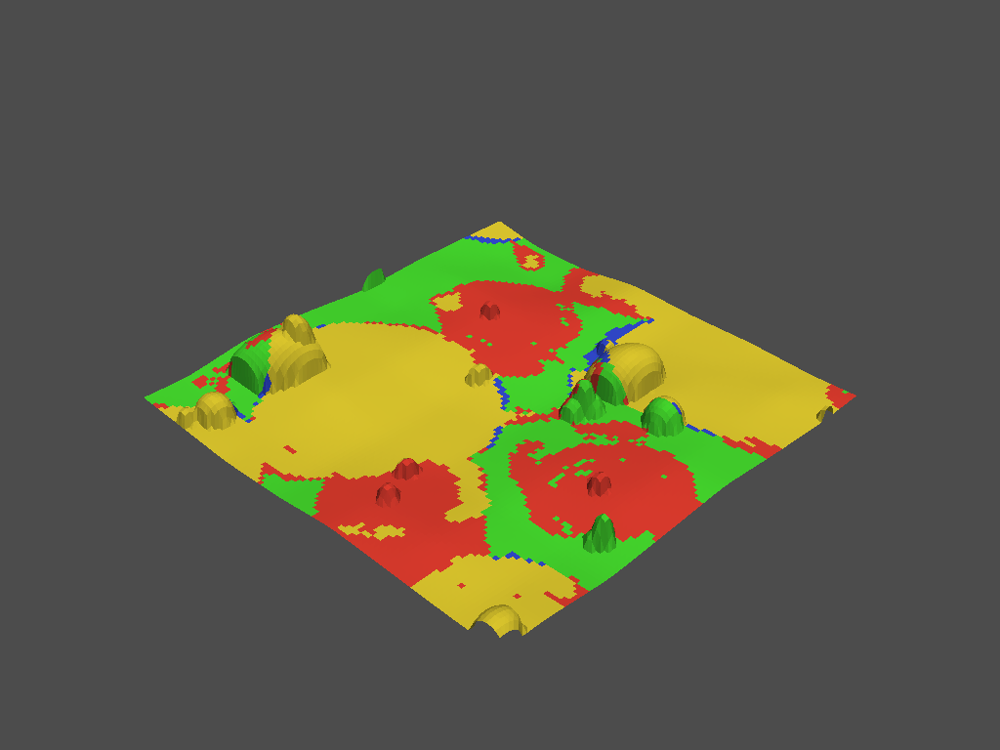

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


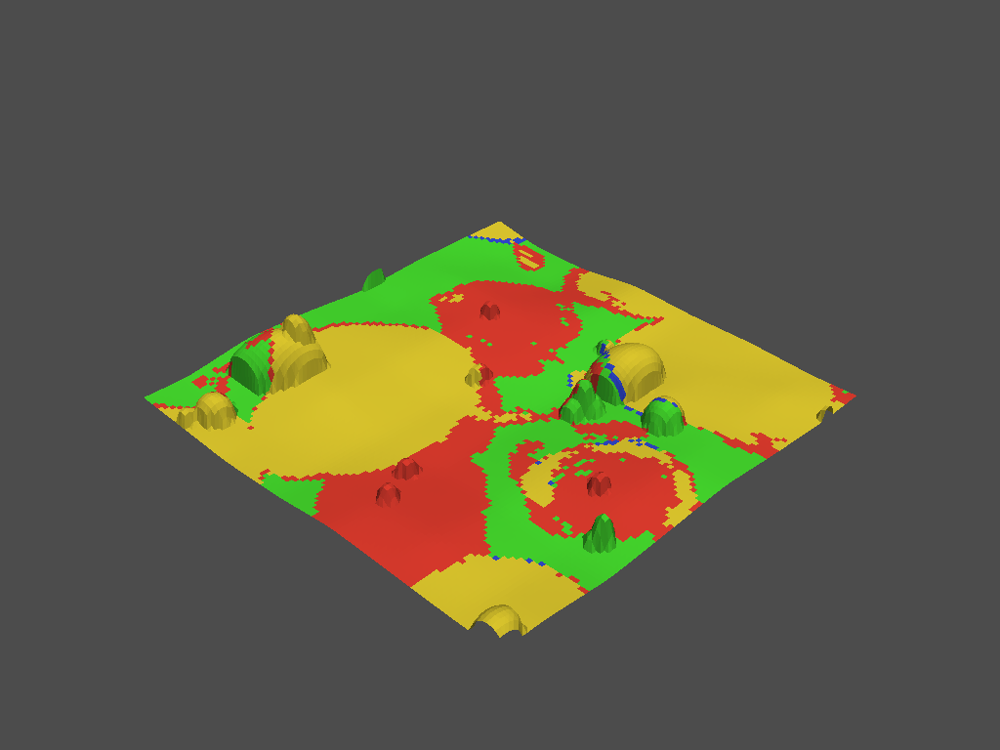

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


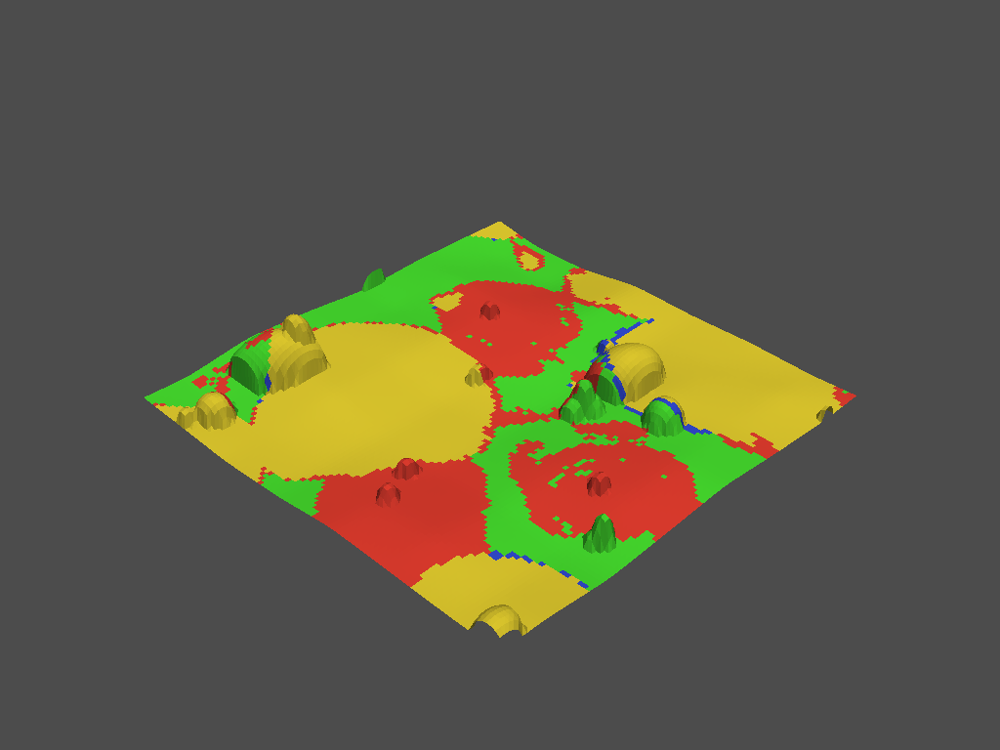

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


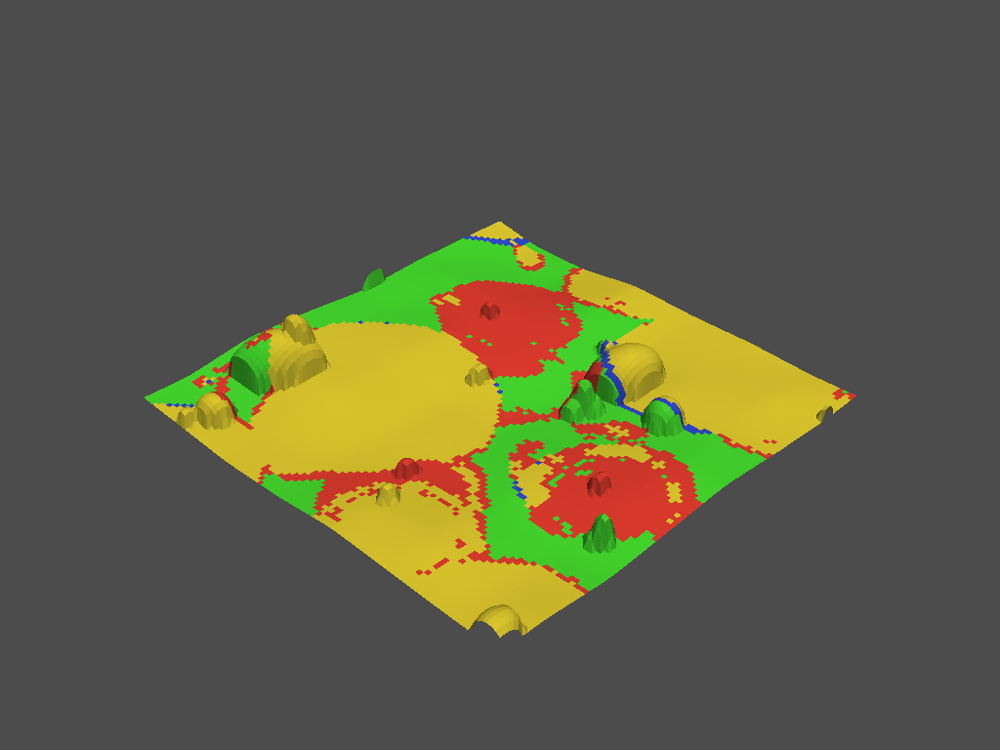

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


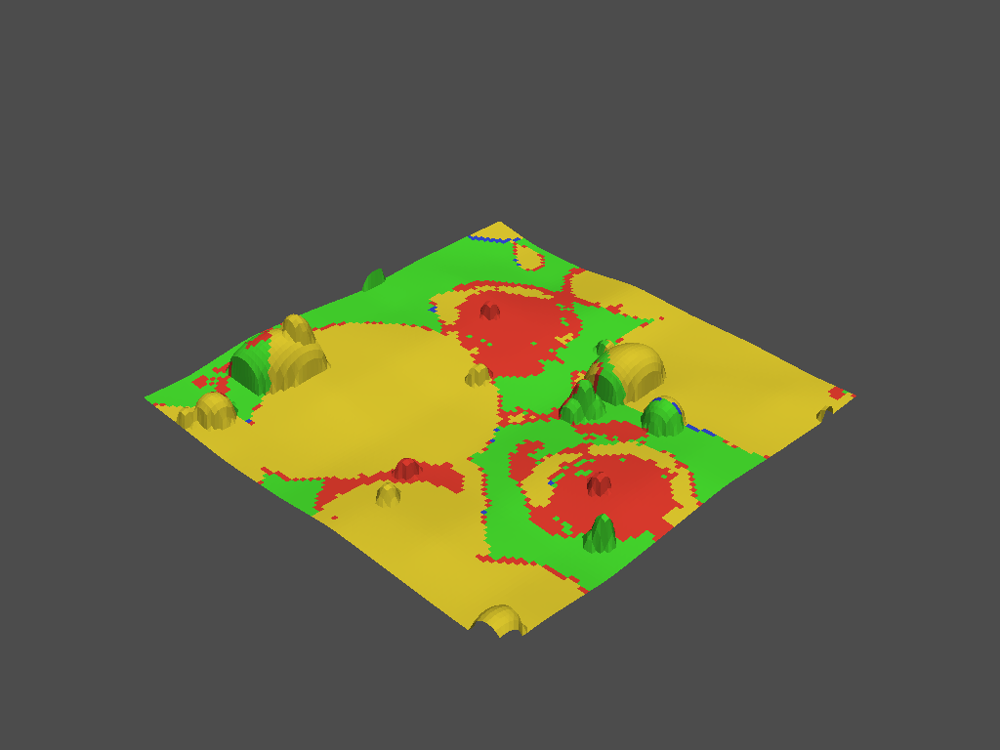

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


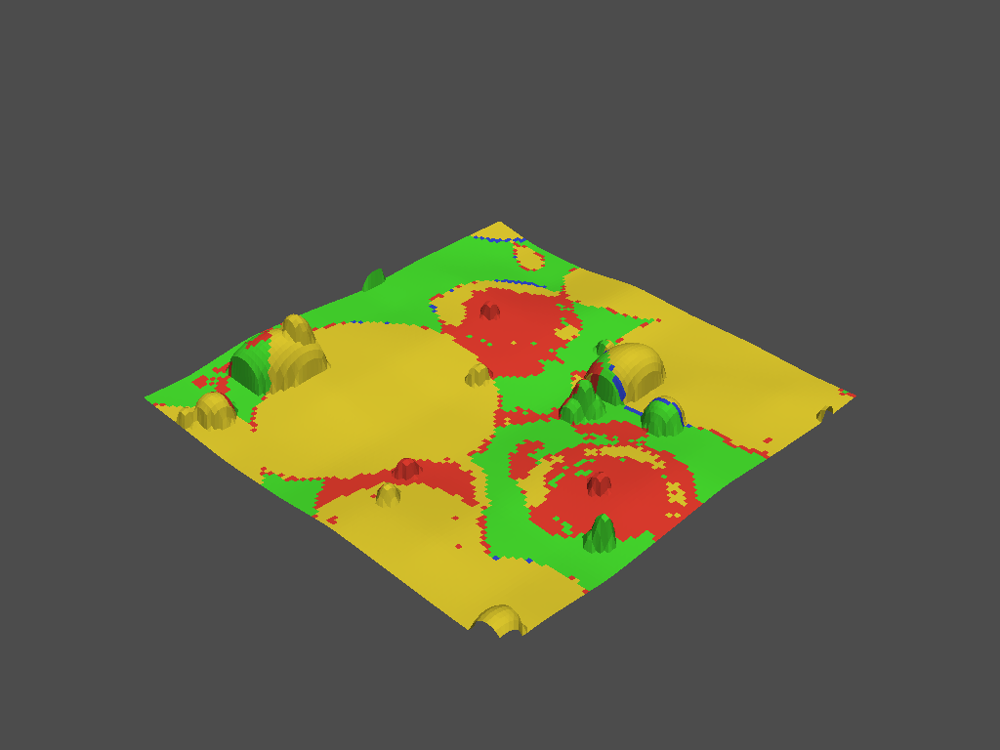

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


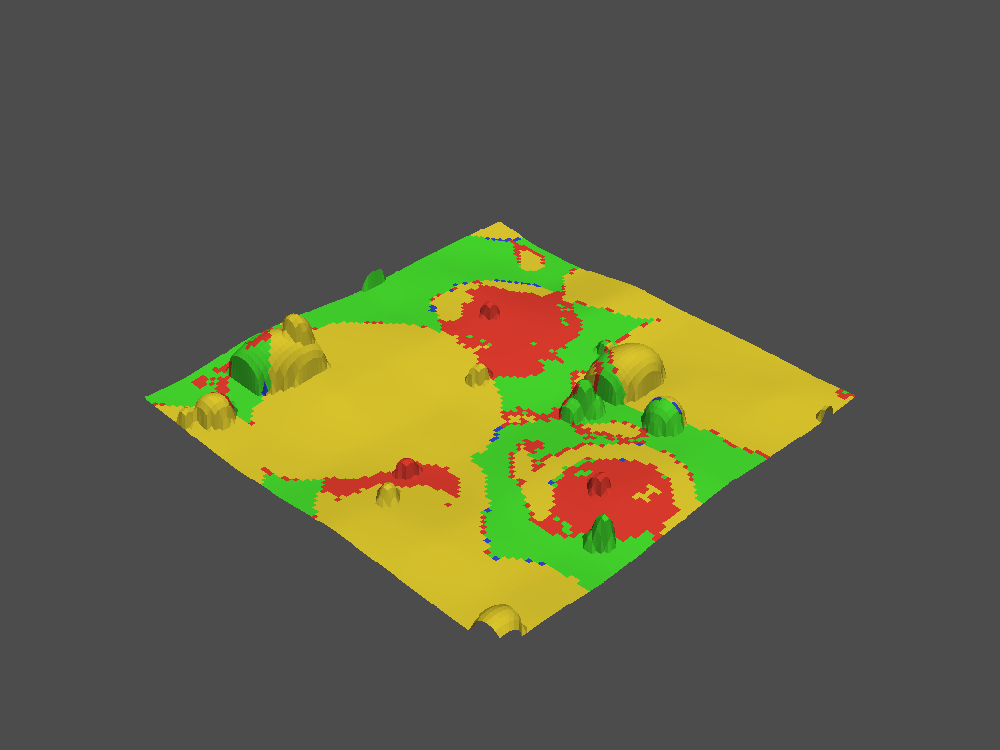

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


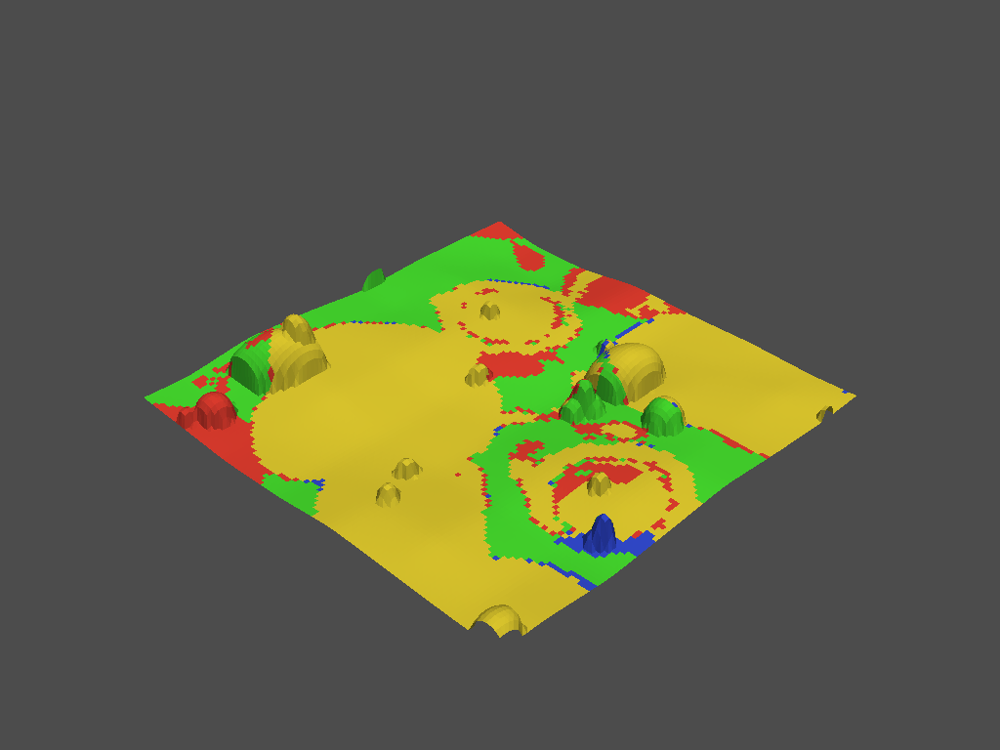

C:\Users\ktomita3\AppData\Local\Temp\ipykernel_26212\2991450551.py:88: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  images = [imageio.imread(file) for file in file_list]
c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


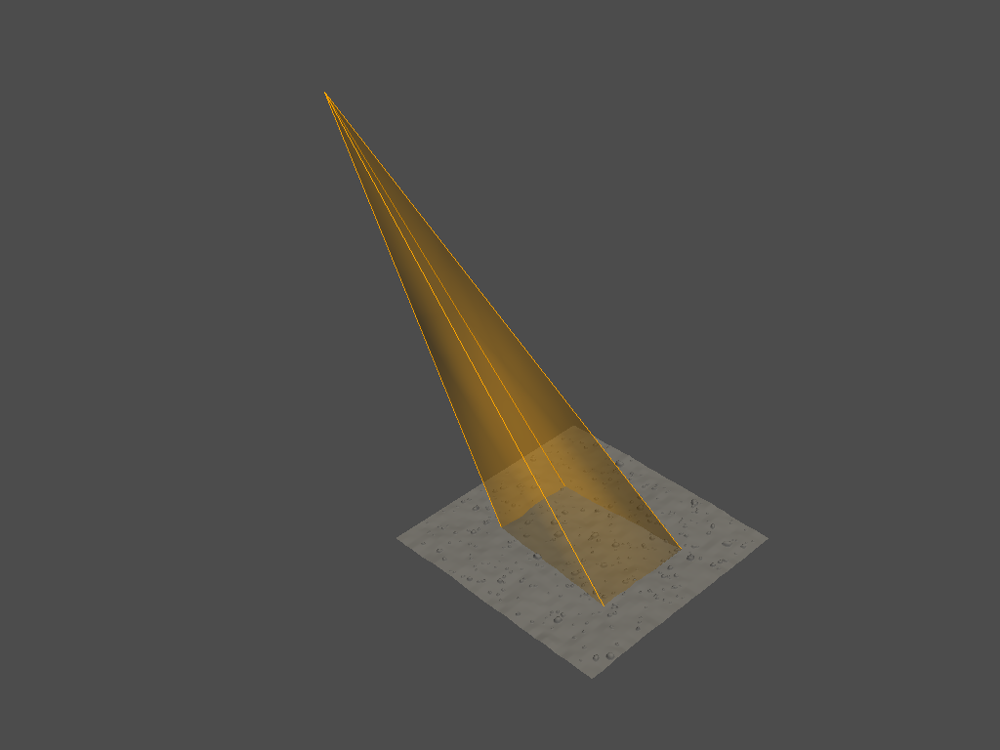

0


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


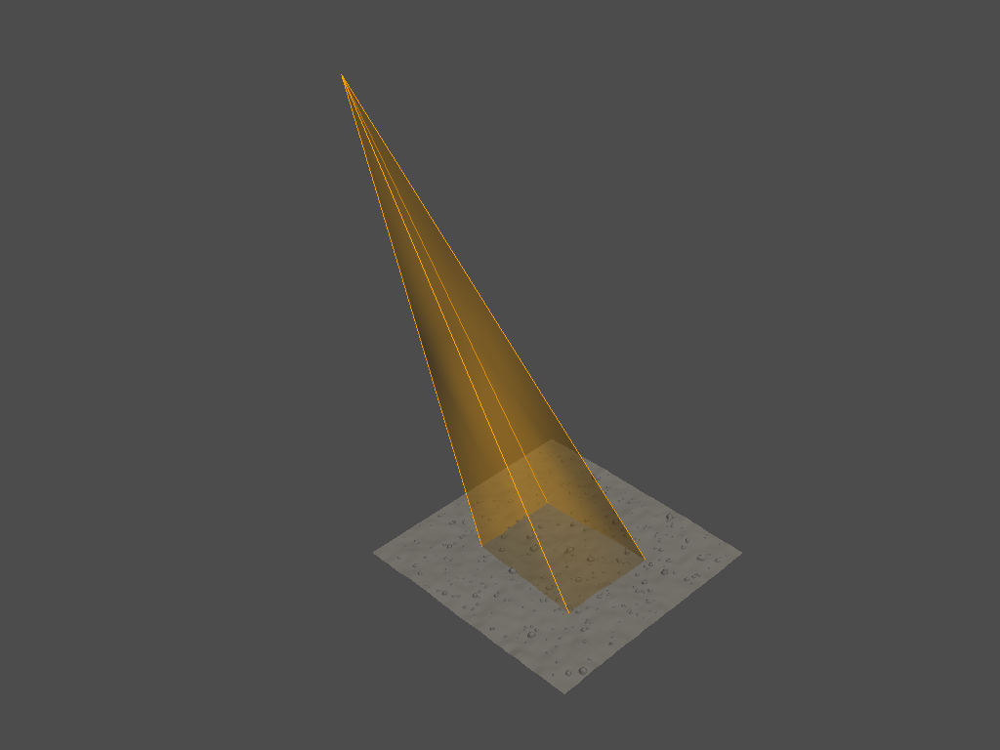

1


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


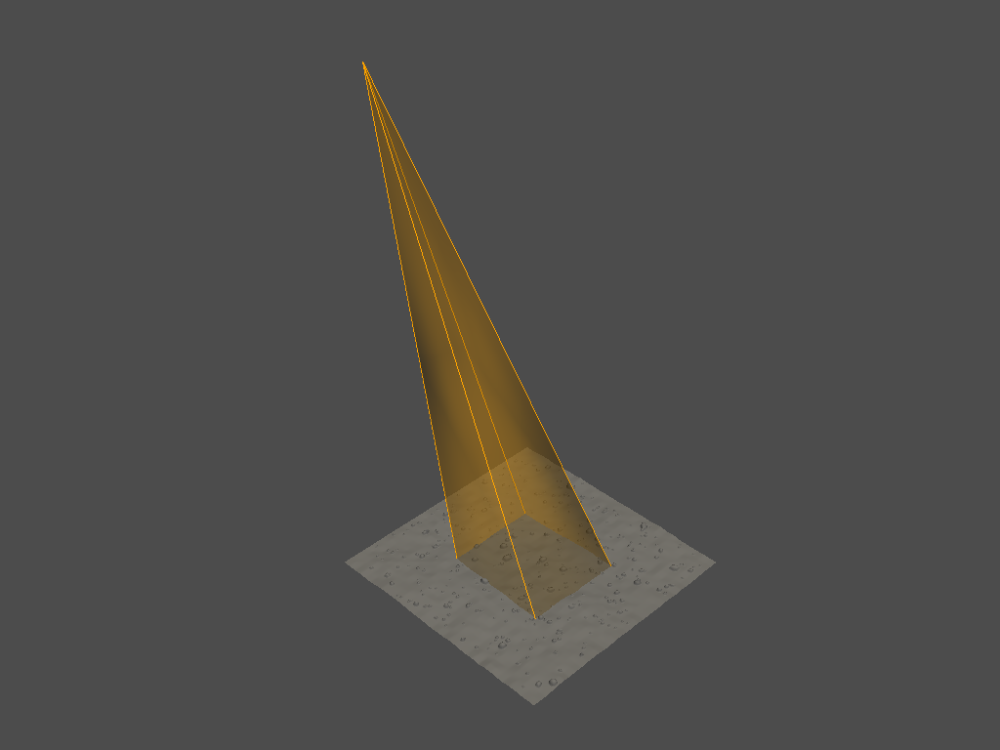

2


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


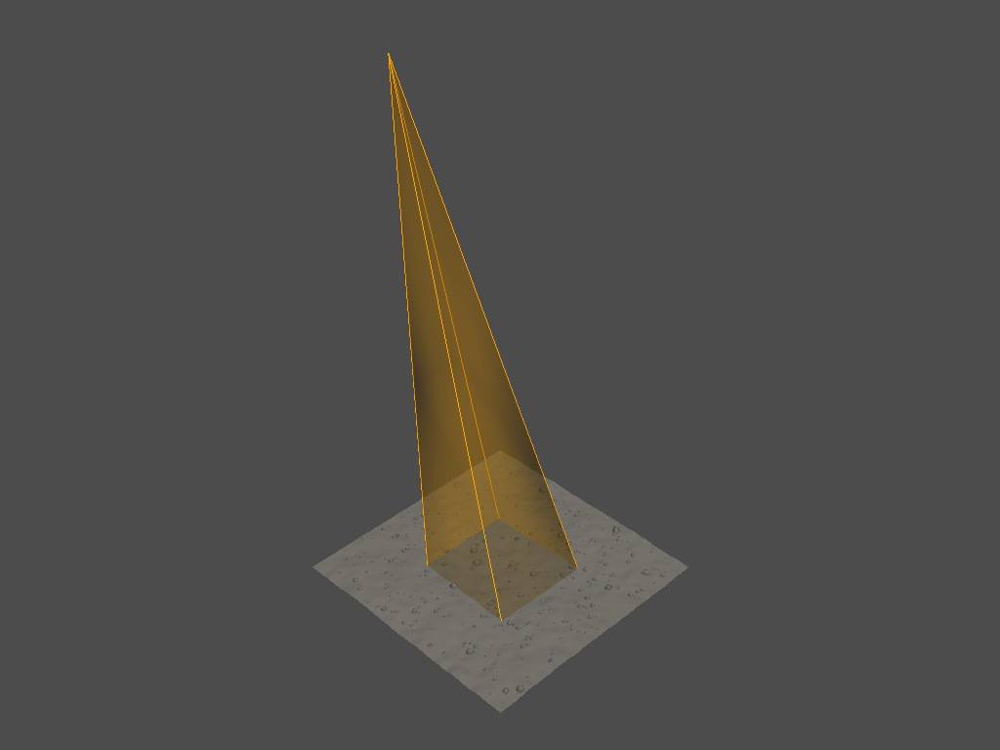

3


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


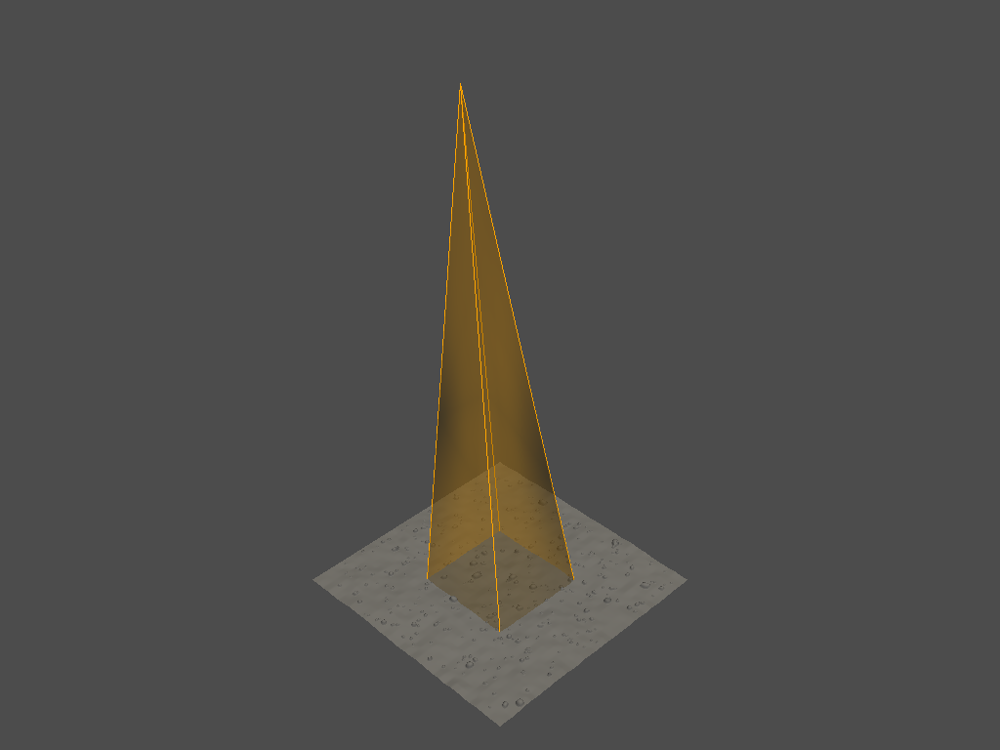

4


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


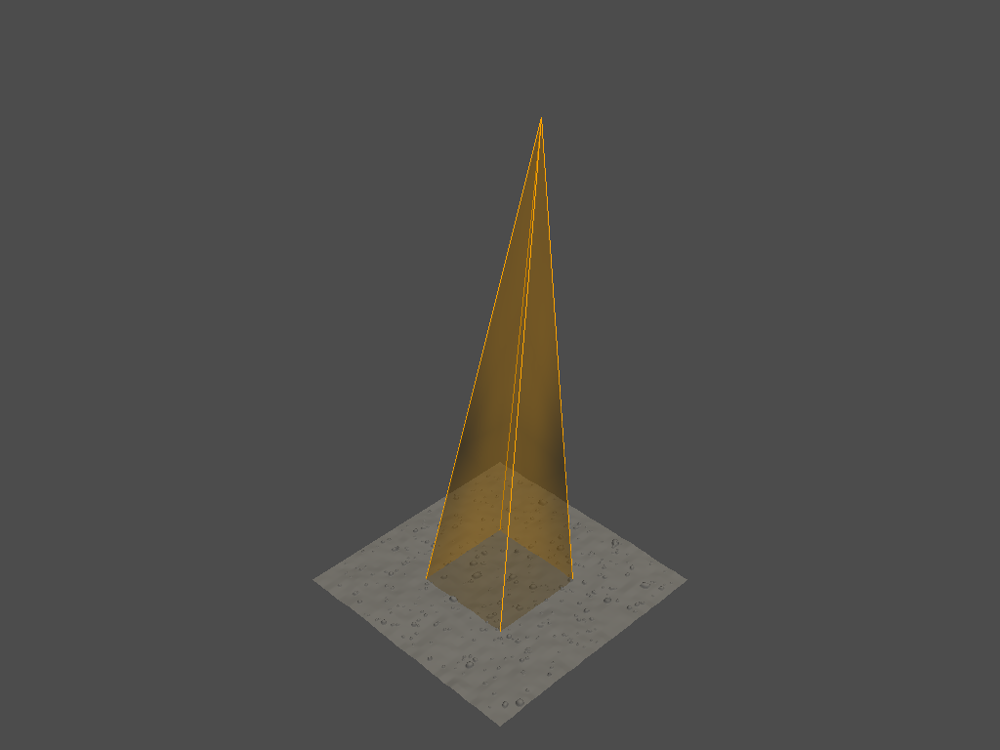

5


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


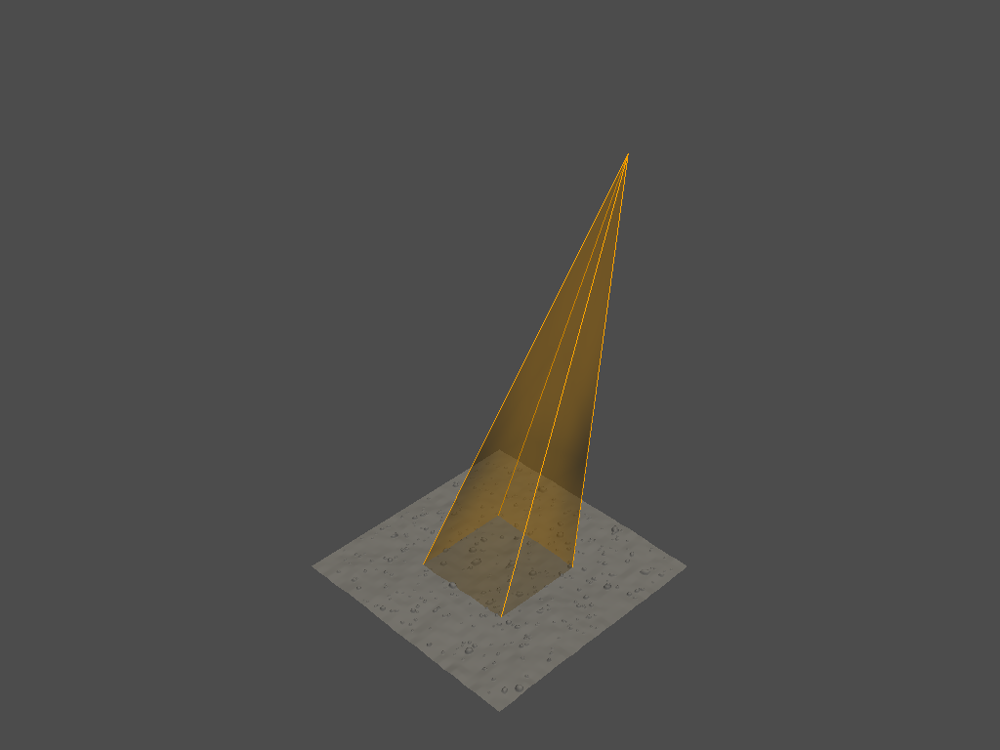

6


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


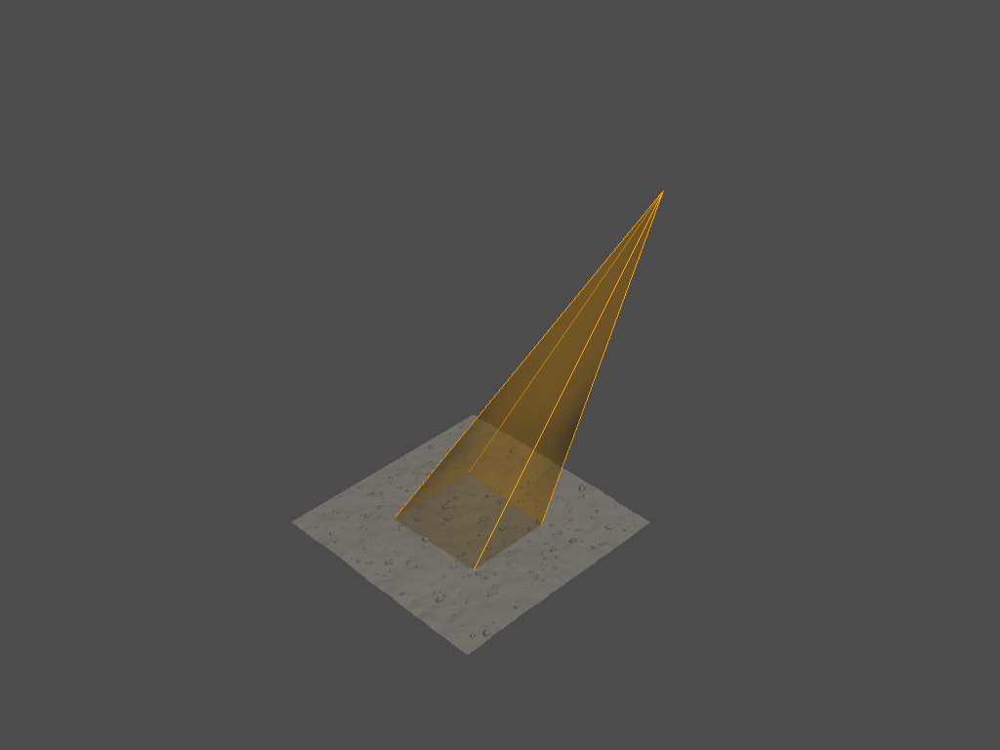

7


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


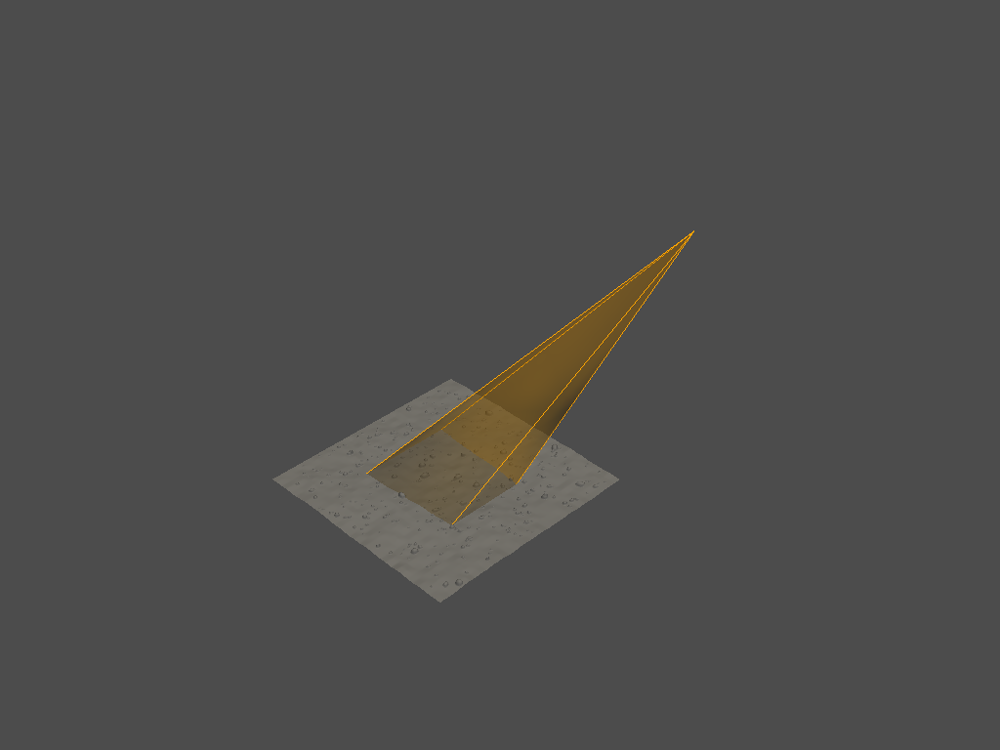

8


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


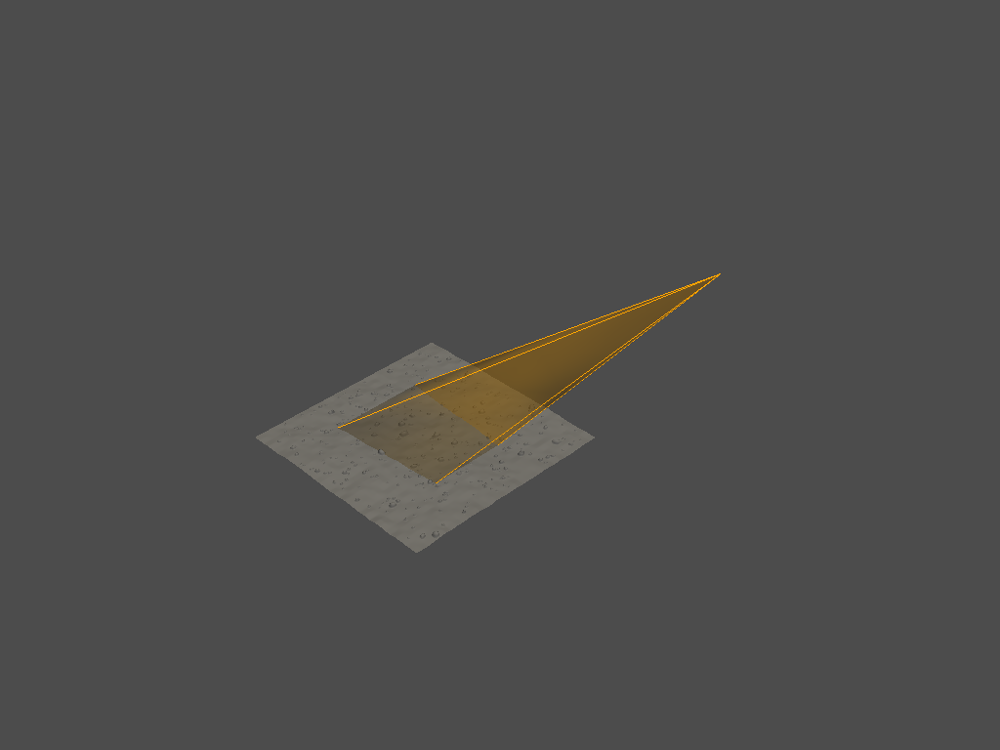

9
(4096, 3)
(703, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


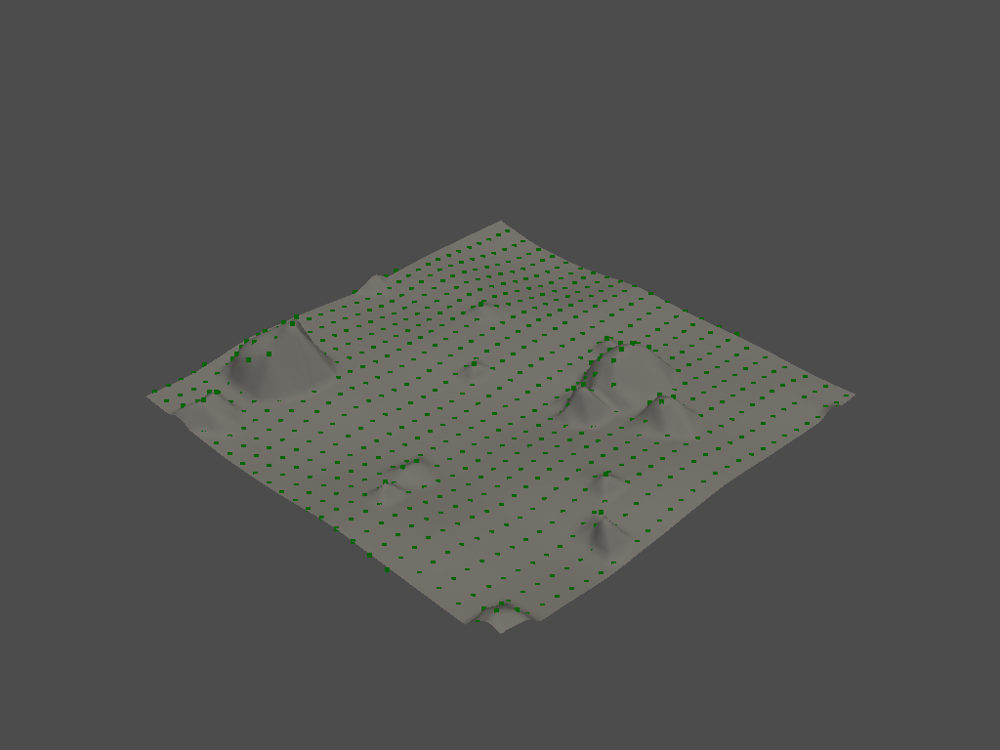

(4096, 3)
(822, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


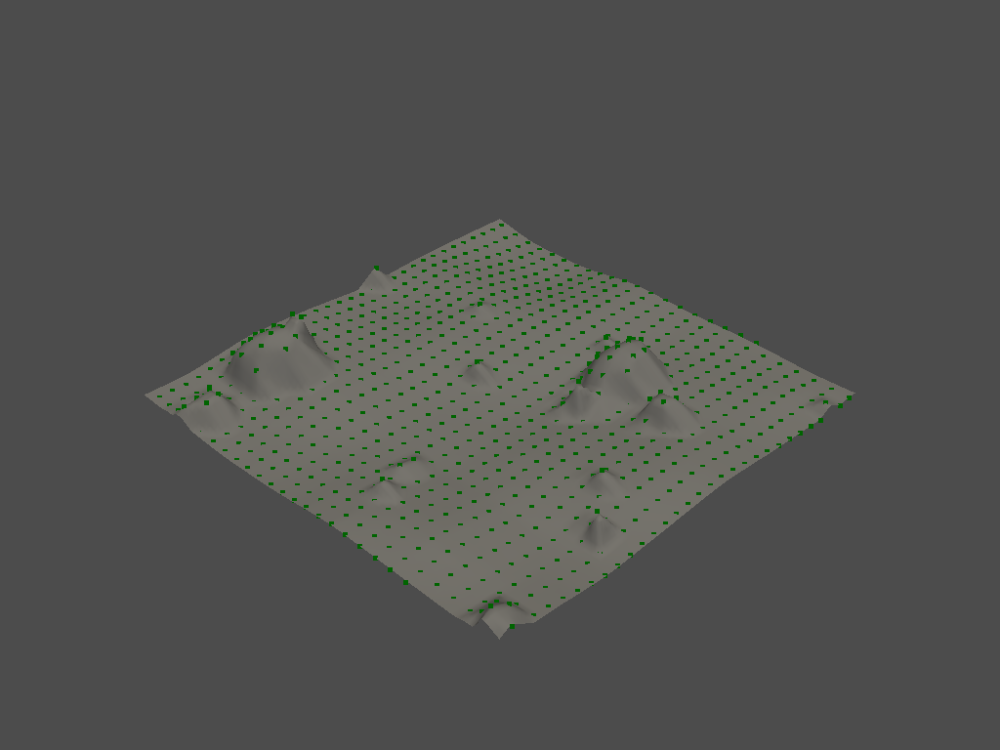

(4096, 3)
(916, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


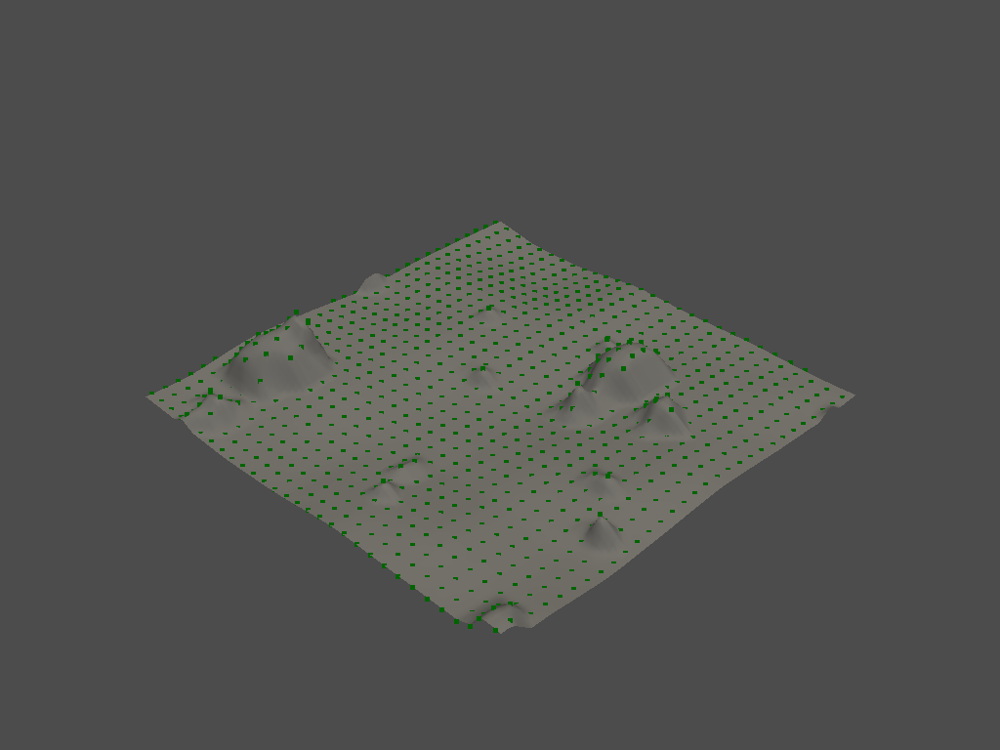

(4096, 3)
(961, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


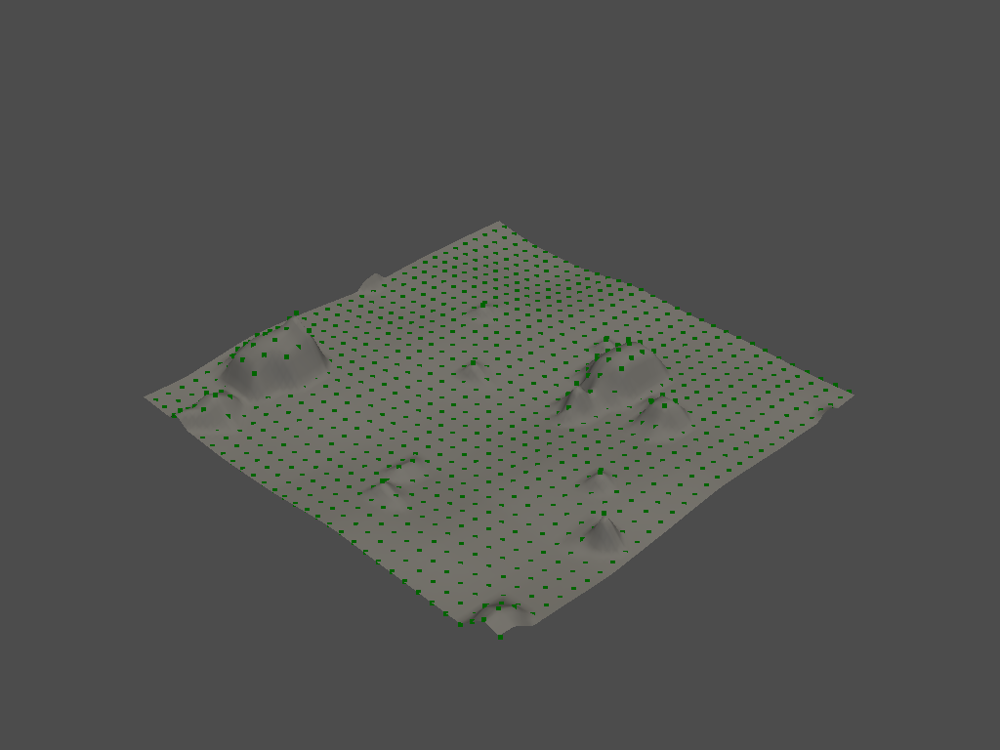

(4096, 3)
(1024, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


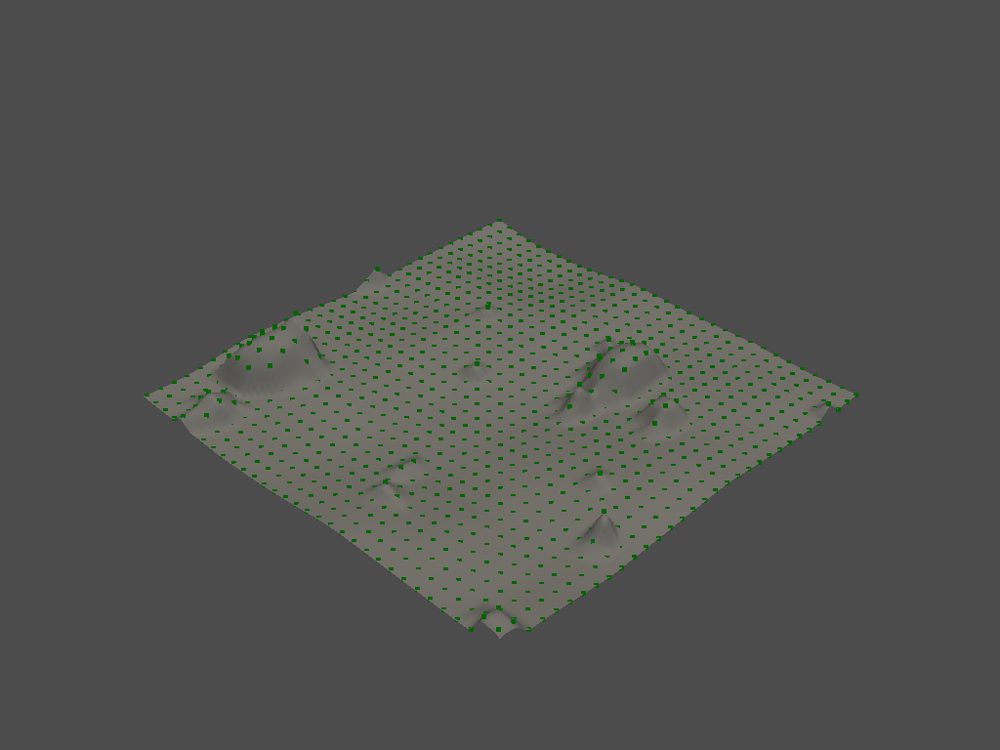

(4096, 3)
(1024, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


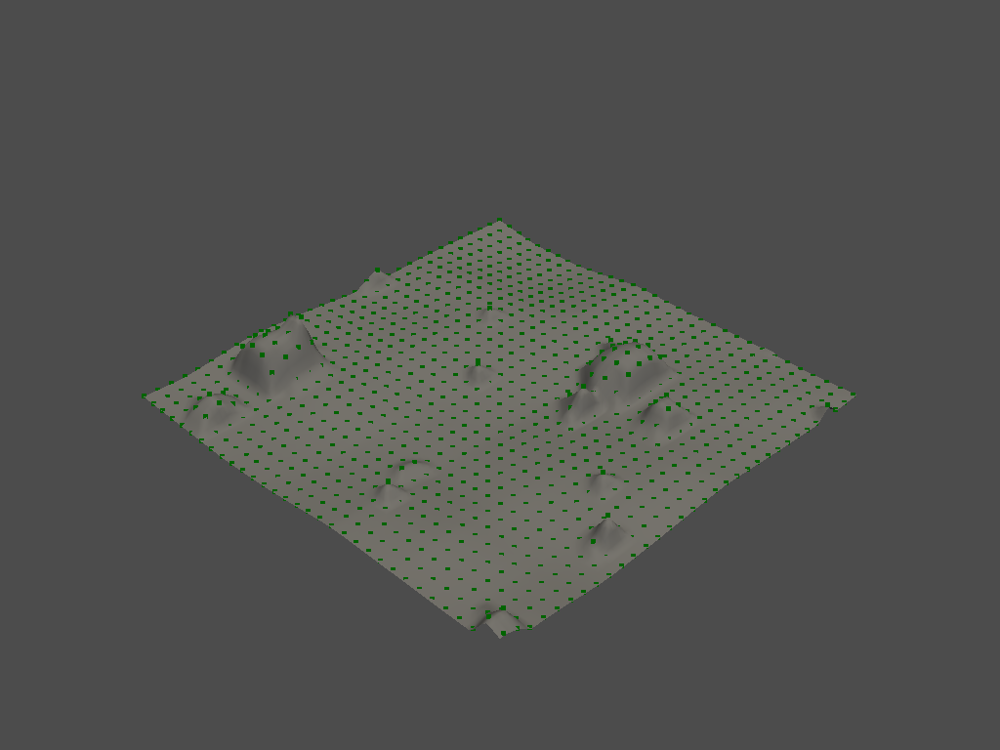

(4096, 3)
(960, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


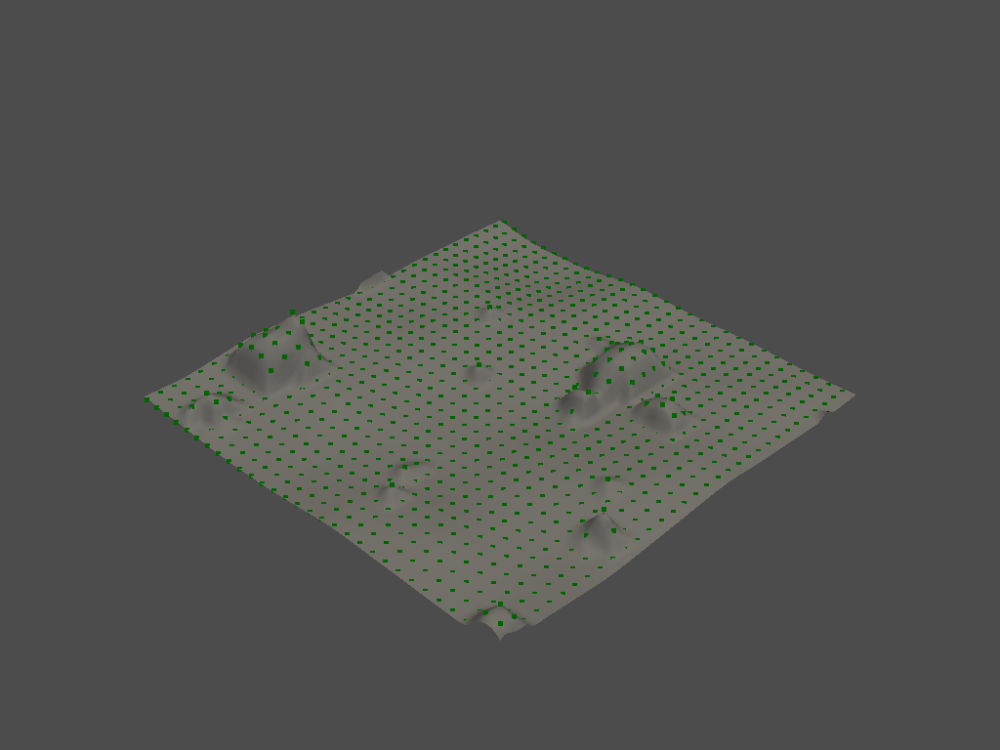

(4096, 3)
(897, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


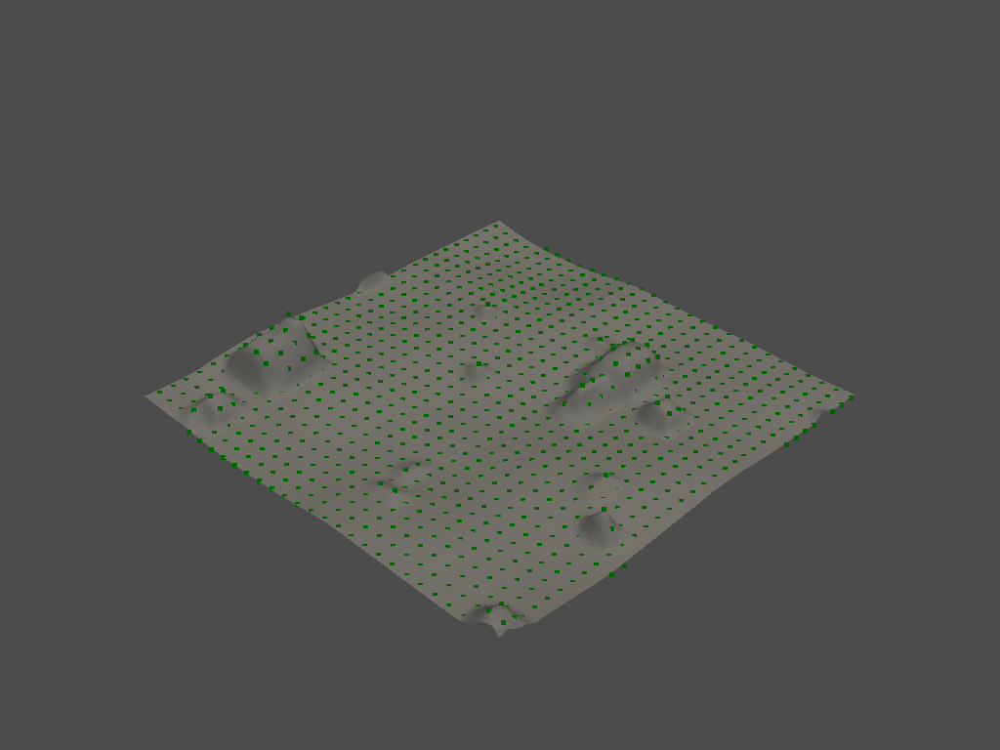

(4096, 3)
(815, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


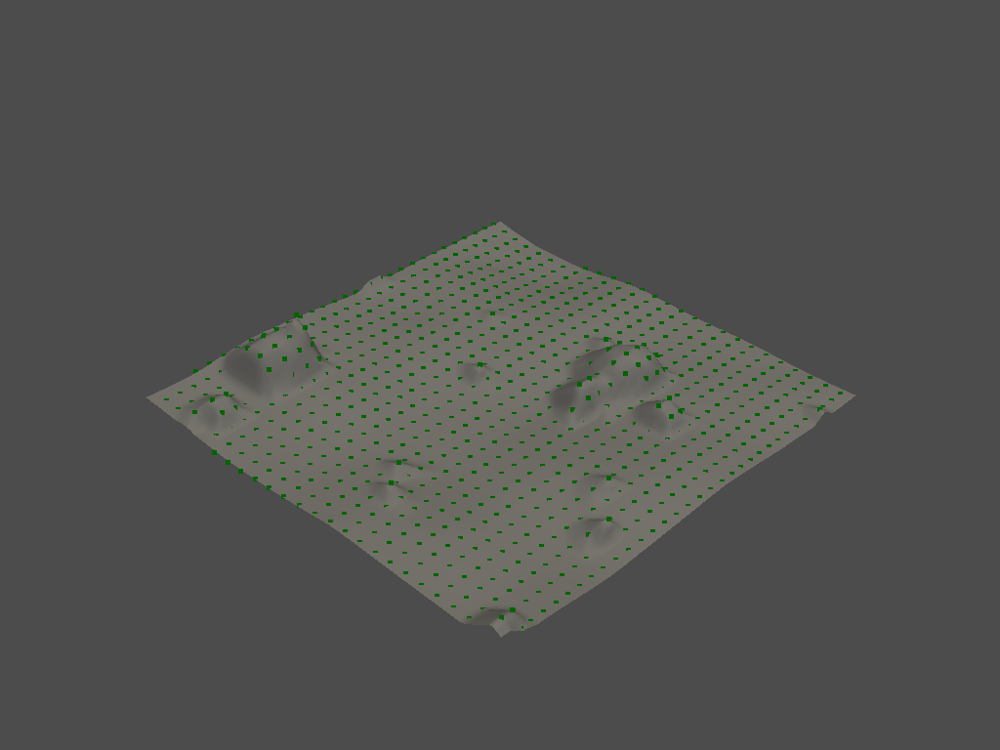

(4096, 3)
(694, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


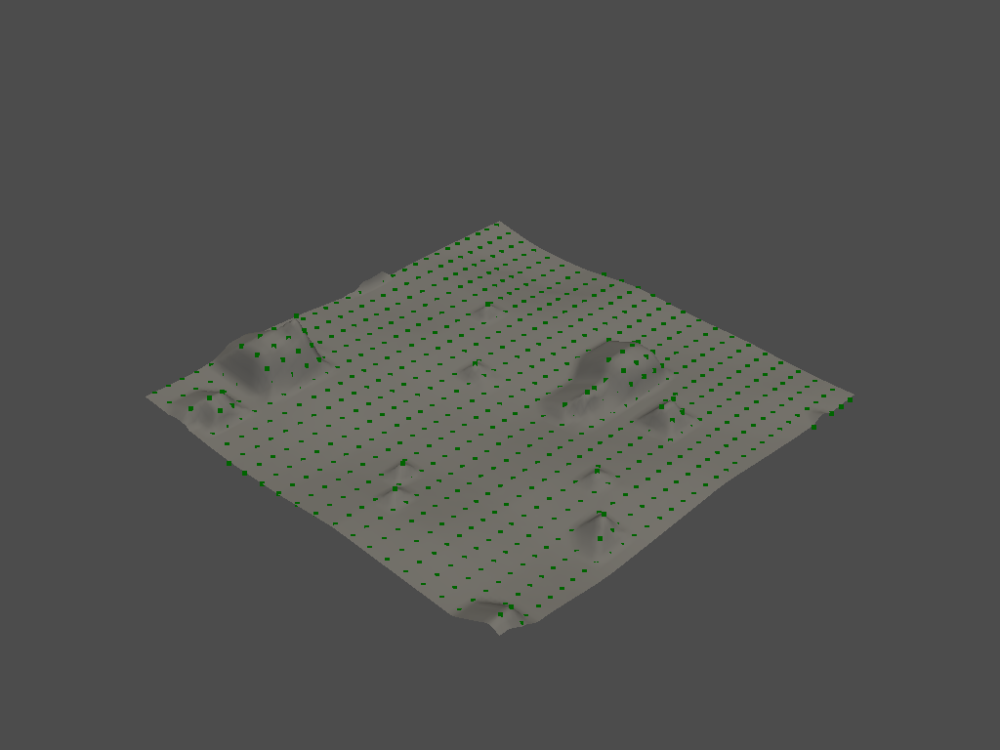

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


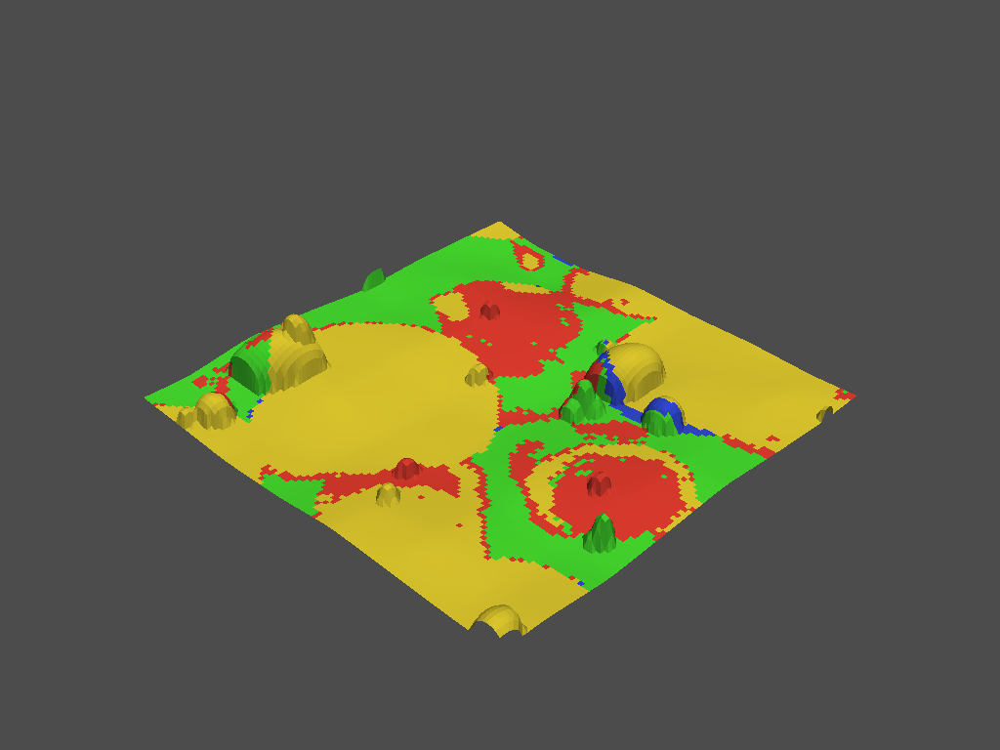

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


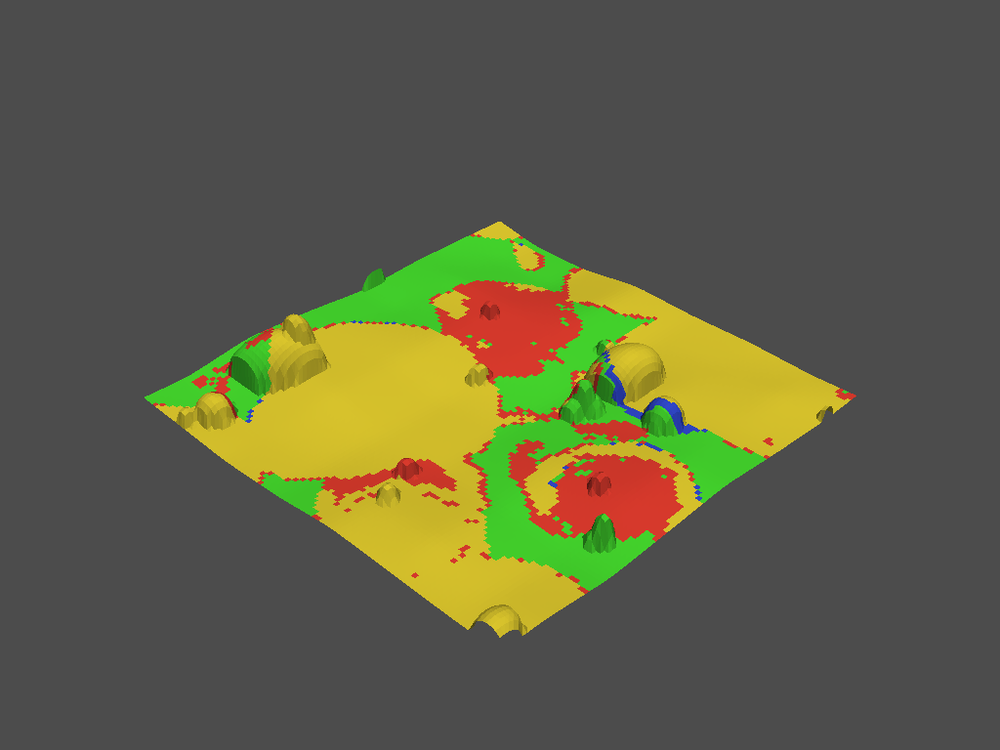

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


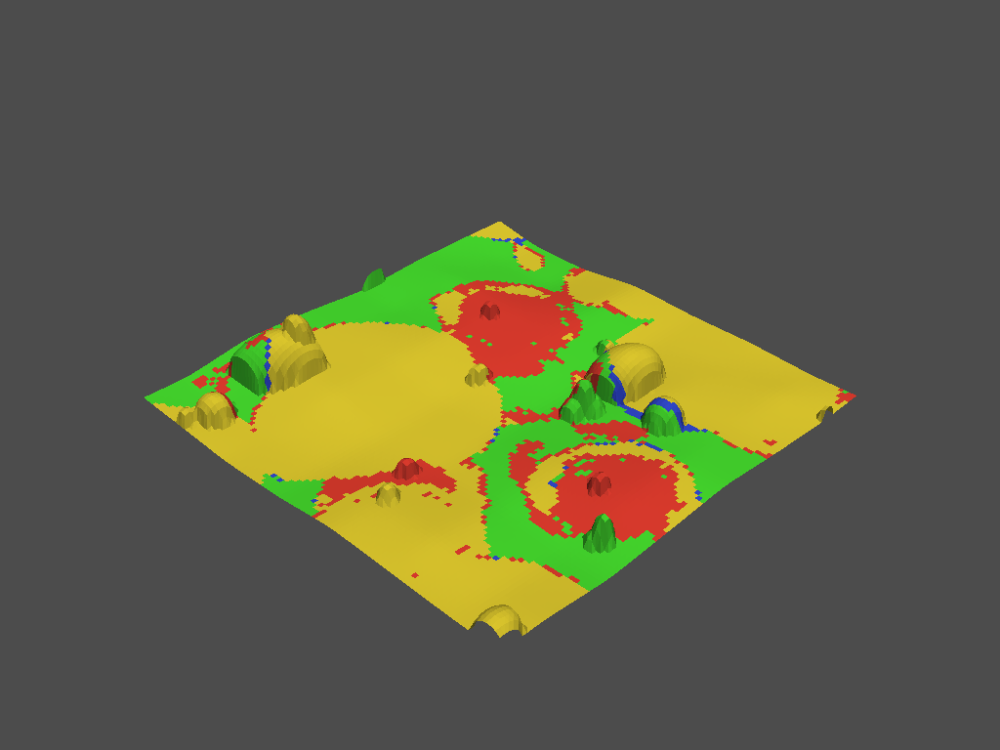

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


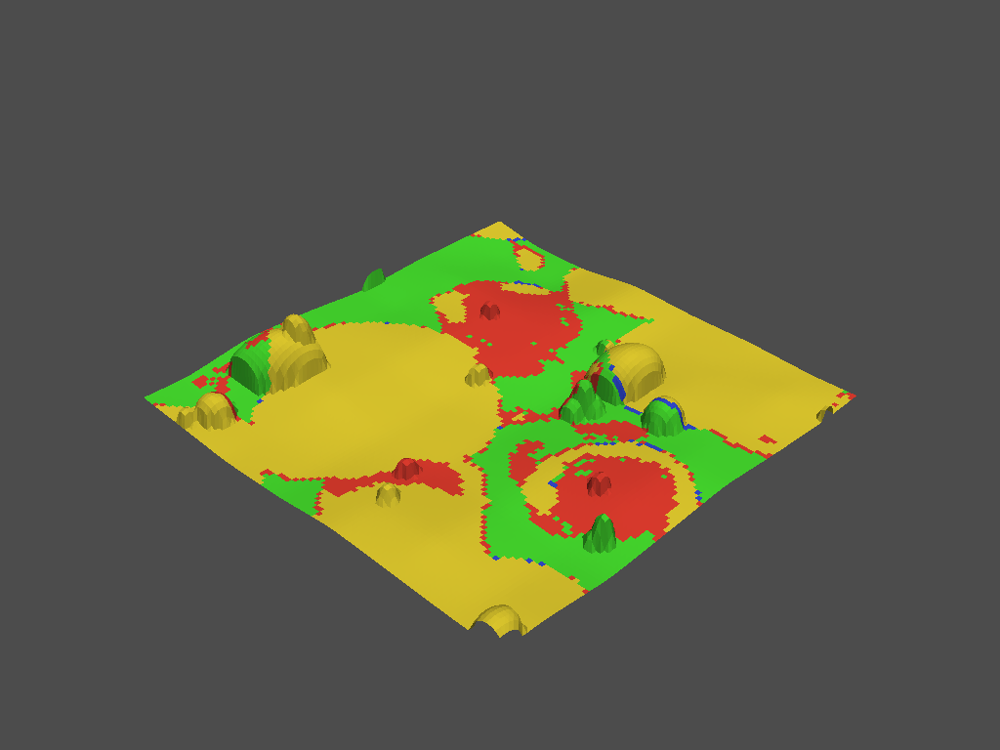

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


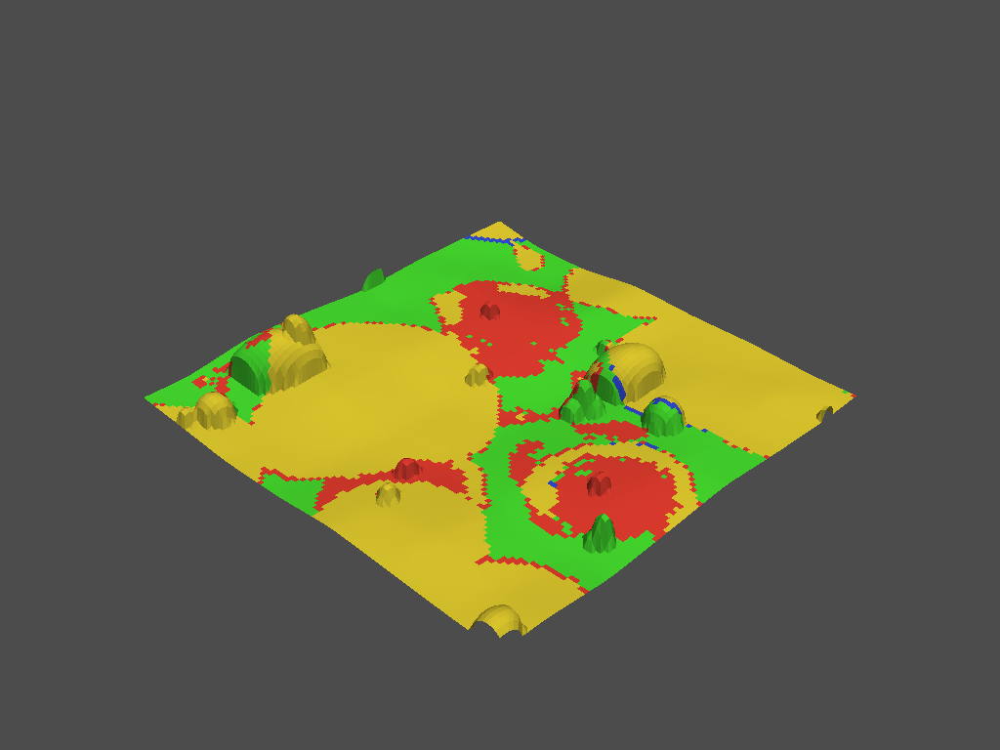

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


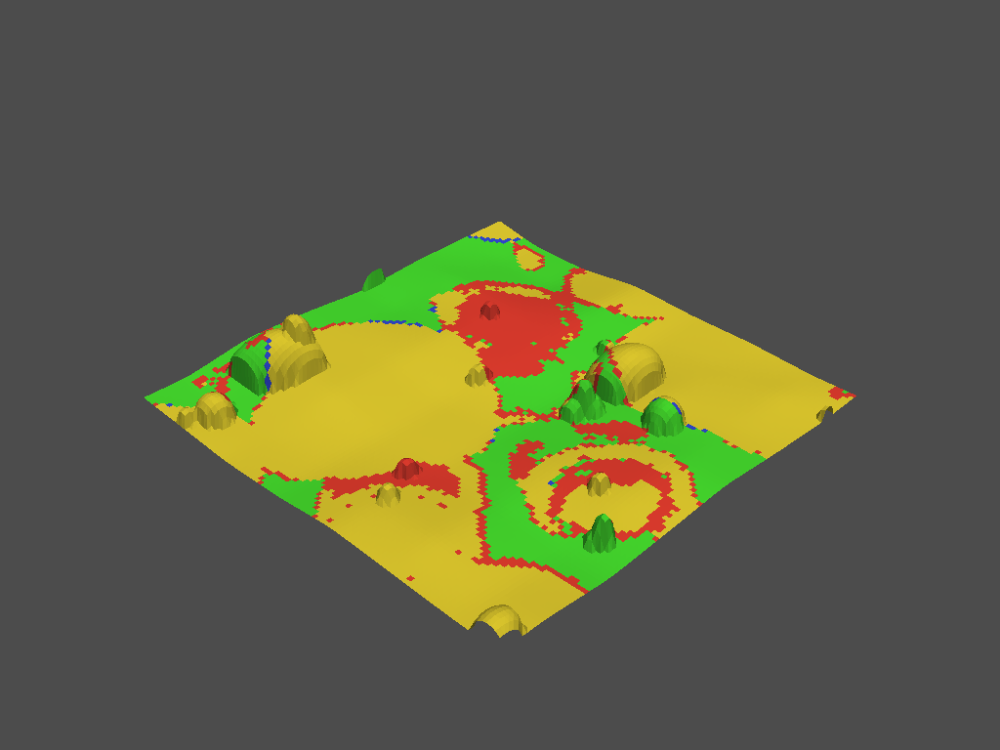

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


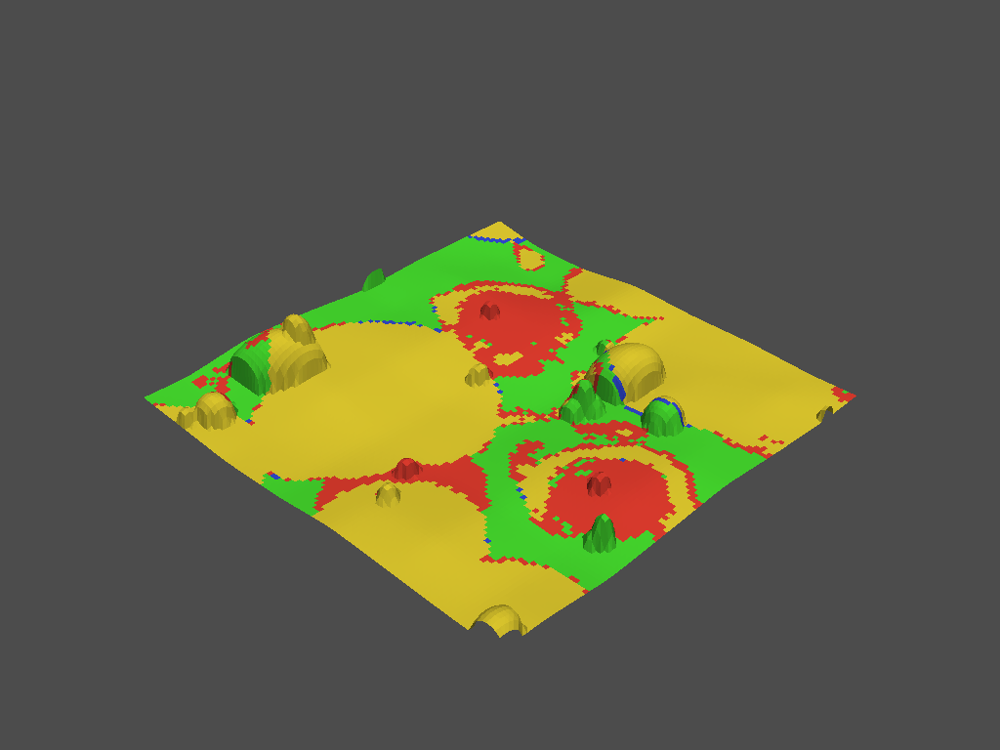

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


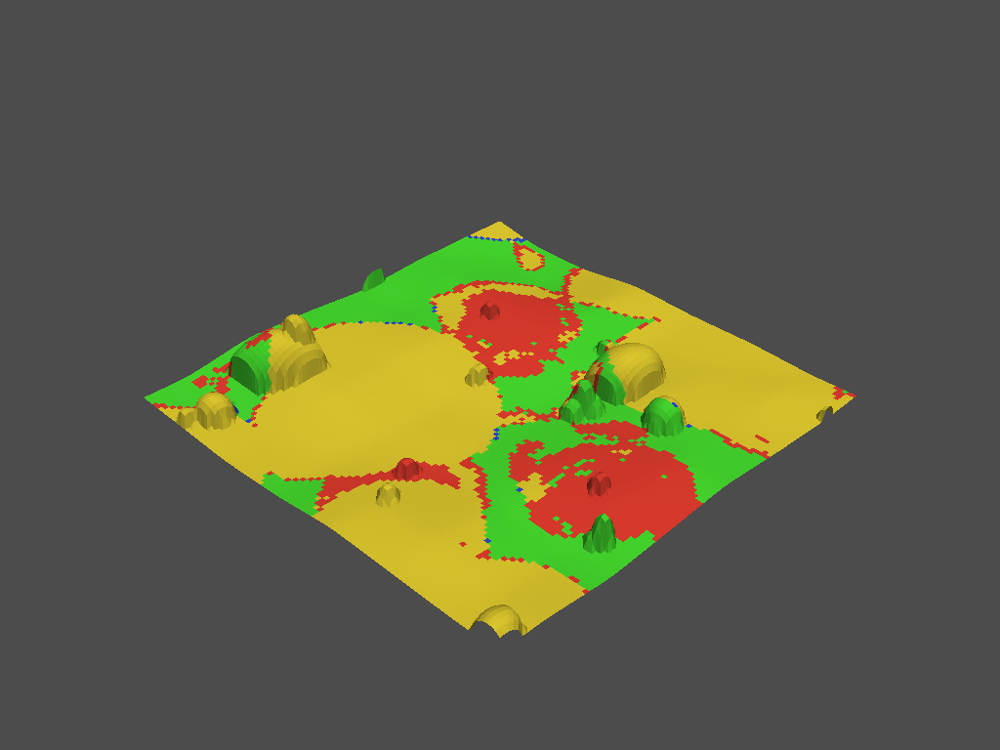

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


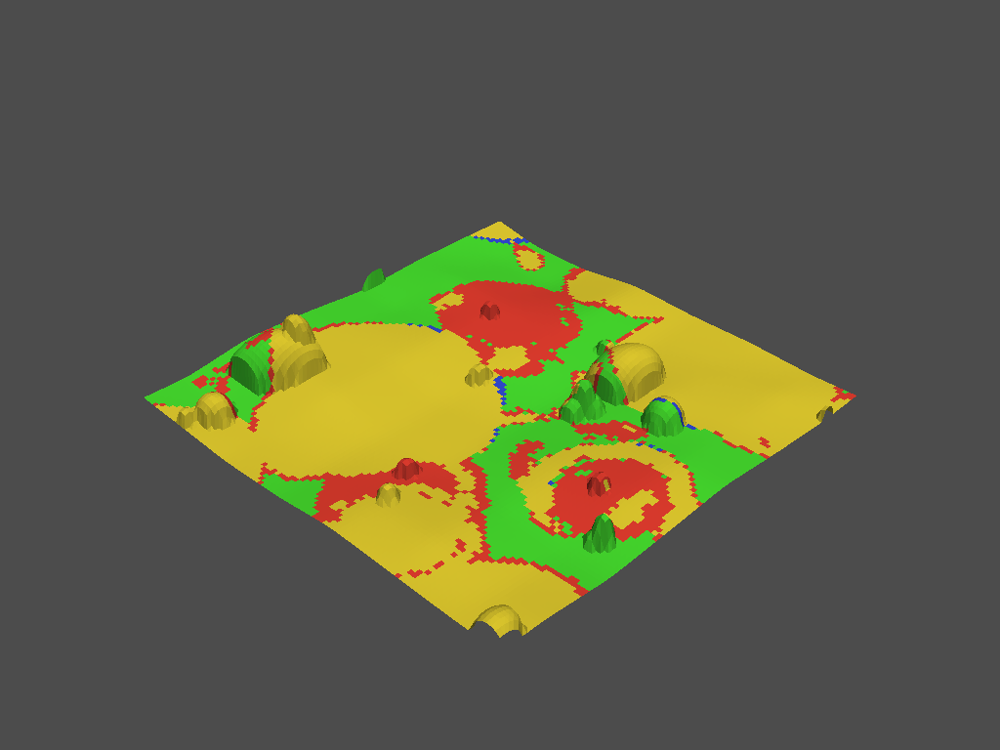

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


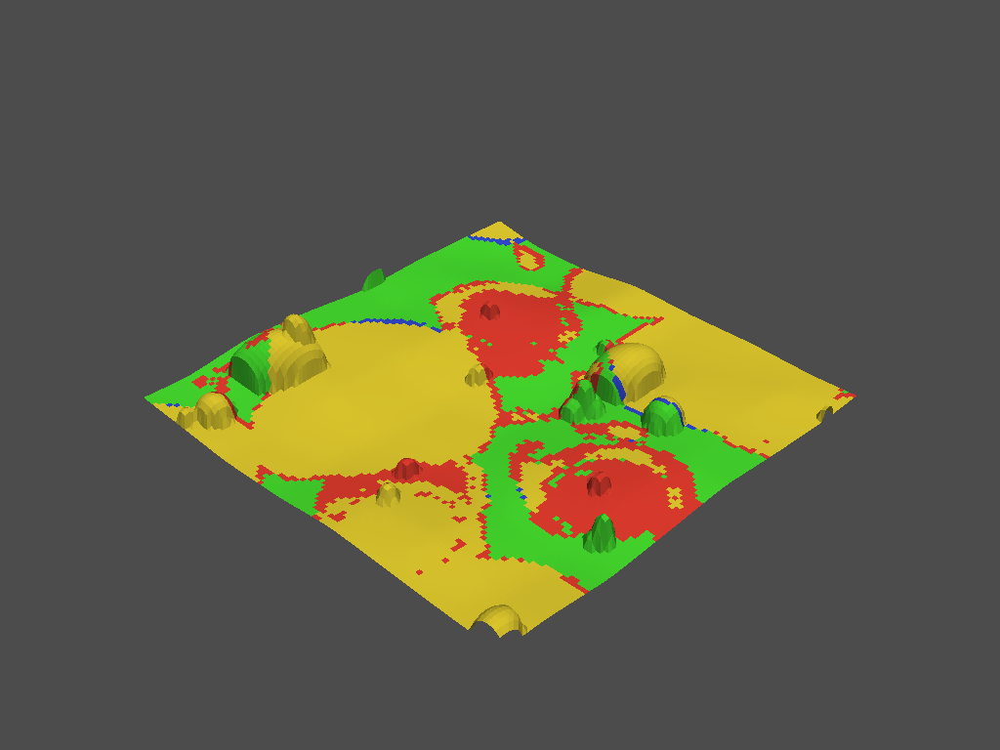

C:\Users\ktomita3\AppData\Local\Temp\ipykernel_26212\2991450551.py:88: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  images = [imageio.imread(file) for file in file_list]
c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


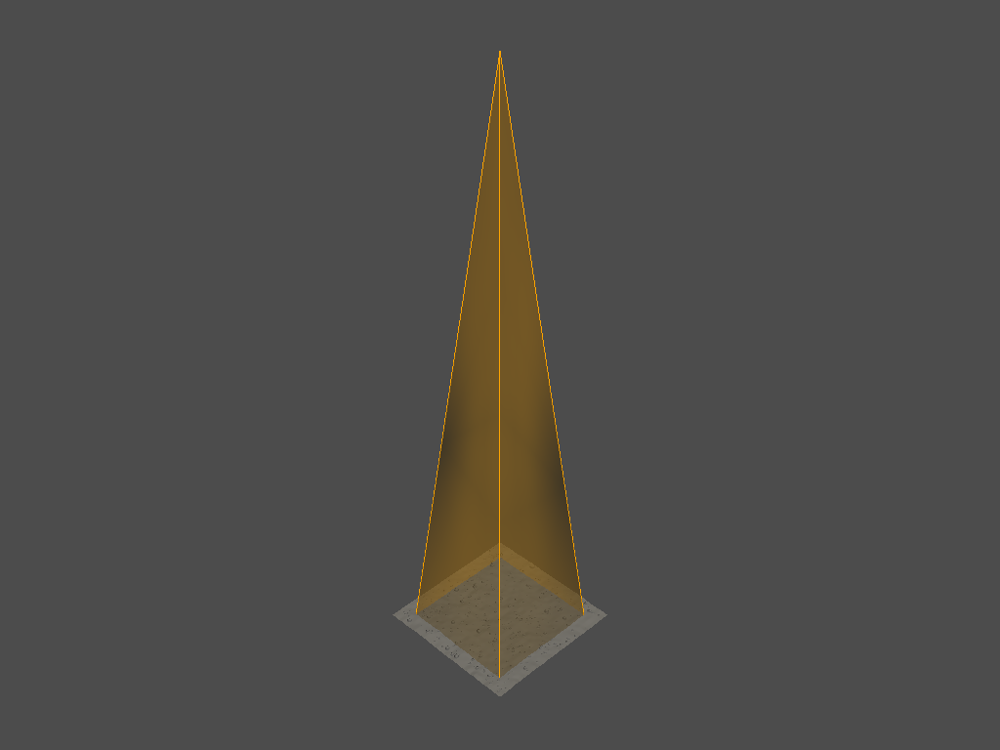

0


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


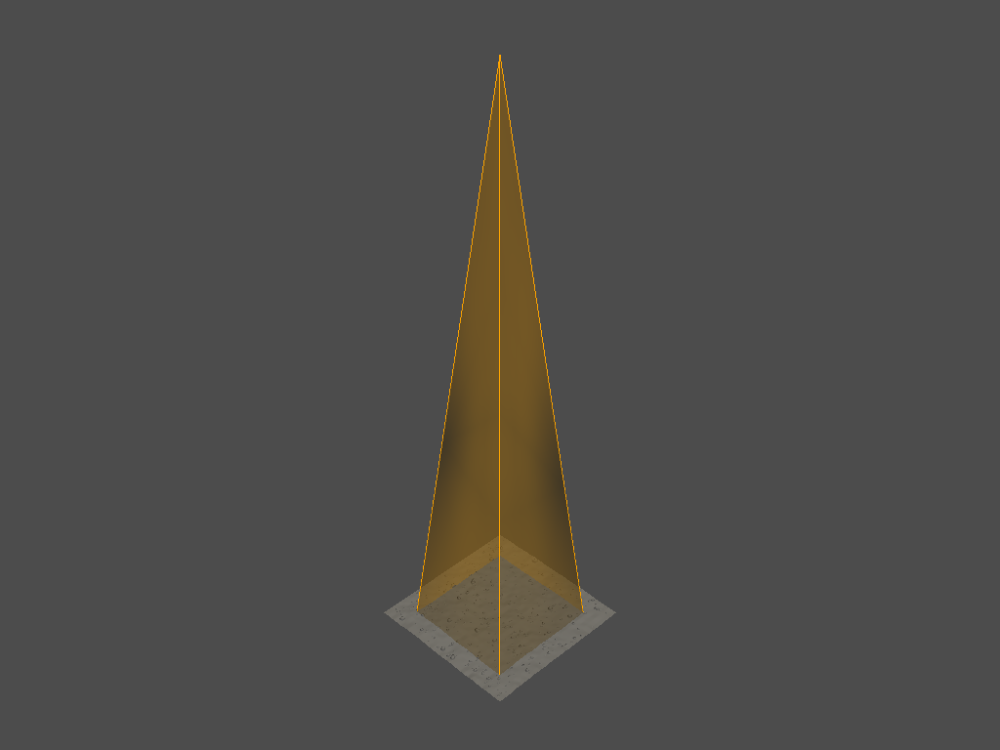

1


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


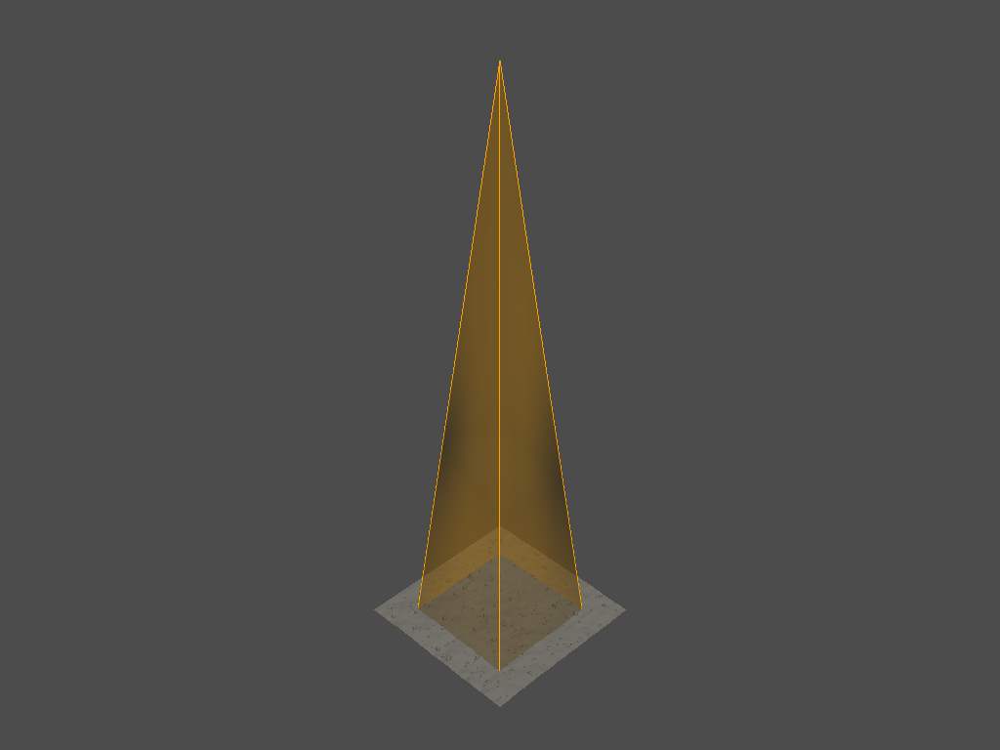

2


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


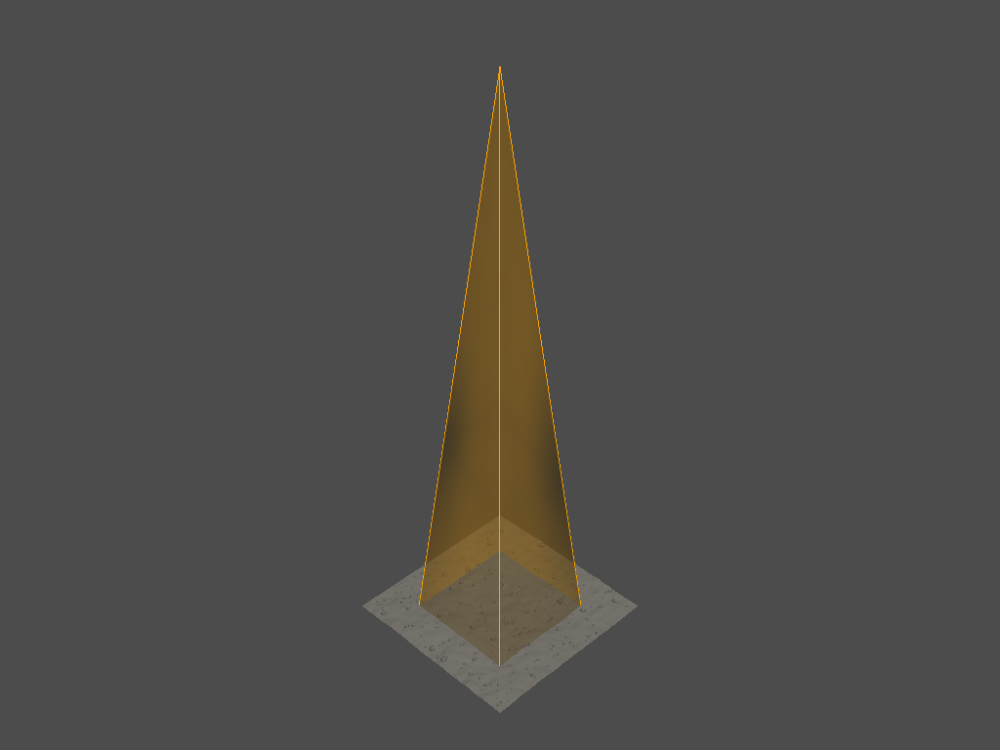

3


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


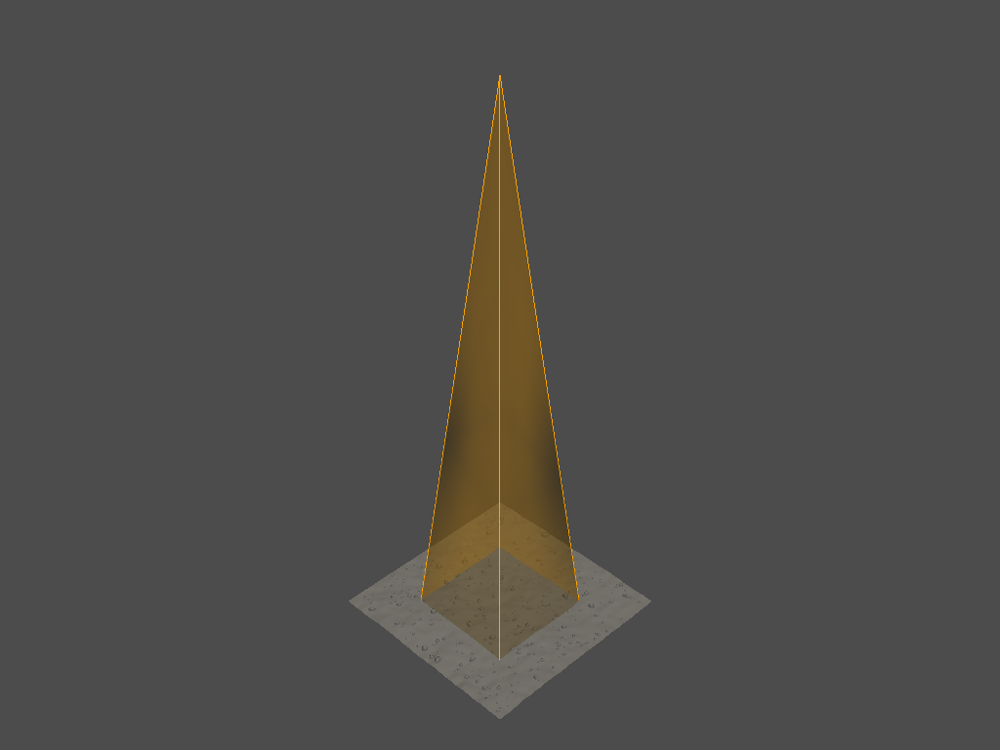

4


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


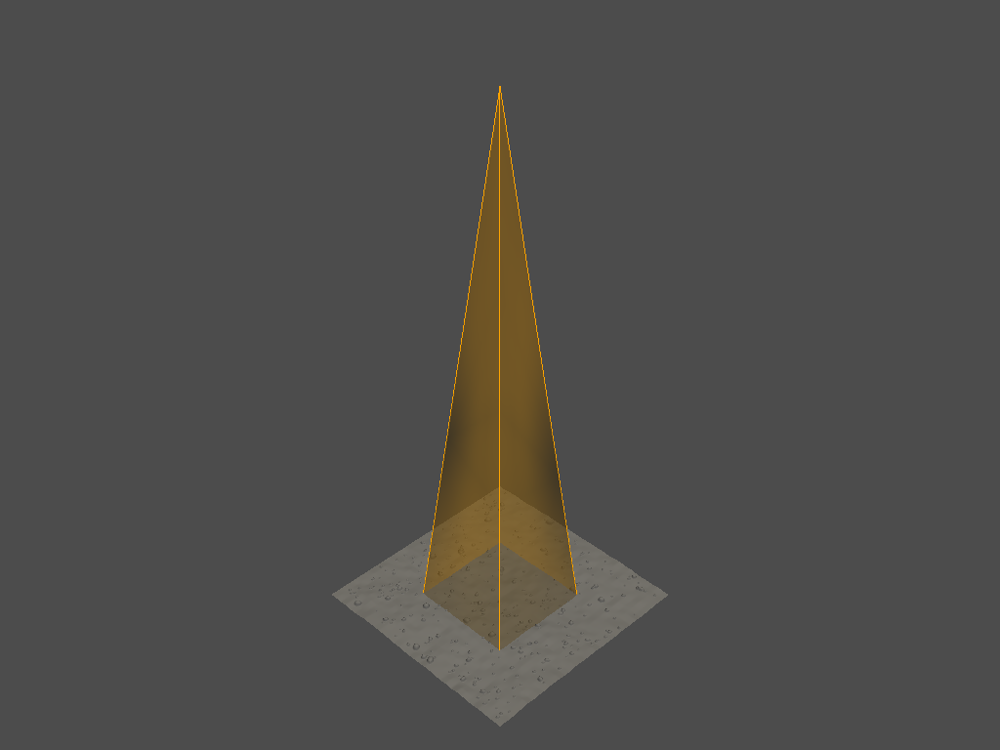

5


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


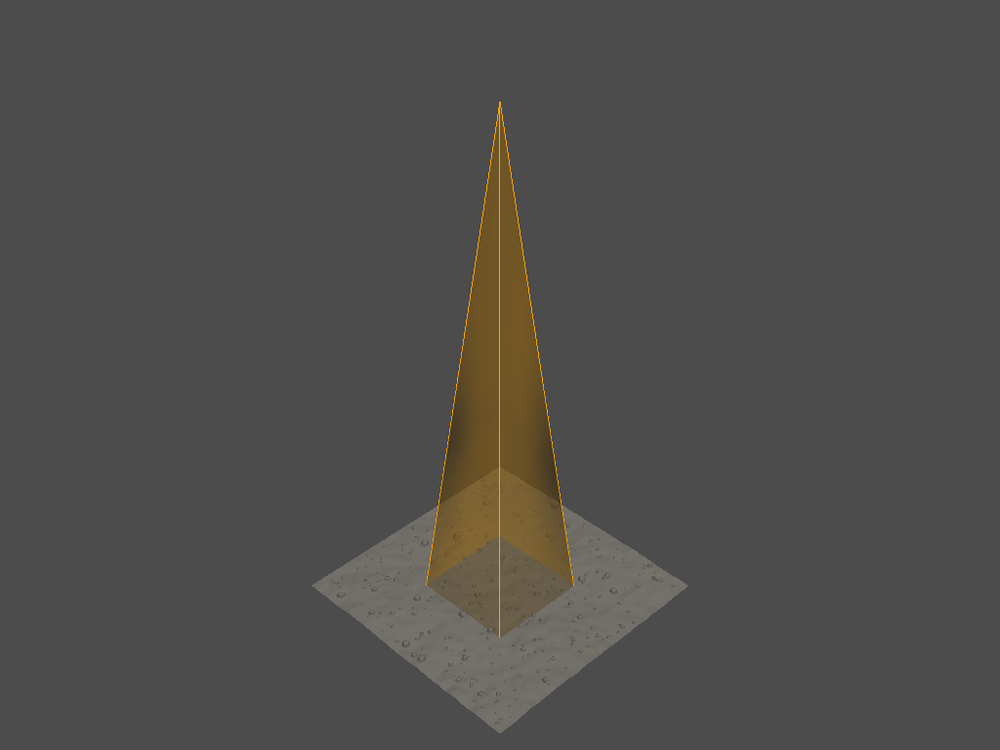

6


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


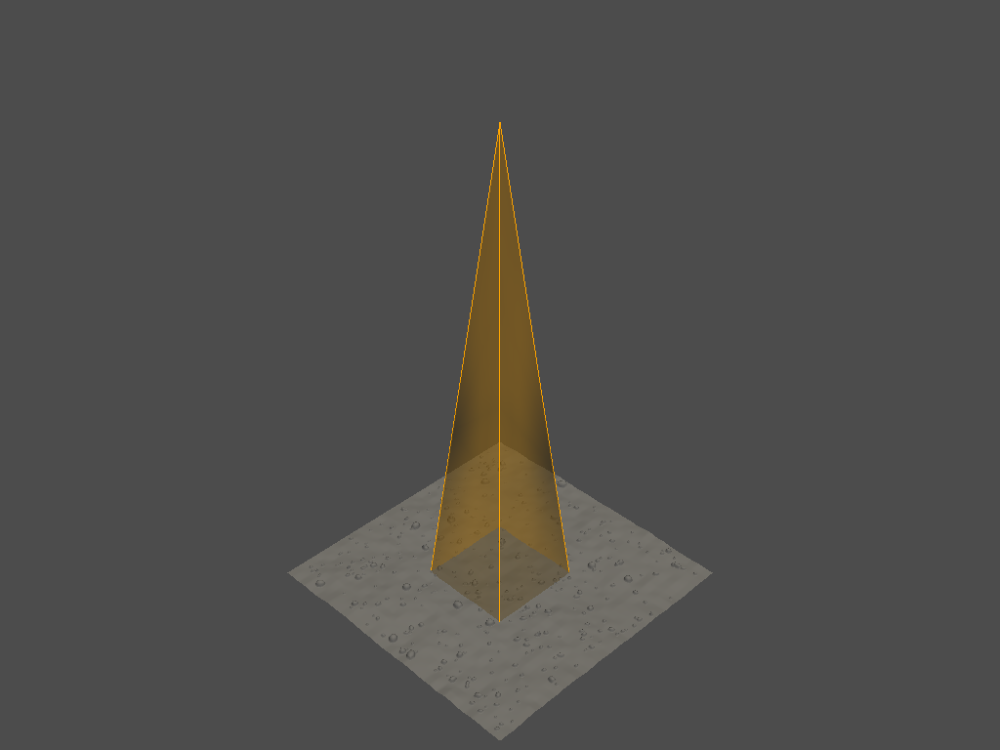

7


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


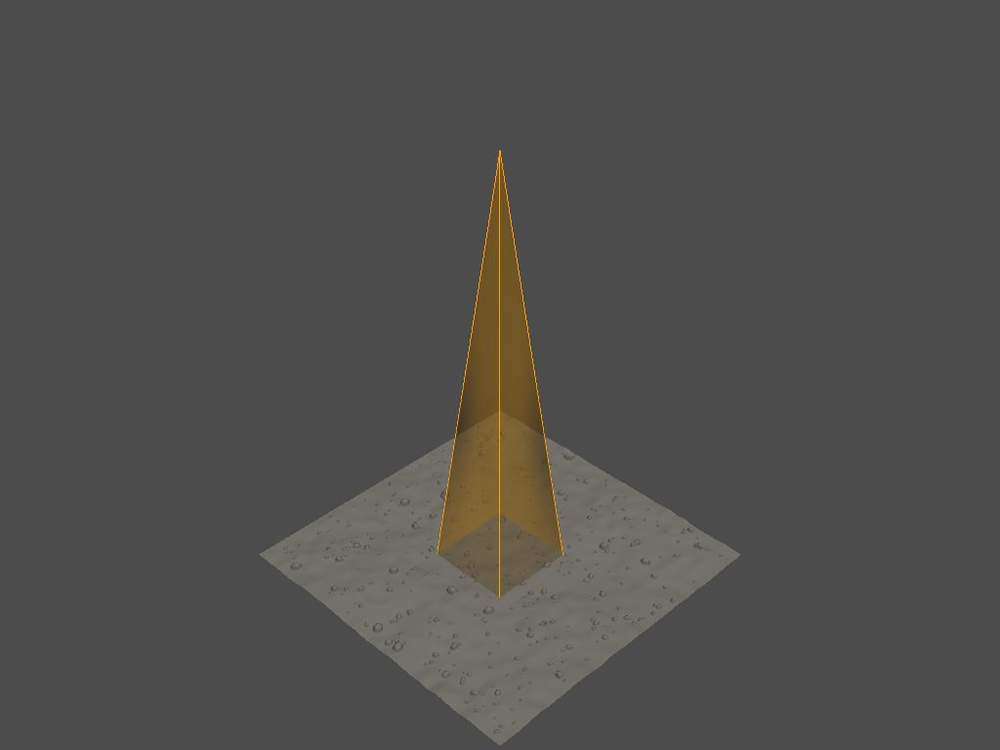

8


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


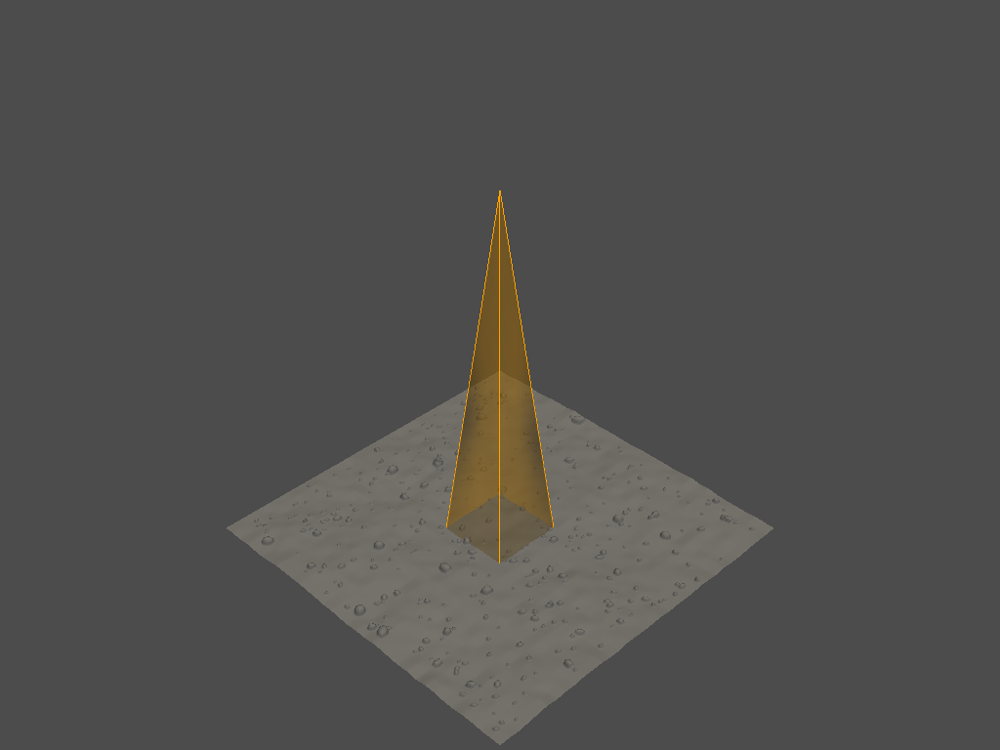

9
(4096, 3)
(256, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


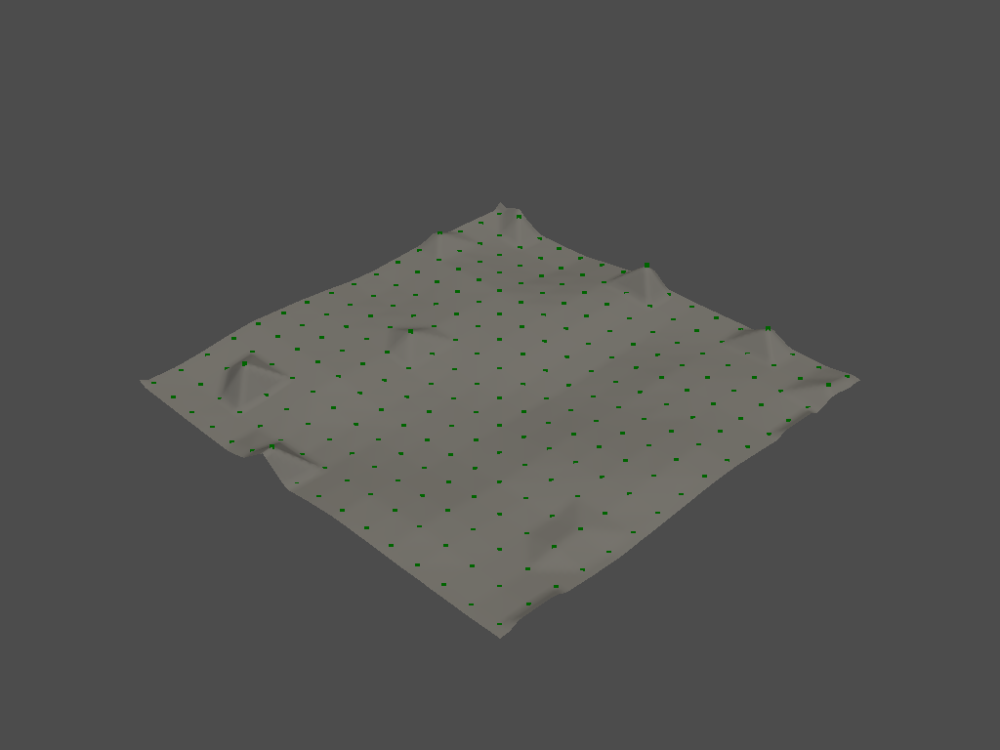

(4096, 3)
(324, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


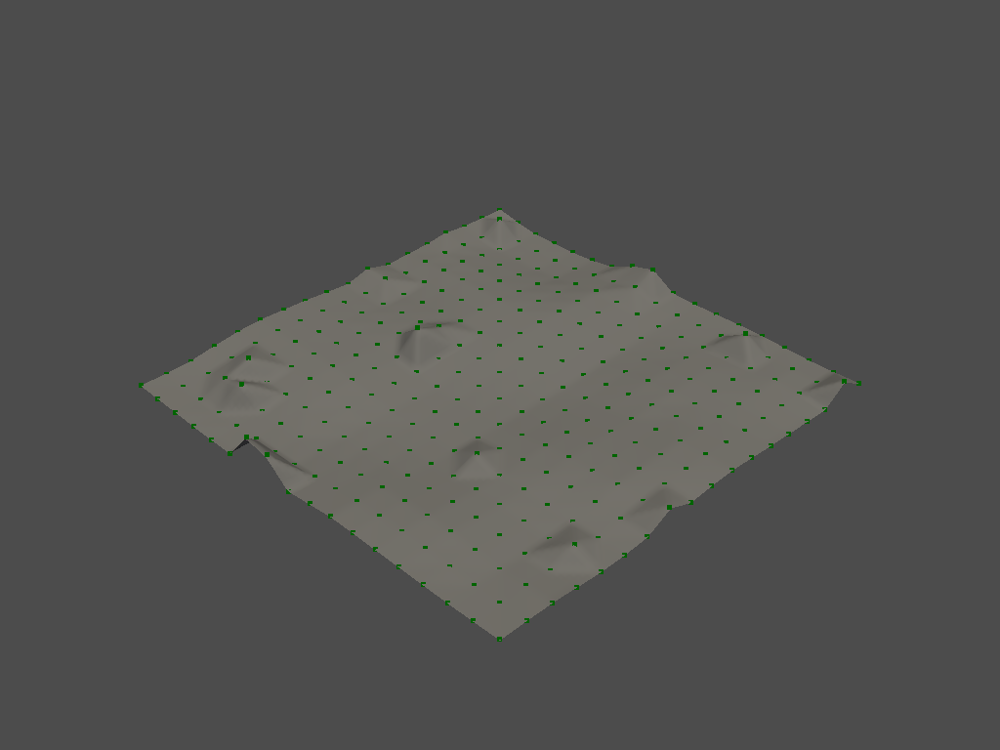

(4096, 3)
(324, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


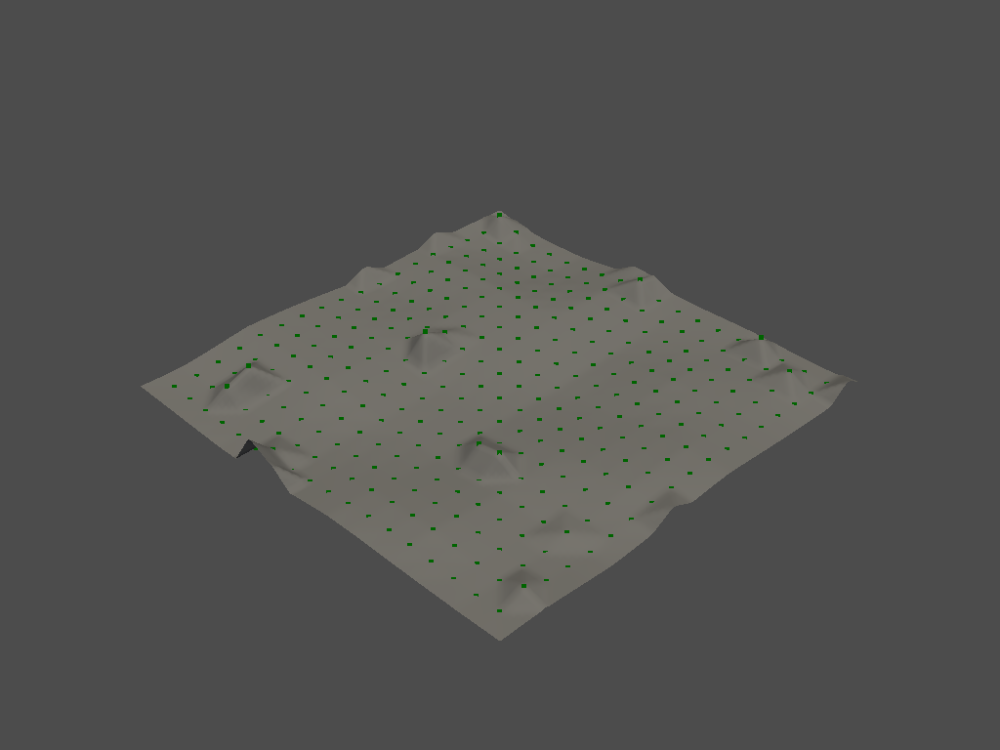

(4096, 3)
(465, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


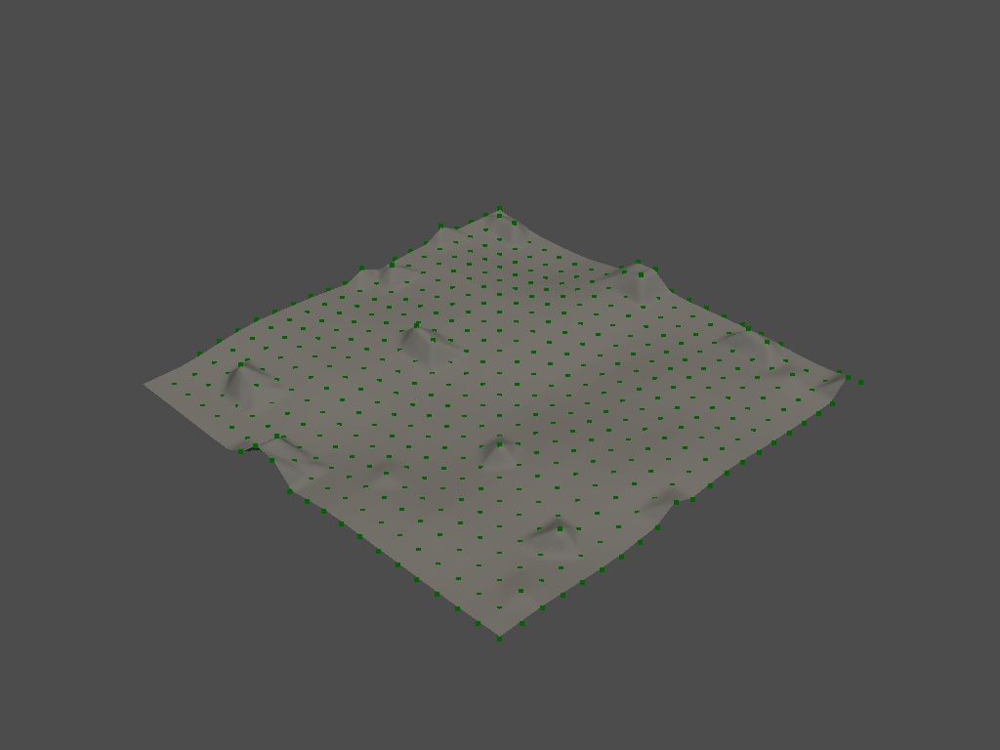

(4096, 3)
(576, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


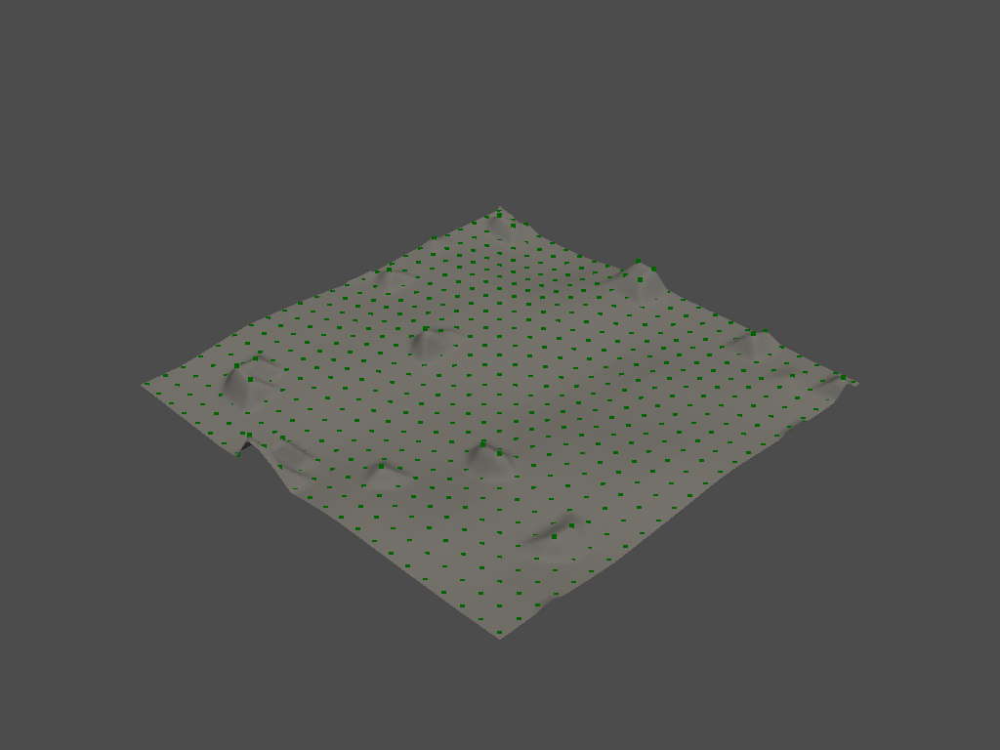

(4096, 3)
(756, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


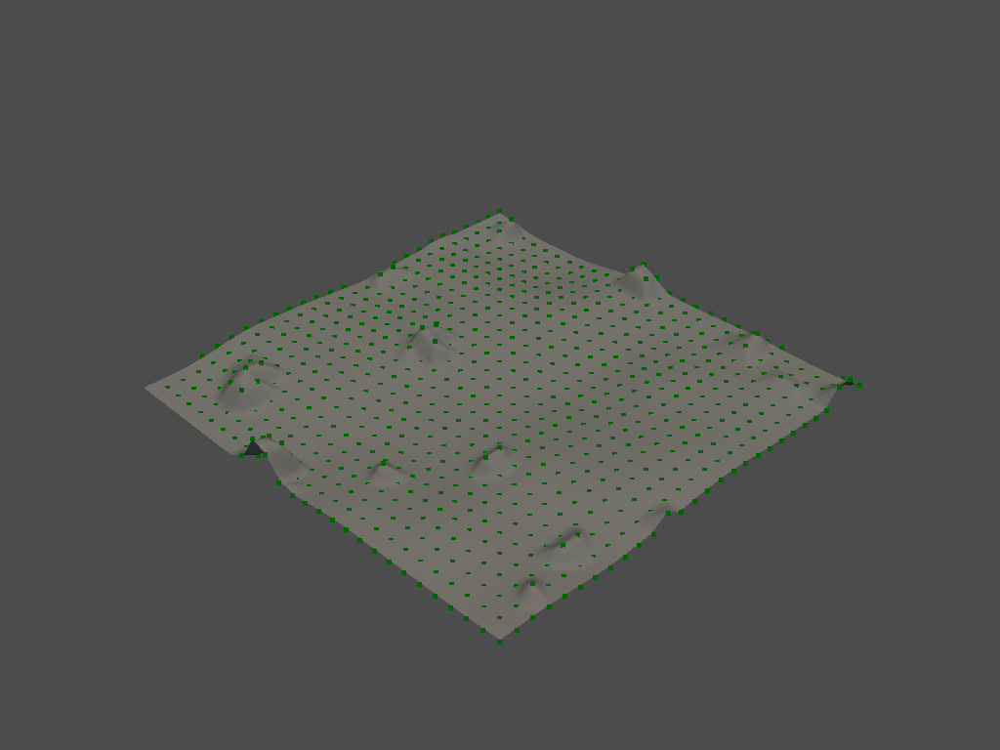

(4096, 3)
(1024, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


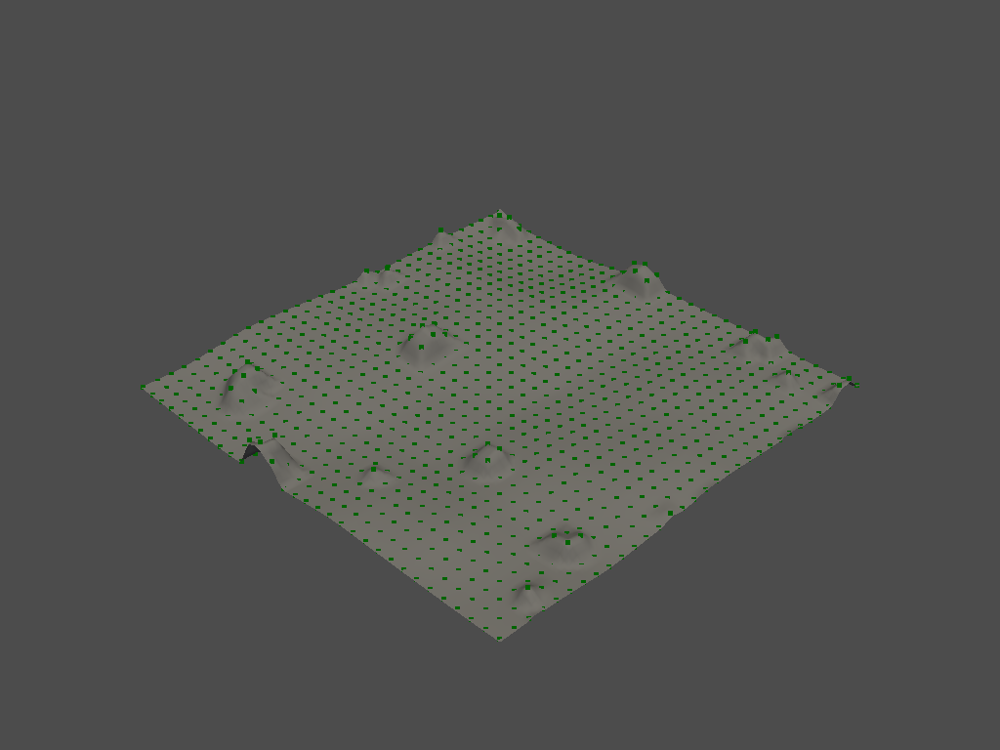

(4096, 3)
(1444, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


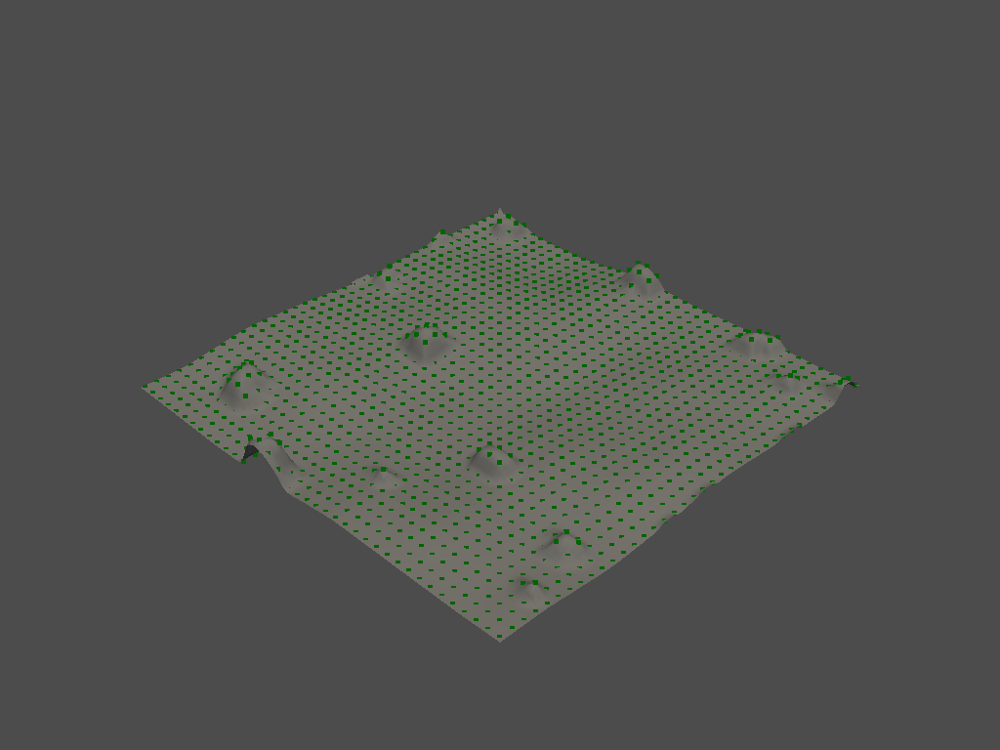

(4096, 3)
(2304, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


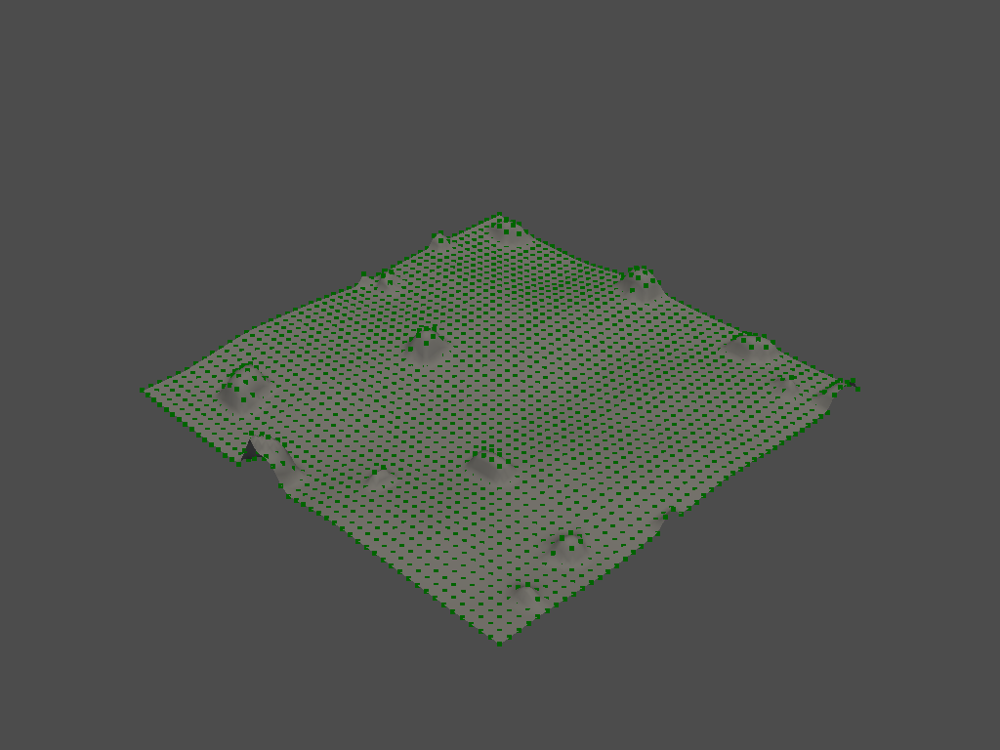

(4095, 3)
(4035, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


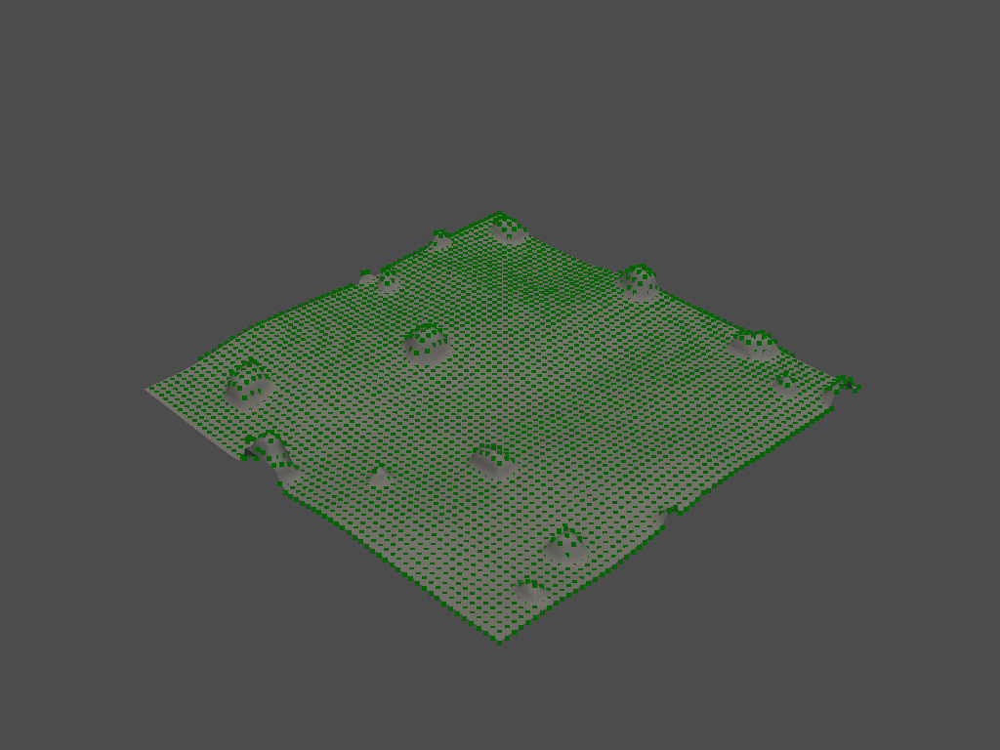

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


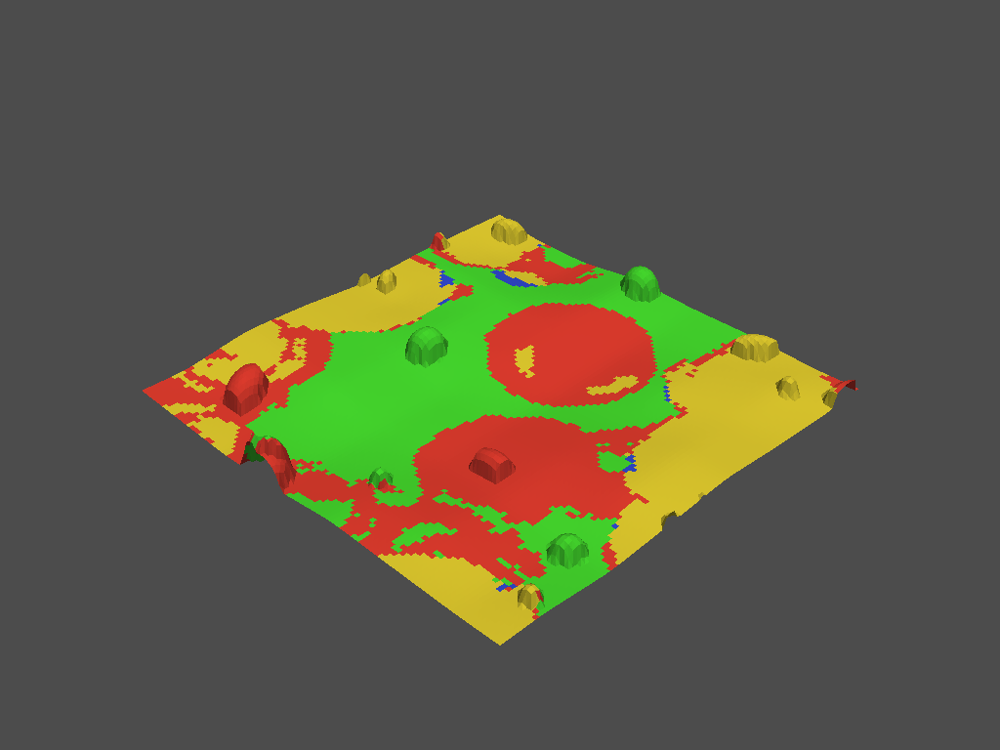

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


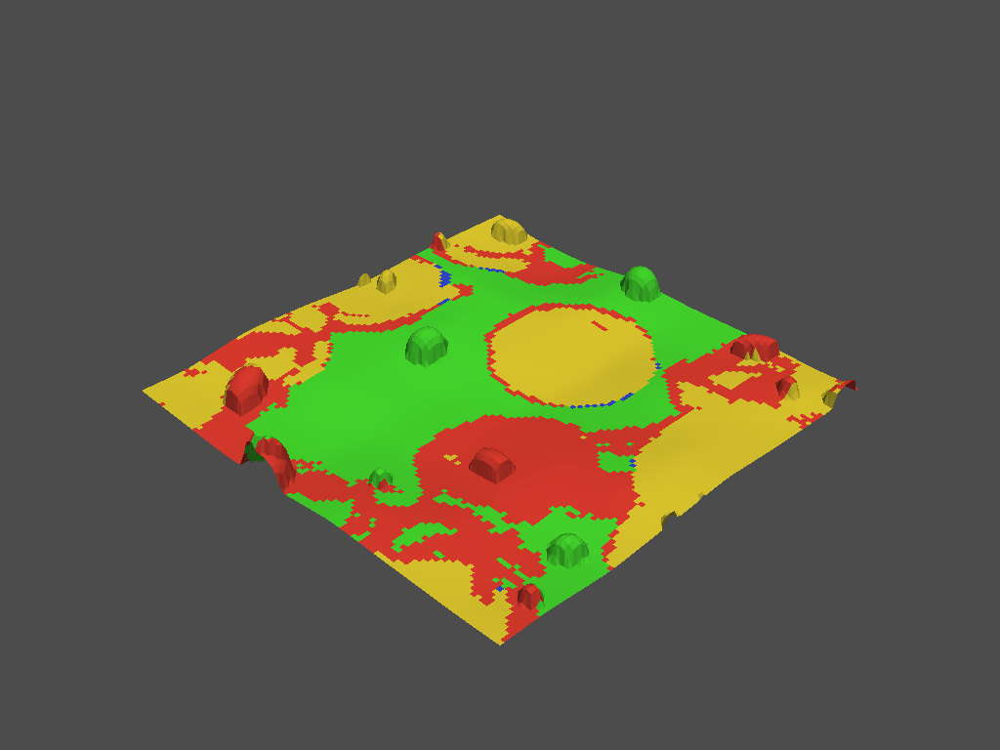

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


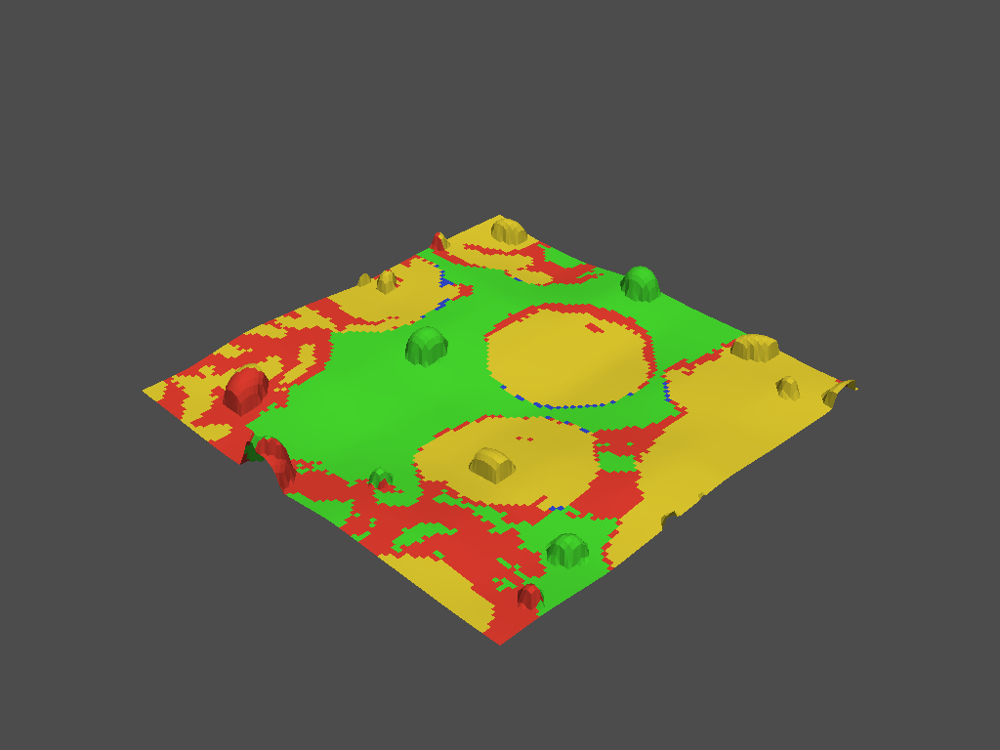

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


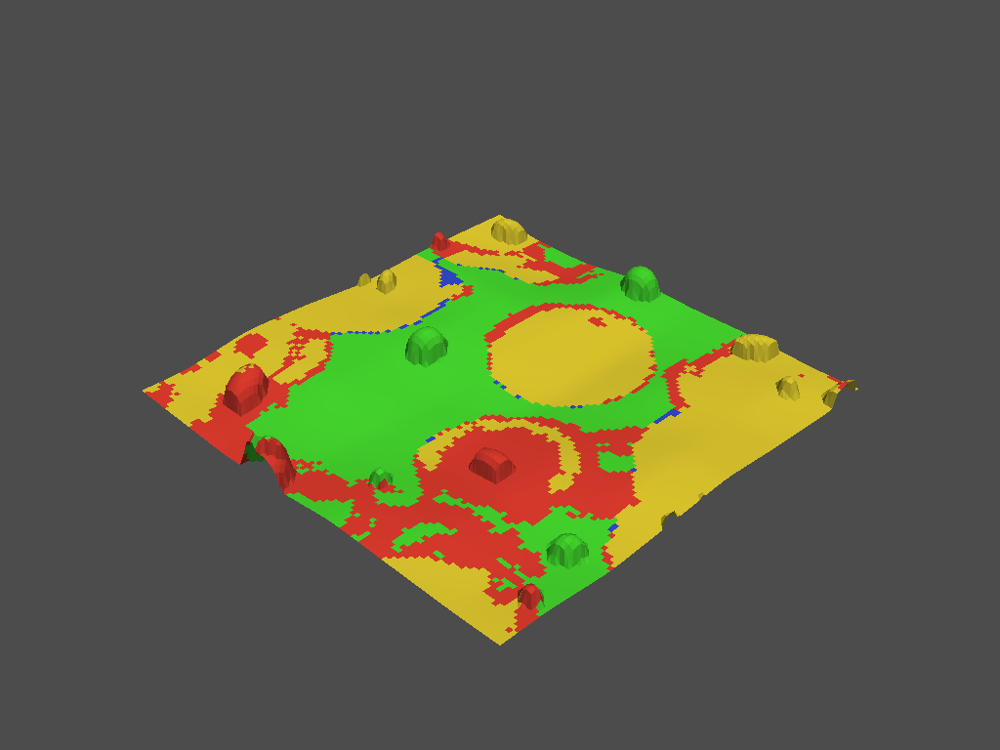

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


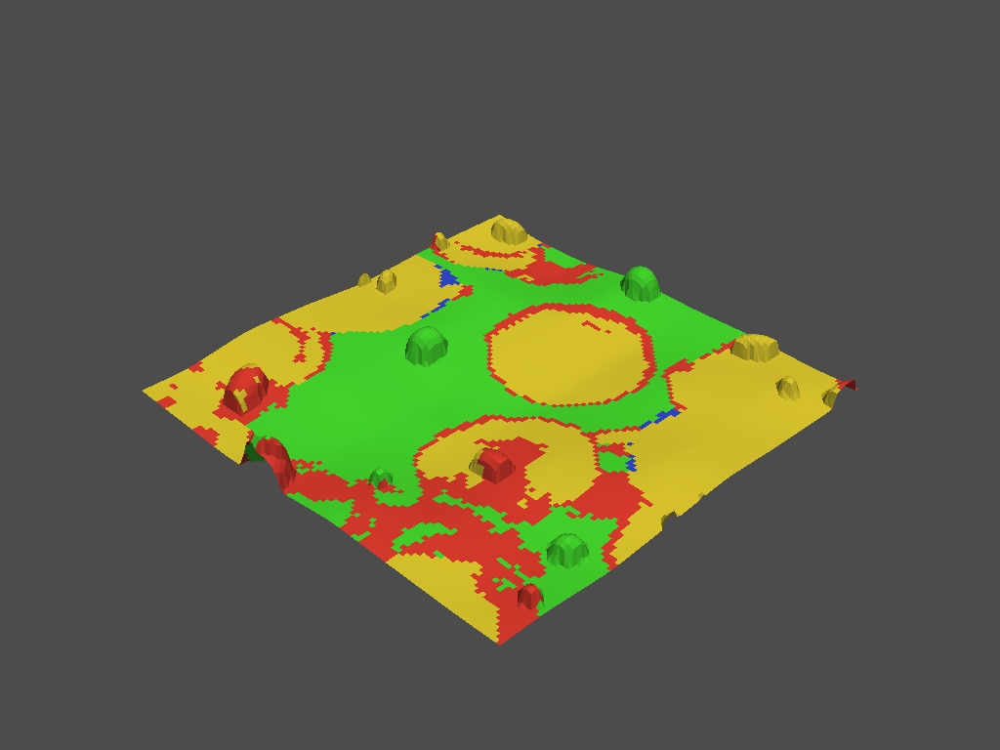

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


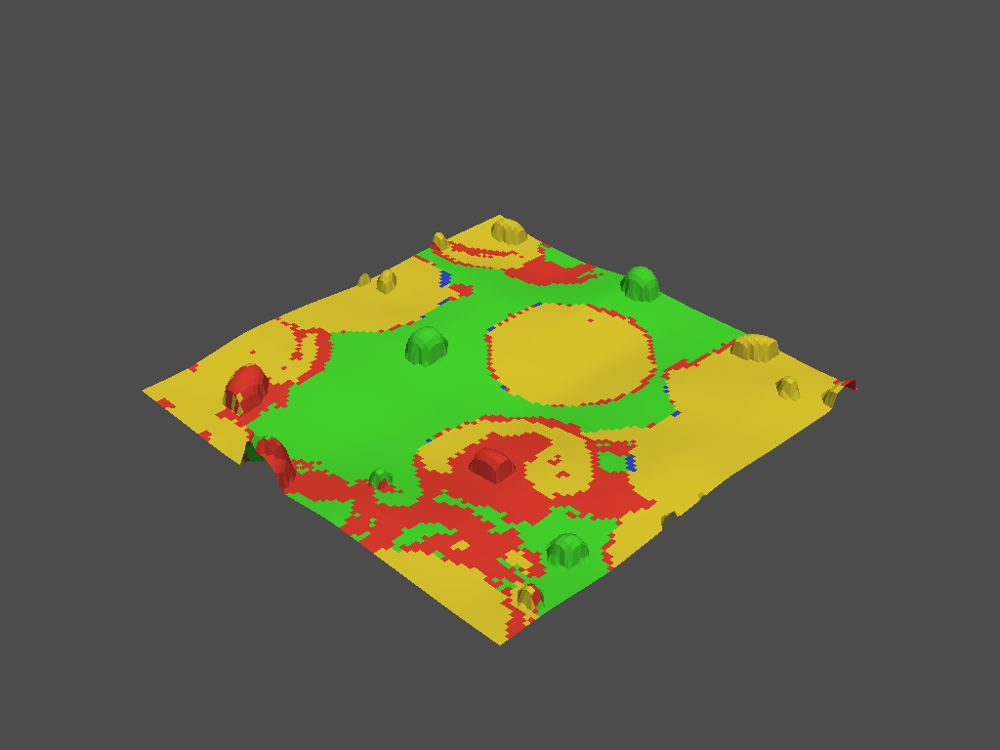

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


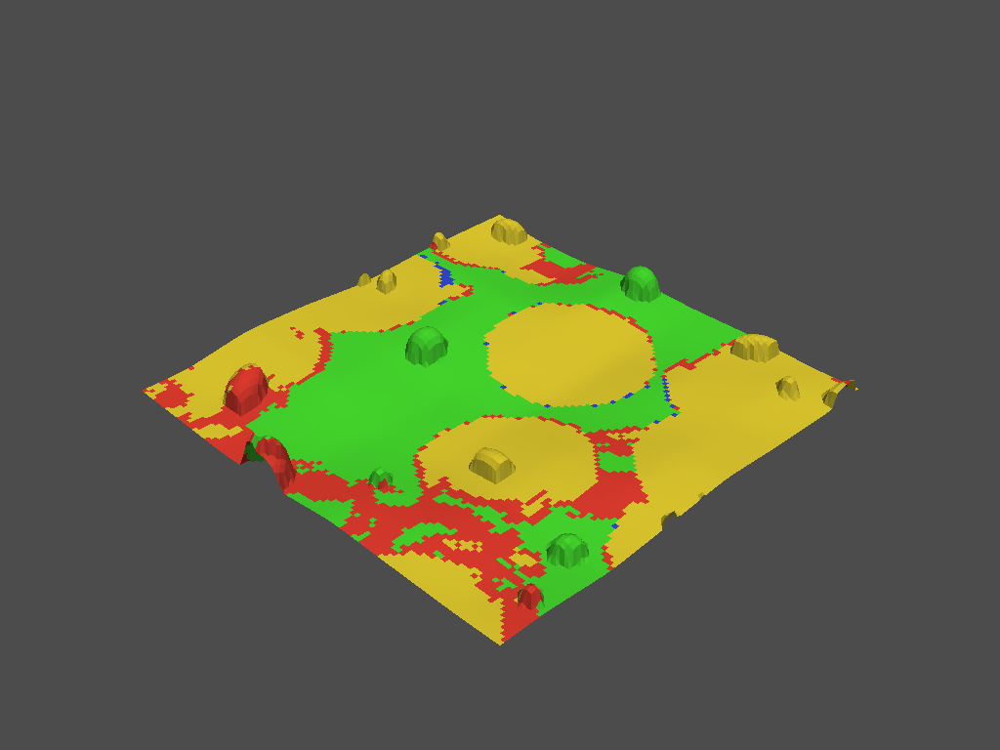

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


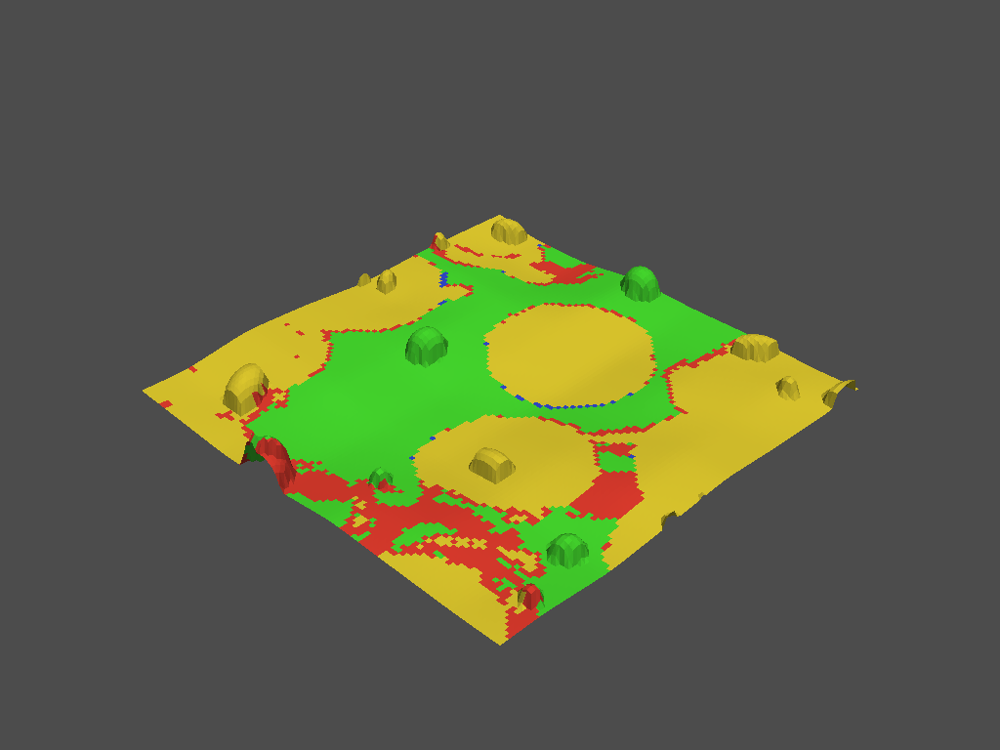

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


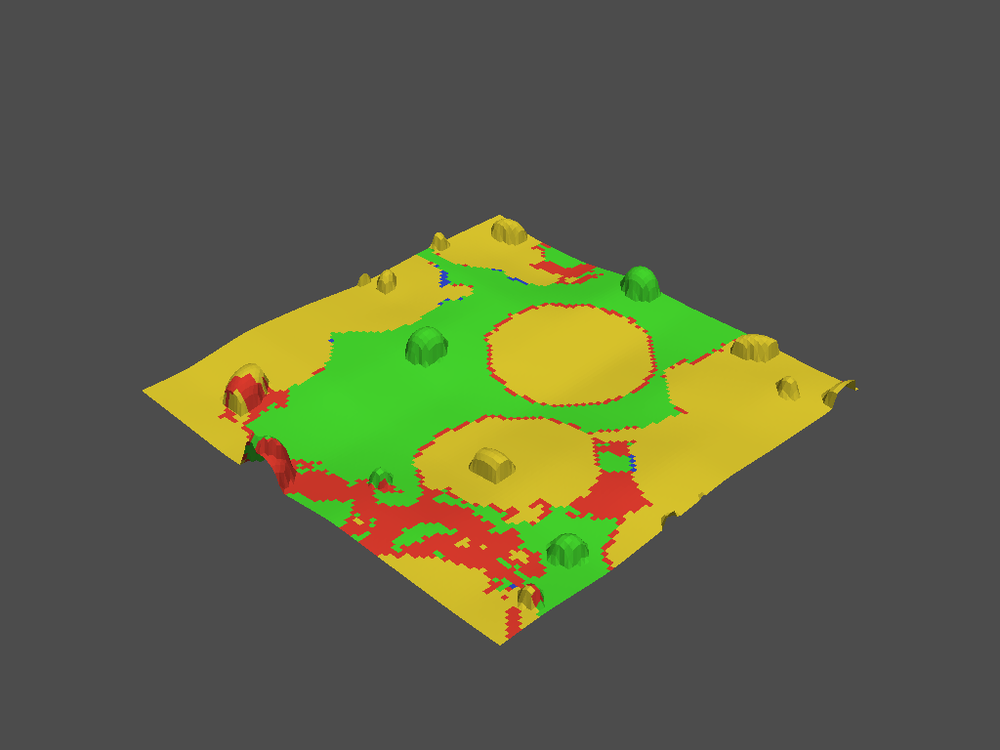

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


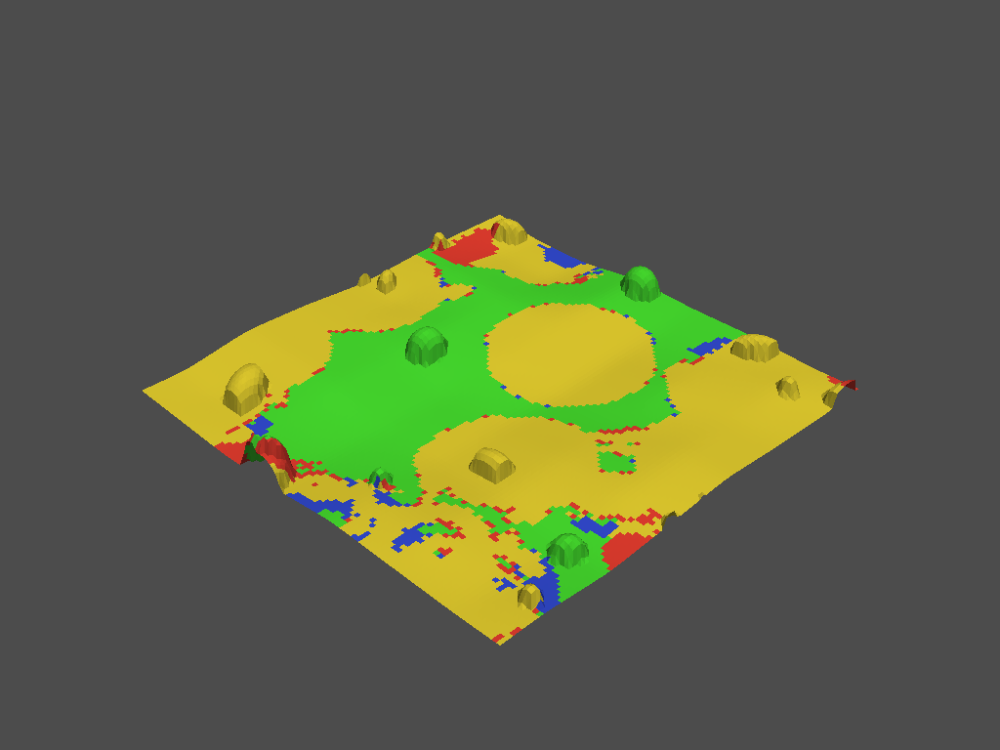

C:\Users\ktomita3\AppData\Local\Temp\ipykernel_26212\2991450551.py:88: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  images = [imageio.imread(file) for file in file_list]
c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


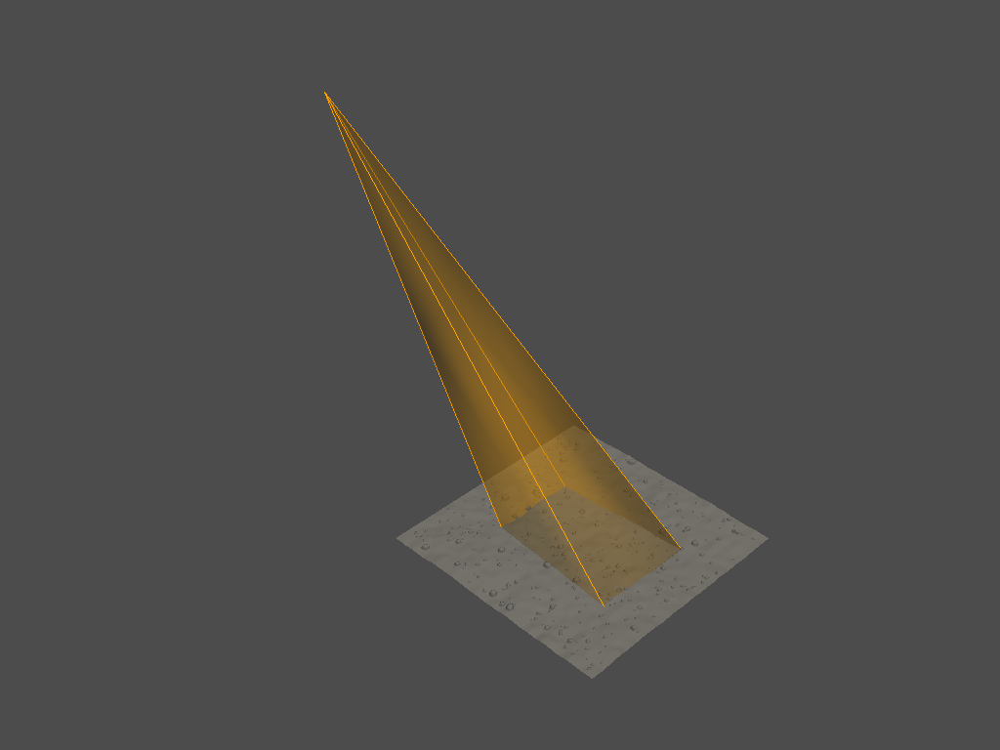

0


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


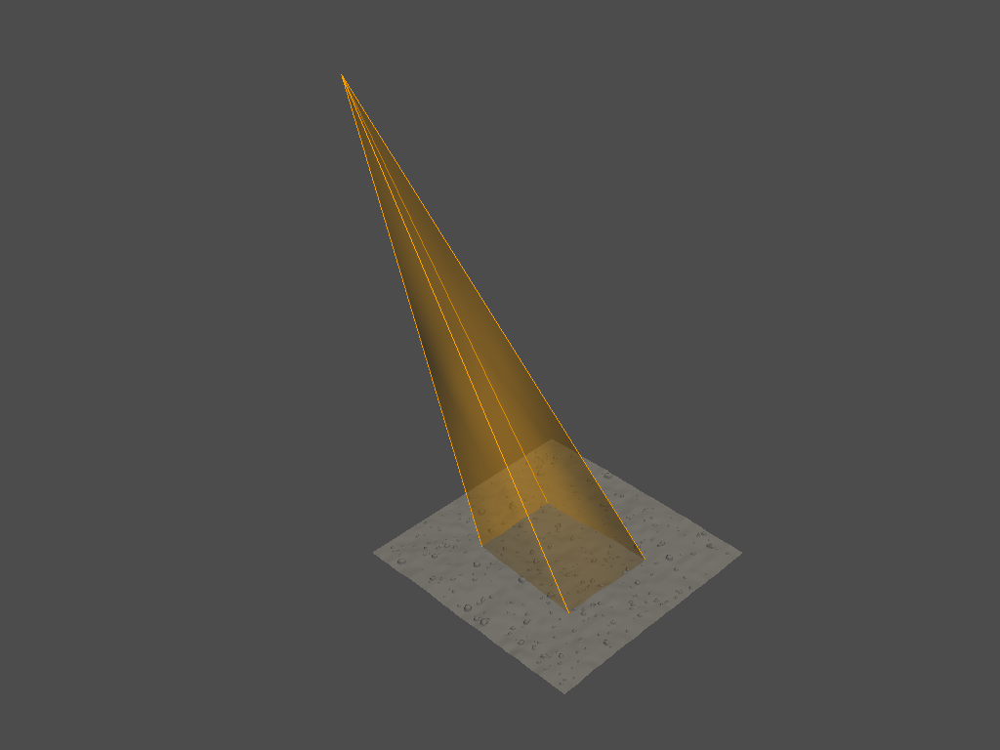

1


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


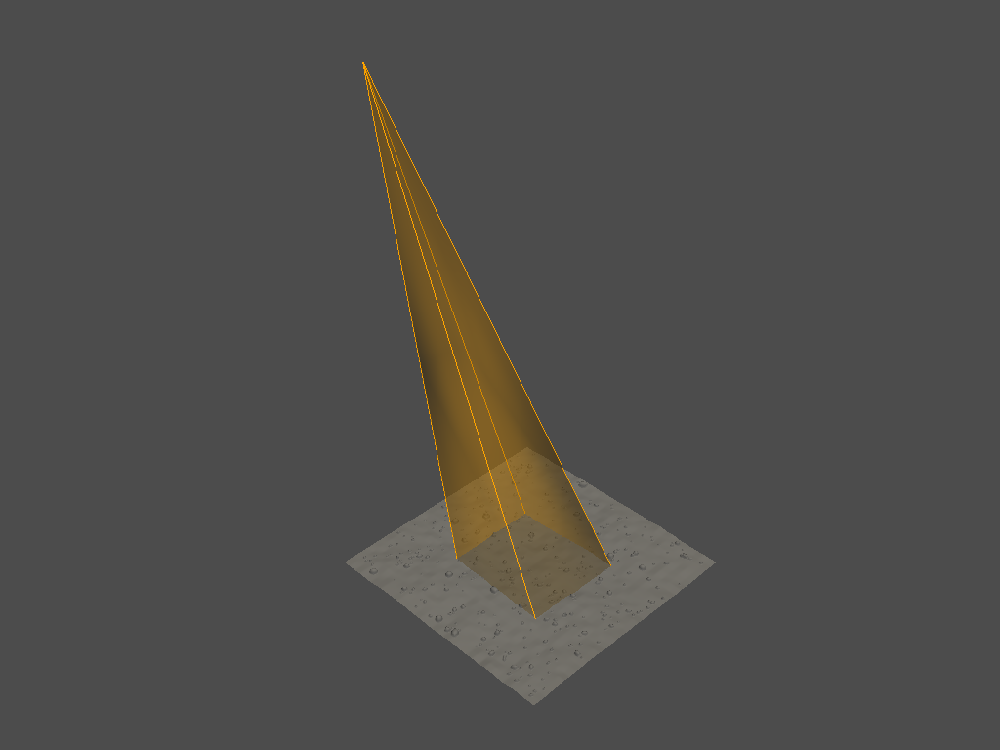

2


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


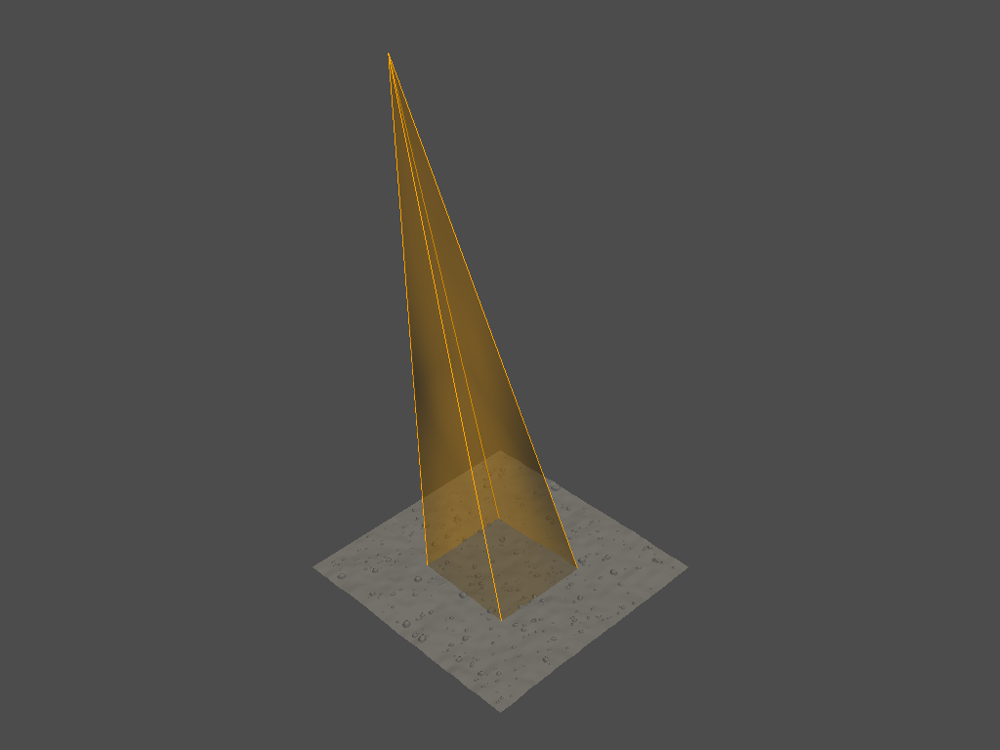

3


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


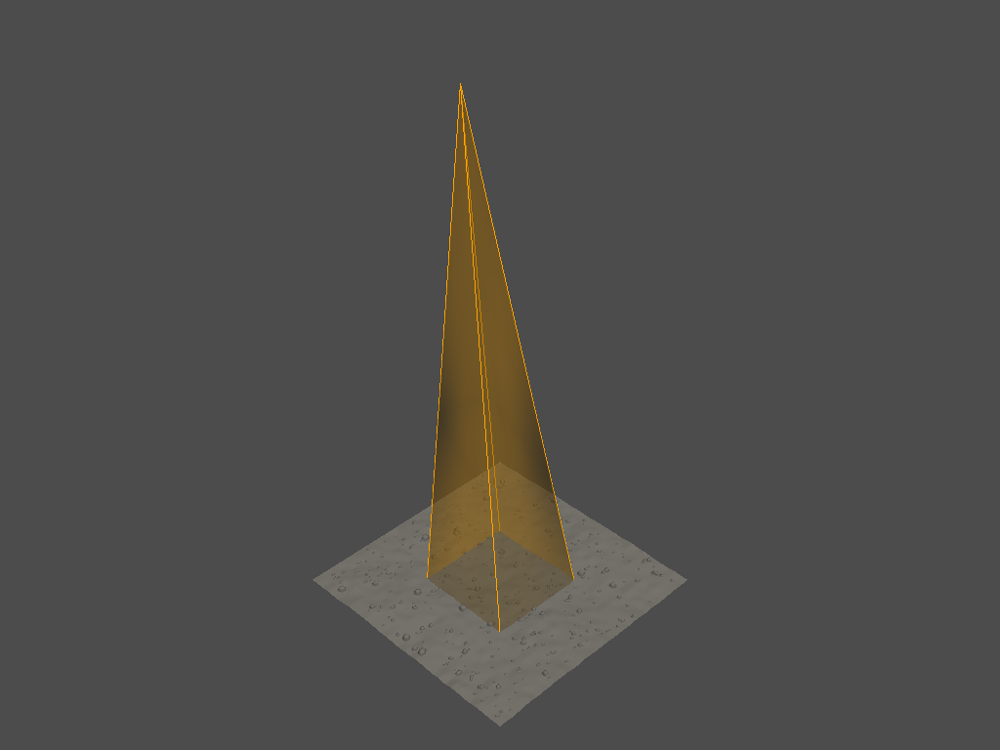

4


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


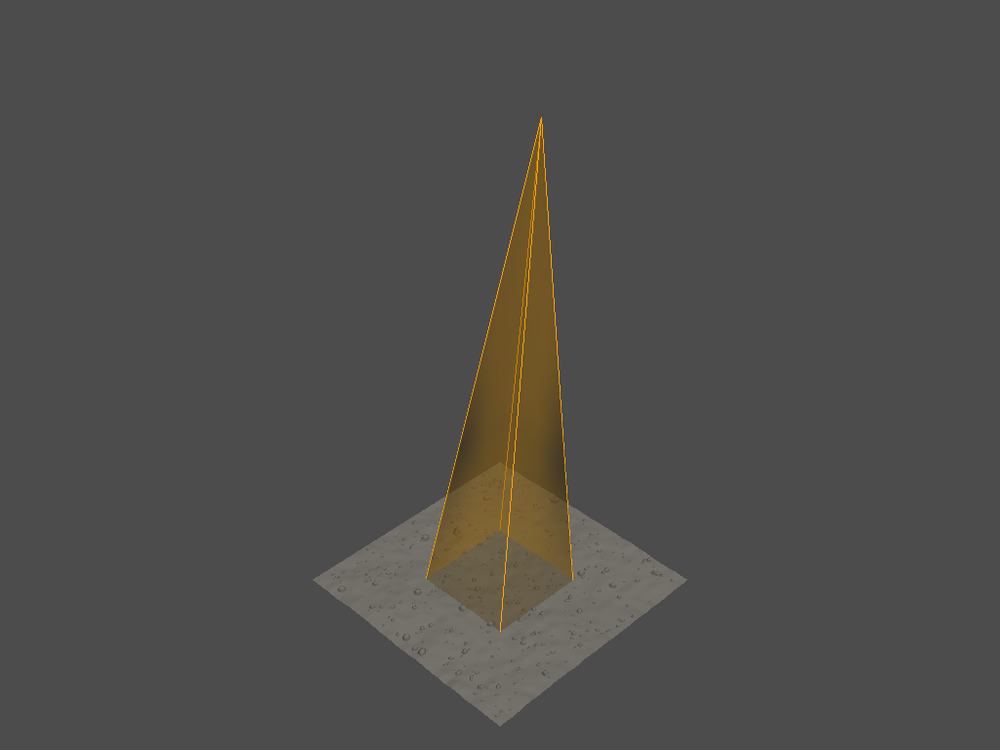

5


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


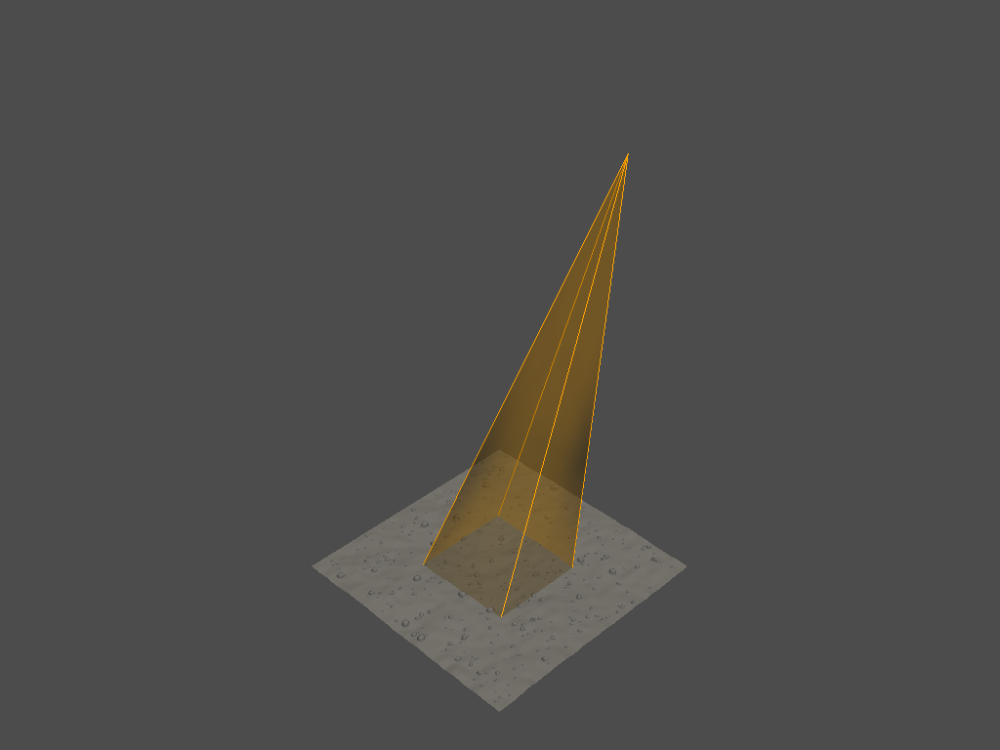

6


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


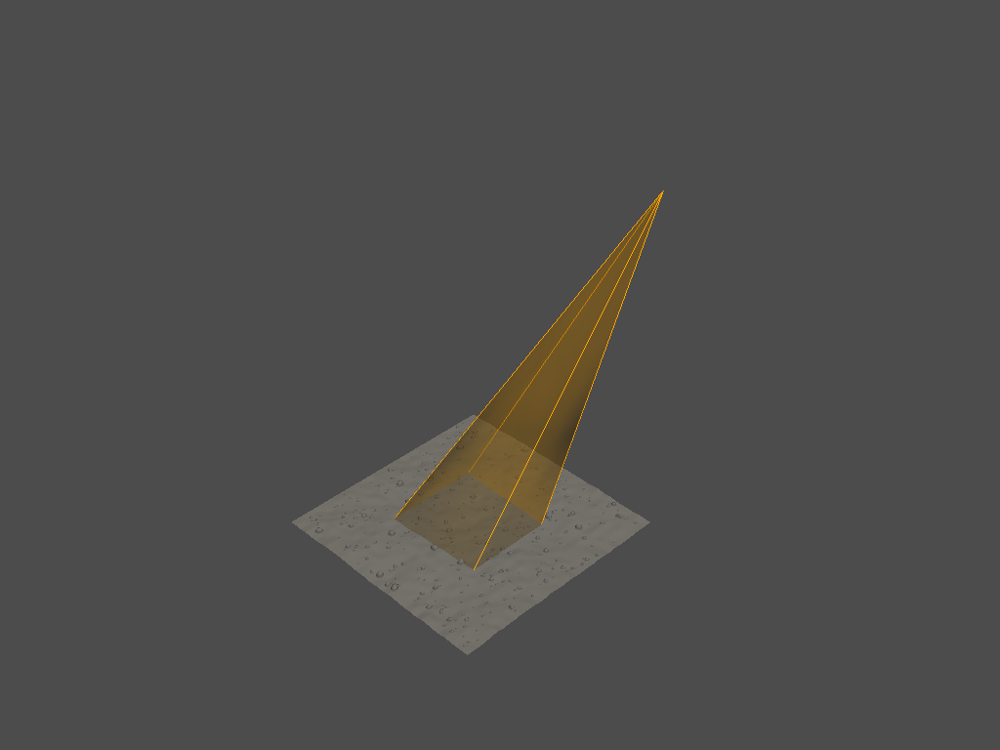

7


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


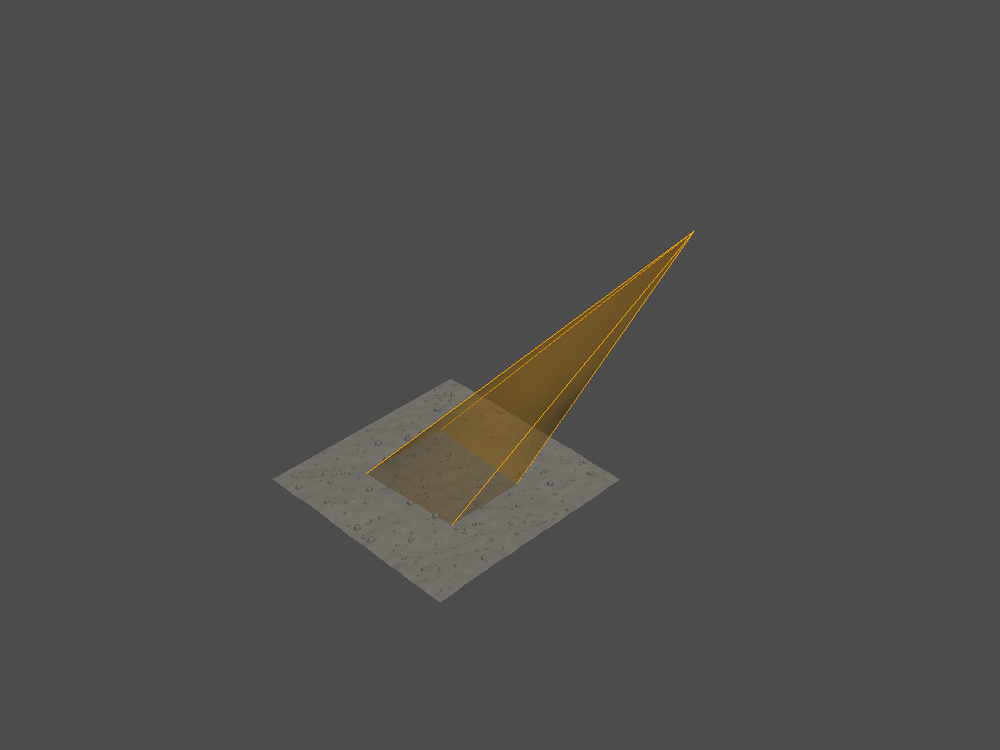

8


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


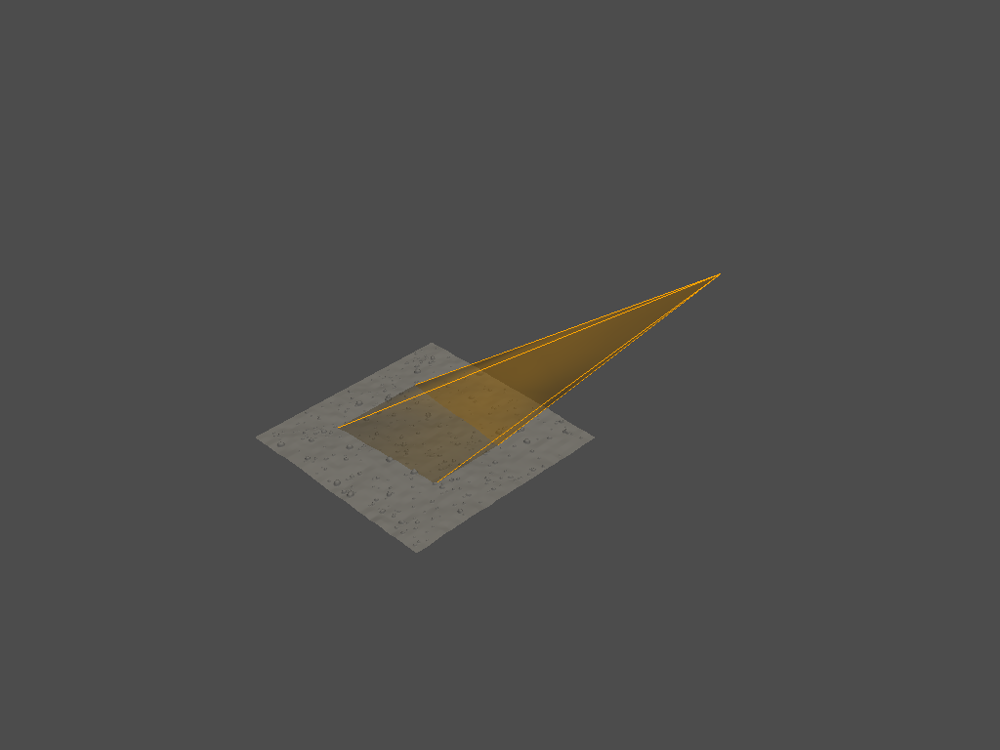

9
(4096, 3)
(703, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


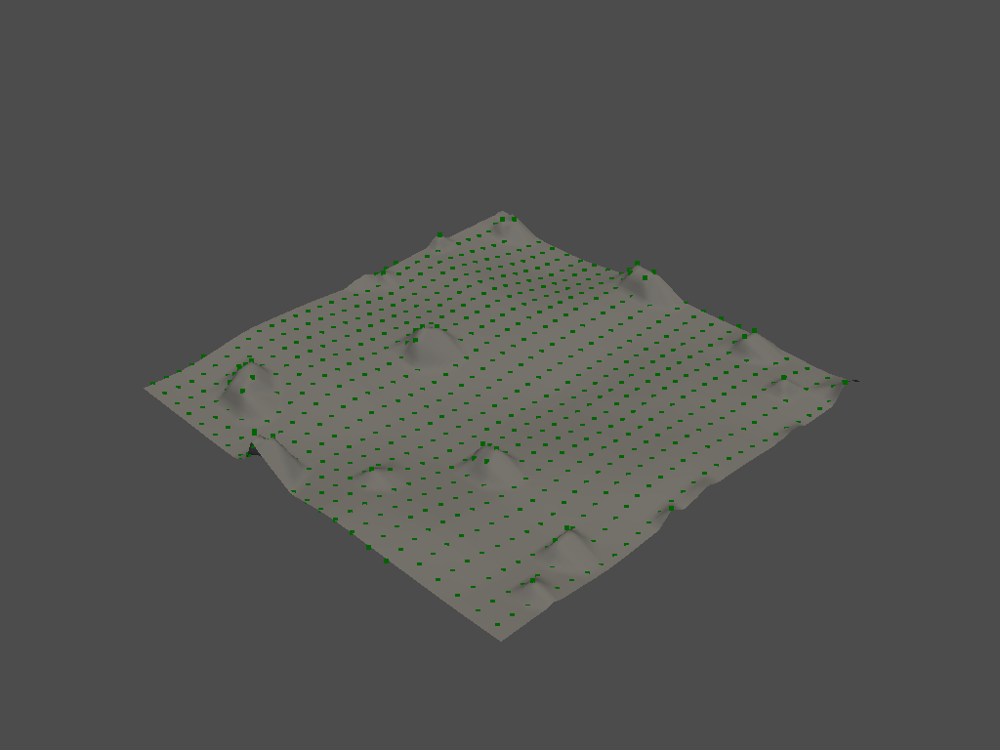

(4096, 3)
(821, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


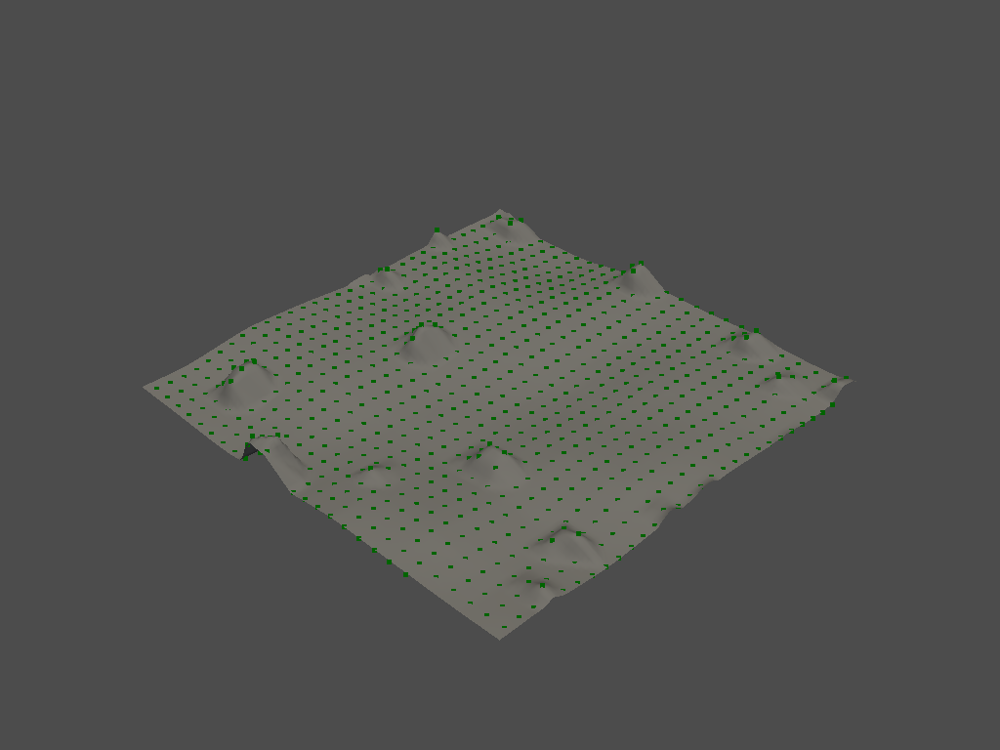

(4096, 3)
(914, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


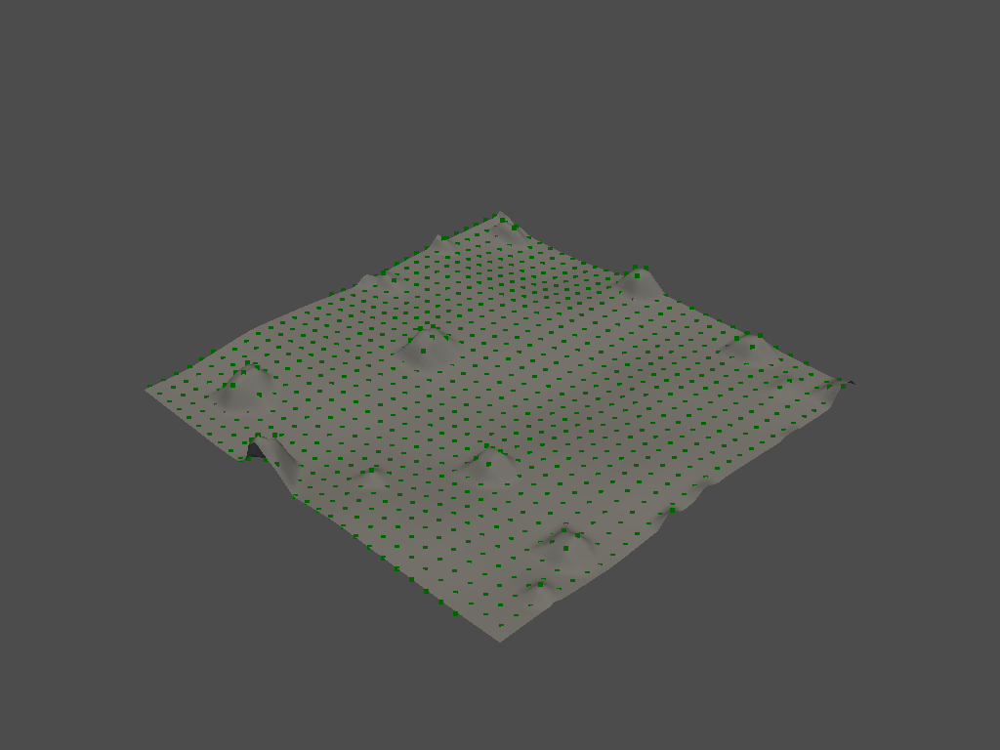

(4096, 3)
(960, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


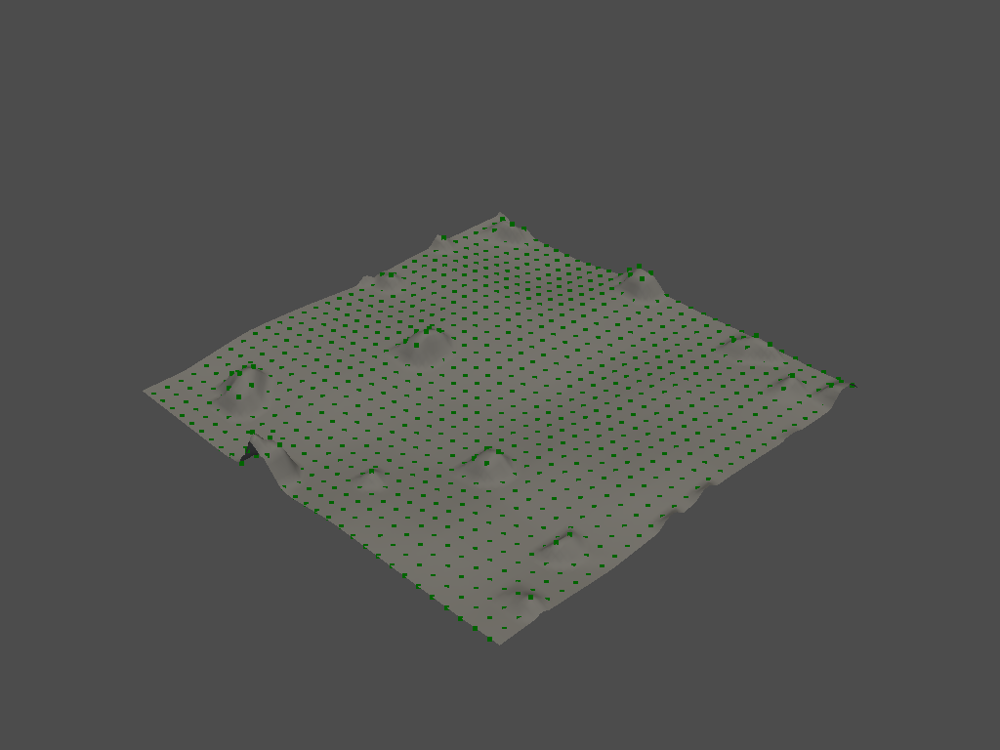

(4096, 3)
(1024, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


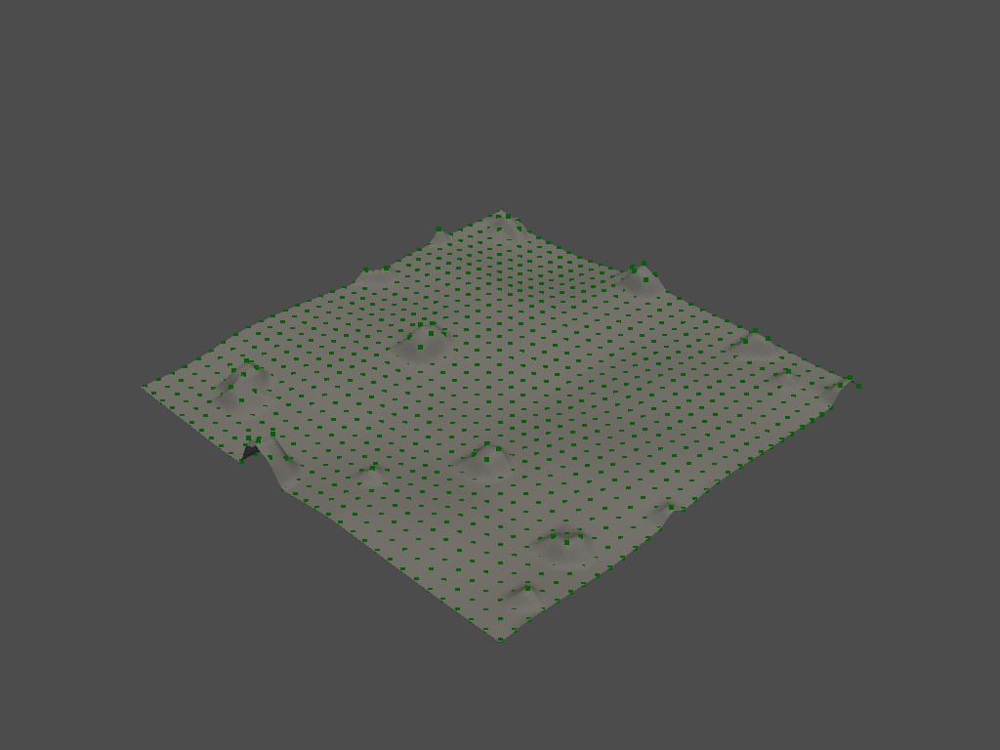

(4096, 3)
(1024, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


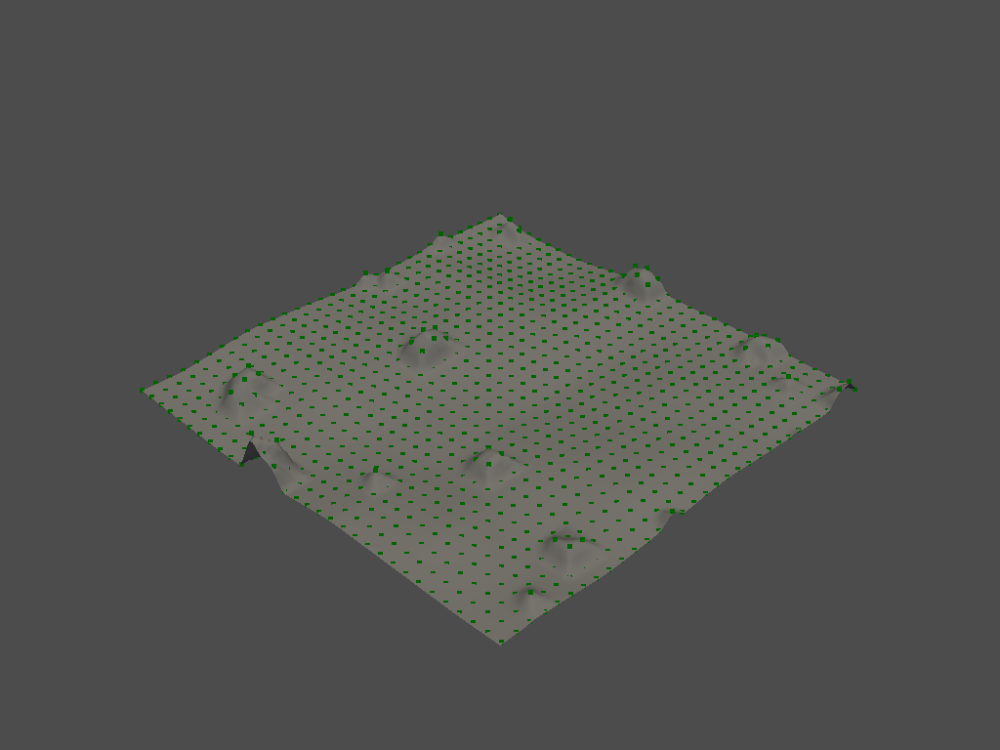

(4096, 3)
(960, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


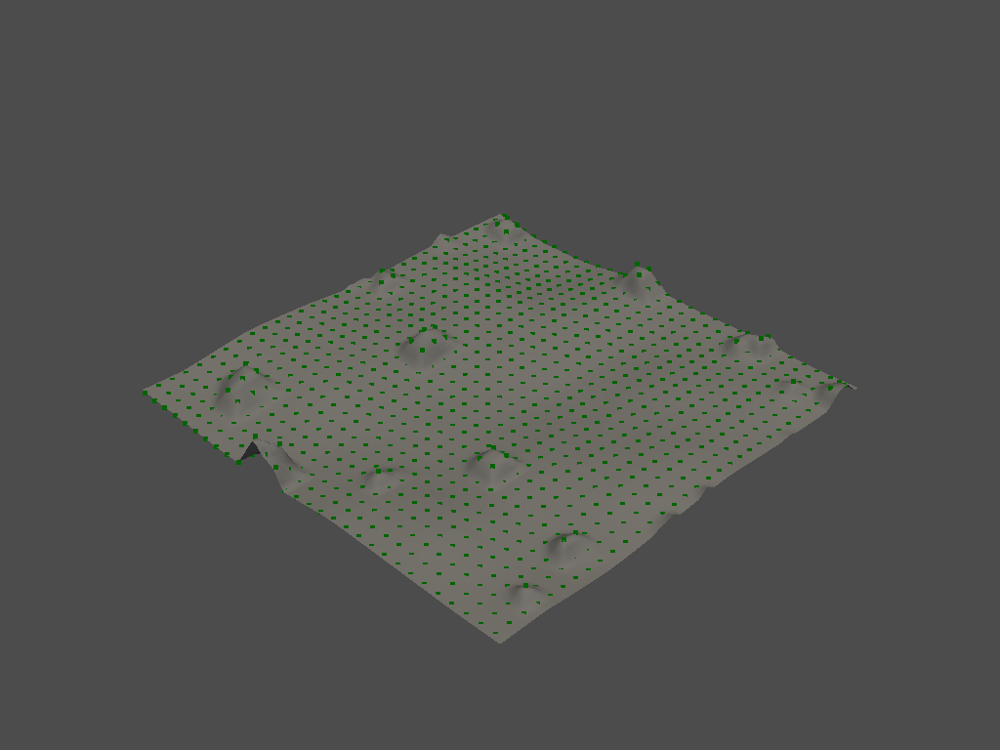

(4096, 3)
(894, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


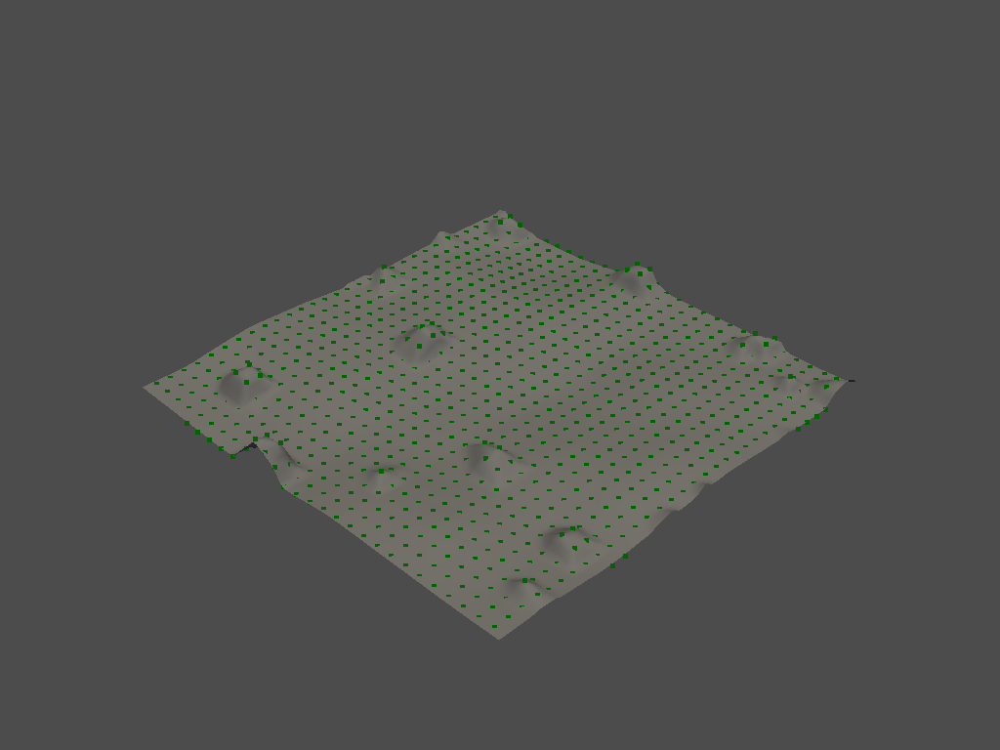

(4096, 3)
(816, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


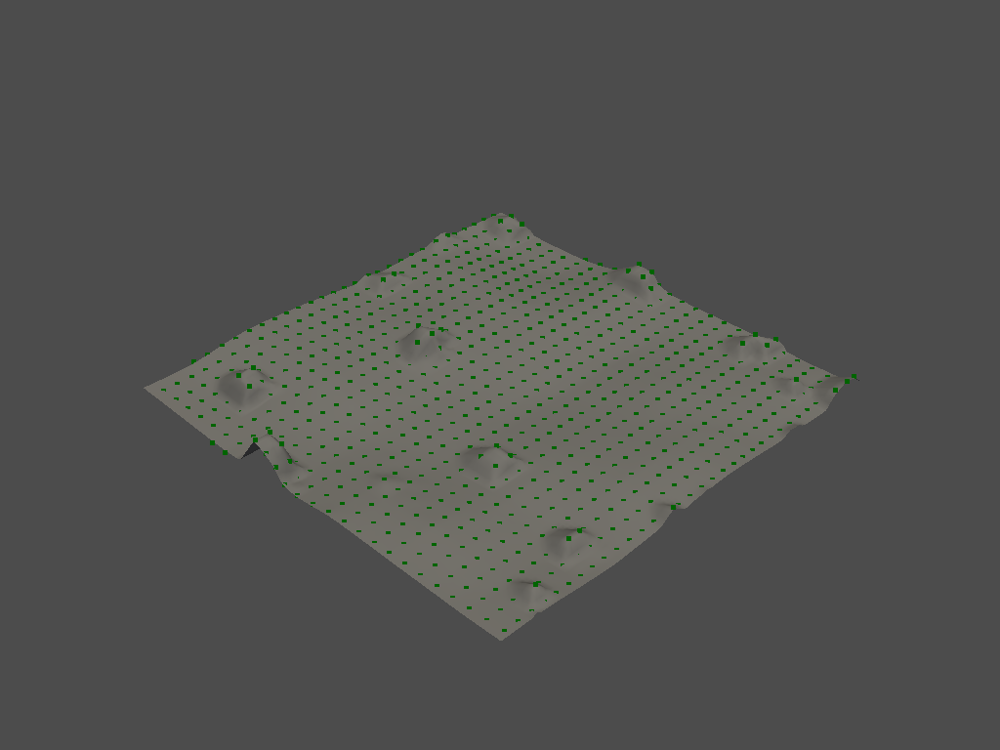

(4096, 3)
(693, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


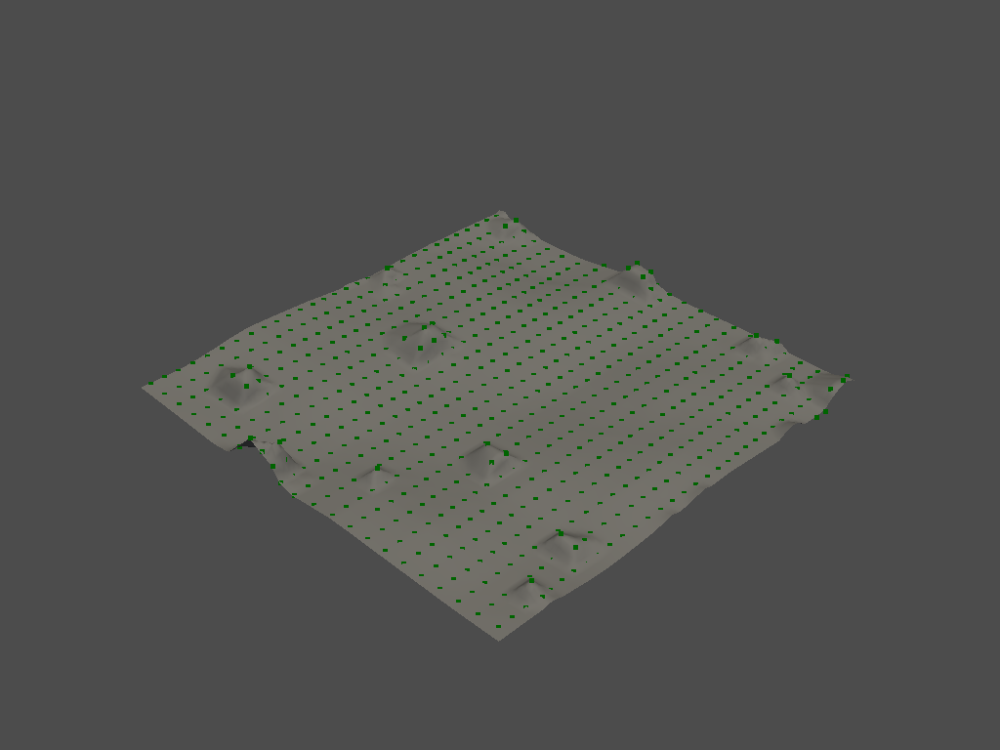

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


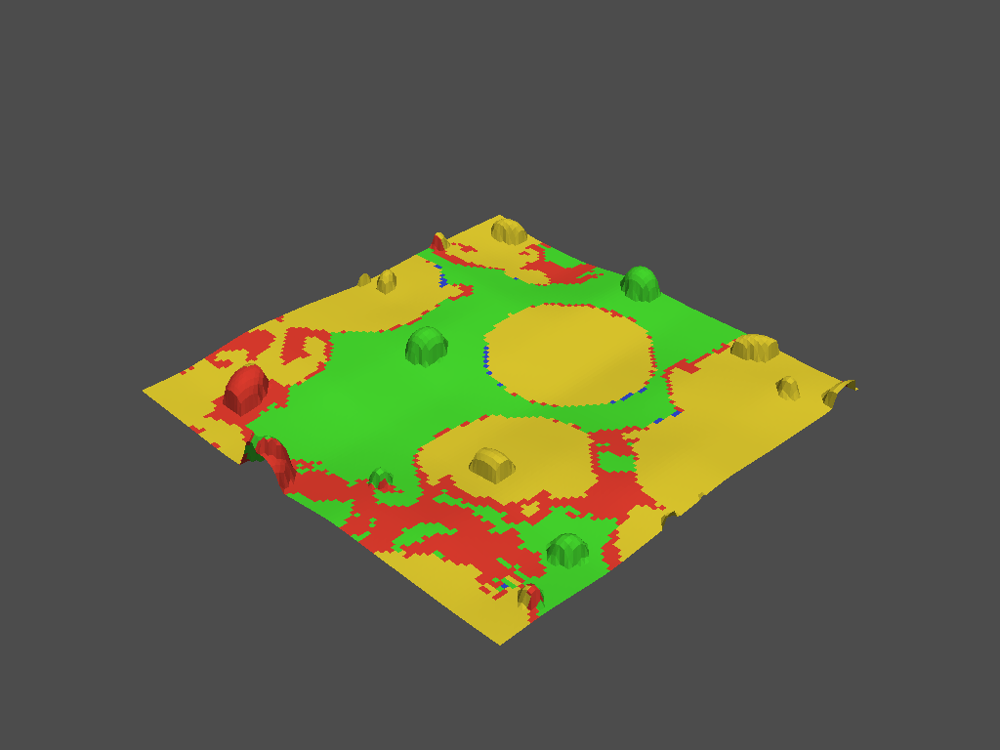

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


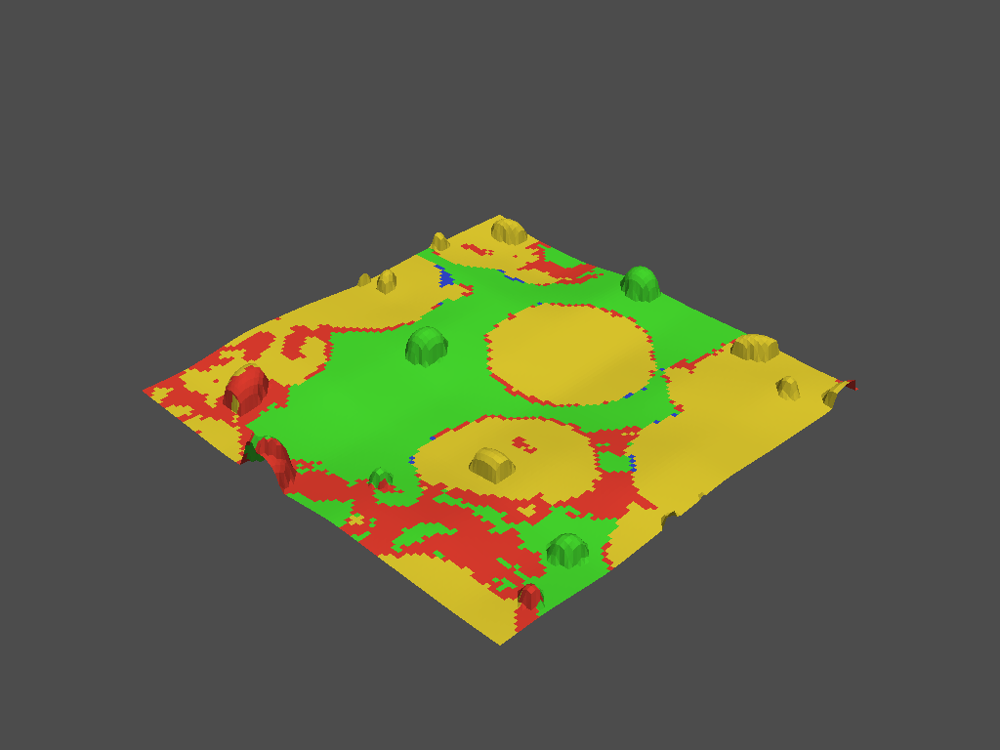

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


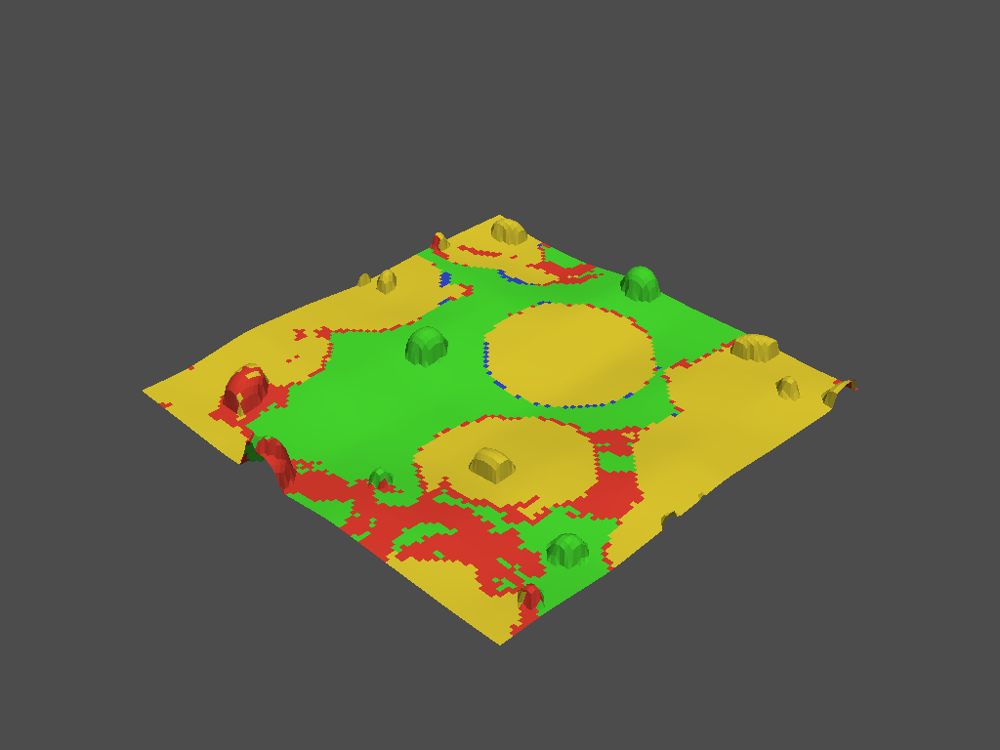

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


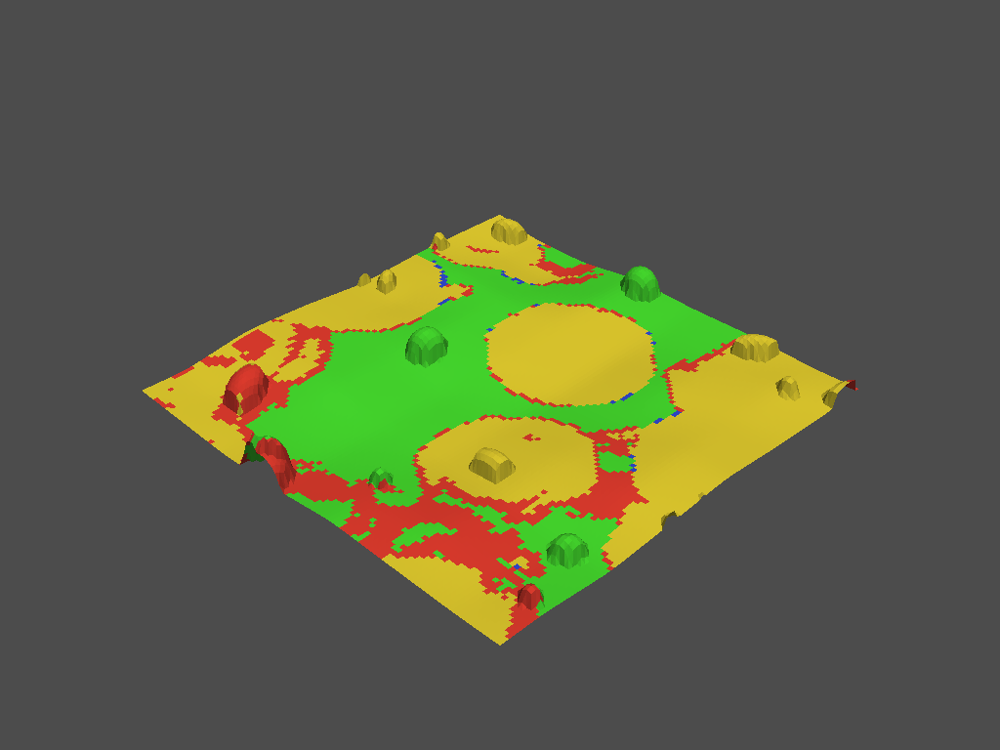

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


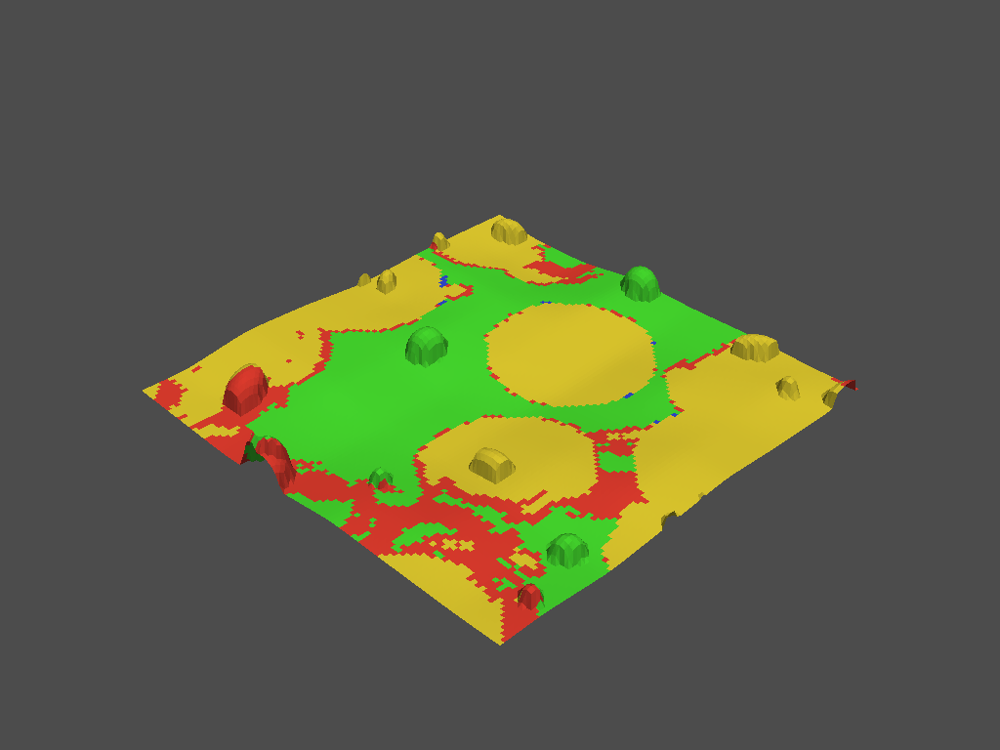

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


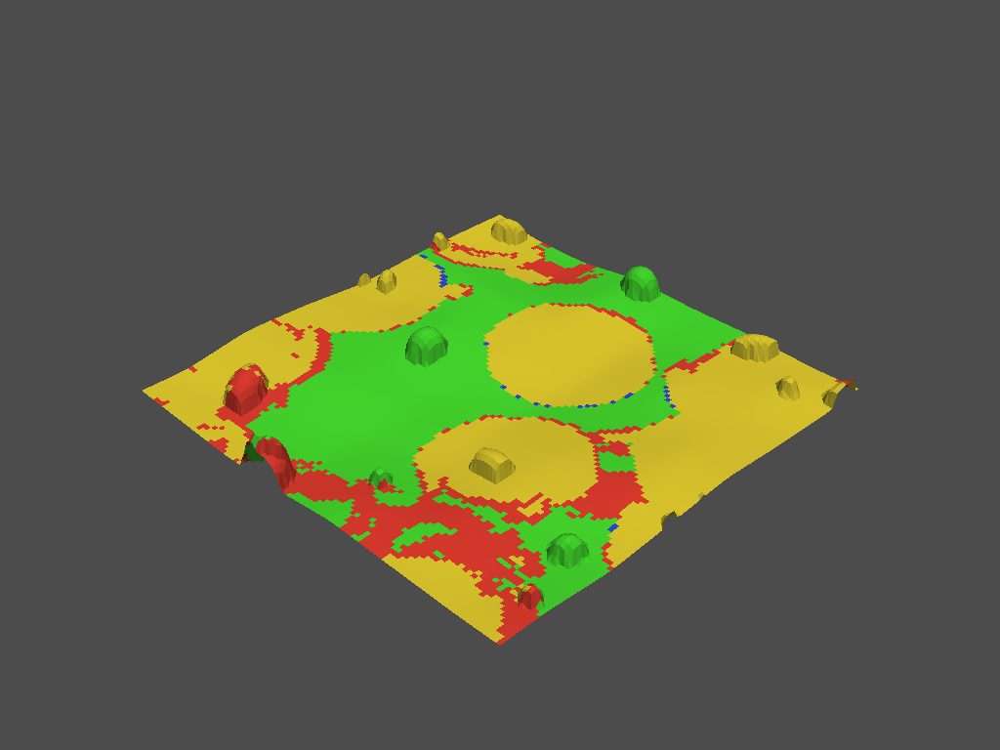

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


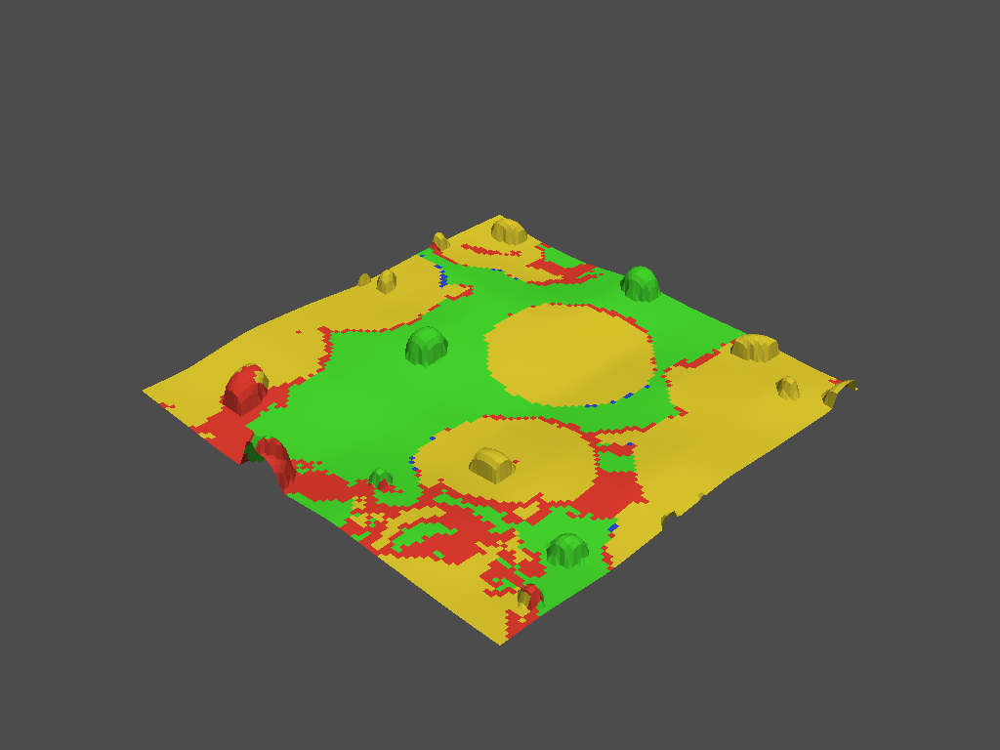

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


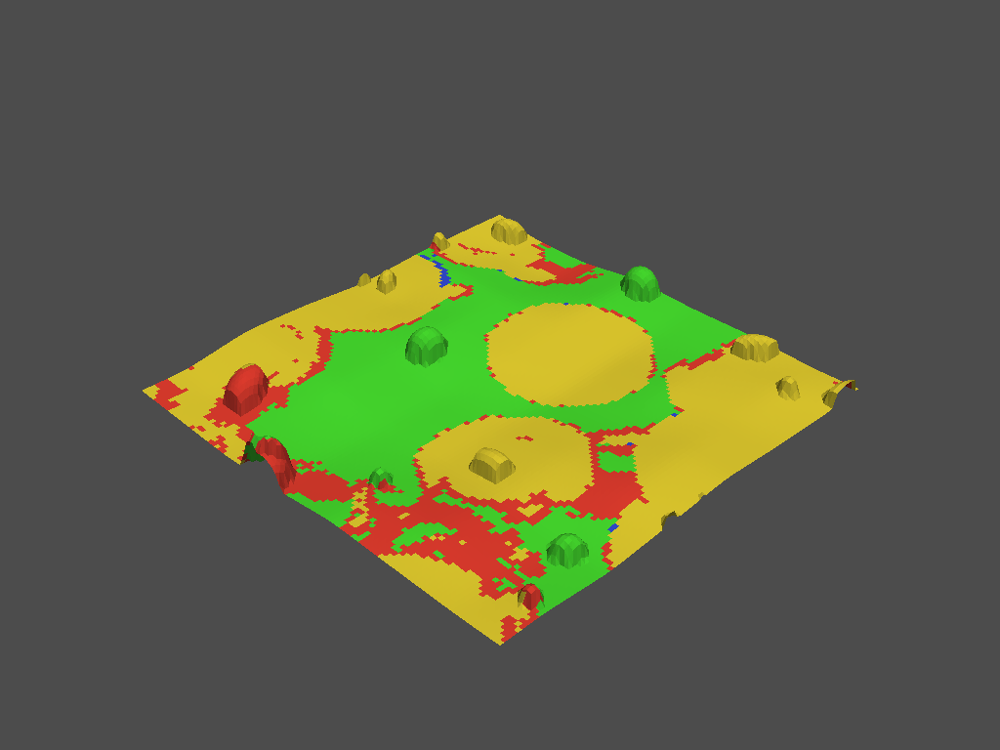

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


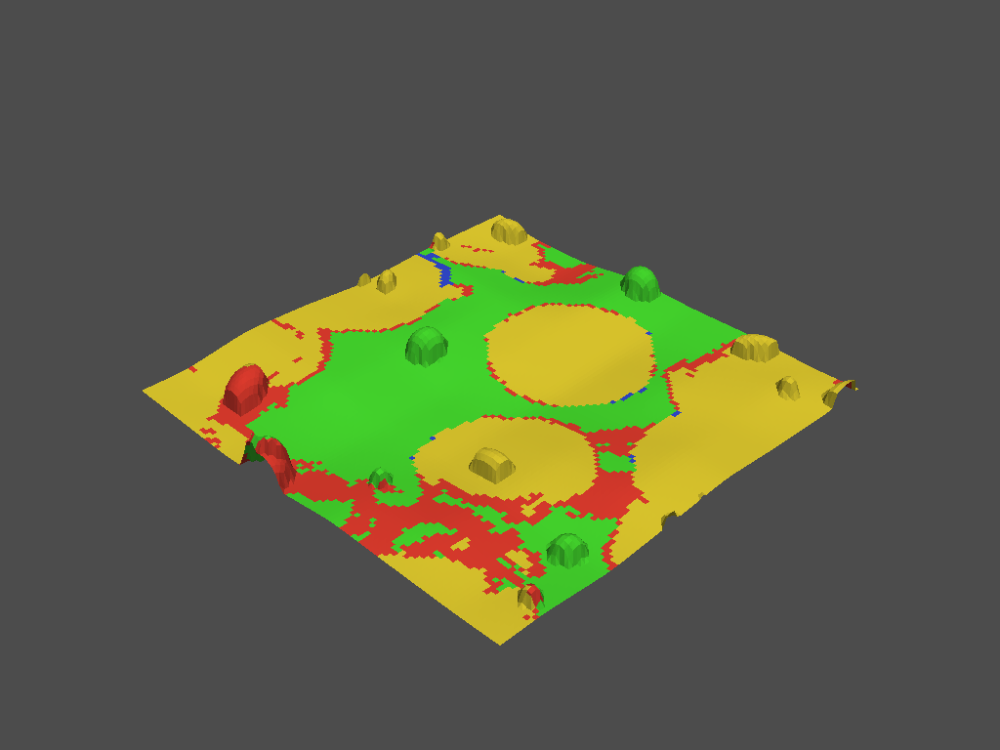

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


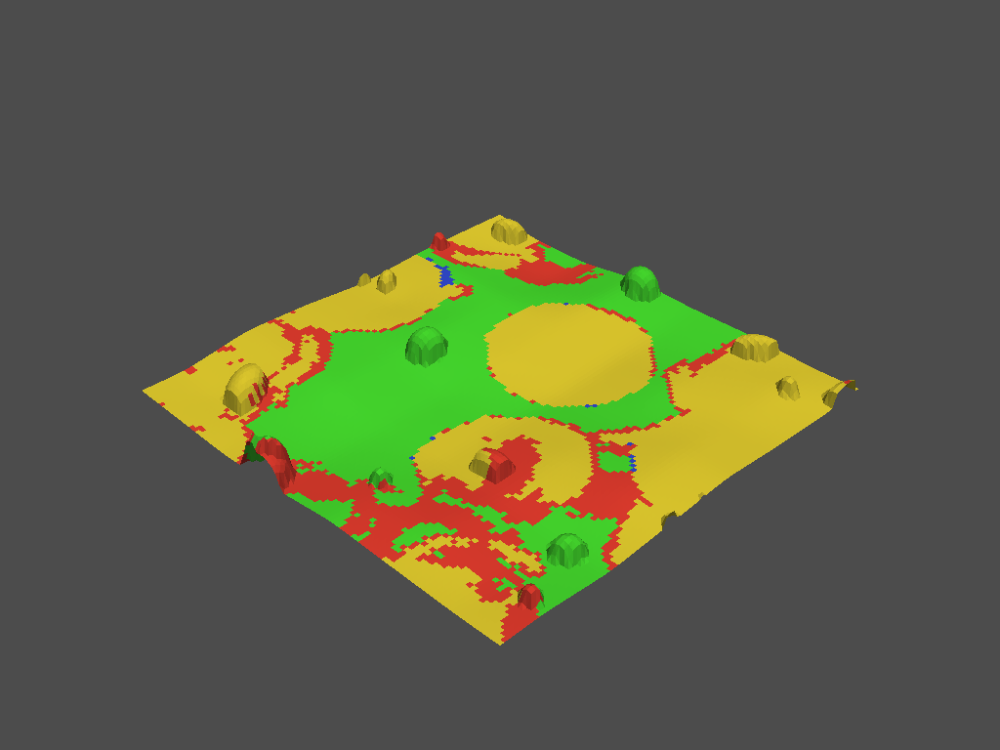

C:\Users\ktomita3\AppData\Local\Temp\ipykernel_26212\2991450551.py:88: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  images = [imageio.imread(file) for file in file_list]


In [65]:
seeds = [0, 1, 2, 3, 4]
for seed in seeds:
    main(seed=seed, n_steps=10, duration=0.5)

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


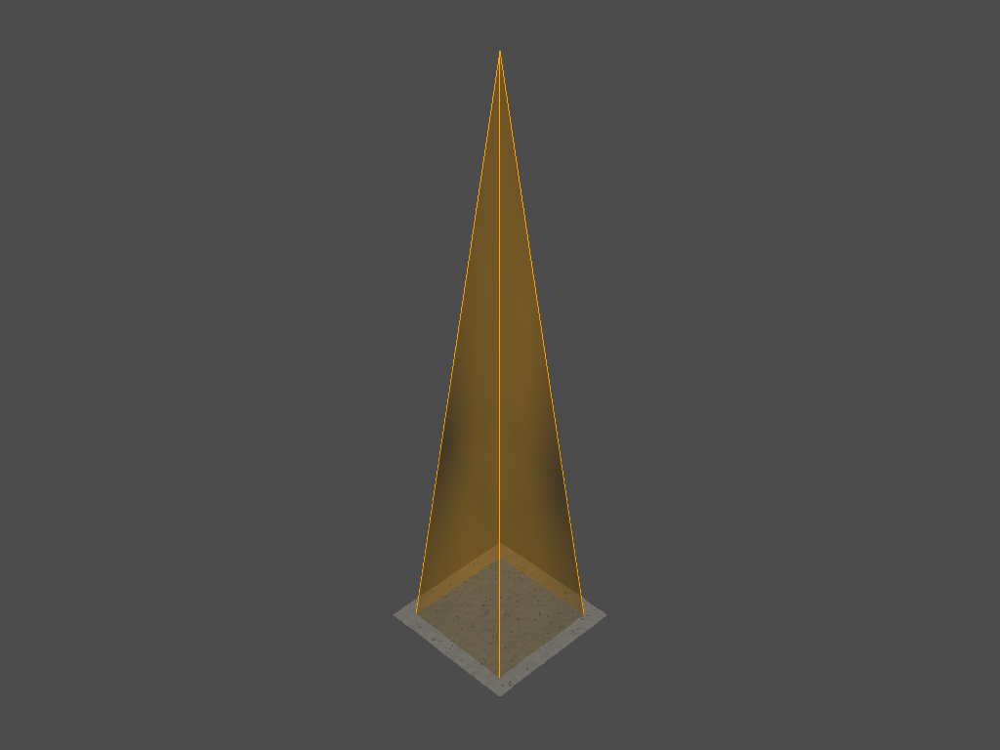

0


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


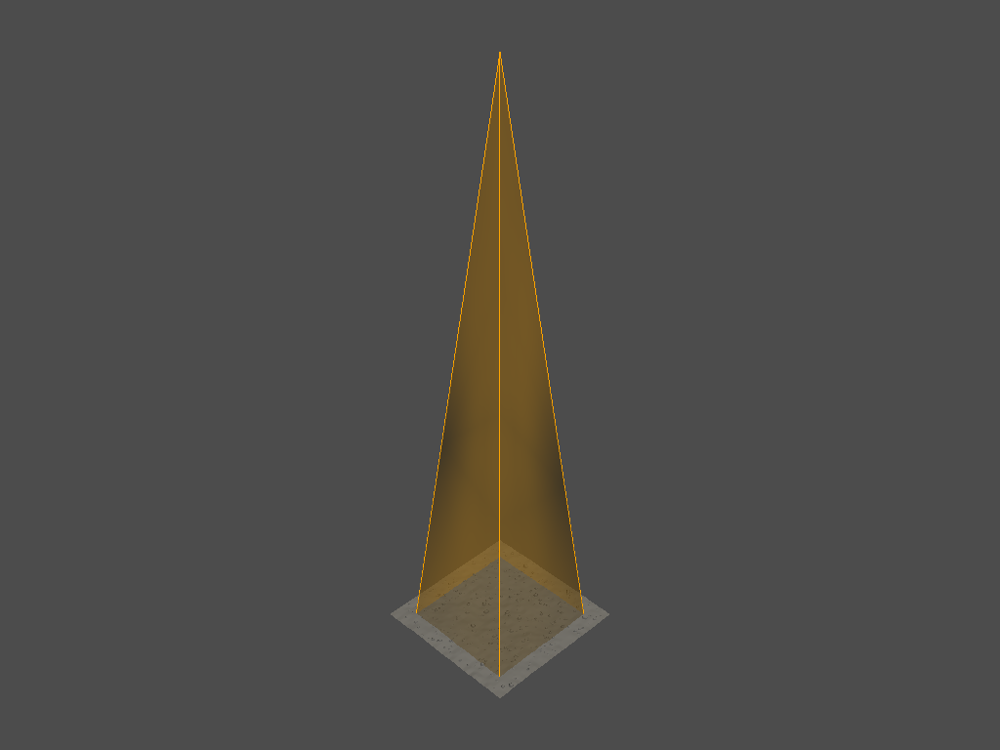

1


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


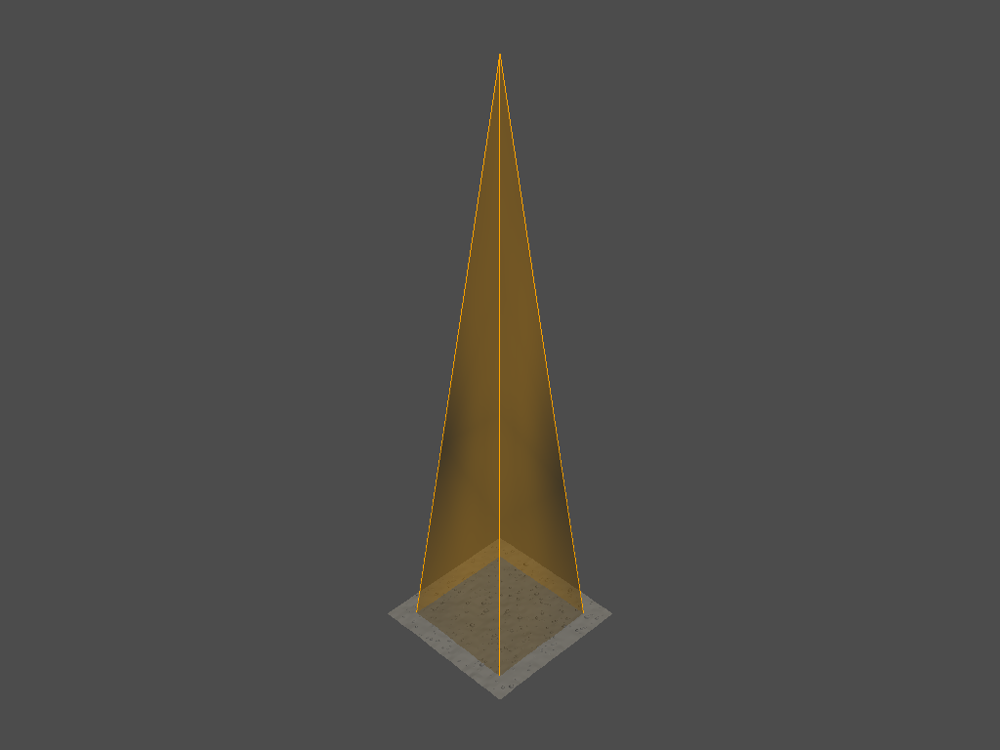

2


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


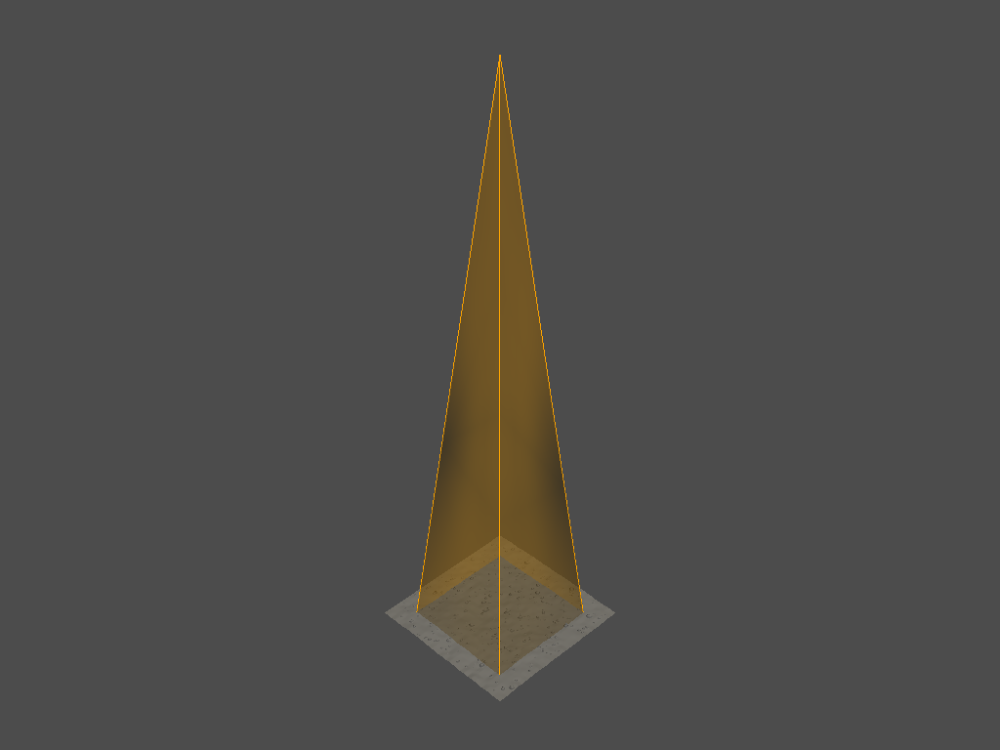

3


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


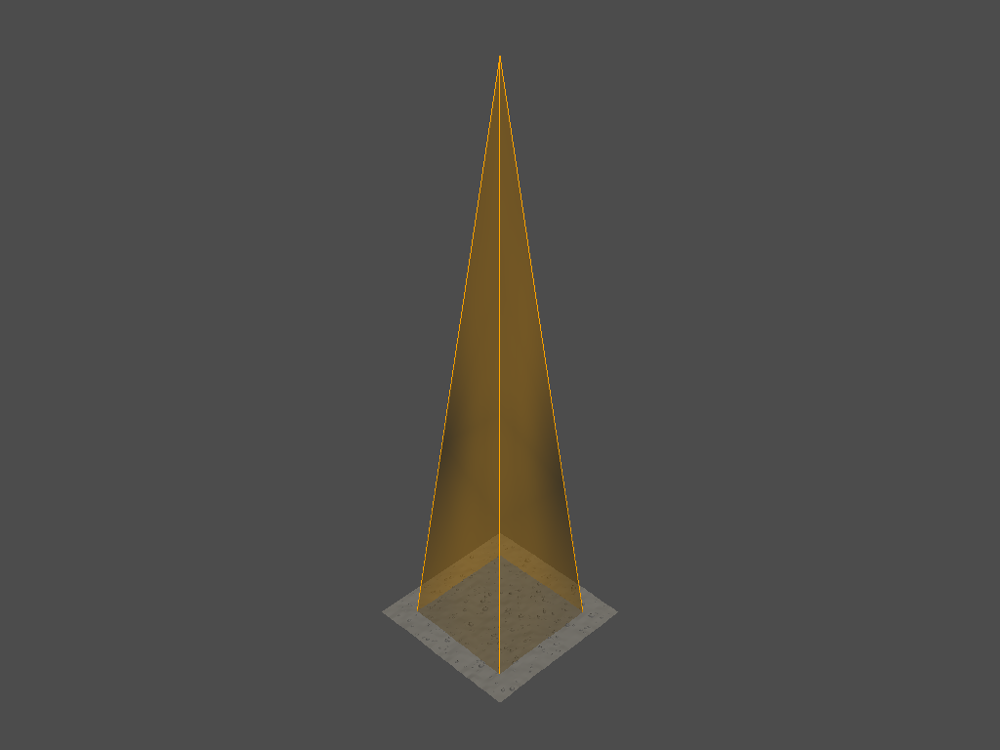

4


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


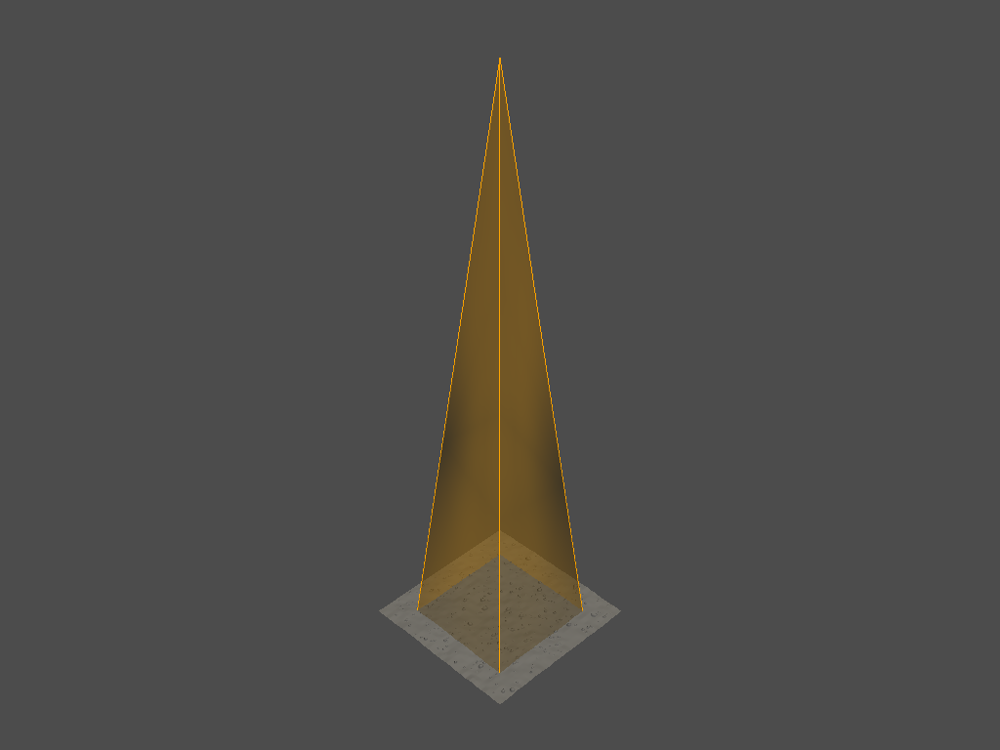

5


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


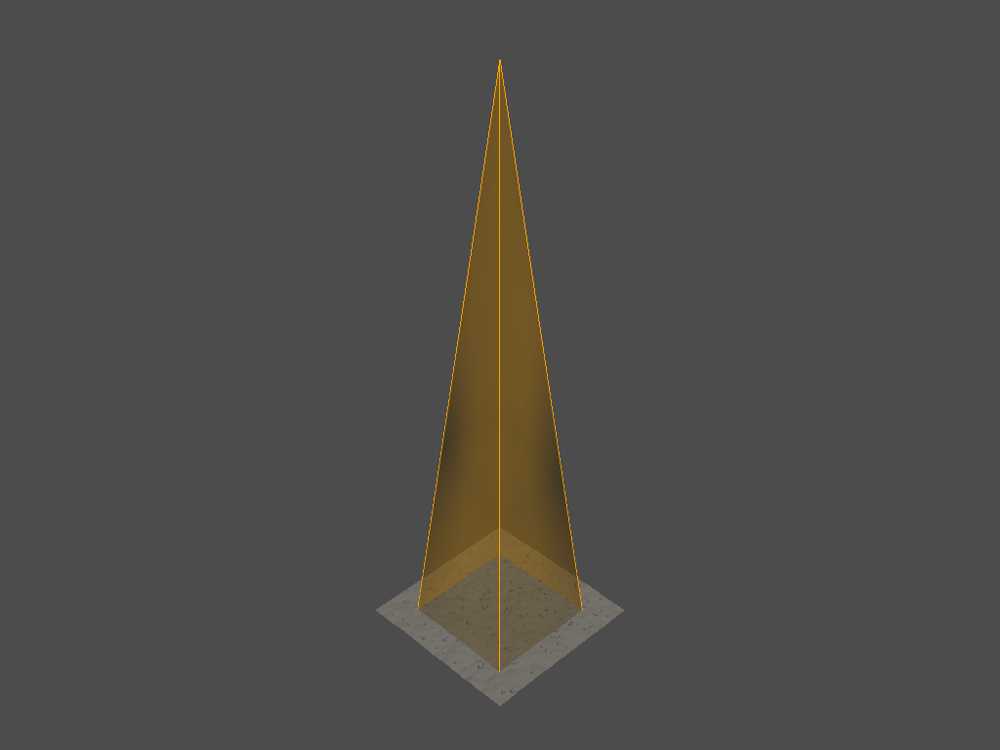

6


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


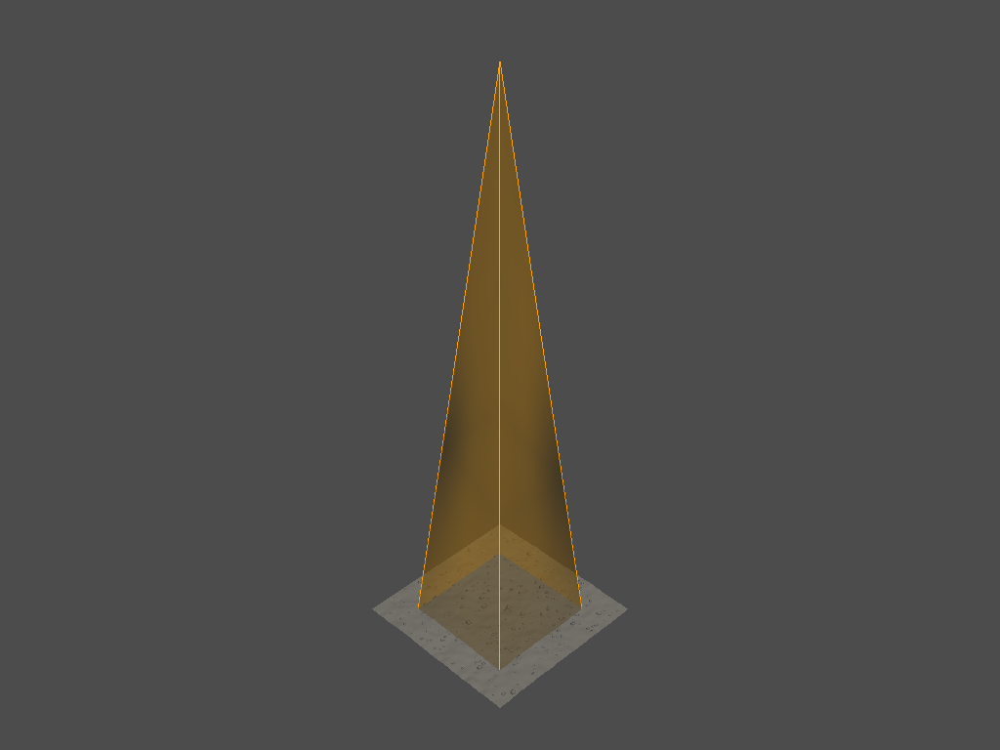

7


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


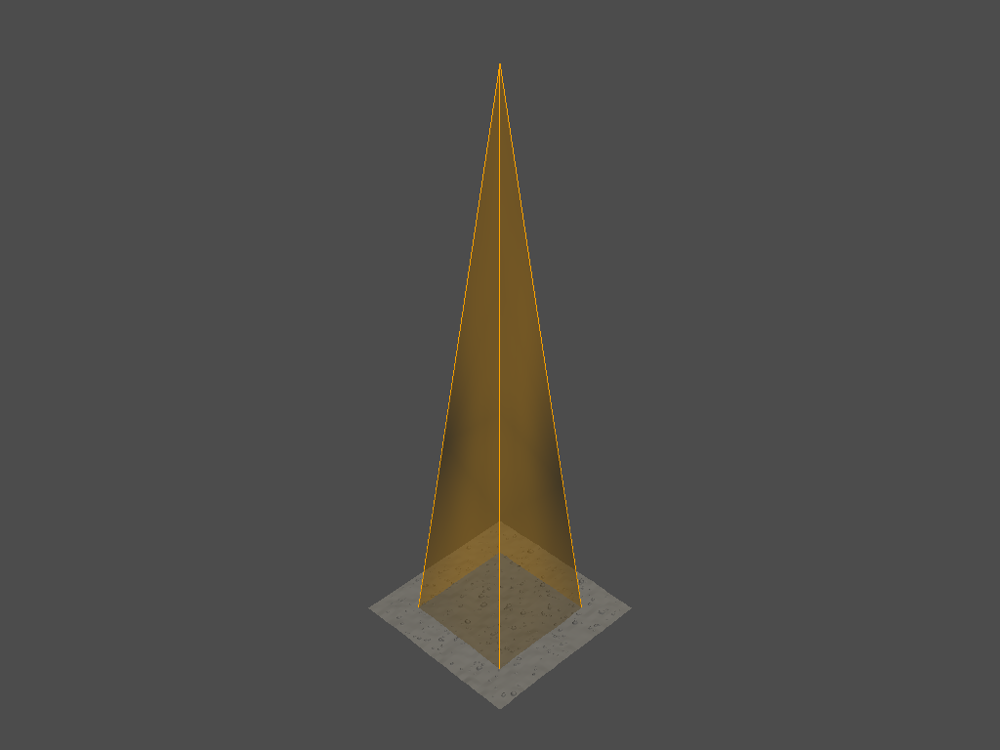

8


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


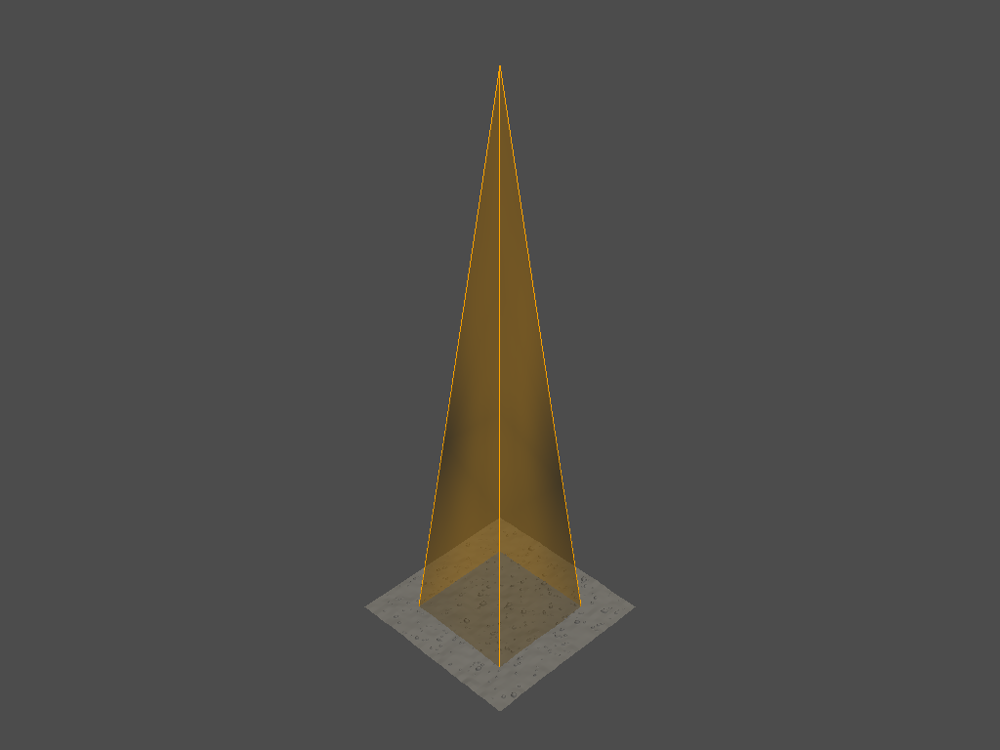

9


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


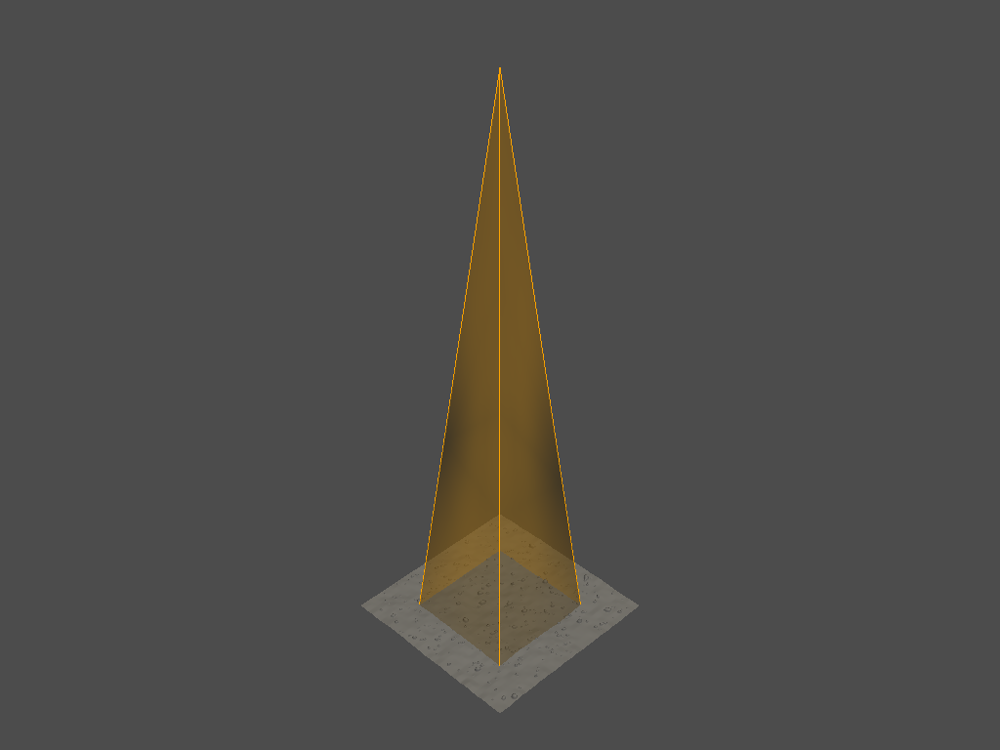

10


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


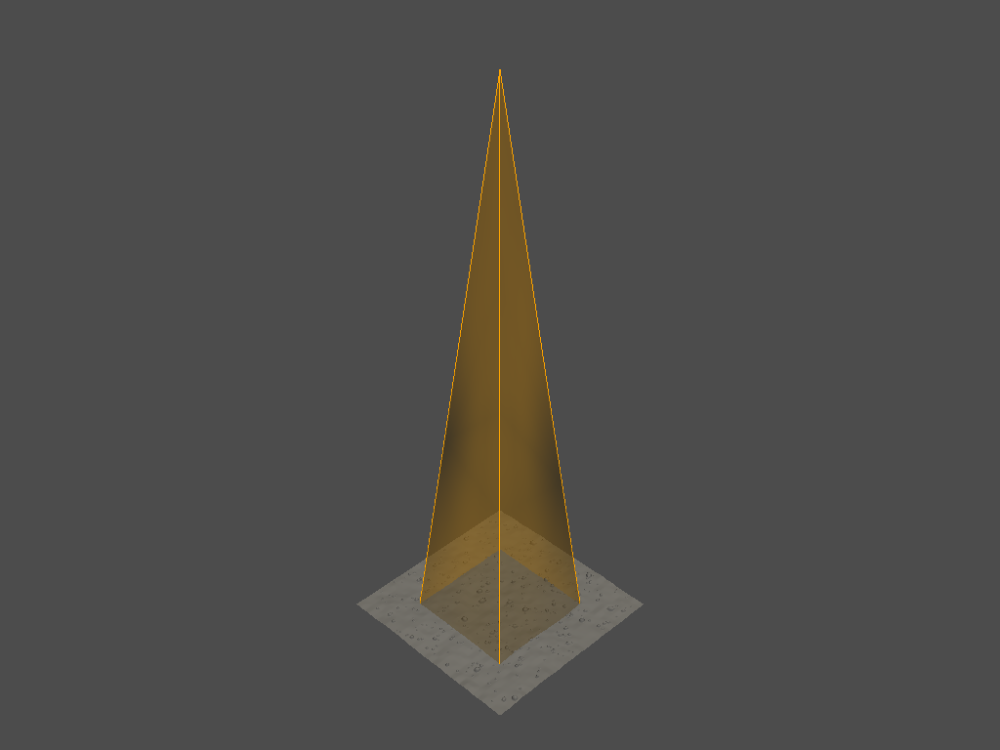

11


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


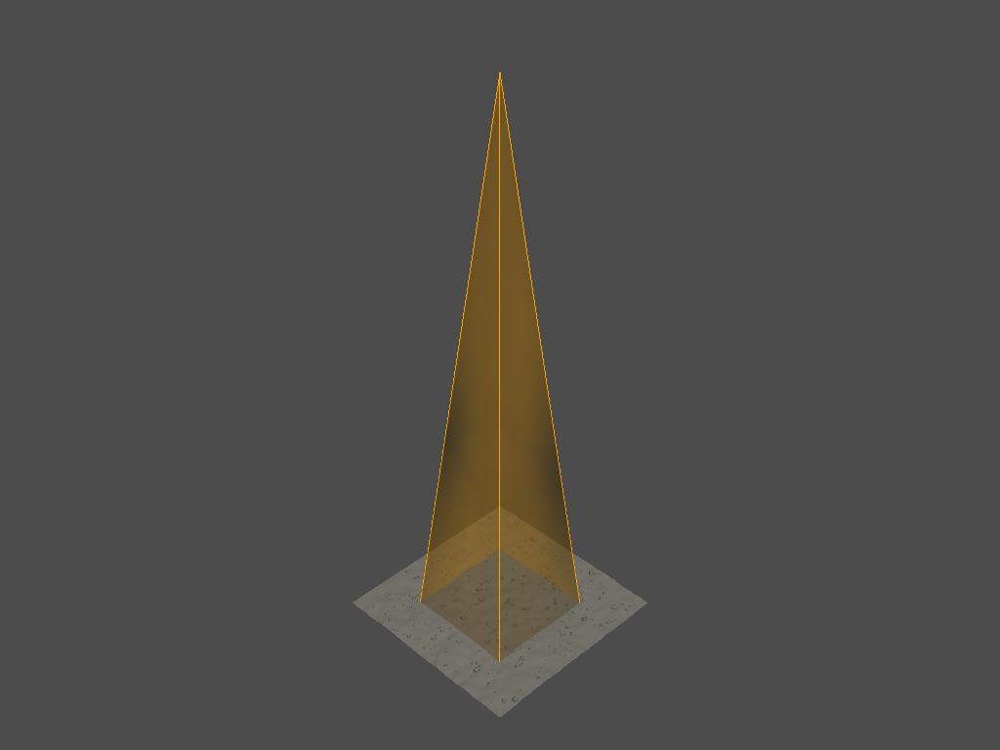

12


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


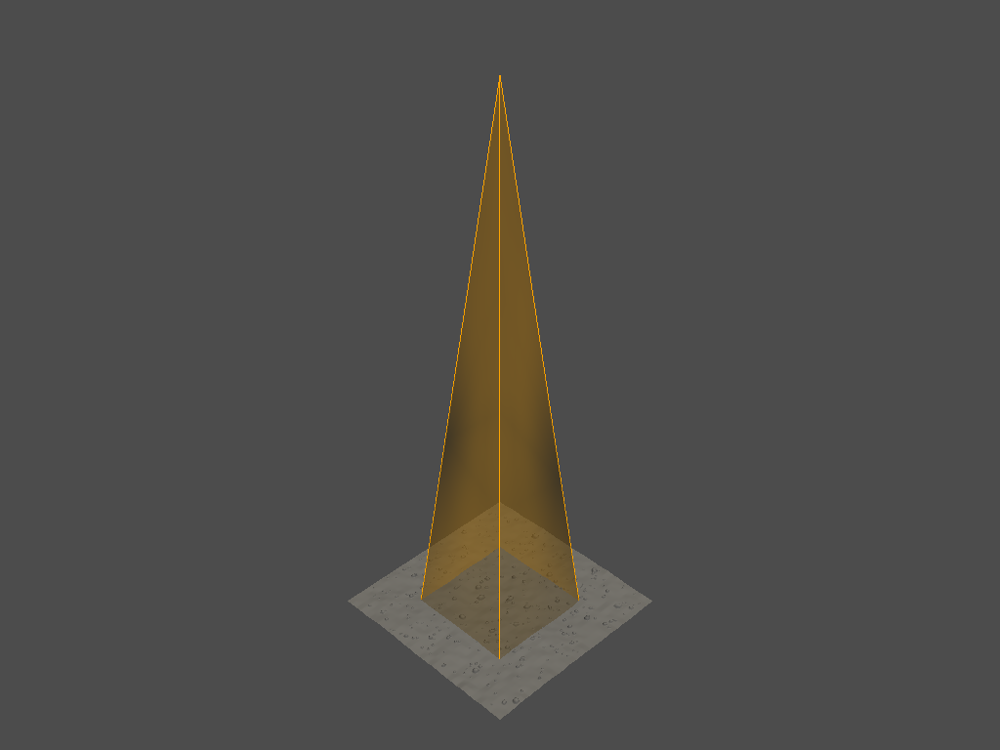

13


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


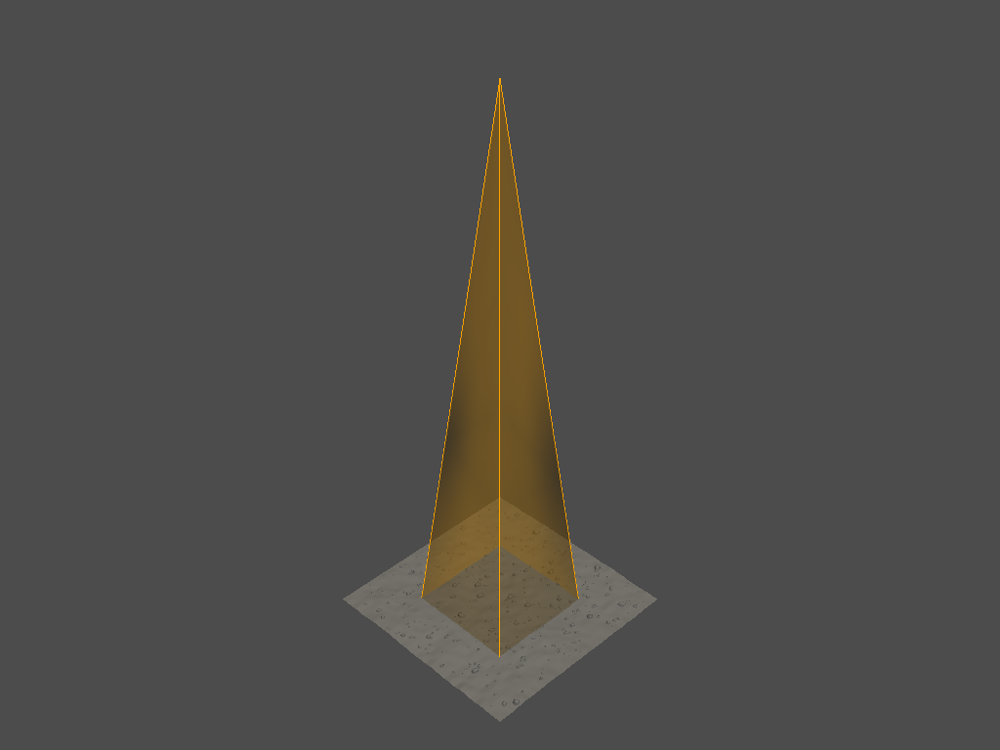

14


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


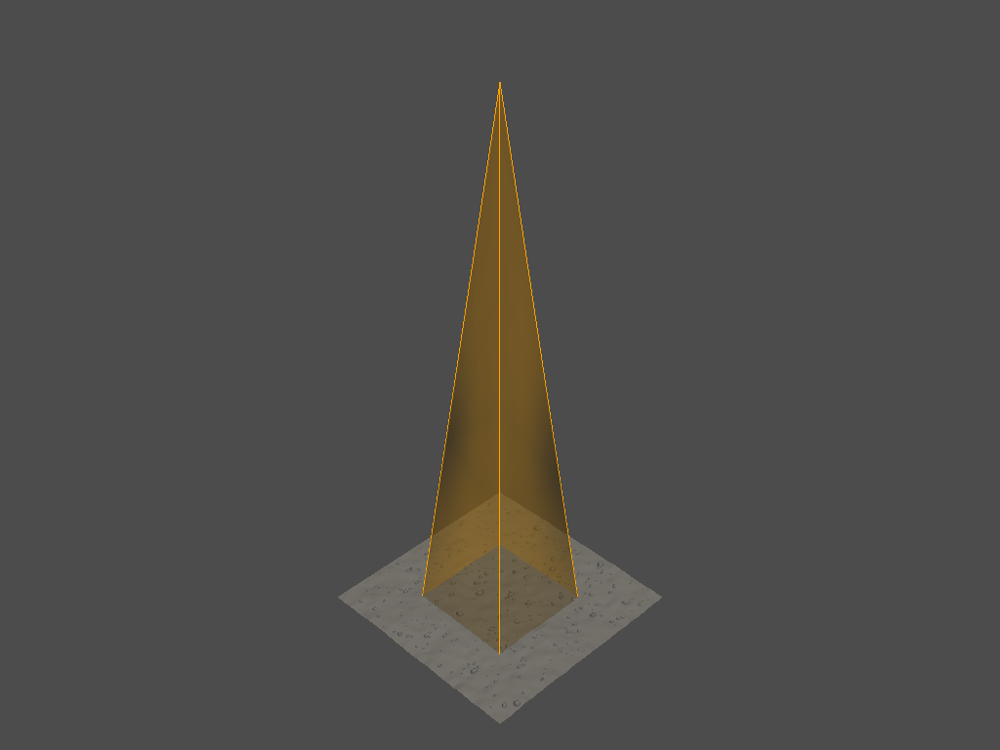

15


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


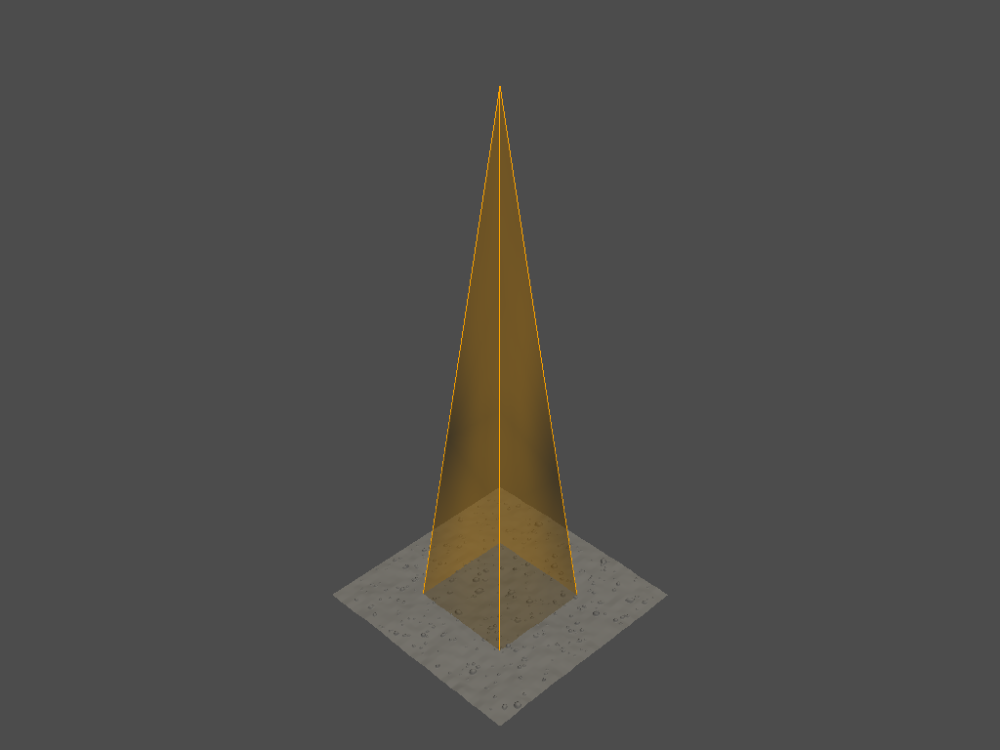

16


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


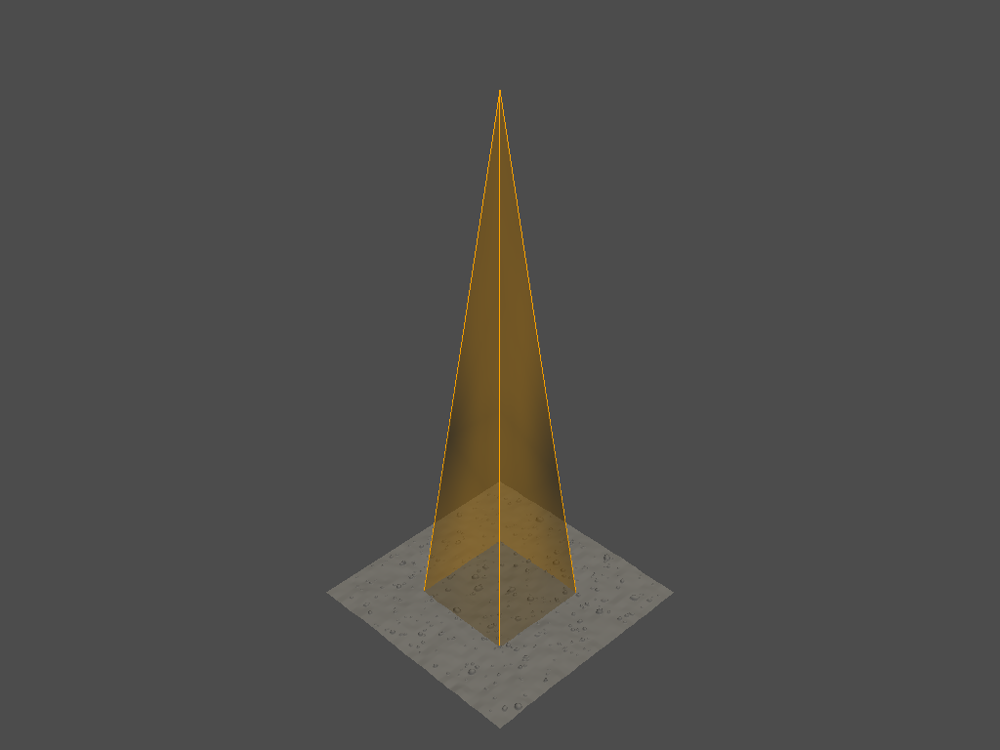

17


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


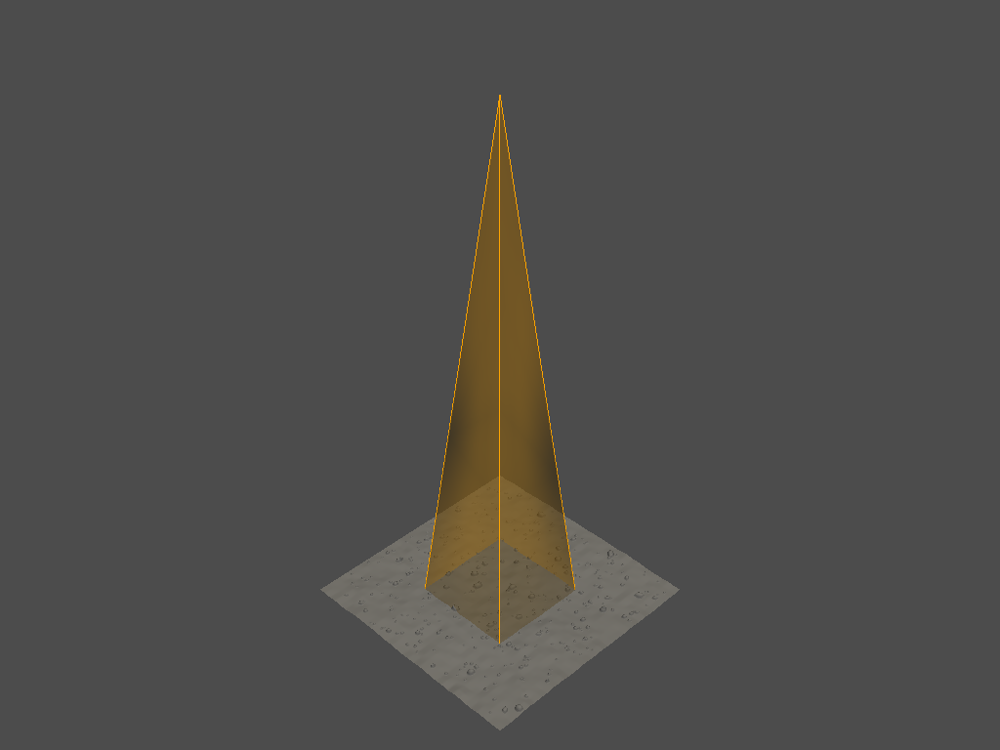

18


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


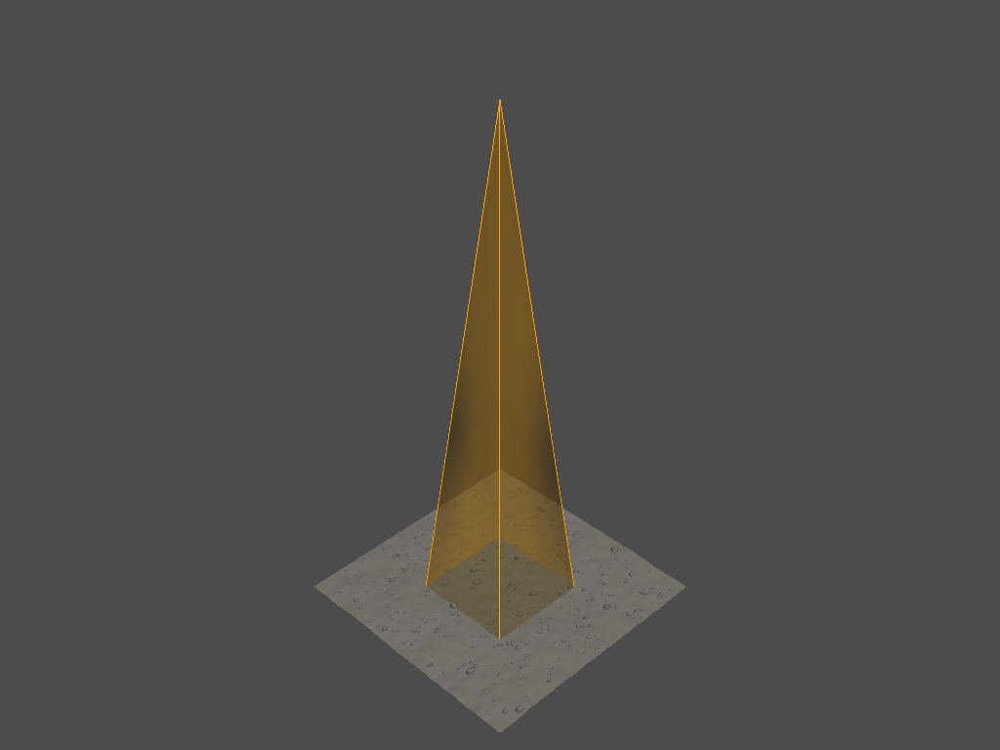

19


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


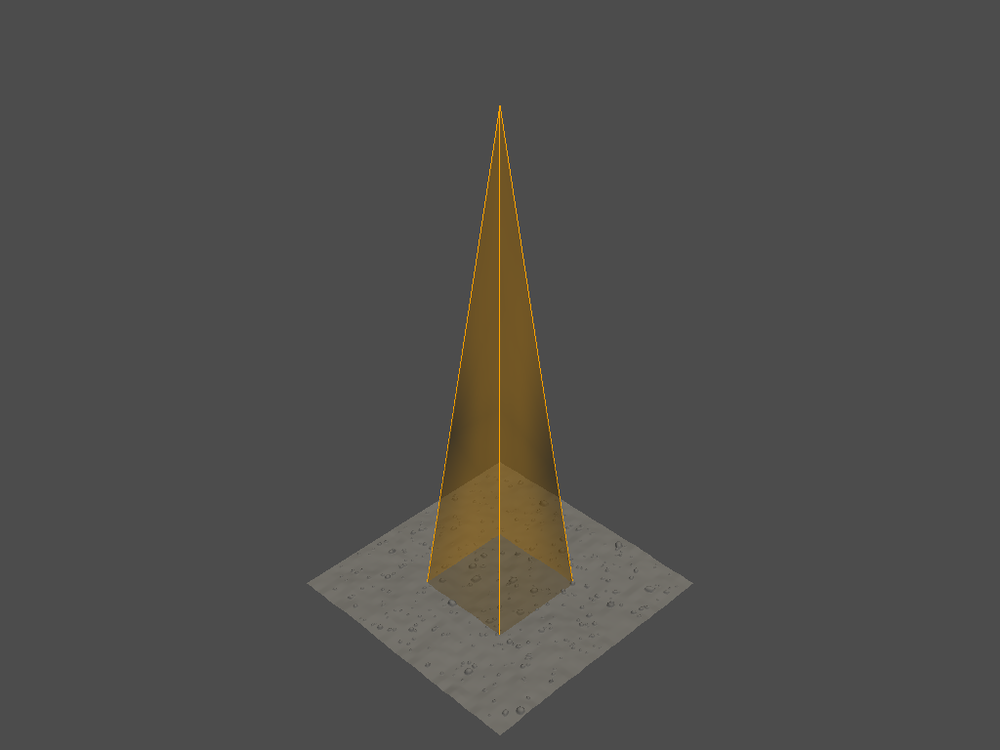

20


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


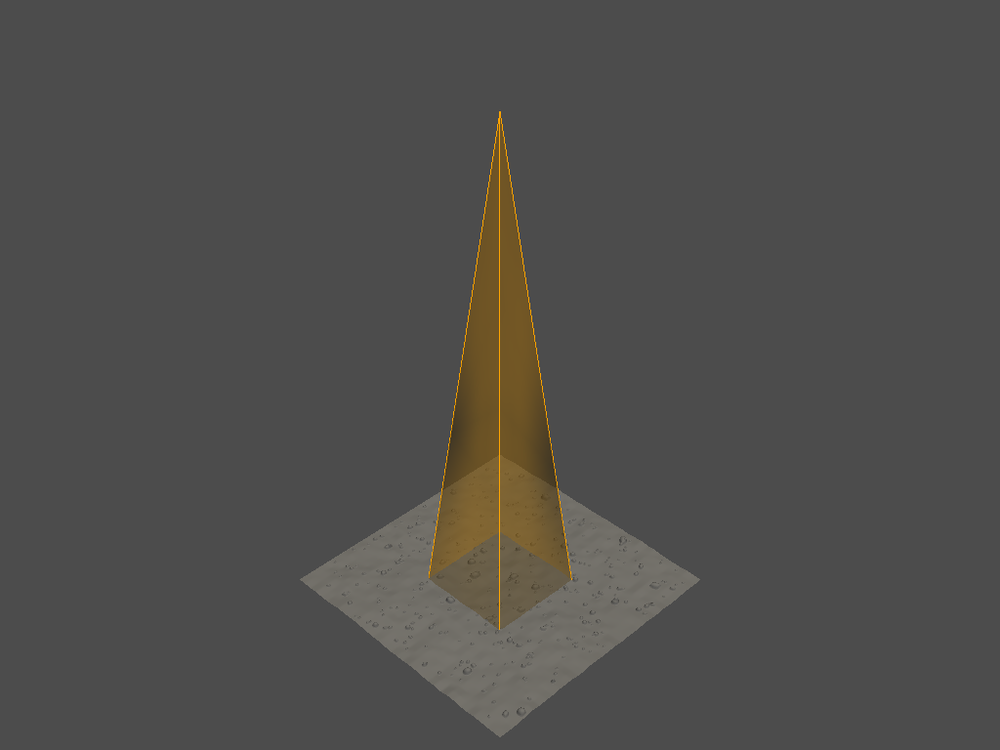

21


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


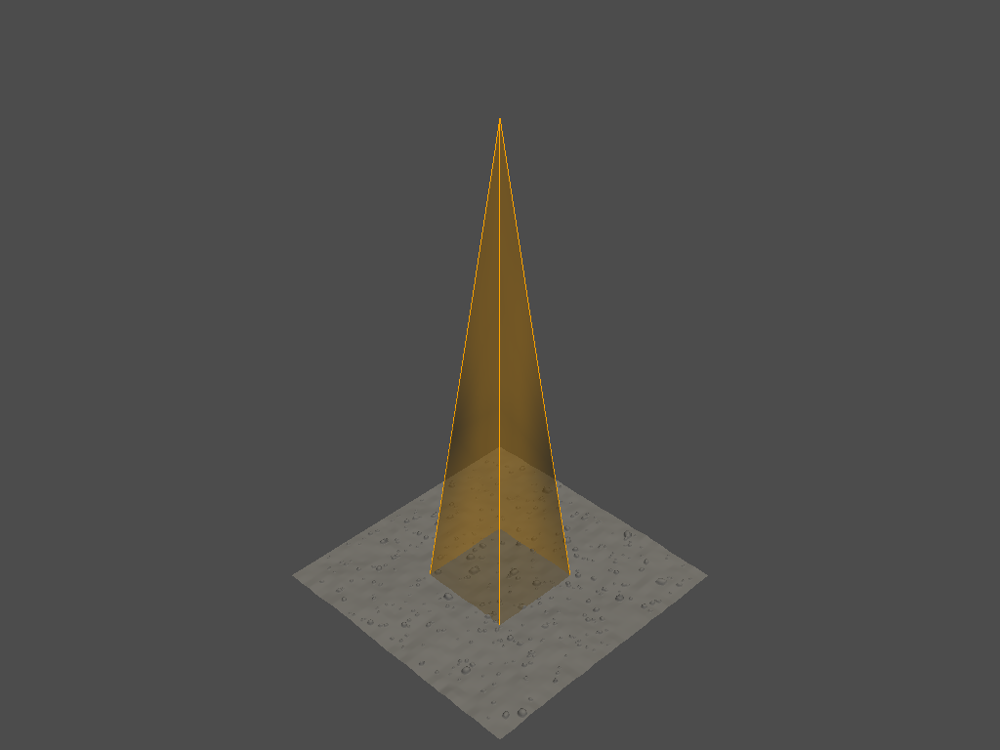

22


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


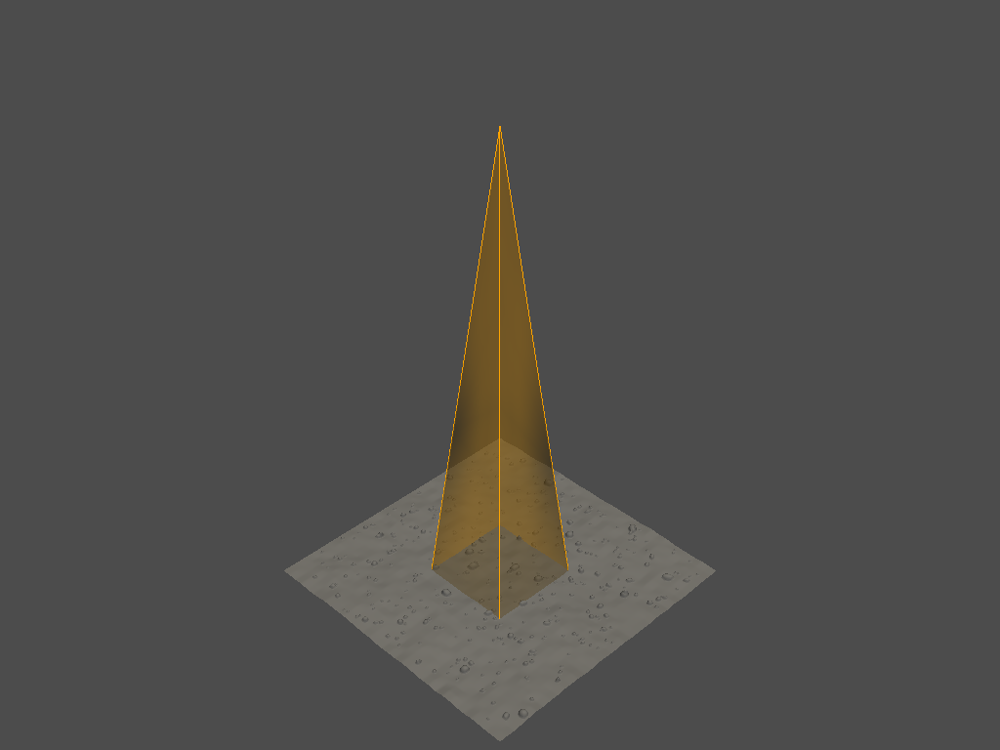

23


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


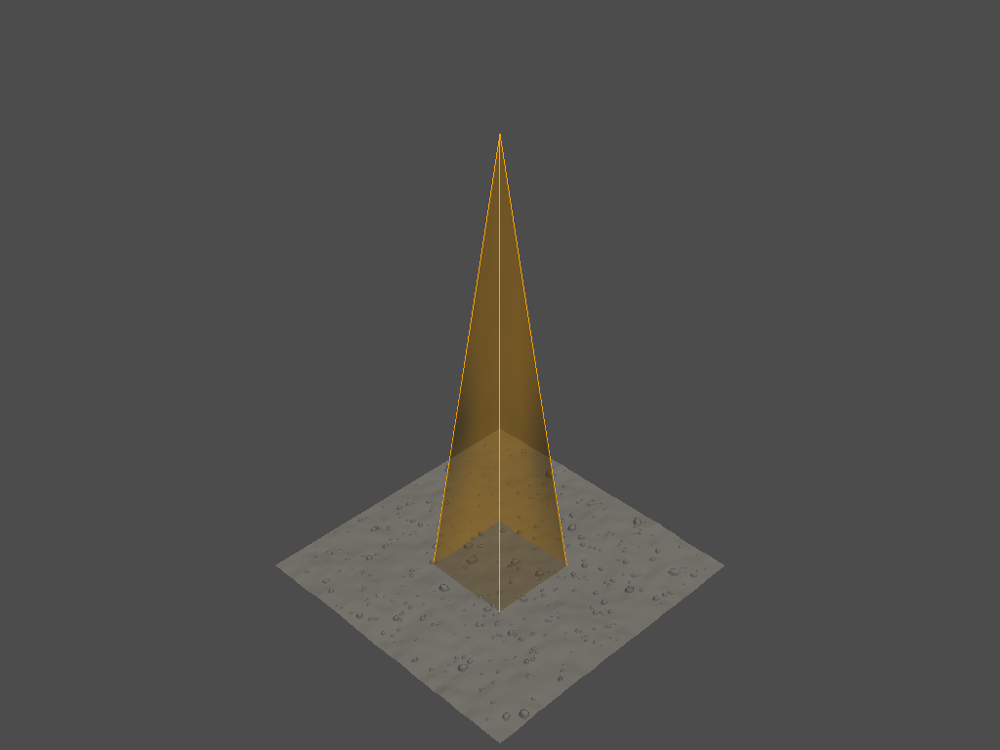

24


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


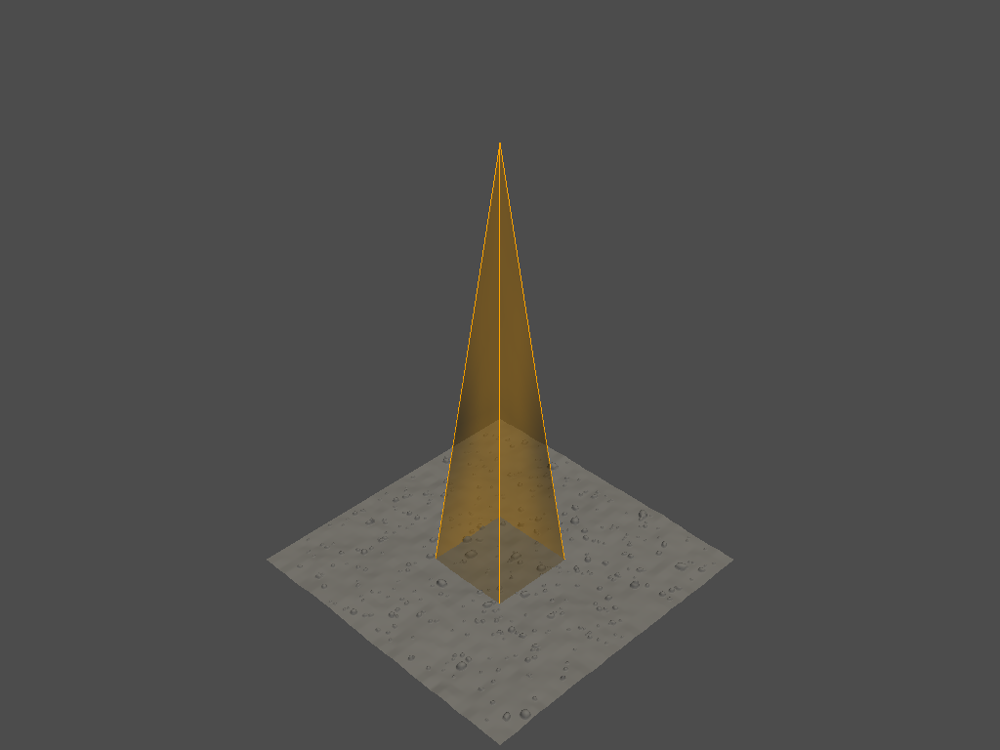

25


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


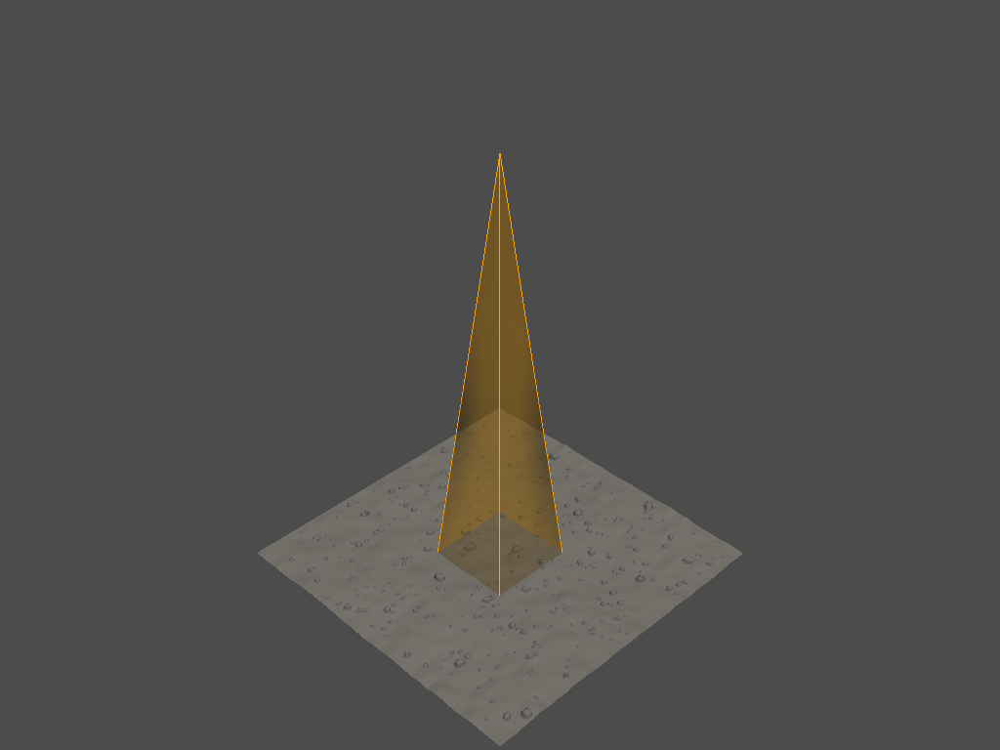

26


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


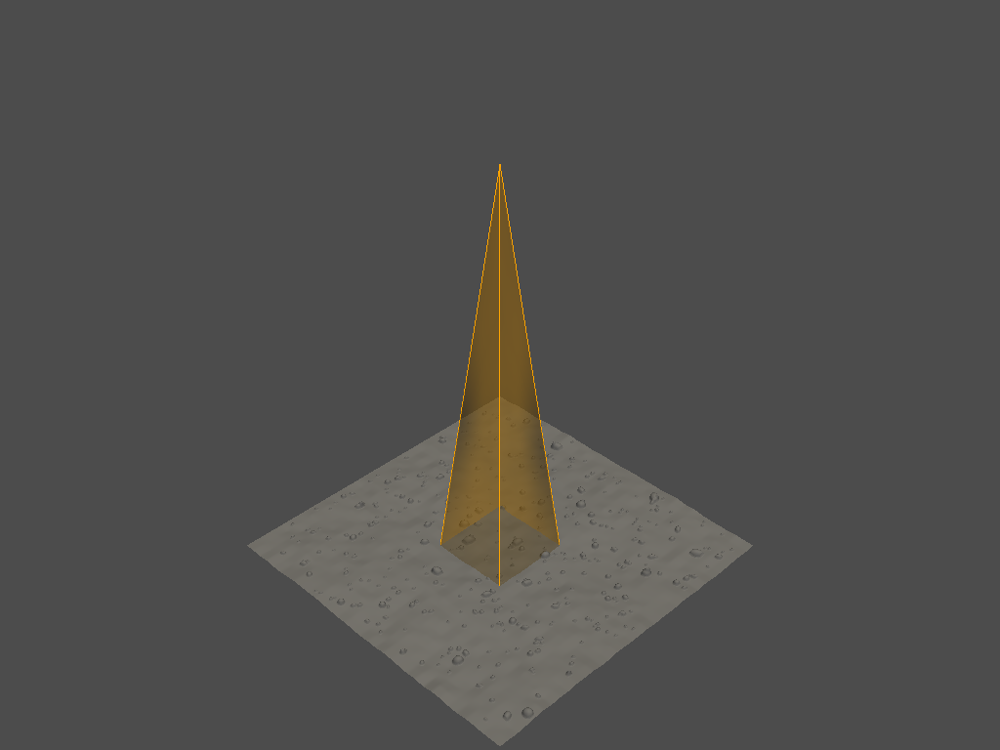

27


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


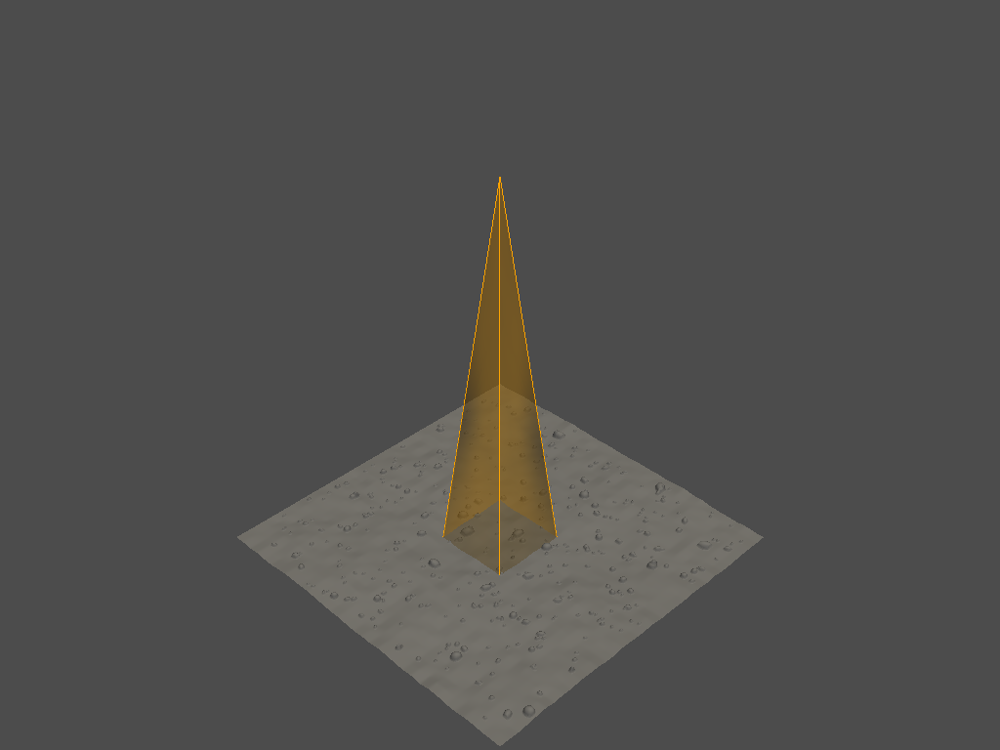

28


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


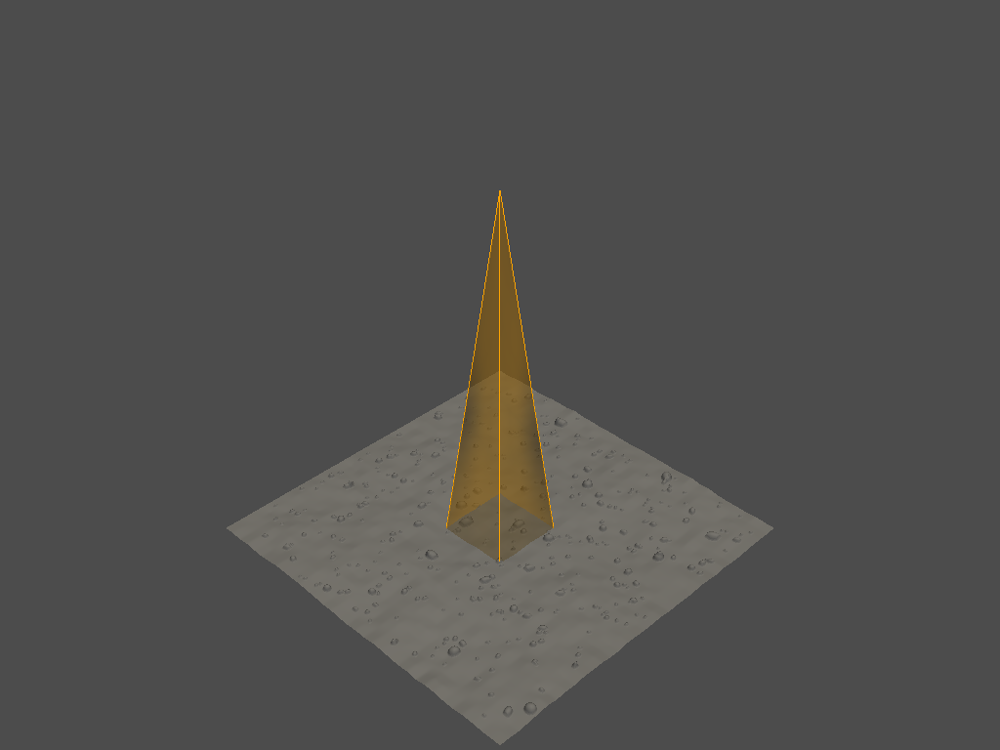

29
(256, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


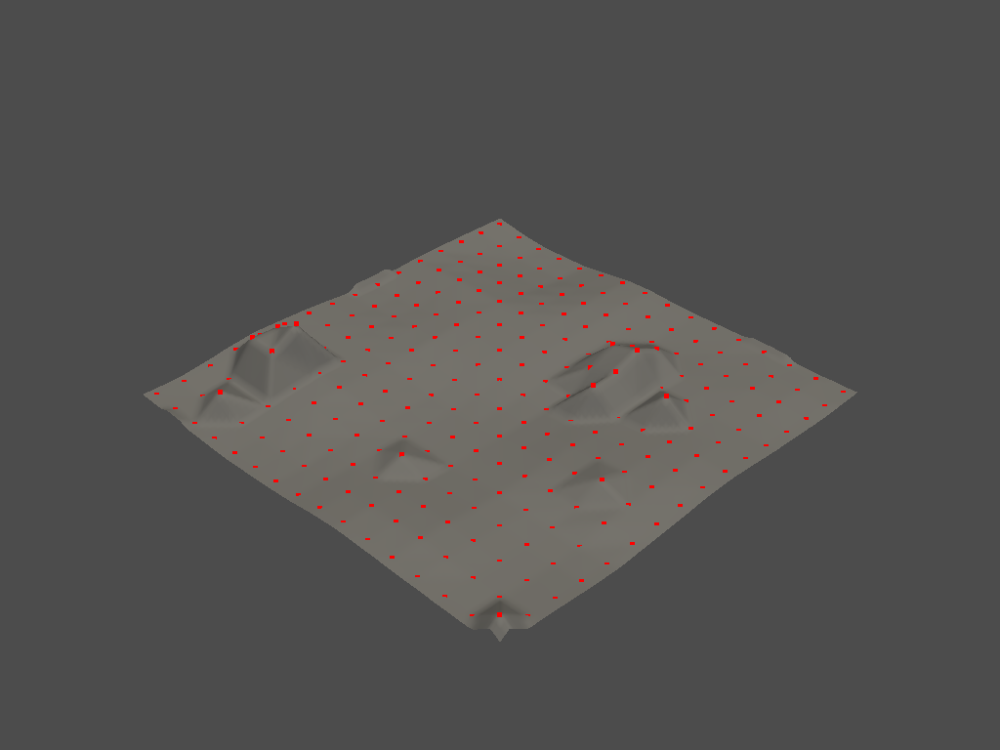

(256, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


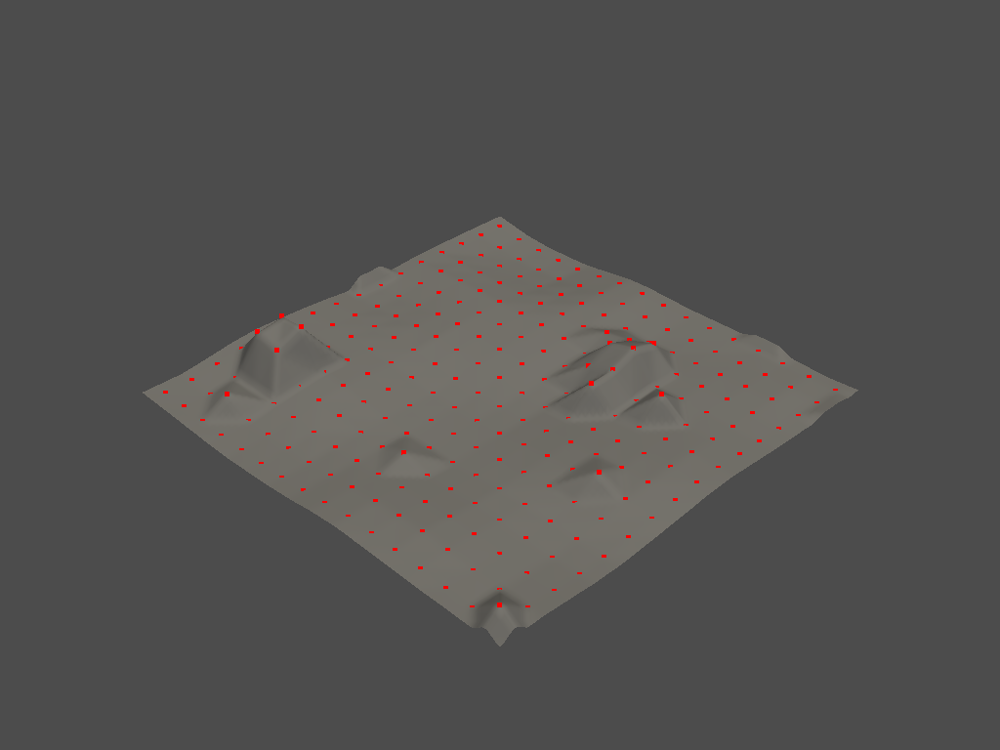

(256, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


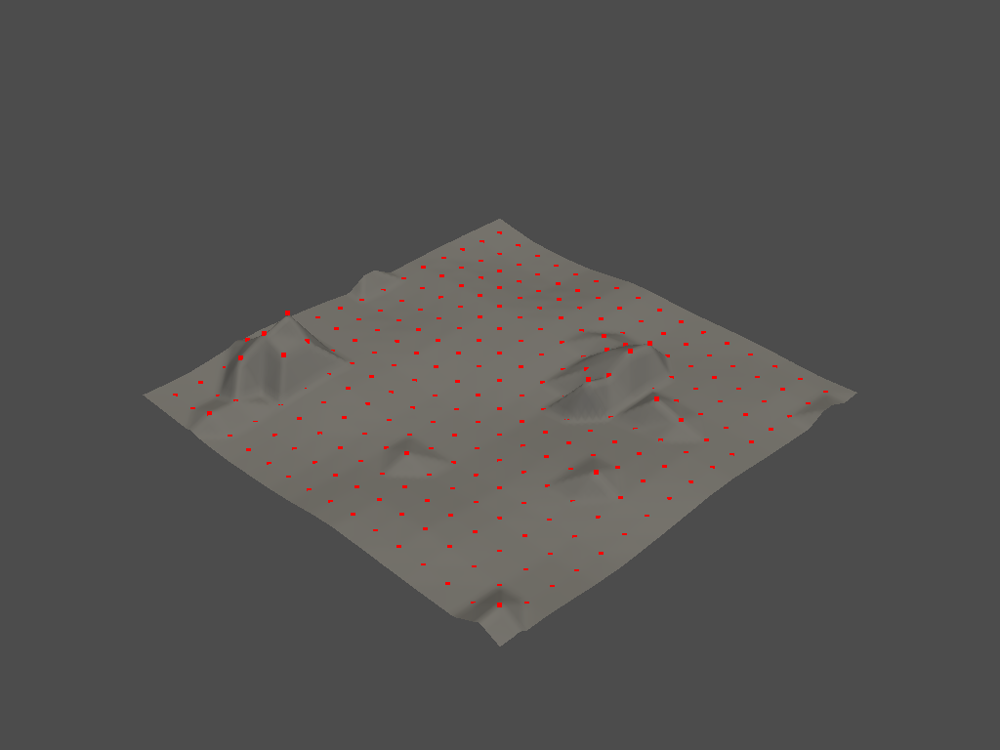

(324, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


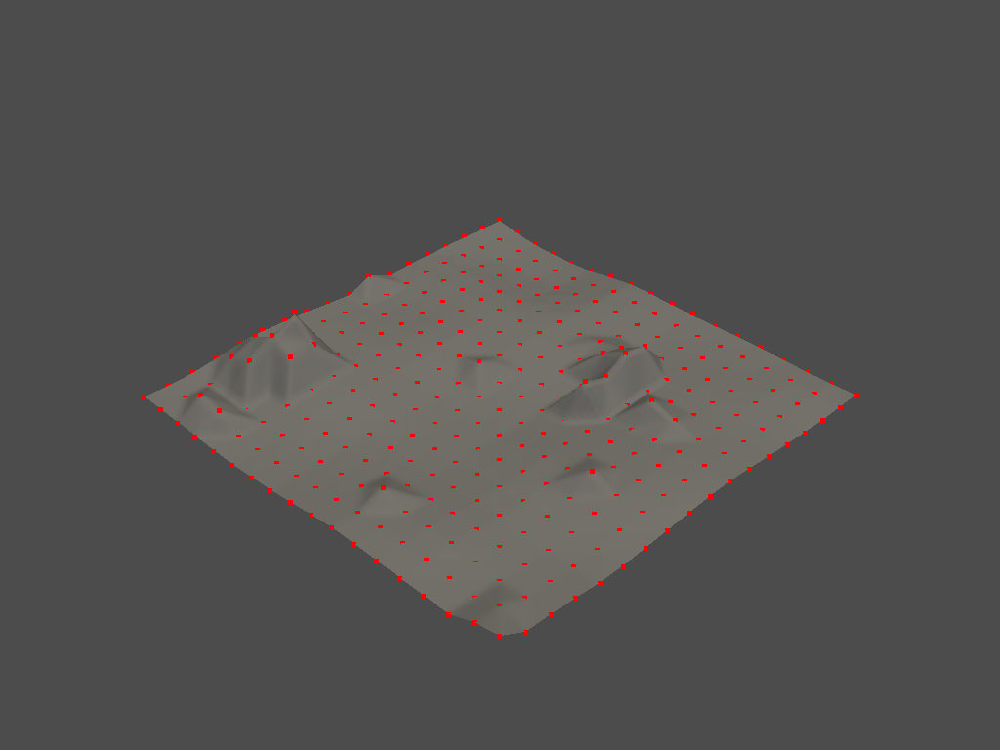

(324, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


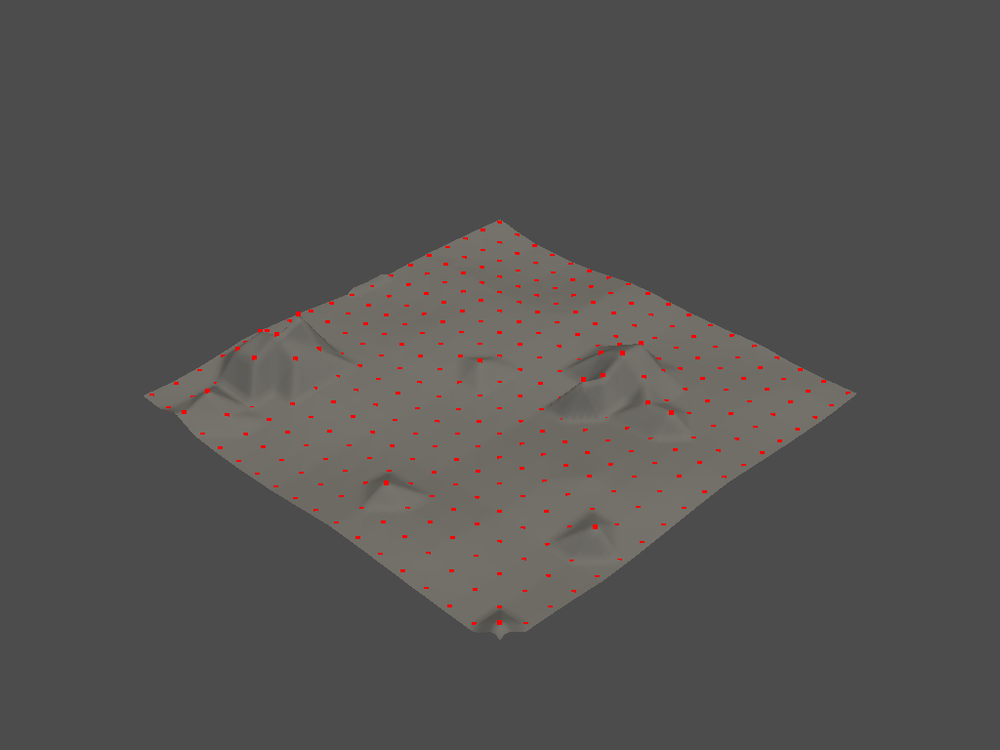

(324, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


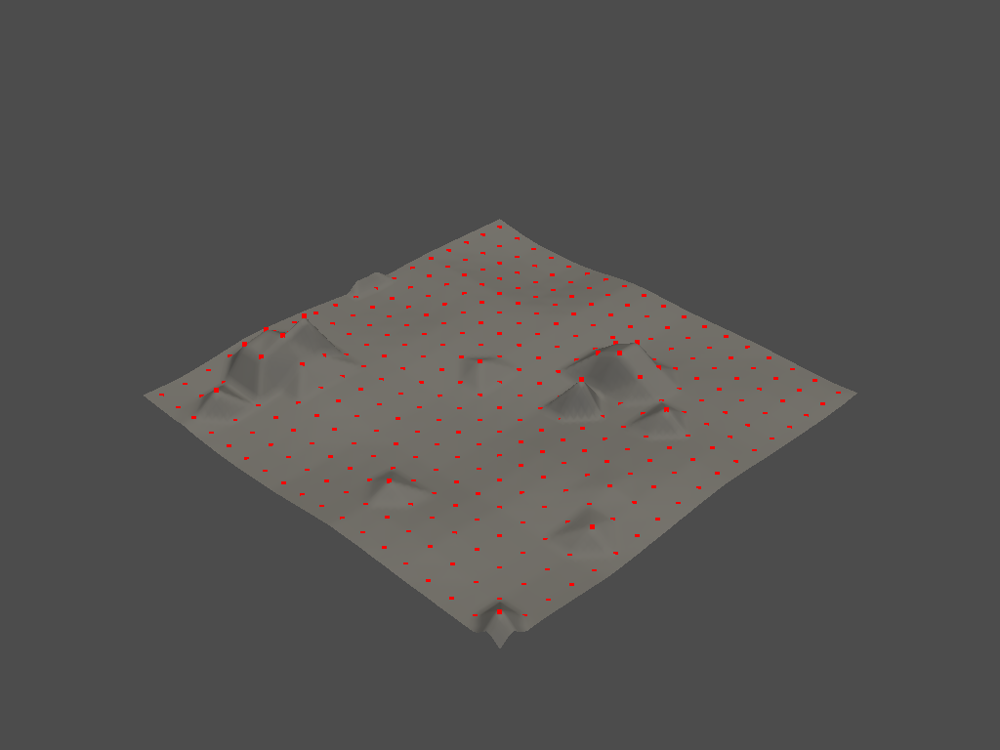

(324, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


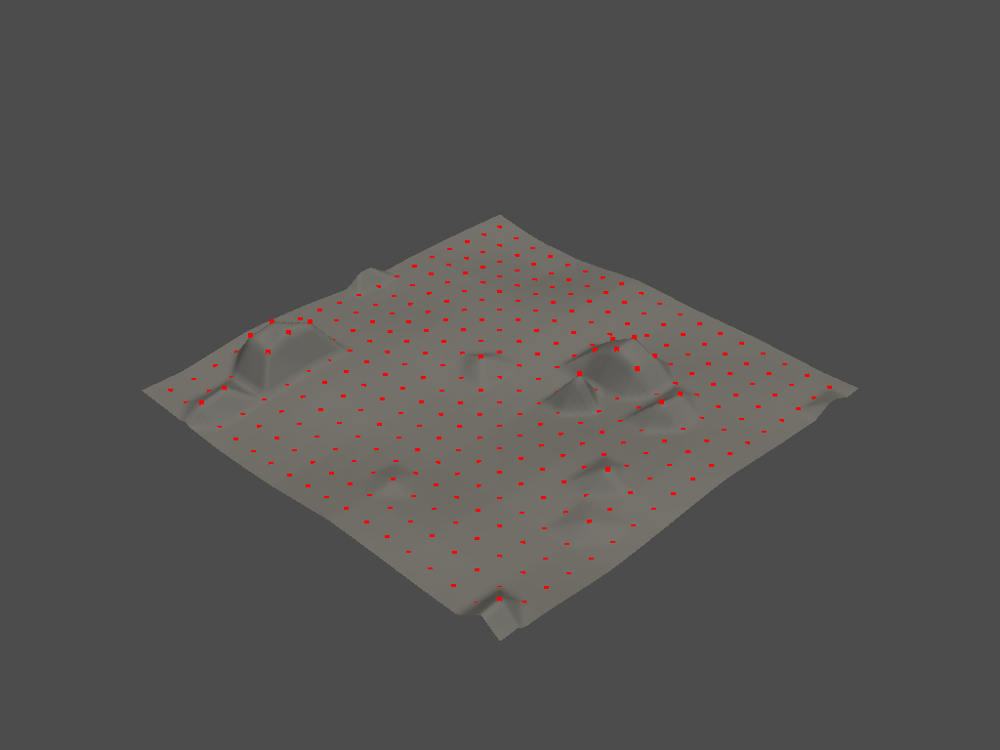

(400, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


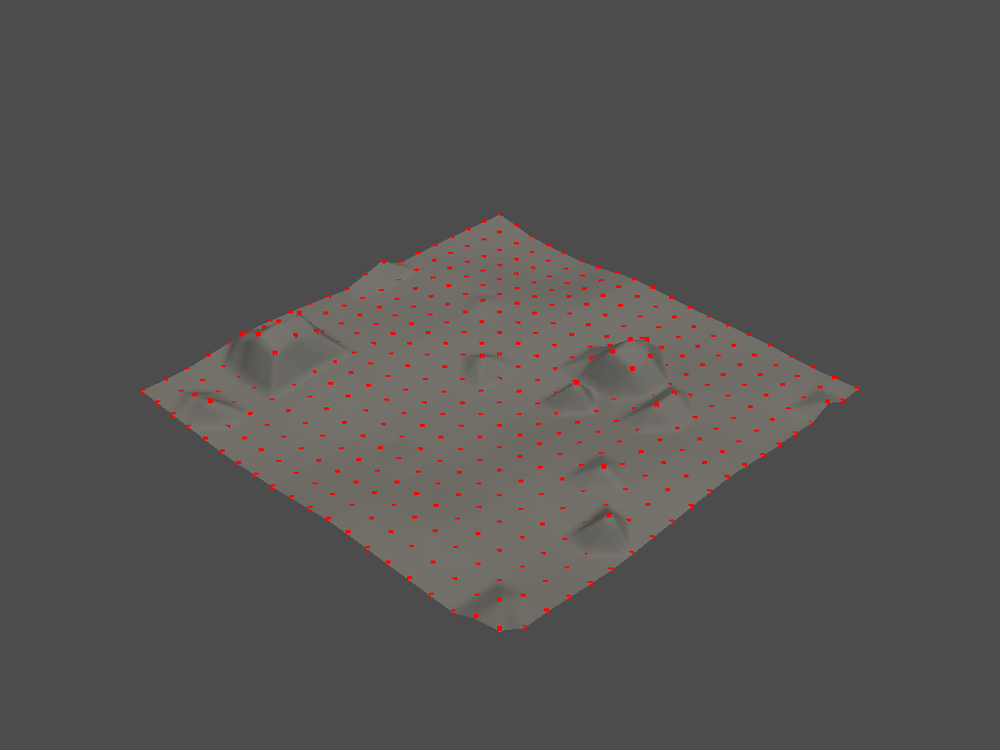

(400, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


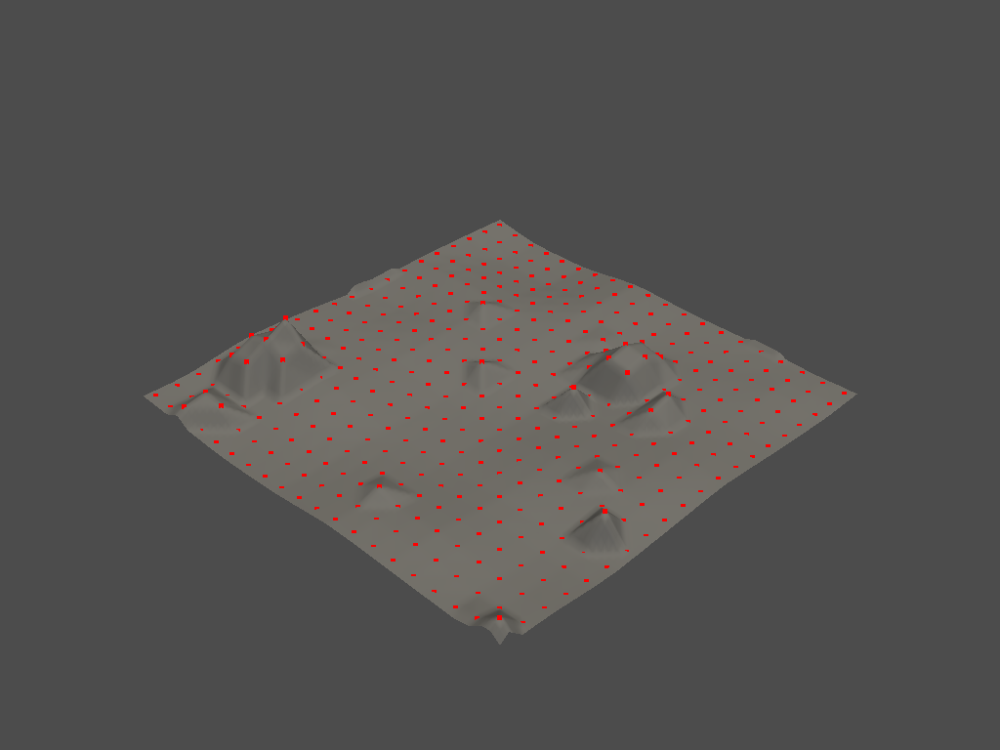

(400, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


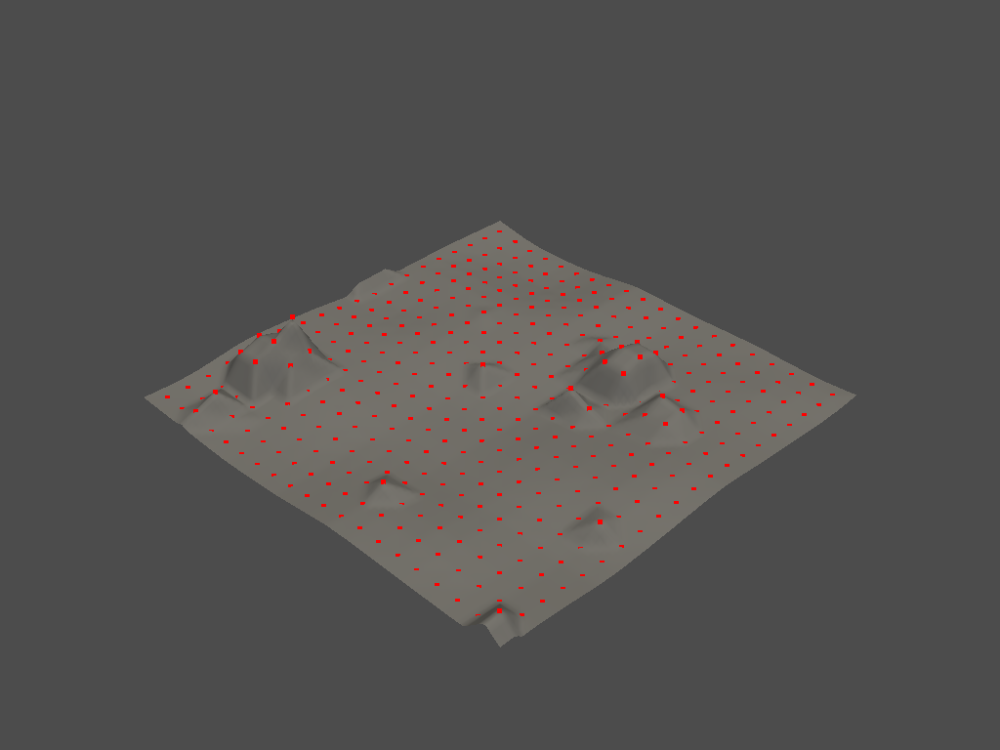

(484, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


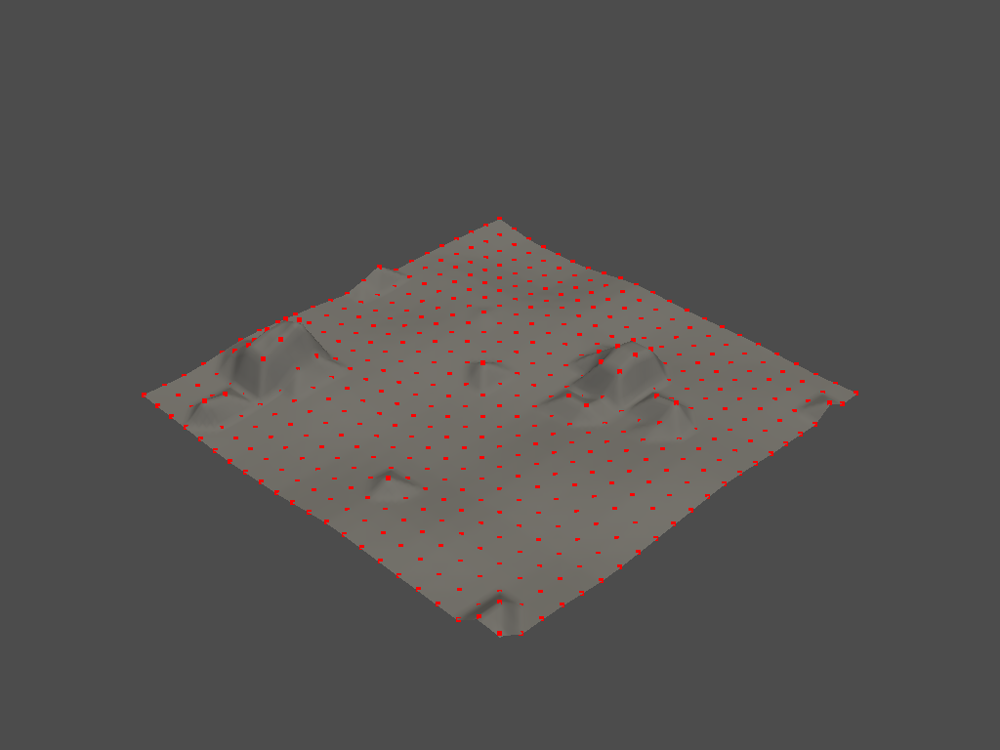

(484, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


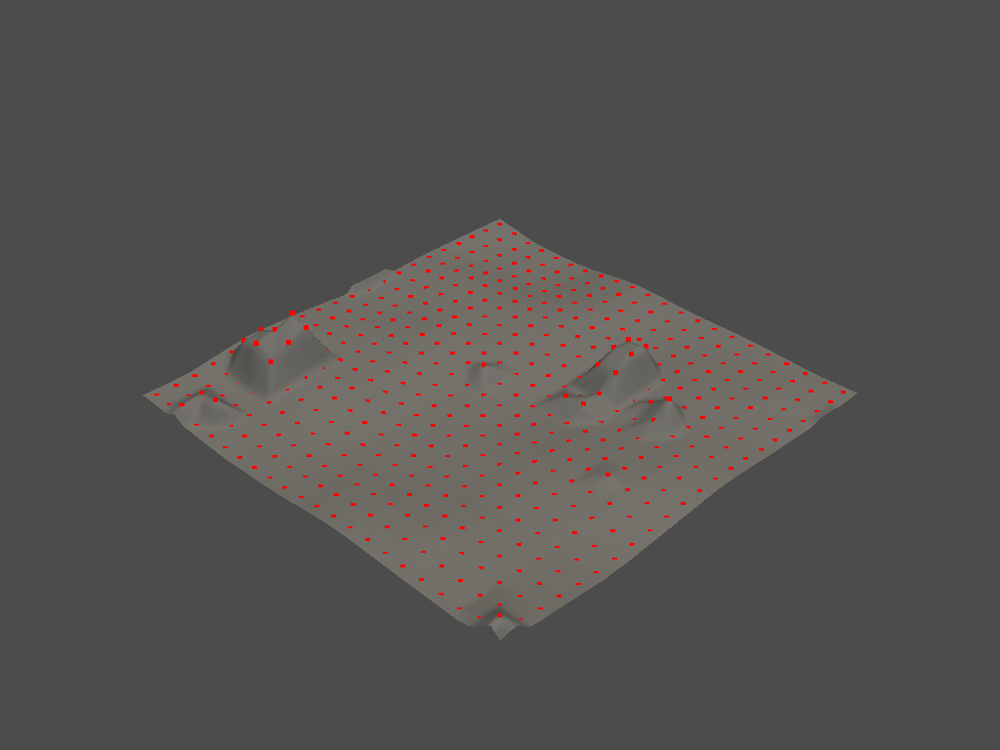

(484, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


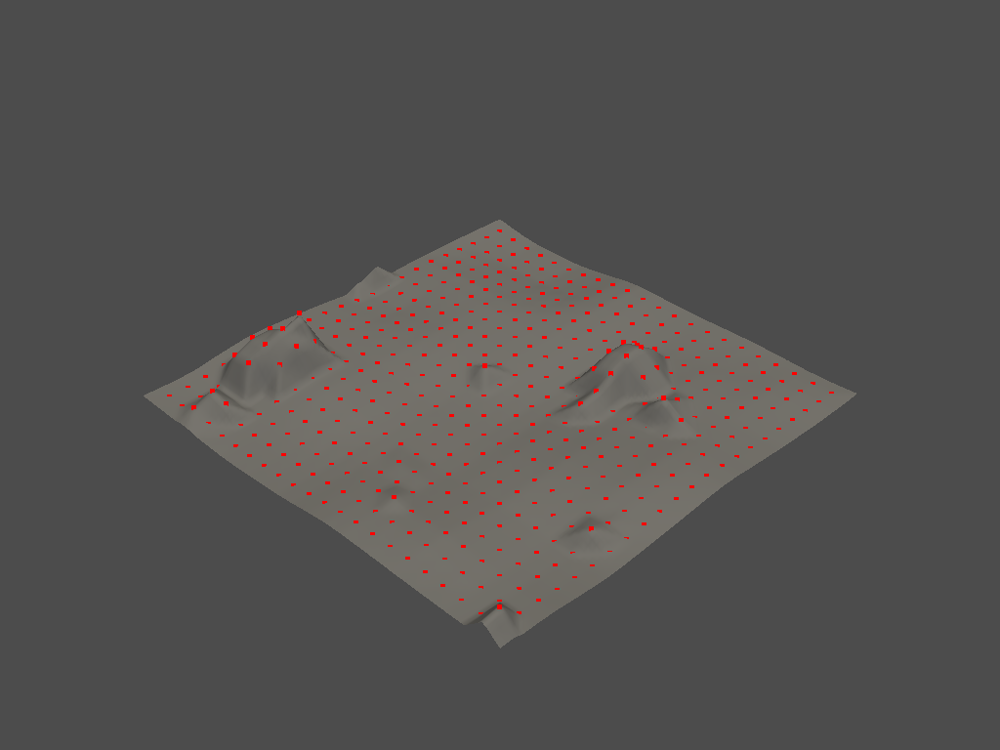

(576, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


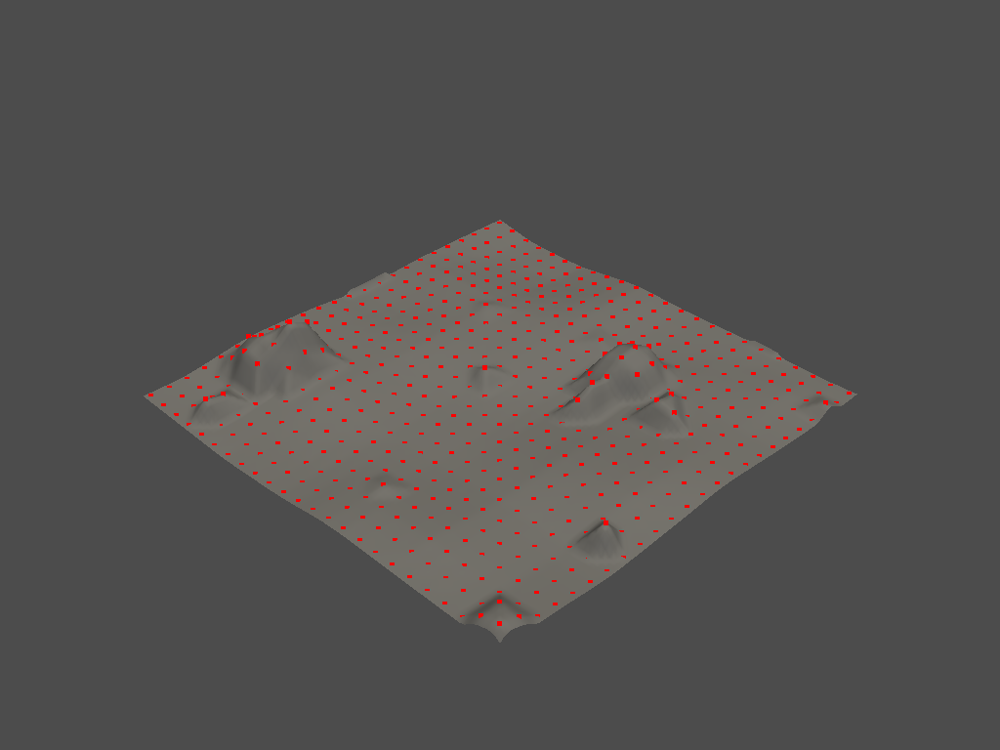

(576, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


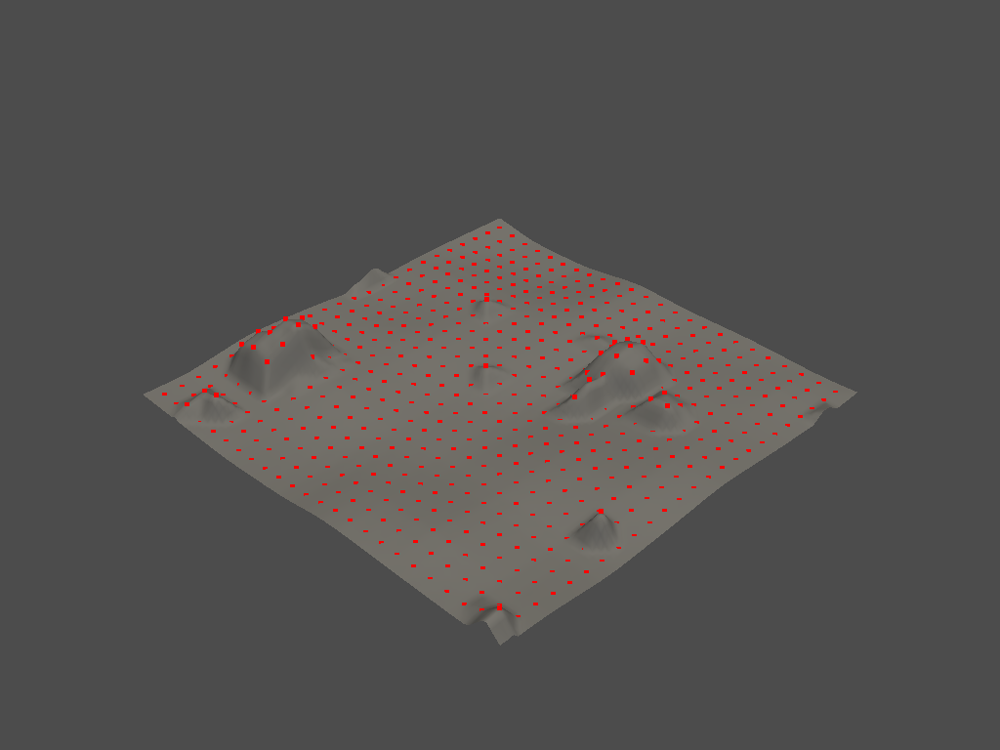

(676, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


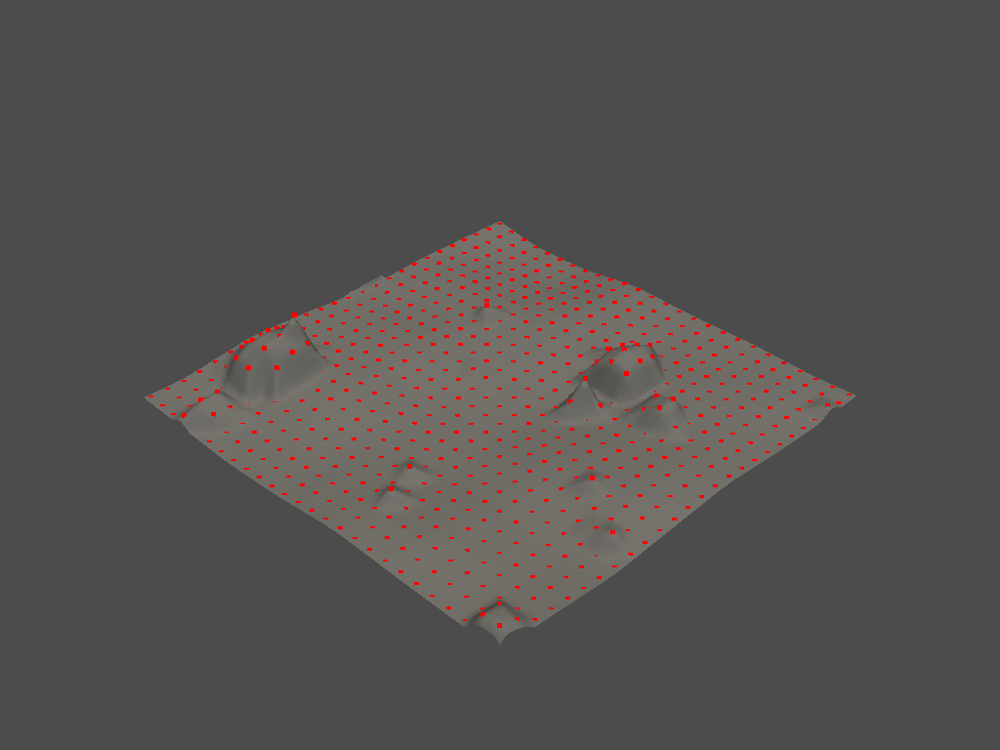

(677, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


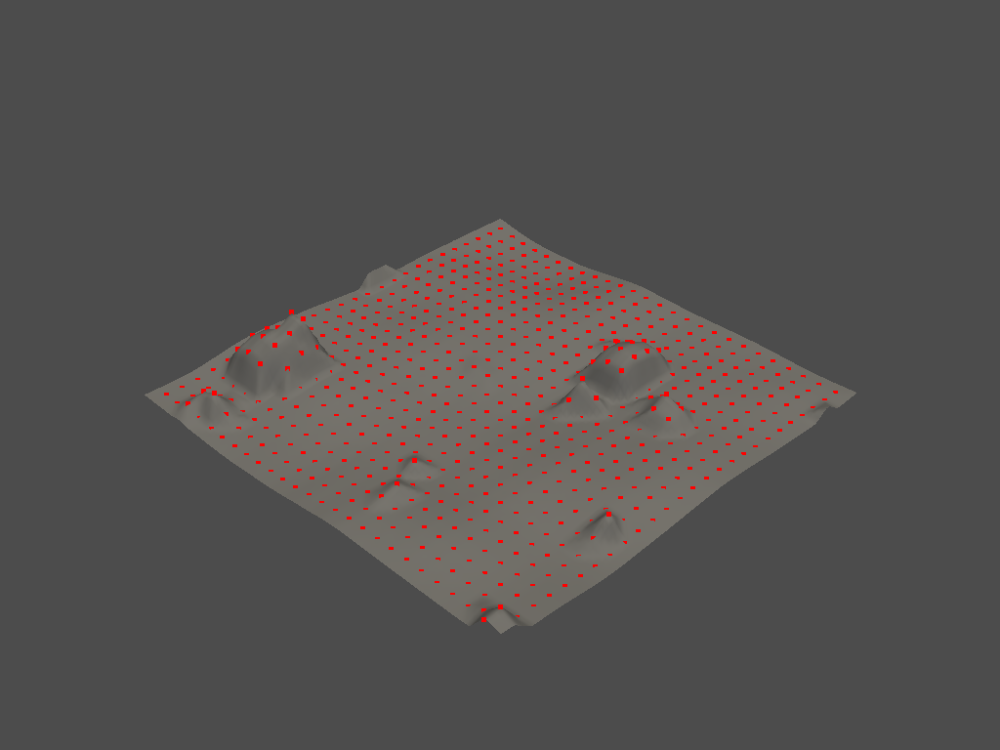

(784, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


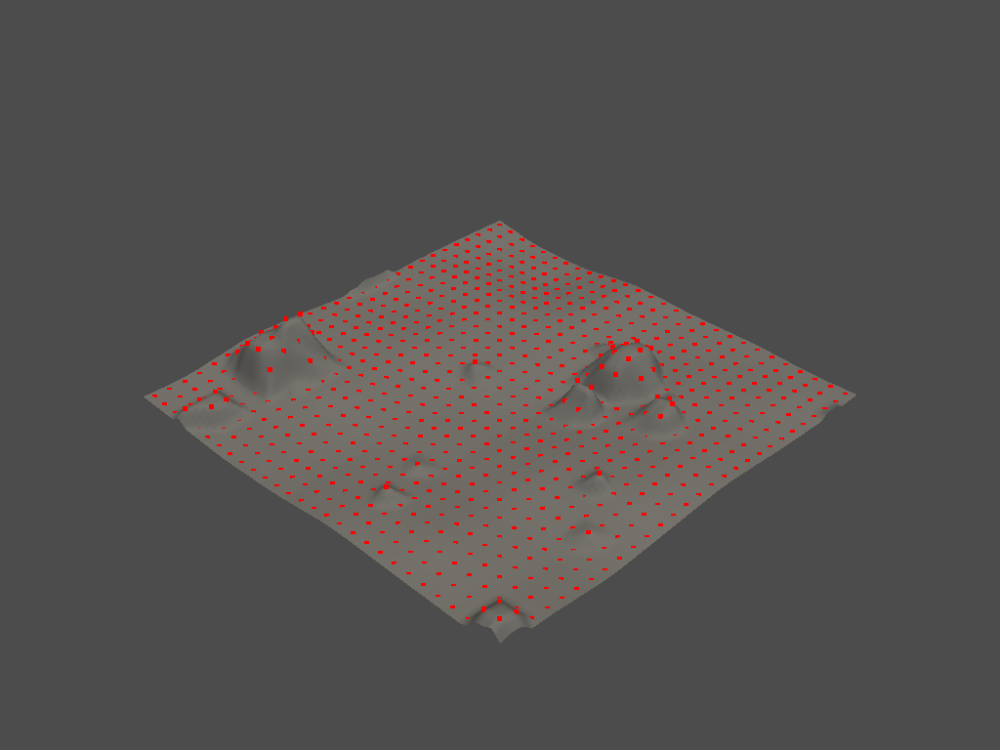

(899, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


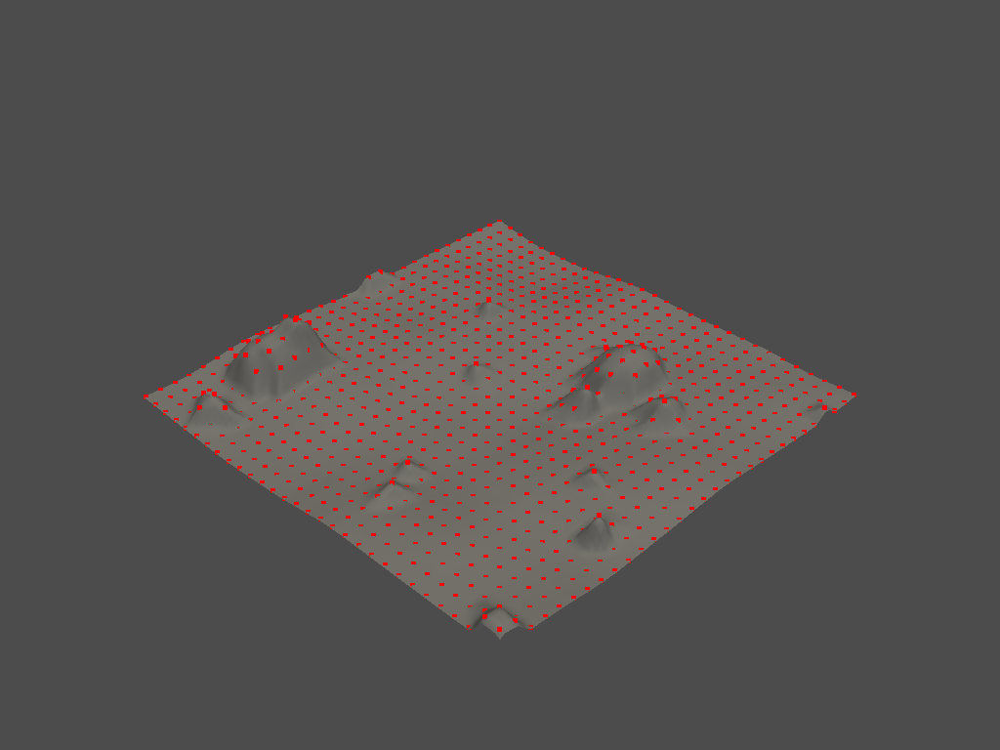

(939, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


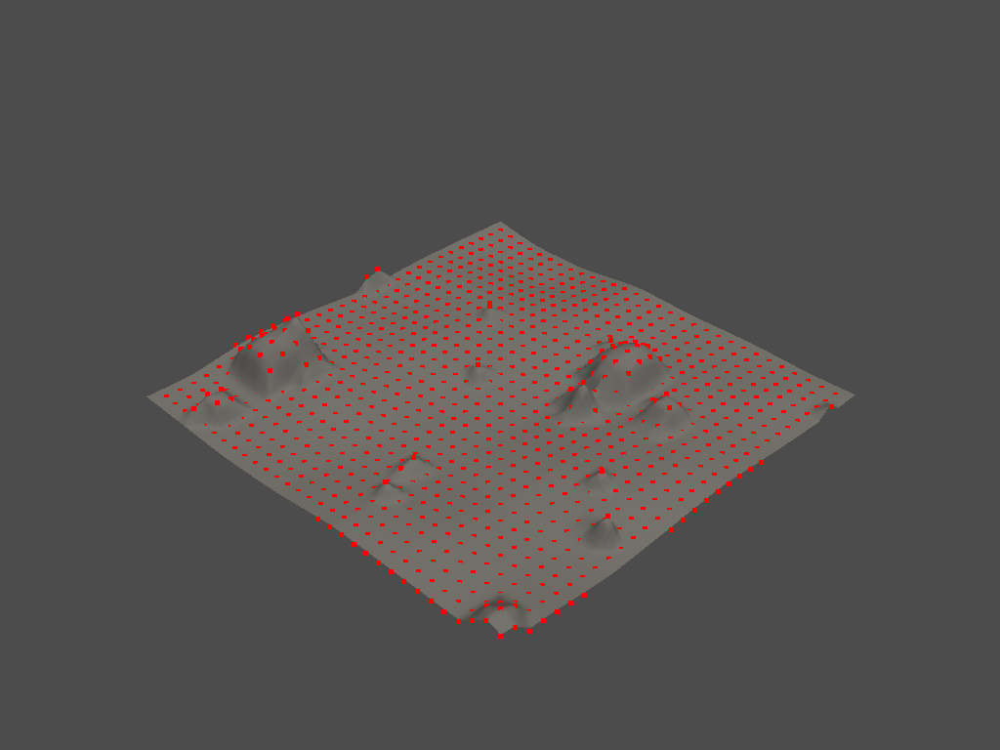

(1024, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


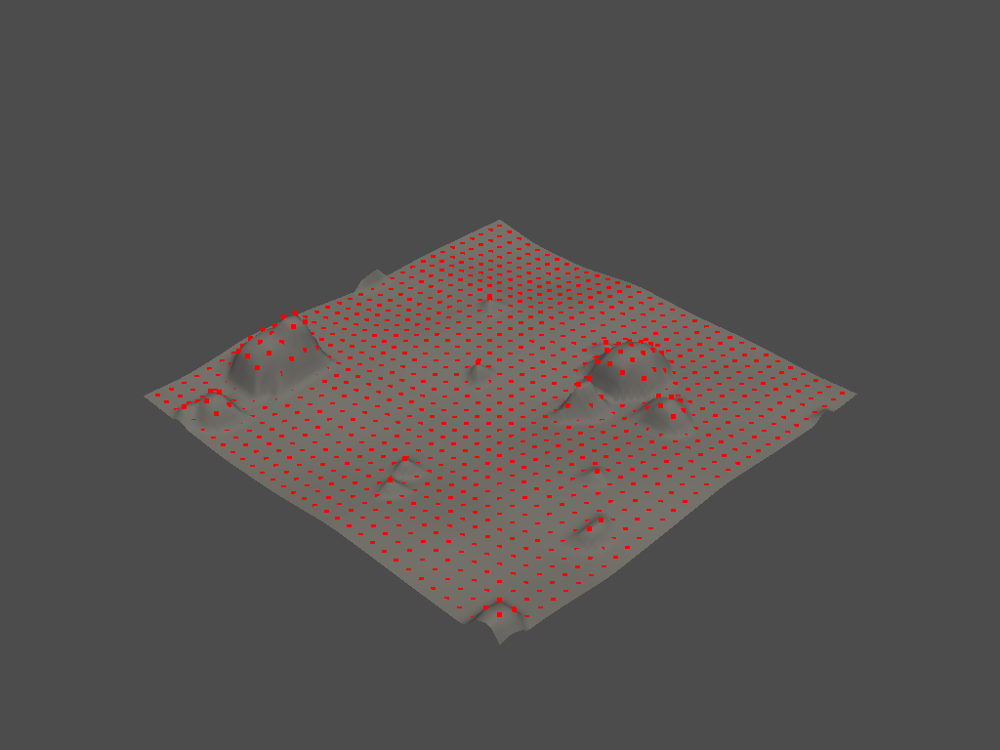

(1156, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


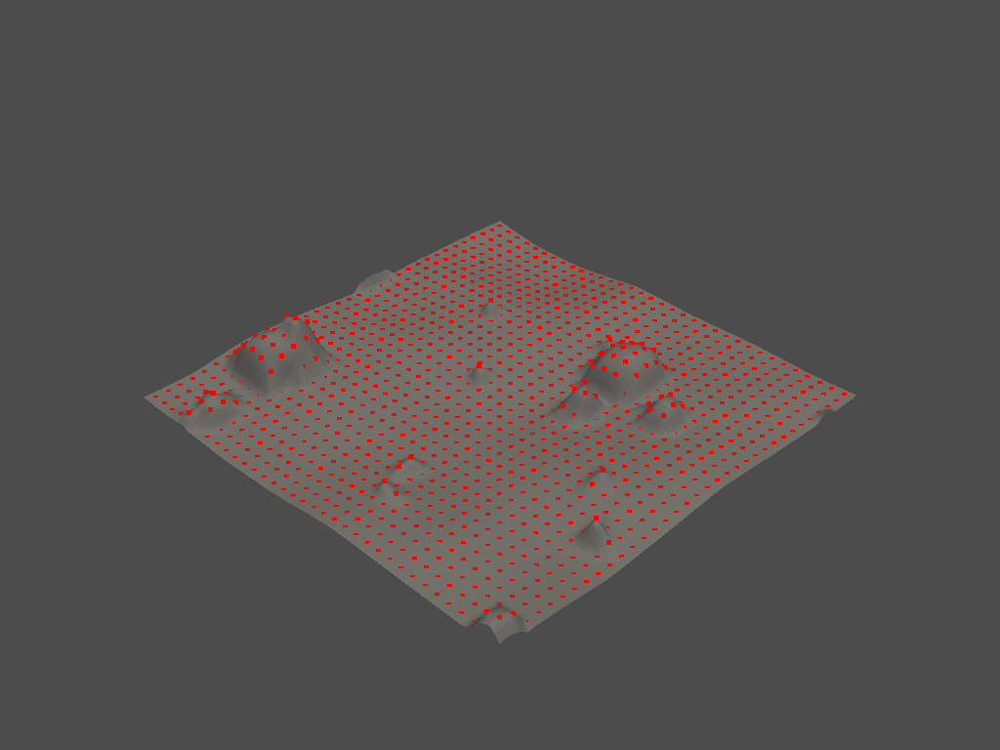

(1296, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


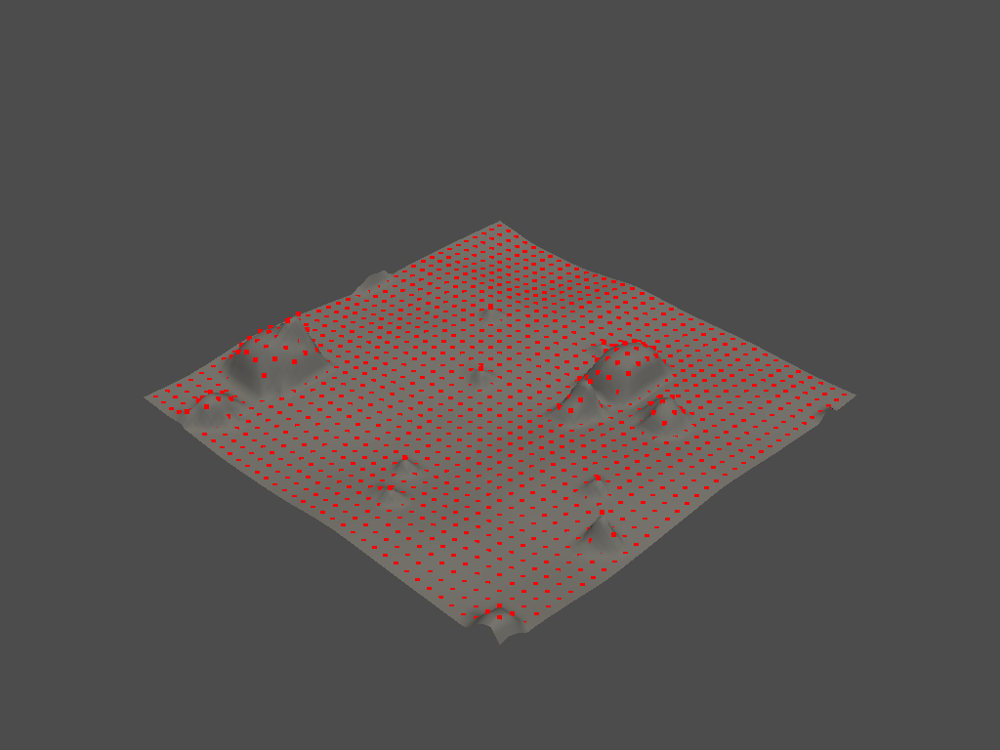

(1450, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


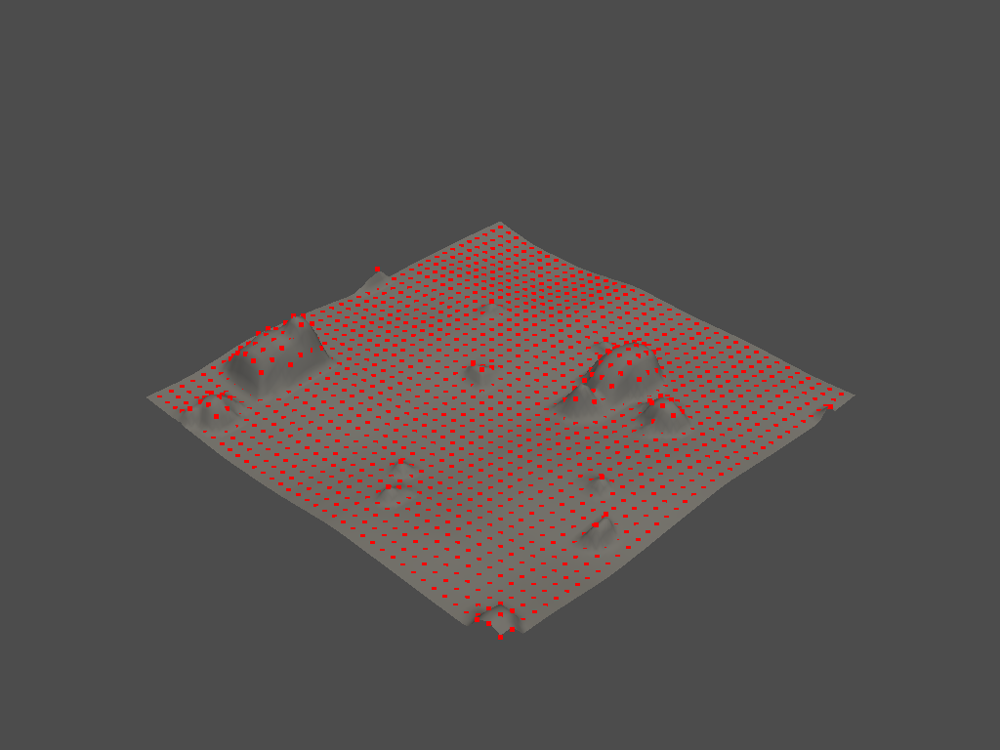

(1764, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


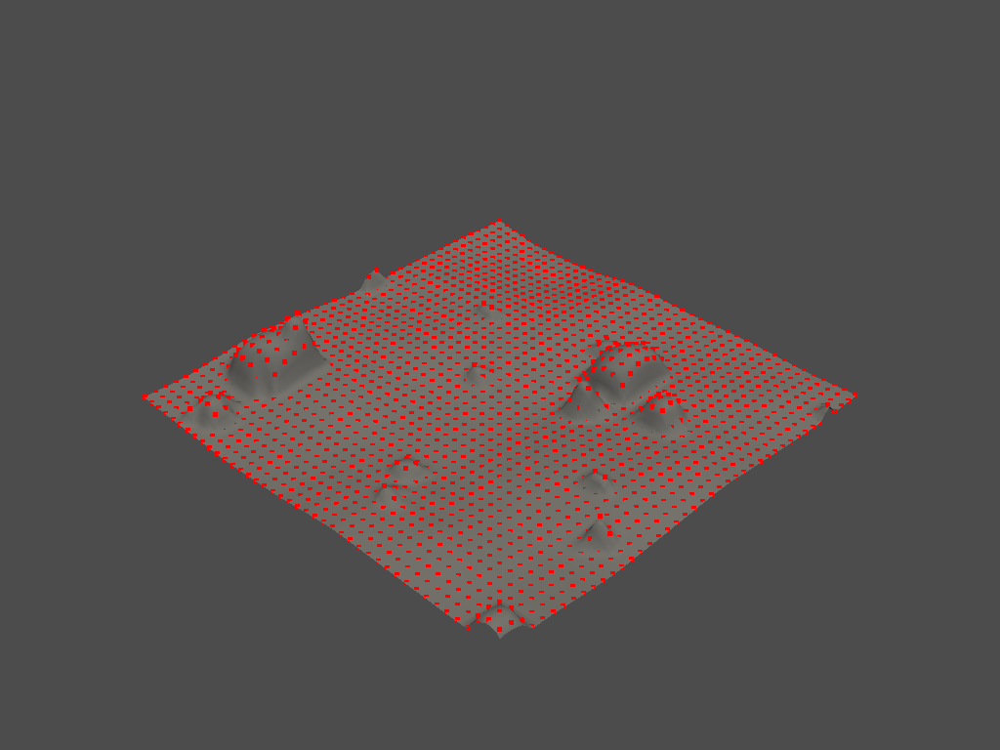

(1936, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


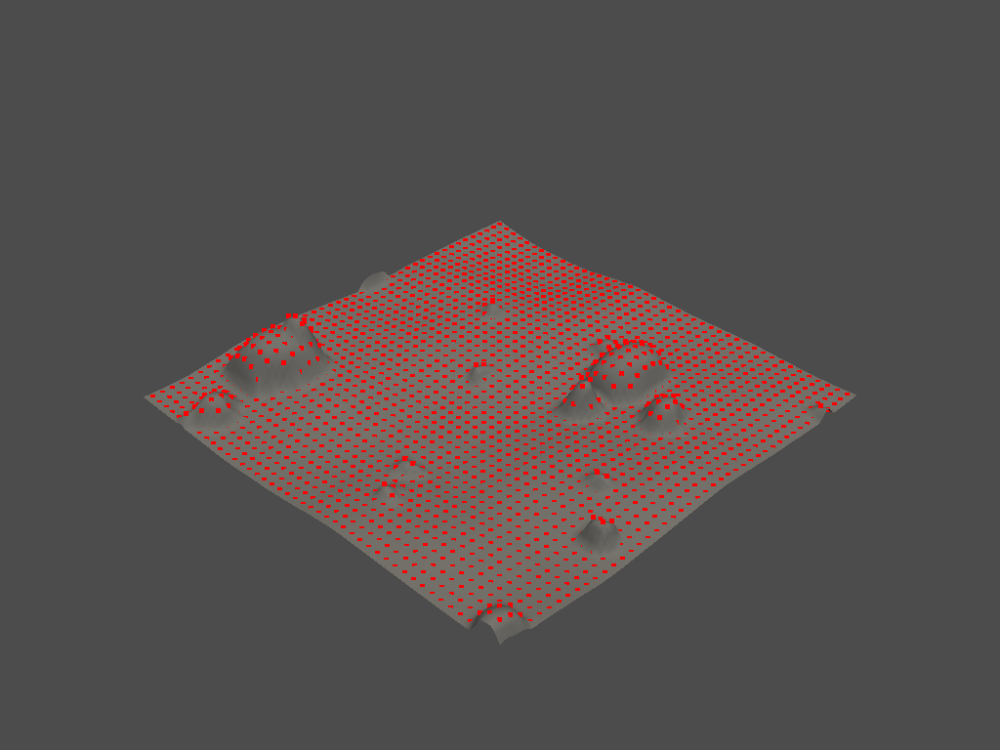

(2304, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


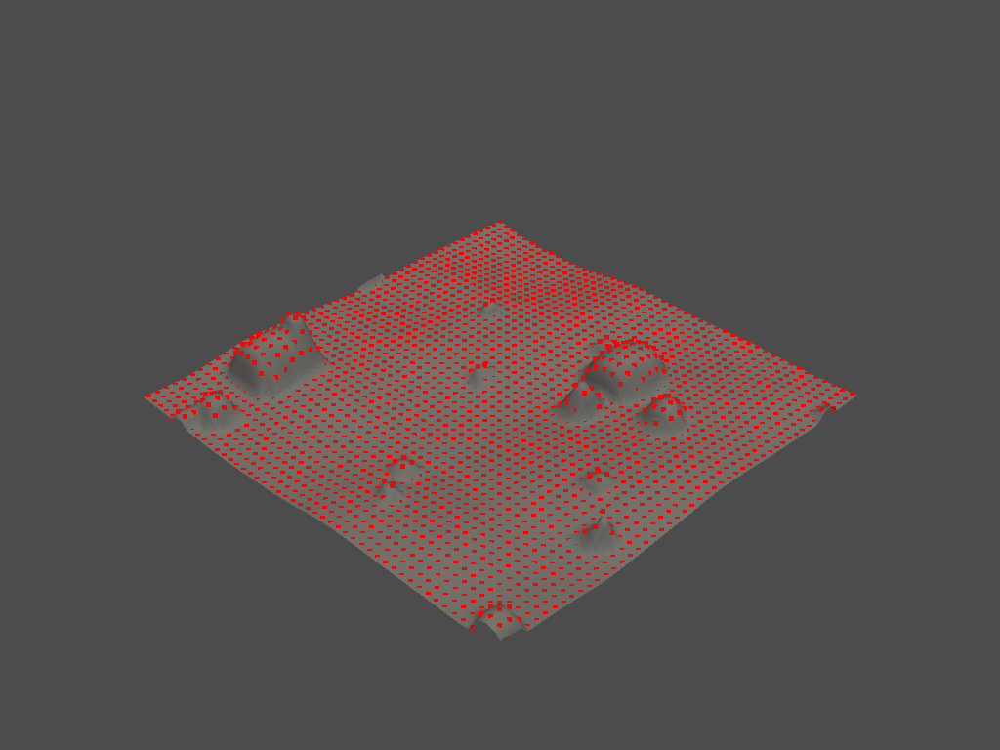

(2704, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


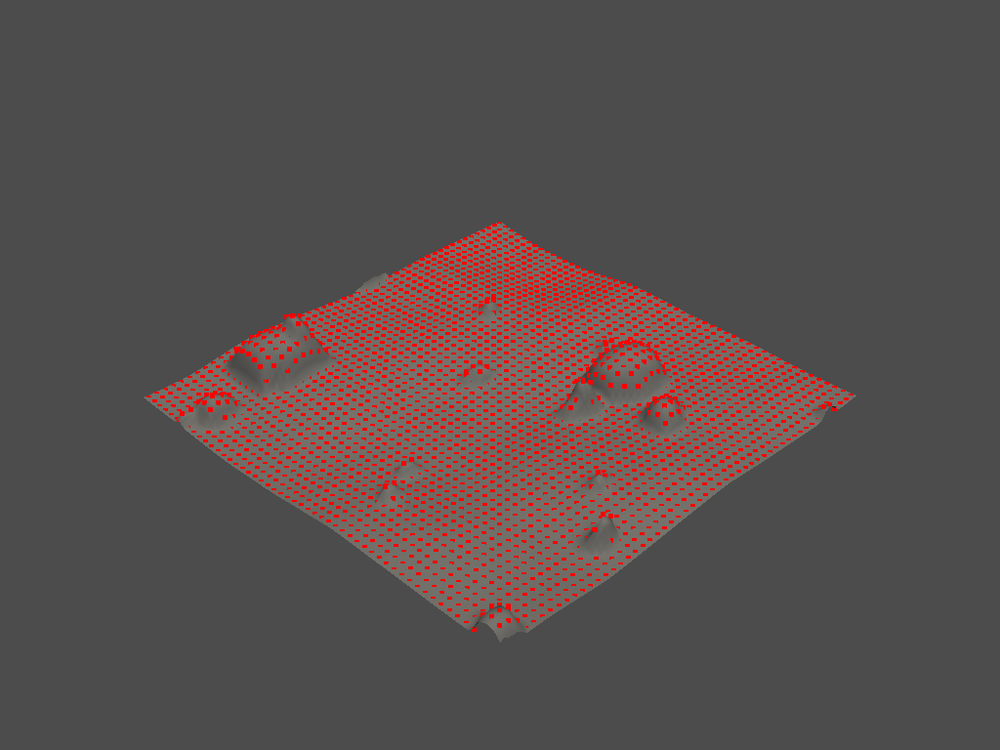

(3349, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


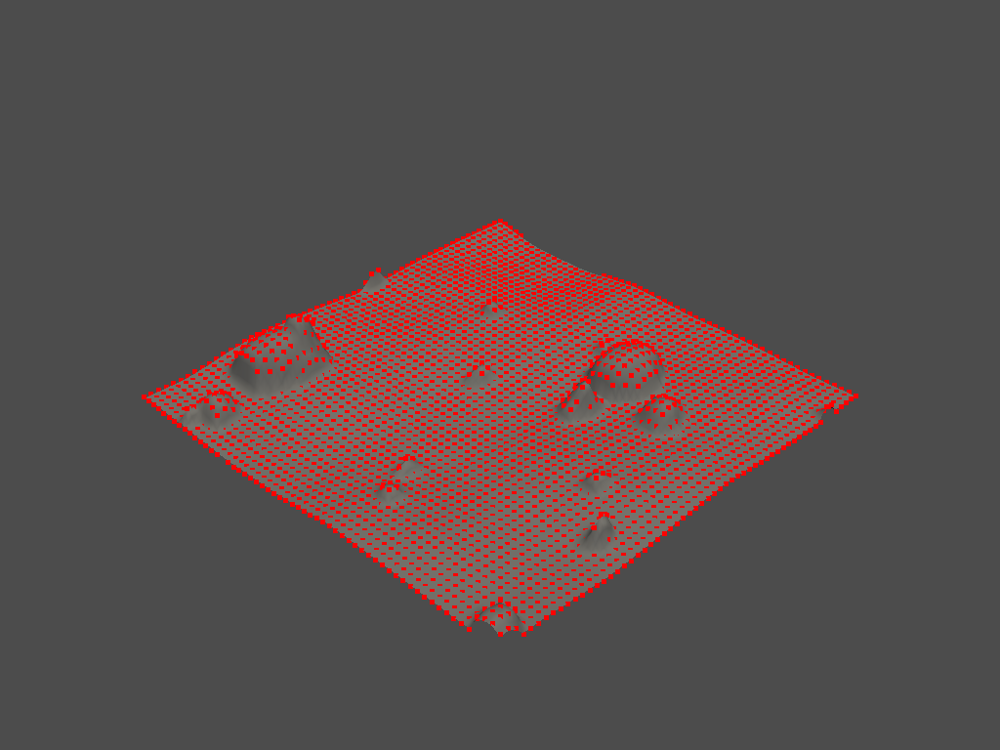

(4031, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


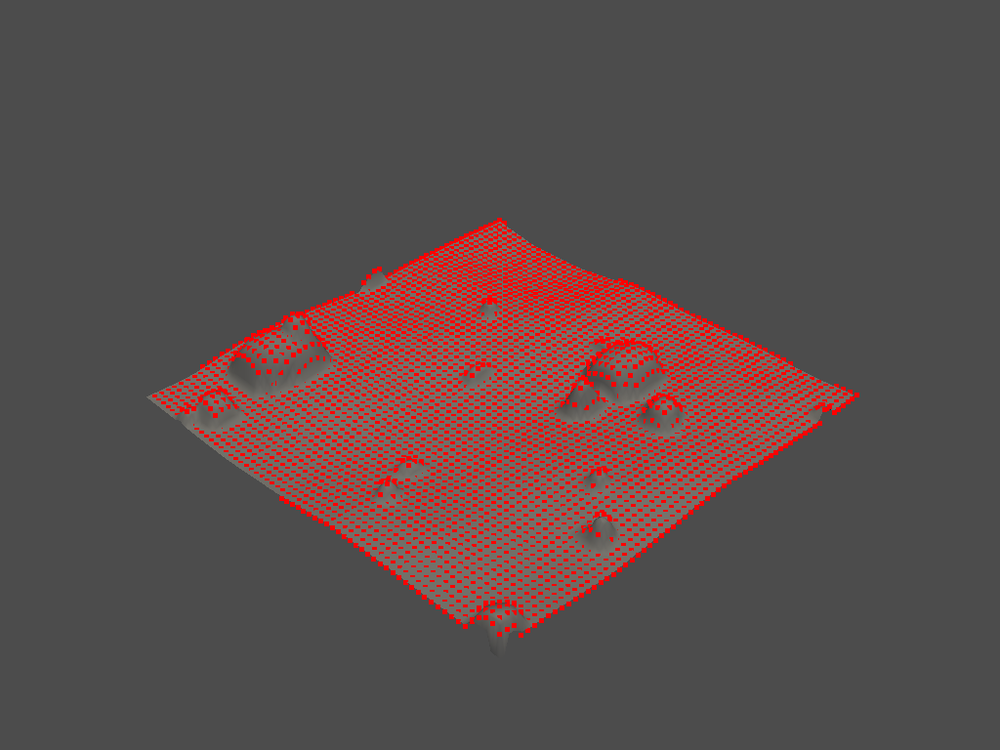

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


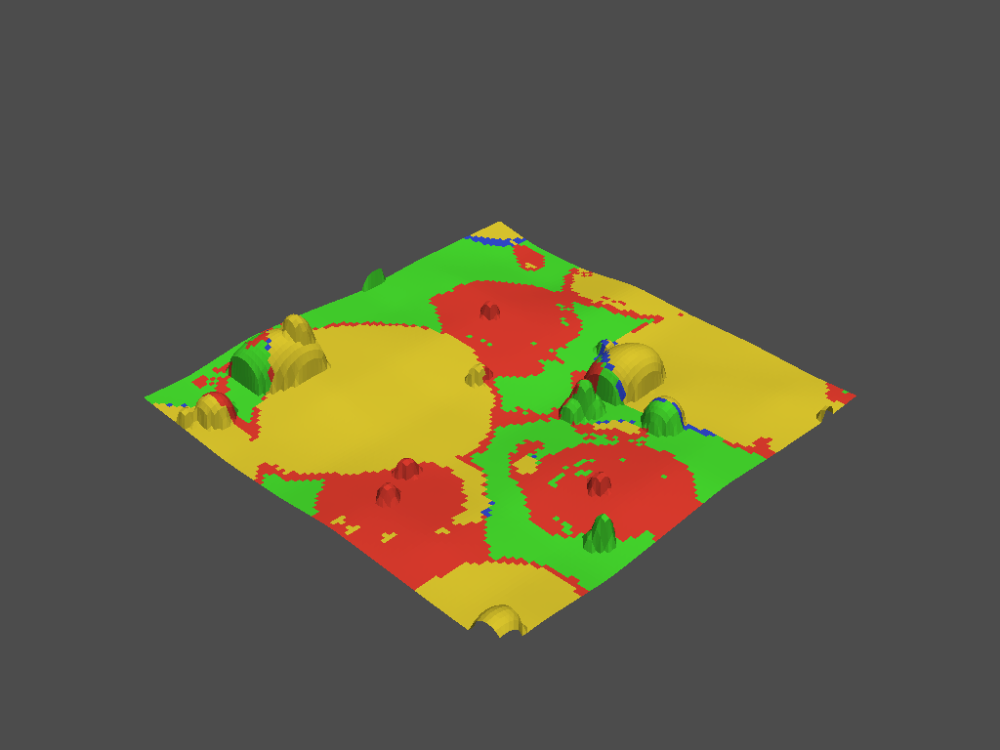

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


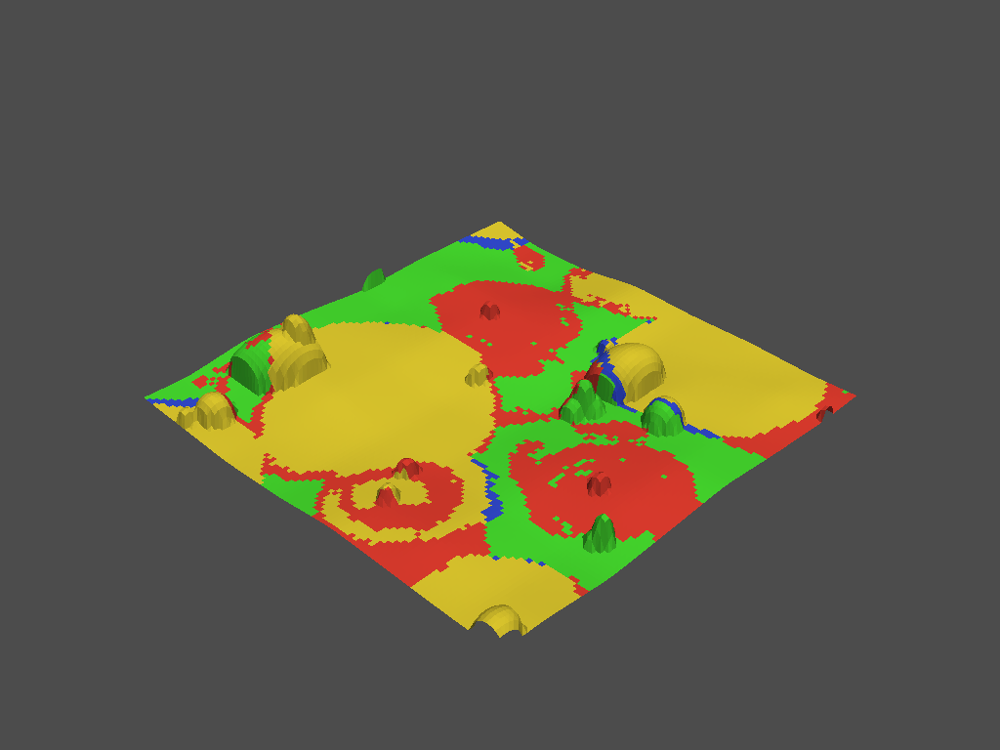

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


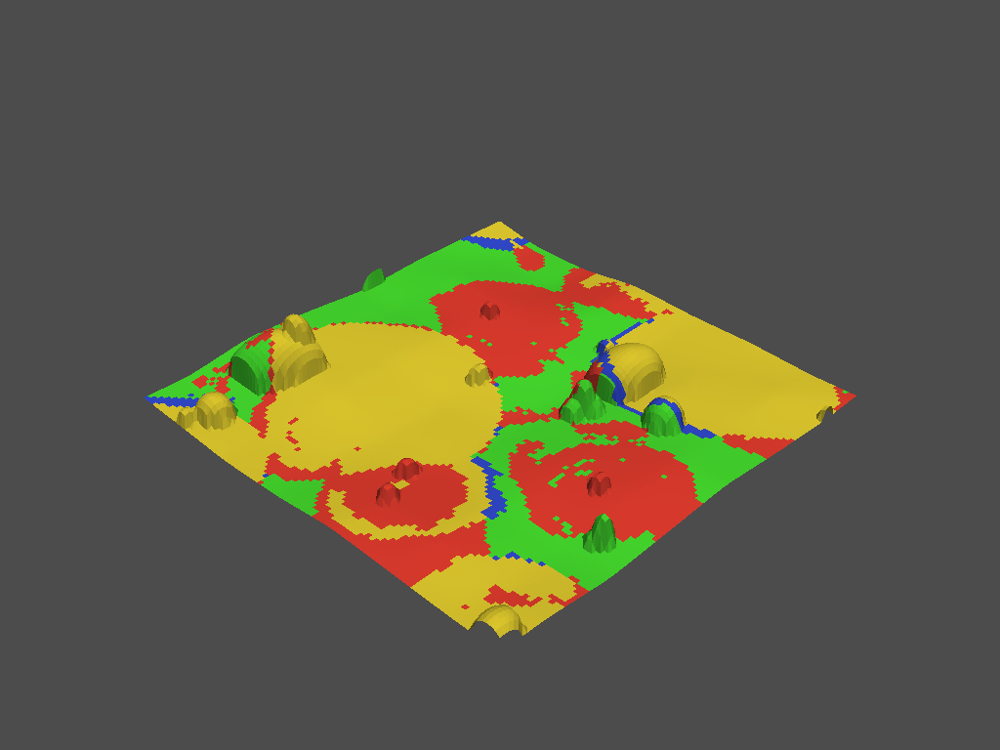

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


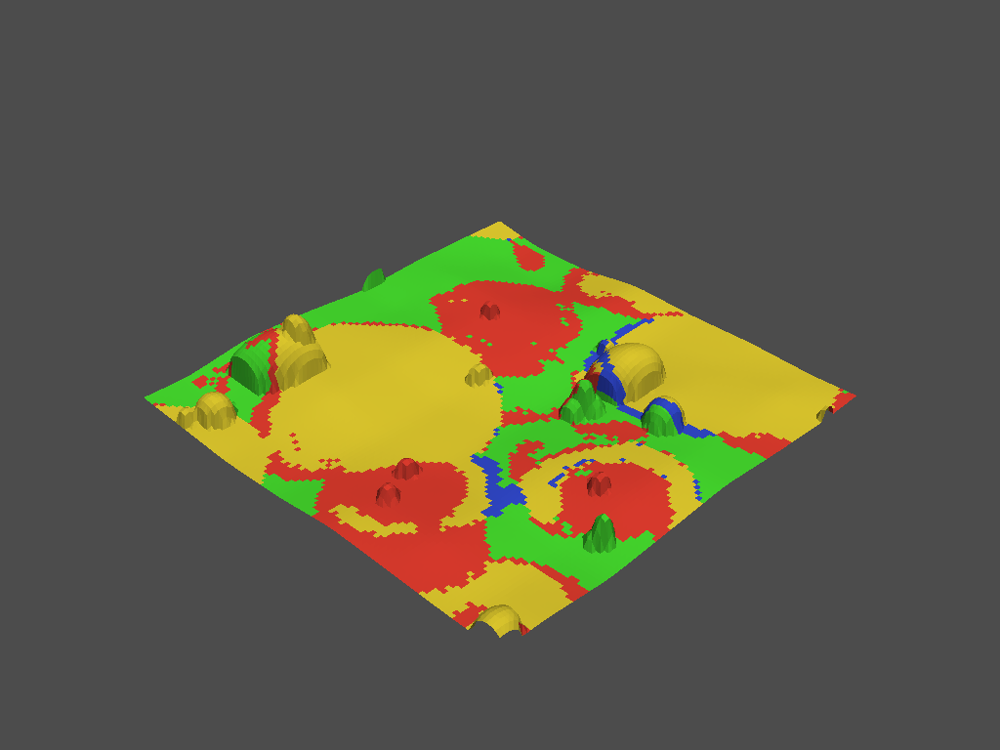

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


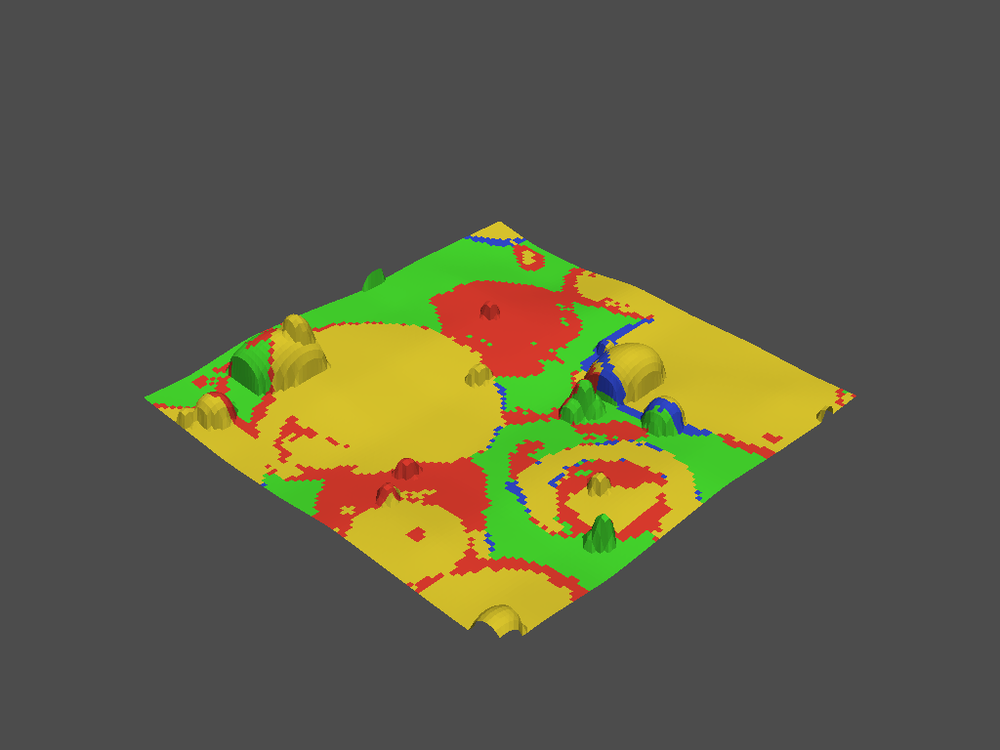

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


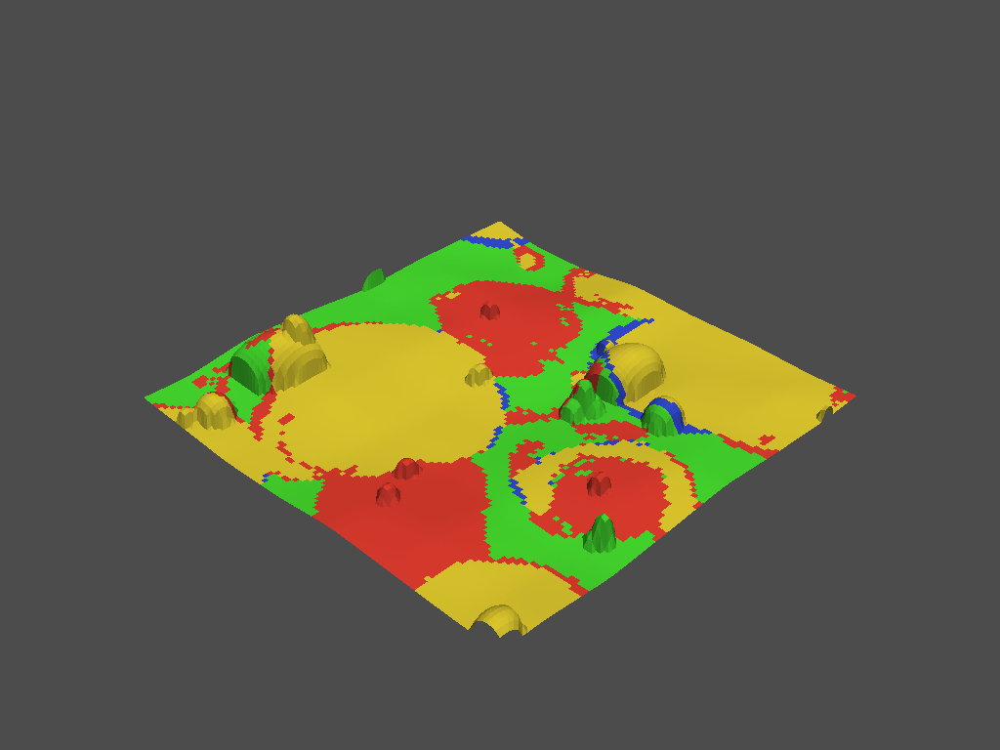

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


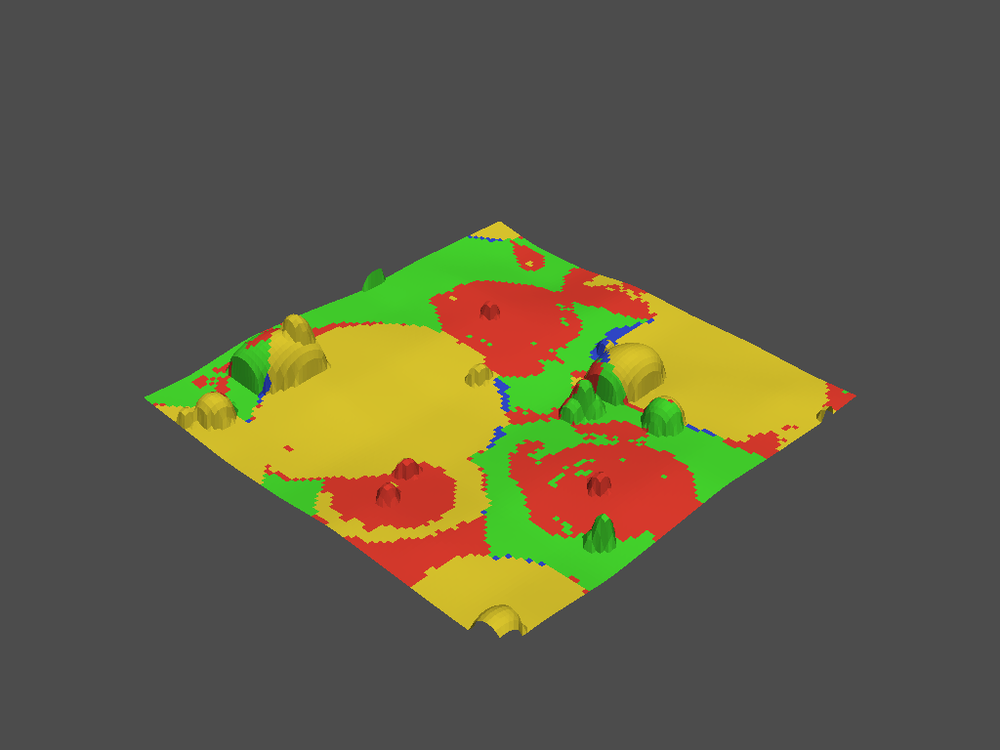

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


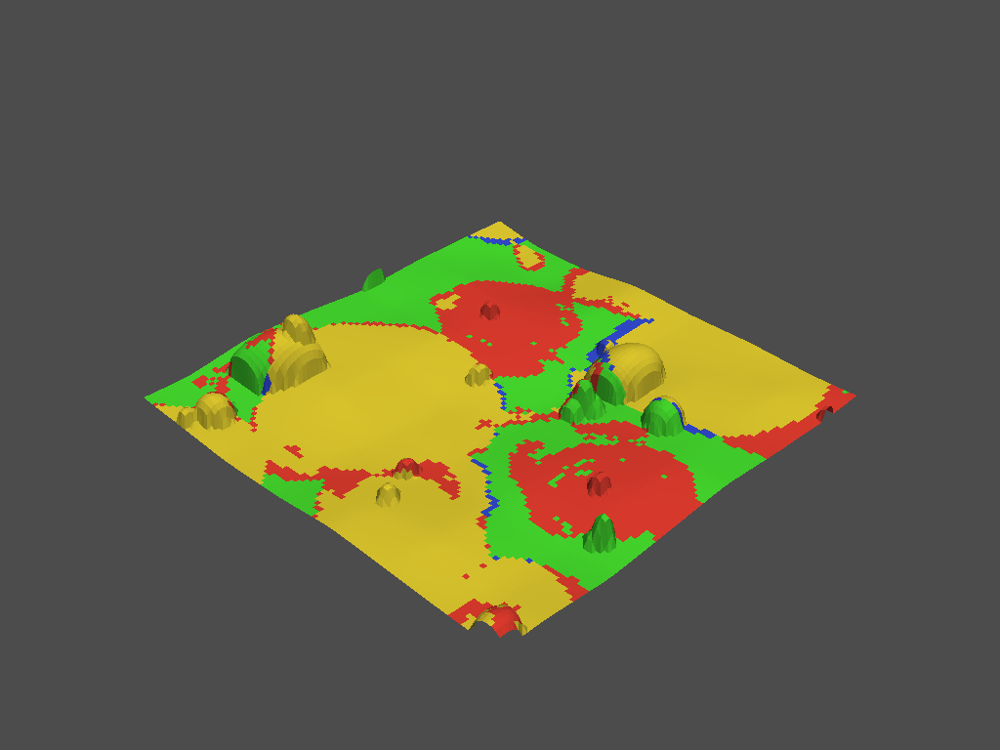

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


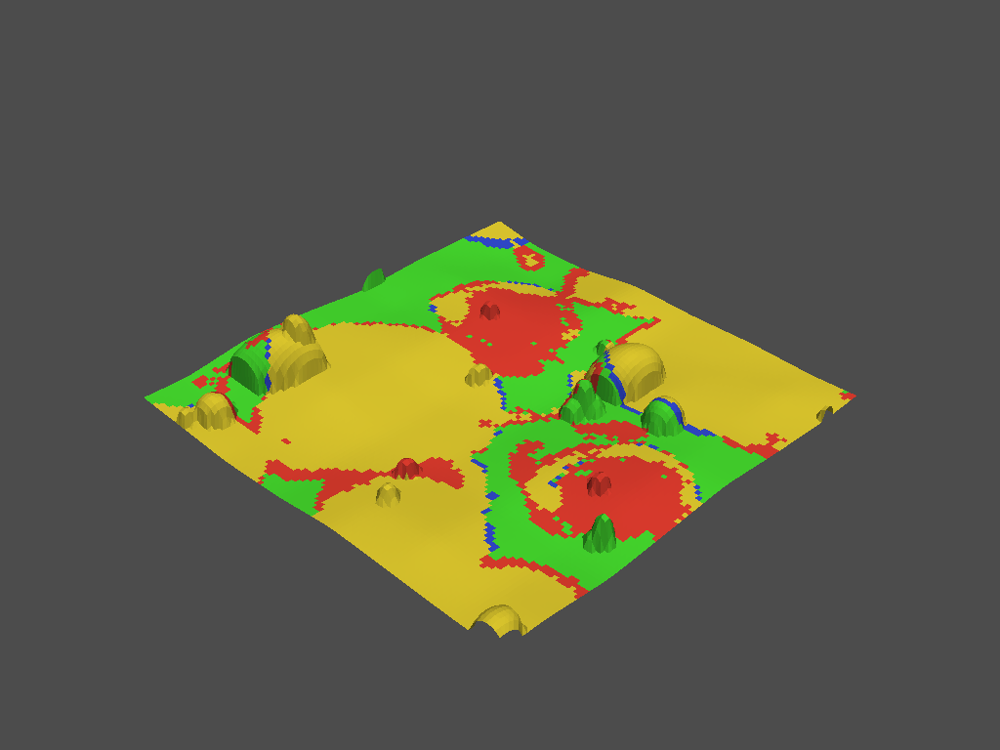

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


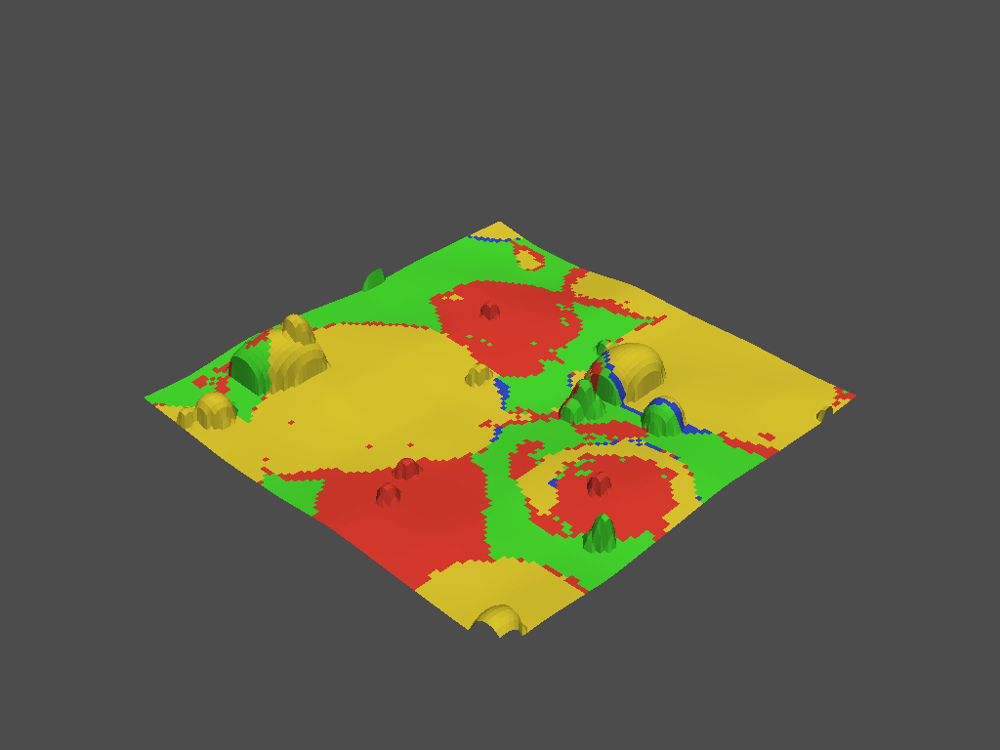

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


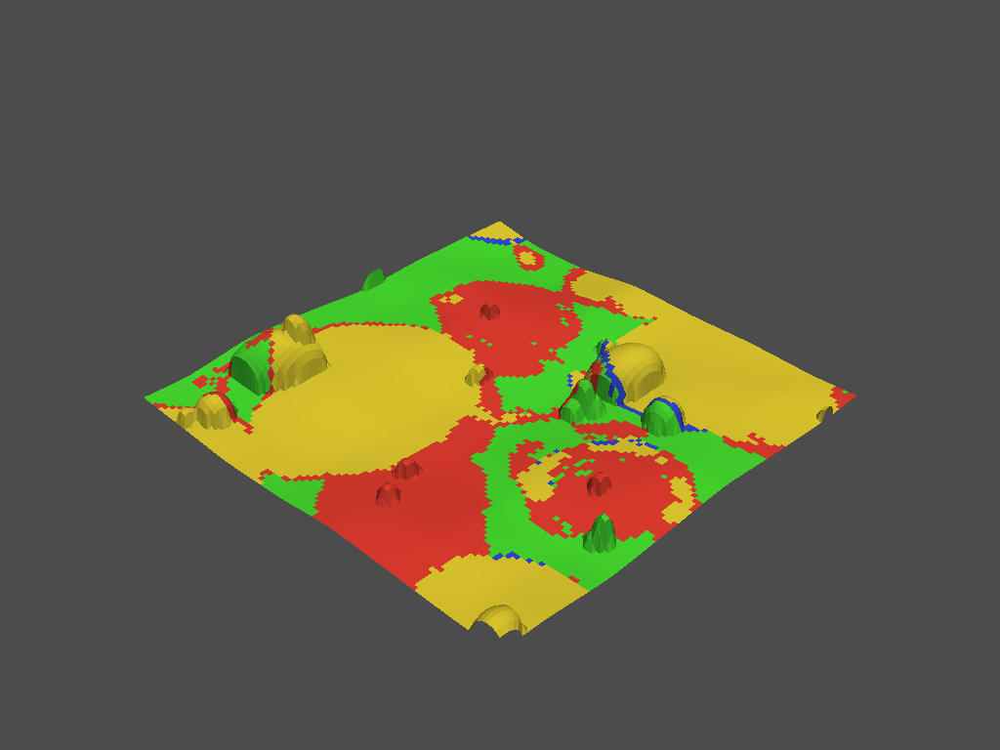

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


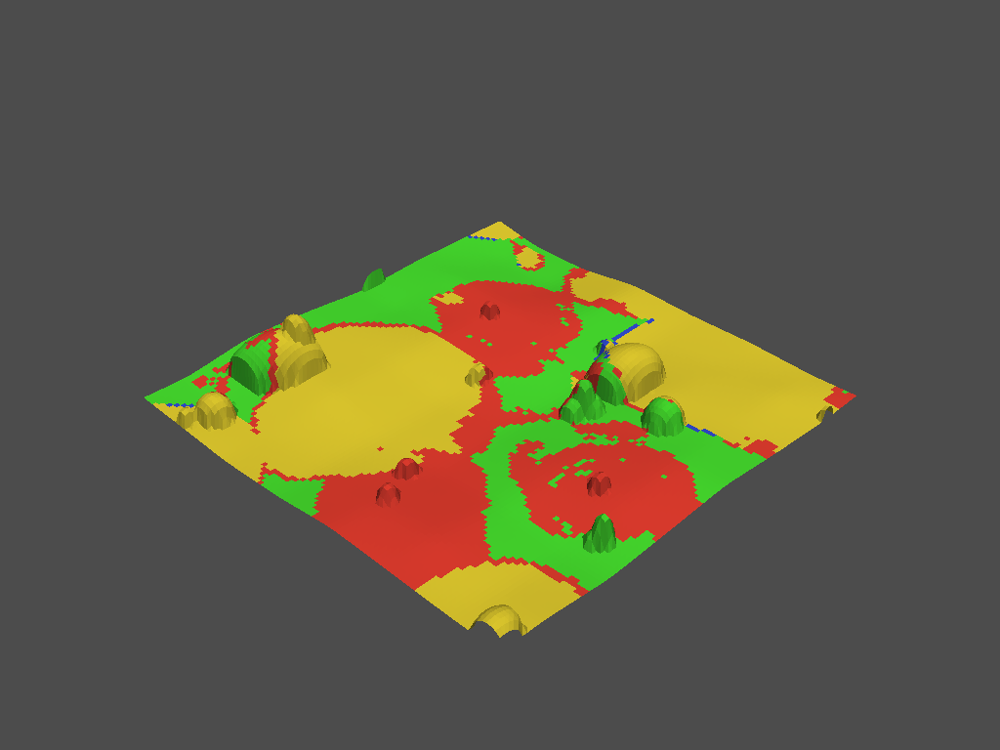

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


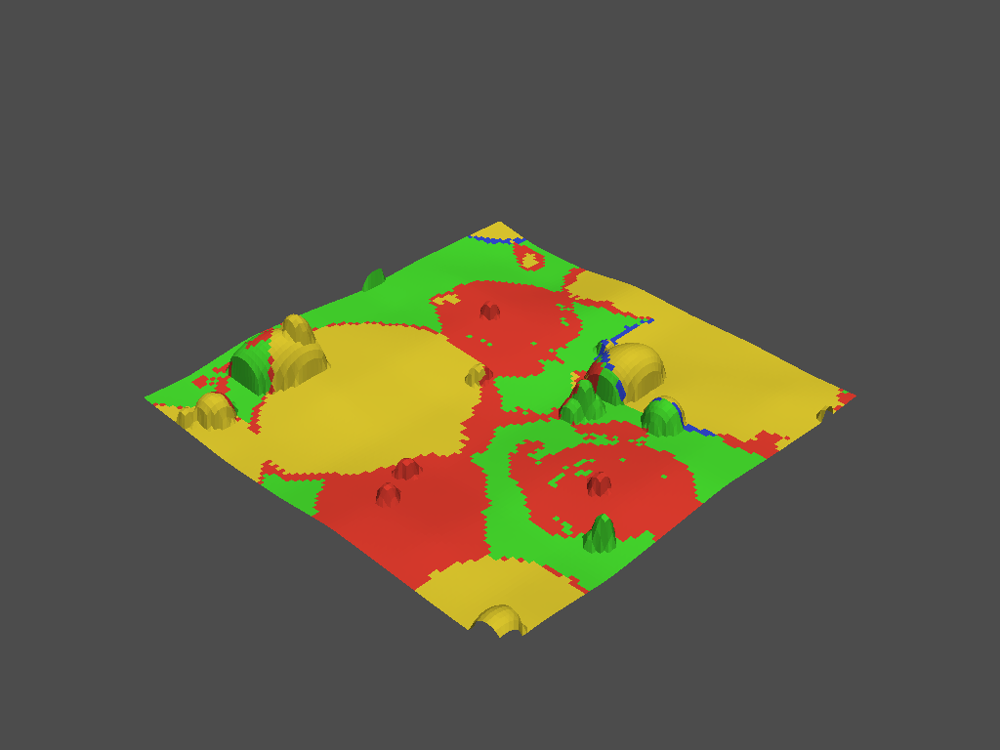

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


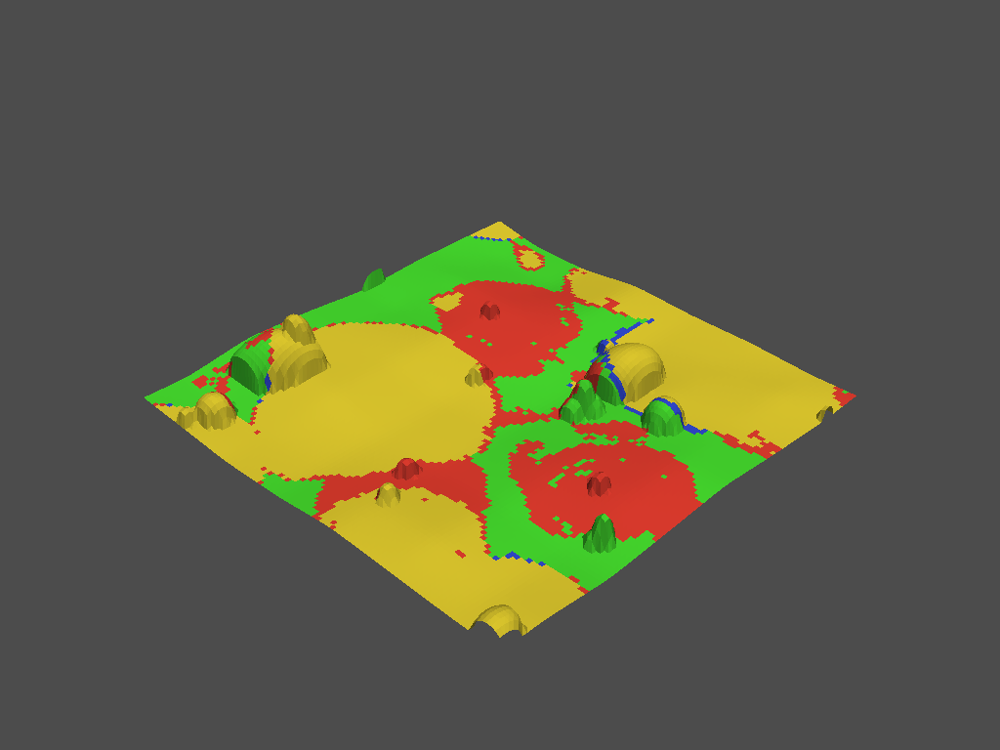

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


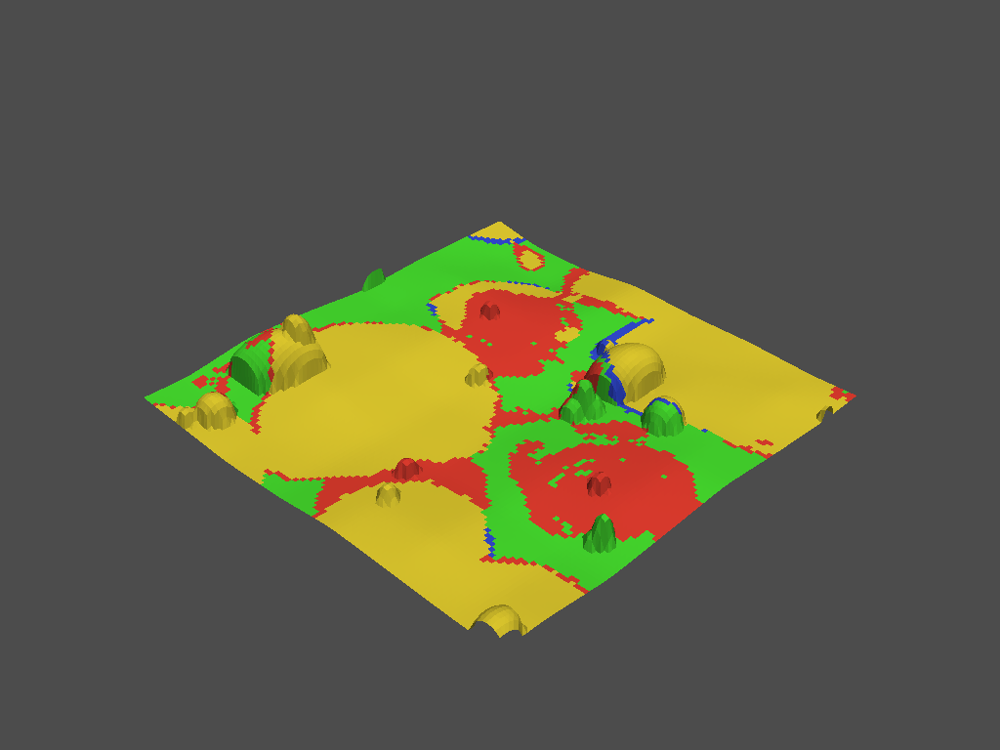

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


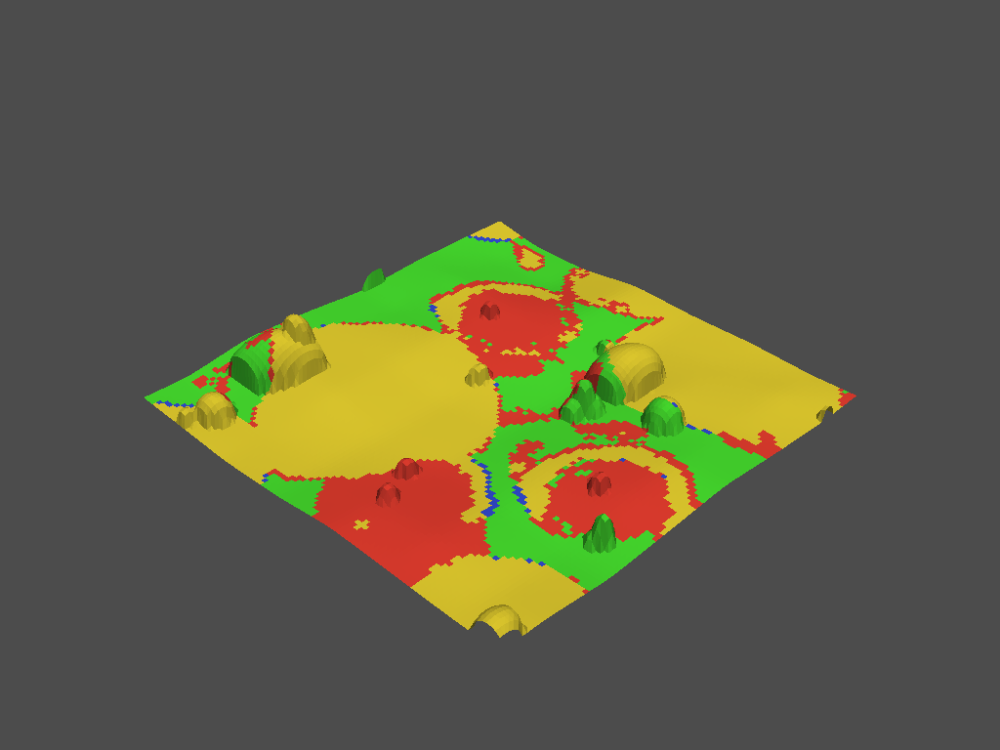

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


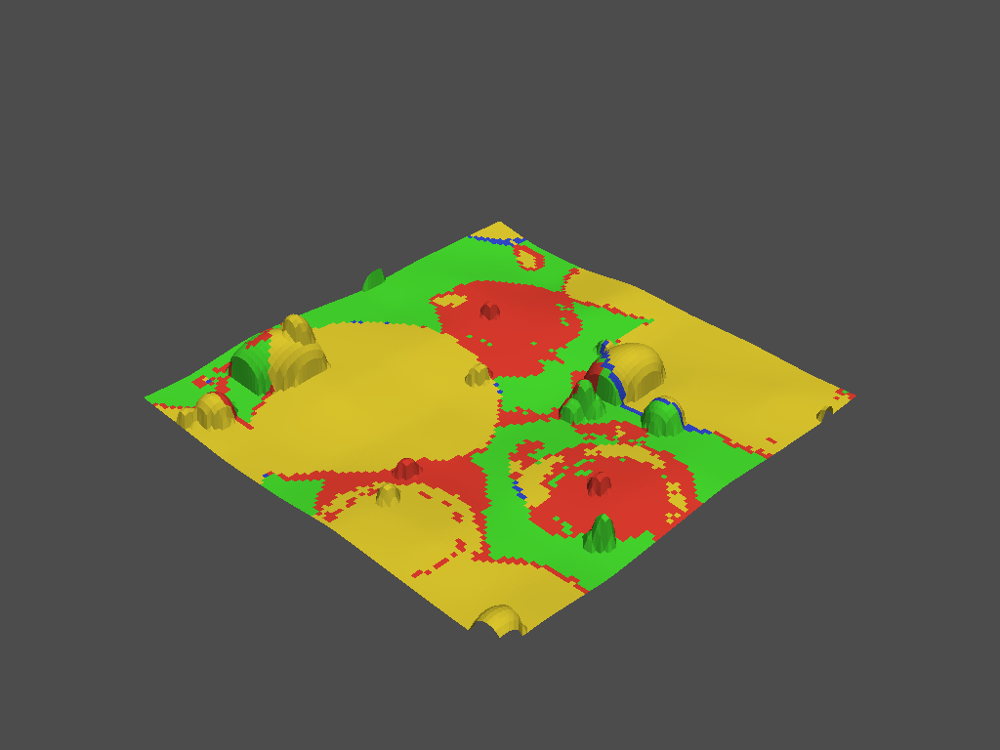

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


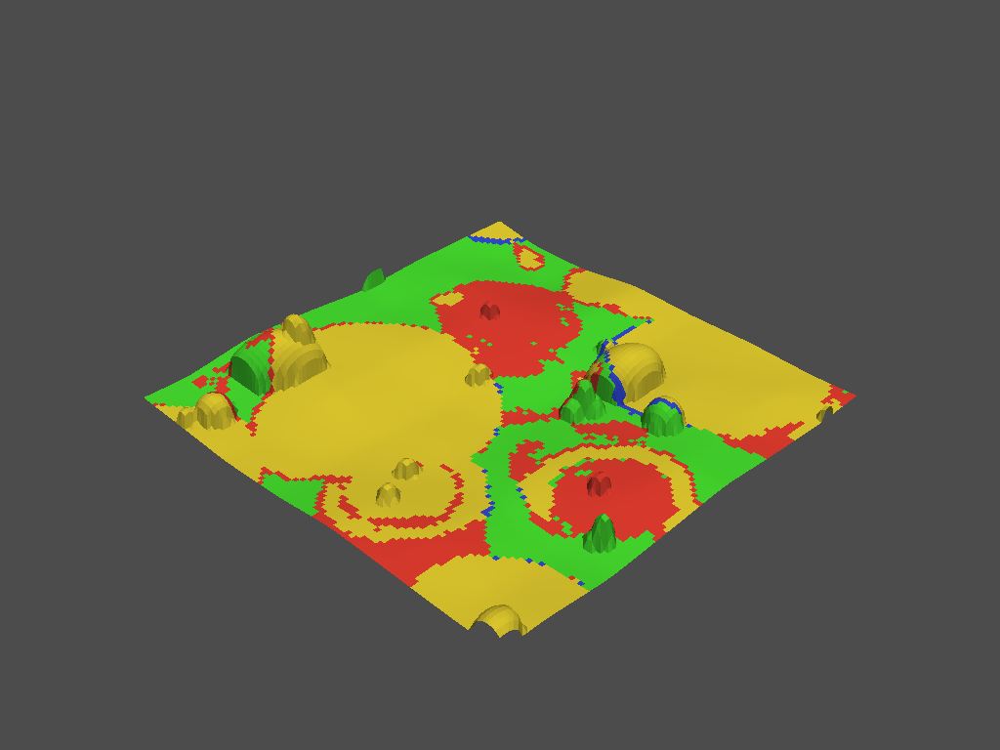

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


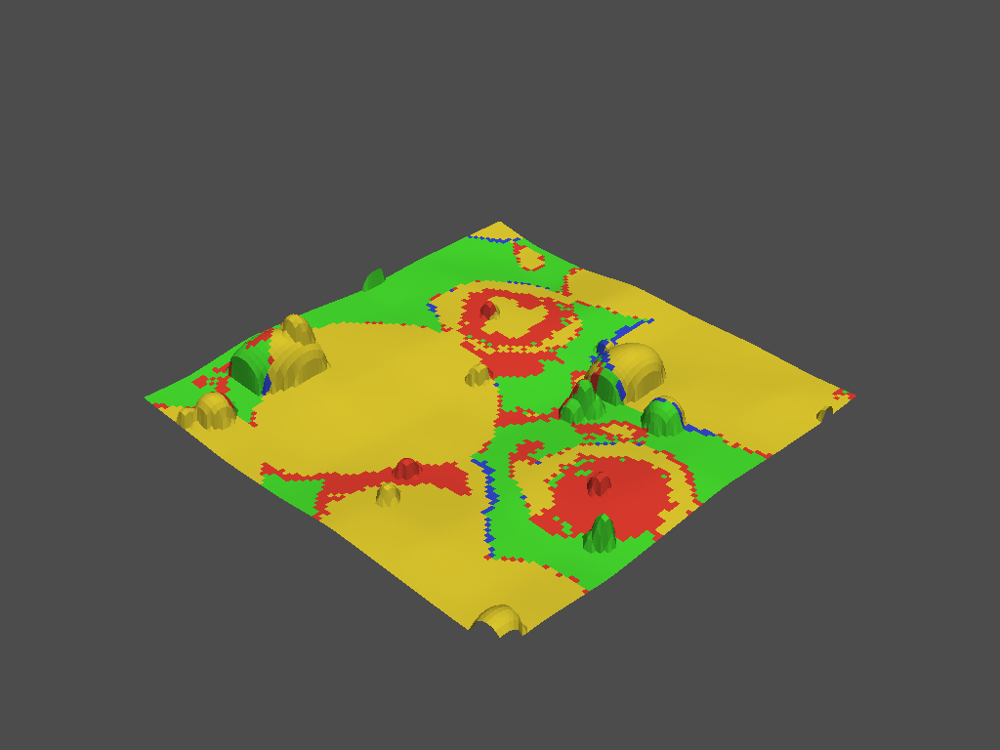

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


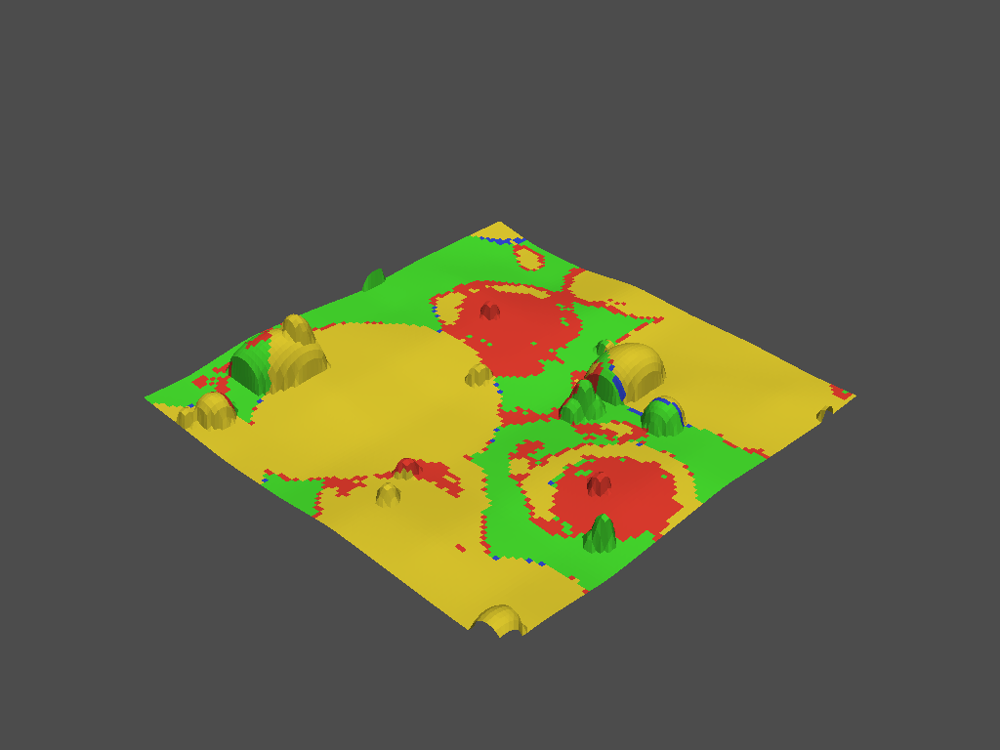

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


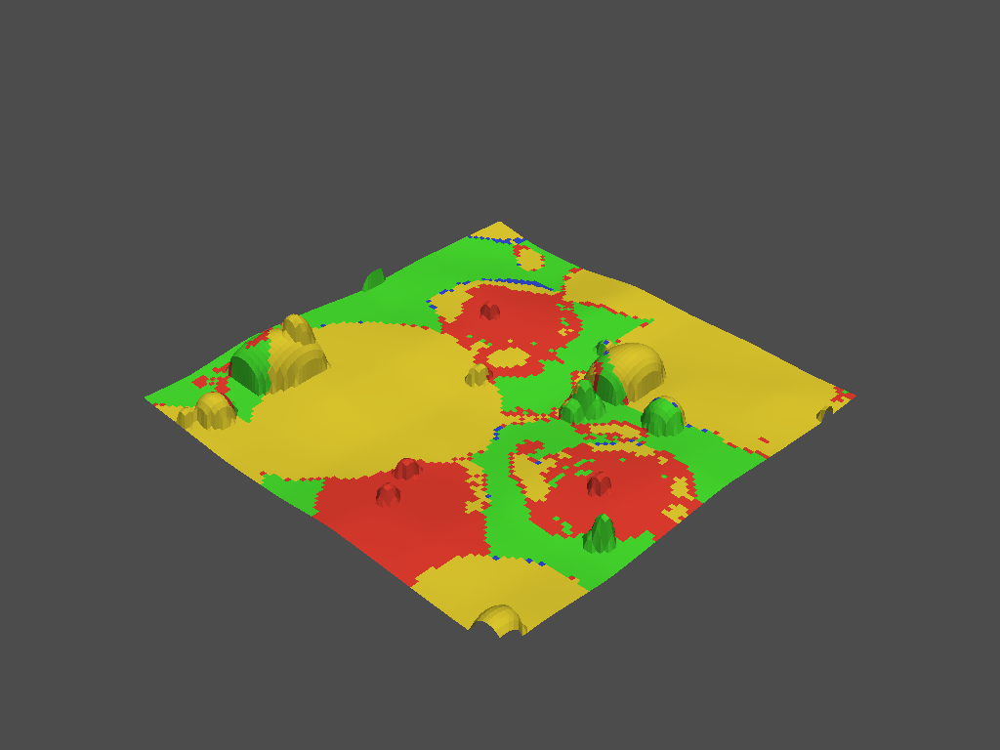

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


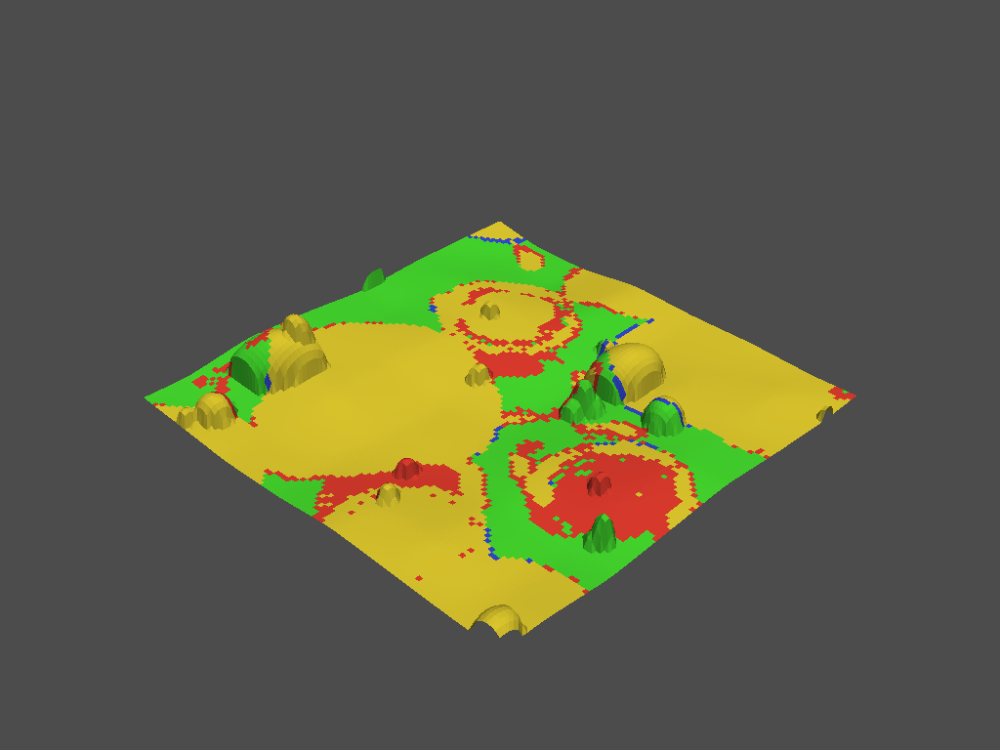

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


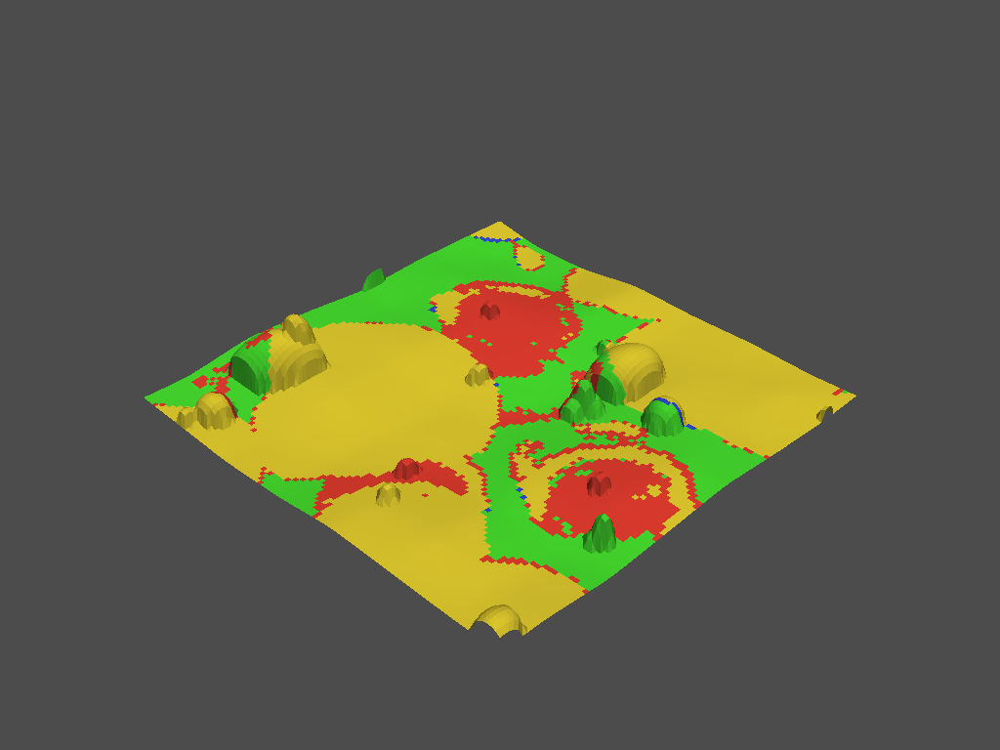

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


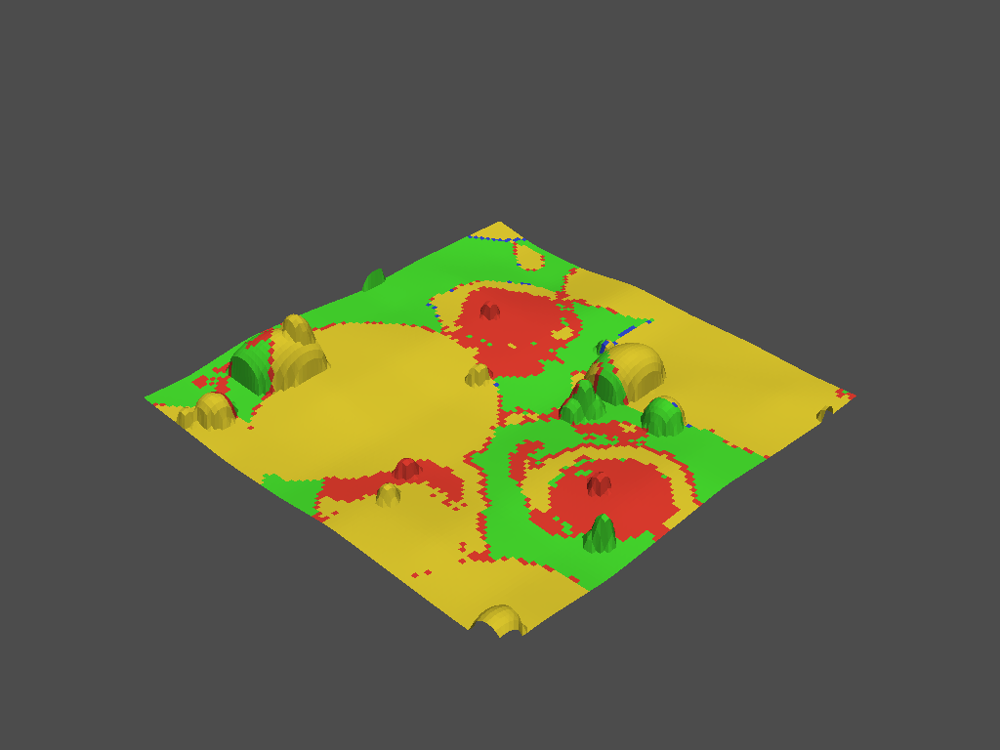

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


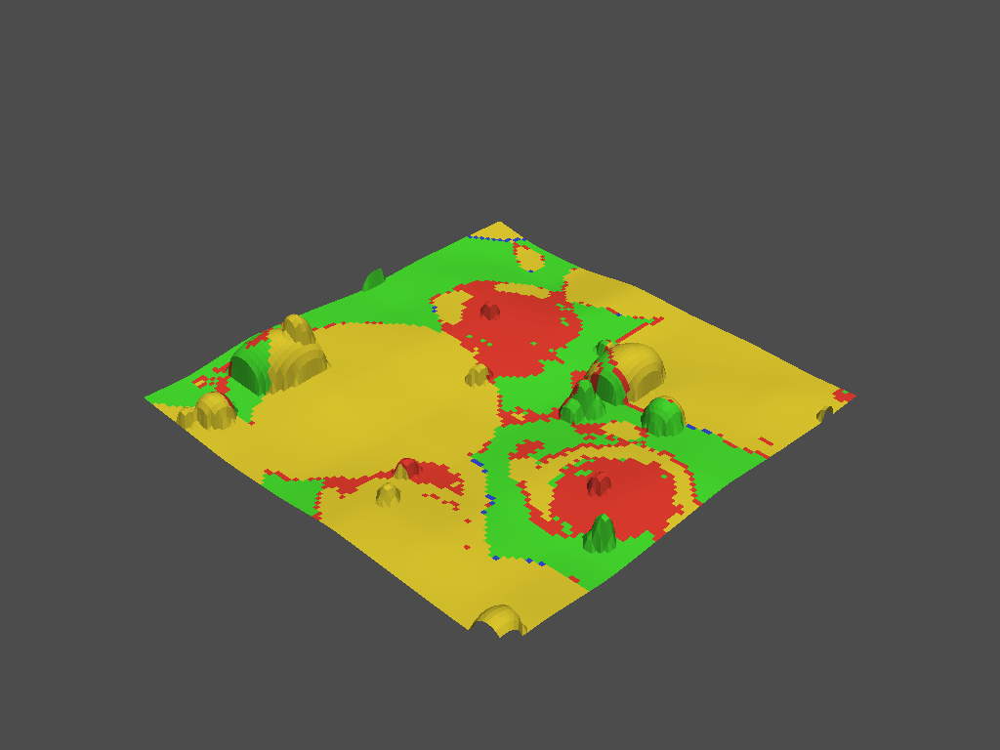

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


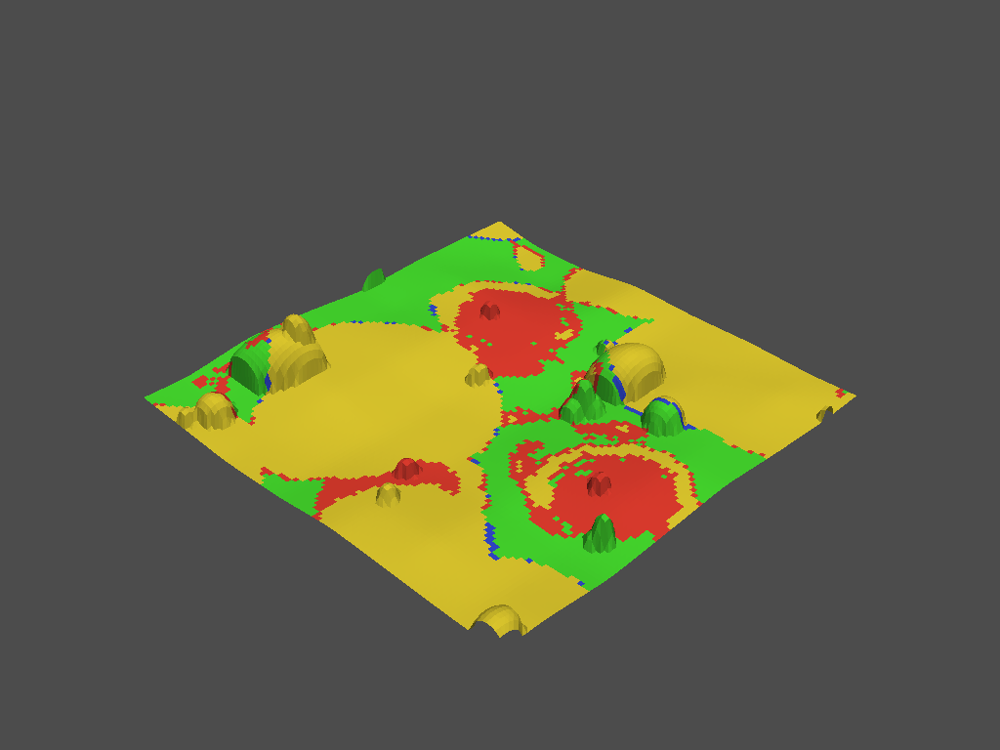

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


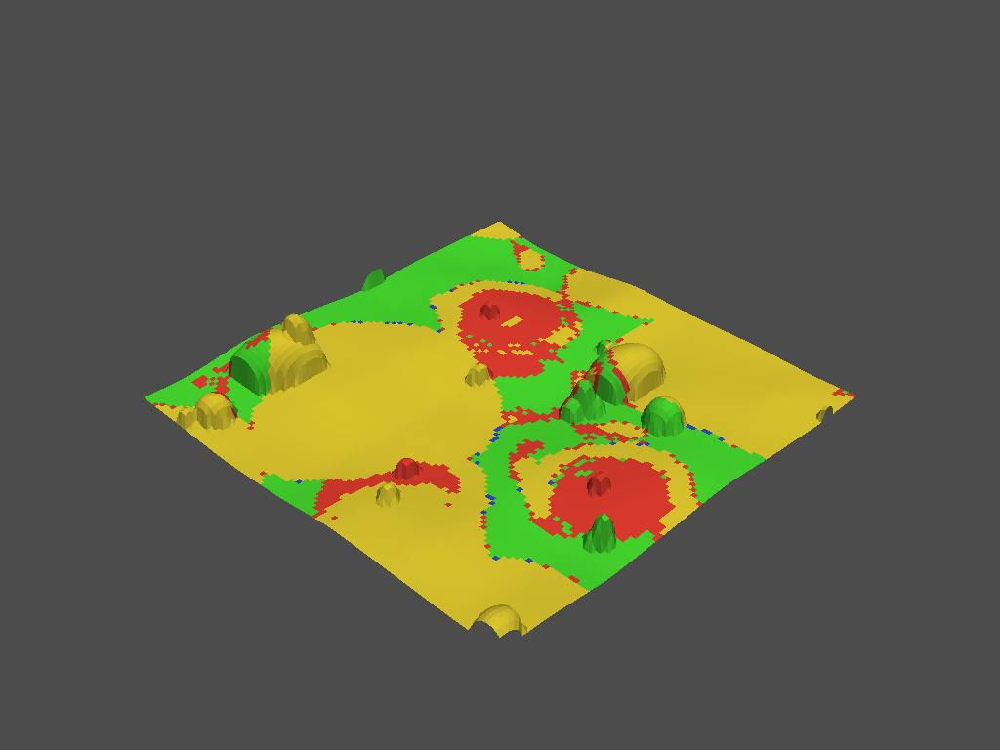

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


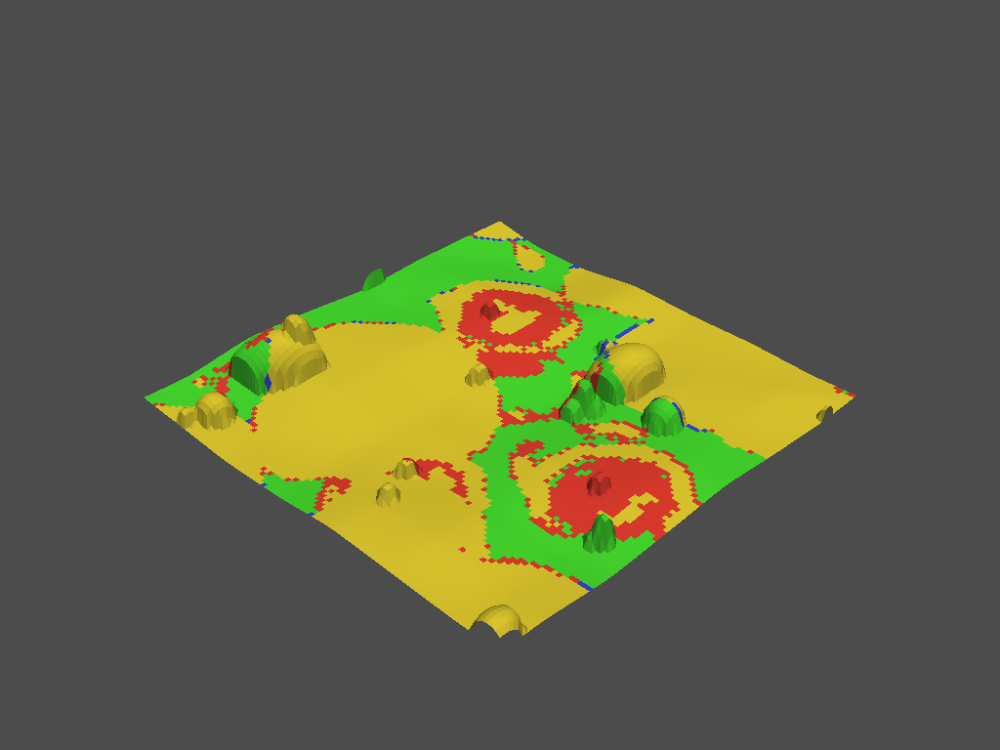

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


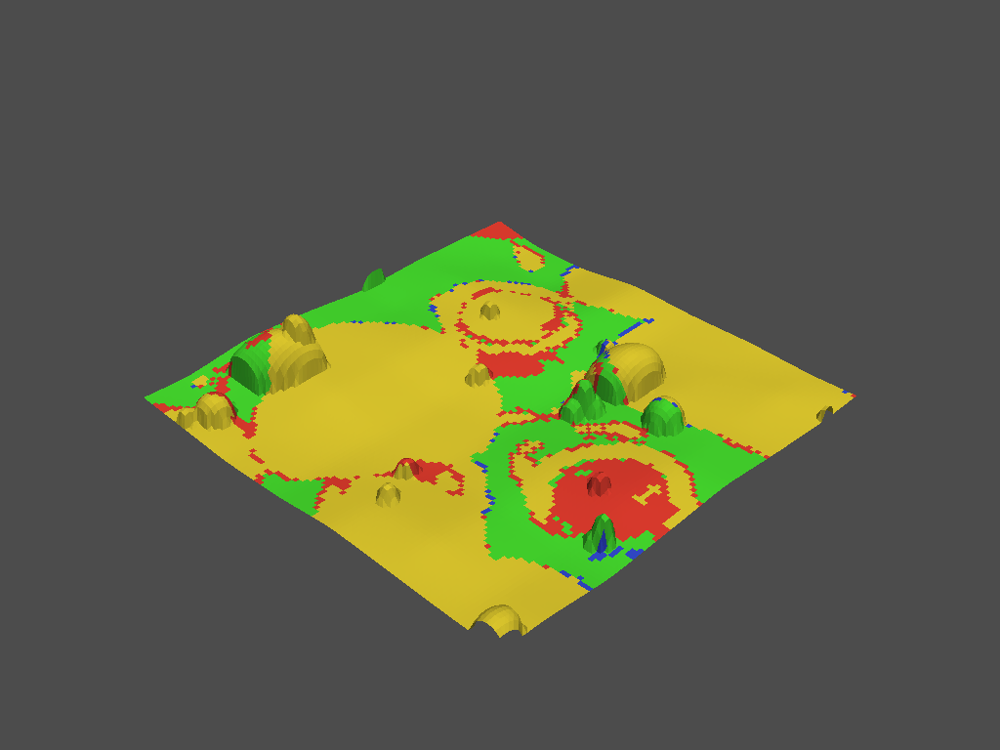

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


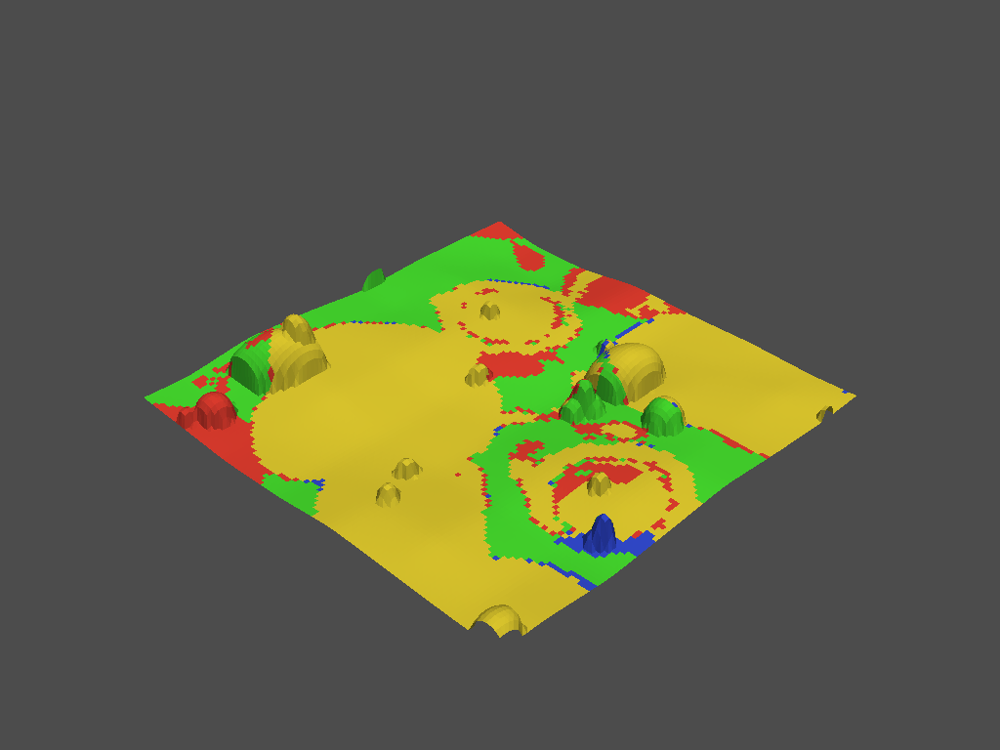

C:\Users\ktomita3\AppData\Local\Temp\ipykernel_32364\2991450551.py:88: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  images = [imageio.imread(file) for file in file_list]
c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


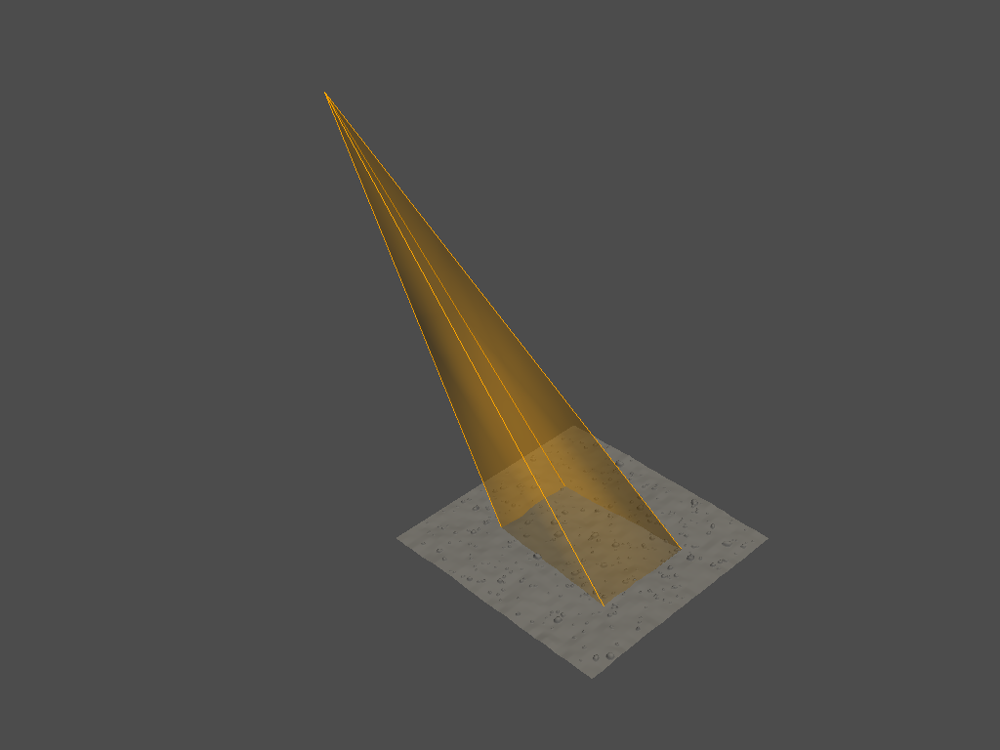

0


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


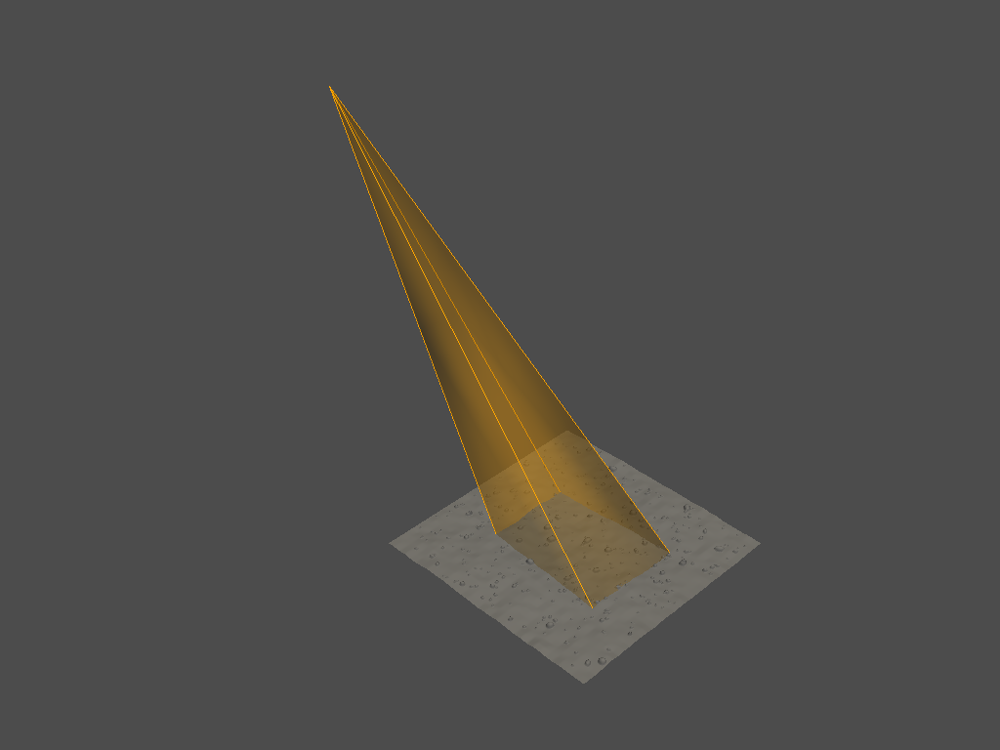

1


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


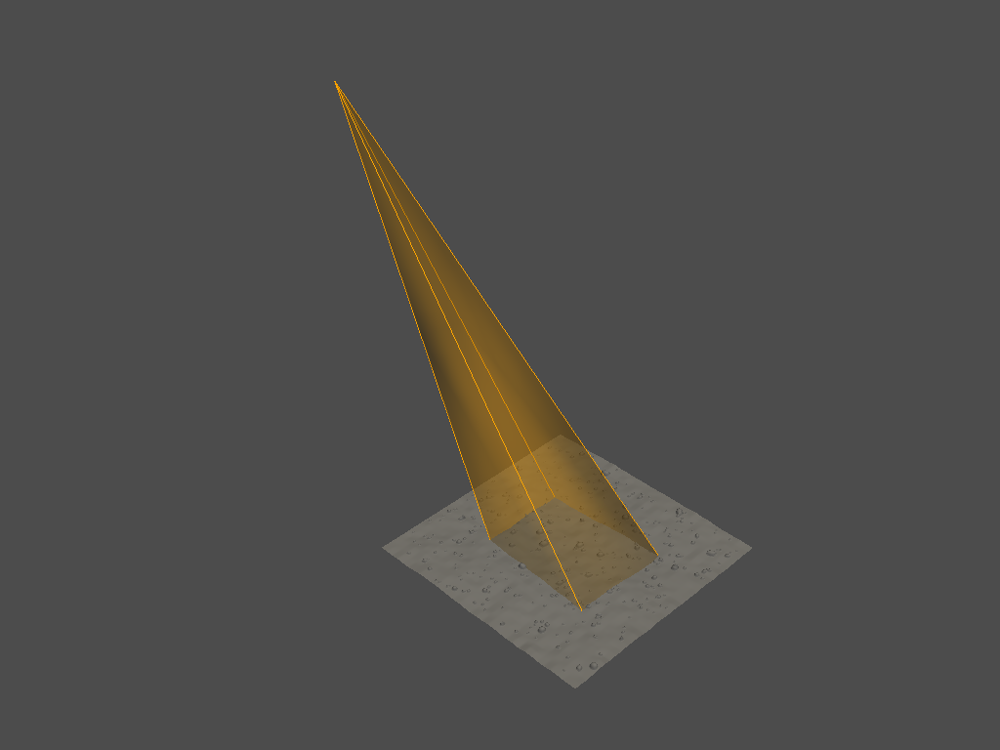

2


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


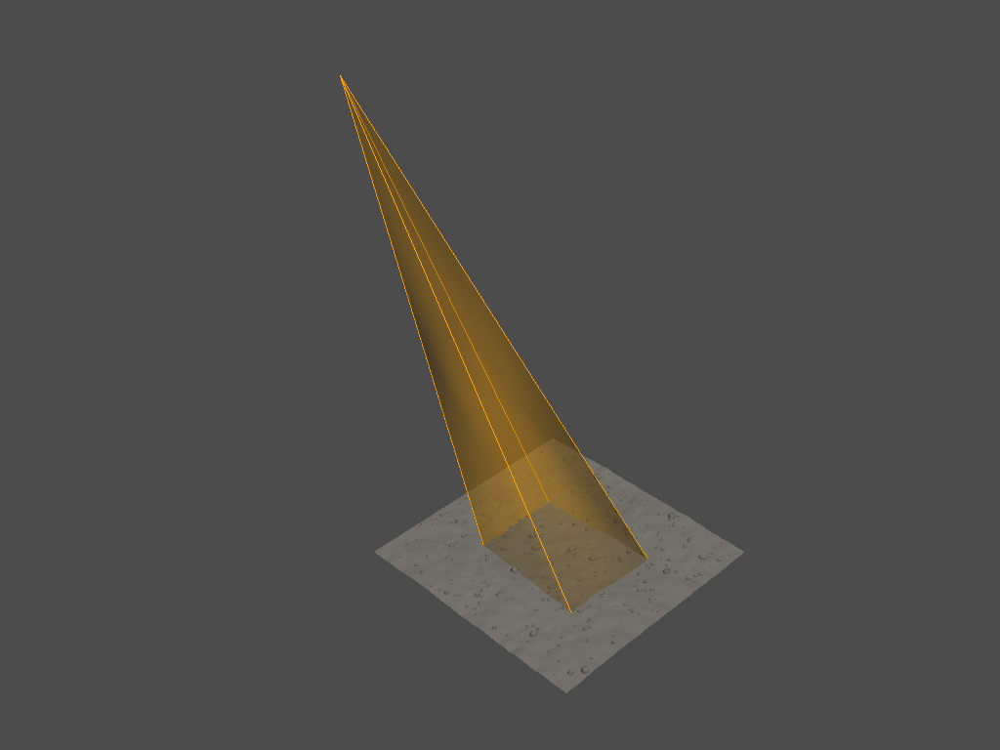

3


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


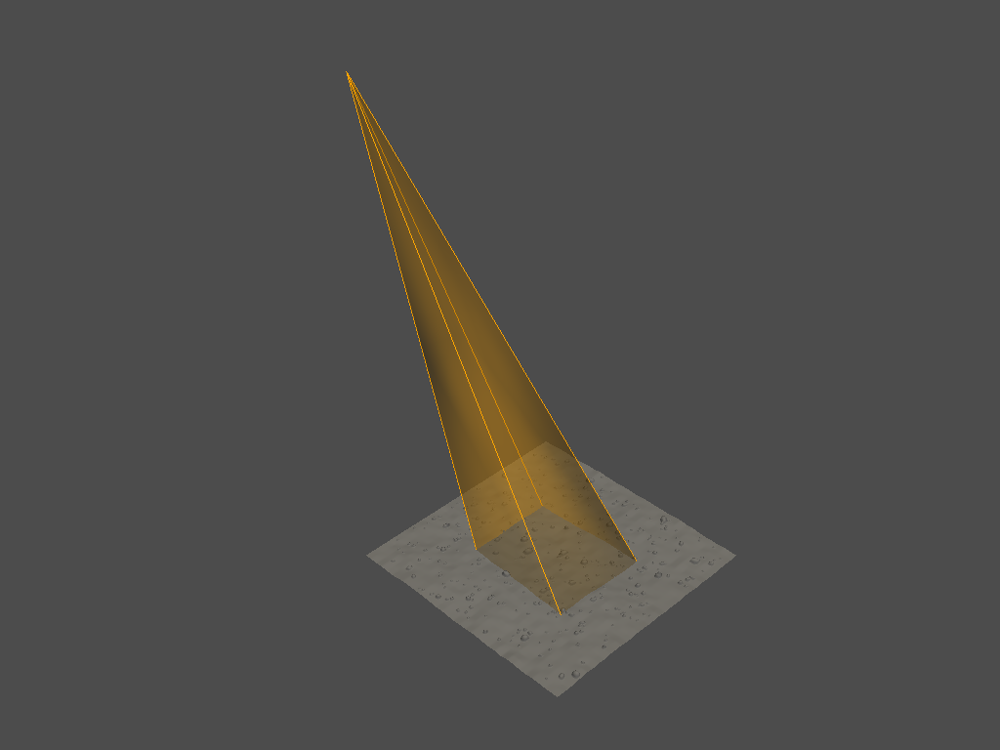

4


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


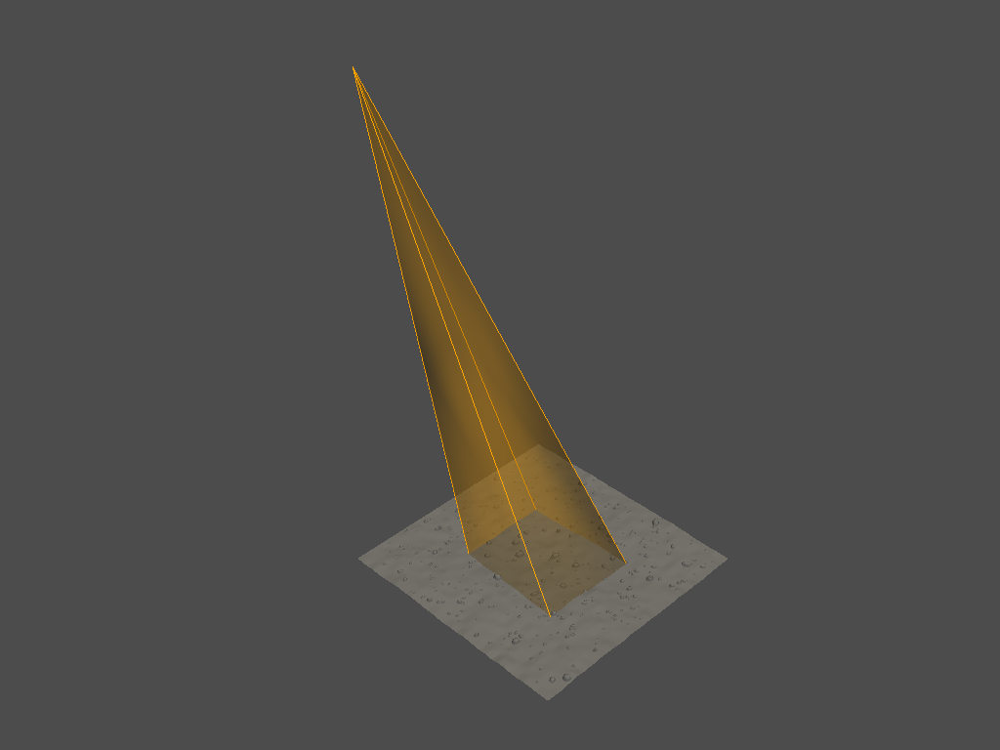

5


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


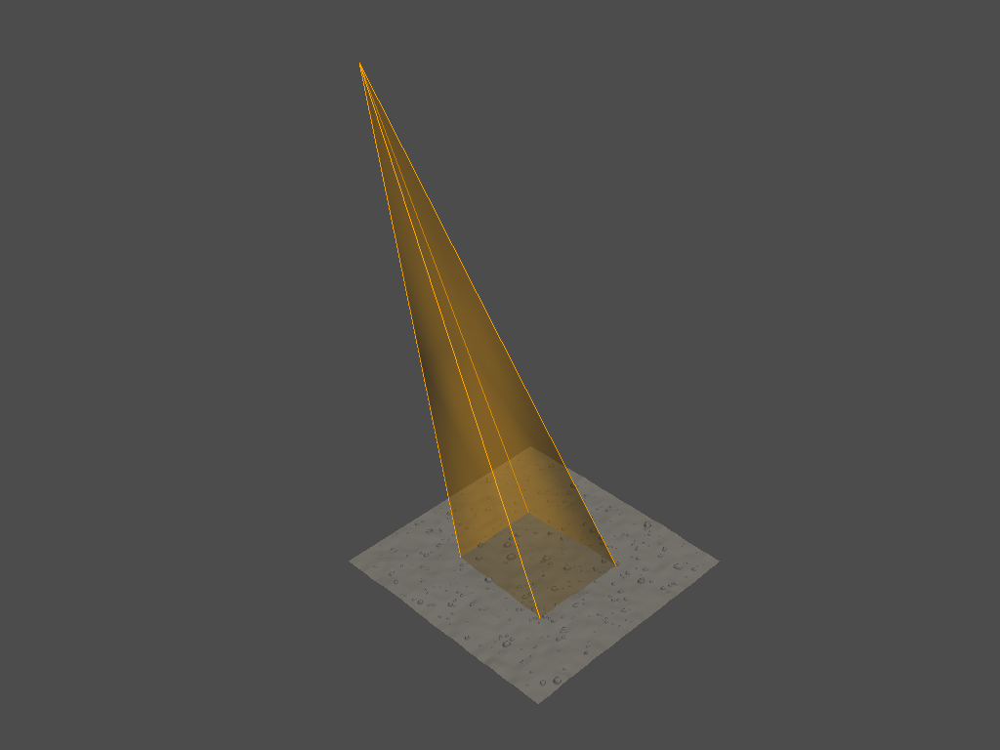

6


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


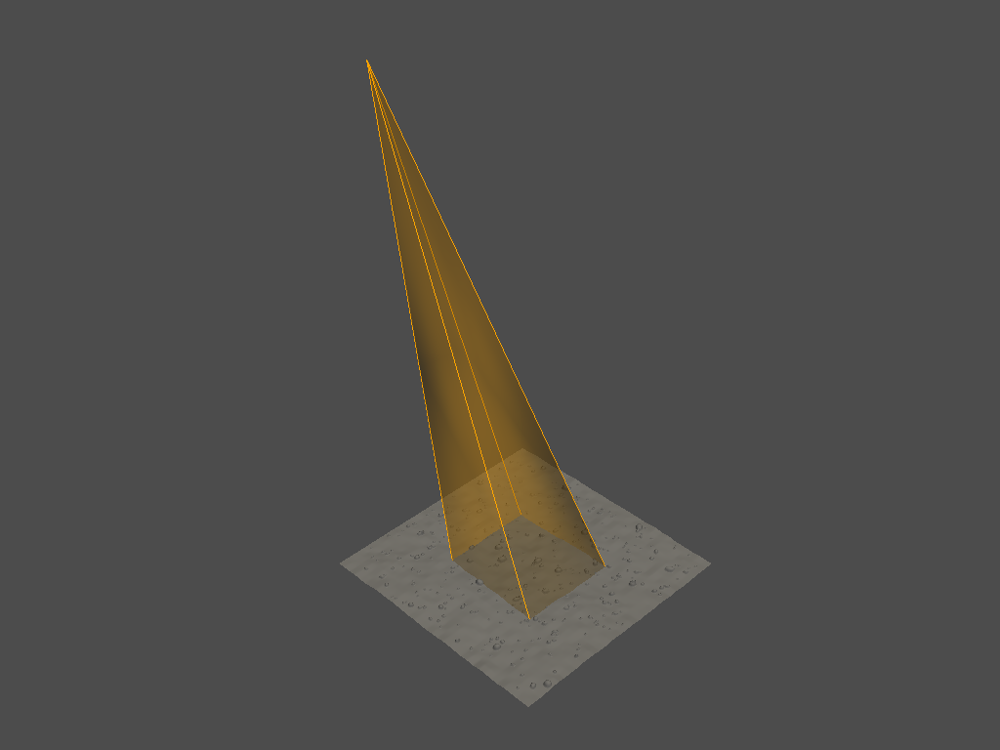

7


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


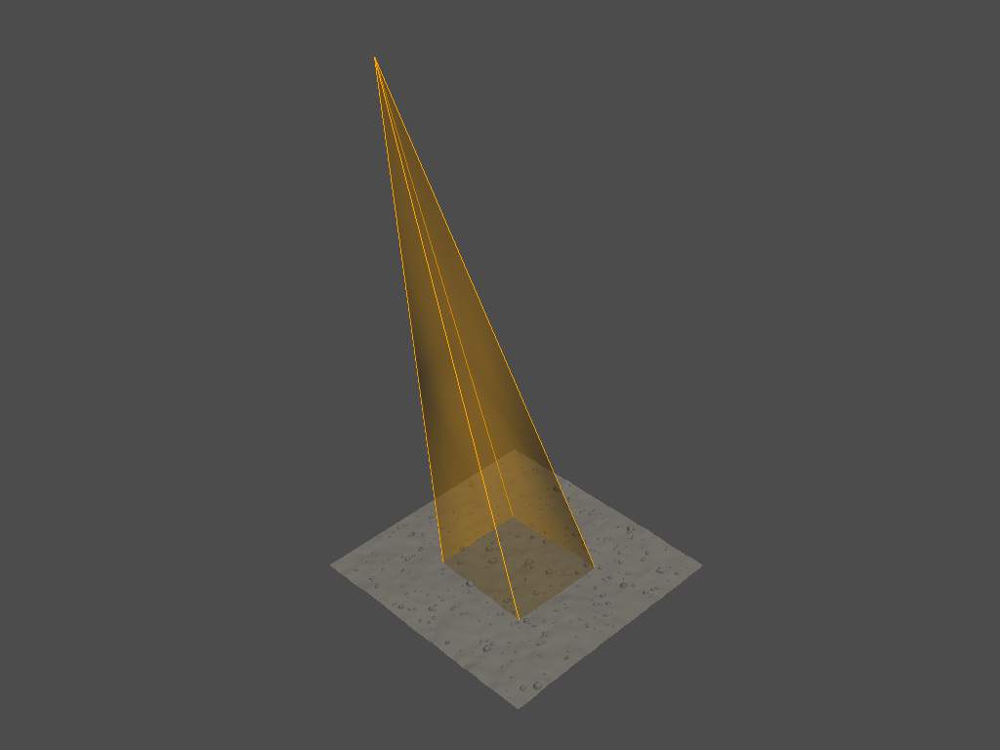

8


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


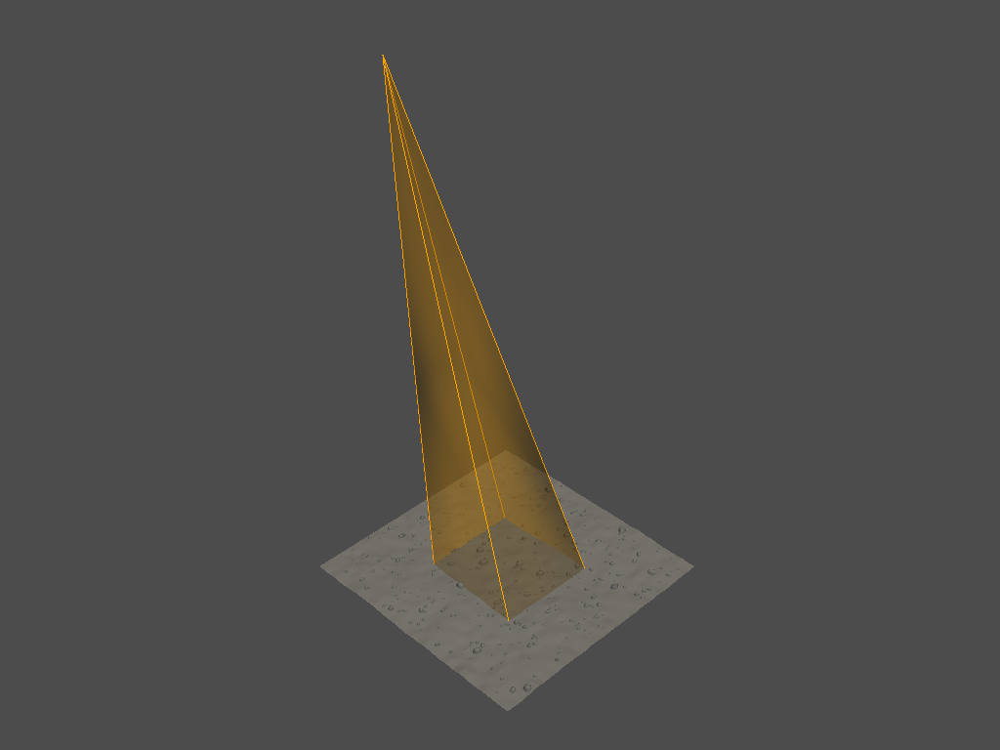

9


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


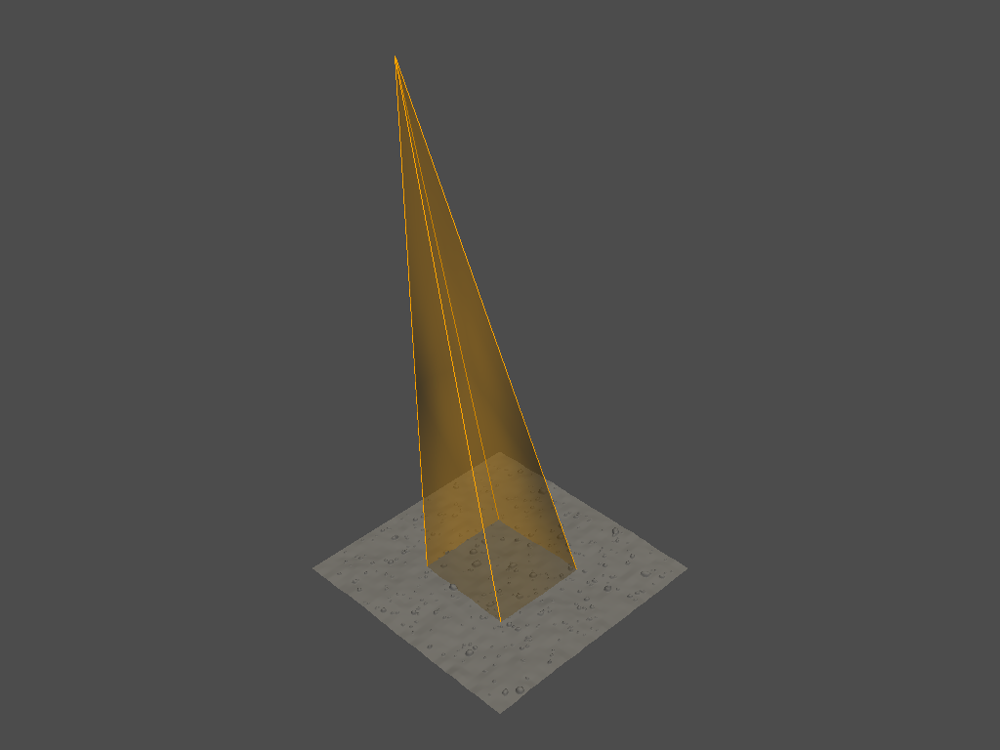

10


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


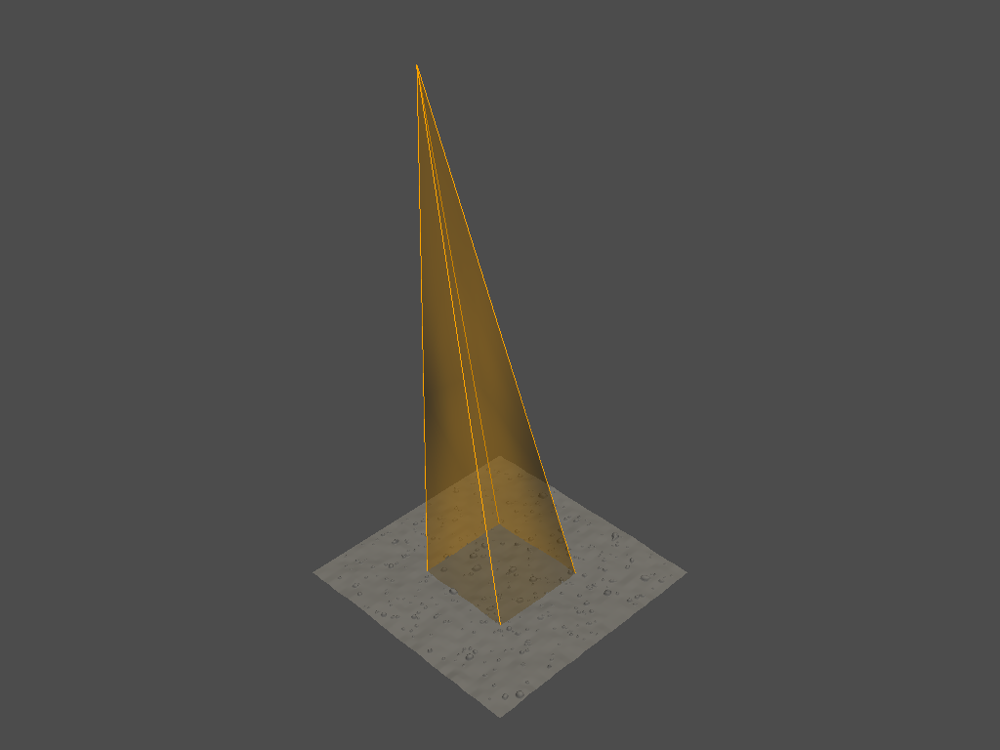

11


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


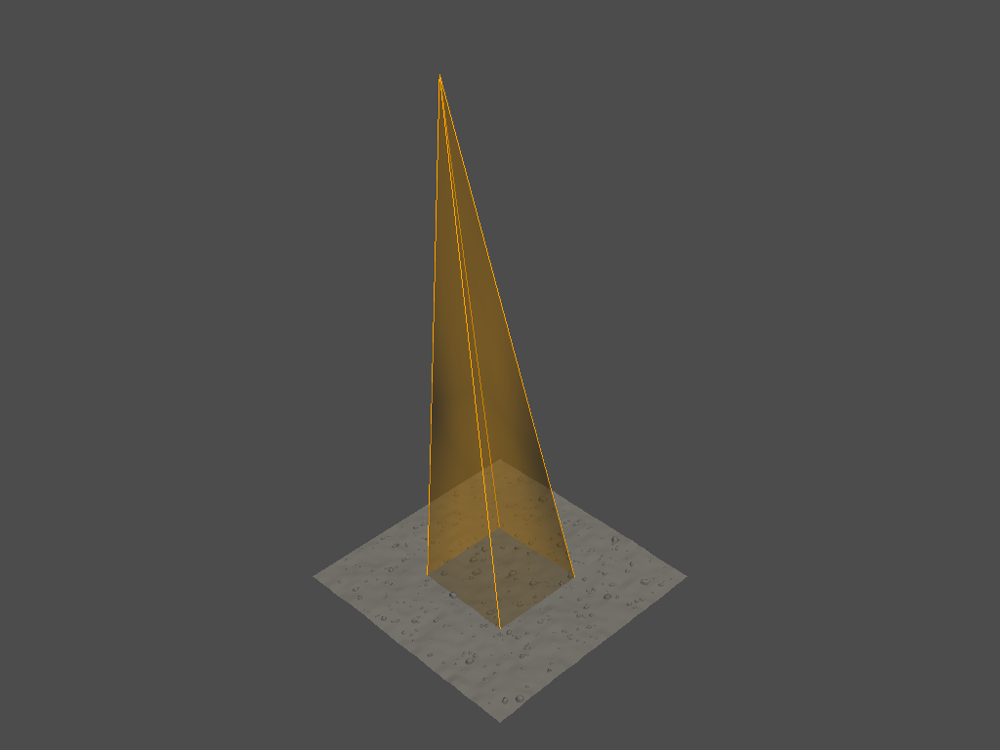

12


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


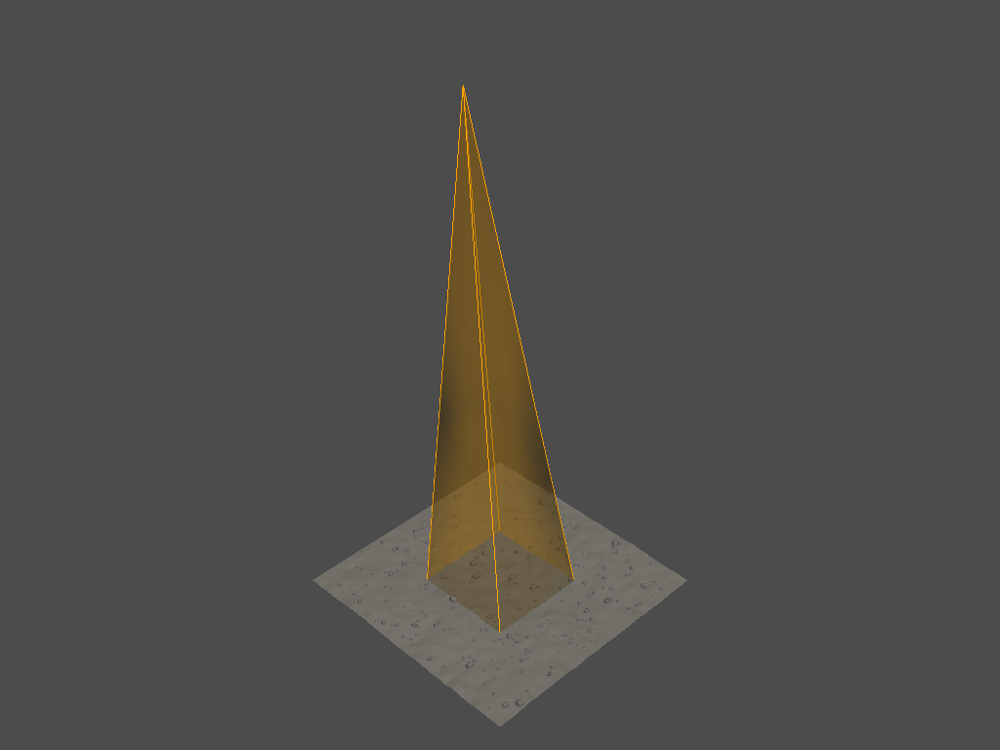

13


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


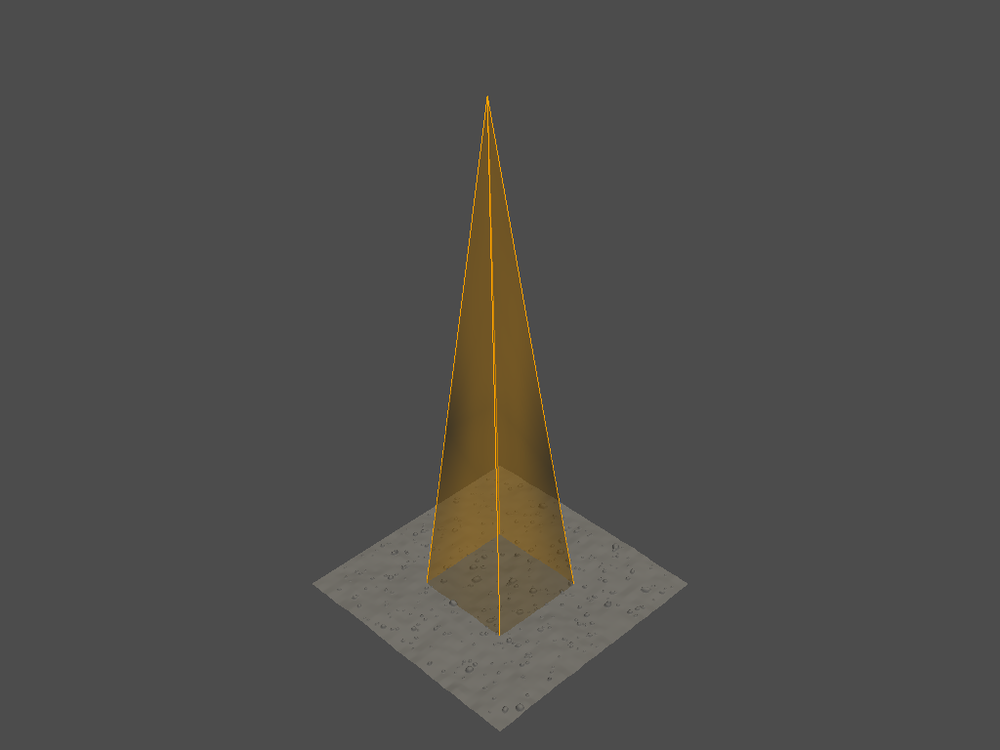

14


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


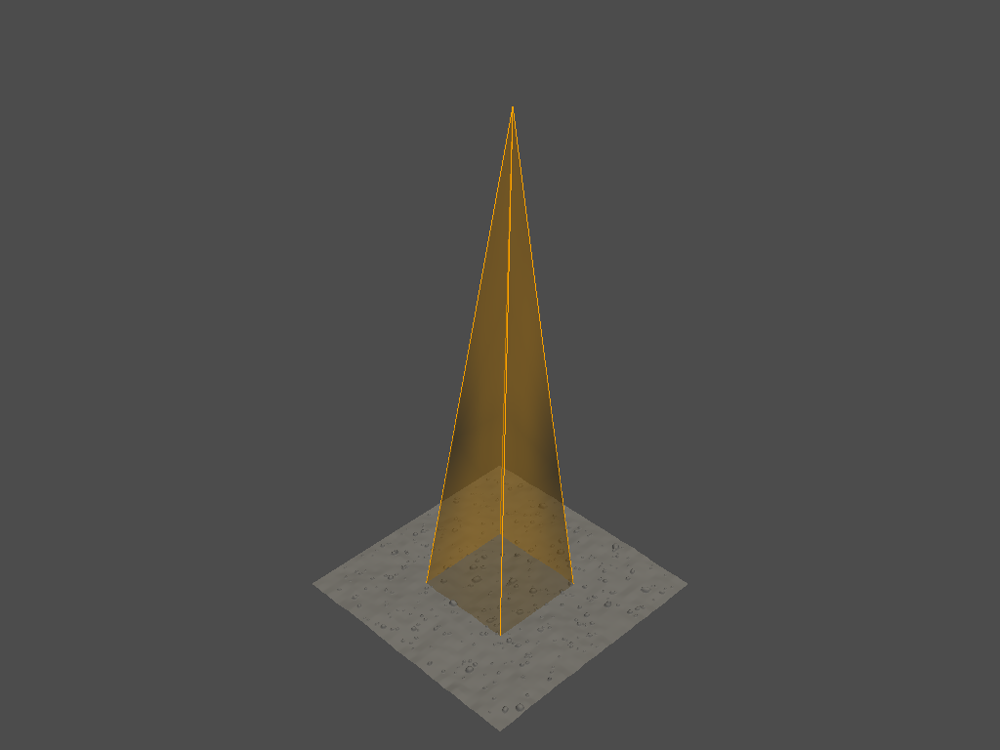

15


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


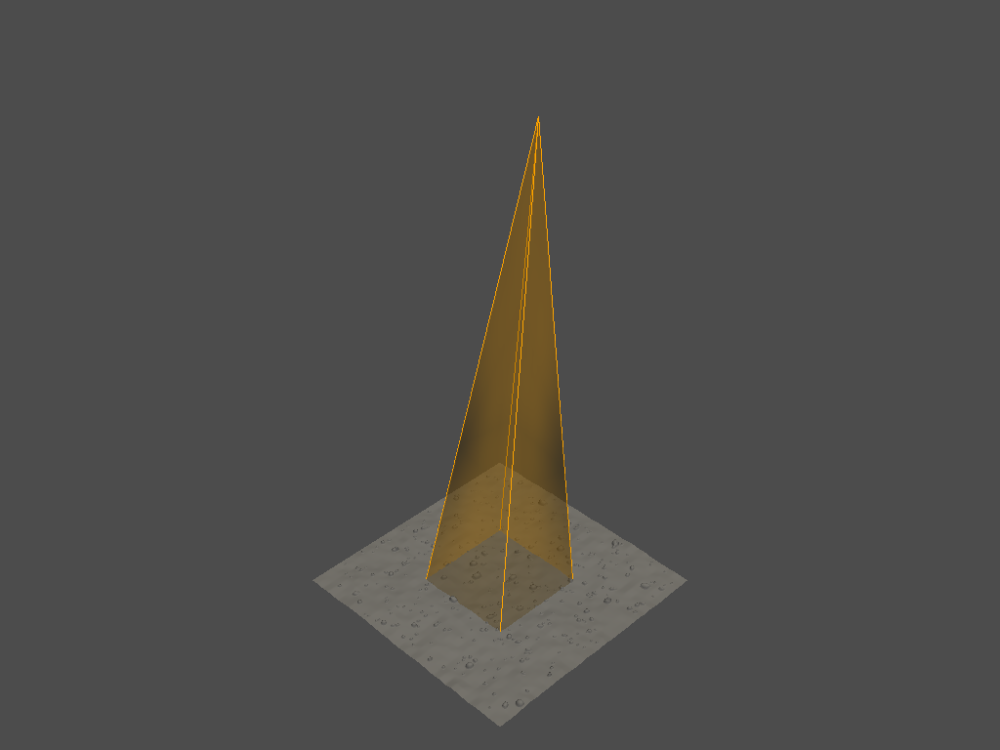

16


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


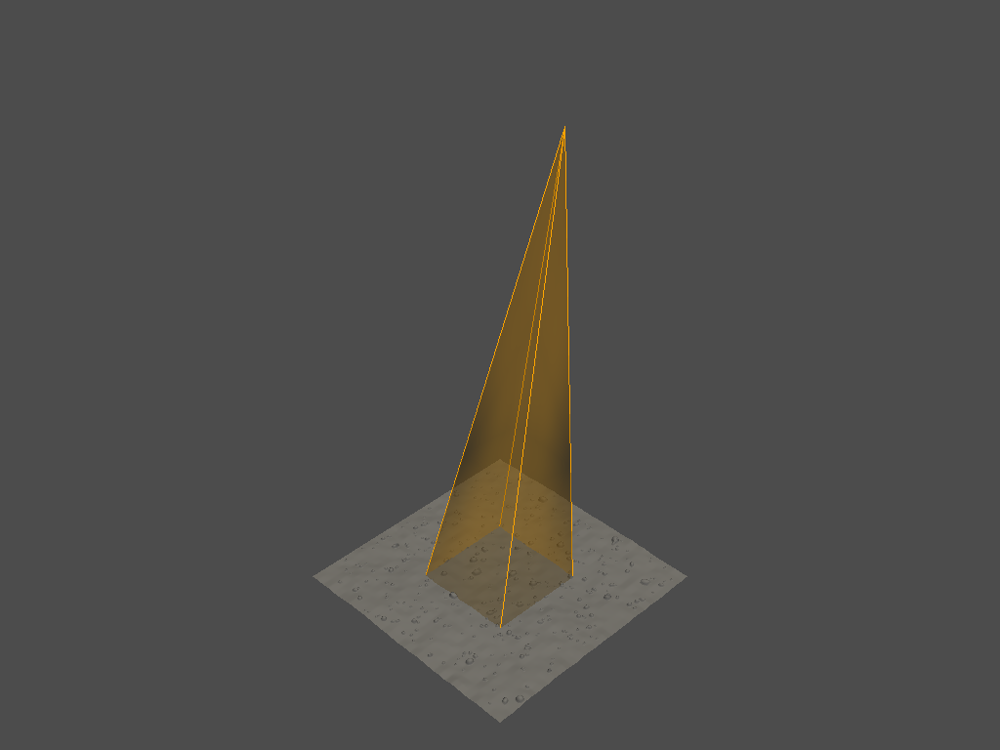

17


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


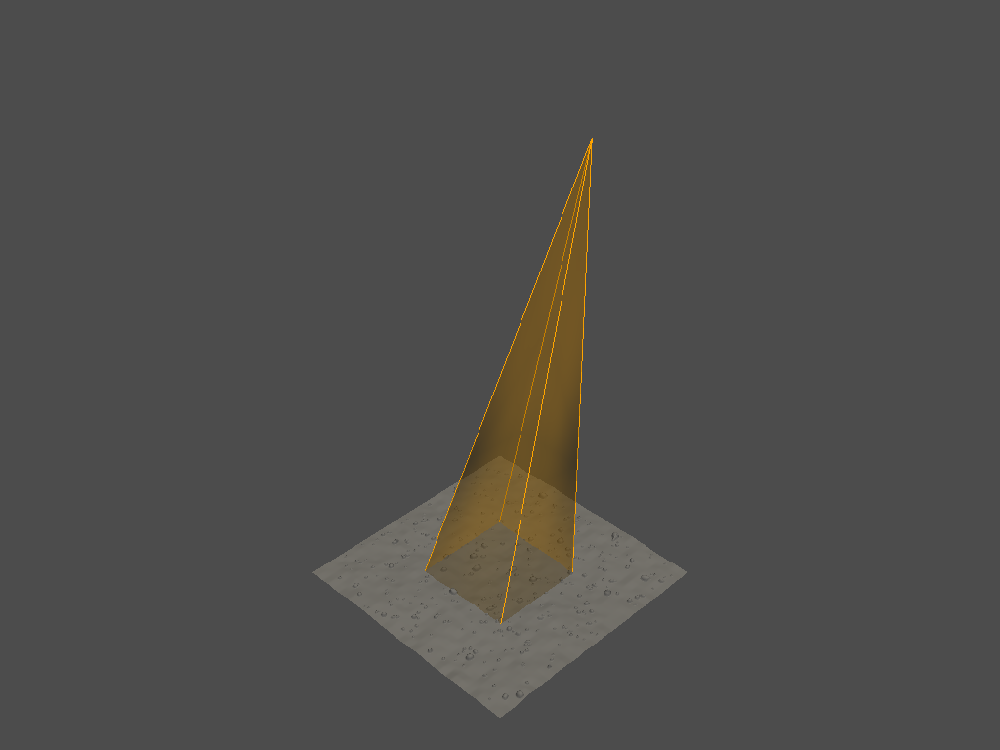

18


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


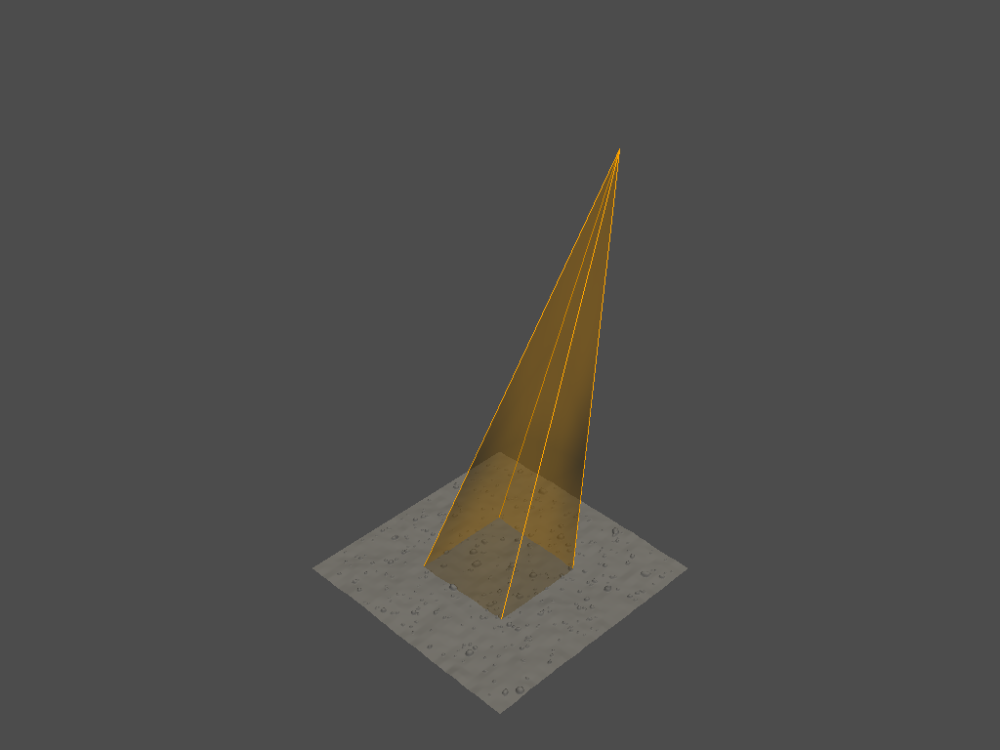

19


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


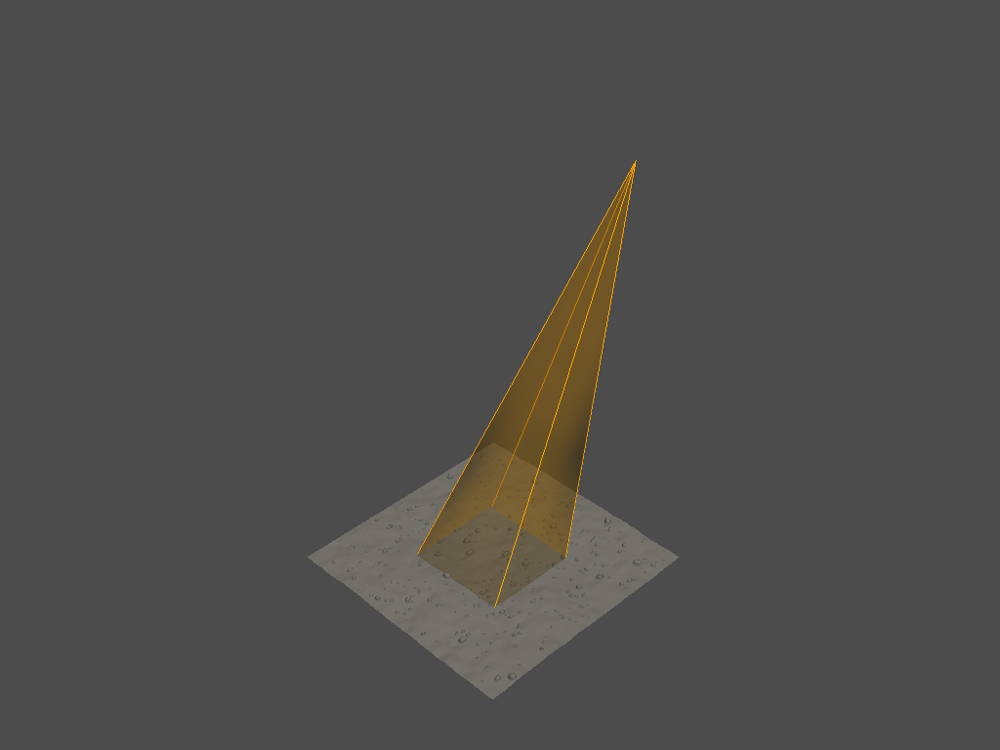

20


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


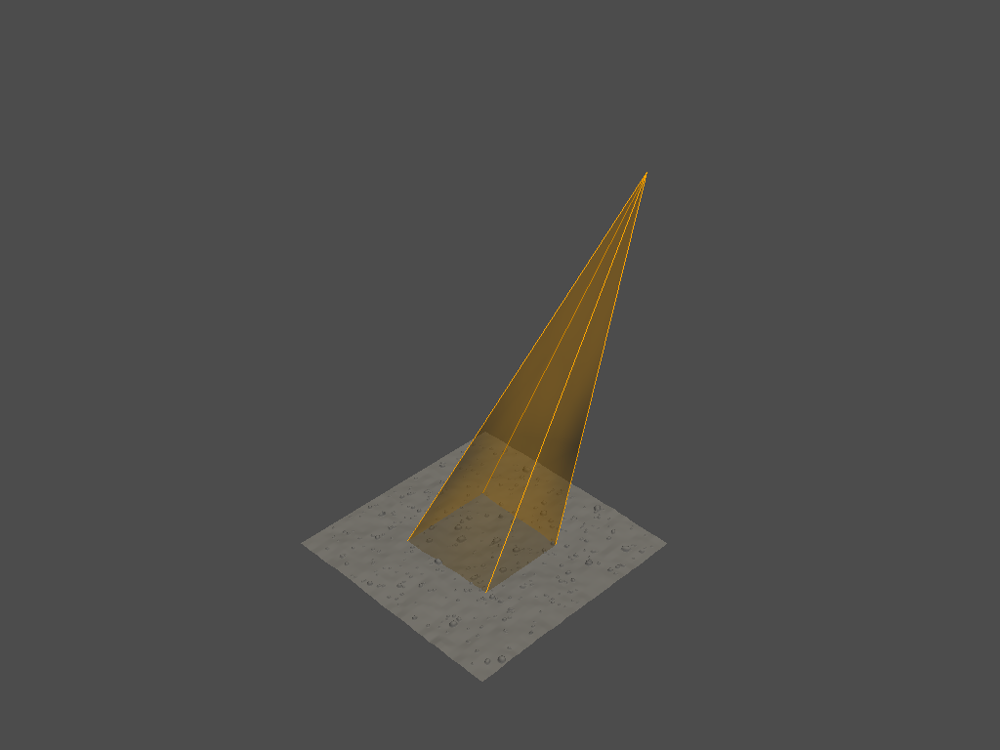

21


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


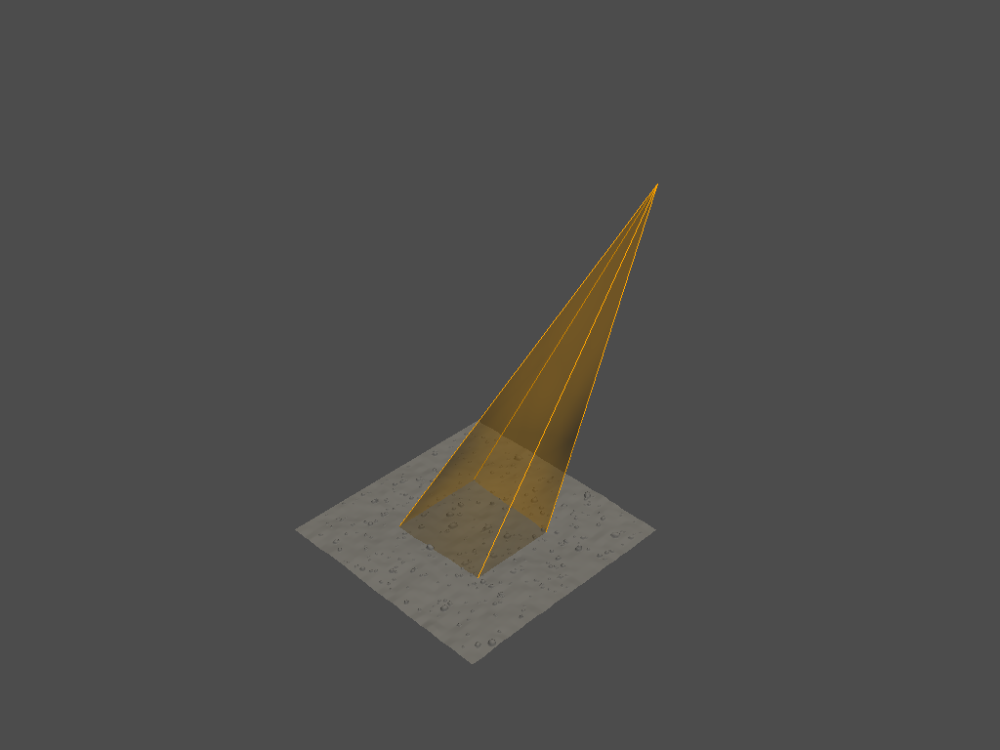

22


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


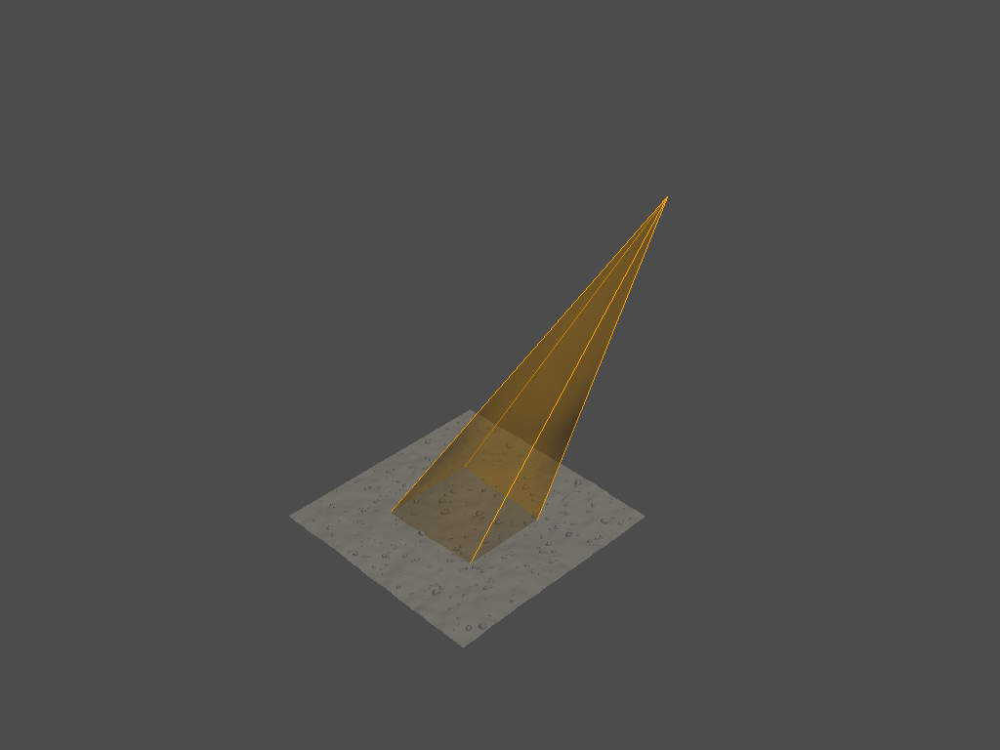

23


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


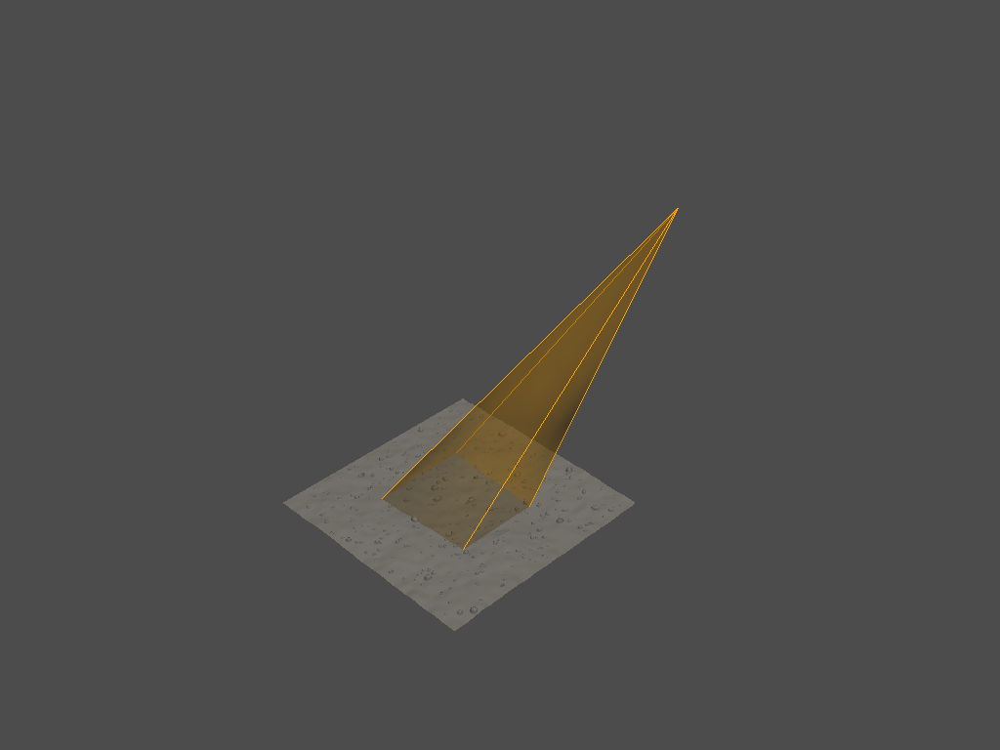

24


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


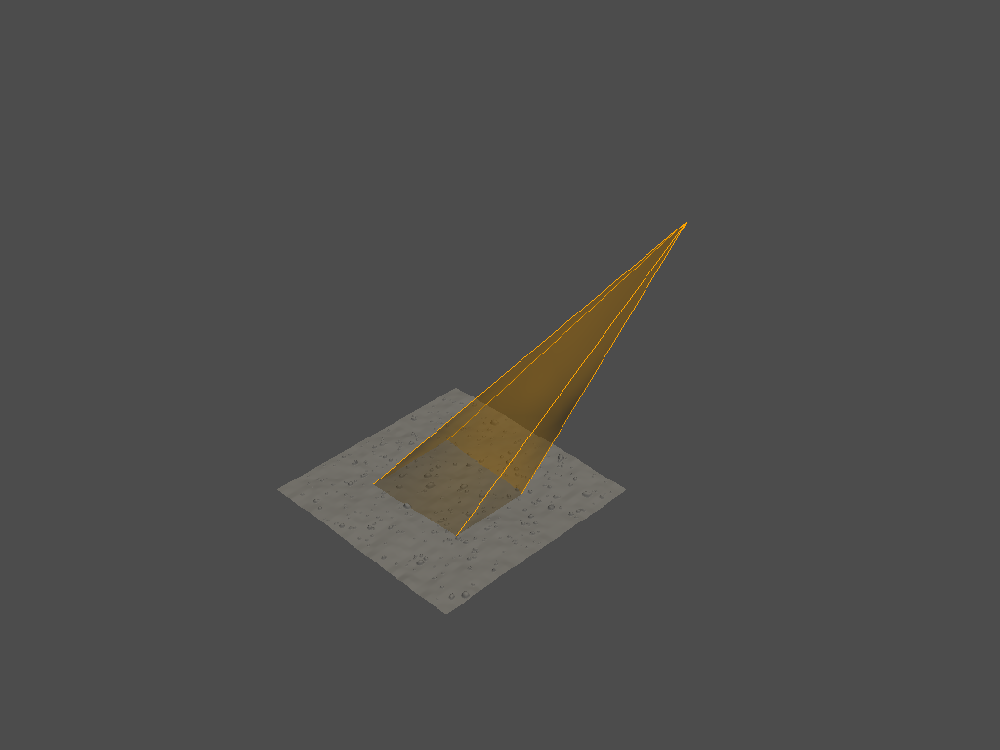

25


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


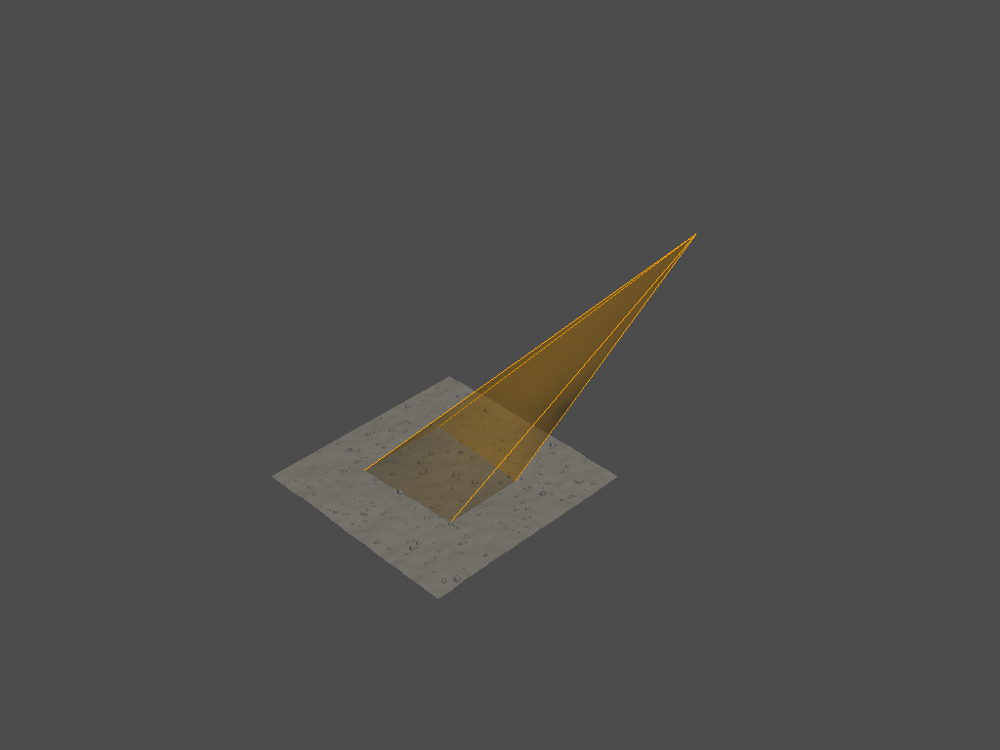

26


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


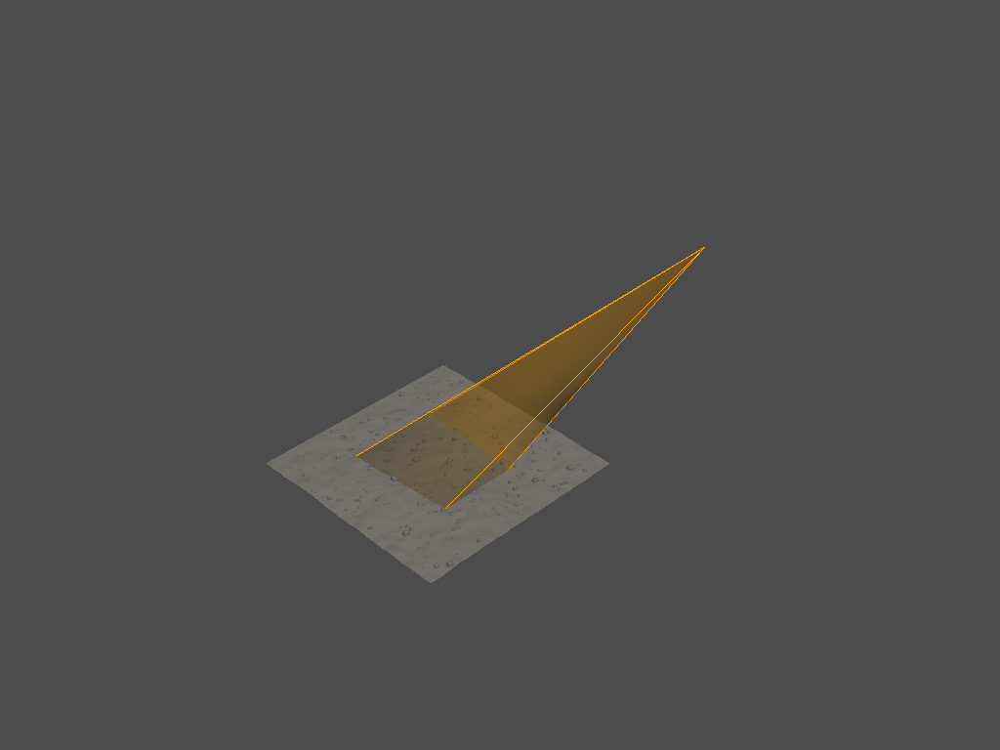

27


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


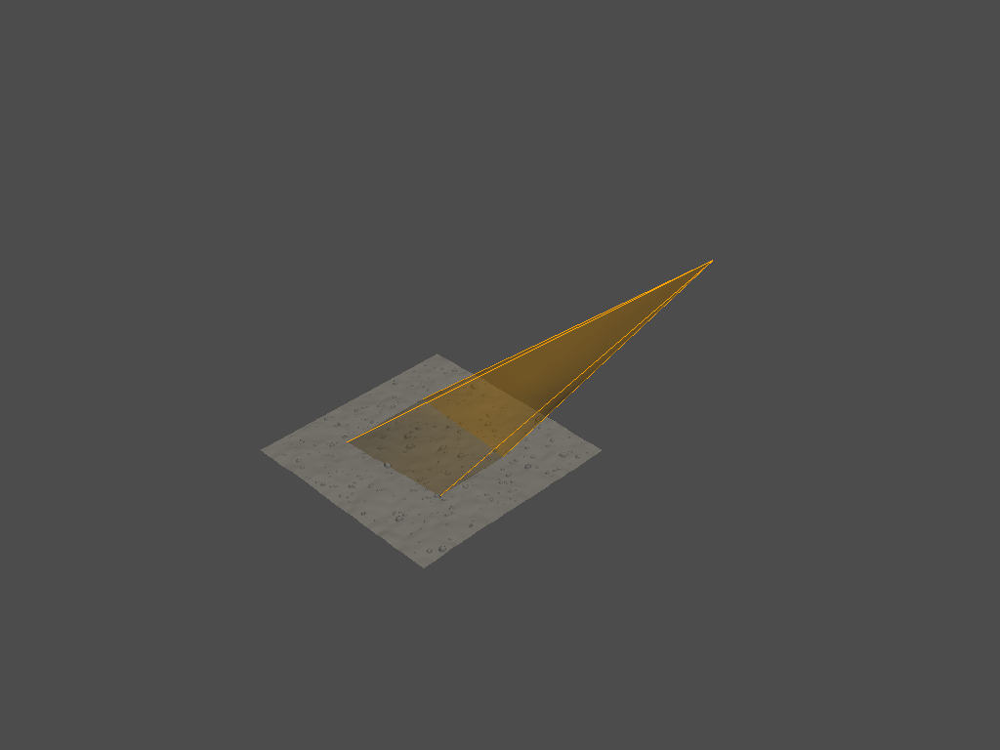

28


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


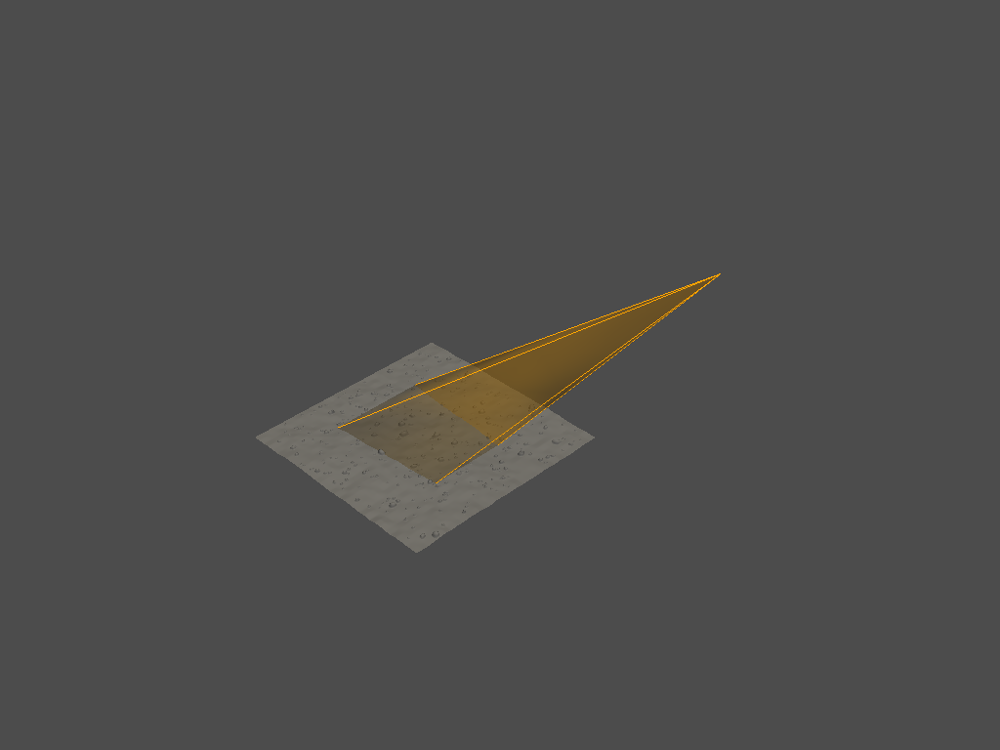

29
(703, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


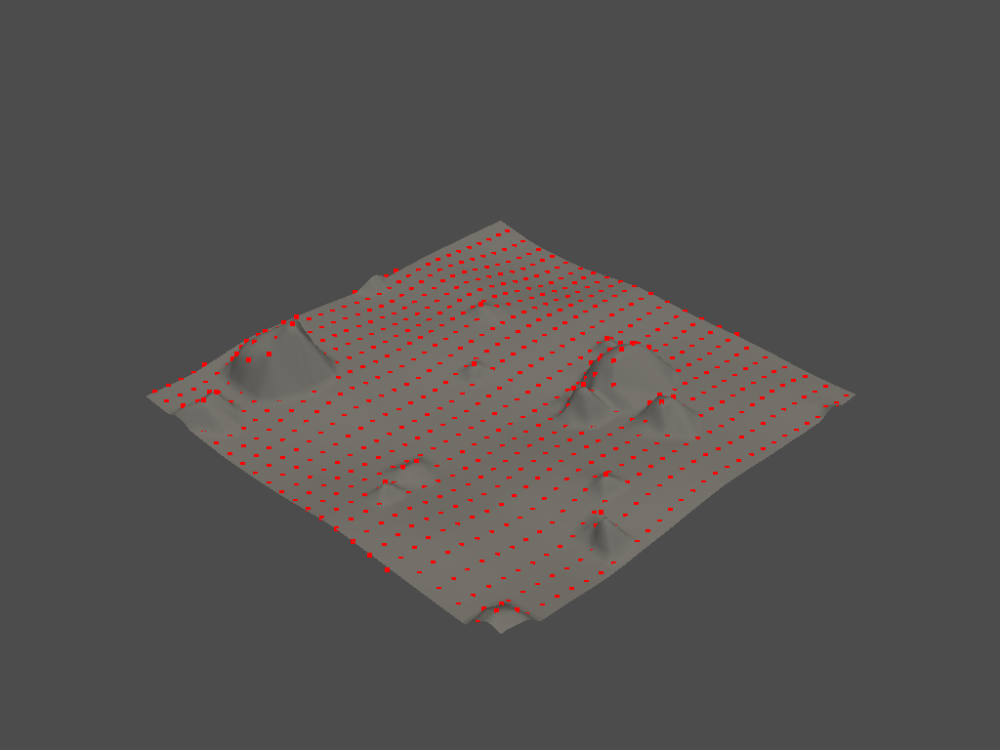

(747, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


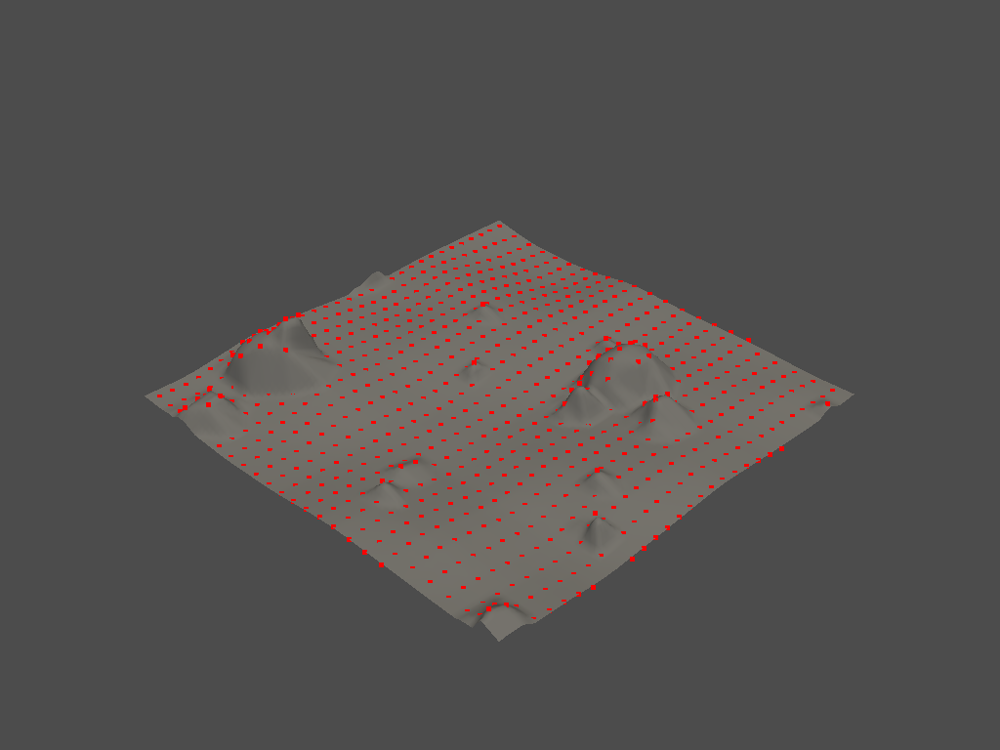

(780, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


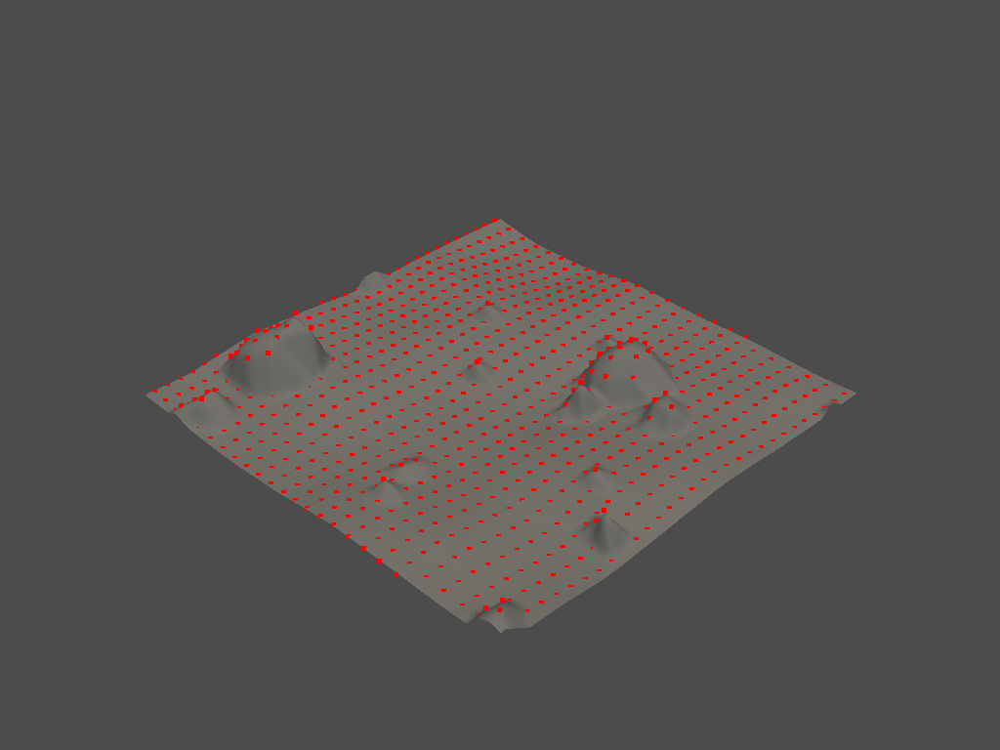

(817, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


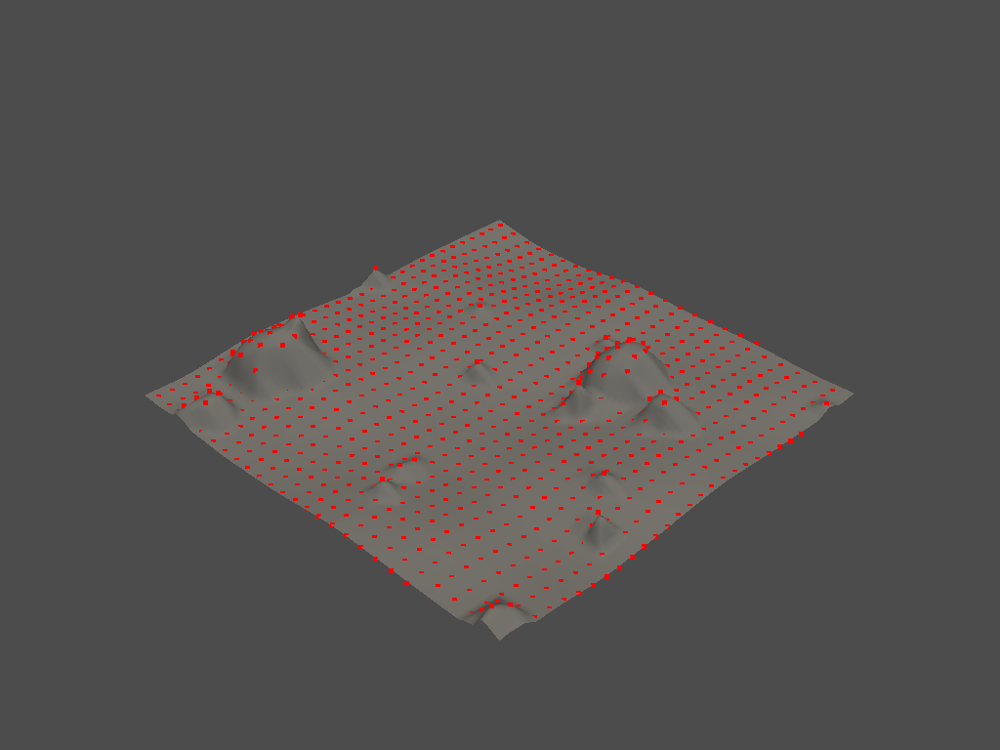

(846, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


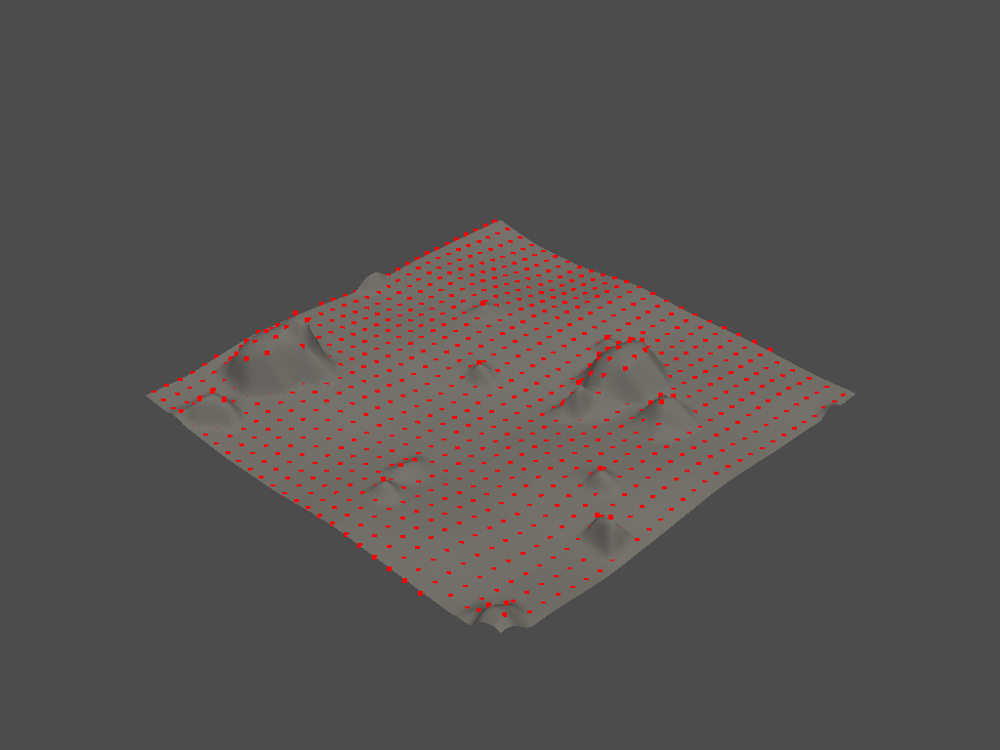

(879, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


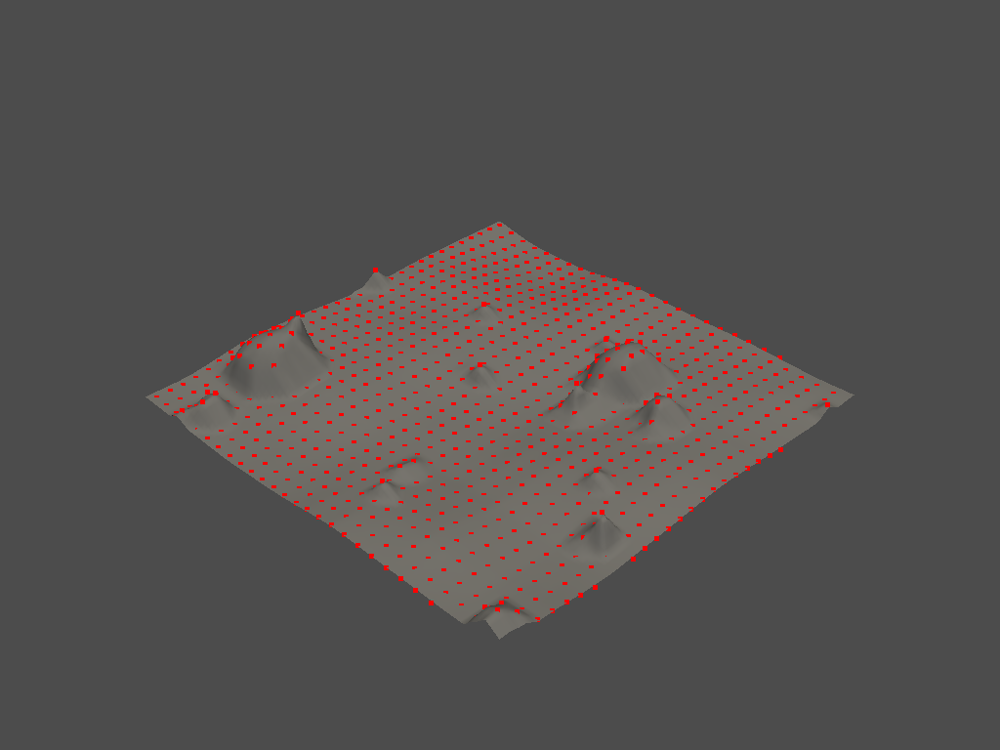

(892, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


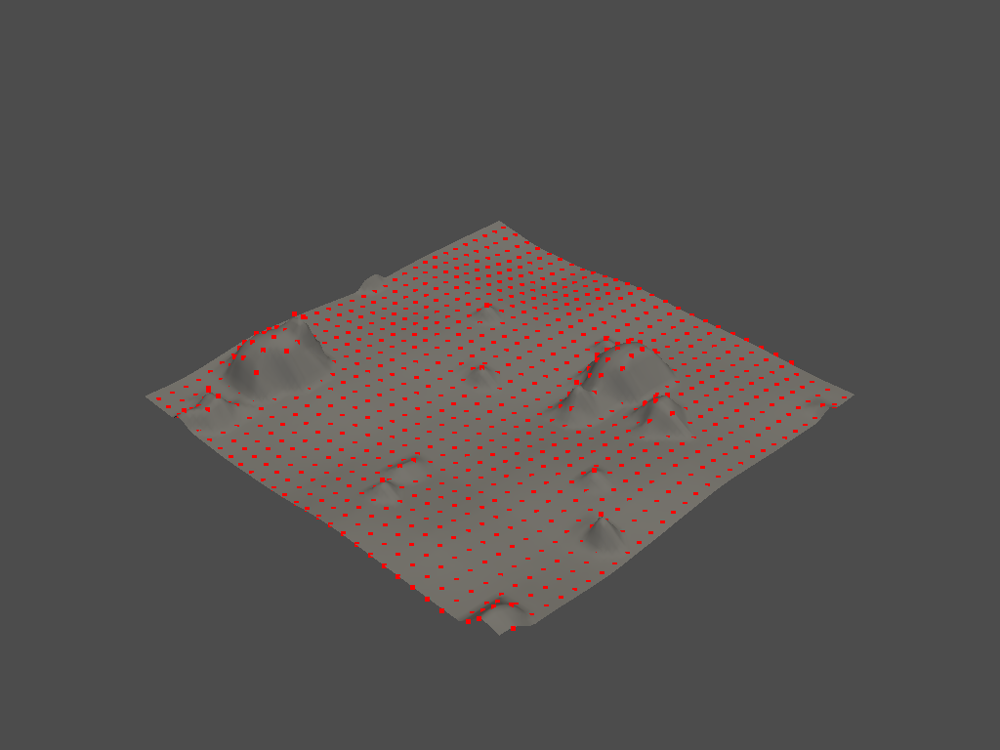

(927, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


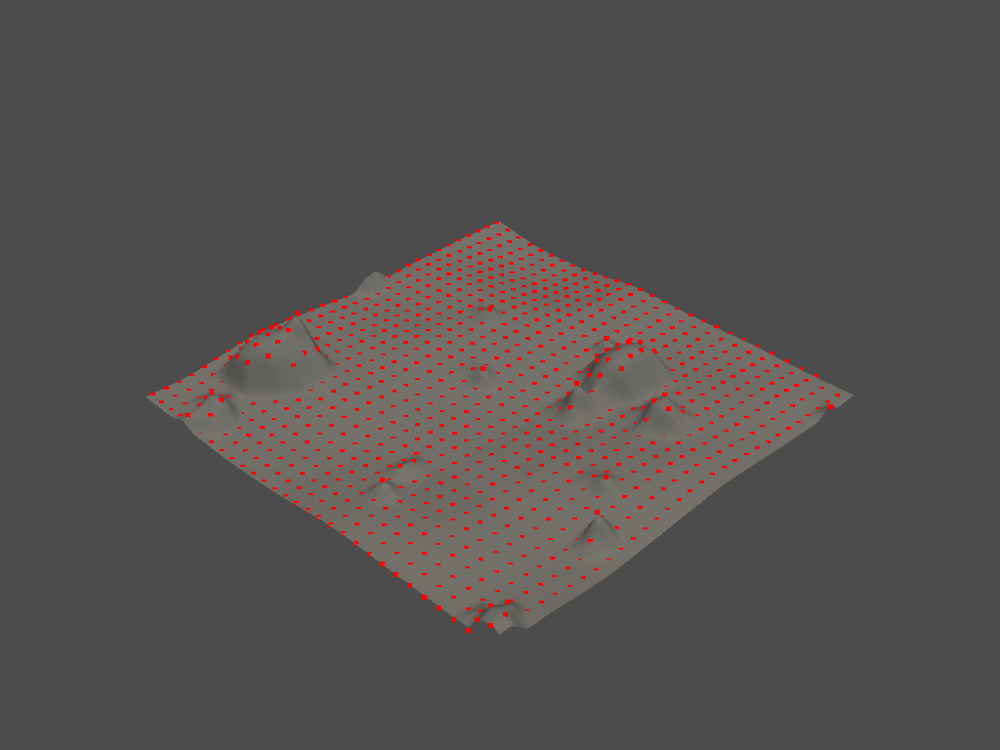

(959, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


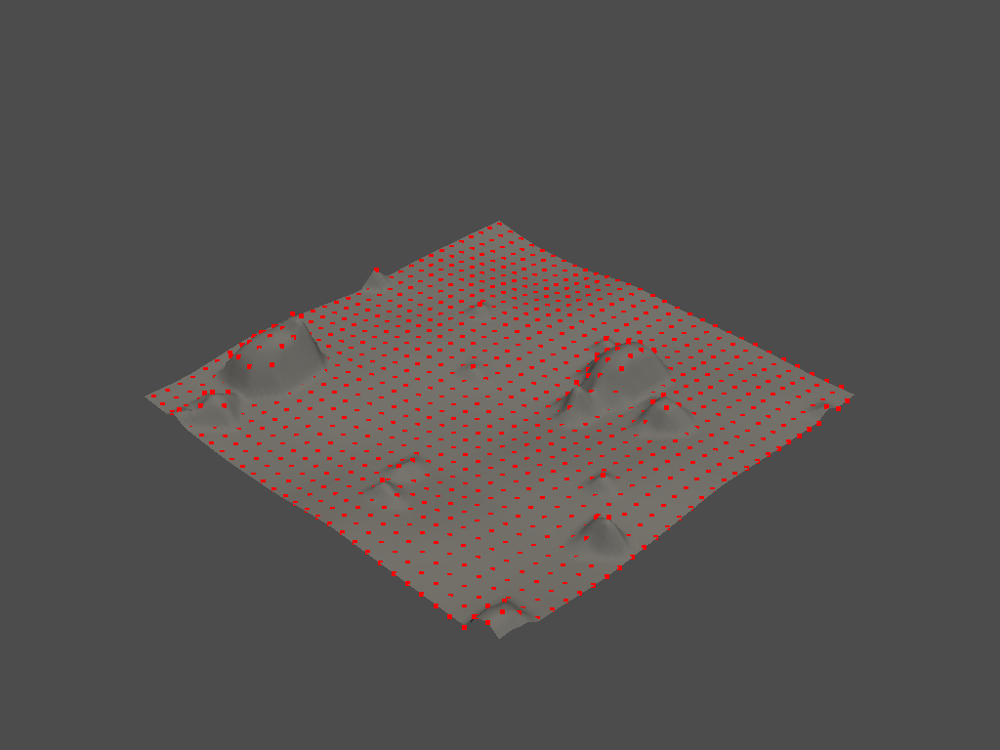

(960, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


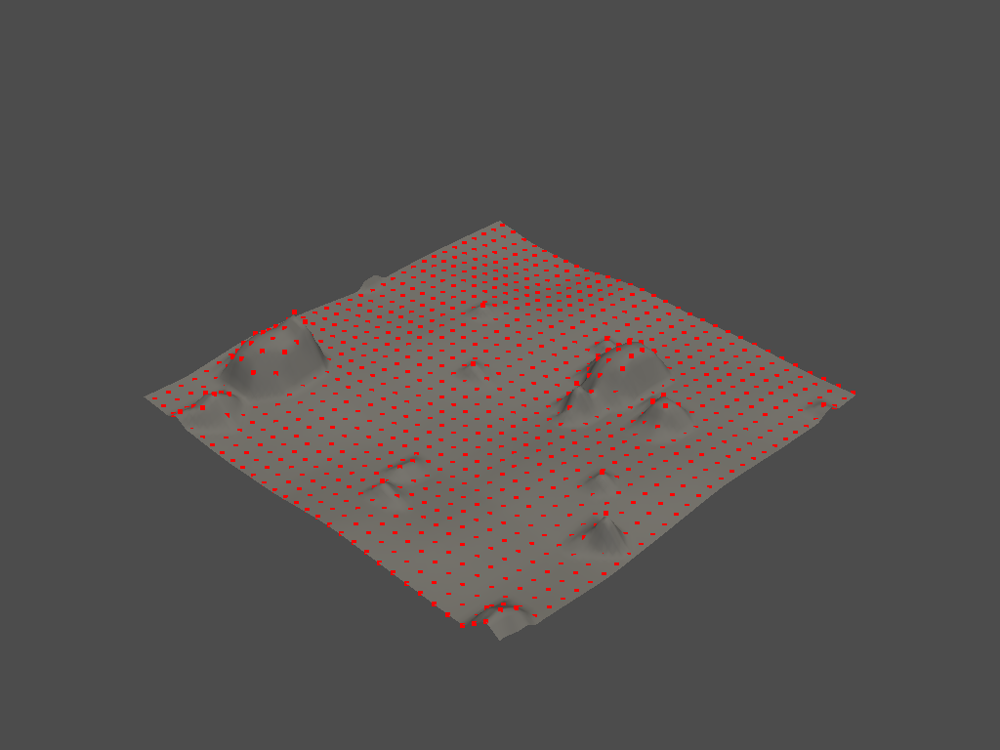

(962, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


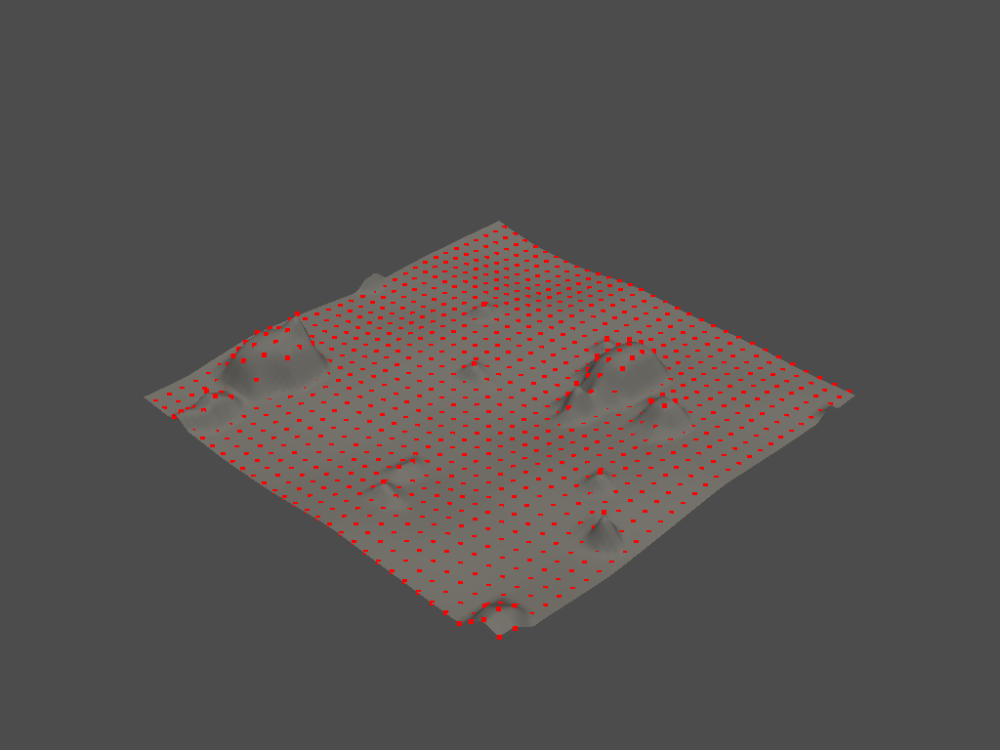

(994, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


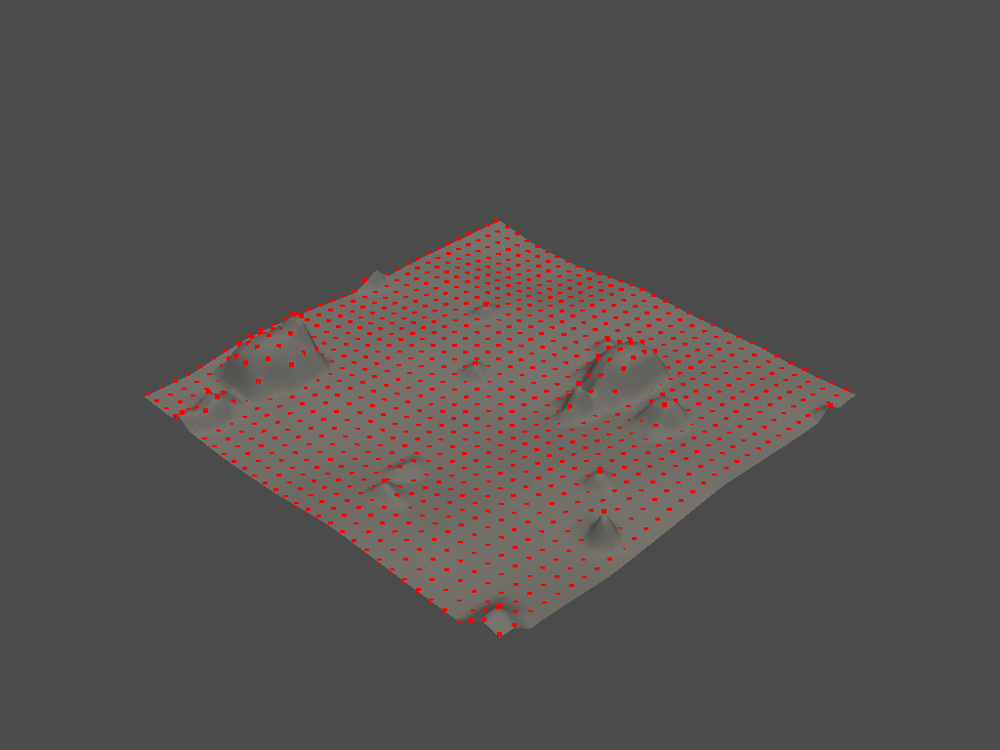

(1024, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


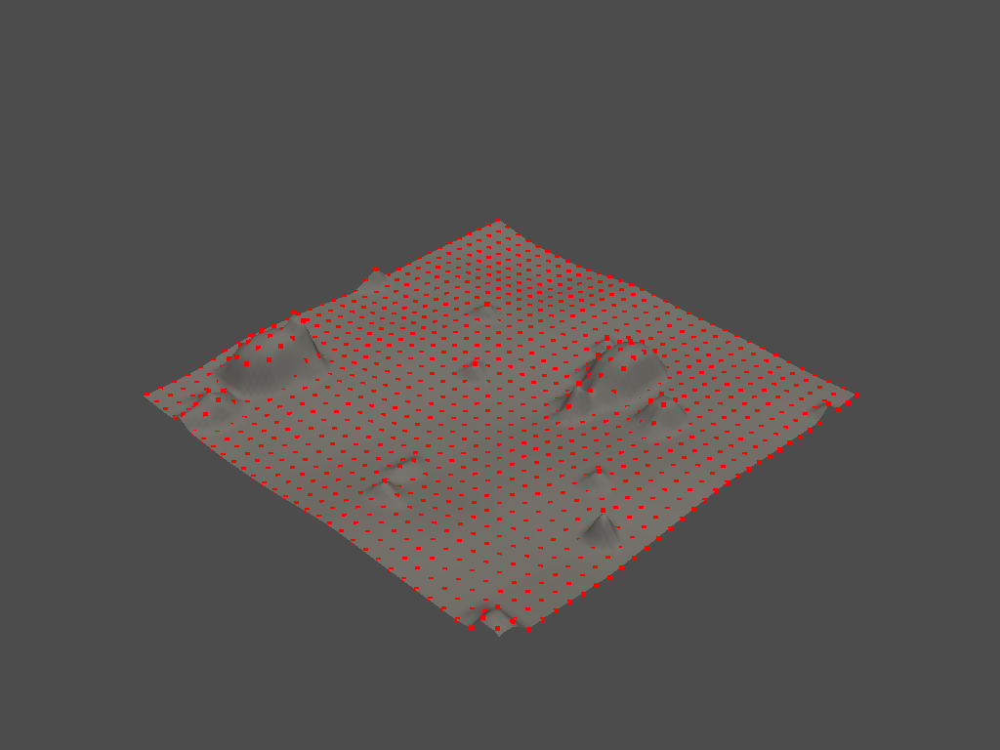

(1024, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


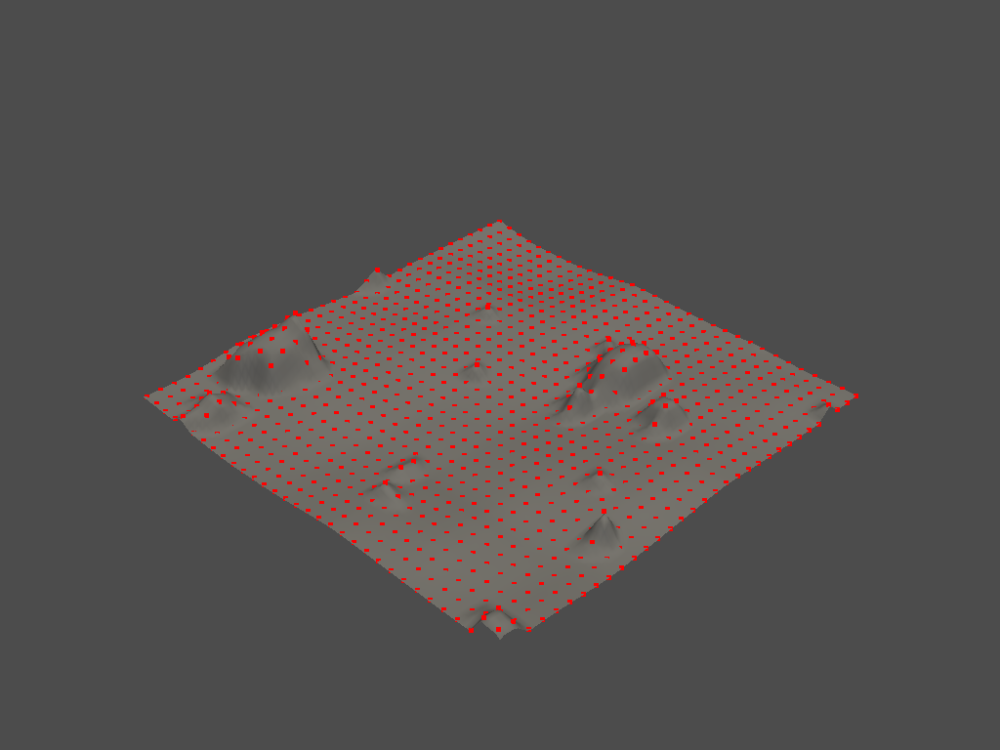

(1024, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


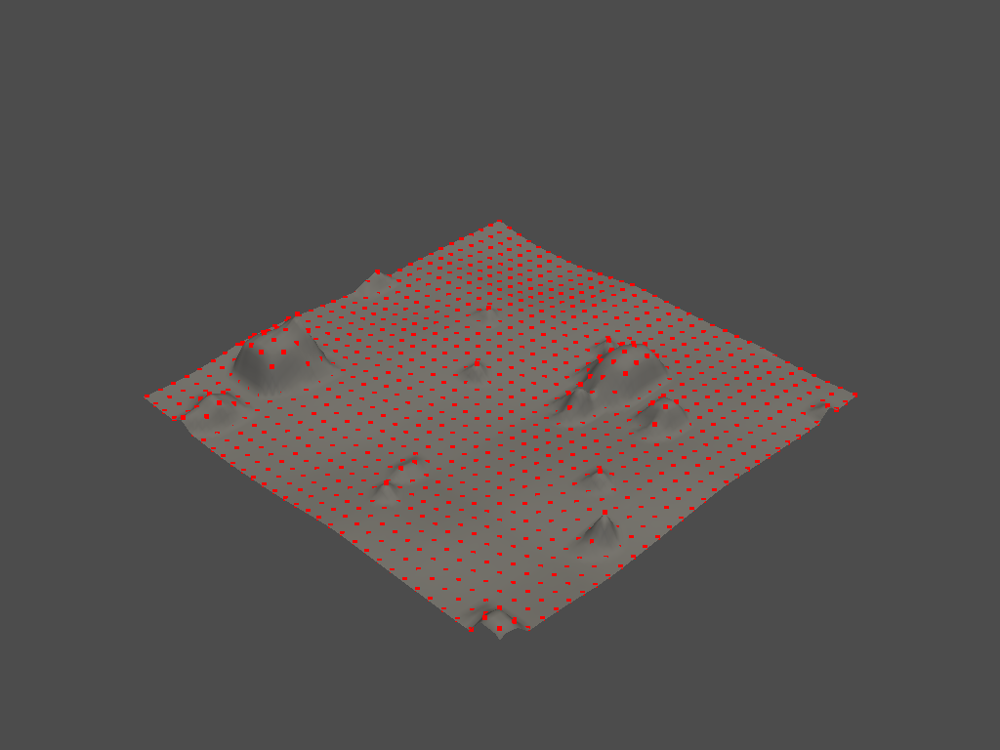

(1024, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


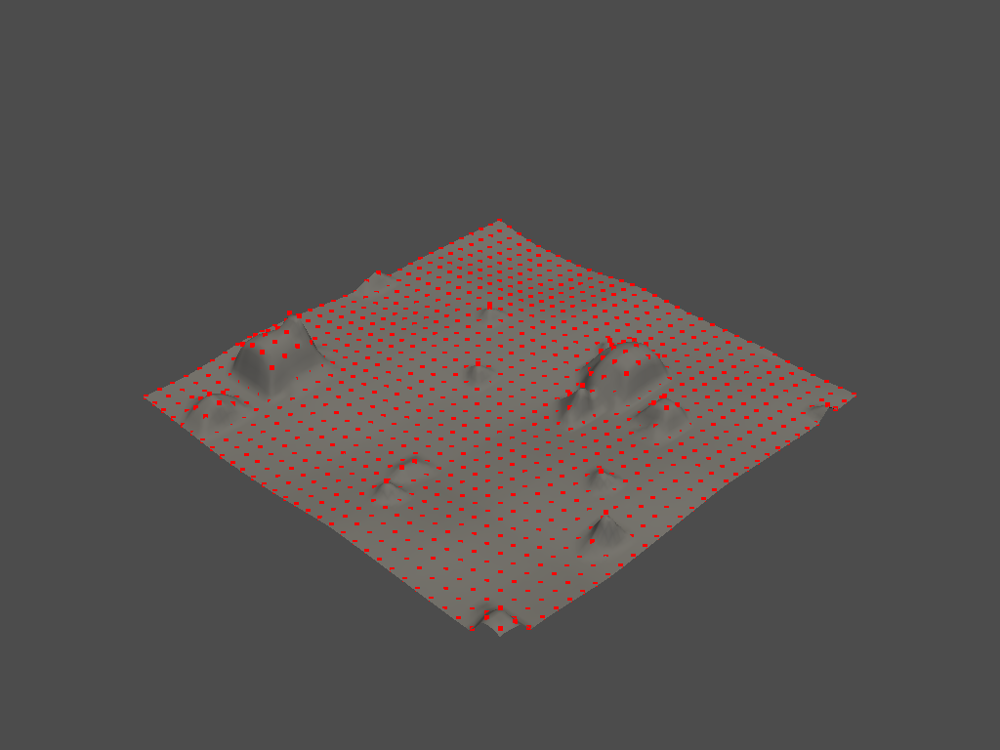

(1024, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


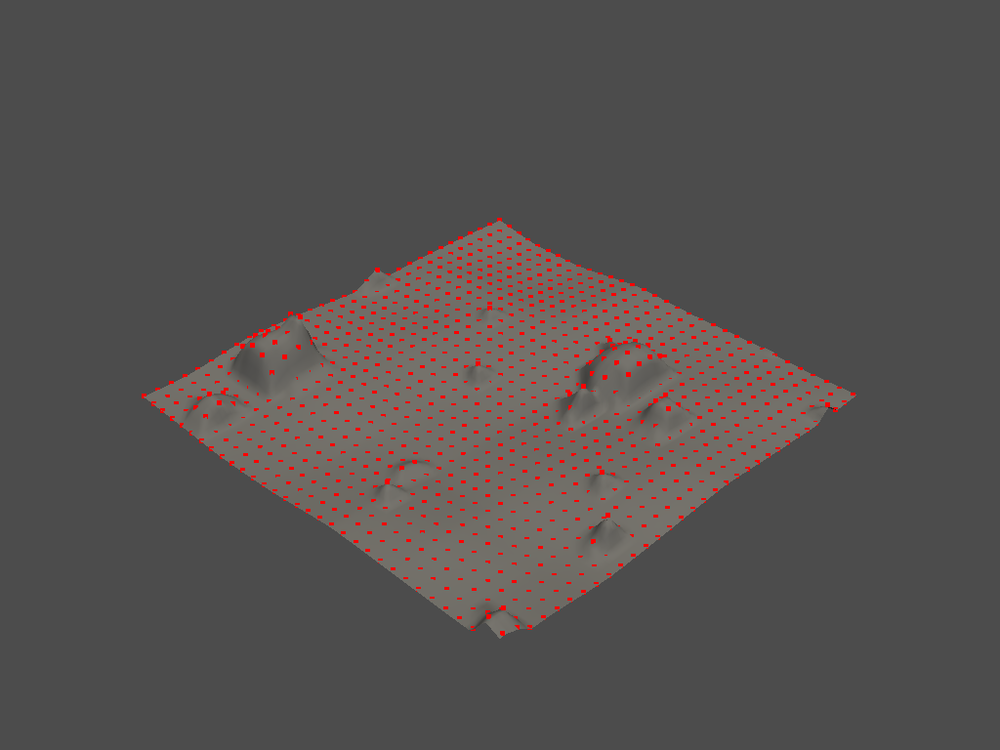

(1018, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


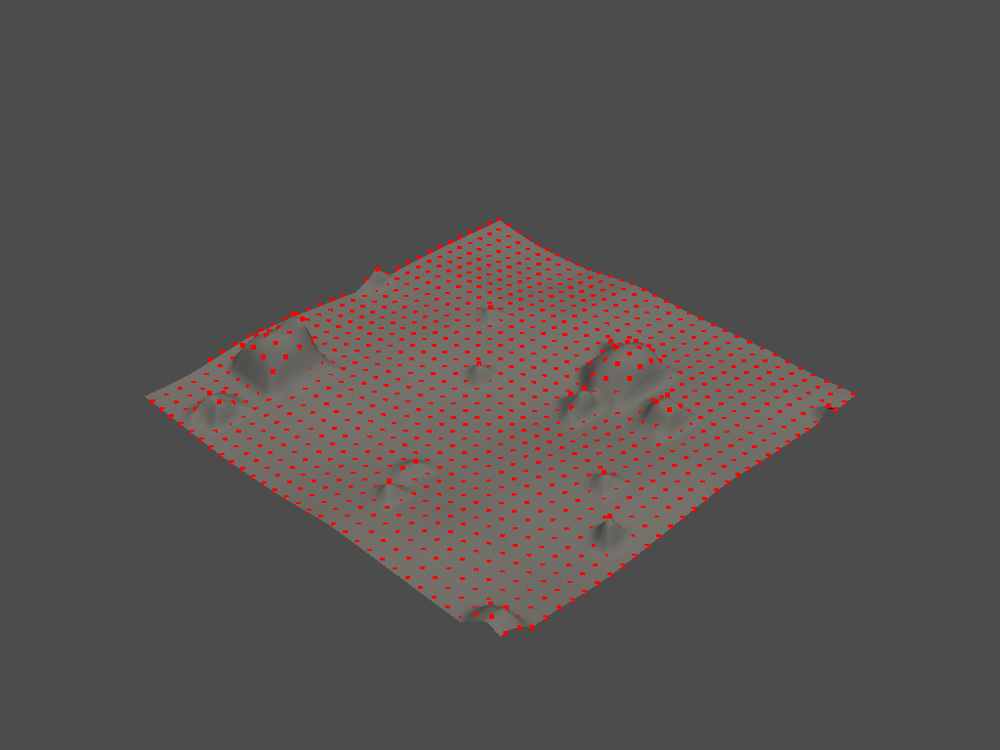

(990, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


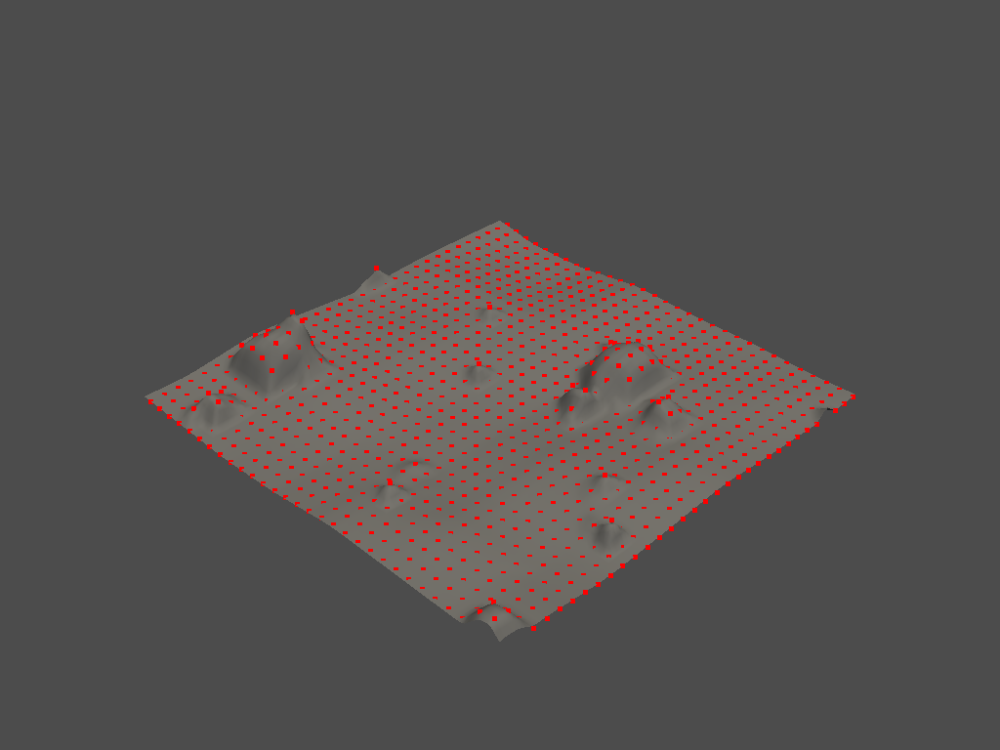

(960, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


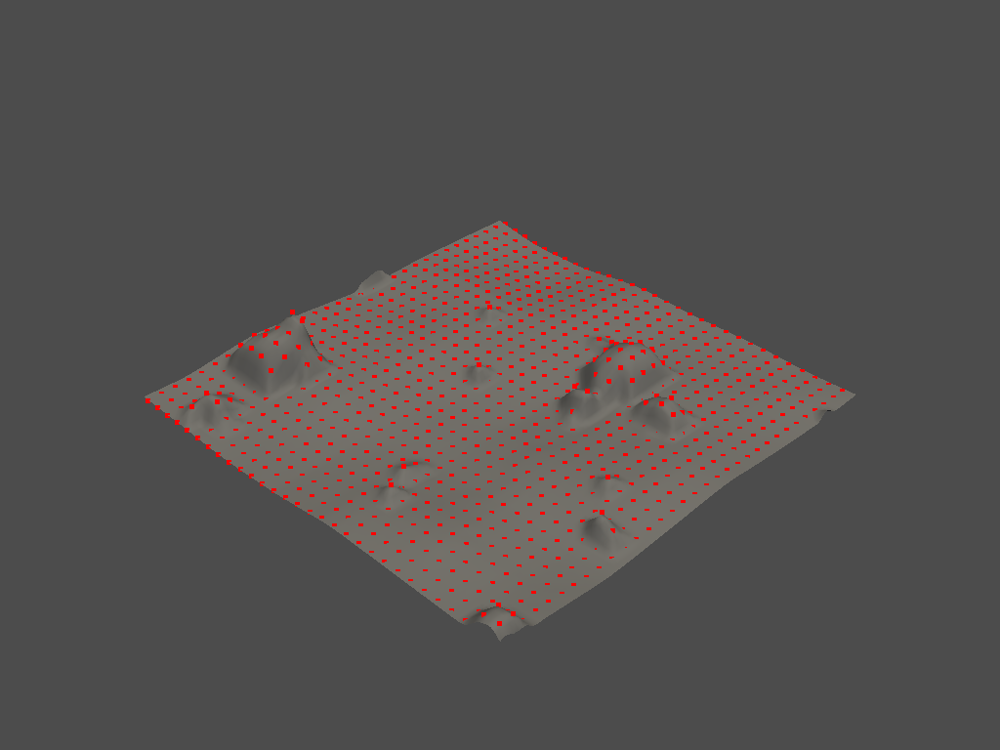

(960, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


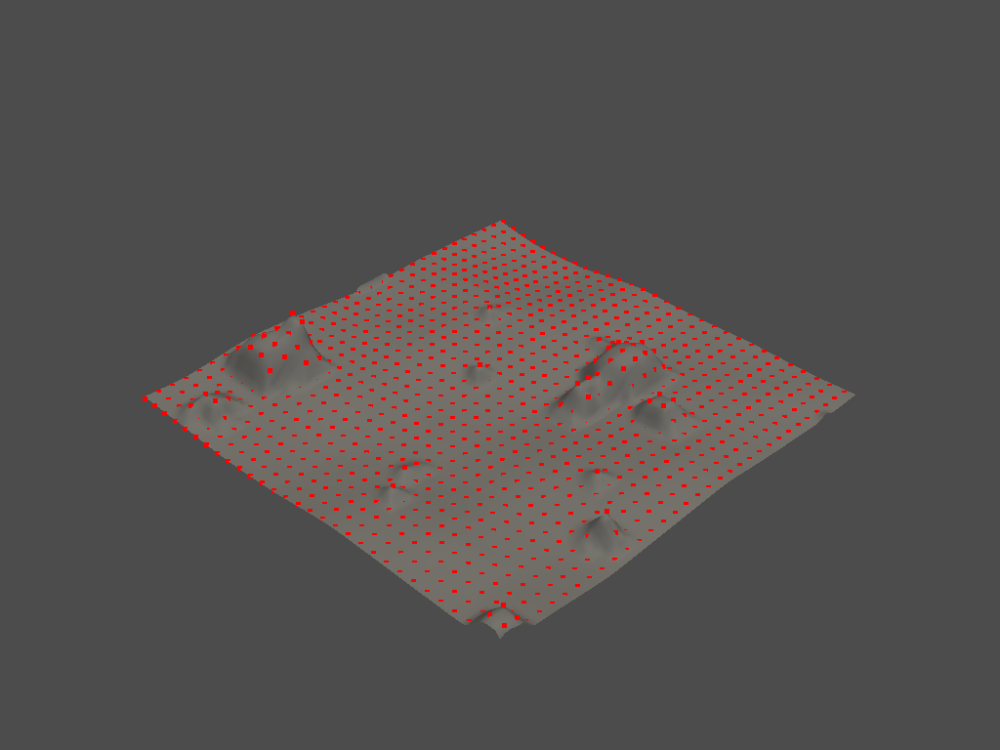

(953, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


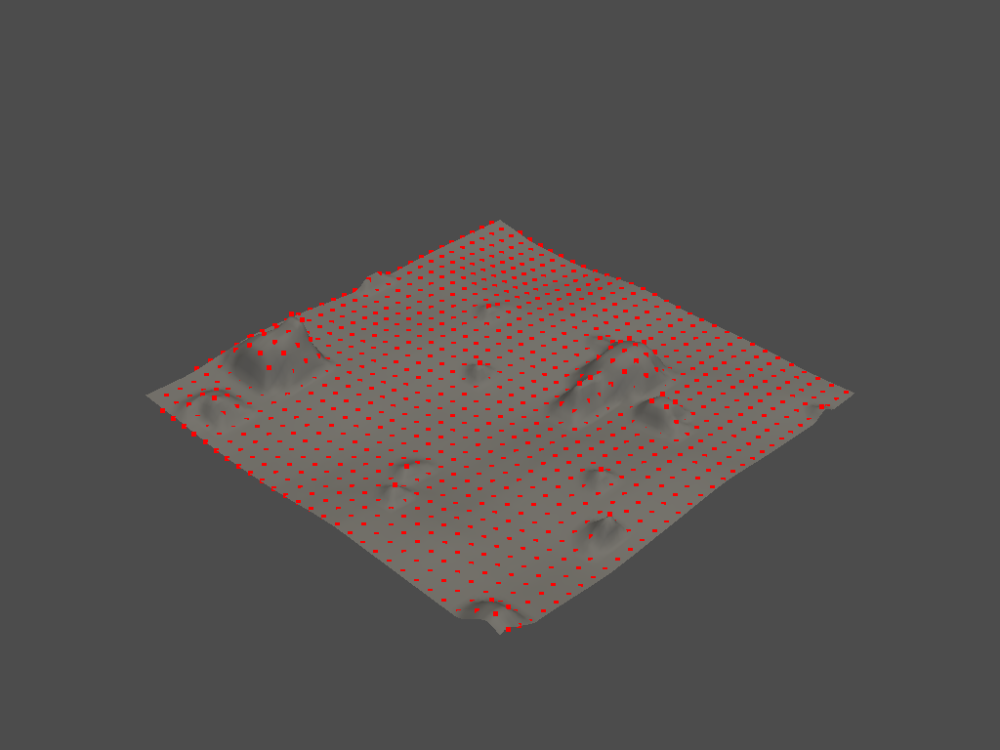

(921, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


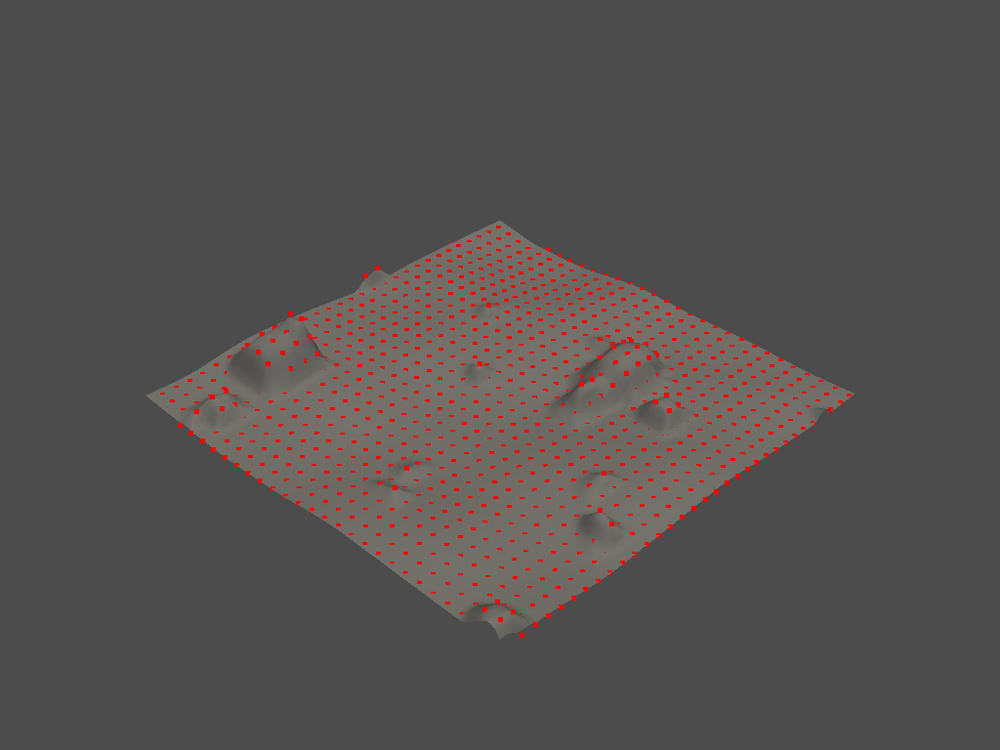

(887, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


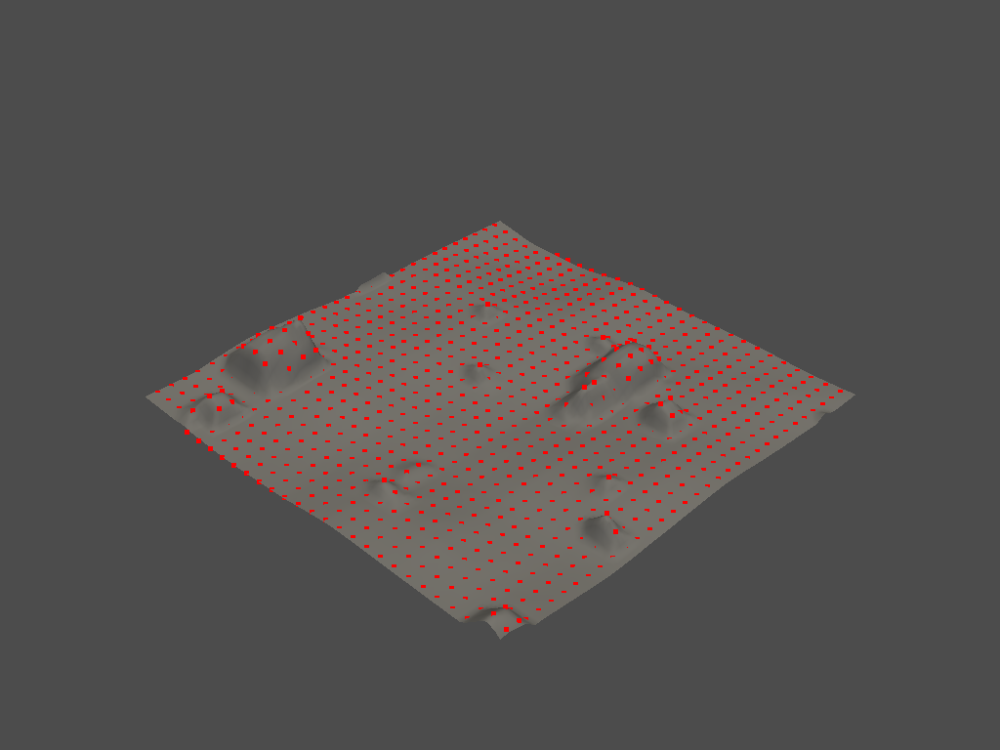

(864, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


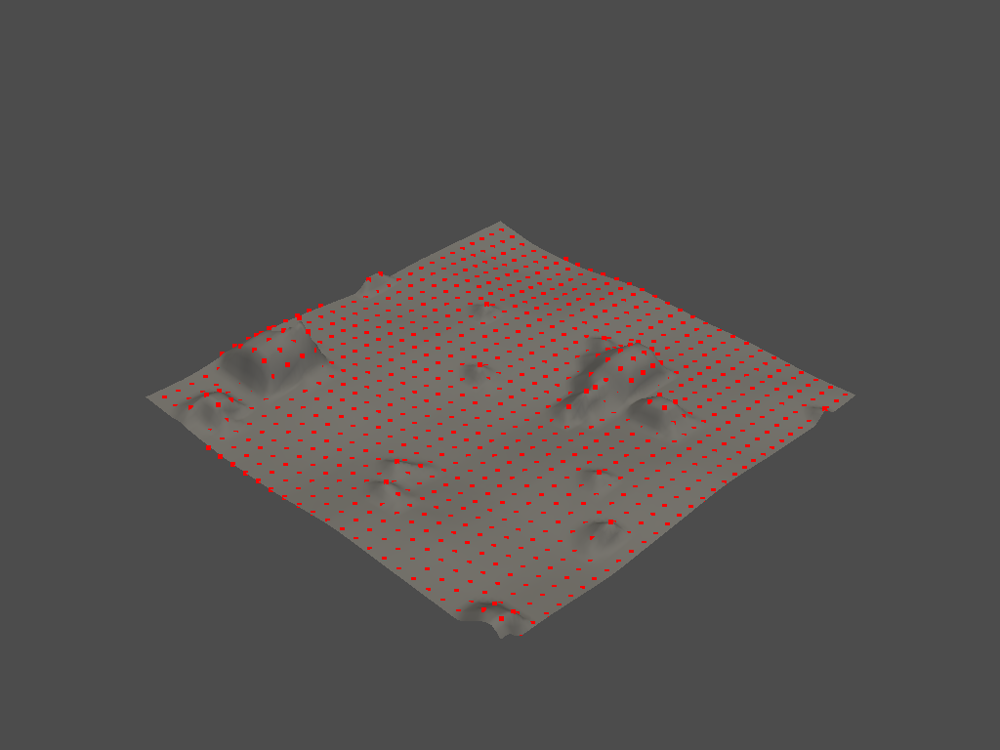

(832, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


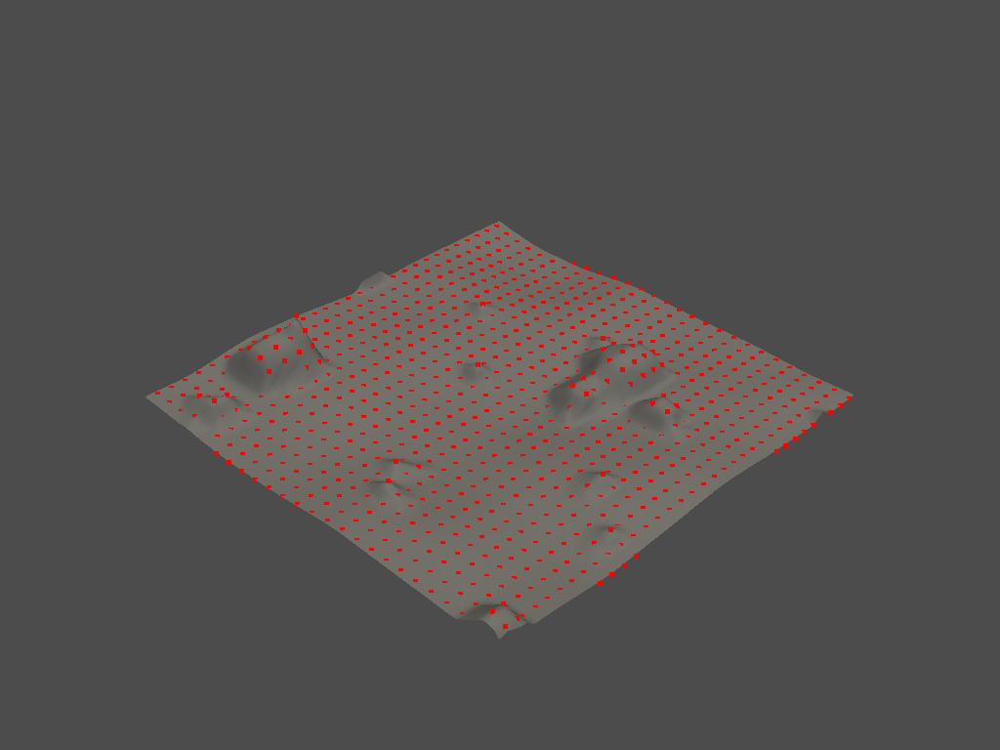

(808, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


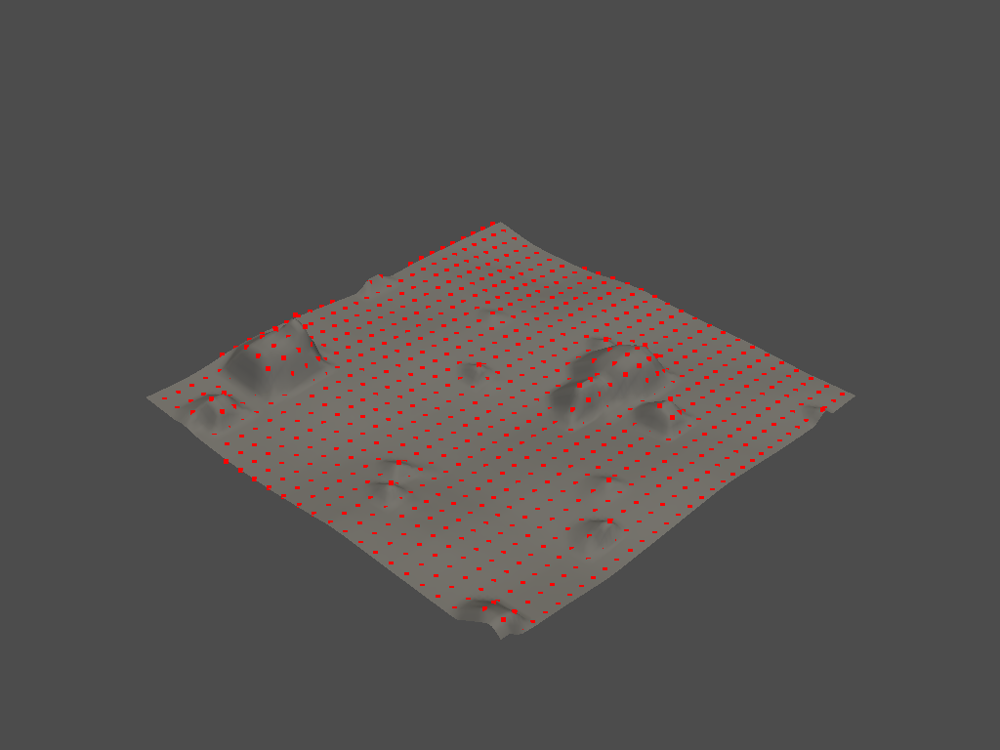

(768, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


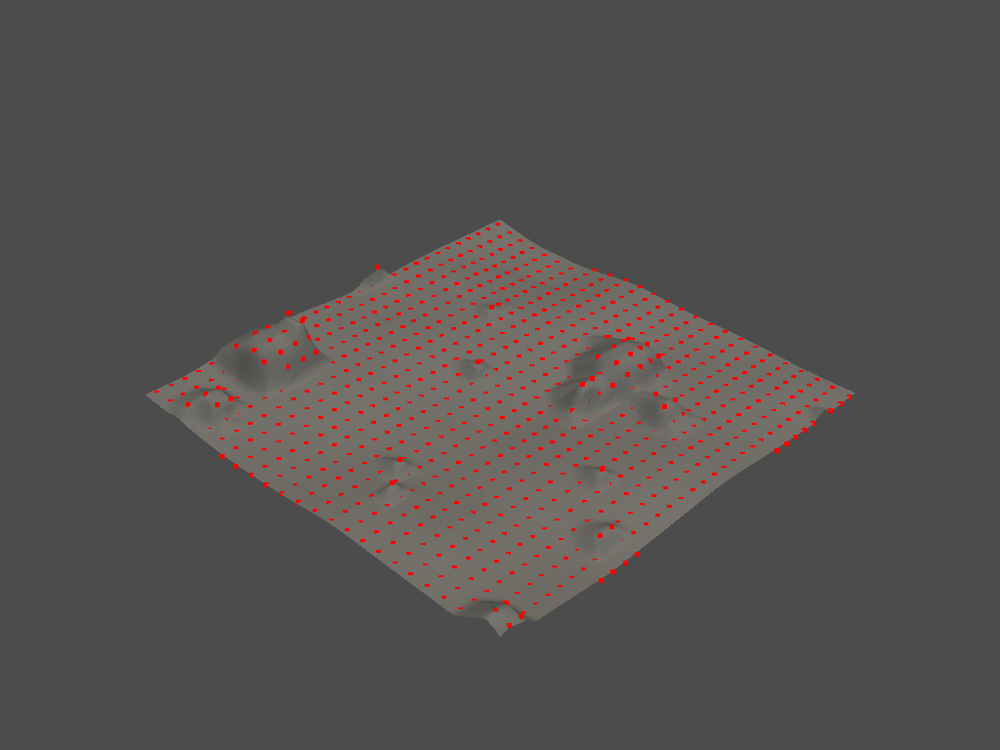

(733, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


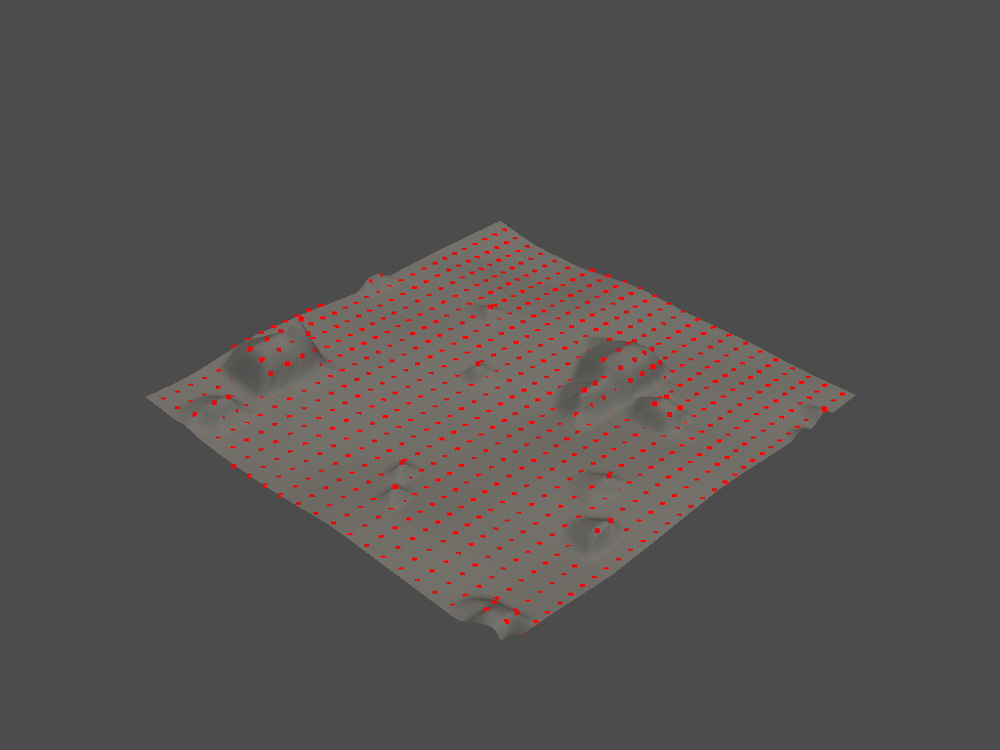

(694, 3)


c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


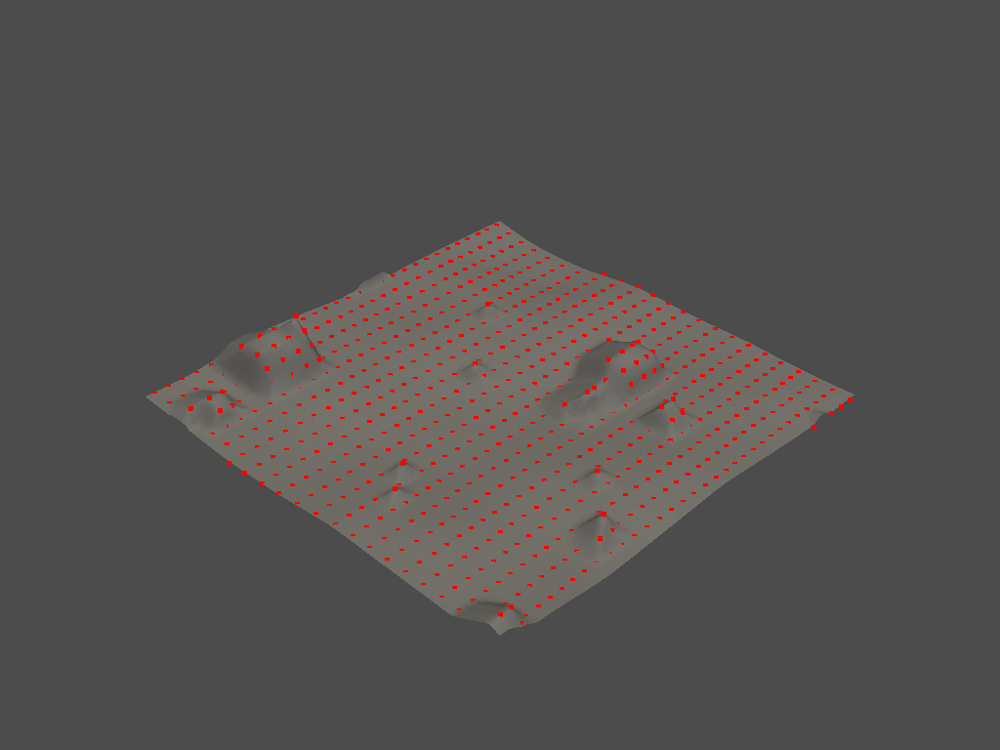

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


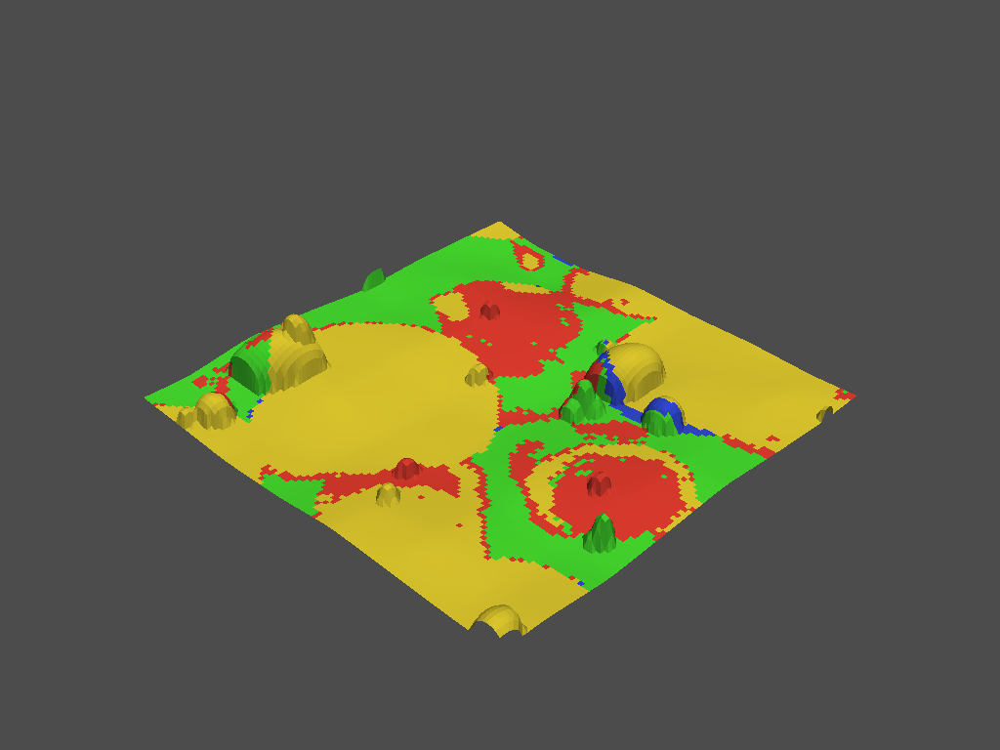

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


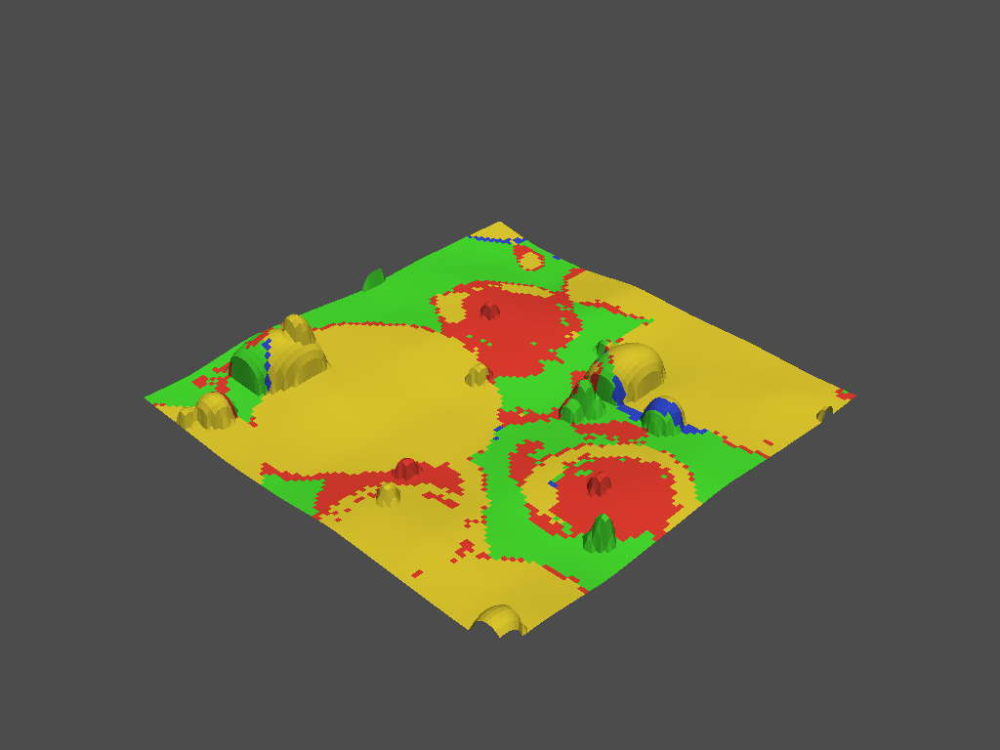

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


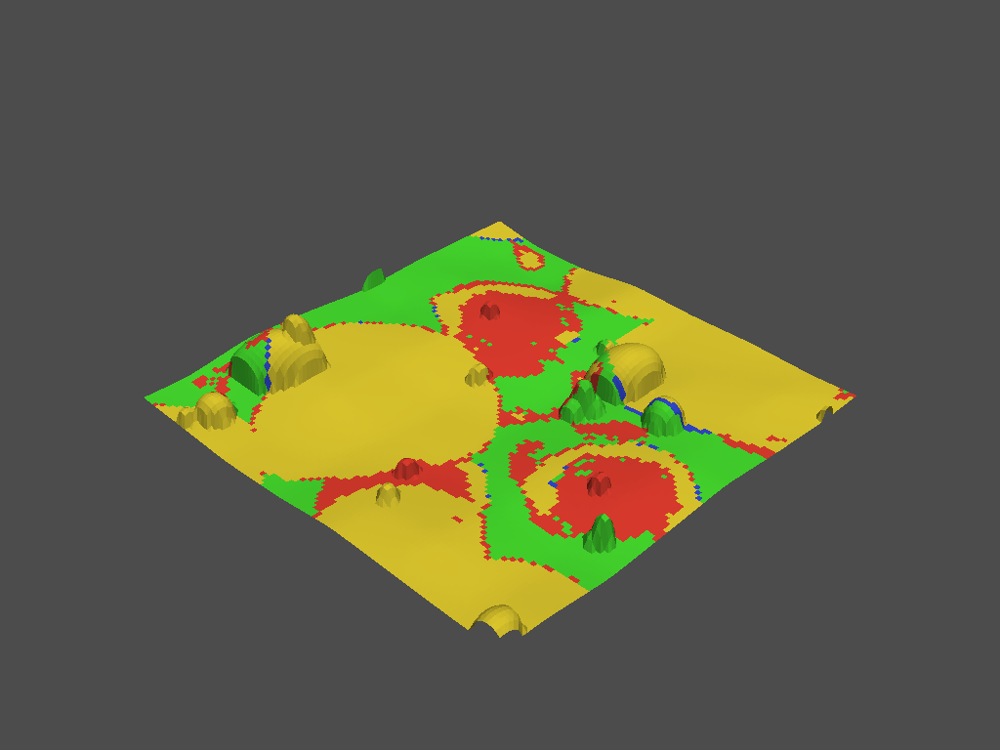

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


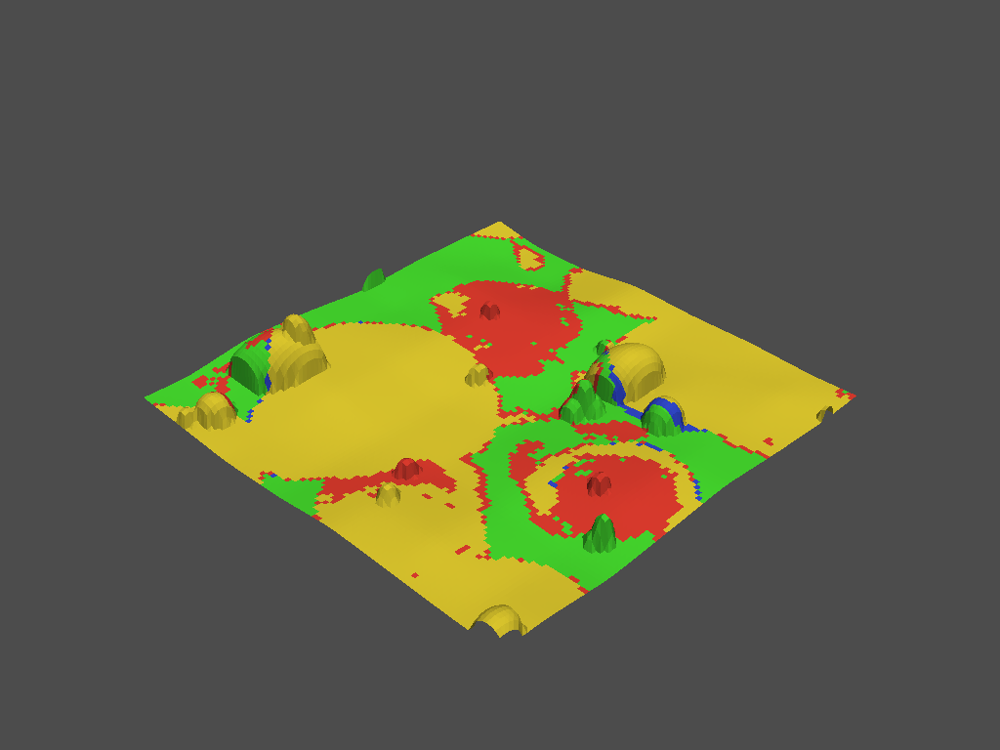

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


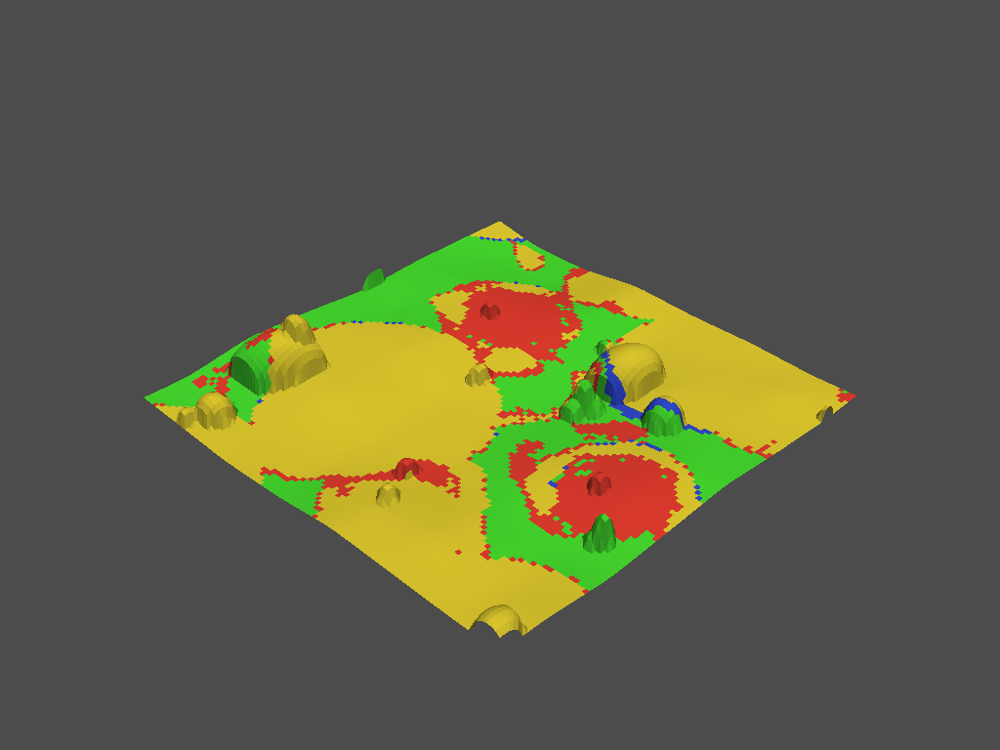

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


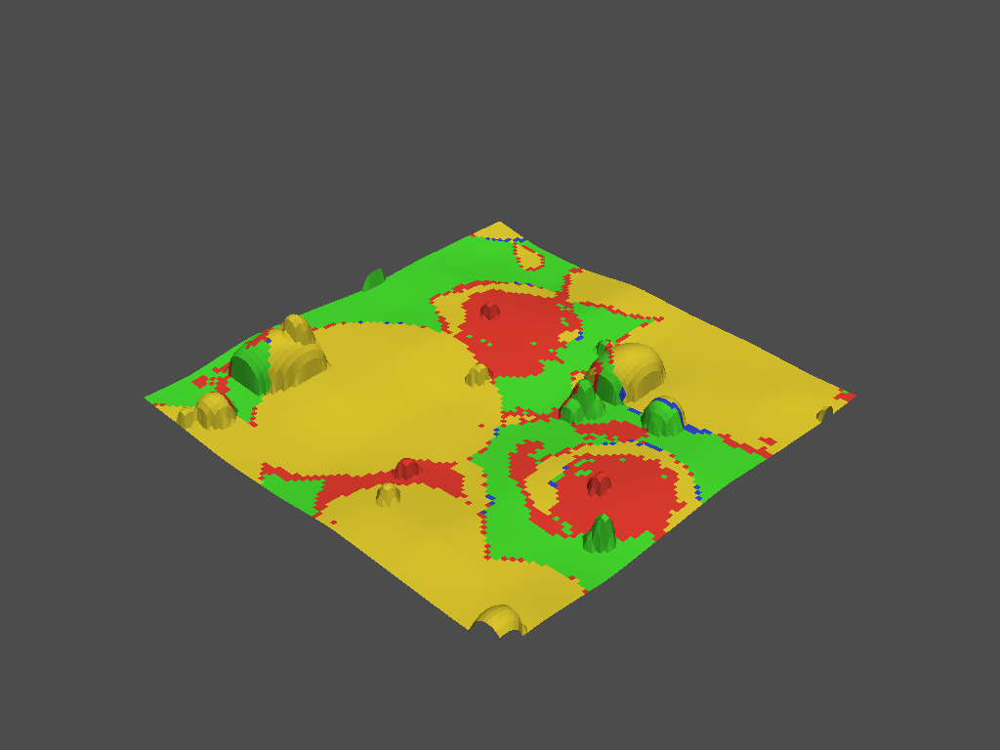

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


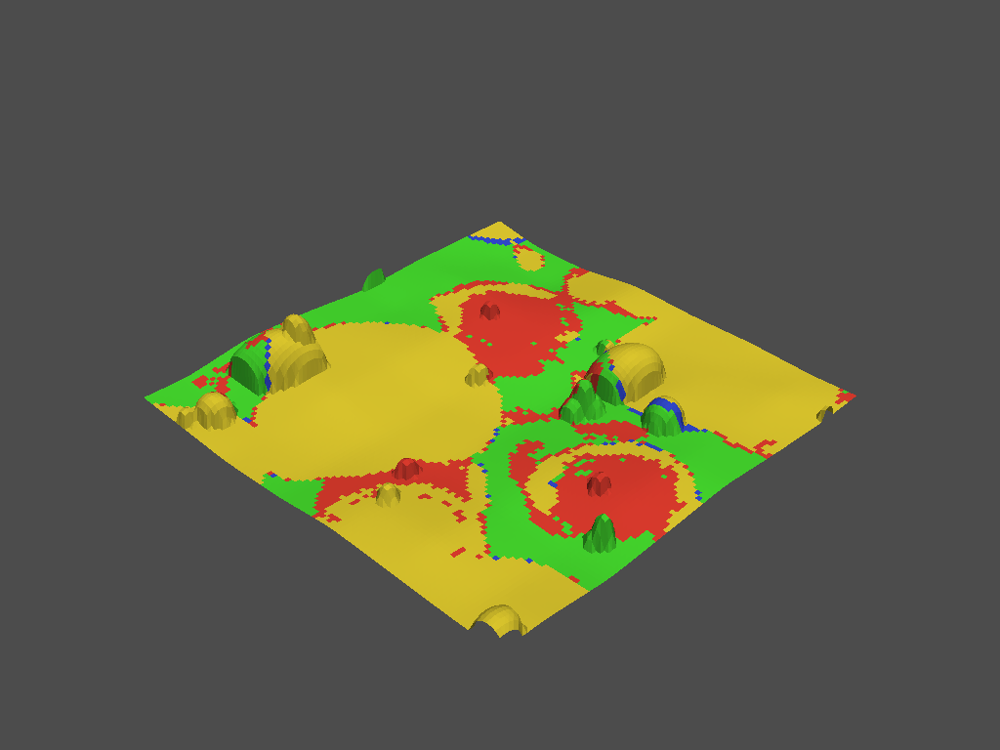

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


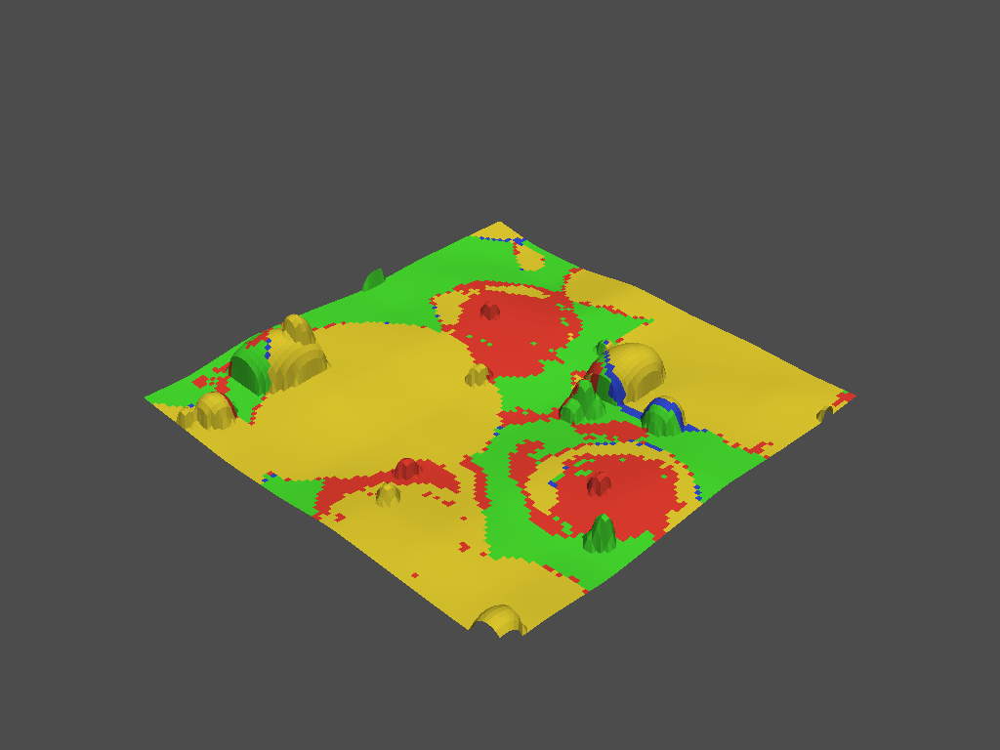

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


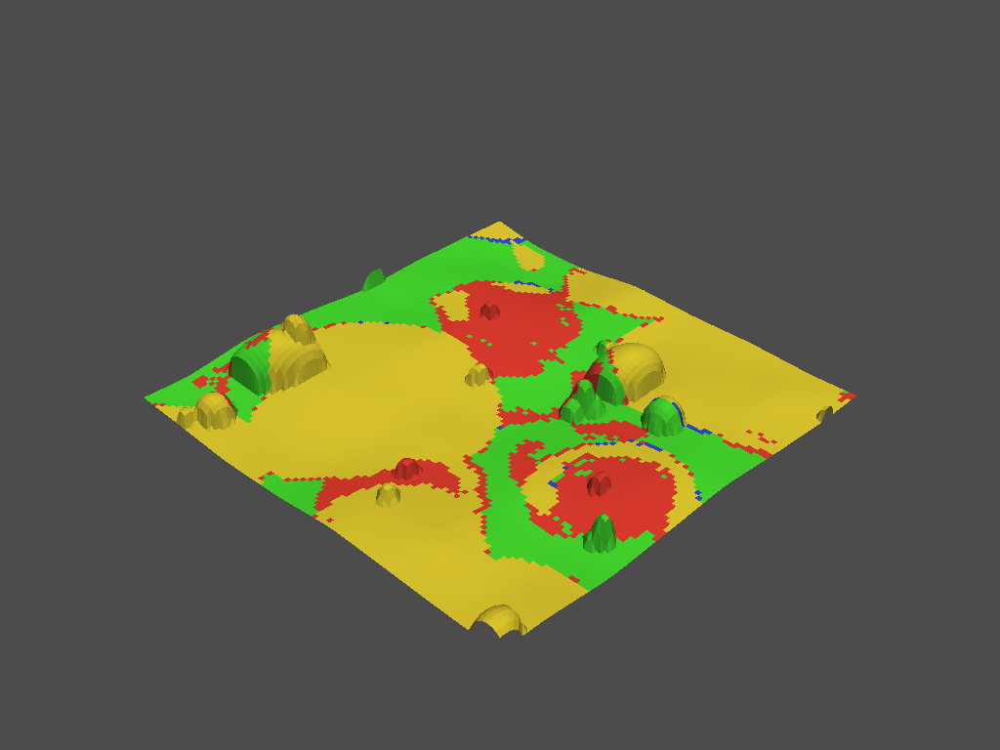

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


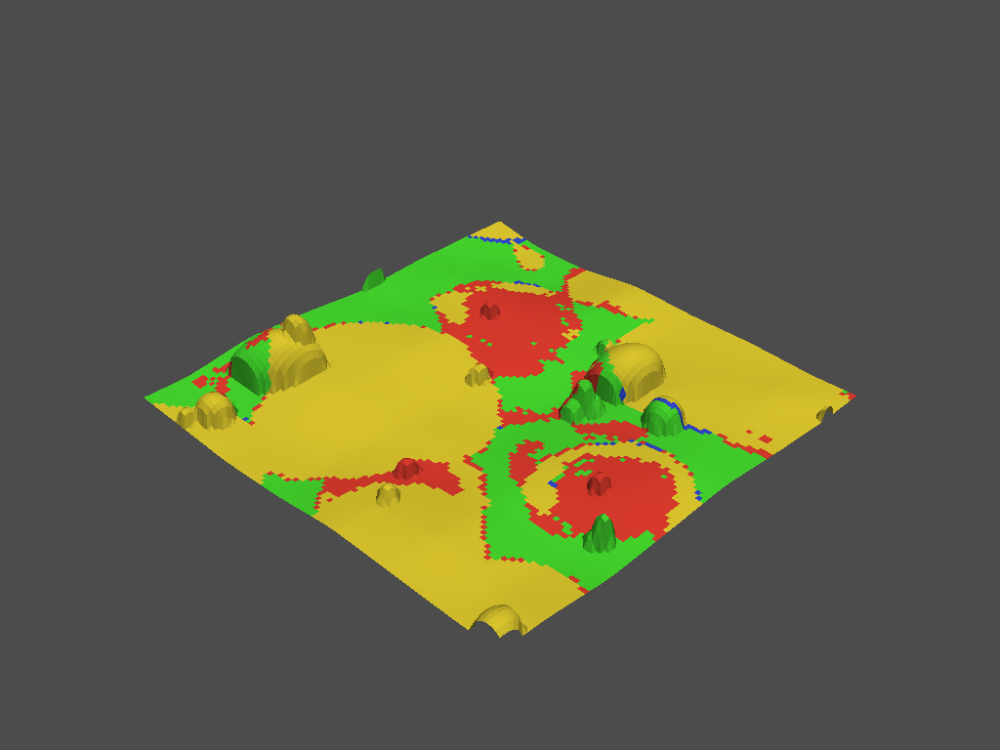

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


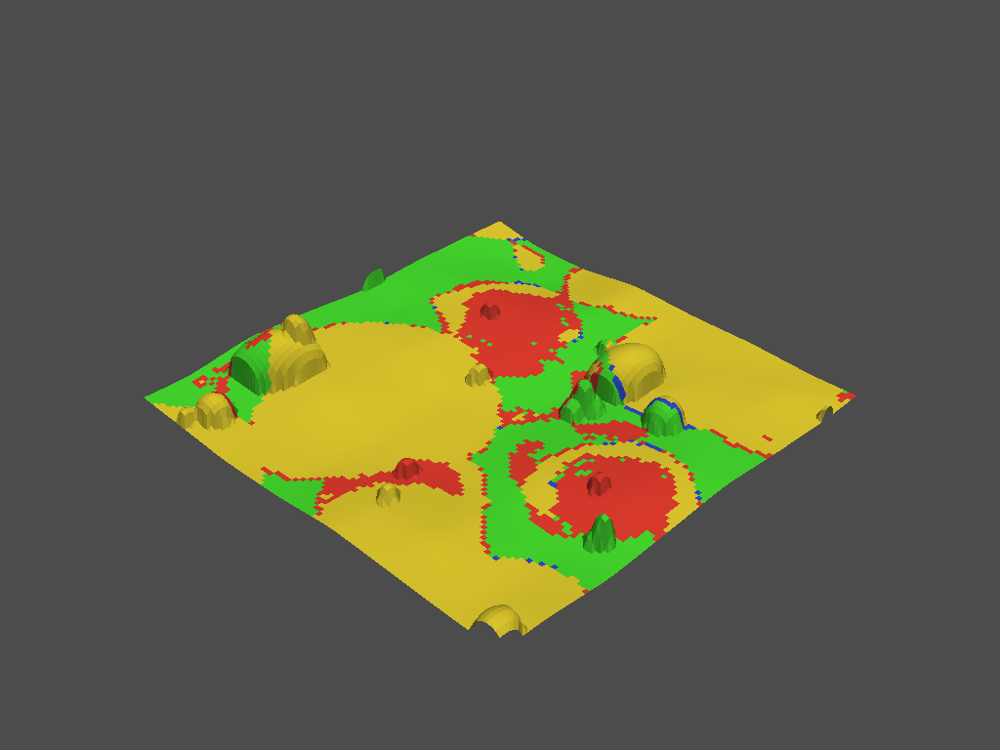

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


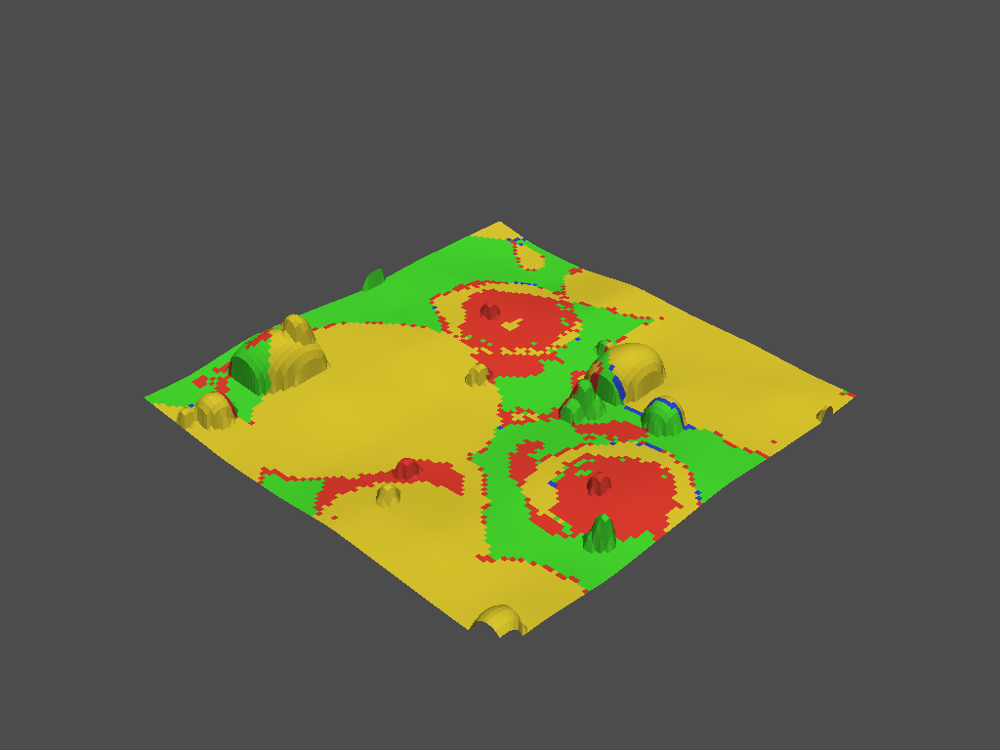

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


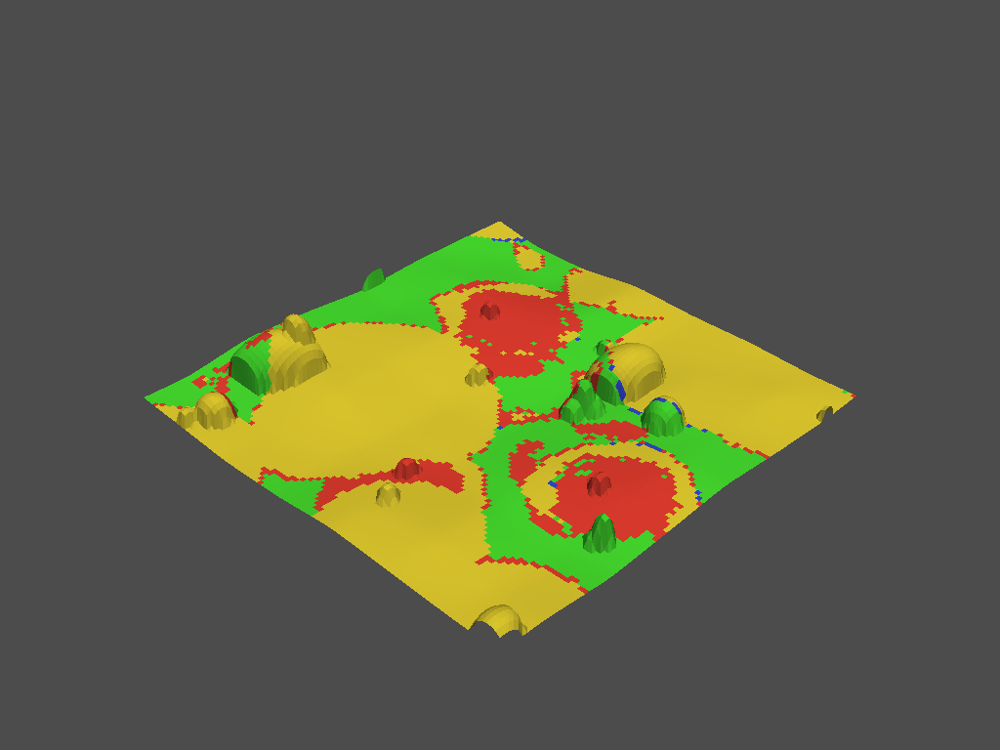

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


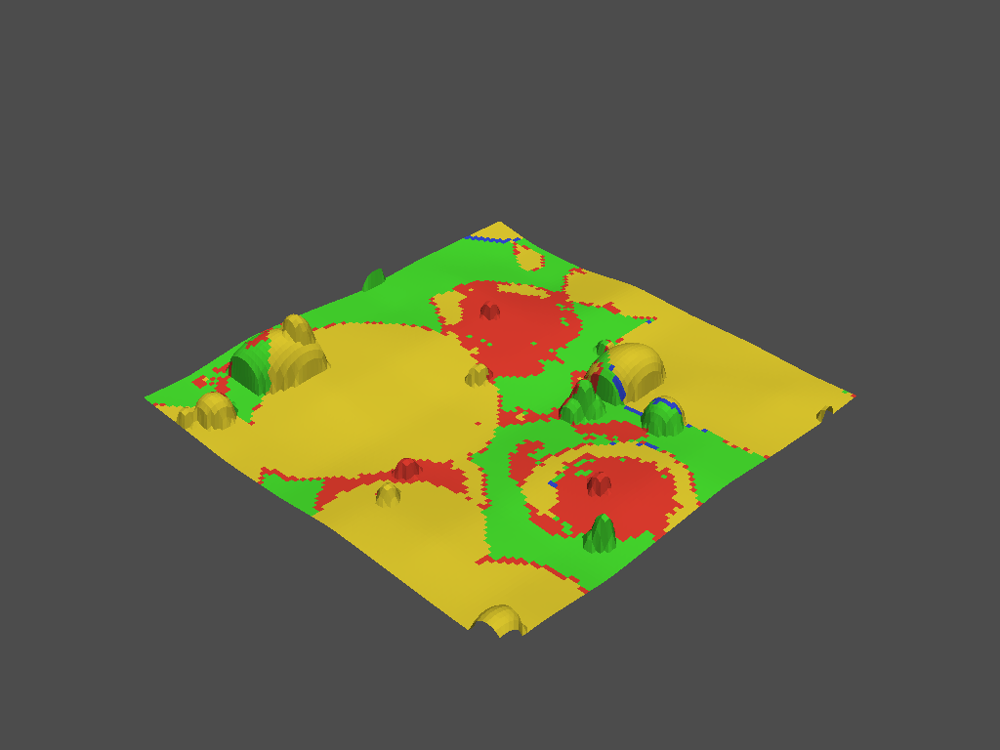

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


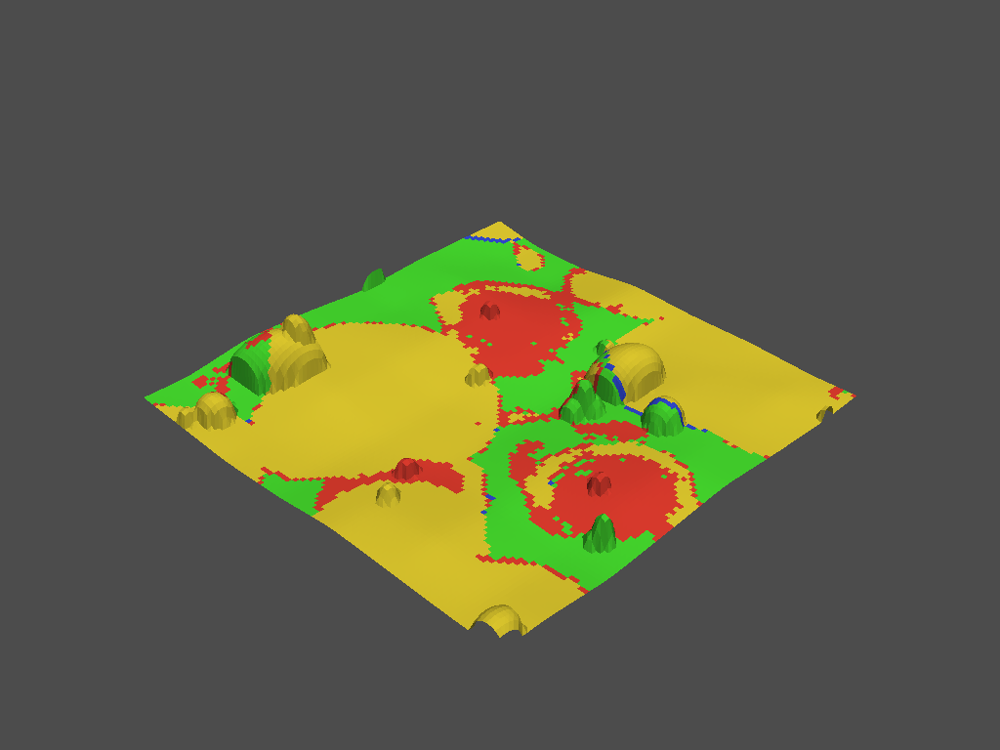

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


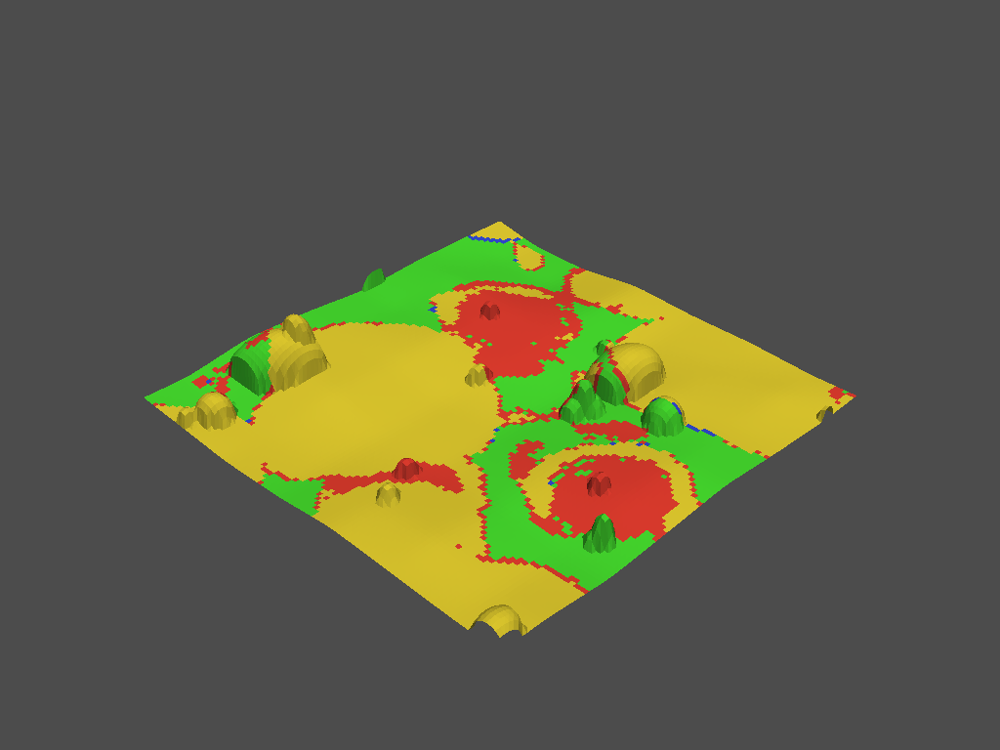

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


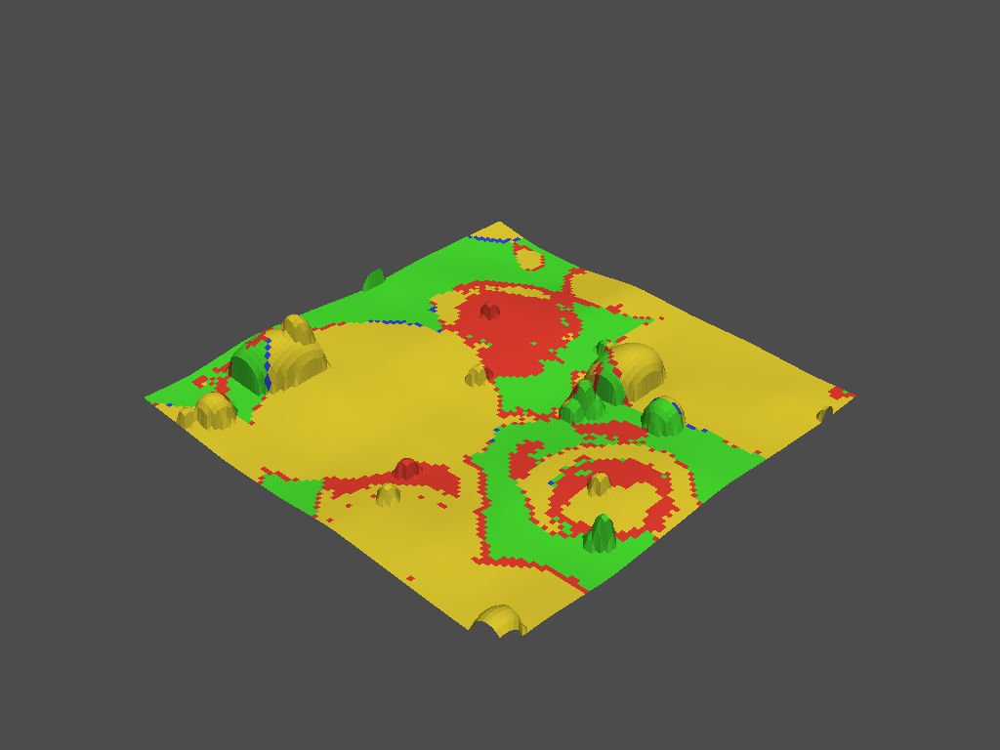

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


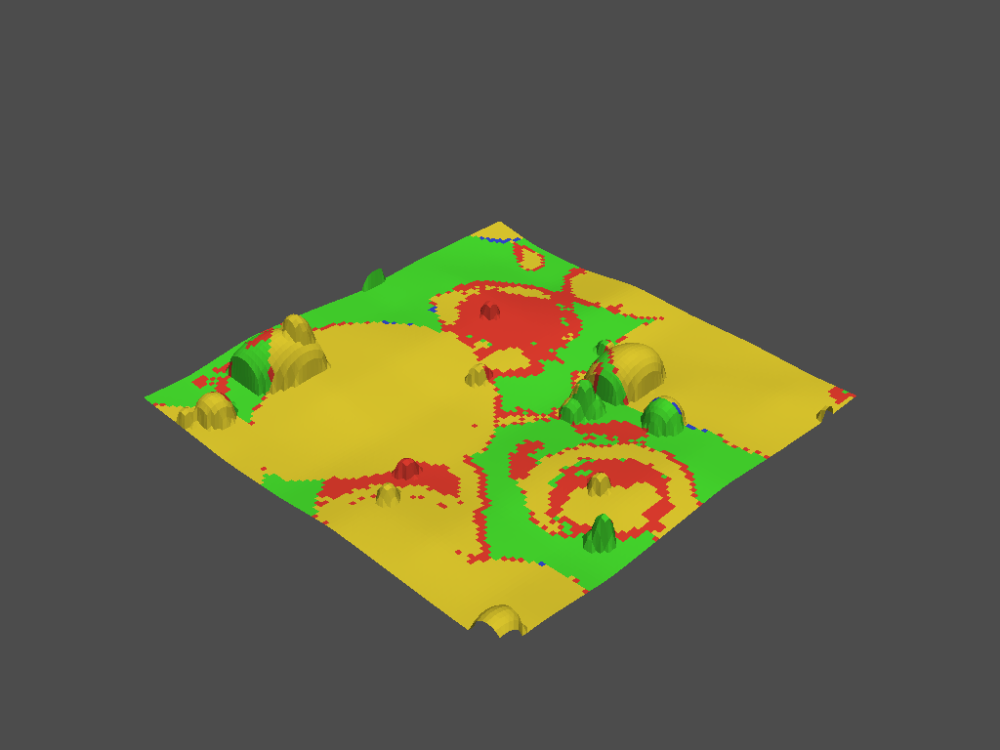

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


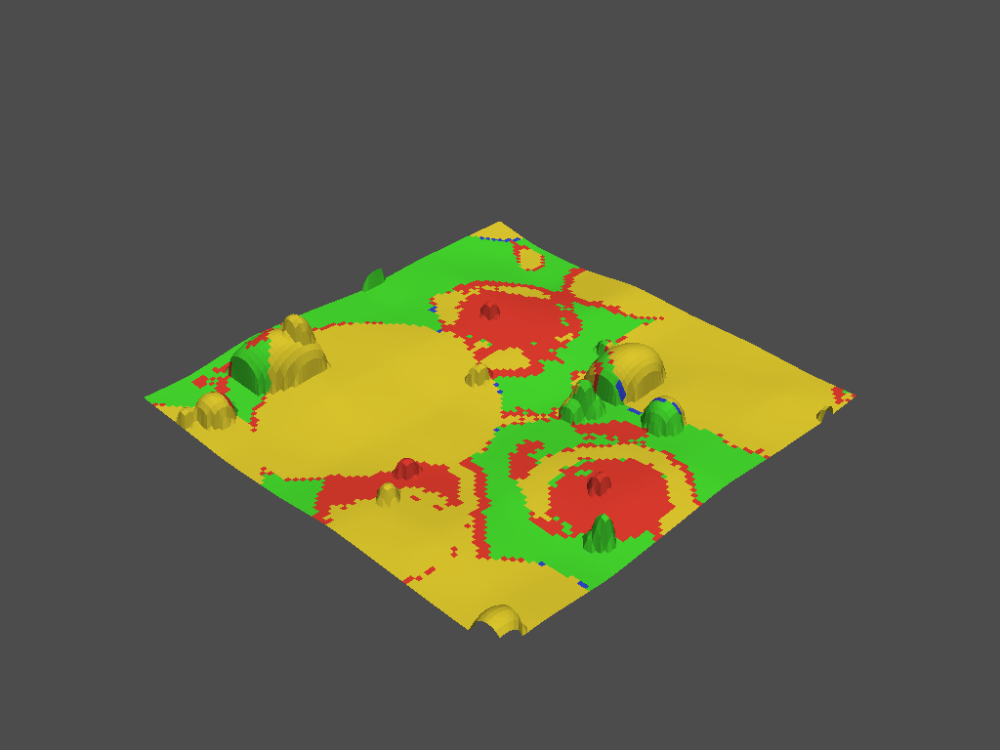

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


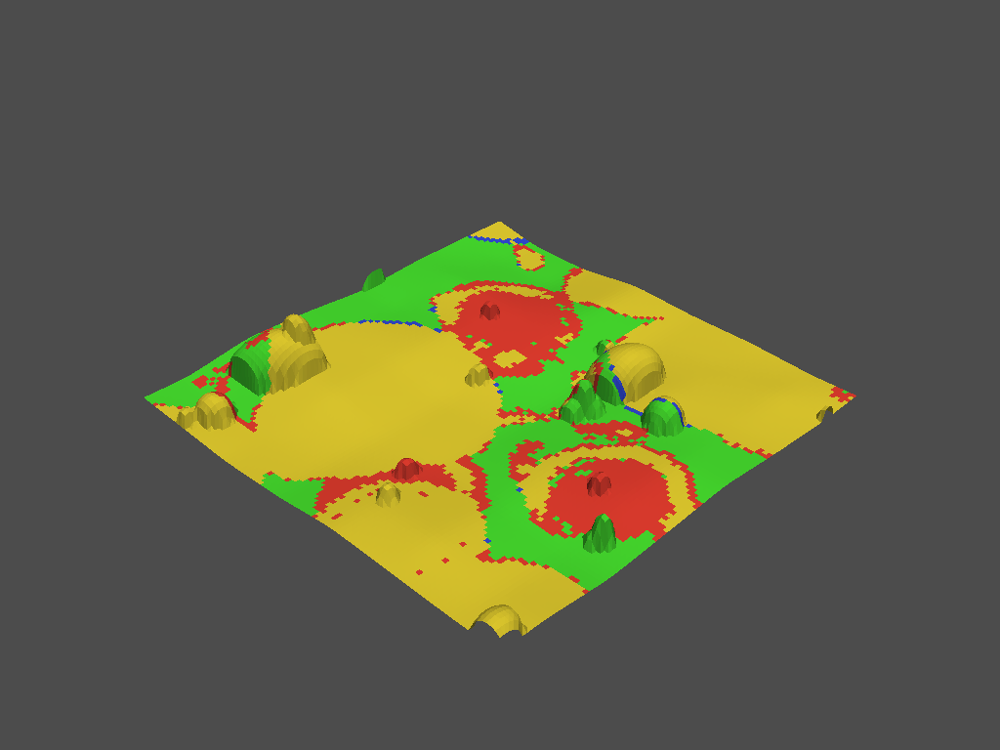

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


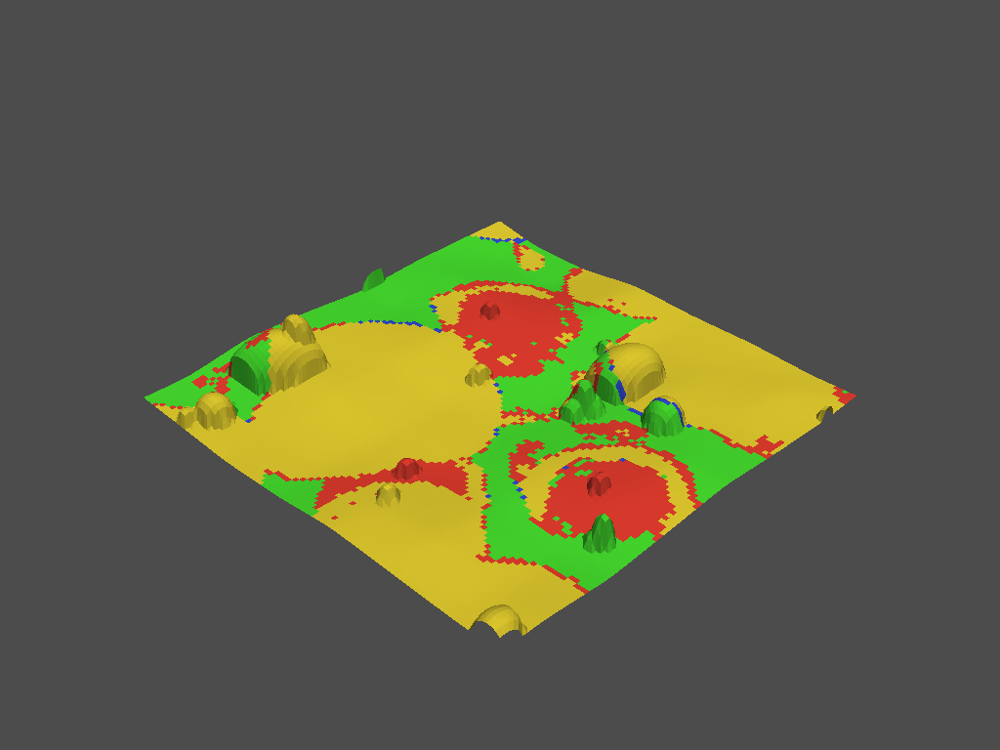

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


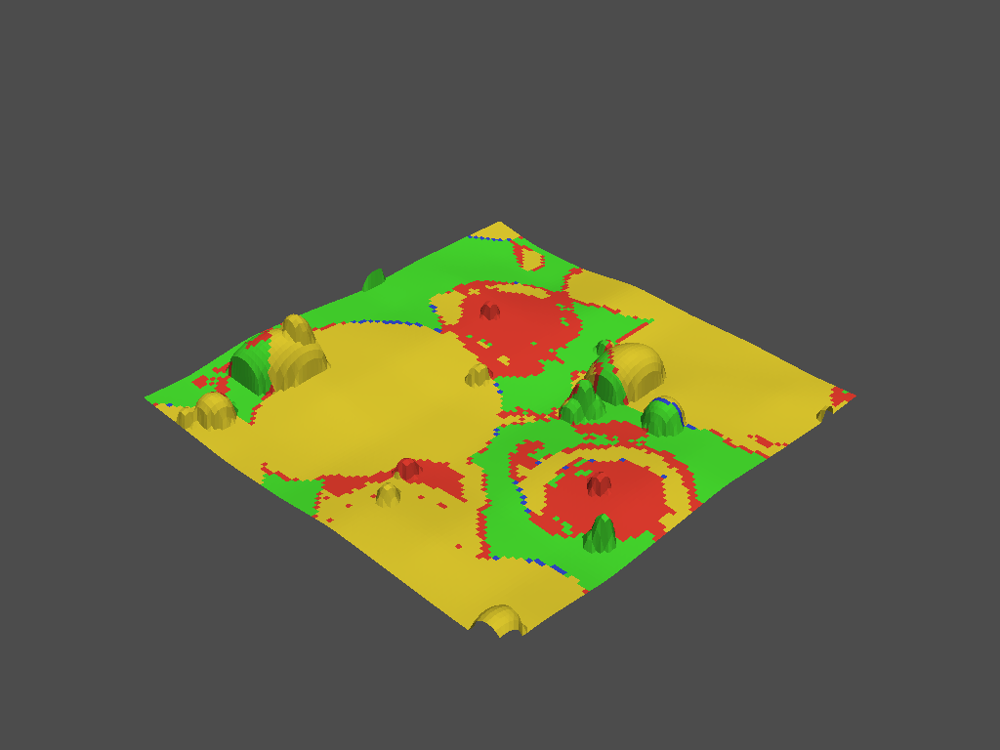

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


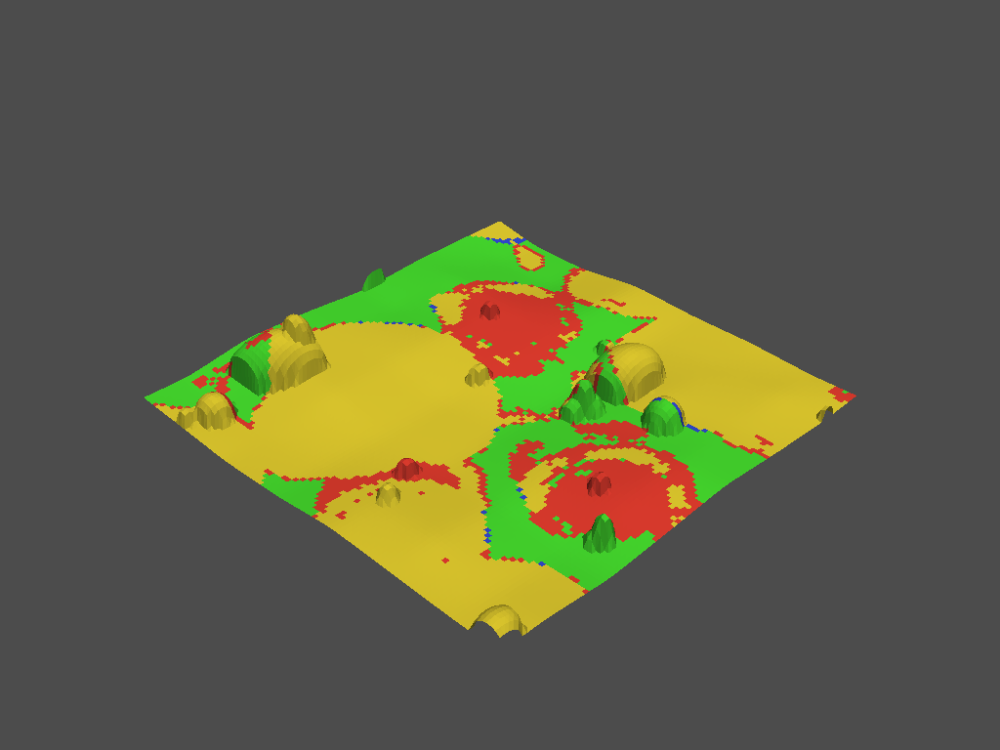

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


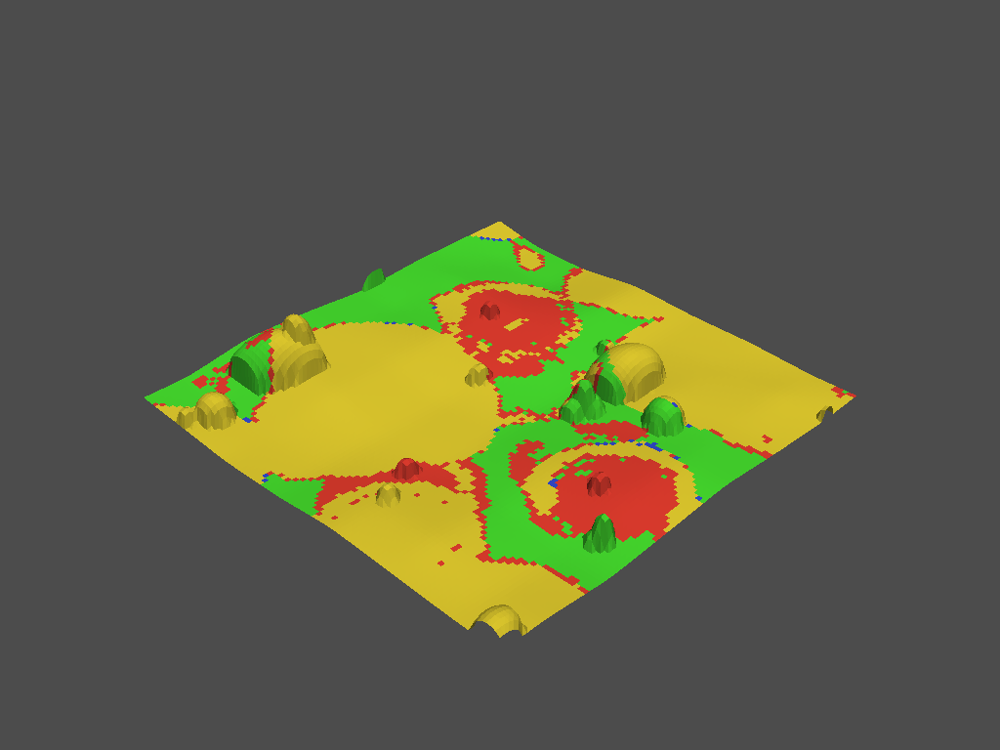

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


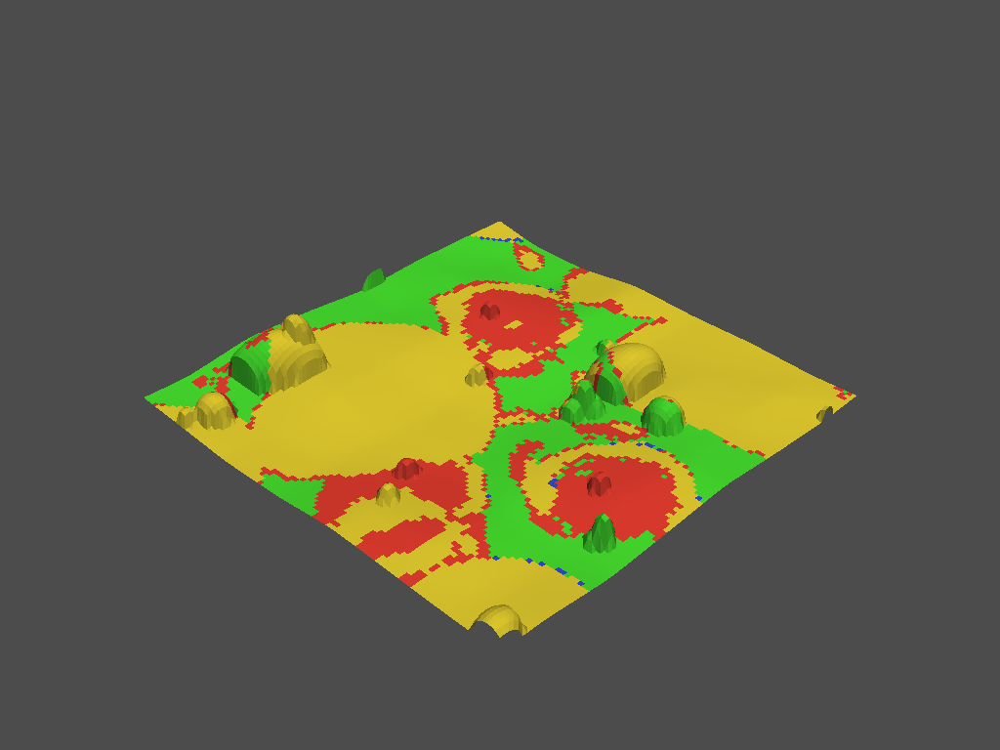

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


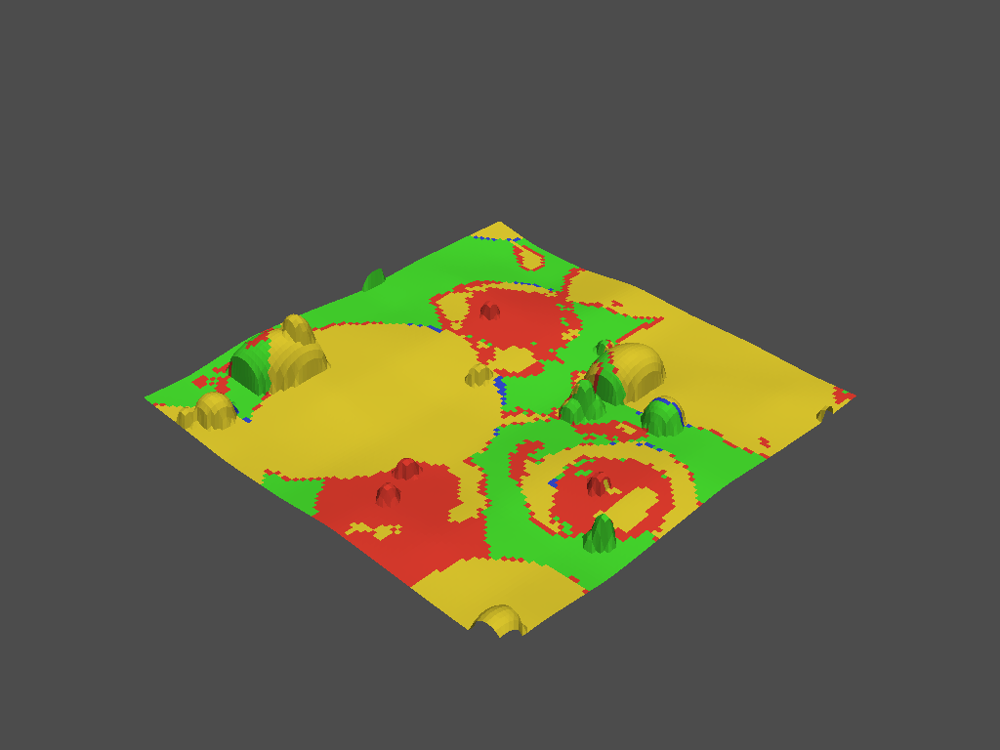

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


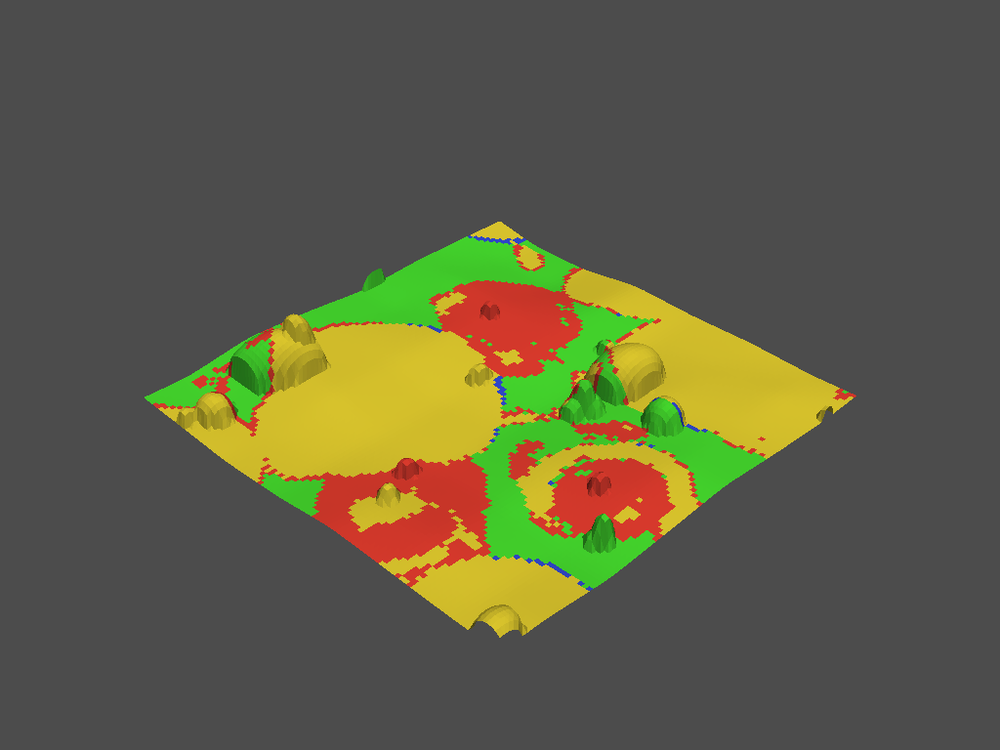

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


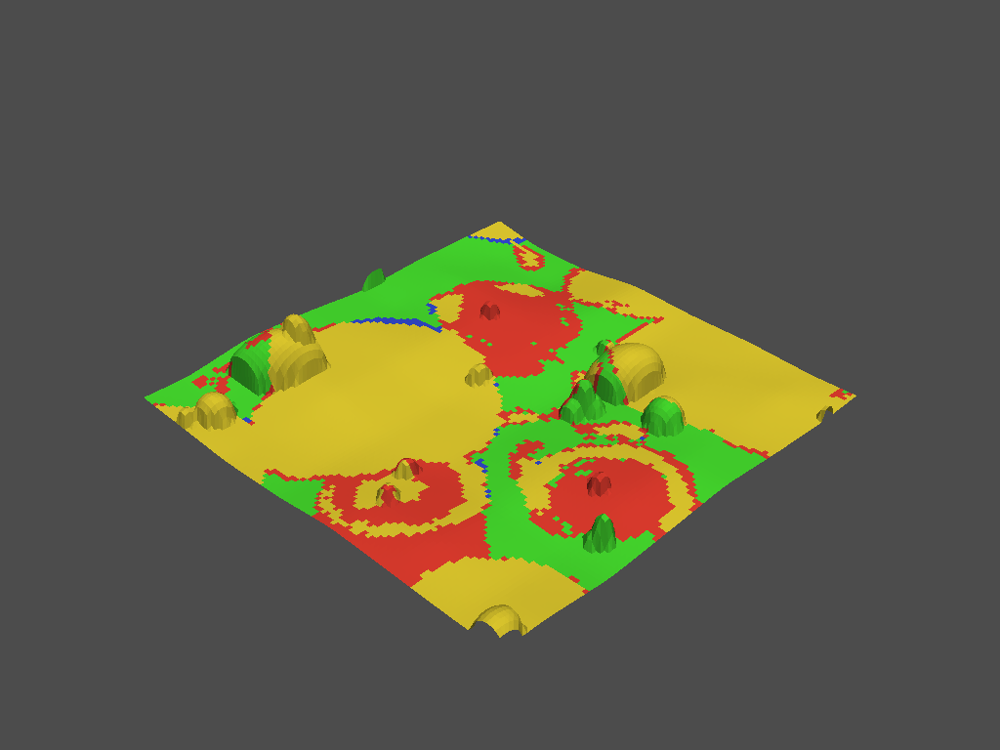

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


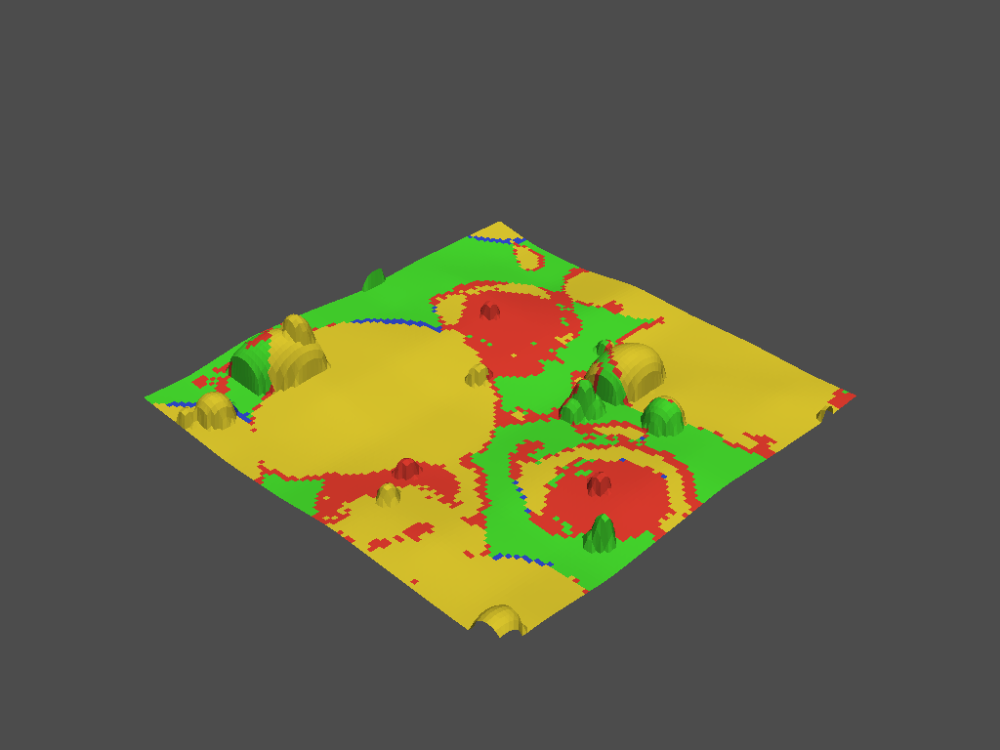

c:\Users\ktomita3\.conda\envs\pydem\lib\site-packages\pyvista\jupyter\notebook.py:58: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


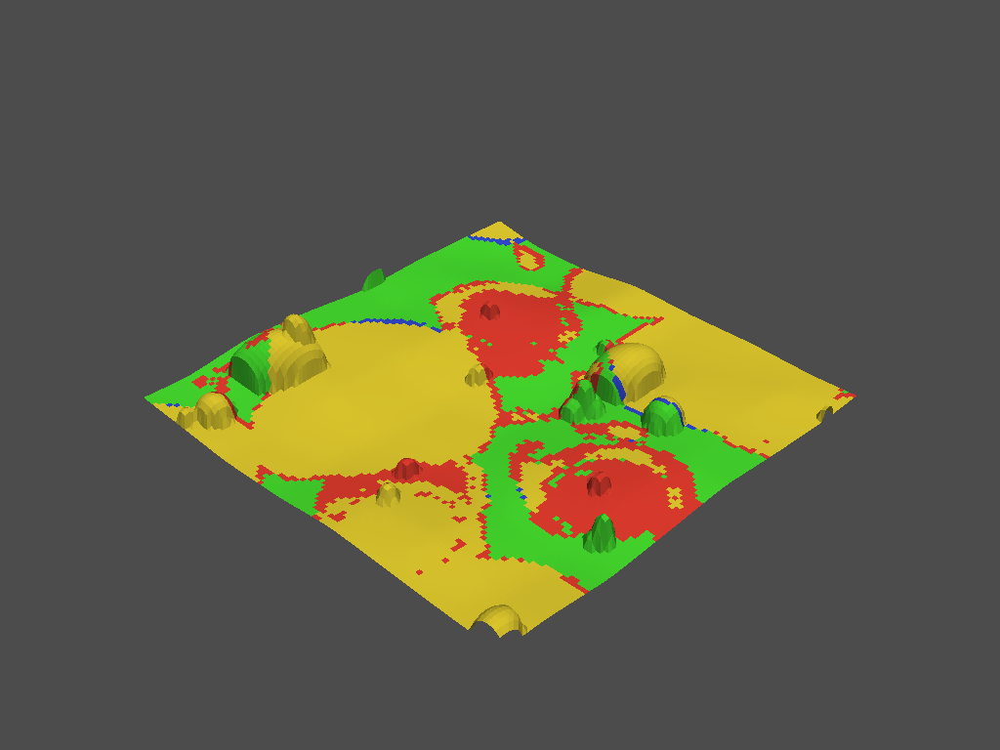

C:\Users\ktomita3\AppData\Local\Temp\ipykernel_32364\2991450551.py:88: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  images = [imageio.imread(file) for file in file_list]


In [6]:
seeds = [3]
for seed in seeds:
    main(seed=seed, n_steps=30, duration=0.3)